In [4]:
import pandas as pd
import numpy as np
from IPython.display import Image

## LendingClub Loan Overview [2014 - 2017, 36 month term]
Analyzed over 1,000,000 of 36 month term P2P loans accepted by LendingClub from 2014-2017 to assess default rate and average FICO score per company assigned grade/loan risk class. Calculated total number of loans and number of loans with status "default" or "charged off" (borrower defaults on loan and loan will never be paid back in full). Computed default rates by dividing defaulted loan numbers by total number of loans per grade. Similarly computed average FICO score per grade. Risk classes were ranked by default rate: A-graded loans belong to the Low-Risk Class, B-graded loans in Medium-Risk Class, and C-graded loans in the High-Risk Class. Loans graded with D, E, F and G were assigned to the Very High-Risk Class in order to minimize class size differences. 

Dataset from https://www.kaggle.com/wordsforthewise/lending-club  
Research process from Polena and Regner, 2018

### Data Upload and Filtering

In [3]:
%%time
lc = pd.read_csv("./data/lc_accepted.csv")

<string>:2: DtypeWarning: Columns (0,19,49,59,118,129,130,131,134,135,136,139,145,146,147) have mixed types.Specify dtype option on import or set low_memory=False.


CPU times: user 23.8 s, sys: 11 s, total: 34.8 s
Wall time: 37.4 s


In [6]:
%%time
lc = lc[lc["issue_d"].notna()]
lc["issue_y"] = [int(val[-4:]) for val in lc["issue_d"]]
idx = np.where((lc["issue_y"]>=2014) & (lc["issue_y"]<=2017) & (lc["term"] == " 36 months"))
lc = lc.iloc[idx]
lc = lc[lc["fico_range_high"].notna()]
lc = lc[lc["fico_range_low"].notna()]
lc = lc[lc["loan_status"].notna()]
lc = lc[lc["grade"].notna()]
lc.sort_values(by = ["issue_y"], inplace = True)

CPU times: user 6.39 s, sys: 5.01 s, total: 11.4 s
Wall time: 12.3 s


In [49]:
lc = lc[lc["fico_range_high"].notna()]
lc = lc[lc["fico_range_low"].notna()]
lc = lc[lc["loan_status"].notna()]
lc = lc[lc["grade"].notna()]
print(lc["loan_status"].value_counts())

Fully Paid            670207
Current               270645
Charged Off           136280
Late (31-120 days)      7993
In Grace Period         2965
Late (16-30 days)       1546
Default                   21
Name: loan_status, dtype: int64


In [9]:
print("Total Loans Analyzed:" + str(len(lc)))
print(lc["loan_status"].value_counts())
lc.head()

Total Loans Analyzed:1089657
Fully Paid            670207
Current               270645
Charged Off           136280
Late (31-120 days)      7993
In Grace Period         2965
Late (16-30 days)       1546
Default                   21
Name: loan_status, dtype: int64


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term,issue_y
1325213,12306361,NaN,17475.0,17475.0,17475.0,36 months,14.64,602.71,C,C3,...,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN,2014
1325220,12246377,NaN,10000.0,10000.0,10000.0,36 months,11.99,332.10,B,B3,...,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN,2014
1325222,12306300,NaN,3000.0,3000.0,3000.0,36 months,15.61,104.90,C,C5,...,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN,2014
1325223,12276311,NaN,16800.0,16800.0,16700.0,36 months,9.67,539.49,B,B1,...,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN,2014
1325225,12266293,NaN,4875.0,4875.0,4875.0,36 months,21.18,184.12,E,E3,...,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN,2014


### Data Analysis and Class Feature Collection

In [10]:
%%time
classed_map = {"A":[i for i in range(3)], "B":[i for i in range(3)], "C":[i for i in range(3)], "D":[i for i in range(3)], "E":[i for i in range(3)], "F":[i for i in range(3)], "G":[i for i in range(3)]}
num_processed = 0
for ind in lc.index:
    fico = (lc["fico_range_high"][ind] + lc["fico_range_low"][ind]) / 2
    grade = lc["grade"][ind]
    default = lc["loan_status"][ind] == "Default" or lc["loan_status"][ind] == "Charged Off"
    new_entities = classed_map[grade]
    new_entities[0] += 1
    new_entities[1] += (1 if default else 0)
    new_entities[2] = (new_entities[2]*(new_entities[0] - 1) + fico) / new_entities[0]
    classed_map[grade] = new_entities
    num_processed += 1
    print(grade,num_processed)
for grade in classed_map:
    old = classed_map[grade]
    classed_map[grade].append(str(100 * old[1]/old[0])[:6] + "%")
print(classed_map)

C 1
B 2
C 3
B 4
E 5
E 6
B 7
E 8
A 9
A 10
A 11
C 12
B 13
B 14
C 15
A 16
A 17
A 18
A 19
D 20
D 21
B 22
F 23
B 24
D 25
A 26
D 27
B 28
D 29
B 30
E 31
B 32
B 33
C 34
A 35
A 36
B 37
B 38
A 39
B 40
A 41
A 42
B 43
C 44
B 45
B 46
A 47
D 48
B 49
B 50
C 51
D 52
C 53
A 54
A 55
A 56
B 57
D 58
C 59
A 60
A 61
E 62
C 63
C 64
C 65
C 66
C 67
D 68
B 69
B 70
C 71
D 72
B 73
C 74
A 75
B 76
C 77
B 78
B 79
B 80
A 81
A 82
A 83
A 84
B 85
A 86
B 87
C 88
D 89
B 90
B 91
A 92
C 93
A 94
B 95
C 96
D 97
B 98
C 99
C 100
C 101
B 102
D 103
D 104
C 105
B 106
B 107
B 108
B 109
C 110
C 111
C 112
C 113
A 114
B 115
B 116
C 117
C 118
A 119
B 120
A 121
A 122
B 123
C 124
A 125
B 126
D 127
E 128
B 129
A 130
B 131
D 132
B 133
B 134
D 135
B 136
C 137
A 138
B 139
C 140
C 141
A 142
B 143
B 144
A 145
D 146
B 147
A 148
B 149
C 150
D 151
B 152
C 153
A 154
B 155
C 156
A 157
B 158
B 159
A 160
A 161
C 162
E 163
A 164
D 165
C 166
A 167
A 168
D 169
B 170
D 171
B 172
D 173
A 174
A 175
B 176
C 177
C 178
C 179
B 180
B 181
D 182
A 183
C 184
A 18

B 1455
B 1456
C 1457
A 1458
B 1459
B 1460
D 1461
B 1462
C 1463
B 1464
C 1465
C 1466
C 1467
B 1468
C 1469
B 1470
B 1471
D 1472
A 1473
D 1474
C 1475
B 1476
B 1477
A 1478
B 1479
B 1480
A 1481
C 1482
E 1483
B 1484
D 1485
A 1486
A 1487
C 1488
C 1489
D 1490
A 1491
B 1492
B 1493
E 1494
B 1495
C 1496
C 1497
D 1498
B 1499
A 1500
B 1501
B 1502
B 1503
D 1504
C 1505
B 1506
B 1507
A 1508
B 1509
A 1510
C 1511
C 1512
C 1513
A 1514
B 1515
C 1516
B 1517
C 1518
B 1519
A 1520
B 1521
A 1522
C 1523
B 1524
B 1525
C 1526
C 1527
B 1528
B 1529
C 1530
B 1531
D 1532
A 1533
B 1534
D 1535
B 1536
B 1537
E 1538
B 1539
D 1540
B 1541
B 1542
A 1543
C 1544
A 1545
C 1546
B 1547
D 1548
C 1549
C 1550
D 1551
B 1552
C 1553
D 1554
B 1555
B 1556
C 1557
A 1558
A 1559
C 1560
A 1561
A 1562
C 1563
B 1564
C 1565
C 1566
D 1567
D 1568
B 1569
C 1570
B 1571
A 1572
C 1573
C 1574
E 1575
B 1576
E 1577
B 1578
B 1579
A 1580
B 1581
C 1582
B 1583
A 1584
C 1585
B 1586
B 1587
B 1588
A 1589
A 1590
B 1591
C 1592
A 1593
E 1594
C 1595
C 1596
A 1597

B 2954
C 2955
C 2956
F 2957
B 2958
B 2959
B 2960
D 2961
A 2962
C 2963
D 2964
B 2965
B 2966
B 2967
B 2968
B 2969
B 2970
B 2971
C 2972
A 2973
C 2974
A 2975
A 2976
A 2977
C 2978
C 2979
A 2980
D 2981
B 2982
A 2983
B 2984
A 2985
D 2986
B 2987
A 2988
C 2989
A 2990
A 2991
C 2992
B 2993
A 2994
C 2995
C 2996
B 2997
C 2998
B 2999
C 3000
B 3001
B 3002
B 3003
B 3004
B 3005
C 3006
B 3007
A 3008
B 3009
C 3010
B 3011
C 3012
B 3013
C 3014
B 3015
B 3016
D 3017
F 3018
D 3019
B 3020
B 3021
C 3022
B 3023
C 3024
D 3025
C 3026
C 3027
B 3028
B 3029
B 3030
B 3031
B 3032
B 3033
B 3034
C 3035
B 3036
D 3037
C 3038
E 3039
C 3040
D 3041
B 3042
B 3043
C 3044
A 3045
B 3046
C 3047
D 3048
B 3049
D 3050
A 3051
B 3052
A 3053
A 3054
A 3055
B 3056
E 3057
C 3058
C 3059
E 3060
F 3061
F 3062
A 3063
B 3064
A 3065
C 3066
B 3067
B 3068
D 3069
C 3070
B 3071
B 3072
B 3073
A 3074
E 3075
B 3076
B 3077
C 3078
B 3079
B 3080
B 3081
D 3082
D 3083
C 3084
B 3085
D 3086
E 3087
D 3088
D 3089
A 3090
A 3091
A 3092
B 3093
C 3094
E 3095
A 3096

E 4454
C 4455
C 4456
B 4457
C 4458
B 4459
C 4460
A 4461
D 4462
A 4463
B 4464
B 4465
C 4466
D 4467
B 4468
B 4469
B 4470
C 4471
B 4472
A 4473
E 4474
A 4475
C 4476
C 4477
C 4478
A 4479
D 4480
C 4481
E 4482
B 4483
C 4484
A 4485
A 4486
C 4487
D 4488
A 4489
B 4490
B 4491
D 4492
D 4493
A 4494
C 4495
E 4496
C 4497
A 4498
E 4499
C 4500
C 4501
E 4502
C 4503
B 4504
B 4505
B 4506
C 4507
A 4508
A 4509
D 4510
C 4511
C 4512
B 4513
A 4514
B 4515
C 4516
A 4517
B 4518
B 4519
A 4520
D 4521
E 4522
C 4523
C 4524
B 4525
A 4526
B 4527
B 4528
B 4529
B 4530
B 4531
B 4532
B 4533
C 4534
B 4535
D 4536
B 4537
A 4538
A 4539
D 4540
C 4541
A 4542
C 4543
D 4544
C 4545
A 4546
B 4547
C 4548
B 4549
B 4550
F 4551
C 4552
B 4553
C 4554
A 4555
C 4556
A 4557
C 4558
D 4559
A 4560
B 4561
B 4562
D 4563
B 4564
B 4565
A 4566
B 4567
F 4568
D 4569
B 4570
D 4571
A 4572
A 4573
B 4574
B 4575
C 4576
B 4577
B 4578
C 4579
A 4580
A 4581
C 4582
D 4583
A 4584
C 4585
B 4586
C 4587
C 4588
B 4589
B 4590
B 4591
C 4592
A 4593
B 4594
B 4595
A 4596

A 5953
D 5954
D 5955
C 5956
C 5957
B 5958
B 5959
B 5960
B 5961
B 5962
A 5963
B 5964
B 5965
C 5966
C 5967
C 5968
B 5969
E 5970
C 5971
B 5972
D 5973
B 5974
B 5975
B 5976
F 5977
B 5978
B 5979
A 5980
D 5981
C 5982
A 5983
D 5984
C 5985
C 5986
B 5987
B 5988
B 5989
B 5990
B 5991
C 5992
B 5993
C 5994
B 5995
A 5996
B 5997
C 5998
B 5999
B 6000
B 6001
A 6002
B 6003
B 6004
B 6005
A 6006
D 6007
B 6008
B 6009
B 6010
B 6011
C 6012
B 6013
B 6014
B 6015
C 6016
B 6017
D 6018
A 6019
C 6020
D 6021
E 6022
C 6023
A 6024
A 6025
C 6026
B 6027
C 6028
A 6029
B 6030
C 6031
D 6032
B 6033
B 6034
B 6035
B 6036
B 6037
A 6038
B 6039
C 6040
B 6041
B 6042
C 6043
C 6044
B 6045
C 6046
C 6047
E 6048
B 6049
B 6050
A 6051
A 6052
B 6053
A 6054
B 6055
B 6056
E 6057
D 6058
C 6059
C 6060
B 6061
C 6062
A 6063
C 6064
B 6065
B 6066
B 6067
D 6068
B 6069
B 6070
B 6071
D 6072
D 6073
D 6074
B 6075
A 6076
D 6077
D 6078
D 6079
B 6080
B 6081
B 6082
B 6083
B 6084
C 6085
E 6086
A 6087
A 6088
C 6089
A 6090
C 6091
B 6092
D 6093
C 6094
F 6095

B 7453
E 7454
B 7455
A 7456
C 7457
B 7458
A 7459
A 7460
A 7461
B 7462
C 7463
A 7464
B 7465
A 7466
B 7467
C 7468
B 7469
A 7470
C 7471
C 7472
B 7473
B 7474
B 7475
A 7476
A 7477
B 7478
A 7479
D 7480
A 7481
D 7482
F 7483
C 7484
B 7485
D 7486
B 7487
B 7488
B 7489
B 7490
A 7491
B 7492
A 7493
B 7494
A 7495
C 7496
A 7497
B 7498
D 7499
B 7500
C 7501
A 7502
B 7503
B 7504
A 7505
B 7506
B 7507
B 7508
C 7509
A 7510
B 7511
E 7512
C 7513
A 7514
A 7515
D 7516
A 7517
B 7518
B 7519
A 7520
A 7521
C 7522
A 7523
B 7524
A 7525
B 7526
D 7527
F 7528
C 7529
B 7530
A 7531
D 7532
A 7533
C 7534
B 7535
B 7536
B 7537
C 7538
A 7539
A 7540
A 7541
F 7542
B 7543
C 7544
C 7545
A 7546
B 7547
B 7548
B 7549
B 7550
D 7551
A 7552
E 7553
B 7554
B 7555
A 7556
D 7557
C 7558
A 7559
C 7560
B 7561
B 7562
B 7563
B 7564
C 7565
B 7566
B 7567
A 7568
A 7569
D 7570
A 7571
B 7572
B 7573
B 7574
A 7575
B 7576
A 7577
A 7578
B 7579
B 7580
B 7581
D 7582
E 7583
B 7584
A 7585
A 7586
B 7587
C 7588
B 7589
D 7590
C 7591
C 7592
C 7593
D 7594
B 7595

B 8952
C 8953
C 8954
B 8955
B 8956
A 8957
C 8958
B 8959
A 8960
F 8961
B 8962
B 8963
B 8964
A 8965
E 8966
B 8967
B 8968
A 8969
C 8970
B 8971
C 8972
B 8973
A 8974
B 8975
A 8976
A 8977
B 8978
C 8979
C 8980
C 8981
C 8982
E 8983
C 8984
C 8985
E 8986
D 8987
B 8988
C 8989
C 8990
B 8991
D 8992
B 8993
B 8994
B 8995
B 8996
A 8997
B 8998
C 8999
A 9000
B 9001
E 9002
C 9003
B 9004
C 9005
B 9006
A 9007
A 9008
C 9009
C 9010
B 9011
B 9012
A 9013
B 9014
A 9015
D 9016
C 9017
B 9018
A 9019
B 9020
B 9021
E 9022
B 9023
B 9024
F 9025
B 9026
A 9027
A 9028
A 9029
C 9030
B 9031
B 9032
A 9033
C 9034
C 9035
B 9036
C 9037
B 9038
D 9039
B 9040
B 9041
B 9042
B 9043
C 9044
B 9045
E 9046
E 9047
B 9048
A 9049
A 9050
F 9051
D 9052
A 9053
C 9054
A 9055
C 9056
A 9057
B 9058
B 9059
B 9060
D 9061
D 9062
B 9063
A 9064
C 9065
C 9066
C 9067
D 9068
C 9069
C 9070
B 9071
C 9072
D 9073
B 9074
B 9075
C 9076
C 9077
D 9078
C 9079
A 9080
D 9081
A 9082
E 9083
B 9084
C 9085
B 9086
C 9087
C 9088
B 9089
C 9090
C 9091
B 9092
A 9093
C 9094

B 10452
B 10453
B 10454
B 10455
B 10456
B 10457
D 10458
C 10459
B 10460
B 10461
C 10462
C 10463
A 10464
C 10465
B 10466
D 10467
D 10468
B 10469
C 10470
A 10471
B 10472
C 10473
A 10474
C 10475
C 10476
C 10477
D 10478
B 10479
B 10480
A 10481
C 10482
A 10483
B 10484
A 10485
E 10486
A 10487
C 10488
C 10489
C 10490
B 10491
D 10492
A 10493
D 10494
D 10495
B 10496
B 10497
A 10498
C 10499
D 10500
C 10501
E 10502
C 10503
E 10504
A 10505
B 10506
B 10507
A 10508
B 10509
A 10510
A 10511
C 10512
B 10513
C 10514
D 10515
B 10516
A 10517
C 10518
B 10519
A 10520
B 10521
B 10522
B 10523
B 10524
A 10525
B 10526
B 10527
E 10528
C 10529
F 10530
B 10531
A 10532
B 10533
B 10534
A 10535
B 10536
C 10537
A 10538
B 10539
A 10540
C 10541
A 10542
C 10543
B 10544
B 10545
C 10546
D 10547
C 10548
C 10549
E 10550
C 10551
C 10552
C 10553
D 10554
C 10555
B 10556
B 10557
C 10558
B 10559
B 10560
D 10561
B 10562
D 10563
E 10564
B 10565
B 10566
C 10567
C 10568
B 10569
C 10570
C 10571
C 10572
A 10573
B 10574
B 10575
A 10576


C 11951
C 11952
C 11953
B 11954
A 11955
C 11956
B 11957
A 11958
A 11959
B 11960
C 11961
C 11962
B 11963
B 11964
A 11965
B 11966
B 11967
C 11968
C 11969
B 11970
B 11971
D 11972
A 11973
C 11974
A 11975
B 11976
B 11977
C 11978
B 11979
F 11980
C 11981
C 11982
A 11983
D 11984
D 11985
B 11986
A 11987
B 11988
C 11989
C 11990
B 11991
A 11992
C 11993
B 11994
B 11995
B 11996
D 11997
B 11998
D 11999
B 12000
B 12001
B 12002
A 12003
C 12004
C 12005
B 12006
C 12007
A 12008
C 12009
D 12010
B 12011
B 12012
A 12013
A 12014
D 12015
A 12016
B 12017
C 12018
A 12019
B 12020
B 12021
E 12022
E 12023
F 12024
C 12025
B 12026
D 12027
C 12028
B 12029
C 12030
C 12031
B 12032
A 12033
D 12034
C 12035
B 12036
B 12037
A 12038
B 12039
B 12040
D 12041
B 12042
A 12043
C 12044
A 12045
B 12046
A 12047
C 12048
C 12049
G 12050
E 12051
B 12052
A 12053
B 12054
C 12055
B 12056
C 12057
B 12058
A 12059
C 12060
A 12061
B 12062
C 12063
D 12064
B 12065
C 12066
C 12067
B 12068
D 12069
B 12070
C 12071
B 12072
D 12073
D 12074
F 12075


E 13451
C 13452
A 13453
A 13454
D 13455
B 13456
B 13457
C 13458
A 13459
C 13460
B 13461
C 13462
B 13463
A 13464
B 13465
C 13466
A 13467
B 13468
A 13469
C 13470
C 13471
B 13472
A 13473
C 13474
C 13475
B 13476
C 13477
C 13478
D 13479
C 13480
A 13481
C 13482
A 13483
C 13484
B 13485
D 13486
D 13487
B 13488
A 13489
D 13490
B 13491
C 13492
C 13493
E 13494
B 13495
B 13496
B 13497
D 13498
A 13499
B 13500
A 13501
D 13502
B 13503
B 13504
B 13505
D 13506
D 13507
C 13508
F 13509
B 13510
C 13511
B 13512
B 13513
B 13514
D 13515
B 13516
D 13517
B 13518
B 13519
B 13520
D 13521
A 13522
C 13523
B 13524
A 13525
B 13526
A 13527
B 13528
C 13529
D 13530
C 13531
B 13532
D 13533
A 13534
B 13535
C 13536
A 13537
A 13538
C 13539
C 13540
A 13541
D 13542
A 13543
B 13544
D 13545
B 13546
A 13547
A 13548
B 13549
C 13550
C 13551
B 13552
A 13553
C 13554
D 13555
A 13556
C 13557
B 13558
B 13559
C 13560
A 13561
C 13562
C 13563
C 13564
B 13565
C 13566
B 13567
A 13568
B 13569
C 13570
D 13571
B 13572
A 13573
C 13574
C 13575


A 14950
C 14951
B 14952
A 14953
D 14954
B 14955
A 14956
B 14957
C 14958
B 14959
B 14960
B 14961
D 14962
C 14963
A 14964
B 14965
F 14966
A 14967
B 14968
B 14969
B 14970
B 14971
A 14972
C 14973
A 14974
B 14975
B 14976
C 14977
B 14978
A 14979
B 14980
B 14981
D 14982
C 14983
B 14984
B 14985
C 14986
A 14987
A 14988
B 14989
A 14990
B 14991
C 14992
B 14993
B 14994
B 14995
B 14996
C 14997
A 14998
C 14999
E 15000
B 15001
A 15002
C 15003
B 15004
C 15005
B 15006
A 15007
B 15008
B 15009
A 15010
D 15011
B 15012
B 15013
A 15014
B 15015
E 15016
A 15017
A 15018
C 15019
B 15020
B 15021
B 15022
C 15023
B 15024
B 15025
A 15026
A 15027
C 15028
A 15029
B 15030
C 15031
C 15032
B 15033
A 15034
A 15035
A 15036
B 15037
B 15038
A 15039
F 15040
B 15041
B 15042
B 15043
B 15044
A 15045
B 15046
A 15047
B 15048
A 15049
F 15050
A 15051
A 15052
B 15053
B 15054
B 15055
B 15056
C 15057
A 15058
E 15059
C 15060
B 15061
A 15062
D 15063
B 15064
D 15065
A 15066
B 15067
B 15068
A 15069
A 15070
B 15071
B 15072
B 15073
A 15074


A 16450
E 16451
C 16452
A 16453
B 16454
B 16455
C 16456
B 16457
A 16458
C 16459
A 16460
C 16461
D 16462
C 16463
C 16464
D 16465
C 16466
B 16467
B 16468
C 16469
B 16470
D 16471
B 16472
A 16473
B 16474
B 16475
A 16476
E 16477
A 16478
B 16479
A 16480
C 16481
C 16482
E 16483
B 16484
B 16485
A 16486
C 16487
A 16488
C 16489
B 16490
A 16491
C 16492
C 16493
B 16494
D 16495
B 16496
A 16497
C 16498
C 16499
C 16500
D 16501
B 16502
B 16503
D 16504
D 16505
B 16506
B 16507
B 16508
A 16509
A 16510
C 16511
B 16512
C 16513
B 16514
B 16515
A 16516
C 16517
C 16518
E 16519
A 16520
E 16521
B 16522
B 16523
B 16524
C 16525
B 16526
B 16527
A 16528
B 16529
C 16530
A 16531
A 16532
B 16533
A 16534
B 16535
A 16536
A 16537
A 16538
D 16539
D 16540
B 16541
C 16542
A 16543
A 16544
B 16545
A 16546
C 16547
B 16548
B 16549
B 16550
E 16551
A 16552
B 16553
C 16554
E 16555
C 16556
B 16557
B 16558
F 16559
A 16560
A 16561
B 16562
B 16563
C 16564
B 16565
C 16566
B 16567
C 16568
A 16569
C 16570
B 16571
B 16572
A 16573
D 16574


B 17949
B 17950
E 17951
C 17952
E 17953
B 17954
C 17955
B 17956
C 17957
A 17958
C 17959
C 17960
A 17961
D 17962
D 17963
B 17964
B 17965
C 17966
B 17967
B 17968
B 17969
A 17970
B 17971
D 17972
B 17973
B 17974
C 17975
D 17976
C 17977
E 17978
A 17979
B 17980
B 17981
C 17982
D 17983
B 17984
C 17985
B 17986
D 17987
A 17988
C 17989
B 17990
D 17991
D 17992
B 17993
B 17994
D 17995
B 17996
E 17997
B 17998
C 17999
B 18000
C 18001
B 18002
C 18003
C 18004
A 18005
B 18006
B 18007
C 18008
E 18009
A 18010
A 18011
B 18012
B 18013
C 18014
B 18015
D 18016
C 18017
C 18018
A 18019
C 18020
C 18021
B 18022
A 18023
B 18024
C 18025
B 18026
A 18027
B 18028
A 18029
C 18030
B 18031
D 18032
C 18033
D 18034
D 18035
C 18036
A 18037
C 18038
A 18039
C 18040
B 18041
C 18042
A 18043
C 18044
C 18045
A 18046
B 18047
C 18048
B 18049
D 18050
F 18051
C 18052
A 18053
D 18054
C 18055
B 18056
B 18057
A 18058
C 18059
D 18060
C 18061
B 18062
A 18063
C 18064
B 18065
C 18066
A 18067
D 18068
C 18069
C 18070
C 18071
C 18072
A 18073


D 19449
C 19450
B 19451
B 19452
A 19453
B 19454
C 19455
D 19456
B 19457
C 19458
B 19459
C 19460
C 19461
B 19462
C 19463
A 19464
D 19465
C 19466
B 19467
B 19468
B 19469
B 19470
D 19471
B 19472
A 19473
C 19474
C 19475
D 19476
C 19477
B 19478
B 19479
D 19480
A 19481
C 19482
C 19483
A 19484
B 19485
C 19486
D 19487
C 19488
A 19489
C 19490
C 19491
C 19492
B 19493
B 19494
C 19495
C 19496
D 19497
B 19498
C 19499
C 19500
C 19501
B 19502
B 19503
C 19504
B 19505
F 19506
B 19507
D 19508
C 19509
C 19510
B 19511
B 19512
C 19513
A 19514
C 19515
C 19516
B 19517
C 19518
E 19519
A 19520
B 19521
B 19522
C 19523
E 19524
C 19525
C 19526
C 19527
D 19528
B 19529
C 19530
D 19531
C 19532
C 19533
C 19534
C 19535
C 19536
C 19537
D 19538
B 19539
A 19540
B 19541
B 19542
C 19543
B 19544
C 19545
B 19546
C 19547
B 19548
A 19549
A 19550
B 19551
D 19552
B 19553
C 19554
B 19555
D 19556
F 19557
B 19558
D 19559
C 19560
B 19561
D 19562
C 19563
E 19564
B 19565
B 19566
D 19567
D 19568
B 19569
C 19570
C 19571
C 19572
A 19573


A 20948
A 20949
C 20950
B 20951
C 20952
A 20953
D 20954
C 20955
A 20956
C 20957
A 20958
C 20959
C 20960
D 20961
A 20962
C 20963
D 20964
B 20965
A 20966
B 20967
A 20968
C 20969
B 20970
A 20971
C 20972
A 20973
D 20974
B 20975
C 20976
C 20977
B 20978
A 20979
D 20980
B 20981
B 20982
C 20983
C 20984
B 20985
C 20986
B 20987
E 20988
A 20989
B 20990
C 20991
D 20992
C 20993
C 20994
D 20995
C 20996
A 20997
B 20998
E 20999
B 21000
B 21001
C 21002
B 21003
B 21004
A 21005
C 21006
A 21007
A 21008
D 21009
C 21010
F 21011
C 21012
B 21013
B 21014
A 21015
B 21016
A 21017
F 21018
B 21019
C 21020
B 21021
A 21022
E 21023
B 21024
C 21025
A 21026
A 21027
B 21028
A 21029
D 21030
E 21031
C 21032
A 21033
B 21034
D 21035
B 21036
C 21037
A 21038
C 21039
A 21040
B 21041
C 21042
B 21043
C 21044
D 21045
B 21046
A 21047
C 21048
B 21049
B 21050
A 21051
C 21052
B 21053
C 21054
A 21055
B 21056
C 21057
C 21058
B 21059
B 21060
E 21061
C 21062
A 21063
C 21064
C 21065
A 21066
B 21067
B 21068
C 21069
B 21070
A 21071
C 21072


A 22448
B 22449
D 22450
B 22451
B 22452
A 22453
C 22454
A 22455
A 22456
B 22457
A 22458
C 22459
C 22460
A 22461
D 22462
A 22463
A 22464
A 22465
C 22466
E 22467
B 22468
B 22469
C 22470
B 22471
B 22472
D 22473
B 22474
E 22475
C 22476
D 22477
C 22478
D 22479
D 22480
D 22481
A 22482
E 22483
A 22484
A 22485
B 22486
A 22487
A 22488
C 22489
B 22490
B 22491
E 22492
B 22493
C 22494
B 22495
B 22496
C 22497
C 22498
C 22499
C 22500
C 22501
B 22502
B 22503
B 22504
D 22505
C 22506
B 22507
C 22508
A 22509
B 22510
A 22511
C 22512
B 22513
B 22514
B 22515
B 22516
C 22517
E 22518
A 22519
C 22520
A 22521
C 22522
B 22523
C 22524
B 22525
C 22526
C 22527
C 22528
C 22529
D 22530
C 22531
B 22532
C 22533
F 22534
B 22535
C 22536
B 22537
D 22538
C 22539
C 22540
B 22541
C 22542
B 22543
A 22544
A 22545
B 22546
B 22547
C 22548
C 22549
C 22550
B 22551
B 22552
C 22553
A 22554
A 22555
A 22556
C 22557
D 22558
C 22559
A 22560
D 22561
B 22562
A 22563
C 22564
C 22565
C 22566
D 22567
D 22568
C 22569
B 22570
D 22571
C 22572


B 23947
A 23948
A 23949
A 23950
B 23951
C 23952
C 23953
B 23954
A 23955
C 23956
B 23957
B 23958
C 23959
B 23960
C 23961
D 23962
C 23963
C 23964
A 23965
A 23966
B 23967
B 23968
A 23969
C 23970
A 23971
B 23972
B 23973
C 23974
A 23975
B 23976
B 23977
B 23978
D 23979
B 23980
C 23981
C 23982
C 23983
A 23984
C 23985
A 23986
C 23987
C 23988
B 23989
B 23990
E 23991
C 23992
A 23993
C 23994
B 23995
A 23996
E 23997
D 23998
A 23999
C 24000
C 24001
B 24002
D 24003
B 24004
B 24005
B 24006
C 24007
D 24008
C 24009
C 24010
A 24011
D 24012
B 24013
D 24014
C 24015
C 24016
C 24017
B 24018
A 24019
B 24020
A 24021
C 24022
C 24023
C 24024
C 24025
B 24026
C 24027
B 24028
B 24029
C 24030
B 24031
C 24032
C 24033
B 24034
A 24035
B 24036
C 24037
B 24038
D 24039
B 24040
A 24041
B 24042
D 24043
B 24044
C 24045
D 24046
C 24047
D 24048
B 24049
A 24050
E 24051
C 24052
A 24053
B 24054
A 24055
C 24056
A 24057
B 24058
B 24059
B 24060
B 24061
B 24062
B 24063
B 24064
B 24065
B 24066
A 24067
B 24068
D 24069
A 24070
D 24071


A 25447
C 25448
B 25449
B 25450
C 25451
A 25452
C 25453
C 25454
B 25455
A 25456
A 25457
C 25458
C 25459
B 25460
A 25461
D 25462
C 25463
B 25464
A 25465
D 25466
C 25467
E 25468
D 25469
B 25470
C 25471
C 25472
C 25473
B 25474
C 25475
B 25476
D 25477
B 25478
F 25479
B 25480
D 25481
B 25482
C 25483
F 25484
C 25485
C 25486
C 25487
C 25488
C 25489
D 25490
B 25491
C 25492
C 25493
B 25494
C 25495
A 25496
E 25497
B 25498
B 25499
B 25500
C 25501
B 25502
A 25503
B 25504
D 25505
C 25506
B 25507
C 25508
A 25509
A 25510
B 25511
C 25512
D 25513
A 25514
E 25515
B 25516
C 25517
B 25518
B 25519
B 25520
D 25521
A 25522
B 25523
B 25524
B 25525
C 25526
C 25527
A 25528
E 25529
D 25530
D 25531
B 25532
C 25533
B 25534
D 25535
C 25536
C 25537
B 25538
D 25539
A 25540
D 25541
B 25542
C 25543
B 25544
D 25545
B 25546
B 25547
E 25548
B 25549
A 25550
C 25551
A 25552
D 25553
B 25554
C 25555
C 25556
C 25557
C 25558
C 25559
A 25560
D 25561
C 25562
C 25563
B 25564
D 25565
C 25566
A 25567
A 25568
A 25569
B 25570
C 25571


A 26946
A 26947
B 26948
A 26949
D 26950
A 26951
B 26952
C 26953
B 26954
A 26955
B 26956
A 26957
C 26958
B 26959
B 26960
D 26961
B 26962
E 26963
C 26964
C 26965
C 26966
D 26967
A 26968
C 26969
B 26970
D 26971
C 26972
B 26973
C 26974
C 26975
C 26976
D 26977
B 26978
C 26979
C 26980
B 26981
A 26982
C 26983
B 26984
B 26985
E 26986
B 26987
D 26988
D 26989
B 26990
A 26991
C 26992
C 26993
C 26994
C 26995
E 26996
B 26997
B 26998
B 26999
C 27000
A 27001
B 27002
B 27003
A 27004
B 27005
C 27006
B 27007
B 27008
B 27009
C 27010
E 27011
D 27012
C 27013
C 27014
B 27015
C 27016
B 27017
B 27018
D 27019
C 27020
B 27021
D 27022
C 27023
A 27024
B 27025
C 27026
A 27027
B 27028
C 27029
C 27030
B 27031
B 27032
A 27033
B 27034
A 27035
C 27036
C 27037
C 27038
E 27039
A 27040
C 27041
B 27042
B 27043
B 27044
C 27045
C 27046
B 27047
B 27048
A 27049
A 27050
C 27051
C 27052
C 27053
B 27054
D 27055
B 27056
E 27057
A 27058
B 27059
C 27060
B 27061
C 27062
C 27063
B 27064
D 27065
C 27066
B 27067
B 27068
B 27069
C 27070


D 28446
D 28447
C 28448
C 28449
A 28450
E 28451
B 28452
A 28453
C 28454
B 28455
D 28456
C 28457
D 28458
B 28459
B 28460
B 28461
E 28462
D 28463
B 28464
A 28465
C 28466
B 28467
B 28468
D 28469
C 28470
A 28471
D 28472
E 28473
B 28474
C 28475
B 28476
B 28477
C 28478
C 28479
C 28480
D 28481
C 28482
C 28483
B 28484
B 28485
C 28486
B 28487
C 28488
D 28489
A 28490
B 28491
C 28492
B 28493
A 28494
B 28495
B 28496
D 28497
B 28498
B 28499
B 28500
B 28501
B 28502
B 28503
D 28504
B 28505
D 28506
A 28507
C 28508
D 28509
D 28510
B 28511
D 28512
C 28513
D 28514
C 28515
C 28516
B 28517
C 28518
C 28519
A 28520
C 28521
B 28522
A 28523
A 28524
A 28525
D 28526
D 28527
B 28528
C 28529
C 28530
C 28531
B 28532
B 28533
B 28534
B 28535
D 28536
A 28537
A 28538
B 28539
B 28540
B 28541
C 28542
C 28543
B 28544
B 28545
D 28546
A 28547
A 28548
D 28549
C 28550
B 28551
D 28552
D 28553
E 28554
B 28555
B 28556
B 28557
B 28558
C 28559
D 28560
C 28561
B 28562
C 28563
B 28564
A 28565
C 28566
B 28567
D 28568
B 28569
C 28570


B 29945
B 29946
C 29947
B 29948
C 29949
B 29950
C 29951
C 29952
B 29953
B 29954
B 29955
B 29956
B 29957
A 29958
B 29959
C 29960
D 29961
A 29962
A 29963
D 29964
B 29965
C 29966
B 29967
A 29968
E 29969
C 29970
E 29971
B 29972
C 29973
A 29974
D 29975
B 29976
E 29977
C 29978
A 29979
B 29980
F 29981
B 29982
B 29983
C 29984
A 29985
B 29986
A 29987
D 29988
C 29989
B 29990
A 29991
C 29992
B 29993
D 29994
D 29995
B 29996
D 29997
A 29998
B 29999
B 30000
B 30001
E 30002
B 30003
F 30004
C 30005
B 30006
A 30007
C 30008
C 30009
B 30010
E 30011
E 30012
B 30013
B 30014
C 30015
A 30016
B 30017
B 30018
B 30019
C 30020
B 30021
A 30022
C 30023
C 30024
E 30025
C 30026
C 30027
C 30028
B 30029
A 30030
E 30031
B 30032
B 30033
A 30034
B 30035
B 30036
B 30037
C 30038
B 30039
C 30040
C 30041
B 30042
C 30043
B 30044
F 30045
D 30046
E 30047
E 30048
A 30049
A 30050
B 30051
E 30052
C 30053
B 30054
C 30055
B 30056
C 30057
C 30058
B 30059
A 30060
C 30061
A 30062
A 30063
B 30064
C 30065
C 30066
B 30067
B 30068
D 30069


A 31445
D 31446
D 31447
B 31448
C 31449
C 31450
B 31451
D 31452
C 31453
C 31454
B 31455
B 31456
B 31457
B 31458
E 31459
B 31460
C 31461
D 31462
B 31463
E 31464
B 31465
F 31466
D 31467
B 31468
C 31469
D 31470
C 31471
B 31472
D 31473
A 31474
A 31475
C 31476
C 31477
C 31478
F 31479
B 31480
B 31481
B 31482
C 31483
A 31484
A 31485
B 31486
B 31487
B 31488
C 31489
C 31490
A 31491
C 31492
B 31493
B 31494
C 31495
A 31496
C 31497
A 31498
B 31499
B 31500
A 31501
C 31502
B 31503
E 31504
B 31505
B 31506
D 31507
B 31508
E 31509
C 31510
E 31511
C 31512
D 31513
C 31514
B 31515
C 31516
B 31517
B 31518
F 31519
B 31520
C 31521
B 31522
A 31523
C 31524
C 31525
B 31526
D 31527
A 31528
F 31529
B 31530
B 31531
E 31532
D 31533
C 31534
B 31535
A 31536
D 31537
C 31538
D 31539
B 31540
B 31541
C 31542
D 31543
C 31544
B 31545
B 31546
B 31547
E 31548
B 31549
D 31550
B 31551
B 31552
C 31553
B 31554
A 31555
B 31556
D 31557
D 31558
B 31559
D 31560
D 31561
C 31562
C 31563
D 31564
C 31565
D 31566
C 31567
B 31568
D 31569


C 32944
A 32945
C 32946
C 32947
A 32948
A 32949
B 32950
B 32951
C 32952
B 32953
D 32954
C 32955
C 32956
C 32957
D 32958
C 32959
B 32960
B 32961
B 32962
B 32963
B 32964
C 32965
D 32966
B 32967
D 32968
B 32969
C 32970
C 32971
D 32972
B 32973
B 32974
B 32975
B 32976
C 32977
B 32978
B 32979
A 32980
B 32981
B 32982
D 32983
C 32984
B 32985
B 32986
B 32987
A 32988
B 32989
D 32990
D 32991
C 32992
B 32993
B 32994
C 32995
B 32996
B 32997
C 32998
C 32999
A 33000
C 33001
D 33002
D 33003
C 33004
D 33005
C 33006
B 33007
A 33008
A 33009
B 33010
B 33011
C 33012
B 33013
A 33014
D 33015
E 33016
B 33017
C 33018
A 33019
E 33020
B 33021
B 33022
E 33023
E 33024
B 33025
C 33026
B 33027
B 33028
C 33029
A 33030
A 33031
A 33032
B 33033
D 33034
C 33035
C 33036
A 33037
C 33038
A 33039
B 33040
B 33041
B 33042
C 33043
A 33044
B 33045
C 33046
A 33047
C 33048
C 33049
A 33050
B 33051
B 33052
A 33053
A 33054
A 33055
B 33056
C 33057
B 33058
C 33059
A 33060
D 33061
A 33062
D 33063
A 33064
A 33065
C 33066
C 33067
B 33068


A 34444
B 34445
B 34446
A 34447
B 34448
C 34449
B 34450
D 34451
E 34452
C 34453
B 34454
B 34455
A 34456
C 34457
A 34458
A 34459
C 34460
B 34461
C 34462
B 34463
A 34464
B 34465
D 34466
D 34467
B 34468
B 34469
E 34470
A 34471
B 34472
D 34473
A 34474
F 34475
B 34476
B 34477
C 34478
A 34479
B 34480
B 34481
A 34482
C 34483
B 34484
A 34485
A 34486
E 34487
B 34488
B 34489
D 34490
C 34491
C 34492
E 34493
C 34494
B 34495
C 34496
C 34497
D 34498
C 34499
A 34500
C 34501
B 34502
C 34503
A 34504
B 34505
B 34506
B 34507
B 34508
C 34509
A 34510
B 34511
B 34512
B 34513
C 34514
D 34515
A 34516
C 34517
D 34518
B 34519
A 34520
C 34521
B 34522
B 34523
A 34524
A 34525
A 34526
C 34527
B 34528
B 34529
A 34530
C 34531
D 34532
B 34533
B 34534
C 34535
B 34536
A 34537
A 34538
F 34539
C 34540
C 34541
A 34542
B 34543
C 34544
C 34545
A 34546
C 34547
D 34548
C 34549
B 34550
C 34551
A 34552
B 34553
B 34554
B 34555
E 34556
B 34557
B 34558
C 34559
C 34560
D 34561
A 34562
D 34563
B 34564
C 34565
B 34566
C 34567
A 34568


B 35943
B 35944
D 35945
A 35946
B 35947
B 35948
D 35949
B 35950
B 35951
C 35952
C 35953
C 35954
A 35955
C 35956
B 35957
B 35958
B 35959
B 35960
B 35961
A 35962
A 35963
C 35964
B 35965
A 35966
B 35967
C 35968
A 35969
A 35970
B 35971
A 35972
B 35973
A 35974
B 35975
B 35976
B 35977
B 35978
B 35979
E 35980
A 35981
D 35982
D 35983
B 35984
C 35985
B 35986
A 35987
B 35988
A 35989
C 35990
B 35991
C 35992
C 35993
A 35994
C 35995
C 35996
B 35997
B 35998
B 35999
B 36000
B 36001
B 36002
D 36003
D 36004
A 36005
C 36006
B 36007
A 36008
B 36009
A 36010
A 36011
B 36012
B 36013
D 36014
C 36015
C 36016
D 36017
E 36018
C 36019
D 36020
B 36021
B 36022
C 36023
B 36024
B 36025
A 36026
B 36027
B 36028
A 36029
D 36030
D 36031
B 36032
A 36033
C 36034
B 36035
C 36036
B 36037
B 36038
C 36039
C 36040
B 36041
A 36042
B 36043
C 36044
A 36045
B 36046
B 36047
A 36048
B 36049
C 36050
C 36051
A 36052
B 36053
A 36054
B 36055
B 36056
D 36057
B 36058
C 36059
B 36060
A 36061
C 36062
B 36063
C 36064
E 36065
C 36066
B 36067


A 37443
C 37444
B 37445
B 37446
E 37447
A 37448
A 37449
B 37450
B 37451
B 37452
A 37453
B 37454
A 37455
A 37456
C 37457
B 37458
B 37459
B 37460
D 37461
B 37462
B 37463
E 37464
C 37465
C 37466
C 37467
B 37468
B 37469
C 37470
C 37471
D 37472
B 37473
B 37474
B 37475
B 37476
C 37477
B 37478
D 37479
A 37480
A 37481
C 37482
B 37483
C 37484
A 37485
B 37486
A 37487
A 37488
C 37489
B 37490
B 37491
C 37492
C 37493
B 37494
B 37495
C 37496
B 37497
A 37498
C 37499
A 37500
E 37501
B 37502
C 37503
D 37504
B 37505
B 37506
B 37507
C 37508
C 37509
B 37510
B 37511
B 37512
C 37513
B 37514
B 37515
A 37516
B 37517
B 37518
A 37519
A 37520
D 37521
B 37522
D 37523
C 37524
B 37525
C 37526
A 37527
B 37528
B 37529
A 37530
C 37531
B 37532
C 37533
B 37534
D 37535
D 37536
A 37537
A 37538
C 37539
C 37540
A 37541
B 37542
B 37543
B 37544
A 37545
B 37546
C 37547
A 37548
C 37549
A 37550
A 37551
E 37552
B 37553
C 37554
D 37555
B 37556
A 37557
B 37558
A 37559
C 37560
B 37561
C 37562
B 37563
C 37564
A 37565
A 37566
C 37567


C 38942
E 38943
D 38944
C 38945
A 38946
A 38947
E 38948
C 38949
C 38950
B 38951
B 38952
A 38953
C 38954
B 38955
C 38956
B 38957
D 38958
A 38959
A 38960
C 38961
B 38962
B 38963
C 38964
C 38965
C 38966
A 38967
B 38968
E 38969
B 38970
C 38971
C 38972
B 38973
B 38974
B 38975
A 38976
D 38977
C 38978
B 38979
B 38980
D 38981
A 38982
A 38983
B 38984
B 38985
A 38986
B 38987
A 38988
B 38989
B 38990
A 38991
B 38992
A 38993
B 38994
D 38995
C 38996
A 38997
E 38998
D 38999
B 39000
C 39001
B 39002
A 39003
F 39004
B 39005
D 39006
C 39007
B 39008
E 39009
B 39010
C 39011
C 39012
C 39013
D 39014
B 39015
A 39016
A 39017
B 39018
A 39019
A 39020
C 39021
E 39022
A 39023
A 39024
B 39025
D 39026
A 39027
D 39028
B 39029
C 39030
A 39031
B 39032
E 39033
D 39034
A 39035
A 39036
B 39037
F 39038
C 39039
B 39040
C 39041
B 39042
C 39043
C 39044
C 39045
B 39046
C 39047
C 39048
B 39049
B 39050
C 39051
A 39052
E 39053
B 39054
B 39055
B 39056
B 39057
B 39058
A 39059
E 39060
A 39061
A 39062
C 39063
C 39064
B 39065
B 39066


B 40442
B 40443
A 40444
A 40445
A 40446
B 40447
C 40448
B 40449
B 40450
B 40451
B 40452
A 40453
B 40454
B 40455
C 40456
C 40457
C 40458
B 40459
A 40460
B 40461
C 40462
C 40463
C 40464
B 40465
A 40466
D 40467
B 40468
C 40469
B 40470
C 40471
D 40472
A 40473
E 40474
B 40475
C 40476
F 40477
D 40478
B 40479
A 40480
C 40481
B 40482
C 40483
A 40484
A 40485
D 40486
B 40487
B 40488
A 40489
B 40490
D 40491
A 40492
B 40493
C 40494
B 40495
B 40496
B 40497
D 40498
A 40499
C 40500
C 40501
B 40502
A 40503
B 40504
B 40505
E 40506
C 40507
C 40508
B 40509
B 40510
B 40511
B 40512
B 40513
B 40514
B 40515
B 40516
B 40517
B 40518
A 40519
B 40520
A 40521
C 40522
C 40523
E 40524
A 40525
A 40526
F 40527
C 40528
C 40529
C 40530
C 40531
B 40532
A 40533
C 40534
A 40535
F 40536
B 40537
C 40538
B 40539
B 40540
C 40541
C 40542
C 40543
B 40544
C 40545
B 40546
C 40547
C 40548
B 40549
D 40550
B 40551
B 40552
C 40553
A 40554
B 40555
B 40556
C 40557
C 40558
C 40559
B 40560
A 40561
B 40562
D 40563
B 40564
A 40565
D 40566


D 41941
B 41942
C 41943
B 41944
C 41945
C 41946
B 41947
C 41948
B 41949
B 41950
D 41951
B 41952
D 41953
C 41954
D 41955
C 41956
A 41957
B 41958
B 41959
F 41960
B 41961
B 41962
B 41963
C 41964
A 41965
C 41966
C 41967
B 41968
B 41969
A 41970
B 41971
C 41972
B 41973
A 41974
C 41975
A 41976
C 41977
B 41978
C 41979
B 41980
D 41981
A 41982
B 41983
B 41984
A 41985
C 41986
A 41987
C 41988
E 41989
A 41990
D 41991
B 41992
B 41993
B 41994
C 41995
B 41996
C 41997
A 41998
C 41999
D 42000
C 42001
B 42002
C 42003
A 42004
B 42005
B 42006
C 42007
B 42008
B 42009
A 42010
B 42011
A 42012
C 42013
D 42014
C 42015
B 42016
B 42017
A 42018
E 42019
C 42020
C 42021
A 42022
B 42023
C 42024
A 42025
D 42026
C 42027
A 42028
C 42029
C 42030
B 42031
C 42032
C 42033
B 42034
B 42035
C 42036
C 42037
D 42038
B 42039
A 42040
B 42041
E 42042
D 42043
A 42044
C 42045
A 42046
A 42047
C 42048
B 42049
C 42050
A 42051
C 42052
C 42053
B 42054
A 42055
B 42056
E 42057
C 42058
B 42059
C 42060
B 42061
B 42062
B 42063
A 42064
C 42065


B 43441
A 43442
A 43443
E 43444
D 43445
C 43446
F 43447
D 43448
C 43449
B 43450
B 43451
C 43452
E 43453
B 43454
A 43455
D 43456
B 43457
B 43458
A 43459
B 43460
D 43461
B 43462
C 43463
B 43464
C 43465
B 43466
B 43467
D 43468
C 43469
C 43470
B 43471
D 43472
B 43473
C 43474
C 43475
B 43476
B 43477
B 43478
B 43479
B 43480
A 43481
B 43482
C 43483
B 43484
B 43485
C 43486
E 43487
B 43488
C 43489
B 43490
A 43491
C 43492
D 43493
C 43494
C 43495
B 43496
A 43497
C 43498
C 43499
B 43500
B 43501
C 43502
C 43503
B 43504
C 43505
C 43506
D 43507
C 43508
C 43509
B 43510
D 43511
B 43512
C 43513
A 43514
D 43515
C 43516
C 43517
B 43518
C 43519
A 43520
B 43521
D 43522
B 43523
B 43524
D 43525
C 43526
B 43527
D 43528
B 43529
C 43530
B 43531
A 43532
A 43533
C 43534
B 43535
B 43536
F 43537
D 43538
E 43539
C 43540
B 43541
C 43542
B 43543
E 43544
B 43545
D 43546
C 43547
C 43548
A 43549
B 43550
C 43551
B 43552
A 43553
A 43554
A 43555
C 43556
A 43557
A 43558
A 43559
E 43560
C 43561
D 43562
B 43563
C 43564
B 43565


C 44940
C 44941
B 44942
B 44943
A 44944
A 44945
B 44946
B 44947
C 44948
B 44949
A 44950
C 44951
C 44952
B 44953
B 44954
C 44955
C 44956
B 44957
E 44958
C 44959
D 44960
B 44961
B 44962
C 44963
B 44964
C 44965
C 44966
C 44967
C 44968
C 44969
C 44970
B 44971
C 44972
A 44973
A 44974
C 44975
C 44976
B 44977
B 44978
B 44979
B 44980
B 44981
B 44982
C 44983
C 44984
A 44985
D 44986
C 44987
B 44988
D 44989
E 44990
B 44991
C 44992
C 44993
C 44994
C 44995
C 44996
B 44997
B 44998
A 44999
B 45000
D 45001
A 45002
B 45003
D 45004
D 45005
E 45006
B 45007
C 45008
A 45009
F 45010
B 45011
B 45012
C 45013
A 45014
B 45015
B 45016
D 45017
B 45018
B 45019
D 45020
A 45021
F 45022
A 45023
A 45024
B 45025
B 45026
C 45027
B 45028
A 45029
C 45030
B 45031
A 45032
A 45033
B 45034
A 45035
A 45036
A 45037
C 45038
C 45039
C 45040
C 45041
A 45042
B 45043
A 45044
C 45045
B 45046
A 45047
A 45048
C 45049
C 45050
B 45051
C 45052
A 45053
A 45054
B 45055
B 45056
D 45057
C 45058
E 45059
A 45060
A 45061
A 45062
B 45063
A 45064


C 46440
C 46441
B 46442
B 46443
D 46444
D 46445
A 46446
B 46447
A 46448
C 46449
B 46450
C 46451
C 46452
D 46453
B 46454
B 46455
C 46456
A 46457
A 46458
A 46459
D 46460
C 46461
D 46462
C 46463
B 46464
D 46465
C 46466
E 46467
E 46468
B 46469
F 46470
A 46471
D 46472
B 46473
C 46474
B 46475
C 46476
B 46477
C 46478
A 46479
B 46480
B 46481
C 46482
C 46483
C 46484
C 46485
B 46486
C 46487
C 46488
B 46489
B 46490
E 46491
D 46492
B 46493
B 46494
C 46495
A 46496
E 46497
C 46498
C 46499
E 46500
D 46501
A 46502
F 46503
A 46504
B 46505
C 46506
B 46507
D 46508
D 46509
B 46510
B 46511
A 46512
B 46513
C 46514
C 46515
A 46516
C 46517
B 46518
B 46519
D 46520
C 46521
B 46522
E 46523
A 46524
D 46525
B 46526
B 46527
A 46528
B 46529
D 46530
A 46531
A 46532
D 46533
E 46534
B 46535
C 46536
A 46537
C 46538
B 46539
E 46540
D 46541
A 46542
D 46543
C 46544
B 46545
C 46546
C 46547
C 46548
E 46549
C 46550
C 46551
D 46552
B 46553
C 46554
E 46555
C 46556
B 46557
B 46558
A 46559
C 46560
D 46561
D 46562
B 46563
B 46564


D 47939
B 47940
D 47941
B 47942
A 47943
B 47944
B 47945
C 47946
B 47947
C 47948
C 47949
E 47950
D 47951
D 47952
B 47953
A 47954
B 47955
E 47956
A 47957
A 47958
B 47959
A 47960
B 47961
C 47962
B 47963
A 47964
C 47965
D 47966
B 47967
A 47968
E 47969
C 47970
F 47971
C 47972
D 47973
E 47974
B 47975
C 47976
C 47977
A 47978
D 47979
C 47980
D 47981
A 47982
A 47983
A 47984
D 47985
B 47986
C 47987
B 47988
B 47989
C 47990
A 47991
C 47992
C 47993
B 47994
C 47995
A 47996
B 47997
A 47998
C 47999
B 48000
C 48001
C 48002
A 48003
B 48004
B 48005
B 48006
C 48007
C 48008
B 48009
B 48010
B 48011
C 48012
D 48013
D 48014
D 48015
C 48016
D 48017
B 48018
B 48019
A 48020
B 48021
C 48022
B 48023
A 48024
B 48025
B 48026
B 48027
C 48028
A 48029
B 48030
B 48031
B 48032
B 48033
C 48034
D 48035
B 48036
A 48037
B 48038
A 48039
A 48040
B 48041
D 48042
A 48043
D 48044
C 48045
C 48046
B 48047
C 48048
D 48049
B 48050
A 48051
A 48052
A 48053
C 48054
B 48055
C 48056
B 48057
B 48058
A 48059
C 48060
C 48061
A 48062
C 48063


C 49439
C 49440
B 49441
B 49442
E 49443
C 49444
C 49445
B 49446
B 49447
B 49448
A 49449
C 49450
D 49451
B 49452
D 49453
B 49454
A 49455
C 49456
D 49457
B 49458
B 49459
C 49460
A 49461
B 49462
C 49463
A 49464
C 49465
B 49466
C 49467
B 49468
B 49469
D 49470
D 49471
B 49472
B 49473
B 49474
B 49475
A 49476
A 49477
B 49478
D 49479
A 49480
D 49481
B 49482
C 49483
C 49484
B 49485
B 49486
A 49487
A 49488
B 49489
B 49490
D 49491
C 49492
C 49493
C 49494
C 49495
B 49496
A 49497
C 49498
C 49499
A 49500
A 49501
B 49502
B 49503
A 49504
A 49505
C 49506
A 49507
C 49508
A 49509
D 49510
F 49511
B 49512
A 49513
B 49514
A 49515
D 49516
C 49517
A 49518
B 49519
A 49520
B 49521
A 49522
A 49523
B 49524
B 49525
B 49526
B 49527
A 49528
C 49529
C 49530
D 49531
B 49532
D 49533
A 49534
D 49535
B 49536
D 49537
B 49538
B 49539
C 49540
C 49541
D 49542
D 49543
A 49544
A 49545
B 49546
B 49547
B 49548
B 49549
E 49550
A 49551
B 49552
D 49553
B 49554
B 49555
B 49556
E 49557
A 49558
C 49559
C 49560
A 49561
D 49562
A 49563


B 50938
A 50939
C 50940
B 50941
C 50942
B 50943
B 50944
A 50945
A 50946
B 50947
A 50948
B 50949
B 50950
D 50951
B 50952
C 50953
D 50954
B 50955
A 50956
C 50957
B 50958
A 50959
B 50960
B 50961
B 50962
B 50963
B 50964
B 50965
C 50966
A 50967
B 50968
B 50969
B 50970
A 50971
C 50972
B 50973
D 50974
A 50975
A 50976
C 50977
B 50978
D 50979
A 50980
B 50981
C 50982
C 50983
D 50984
A 50985
B 50986
C 50987
B 50988
C 50989
D 50990
C 50991
A 50992
B 50993
B 50994
D 50995
D 50996
D 50997
A 50998
B 50999
A 51000
D 51001
B 51002
C 51003
C 51004
B 51005
B 51006
B 51007
A 51008
D 51009
C 51010
C 51011
A 51012
C 51013
A 51014
B 51015
D 51016
A 51017
D 51018
B 51019
C 51020
A 51021
E 51022
C 51023
E 51024
D 51025
B 51026
A 51027
D 51028
C 51029
C 51030
B 51031
B 51032
B 51033
C 51034
B 51035
D 51036
A 51037
D 51038
D 51039
B 51040
B 51041
E 51042
C 51043
B 51044
B 51045
A 51046
B 51047
A 51048
D 51049
D 51050
B 51051
C 51052
D 51053
D 51054
D 51055
B 51056
A 51057
B 51058
B 51059
A 51060
D 51061
B 51062


A 52438
C 52439
B 52440
A 52441
E 52442
C 52443
B 52444
B 52445
B 52446
C 52447
C 52448
A 52449
B 52450
C 52451
B 52452
C 52453
A 52454
A 52455
B 52456
C 52457
E 52458
B 52459
D 52460
A 52461
A 52462
D 52463
B 52464
C 52465
B 52466
B 52467
F 52468
B 52469
F 52470
C 52471
A 52472
D 52473
B 52474
B 52475
C 52476
A 52477
A 52478
A 52479
A 52480
B 52481
B 52482
F 52483
C 52484
C 52485
B 52486
B 52487
A 52488
A 52489
D 52490
C 52491
A 52492
A 52493
B 52494
B 52495
E 52496
B 52497
A 52498
B 52499
E 52500
A 52501
D 52502
C 52503
D 52504
C 52505
A 52506
A 52507
B 52508
C 52509
B 52510
B 52511
B 52512
A 52513
A 52514
A 52515
E 52516
C 52517
A 52518
C 52519
C 52520
C 52521
B 52522
A 52523
C 52524
C 52525
C 52526
C 52527
C 52528
D 52529
B 52530
A 52531
E 52532
A 52533
C 52534
B 52535
A 52536
B 52537
D 52538
B 52539
A 52540
A 52541
C 52542
C 52543
D 52544
A 52545
D 52546
B 52547
B 52548
B 52549
A 52550
D 52551
B 52552
C 52553
C 52554
B 52555
B 52556
B 52557
C 52558
A 52559
A 52560
A 52561
C 52562


B 53937
C 53938
D 53939
C 53940
C 53941
D 53942
C 53943
B 53944
C 53945
A 53946
B 53947
A 53948
D 53949
D 53950
A 53951
B 53952
B 53953
B 53954
C 53955
D 53956
B 53957
B 53958
C 53959
B 53960
A 53961
D 53962
B 53963
B 53964
B 53965
D 53966
E 53967
D 53968
B 53969
B 53970
C 53971
C 53972
E 53973
A 53974
A 53975
C 53976
D 53977
A 53978
C 53979
D 53980
A 53981
B 53982
A 53983
B 53984
E 53985
C 53986
C 53987
B 53988
A 53989
A 53990
D 53991
C 53992
B 53993
C 53994
C 53995
C 53996
B 53997
B 53998
B 53999
D 54000
D 54001
B 54002
C 54003
B 54004
B 54005
A 54006
C 54007
B 54008
B 54009
D 54010
A 54011
A 54012
C 54013
B 54014
C 54015
C 54016
B 54017
C 54018
D 54019
A 54020
B 54021
D 54022
D 54023
A 54024
B 54025
A 54026
C 54027
D 54028
B 54029
C 54030
C 54031
D 54032
B 54033
B 54034
B 54035
D 54036
B 54037
D 54038
C 54039
D 54040
C 54041
C 54042
C 54043
B 54044
A 54045
C 54046
B 54047
A 54048
C 54049
D 54050
C 54051
C 54052
B 54053
A 54054
D 54055
A 54056
B 54057
C 54058
C 54059
B 54060
B 54061


D 55437
C 55438
C 55439
C 55440
B 55441
C 55442
A 55443
A 55444
A 55445
D 55446
B 55447
B 55448
C 55449
C 55450
A 55451
D 55452
D 55453
C 55454
E 55455
B 55456
A 55457
D 55458
A 55459
B 55460
B 55461
B 55462
F 55463
B 55464
B 55465
C 55466
C 55467
C 55468
C 55469
C 55470
B 55471
C 55472
A 55473
C 55474
C 55475
B 55476
B 55477
A 55478
A 55479
B 55480
B 55481
D 55482
D 55483
B 55484
B 55485
A 55486
C 55487
C 55488
B 55489
D 55490
A 55491
B 55492
B 55493
D 55494
B 55495
A 55496
F 55497
A 55498
B 55499
A 55500
D 55501
B 55502
B 55503
C 55504
B 55505
B 55506
A 55507
C 55508
B 55509
A 55510
C 55511
B 55512
B 55513
D 55514
A 55515
C 55516
A 55517
D 55518
C 55519
C 55520
D 55521
A 55522
A 55523
A 55524
E 55525
A 55526
C 55527
D 55528
C 55529
E 55530
B 55531
A 55532
D 55533
A 55534
C 55535
B 55536
D 55537
C 55538
E 55539
C 55540
C 55541
C 55542
D 55543
C 55544
C 55545
C 55546
C 55547
C 55548
B 55549
C 55550
B 55551
B 55552
C 55553
A 55554
A 55555
B 55556
C 55557
B 55558
B 55559
A 55560
A 55561


B 56936
B 56937
D 56938
B 56939
B 56940
C 56941
D 56942
D 56943
D 56944
A 56945
E 56946
C 56947
C 56948
C 56949
D 56950
A 56951
A 56952
B 56953
C 56954
E 56955
C 56956
A 56957
C 56958
C 56959
C 56960
B 56961
C 56962
C 56963
A 56964
C 56965
C 56966
B 56967
C 56968
B 56969
C 56970
C 56971
A 56972
B 56973
C 56974
B 56975
C 56976
C 56977
C 56978
B 56979
B 56980
A 56981
C 56982
C 56983
C 56984
B 56985
B 56986
C 56987
A 56988
B 56989
C 56990
B 56991
C 56992
C 56993
C 56994
D 56995
D 56996
C 56997
E 56998
B 56999
B 57000
B 57001
A 57002
B 57003
B 57004
B 57005
B 57006
B 57007
A 57008
D 57009
A 57010
A 57011
B 57012
B 57013
A 57014
B 57015
B 57016
B 57017
B 57018
A 57019
A 57020
B 57021
D 57022
A 57023
D 57024
F 57025
B 57026
C 57027
A 57028
A 57029
A 57030
F 57031
D 57032
A 57033
D 57034
B 57035
C 57036
B 57037
C 57038
C 57039
E 57040
B 57041
B 57042
B 57043
C 57044
D 57045
C 57046
C 57047
C 57048
C 57049
B 57050
A 57051
C 57052
C 57053
B 57054
C 57055
C 57056
B 57057
A 57058
B 57059
C 57060


C 58436
C 58437
B 58438
F 58439
D 58440
B 58441
A 58442
C 58443
C 58444
B 58445
D 58446
B 58447
B 58448
C 58449
C 58450
D 58451
C 58452
F 58453
A 58454
C 58455
B 58456
D 58457
B 58458
D 58459
C 58460
E 58461
E 58462
A 58463
B 58464
B 58465
B 58466
B 58467
F 58468
D 58469
B 58470
E 58471
C 58472
C 58473
D 58474
C 58475
B 58476
B 58477
B 58478
B 58479
A 58480
B 58481
B 58482
B 58483
A 58484
D 58485
B 58486
D 58487
D 58488
C 58489
C 58490
B 58491
C 58492
C 58493
E 58494
B 58495
B 58496
C 58497
B 58498
B 58499
D 58500
D 58501
B 58502
C 58503
C 58504
B 58505
D 58506
C 58507
F 58508
D 58509
B 58510
B 58511
B 58512
B 58513
C 58514
D 58515
A 58516
C 58517
E 58518
B 58519
C 58520
C 58521
D 58522
C 58523
B 58524
A 58525
B 58526
A 58527
A 58528
E 58529
C 58530
A 58531
B 58532
C 58533
B 58534
A 58535
D 58536
B 58537
B 58538
E 58539
B 58540
D 58541
C 58542
C 58543
D 58544
A 58545
A 58546
B 58547
B 58548
B 58549
E 58550
B 58551
D 58552
C 58553
B 58554
B 58555
A 58556
B 58557
C 58558
C 58559
C 58560


D 59935
D 59936
B 59937
C 59938
A 59939
B 59940
A 59941
A 59942
C 59943
C 59944
C 59945
A 59946
C 59947
B 59948
B 59949
B 59950
E 59951
B 59952
A 59953
B 59954
D 59955
D 59956
A 59957
F 59958
B 59959
B 59960
B 59961
B 59962
B 59963
D 59964
C 59965
B 59966
B 59967
C 59968
B 59969
D 59970
B 59971
C 59972
B 59973
B 59974
B 59975
B 59976
B 59977
C 59978
D 59979
B 59980
B 59981
E 59982
C 59983
C 59984
A 59985
A 59986
B 59987
B 59988
C 59989
E 59990
A 59991
C 59992
C 59993
D 59994
B 59995
D 59996
D 59997
B 59998
B 59999
B 60000
D 60001
B 60002
C 60003
C 60004
B 60005
C 60006
B 60007
B 60008
B 60009
B 60010
A 60011
B 60012
E 60013
B 60014
B 60015
D 60016
C 60017
A 60018
B 60019
B 60020
B 60021
A 60022
C 60023
E 60024
B 60025
A 60026
A 60027
B 60028
C 60029
B 60030
B 60031
D 60032
C 60033
B 60034
B 60035
C 60036
A 60037
A 60038
B 60039
B 60040
B 60041
B 60042
D 60043
C 60044
E 60045
C 60046
A 60047
C 60048
B 60049
B 60050
C 60051
D 60052
D 60053
C 60054
C 60055
A 60056
C 60057
A 60058
D 60059


B 61435
B 61436
C 61437
D 61438
C 61439
C 61440
B 61441
C 61442
B 61443
B 61444
B 61445
C 61446
B 61447
E 61448
A 61449
B 61450
C 61451
E 61452
C 61453
A 61454
B 61455
A 61456
C 61457
B 61458
C 61459
B 61460
C 61461
C 61462
C 61463
C 61464
A 61465
A 61466
C 61467
B 61468
B 61469
C 61470
C 61471
C 61472
D 61473
C 61474
C 61475
C 61476
C 61477
D 61478
C 61479
A 61480
C 61481
B 61482
A 61483
C 61484
D 61485
A 61486
C 61487
A 61488
D 61489
D 61490
D 61491
C 61492
C 61493
B 61494
C 61495
C 61496
C 61497
C 61498
A 61499
A 61500
D 61501
D 61502
A 61503
B 61504
C 61505
C 61506
C 61507
B 61508
B 61509
D 61510
A 61511
B 61512
B 61513
B 61514
B 61515
B 61516
A 61517
B 61518
B 61519
C 61520
C 61521
D 61522
B 61523
B 61524
B 61525
B 61526
C 61527
D 61528
D 61529
B 61530
B 61531
C 61532
A 61533
A 61534
A 61535
B 61536
C 61537
B 61538
C 61539
A 61540
C 61541
C 61542
C 61543
A 61544
B 61545
A 61546
B 61547
B 61548
D 61549
D 61550
F 61551
A 61552
C 61553
B 61554
C 61555
C 61556
A 61557
B 61558
B 61559


C 62934
D 62935
C 62936
E 62937
B 62938
B 62939
B 62940
B 62941
B 62942
B 62943
A 62944
C 62945
B 62946
B 62947
C 62948
B 62949
C 62950
C 62951
C 62952
B 62953
A 62954
C 62955
B 62956
A 62957
A 62958
A 62959
A 62960
C 62961
B 62962
B 62963
B 62964
C 62965
C 62966
E 62967
A 62968
C 62969
C 62970
C 62971
B 62972
B 62973
D 62974
C 62975
B 62976
B 62977
B 62978
B 62979
C 62980
B 62981
B 62982
B 62983
A 62984
D 62985
C 62986
A 62987
A 62988
D 62989
F 62990
C 62991
B 62992
D 62993
D 62994
E 62995
C 62996
B 62997
C 62998
D 62999
D 63000
B 63001
C 63002
B 63003
A 63004
A 63005
B 63006
C 63007
C 63008
C 63009
A 63010
B 63011
A 63012
B 63013
B 63014
B 63015
B 63016
B 63017
A 63018
B 63019
B 63020
A 63021
A 63022
A 63023
A 63024
C 63025
D 63026
B 63027
C 63028
D 63029
E 63030
B 63031
D 63032
B 63033
B 63034
B 63035
A 63036
B 63037
C 63038
B 63039
A 63040
A 63041
C 63042
C 63043
B 63044
C 63045
C 63046
A 63047
B 63048
C 63049
D 63050
C 63051
B 63052
B 63053
E 63054
D 63055
A 63056
C 63057
C 63058


A 64434
B 64435
C 64436
B 64437
B 64438
A 64439
E 64440
B 64441
B 64442
B 64443
B 64444
D 64445
B 64446
C 64447
B 64448
B 64449
E 64450
B 64451
B 64452
A 64453
B 64454
C 64455
B 64456
C 64457
C 64458
B 64459
B 64460
B 64461
B 64462
B 64463
D 64464
B 64465
C 64466
A 64467
C 64468
B 64469
D 64470
C 64471
D 64472
A 64473
A 64474
B 64475
B 64476
C 64477
D 64478
A 64479
A 64480
C 64481
A 64482
C 64483
B 64484
C 64485
D 64486
C 64487
C 64488
A 64489
B 64490
C 64491
D 64492
B 64493
A 64494
B 64495
C 64496
C 64497
A 64498
B 64499
A 64500
C 64501
C 64502
A 64503
C 64504
B 64505
B 64506
B 64507
B 64508
A 64509
D 64510
C 64511
B 64512
D 64513
A 64514
D 64515
A 64516
B 64517
B 64518
B 64519
D 64520
A 64521
D 64522
B 64523
A 64524
B 64525
A 64526
B 64527
D 64528
C 64529
C 64530
B 64531
B 64532
E 64533
A 64534
B 64535
C 64536
D 64537
E 64538
C 64539
D 64540
A 64541
A 64542
A 64543
B 64544
A 64545
E 64546
A 64547
E 64548
D 64549
C 64550
A 64551
C 64552
A 64553
B 64554
A 64555
E 64556
B 64557
C 64558


B 65933
B 65934
A 65935
B 65936
C 65937
A 65938
C 65939
B 65940
B 65941
C 65942
B 65943
A 65944
D 65945
B 65946
B 65947
B 65948
C 65949
A 65950
C 65951
A 65952
B 65953
C 65954
B 65955
A 65956
B 65957
D 65958
C 65959
D 65960
C 65961
B 65962
A 65963
C 65964
A 65965
C 65966
D 65967
C 65968
B 65969
D 65970
B 65971
C 65972
B 65973
B 65974
B 65975
C 65976
C 65977
E 65978
B 65979
E 65980
A 65981
A 65982
C 65983
D 65984
A 65985
B 65986
D 65987
C 65988
G 65989
B 65990
C 65991
B 65992
B 65993
B 65994
B 65995
B 65996
C 65997
C 65998
B 65999
C 66000
A 66001
A 66002
C 66003
E 66004
E 66005
D 66006
C 66007
B 66008
B 66009
A 66010
F 66011
B 66012
B 66013
B 66014
B 66015
A 66016
C 66017
A 66018
F 66019
B 66020
D 66021
B 66022
A 66023
C 66024
A 66025
D 66026
D 66027
A 66028
B 66029
B 66030
D 66031
B 66032
F 66033
B 66034
E 66035
A 66036
B 66037
A 66038
B 66039
C 66040
A 66041
C 66042
A 66043
D 66044
C 66045
B 66046
C 66047
B 66048
A 66049
B 66050
C 66051
B 66052
C 66053
D 66054
G 66055
F 66056
B 66057


C 67433
C 67434
B 67435
B 67436
B 67437
D 67438
F 67439
B 67440
A 67441
A 67442
C 67443
B 67444
C 67445
E 67446
B 67447
E 67448
A 67449
B 67450
C 67451
C 67452
A 67453
A 67454
B 67455
B 67456
C 67457
E 67458
B 67459
A 67460
B 67461
C 67462
A 67463
A 67464
B 67465
C 67466
A 67467
D 67468
C 67469
B 67470
C 67471
B 67472
B 67473
C 67474
B 67475
E 67476
B 67477
B 67478
A 67479
B 67480
C 67481
B 67482
B 67483
B 67484
C 67485
B 67486
B 67487
B 67488
B 67489
C 67490
C 67491
B 67492
B 67493
D 67494
C 67495
D 67496
B 67497
C 67498
A 67499
B 67500
D 67501
B 67502
B 67503
C 67504
C 67505
C 67506
B 67507
B 67508
B 67509
B 67510
E 67511
C 67512
C 67513
B 67514
B 67515
C 67516
A 67517
A 67518
C 67519
A 67520
D 67521
D 67522
B 67523
D 67524
D 67525
D 67526
C 67527
E 67528
E 67529
B 67530
B 67531
C 67532
D 67533
D 67534
F 67535
A 67536
D 67537
A 67538
B 67539
C 67540
B 67541
A 67542
E 67543
C 67544
B 67545
B 67546
A 67547
A 67548
C 67549
B 67550
C 67551
A 67552
C 67553
D 67554
B 67555
C 67556
C 67557


B 68932
D 68933
C 68934
D 68935
B 68936
A 68937
D 68938
A 68939
F 68940
C 68941
B 68942
C 68943
C 68944
B 68945
B 68946
C 68947
B 68948
C 68949
C 68950
A 68951
A 68952
C 68953
C 68954
B 68955
B 68956
A 68957
B 68958
C 68959
E 68960
B 68961
A 68962
C 68963
C 68964
C 68965
A 68966
B 68967
B 68968
C 68969
B 68970
C 68971
C 68972
C 68973
B 68974
A 68975
E 68976
C 68977
B 68978
E 68979
C 68980
A 68981
B 68982
C 68983
B 68984
B 68985
C 68986
B 68987
D 68988
C 68989
C 68990
E 68991
C 68992
B 68993
C 68994
C 68995
D 68996
B 68997
D 68998
A 68999
C 69000
C 69001
B 69002
B 69003
B 69004
B 69005
B 69006
B 69007
C 69008
D 69009
A 69010
A 69011
B 69012
A 69013
C 69014
B 69015
B 69016
B 69017
B 69018
C 69019
A 69020
B 69021
A 69022
B 69023
C 69024
C 69025
B 69026
B 69027
B 69028
C 69029
D 69030
D 69031
C 69032
B 69033
C 69034
B 69035
C 69036
A 69037
A 69038
B 69039
A 69040
C 69041
C 69042
A 69043
B 69044
C 69045
A 69046
B 69047
B 69048
B 69049
B 69050
A 69051
C 69052
C 69053
B 69054
B 69055
C 69056


B 70432
C 70433
C 70434
D 70435
B 70436
E 70437
A 70438
D 70439
A 70440
B 70441
B 70442
A 70443
B 70444
C 70445
B 70446
D 70447
C 70448
B 70449
A 70450
C 70451
D 70452
B 70453
D 70454
C 70455
B 70456
C 70457
B 70458
D 70459
A 70460
B 70461
C 70462
E 70463
B 70464
C 70465
B 70466
B 70467
B 70468
A 70469
B 70470
A 70471
A 70472
C 70473
B 70474
B 70475
C 70476
B 70477
E 70478
A 70479
D 70480
C 70481
F 70482
B 70483
A 70484
D 70485
C 70486
C 70487
B 70488
E 70489
C 70490
A 70491
C 70492
C 70493
B 70494
B 70495
C 70496
A 70497
B 70498
A 70499
A 70500
B 70501
A 70502
B 70503
D 70504
B 70505
B 70506
C 70507
A 70508
B 70509
A 70510
B 70511
B 70512
D 70513
A 70514
C 70515
B 70516
C 70517
B 70518
F 70519
B 70520
B 70521
C 70522
F 70523
A 70524
B 70525
C 70526
B 70527
C 70528
B 70529
D 70530
B 70531
C 70532
B 70533
B 70534
C 70535
B 70536
A 70537
A 70538
D 70539
C 70540
D 70541
C 70542
D 70543
E 70544
A 70545
D 70546
C 70547
B 70548
B 70549
D 70550
A 70551
B 70552
B 70553
B 70554
C 70555
C 70556


D 71931
C 71932
C 71933
B 71934
C 71935
C 71936
A 71937
B 71938
B 71939
C 71940
A 71941
B 71942
C 71943
D 71944
B 71945
C 71946
C 71947
B 71948
B 71949
B 71950
C 71951
B 71952
C 71953
A 71954
B 71955
E 71956
D 71957
B 71958
A 71959
B 71960
B 71961
C 71962
D 71963
B 71964
B 71965
A 71966
E 71967
B 71968
B 71969
F 71970
D 71971
A 71972
B 71973
A 71974
B 71975
A 71976
B 71977
B 71978
A 71979
B 71980
A 71981
B 71982
D 71983
E 71984
B 71985
B 71986
B 71987
C 71988
B 71989
B 71990
B 71991
A 71992
D 71993
A 71994
B 71995
B 71996
C 71997
D 71998
B 71999
B 72000
B 72001
D 72002
B 72003
D 72004
A 72005
D 72006
B 72007
D 72008
B 72009
B 72010
D 72011
C 72012
C 72013
A 72014
D 72015
B 72016
E 72017
D 72018
A 72019
C 72020
C 72021
B 72022
B 72023
B 72024
C 72025
C 72026
A 72027
B 72028
C 72029
B 72030
B 72031
C 72032
C 72033
A 72034
B 72035
C 72036
D 72037
B 72038
E 72039
B 72040
D 72041
A 72042
B 72043
C 72044
B 72045
B 72046
D 72047
B 72048
C 72049
C 72050
B 72051
C 72052
A 72053
A 72054
C 72055


C 73431
B 73432
D 73433
C 73434
B 73435
B 73436
B 73437
B 73438
B 73439
A 73440
D 73441
B 73442
A 73443
A 73444
B 73445
B 73446
A 73447
B 73448
A 73449
C 73450
C 73451
C 73452
B 73453
B 73454
C 73455
D 73456
D 73457
B 73458
B 73459
B 73460
D 73461
B 73462
B 73463
B 73464
B 73465
A 73466
B 73467
B 73468
A 73469
B 73470
D 73471
D 73472
F 73473
A 73474
C 73475
B 73476
C 73477
B 73478
B 73479
C 73480
B 73481
A 73482
B 73483
B 73484
B 73485
B 73486
D 73487
C 73488
B 73489
D 73490
A 73491
C 73492
D 73493
B 73494
B 73495
D 73496
A 73497
C 73498
B 73499
B 73500
D 73501
A 73502
E 73503
B 73504
A 73505
A 73506
C 73507
C 73508
C 73509
A 73510
D 73511
A 73512
B 73513
B 73514
C 73515
C 73516
B 73517
A 73518
B 73519
C 73520
D 73521
B 73522
D 73523
B 73524
D 73525
B 73526
D 73527
B 73528
A 73529
B 73530
B 73531
B 73532
C 73533
B 73534
C 73535
C 73536
E 73537
B 73538
C 73539
C 73540
E 73541
C 73542
D 73543
B 73544
D 73545
B 73546
D 73547
F 73548
C 73549
E 73550
A 73551
A 73552
B 73553
A 73554
B 73555


B 74930
C 74931
B 74932
B 74933
B 74934
C 74935
C 74936
B 74937
B 74938
B 74939
A 74940
C 74941
E 74942
C 74943
B 74944
A 74945
A 74946
B 74947
C 74948
E 74949
B 74950
C 74951
D 74952
A 74953
B 74954
A 74955
B 74956
A 74957
C 74958
B 74959
A 74960
B 74961
C 74962
D 74963
B 74964
D 74965
C 74966
C 74967
C 74968
A 74969
C 74970
B 74971
A 74972
A 74973
A 74974
A 74975
E 74976
C 74977
C 74978
A 74979
A 74980
C 74981
B 74982
D 74983
B 74984
D 74985
A 74986
D 74987
A 74988
B 74989
B 74990
C 74991
A 74992
D 74993
B 74994
A 74995
B 74996
A 74997
D 74998
B 74999
A 75000
B 75001
E 75002
B 75003
D 75004
A 75005
A 75006
C 75007
D 75008
C 75009
B 75010
A 75011
B 75012
A 75013
C 75014
B 75015
A 75016
D 75017
B 75018
B 75019
C 75020
C 75021
B 75022
B 75023
C 75024
B 75025
A 75026
A 75027
A 75028
B 75029
D 75030
D 75031
B 75032
B 75033
D 75034
C 75035
D 75036
A 75037
A 75038
C 75039
C 75040
C 75041
D 75042
B 75043
B 75044
B 75045
A 75046
B 75047
C 75048
B 75049
E 75050
B 75051
E 75052
A 75053
D 75054


A 76430
C 76431
D 76432
B 76433
B 76434
B 76435
A 76436
A 76437
D 76438
C 76439
B 76440
E 76441
C 76442
A 76443
E 76444
C 76445
B 76446
C 76447
A 76448
C 76449
D 76450
C 76451
D 76452
C 76453
B 76454
B 76455
B 76456
A 76457
D 76458
C 76459
C 76460
A 76461
C 76462
A 76463
B 76464
D 76465
B 76466
A 76467
B 76468
B 76469
C 76470
B 76471
D 76472
B 76473
A 76474
B 76475
B 76476
C 76477
D 76478
B 76479
C 76480
B 76481
A 76482
B 76483
B 76484
A 76485
B 76486
C 76487
E 76488
A 76489
F 76490
C 76491
B 76492
B 76493
B 76494
D 76495
C 76496
C 76497
D 76498
D 76499
E 76500
B 76501
A 76502
C 76503
C 76504
A 76505
B 76506
B 76507
B 76508
C 76509
D 76510
B 76511
B 76512
B 76513
C 76514
B 76515
B 76516
D 76517
B 76518
C 76519
B 76520
D 76521
B 76522
B 76523
C 76524
B 76525
A 76526
D 76527
C 76528
D 76529
E 76530
B 76531
C 76532
D 76533
C 76534
D 76535
D 76536
C 76537
D 76538
C 76539
B 76540
B 76541
C 76542
C 76543
C 76544
A 76545
E 76546
B 76547
C 76548
E 76549
B 76550
D 76551
D 76552
B 76553
C 76554


C 77929
E 77930
B 77931
B 77932
B 77933
D 77934
A 77935
D 77936
E 77937
C 77938
B 77939
C 77940
C 77941
B 77942
B 77943
C 77944
D 77945
D 77946
C 77947
C 77948
D 77949
C 77950
C 77951
C 77952
C 77953
B 77954
B 77955
A 77956
A 77957
A 77958
C 77959
A 77960
D 77961
B 77962
B 77963
A 77964
C 77965
A 77966
C 77967
A 77968
C 77969
B 77970
D 77971
C 77972
A 77973
F 77974
B 77975
B 77976
A 77977
A 77978
E 77979
B 77980
C 77981
D 77982
C 77983
B 77984
C 77985
C 77986
B 77987
E 77988
D 77989
B 77990
C 77991
D 77992
C 77993
F 77994
F 77995
C 77996
A 77997
A 77998
A 77999
C 78000
C 78001
C 78002
B 78003
D 78004
B 78005
B 78006
C 78007
A 78008
B 78009
C 78010
A 78011
B 78012
C 78013
C 78014
C 78015
B 78016
A 78017
A 78018
A 78019
C 78020
D 78021
A 78022
A 78023
B 78024
E 78025
B 78026
D 78027
D 78028
B 78029
D 78030
B 78031
A 78032
C 78033
C 78034
D 78035
D 78036
C 78037
D 78038
E 78039
D 78040
C 78041
C 78042
C 78043
A 78044
A 78045
A 78046
C 78047
B 78048
C 78049
E 78050
D 78051
B 78052
C 78053


D 79429
D 79430
D 79431
E 79432
C 79433
A 79434
A 79435
D 79436
C 79437
C 79438
A 79439
A 79440
C 79441
C 79442
B 79443
D 79444
C 79445
E 79446
C 79447
E 79448
C 79449
A 79450
A 79451
C 79452
E 79453
B 79454
B 79455
C 79456
B 79457
C 79458
B 79459
A 79460
C 79461
A 79462
A 79463
B 79464
A 79465
C 79466
E 79467
D 79468
B 79469
C 79470
A 79471
B 79472
C 79473
C 79474
B 79475
A 79476
B 79477
B 79478
B 79479
D 79480
C 79481
A 79482
A 79483
A 79484
C 79485
B 79486
D 79487
A 79488
A 79489
B 79490
D 79491
D 79492
C 79493
C 79494
A 79495
B 79496
D 79497
D 79498
C 79499
A 79500
C 79501
B 79502
C 79503
C 79504
A 79505
C 79506
A 79507
A 79508
A 79509
B 79510
B 79511
B 79512
C 79513
A 79514
C 79515
A 79516
C 79517
E 79518
C 79519
B 79520
B 79521
A 79522
A 79523
F 79524
A 79525
C 79526
D 79527
C 79528
D 79529
C 79530
B 79531
A 79532
B 79533
C 79534
B 79535
C 79536
D 79537
A 79538
B 79539
C 79540
A 79541
C 79542
D 79543
B 79544
B 79545
C 79546
B 79547
E 79548
C 79549
D 79550
A 79551
A 79552
C 79553


B 80928
C 80929
E 80930
A 80931
A 80932
B 80933
C 80934
D 80935
C 80936
C 80937
B 80938
C 80939
B 80940
C 80941
D 80942
C 80943
D 80944
A 80945
C 80946
E 80947
B 80948
D 80949
D 80950
B 80951
B 80952
B 80953
D 80954
B 80955
C 80956
B 80957
C 80958
F 80959
F 80960
C 80961
C 80962
A 80963
C 80964
C 80965
C 80966
A 80967
C 80968
B 80969
C 80970
A 80971
C 80972
B 80973
A 80974
B 80975
C 80976
E 80977
C 80978
B 80979
D 80980
B 80981
C 80982
D 80983
A 80984
B 80985
B 80986
C 80987
B 80988
D 80989
B 80990
A 80991
A 80992
C 80993
E 80994
B 80995
B 80996
A 80997
B 80998
A 80999
C 81000
A 81001
B 81002
B 81003
C 81004
E 81005
D 81006
C 81007
D 81008
E 81009
A 81010
C 81011
D 81012
C 81013
C 81014
C 81015
C 81016
C 81017
B 81018
B 81019
B 81020
B 81021
D 81022
C 81023
A 81024
B 81025
B 81026
E 81027
C 81028
B 81029
C 81030
B 81031
B 81032
B 81033
C 81034
C 81035
C 81036
A 81037
B 81038
C 81039
E 81040
C 81041
C 81042
B 81043
C 81044
F 81045
C 81046
A 81047
B 81048
B 81049
B 81050
C 81051
C 81052


B 82428
B 82429
D 82430
D 82431
B 82432
C 82433
B 82434
B 82435
A 82436
D 82437
A 82438
C 82439
B 82440
C 82441
B 82442
C 82443
C 82444
D 82445
C 82446
B 82447
B 82448
B 82449
C 82450
B 82451
A 82452
B 82453
D 82454
C 82455
B 82456
C 82457
B 82458
B 82459
B 82460
B 82461
B 82462
E 82463
C 82464
D 82465
C 82466
D 82467
C 82468
B 82469
C 82470
D 82471
C 82472
A 82473
B 82474
F 82475
C 82476
B 82477
B 82478
A 82479
B 82480
A 82481
C 82482
F 82483
B 82484
F 82485
C 82486
B 82487
C 82488
D 82489
B 82490
C 82491
C 82492
E 82493
B 82494
D 82495
C 82496
B 82497
C 82498
C 82499
C 82500
B 82501
C 82502
A 82503
B 82504
D 82505
B 82506
A 82507
C 82508
C 82509
B 82510
B 82511
D 82512
D 82513
B 82514
A 82515
D 82516
C 82517
B 82518
B 82519
B 82520
E 82521
A 82522
A 82523
D 82524
D 82525
C 82526
D 82527
C 82528
D 82529
B 82530
C 82531
B 82532
B 82533
B 82534
A 82535
C 82536
B 82537
A 82538
C 82539
A 82540
B 82541
C 82542
B 82543
B 82544
C 82545
C 82546
B 82547
B 82548
C 82549
C 82550
C 82551
B 82552


B 83927
B 83928
B 83929
A 83930
B 83931
A 83932
B 83933
B 83934
D 83935
B 83936
B 83937
B 83938
A 83939
B 83940
E 83941
B 83942
A 83943
B 83944
B 83945
A 83946
C 83947
D 83948
E 83949
C 83950
E 83951
C 83952
C 83953
B 83954
B 83955
D 83956
A 83957
D 83958
E 83959
C 83960
B 83961
B 83962
B 83963
B 83964
C 83965
F 83966
E 83967
A 83968
C 83969
C 83970
D 83971
B 83972
F 83973
C 83974
D 83975
E 83976
A 83977
B 83978
A 83979
A 83980
E 83981
C 83982
D 83983
C 83984
A 83985
B 83986
D 83987
C 83988
B 83989
E 83990
A 83991
B 83992
B 83993
A 83994
E 83995
C 83996
B 83997
C 83998
B 83999
B 84000
A 84001
B 84002
C 84003
B 84004
B 84005
B 84006
B 84007
C 84008
B 84009
B 84010
B 84011
C 84012
C 84013
B 84014
A 84015
B 84016
A 84017
D 84018
C 84019
C 84020
E 84021
E 84022
B 84023
C 84024
F 84025
E 84026
C 84027
B 84028
C 84029
D 84030
B 84031
C 84032
A 84033
A 84034
A 84035
A 84036
E 84037
A 84038
B 84039
C 84040
B 84041
B 84042
D 84043
C 84044
B 84045
C 84046
A 84047
B 84048
D 84049
A 84050
B 84051


E 85427
A 85428
B 85429
B 85430
C 85431
C 85432
B 85433
B 85434
B 85435
A 85436
B 85437
C 85438
A 85439
C 85440
C 85441
C 85442
A 85443
B 85444
C 85445
C 85446
C 85447
E 85448
A 85449
C 85450
B 85451
B 85452
C 85453
B 85454
B 85455
C 85456
A 85457
C 85458
D 85459
C 85460
B 85461
C 85462
C 85463
B 85464
B 85465
C 85466
B 85467
C 85468
B 85469
C 85470
C 85471
D 85472
A 85473
C 85474
A 85475
A 85476
B 85477
C 85478
F 85479
A 85480
B 85481
B 85482
C 85483
E 85484
E 85485
C 85486
D 85487
A 85488
A 85489
C 85490
B 85491
B 85492
B 85493
D 85494
D 85495
B 85496
D 85497
B 85498
E 85499
C 85500
A 85501
D 85502
E 85503
C 85504
C 85505
B 85506
A 85507
C 85508
C 85509
C 85510
B 85511
B 85512
C 85513
C 85514
B 85515
B 85516
B 85517
A 85518
E 85519
A 85520
D 85521
B 85522
B 85523
A 85524
D 85525
A 85526
B 85527
B 85528
B 85529
B 85530
C 85531
D 85532
F 85533
A 85534
E 85535
D 85536
B 85537
C 85538
B 85539
B 85540
C 85541
B 85542
C 85543
C 85544
C 85545
E 85546
C 85547
C 85548
C 85549
B 85550
B 85551


B 86926
A 86927
D 86928
B 86929
D 86930
C 86931
A 86932
A 86933
A 86934
C 86935
A 86936
D 86937
A 86938
B 86939
C 86940
B 86941
D 86942
D 86943
B 86944
C 86945
C 86946
D 86947
C 86948
B 86949
B 86950
A 86951
B 86952
C 86953
B 86954
A 86955
D 86956
B 86957
B 86958
E 86959
C 86960
B 86961
B 86962
A 86963
C 86964
E 86965
C 86966
C 86967
C 86968
B 86969
B 86970
A 86971
C 86972
B 86973
A 86974
B 86975
E 86976
A 86977
D 86978
C 86979
C 86980
A 86981
C 86982
C 86983
D 86984
C 86985
A 86986
D 86987
B 86988
A 86989
C 86990
C 86991
C 86992
B 86993
B 86994
D 86995
F 86996
D 86997
D 86998
B 86999
A 87000
C 87001
D 87002
B 87003
B 87004
B 87005
B 87006
C 87007
B 87008
A 87009
A 87010
A 87011
B 87012
C 87013
A 87014
C 87015
B 87016
C 87017
C 87018
F 87019
E 87020
C 87021
C 87022
C 87023
B 87024
D 87025
E 87026
C 87027
A 87028
B 87029
B 87030
C 87031
B 87032
A 87033
B 87034
B 87035
A 87036
C 87037
B 87038
B 87039
B 87040
A 87041
B 87042
C 87043
C 87044
A 87045
C 87046
B 87047
A 87048
A 87049
C 87050


C 88426
C 88427
A 88428
B 88429
D 88430
B 88431
B 88432
B 88433
C 88434
A 88435
D 88436
C 88437
C 88438
D 88439
F 88440
C 88441
A 88442
C 88443
D 88444
A 88445
E 88446
B 88447
D 88448
B 88449
B 88450
B 88451
C 88452
C 88453
B 88454
A 88455
A 88456
B 88457
D 88458
B 88459
A 88460
B 88461
B 88462
C 88463
A 88464
C 88465
C 88466
C 88467
B 88468
B 88469
A 88470
B 88471
C 88472
B 88473
D 88474
A 88475
B 88476
E 88477
C 88478
B 88479
C 88480
D 88481
B 88482
B 88483
B 88484
B 88485
B 88486
B 88487
C 88488
B 88489
E 88490
B 88491
B 88492
C 88493
C 88494
A 88495
C 88496
B 88497
D 88498
D 88499
C 88500
B 88501
C 88502
B 88503
B 88504
B 88505
A 88506
A 88507
C 88508
A 88509
B 88510
C 88511
D 88512
A 88513
D 88514
E 88515
C 88516
B 88517
A 88518
D 88519
A 88520
A 88521
A 88522
B 88523
D 88524
D 88525
D 88526
B 88527
B 88528
B 88529
A 88530
B 88531
D 88532
D 88533
A 88534
C 88535
E 88536
E 88537
C 88538
D 88539
C 88540
D 88541
A 88542
F 88543
C 88544
A 88545
B 88546
A 88547
B 88548
D 88549
B 88550


B 89925
B 89926
B 89927
D 89928
C 89929
B 89930
A 89931
C 89932
B 89933
B 89934
A 89935
B 89936
C 89937
A 89938
A 89939
B 89940
C 89941
B 89942
E 89943
A 89944
B 89945
D 89946
B 89947
A 89948
C 89949
E 89950
B 89951
C 89952
B 89953
C 89954
B 89955
B 89956
B 89957
B 89958
B 89959
B 89960
B 89961
B 89962
D 89963
B 89964
E 89965
C 89966
B 89967
C 89968
C 89969
B 89970
C 89971
D 89972
C 89973
C 89974
B 89975
C 89976
C 89977
C 89978
D 89979
B 89980
B 89981
C 89982
A 89983
C 89984
B 89985
A 89986
B 89987
C 89988
A 89989
B 89990
B 89991
B 89992
B 89993
C 89994
B 89995
A 89996
C 89997
C 89998
D 89999
E 90000
A 90001
B 90002
C 90003
A 90004
C 90005
C 90006
A 90007
C 90008
E 90009
C 90010
B 90011
A 90012
C 90013
B 90014
C 90015
C 90016
A 90017
C 90018
D 90019
E 90020
A 90021
B 90022
B 90023
B 90024
B 90025
C 90026
B 90027
D 90028
D 90029
A 90030
B 90031
B 90032
C 90033
C 90034
C 90035
C 90036
C 90037
C 90038
B 90039
C 90040
C 90041
B 90042
C 90043
B 90044
B 90045
C 90046
B 90047
E 90048
C 90049


C 91425
C 91426
C 91427
B 91428
B 91429
C 91430
B 91431
A 91432
C 91433
C 91434
A 91435
B 91436
A 91437
B 91438
D 91439
B 91440
C 91441
D 91442
A 91443
E 91444
A 91445
C 91446
C 91447
B 91448
B 91449
A 91450
A 91451
A 91452
A 91453
D 91454
A 91455
B 91456
C 91457
B 91458
B 91459
B 91460
A 91461
C 91462
B 91463
D 91464
B 91465
B 91466
A 91467
A 91468
B 91469
D 91470
B 91471
F 91472
C 91473
C 91474
C 91475
C 91476
B 91477
A 91478
A 91479
C 91480
C 91481
E 91482
A 91483
C 91484
E 91485
A 91486
B 91487
D 91488
E 91489
B 91490
A 91491
B 91492
B 91493
A 91494
D 91495
E 91496
E 91497
C 91498
A 91499
B 91500
B 91501
D 91502
A 91503
E 91504
B 91505
A 91506
A 91507
B 91508
A 91509
C 91510
B 91511
A 91512
B 91513
B 91514
D 91515
B 91516
B 91517
B 91518
B 91519
D 91520
B 91521
B 91522
C 91523
A 91524
F 91525
B 91526
A 91527
B 91528
A 91529
A 91530
E 91531
B 91532
B 91533
B 91534
B 91535
B 91536
C 91537
B 91538
A 91539
B 91540
A 91541
C 91542
B 91543
B 91544
C 91545
D 91546
A 91547
B 91548
F 91549


B 92924
C 92925
A 92926
E 92927
C 92928
D 92929
F 92930
D 92931
D 92932
F 92933
B 92934
B 92935
B 92936
D 92937
B 92938
E 92939
B 92940
E 92941
C 92942
B 92943
F 92944
B 92945
B 92946
A 92947
C 92948
C 92949
F 92950
A 92951
C 92952
C 92953
B 92954
C 92955
C 92956
E 92957
C 92958
B 92959
B 92960
B 92961
C 92962
C 92963
B 92964
B 92965
A 92966
E 92967
E 92968
B 92969
A 92970
B 92971
B 92972
B 92973
C 92974
B 92975
D 92976
B 92977
B 92978
D 92979
D 92980
B 92981
B 92982
B 92983
D 92984
B 92985
E 92986
C 92987
B 92988
B 92989
B 92990
A 92991
B 92992
C 92993
C 92994
A 92995
C 92996
B 92997
B 92998
B 92999
A 93000
D 93001
E 93002
B 93003
C 93004
B 93005
F 93006
B 93007
F 93008
D 93009
D 93010
B 93011
C 93012
B 93013
B 93014
A 93015
C 93016
A 93017
A 93018
B 93019
C 93020
C 93021
B 93022
A 93023
D 93024
E 93025
A 93026
A 93027
D 93028
D 93029
A 93030
B 93031
D 93032
C 93033
B 93034
D 93035
D 93036
D 93037
C 93038
C 93039
B 93040
A 93041
B 93042
B 93043
A 93044
C 93045
E 93046
B 93047
A 93048


E 94424
B 94425
B 94426
A 94427
C 94428
C 94429
C 94430
D 94431
A 94432
E 94433
E 94434
C 94435
B 94436
A 94437
A 94438
C 94439
C 94440
B 94441
B 94442
B 94443
D 94444
B 94445
B 94446
C 94447
A 94448
B 94449
E 94450
B 94451
A 94452
C 94453
B 94454
C 94455
C 94456
B 94457
C 94458
B 94459
B 94460
E 94461
C 94462
C 94463
C 94464
B 94465
C 94466
E 94467
A 94468
B 94469
A 94470
C 94471
C 94472
A 94473
A 94474
D 94475
D 94476
B 94477
A 94478
B 94479
A 94480
A 94481
C 94482
A 94483
B 94484
D 94485
C 94486
A 94487
D 94488
B 94489
D 94490
B 94491
A 94492
C 94493
E 94494
B 94495
B 94496
D 94497
B 94498
A 94499
A 94500
C 94501
B 94502
D 94503
D 94504
A 94505
B 94506
B 94507
B 94508
D 94509
B 94510
B 94511
C 94512
B 94513
B 94514
A 94515
B 94516
B 94517
A 94518
C 94519
E 94520
C 94521
A 94522
C 94523
C 94524
B 94525
E 94526
A 94527
B 94528
B 94529
D 94530
C 94531
B 94532
C 94533
E 94534
B 94535
D 94536
B 94537
C 94538
A 94539
B 94540
B 94541
F 94542
C 94543
E 94544
A 94545
B 94546
B 94547
C 94548


A 95923
D 95924
B 95925
D 95926
B 95927
A 95928
C 95929
C 95930
F 95931
B 95932
A 95933
E 95934
B 95935
C 95936
C 95937
B 95938
A 95939
D 95940
C 95941
C 95942
B 95943
C 95944
B 95945
B 95946
B 95947
C 95948
C 95949
C 95950
B 95951
B 95952
B 95953
B 95954
C 95955
C 95956
B 95957
C 95958
B 95959
A 95960
B 95961
B 95962
B 95963
D 95964
C 95965
C 95966
C 95967
C 95968
A 95969
C 95970
A 95971
E 95972
B 95973
A 95974
D 95975
B 95976
B 95977
D 95978
C 95979
A 95980
C 95981
C 95982
B 95983
C 95984
A 95985
B 95986
B 95987
A 95988
C 95989
A 95990
A 95991
C 95992
C 95993
A 95994
C 95995
A 95996
E 95997
B 95998
D 95999
B 96000
B 96001
B 96002
B 96003
E 96004
B 96005
B 96006
E 96007
B 96008
C 96009
D 96010
A 96011
C 96012
D 96013
B 96014
B 96015
A 96016
A 96017
A 96018
A 96019
A 96020
C 96021
B 96022
B 96023
B 96024
A 96025
C 96026
B 96027
A 96028
C 96029
C 96030
C 96031
A 96032
D 96033
B 96034
B 96035
A 96036
A 96037
B 96038
B 96039
C 96040
D 96041
B 96042
A 96043
E 96044
B 96045
D 96046
C 96047


A 97423
B 97424
B 97425
B 97426
A 97427
B 97428
A 97429
B 97430
C 97431
B 97432
B 97433
D 97434
B 97435
A 97436
A 97437
C 97438
B 97439
C 97440
B 97441
A 97442
E 97443
D 97444
C 97445
C 97446
C 97447
F 97448
C 97449
B 97450
D 97451
D 97452
A 97453
B 97454
B 97455
C 97456
A 97457
E 97458
A 97459
C 97460
C 97461
B 97462
B 97463
B 97464
B 97465
A 97466
B 97467
B 97468
A 97469
B 97470
D 97471
E 97472
E 97473
C 97474
E 97475
B 97476
B 97477
C 97478
B 97479
D 97480
C 97481
D 97482
C 97483
C 97484
C 97485
C 97486
B 97487
D 97488
A 97489
A 97490
B 97491
E 97492
B 97493
A 97494
C 97495
B 97496
D 97497
D 97498
B 97499
E 97500
C 97501
A 97502
A 97503
D 97504
D 97505
F 97506
C 97507
C 97508
B 97509
D 97510
B 97511
A 97512
B 97513
C 97514
A 97515
A 97516
C 97517
C 97518
B 97519
A 97520
C 97521
E 97522
A 97523
E 97524
A 97525
A 97526
D 97527
G 97528
A 97529
A 97530
A 97531
B 97532
A 97533
C 97534
B 97535
F 97536
C 97537
A 97538
B 97539
E 97540
B 97541
C 97542
B 97543
B 97544
C 97545
B 97546
C 97547


A 98922
A 98923
A 98924
A 98925
A 98926
D 98927
A 98928
D 98929
B 98930
B 98931
C 98932
B 98933
B 98934
C 98935
D 98936
B 98937
F 98938
B 98939
A 98940
B 98941
A 98942
B 98943
B 98944
B 98945
C 98946
C 98947
A 98948
E 98949
B 98950
B 98951
B 98952
A 98953
D 98954
C 98955
C 98956
B 98957
E 98958
A 98959
D 98960
E 98961
B 98962
B 98963
A 98964
C 98965
D 98966
A 98967
B 98968
D 98969
C 98970
C 98971
B 98972
C 98973
E 98974
B 98975
C 98976
D 98977
B 98978
C 98979
A 98980
C 98981
A 98982
C 98983
B 98984
A 98985
B 98986
B 98987
A 98988
A 98989
B 98990
A 98991
B 98992
D 98993
C 98994
B 98995
D 98996
C 98997
E 98998
C 98999
A 99000
B 99001
B 99002
F 99003
C 99004
A 99005
A 99006
D 99007
C 99008
C 99009
C 99010
D 99011
B 99012
E 99013
A 99014
D 99015
C 99016
B 99017
B 99018
C 99019
D 99020
C 99021
D 99022
A 99023
B 99024
B 99025
B 99026
D 99027
B 99028
B 99029
D 99030
A 99031
D 99032
A 99033
B 99034
B 99035
B 99036
F 99037
B 99038
B 99039
D 99040
C 99041
A 99042
B 99043
A 99044
D 99045
B 99046


A 100422
A 100423
C 100424
A 100425
F 100426
B 100427
D 100428
B 100429
B 100430
B 100431
C 100432
C 100433
B 100434
B 100435
B 100436
B 100437
B 100438
A 100439
B 100440
E 100441
A 100442
A 100443
A 100444
A 100445
C 100446
C 100447
C 100448
D 100449
C 100450
A 100451
D 100452
A 100453
D 100454
A 100455
A 100456
B 100457
E 100458
D 100459
A 100460
B 100461
B 100462
C 100463
B 100464
A 100465
B 100466
C 100467
D 100468
B 100469
E 100470
F 100471
B 100472
B 100473
D 100474
A 100475
A 100476
D 100477
B 100478
B 100479
B 100480
C 100481
E 100482
E 100483
B 100484
B 100485
D 100486
B 100487
B 100488
D 100489
A 100490
B 100491
E 100492
A 100493
A 100494
C 100495
A 100496
A 100497
C 100498
B 100499
F 100500
A 100501
A 100502
B 100503
B 100504
C 100505
A 100506
C 100507
B 100508
F 100509
C 100510
B 100511
A 100512
D 100513
B 100514
F 100515
C 100516
E 100517
C 100518
C 100519
B 100520
C 100521
B 100522
C 100523
F 100524
E 100525
C 100526
D 100527
A 100528
C 100529
B 100530
B 100531
B 100532
B

B 101921
A 101922
A 101923
A 101924
D 101925
C 101926
B 101927
C 101928
D 101929
D 101930
A 101931
C 101932
B 101933
B 101934
B 101935
C 101936
C 101937
C 101938
A 101939
B 101940
B 101941
A 101942
A 101943
A 101944
D 101945
C 101946
C 101947
B 101948
C 101949
B 101950
B 101951
D 101952
B 101953
B 101954
C 101955
B 101956
A 101957
C 101958
B 101959
B 101960
D 101961
B 101962
B 101963
B 101964
B 101965
B 101966
B 101967
F 101968
B 101969
D 101970
C 101971
A 101972
B 101973
C 101974
E 101975
C 101976
B 101977
B 101978
E 101979
F 101980
E 101981
B 101982
A 101983
C 101984
C 101985
B 101986
A 101987
B 101988
C 101989
B 101990
B 101991
E 101992
D 101993
C 101994
G 101995
B 101996
A 101997
B 101998
C 101999
A 102000
B 102001
A 102002
C 102003
C 102004
B 102005
E 102006
C 102007
A 102008
B 102009
B 102010
F 102011
A 102012
A 102013
B 102014
B 102015
A 102016
C 102017
C 102018
A 102019
B 102020
A 102021
A 102022
B 102023
F 102024
B 102025
A 102026
B 102027
C 102028
D 102029
D 102030
A 102031
B

B 103421
B 103422
C 103423
D 103424
D 103425
B 103426
B 103427
B 103428
E 103429
B 103430
B 103431
B 103432
D 103433
A 103434
E 103435
E 103436
C 103437
A 103438
B 103439
B 103440
B 103441
C 103442
C 103443
E 103444
C 103445
A 103446
B 103447
D 103448
C 103449
D 103450
F 103451
A 103452
B 103453
B 103454
A 103455
C 103456
C 103457
D 103458
C 103459
D 103460
E 103461
E 103462
B 103463
A 103464
C 103465
A 103466
A 103467
E 103468
C 103469
C 103470
B 103471
D 103472
A 103473
C 103474
B 103475
C 103476
B 103477
C 103478
B 103479
D 103480
B 103481
D 103482
B 103483
C 103484
E 103485
C 103486
C 103487
B 103488
B 103489
B 103490
B 103491
B 103492
C 103493
A 103494
B 103495
D 103496
D 103497
A 103498
C 103499
A 103500
C 103501
D 103502
D 103503
B 103504
C 103505
C 103506
A 103507
A 103508
B 103509
E 103510
A 103511
A 103512
B 103513
B 103514
D 103515
E 103516
B 103517
B 103518
C 103519
C 103520
B 103521
B 103522
B 103523
G 103524
C 103525
D 103526
C 103527
A 103528
A 103529
A 103530
A 103531
A

A 104920
C 104921
C 104922
B 104923
A 104924
C 104925
B 104926
B 104927
C 104928
B 104929
C 104930
D 104931
A 104932
A 104933
C 104934
B 104935
A 104936
A 104937
B 104938
B 104939
D 104940
F 104941
A 104942
A 104943
A 104944
C 104945
D 104946
A 104947
F 104948
A 104949
B 104950
A 104951
D 104952
E 104953
E 104954
C 104955
A 104956
F 104957
A 104958
D 104959
A 104960
B 104961
D 104962
C 104963
C 104964
A 104965
D 104966
C 104967
D 104968
C 104969
D 104970
B 104971
B 104972
E 104973
D 104974
C 104975
D 104976
C 104977
A 104978
C 104979
B 104980
A 104981
A 104982
C 104983
B 104984
A 104985
A 104986
A 104987
A 104988
C 104989
B 104990
C 104991
B 104992
A 104993
G 104994
F 104995
A 104996
A 104997
A 104998
B 104999
A 105000
F 105001
B 105002
A 105003
C 105004
B 105005
B 105006
B 105007
B 105008
A 105009
F 105010
C 105011
E 105012
C 105013
E 105014
E 105015
E 105016
C 105017
A 105018
A 105019
A 105020
B 105021
B 105022
B 105023
D 105024
A 105025
C 105026
B 105027
C 105028
B 105029
C 105030
A

D 106420
C 106421
C 106422
B 106423
E 106424
C 106425
C 106426
E 106427
A 106428
C 106429
A 106430
A 106431
C 106432
B 106433
D 106434
C 106435
B 106436
E 106437
C 106438
B 106439
D 106440
A 106441
D 106442
B 106443
C 106444
A 106445
C 106446
C 106447
A 106448
A 106449
C 106450
D 106451
A 106452
E 106453
C 106454
E 106455
B 106456
B 106457
B 106458
A 106459
A 106460
B 106461
C 106462
D 106463
B 106464
B 106465
D 106466
A 106467
F 106468
C 106469
E 106470
A 106471
F 106472
B 106473
B 106474
A 106475
B 106476
E 106477
C 106478
B 106479
A 106480
C 106481
C 106482
C 106483
F 106484
A 106485
B 106486
A 106487
A 106488
B 106489
C 106490
B 106491
C 106492
D 106493
B 106494
C 106495
A 106496
B 106497
B 106498
D 106499
B 106500
A 106501
B 106502
A 106503
A 106504
B 106505
B 106506
B 106507
B 106508
C 106509
C 106510
B 106511
B 106512
B 106513
B 106514
E 106515
A 106516
B 106517
C 106518
C 106519
A 106520
C 106521
B 106522
A 106523
C 106524
C 106525
B 106526
B 106527
B 106528
A 106529
A 106530
B

C 107919
A 107920
B 107921
D 107922
B 107923
A 107924
B 107925
E 107926
C 107927
F 107928
E 107929
C 107930
D 107931
B 107932
B 107933
A 107934
A 107935
B 107936
C 107937
C 107938
B 107939
B 107940
B 107941
C 107942
A 107943
B 107944
C 107945
B 107946
B 107947
B 107948
C 107949
D 107950
D 107951
C 107952
A 107953
D 107954
C 107955
B 107956
A 107957
E 107958
E 107959
E 107960
C 107961
C 107962
B 107963
B 107964
A 107965
A 107966
C 107967
B 107968
D 107969
B 107970
B 107971
D 107972
D 107973
B 107974
A 107975
C 107976
B 107977
B 107978
B 107979
A 107980
C 107981
C 107982
C 107983
B 107984
B 107985
C 107986
C 107987
B 107988
C 107989
B 107990
B 107991
A 107992
F 107993
F 107994
A 107995
A 107996
B 107997
A 107998
A 107999
B 108000
D 108001
D 108002
D 108003
D 108004
C 108005
B 108006
B 108007
A 108008
C 108009
B 108010
B 108011
B 108012
C 108013
B 108014
D 108015
C 108016
C 108017
B 108018
D 108019
D 108020
E 108021
C 108022
A 108023
D 108024
C 108025
B 108026
A 108027
B 108028
C 108029
D

B 109419
B 109420
D 109421
C 109422
B 109423
C 109424
C 109425
B 109426
A 109427
A 109428
C 109429
A 109430
E 109431
C 109432
C 109433
D 109434
C 109435
C 109436
D 109437
A 109438
A 109439
B 109440
C 109441
C 109442
C 109443
A 109444
E 109445
C 109446
C 109447
E 109448
E 109449
A 109450
B 109451
A 109452
A 109453
C 109454
A 109455
A 109456
E 109457
E 109458
B 109459
A 109460
A 109461
C 109462
A 109463
C 109464
E 109465
B 109466
D 109467
A 109468
D 109469
A 109470
C 109471
C 109472
B 109473
C 109474
D 109475
A 109476
C 109477
C 109478
A 109479
B 109480
D 109481
A 109482
D 109483
D 109484
C 109485
E 109486
C 109487
B 109488
C 109489
A 109490
D 109491
D 109492
D 109493
C 109494
D 109495
A 109496
B 109497
D 109498
E 109499
A 109500
A 109501
D 109502
A 109503
C 109504
A 109505
D 109506
C 109507
D 109508
B 109509
C 109510
A 109511
B 109512
B 109513
B 109514
A 109515
B 109516
D 109517
D 109518
D 109519
C 109520
C 109521
B 109522
A 109523
B 109524
A 109525
D 109526
D 109527
C 109528
B 109529
A

D 110918
D 110919
A 110920
A 110921
A 110922
C 110923
B 110924
C 110925
B 110926
D 110927
D 110928
C 110929
B 110930
A 110931
A 110932
A 110933
A 110934
A 110935
C 110936
D 110937
B 110938
C 110939
B 110940
D 110941
A 110942
B 110943
A 110944
D 110945
A 110946
A 110947
C 110948
A 110949
A 110950
A 110951
A 110952
B 110953
B 110954
D 110955
C 110956
C 110957
B 110958
B 110959
A 110960
C 110961
C 110962
A 110963
B 110964
D 110965
D 110966
B 110967
C 110968
A 110969
A 110970
B 110971
A 110972
D 110973
D 110974
D 110975
B 110976
B 110977
A 110978
A 110979
B 110980
B 110981
D 110982
C 110983
A 110984
A 110985
A 110986
A 110987
C 110988
D 110989
A 110990
B 110991
C 110992
B 110993
A 110994
C 110995
E 110996
A 110997
A 110998
A 110999
B 111000
A 111001
B 111002
E 111003
C 111004
A 111005
C 111006
B 111007
C 111008
B 111009
A 111010
C 111011
D 111012
A 111013
A 111014
B 111015
D 111016
A 111017
B 111018
E 111019
C 111020
B 111021
C 111022
C 111023
A 111024
B 111025
B 111026
D 111027
E 111028
C

D 112418
B 112419
B 112420
B 112421
D 112422
D 112423
B 112424
B 112425
E 112426
C 112427
A 112428
B 112429
B 112430
C 112431
A 112432
A 112433
A 112434
A 112435
A 112436
C 112437
C 112438
A 112439
B 112440
B 112441
A 112442
D 112443
B 112444
B 112445
E 112446
A 112447
B 112448
A 112449
D 112450
D 112451
B 112452
C 112453
A 112454
B 112455
C 112456
B 112457
B 112458
C 112459
A 112460
A 112461
B 112462
C 112463
D 112464
A 112465
A 112466
C 112467
A 112468
B 112469
A 112470
A 112471
A 112472
B 112473
A 112474
A 112475
D 112476
C 112477
A 112478
D 112479
A 112480
B 112481
A 112482
A 112483
A 112484
A 112485
A 112486
D 112487
B 112488
E 112489
B 112490
A 112491
A 112492
B 112493
B 112494
C 112495
B 112496
B 112497
D 112498
A 112499
C 112500
B 112501
E 112502
B 112503
D 112504
A 112505
C 112506
C 112507
B 112508
A 112509
D 112510
C 112511
D 112512
D 112513
B 112514
A 112515
A 112516
D 112517
B 112518
D 112519
C 112520
B 112521
C 112522
C 112523
B 112524
B 112525
C 112526
D 112527
D 112528
E

C 113917
D 113918
C 113919
A 113920
C 113921
B 113922
B 113923
E 113924
C 113925
E 113926
C 113927
D 113928
C 113929
B 113930
B 113931
C 113932
C 113933
C 113934
C 113935
B 113936
A 113937
A 113938
A 113939
C 113940
C 113941
A 113942
D 113943
B 113944
A 113945
B 113946
B 113947
C 113948
B 113949
A 113950
D 113951
A 113952
C 113953
A 113954
D 113955
B 113956
D 113957
D 113958
D 113959
C 113960
C 113961
A 113962
D 113963
C 113964
A 113965
B 113966
B 113967
C 113968
B 113969
A 113970
C 113971
B 113972
B 113973
A 113974
B 113975
B 113976
D 113977
A 113978
C 113979
C 113980
B 113981
B 113982
A 113983
A 113984
C 113985
A 113986
B 113987
B 113988
C 113989
C 113990
C 113991
C 113992
A 113993
A 113994
B 113995
B 113996
B 113997
B 113998
D 113999
B 114000
C 114001
C 114002
A 114003
B 114004
B 114005
D 114006
B 114007
E 114008
C 114009
B 114010
B 114011
A 114012
D 114013
A 114014
C 114015
A 114016
A 114017
C 114018
B 114019
B 114020
A 114021
D 114022
A 114023
D 114024
C 114025
A 114026
A 114027
A

D 115417
B 115418
B 115419
B 115420
B 115421
D 115422
C 115423
B 115424
D 115425
C 115426
B 115427
G 115428
B 115429
D 115430
A 115431
A 115432
C 115433
C 115434
B 115435
C 115436
B 115437
B 115438
C 115439
C 115440
D 115441
B 115442
D 115443
C 115444
C 115445
C 115446
C 115447
B 115448
B 115449
C 115450
D 115451
B 115452
B 115453
D 115454
D 115455
D 115456
B 115457
A 115458
E 115459
B 115460
C 115461
B 115462
D 115463
A 115464
C 115465
C 115466
C 115467
D 115468
C 115469
C 115470
C 115471
C 115472
C 115473
A 115474
D 115475
A 115476
A 115477
C 115478
D 115479
A 115480
C 115481
C 115482
B 115483
B 115484
C 115485
D 115486
C 115487
C 115488
C 115489
C 115490
C 115491
B 115492
B 115493
A 115494
C 115495
C 115496
C 115497
C 115498
A 115499
A 115500
B 115501
C 115502
A 115503
C 115504
C 115505
D 115506
C 115507
C 115508
C 115509
B 115510
B 115511
B 115512
D 115513
D 115514
E 115515
B 115516
A 115517
A 115518
B 115519
C 115520
D 115521
C 115522
C 115523
B 115524
D 115525
A 115526
A 115527
A

D 116916
C 116917
B 116918
D 116919
A 116920
C 116921
D 116922
B 116923
B 116924
B 116925
A 116926
C 116927
C 116928
B 116929
B 116930
A 116931
C 116932
B 116933
D 116934
A 116935
A 116936
B 116937
C 116938
C 116939
B 116940
B 116941
A 116942
B 116943
D 116944
C 116945
E 116946
C 116947
C 116948
A 116949
A 116950
B 116951
B 116952
C 116953
C 116954
D 116955
A 116956
A 116957
B 116958
B 116959
D 116960
C 116961
A 116962
C 116963
C 116964
D 116965
C 116966
C 116967
A 116968
B 116969
D 116970
D 116971
C 116972
A 116973
F 116974
A 116975
D 116976
C 116977
B 116978
D 116979
C 116980
D 116981
B 116982
C 116983
A 116984
B 116985
B 116986
A 116987
B 116988
C 116989
C 116990
A 116991
C 116992
E 116993
C 116994
B 116995
B 116996
A 116997
D 116998
C 116999
A 117000
D 117001
B 117002
C 117003
A 117004
A 117005
C 117006
D 117007
B 117008
C 117009
D 117010
B 117011
B 117012
D 117013
A 117014
C 117015
C 117016
C 117017
C 117018
B 117019
B 117020
A 117021
A 117022
B 117023
B 117024
B 117025
E 117026
C

A 118416
D 118417
A 118418
D 118419
A 118420
C 118421
A 118422
B 118423
A 118424
A 118425
B 118426
A 118427
D 118428
C 118429
B 118430
C 118431
C 118432
D 118433
C 118434
C 118435
C 118436
B 118437
B 118438
C 118439
C 118440
F 118441
D 118442
A 118443
A 118444
C 118445
C 118446
B 118447
A 118448
B 118449
C 118450
A 118451
A 118452
B 118453
A 118454
C 118455
D 118456
B 118457
C 118458
D 118459
A 118460
B 118461
C 118462
B 118463
B 118464
C 118465
E 118466
C 118467
C 118468
C 118469
A 118470
D 118471
C 118472
C 118473
D 118474
B 118475
D 118476
A 118477
D 118478
A 118479
B 118480
A 118481
B 118482
A 118483
D 118484
B 118485
B 118486
A 118487
F 118488
A 118489
A 118490
C 118491
B 118492
B 118493
A 118494
C 118495
B 118496
A 118497
A 118498
B 118499
C 118500
C 118501
E 118502
A 118503
A 118504
C 118505
B 118506
A 118507
C 118508
E 118509
B 118510
A 118511
E 118512
C 118513
B 118514
C 118515
A 118516
C 118517
D 118518
E 118519
C 118520
D 118521
A 118522
B 118523
C 118524
B 118525
B 118526
B

D 119915
A 119916
E 119917
A 119918
C 119919
C 119920
A 119921
A 119922
B 119923
B 119924
E 119925
B 119926
B 119927
B 119928
A 119929
D 119930
B 119931
B 119932
A 119933
D 119934
B 119935
D 119936
D 119937
B 119938
A 119939
A 119940
C 119941
C 119942
D 119943
D 119944
B 119945
D 119946
A 119947
E 119948
B 119949
B 119950
A 119951
B 119952
A 119953
C 119954
B 119955
B 119956
A 119957
B 119958
B 119959
C 119960
A 119961
C 119962
D 119963
C 119964
C 119965
C 119966
C 119967
B 119968
C 119969
C 119970
A 119971
C 119972
C 119973
C 119974
B 119975
A 119976
A 119977
B 119978
D 119979
C 119980
C 119981
E 119982
E 119983
B 119984
B 119985
C 119986
C 119987
B 119988
B 119989
C 119990
B 119991
D 119992
D 119993
B 119994
A 119995
C 119996
D 119997
A 119998
C 119999
A 120000
E 120001
D 120002
B 120003
C 120004
D 120005
C 120006
E 120007
C 120008
A 120009
B 120010
E 120011
C 120012
B 120013
E 120014
B 120015
C 120016
C 120017
B 120018
B 120019
B 120020
D 120021
A 120022
B 120023
D 120024
D 120025
B

B 121415
B 121416
D 121417
A 121418
A 121419
A 121420
B 121421
C 121422
D 121423
D 121424
C 121425
A 121426
B 121427
B 121428
A 121429
B 121430
C 121431
A 121432
A 121433
D 121434
B 121435
A 121436
B 121437
B 121438
C 121439
B 121440
A 121441
A 121442
A 121443
A 121444
A 121445
A 121446
B 121447
D 121448
C 121449
A 121450
B 121451
A 121452
E 121453
D 121454
B 121455
A 121456
B 121457
D 121458
B 121459
B 121460
A 121461
D 121462
A 121463
A 121464
E 121465
E 121466
C 121467
D 121468
B 121469
A 121470
B 121471
C 121472
D 121473
E 121474
A 121475
A 121476
C 121477
B 121478
C 121479
E 121480
B 121481
D 121482
A 121483
D 121484
B 121485
B 121486
C 121487
B 121488
A 121489
C 121490
C 121491
C 121492
D 121493
C 121494
A 121495
A 121496
A 121497
A 121498
B 121499
A 121500
C 121501
D 121502
B 121503
B 121504
B 121505
A 121506
D 121507
D 121508
A 121509
A 121510
A 121511
D 121512
C 121513
B 121514
A 121515
C 121516
B 121517
B 121518
B 121519
A 121520
C 121521
A 121522
C 121523
D 121524
C 121525
B

B 122914
A 122915
B 122916
D 122917
E 122918
A 122919
A 122920
A 122921
C 122922
A 122923
A 122924
B 122925
C 122926
C 122927
D 122928
D 122929
B 122930
B 122931
A 122932
C 122933
C 122934
A 122935
C 122936
B 122937
A 122938
A 122939
C 122940
B 122941
B 122942
D 122943
B 122944
B 122945
A 122946
D 122947
C 122948
C 122949
B 122950
C 122951
A 122952
A 122953
D 122954
B 122955
E 122956
A 122957
C 122958
C 122959
B 122960
E 122961
A 122962
B 122963
B 122964
D 122965
E 122966
D 122967
C 122968
E 122969
C 122970
C 122971
A 122972
B 122973
C 122974
A 122975
A 122976
C 122977
C 122978
A 122979
B 122980
B 122981
B 122982
D 122983
A 122984
C 122985
B 122986
A 122987
C 122988
B 122989
B 122990
A 122991
C 122992
C 122993
C 122994
D 122995
A 122996
B 122997
D 122998
C 122999
B 123000
C 123001
B 123002
C 123003
A 123004
A 123005
D 123006
E 123007
B 123008
C 123009
A 123010
A 123011
B 123012
C 123013
C 123014
D 123015
D 123016
A 123017
A 123018
A 123019
D 123020
A 123021
D 123022
C 123023
A 123024
B

C 124414
B 124415
A 124416
B 124417
D 124418
C 124419
D 124420
A 124421
E 124422
B 124423
C 124424
D 124425
E 124426
C 124427
B 124428
B 124429
B 124430
B 124431
B 124432
C 124433
B 124434
D 124435
D 124436
A 124437
C 124438
C 124439
A 124440
C 124441
B 124442
A 124443
B 124444
C 124445
A 124446
A 124447
C 124448
C 124449
A 124450
E 124451
C 124452
A 124453
C 124454
C 124455
D 124456
B 124457
A 124458
A 124459
D 124460
B 124461
A 124462
C 124463
B 124464
C 124465
C 124466
A 124467
B 124468
E 124469
C 124470
A 124471
B 124472
B 124473
D 124474
B 124475
C 124476
B 124477
B 124478
A 124479
B 124480
A 124481
C 124482
A 124483
C 124484
A 124485
C 124486
B 124487
A 124488
C 124489
C 124490
C 124491
A 124492
A 124493
D 124494
A 124495
A 124496
B 124497
D 124498
B 124499
C 124500
E 124501
C 124502
B 124503
C 124504
A 124505
D 124506
A 124507
F 124508
A 124509
E 124510
C 124511
B 124512
A 124513
D 124514
A 124515
C 124516
E 124517
A 124518
B 124519
D 124520
D 124521
C 124522
A 124523
A 124524
B

A 125913
A 125914
C 125915
E 125916
C 125917
C 125918
C 125919
B 125920
D 125921
B 125922
B 125923
A 125924
C 125925
C 125926
A 125927
B 125928
A 125929
B 125930
C 125931
C 125932
C 125933
C 125934
C 125935
E 125936
C 125937
C 125938
A 125939
C 125940
C 125941
C 125942
B 125943
B 125944
A 125945
D 125946
A 125947
A 125948
B 125949
C 125950
B 125951
C 125952
A 125953
F 125954
B 125955
C 125956
B 125957
C 125958
E 125959
D 125960
A 125961
C 125962
A 125963
B 125964
D 125965
A 125966
B 125967
A 125968
D 125969
C 125970
B 125971
C 125972
C 125973
E 125974
C 125975
C 125976
A 125977
A 125978
C 125979
B 125980
C 125981
C 125982
G 125983
B 125984
B 125985
C 125986
C 125987
A 125988
A 125989
A 125990
C 125991
C 125992
D 125993
B 125994
A 125995
C 125996
C 125997
B 125998
C 125999
A 126000
B 126001
A 126002
B 126003
A 126004
C 126005
C 126006
B 126007
B 126008
D 126009
C 126010
C 126011
D 126012
A 126013
D 126014
C 126015
A 126016
B 126017
C 126018
C 126019
A 126020
C 126021
E 126022
B 126023
A

D 127413
B 127414
D 127415
B 127416
D 127417
B 127418
A 127419
C 127420
A 127421
A 127422
C 127423
A 127424
B 127425
A 127426
C 127427
A 127428
B 127429
C 127430
C 127431
A 127432
C 127433
B 127434
B 127435
E 127436
C 127437
C 127438
G 127439
C 127440
D 127441
A 127442
A 127443
D 127444
C 127445
C 127446
C 127447
A 127448
A 127449
B 127450
C 127451
C 127452
D 127453
A 127454
A 127455
E 127456
D 127457
B 127458
B 127459
C 127460
E 127461
D 127462
A 127463
A 127464
C 127465
A 127466
B 127467
D 127468
B 127469
C 127470
A 127471
A 127472
E 127473
B 127474
D 127475
B 127476
C 127477
B 127478
C 127479
B 127480
A 127481
C 127482
D 127483
C 127484
C 127485
C 127486
B 127487
A 127488
D 127489
B 127490
D 127491
B 127492
A 127493
D 127494
A 127495
A 127496
A 127497
C 127498
A 127499
A 127500
C 127501
C 127502
B 127503
D 127504
A 127505
A 127506
B 127507
B 127508
A 127509
B 127510
A 127511
B 127512
B 127513
C 127514
B 127515
B 127516
C 127517
B 127518
B 127519
C 127520
E 127521
C 127522
A 127523
A

A 128912
A 128913
C 128914
A 128915
B 128916
A 128917
C 128918
C 128919
C 128920
D 128921
C 128922
B 128923
C 128924
A 128925
D 128926
B 128927
C 128928
B 128929
B 128930
B 128931
A 128932
C 128933
A 128934
A 128935
C 128936
A 128937
B 128938
C 128939
C 128940
A 128941
B 128942
B 128943
C 128944
C 128945
C 128946
A 128947
B 128948
B 128949
B 128950
B 128951
A 128952
B 128953
C 128954
B 128955
C 128956
A 128957
B 128958
B 128959
C 128960
E 128961
C 128962
C 128963
C 128964
A 128965
A 128966
B 128967
D 128968
B 128969
A 128970
B 128971
C 128972
A 128973
D 128974
A 128975
B 128976
C 128977
C 128978
B 128979
B 128980
A 128981
C 128982
C 128983
A 128984
A 128985
D 128986
D 128987
C 128988
C 128989
D 128990
C 128991
A 128992
B 128993
A 128994
C 128995
B 128996
A 128997
B 128998
D 128999
B 129000
B 129001
A 129002
A 129003
B 129004
A 129005
C 129006
E 129007
A 129008
C 129009
A 129010
A 129011
B 129012
E 129013
A 129014
C 129015
A 129016
C 129017
A 129018
B 129019
D 129020
D 129021
B 129022
C

A 130412
C 130413
A 130414
B 130415
A 130416
B 130417
E 130418
B 130419
A 130420
C 130421
C 130422
A 130423
B 130424
B 130425
E 130426
A 130427
A 130428
A 130429
C 130430
A 130431
C 130432
C 130433
A 130434
C 130435
A 130436
B 130437
C 130438
A 130439
B 130440
B 130441
B 130442
C 130443
C 130444
B 130445
B 130446
C 130447
B 130448
B 130449
A 130450
B 130451
B 130452
C 130453
D 130454
C 130455
B 130456
B 130457
A 130458
B 130459
B 130460
C 130461
D 130462
D 130463
C 130464
B 130465
A 130466
C 130467
A 130468
A 130469
B 130470
E 130471
C 130472
C 130473
D 130474
C 130475
A 130476
C 130477
D 130478
C 130479
A 130480
B 130481
C 130482
A 130483
A 130484
B 130485
C 130486
C 130487
B 130488
D 130489
D 130490
D 130491
D 130492
B 130493
D 130494
A 130495
D 130496
C 130497
B 130498
A 130499
B 130500
C 130501
A 130502
B 130503
B 130504
C 130505
D 130506
A 130507
A 130508
A 130509
E 130510
C 130511
B 130512
E 130513
A 130514
A 130515
C 130516
D 130517
E 130518
C 130519
B 130520
B 130521
A 130522
B

B 131911
B 131912
A 131913
C 131914
B 131915
A 131916
C 131917
A 131918
A 131919
B 131920
B 131921
A 131922
C 131923
D 131924
C 131925
A 131926
A 131927
A 131928
A 131929
A 131930
A 131931
D 131932
B 131933
C 131934
C 131935
C 131936
B 131937
A 131938
A 131939
B 131940
A 131941
A 131942
D 131943
C 131944
B 131945
B 131946
A 131947
C 131948
B 131949
D 131950
C 131951
C 131952
B 131953
A 131954
A 131955
B 131956
B 131957
A 131958
B 131959
C 131960
C 131961
B 131962
A 131963
E 131964
B 131965
A 131966
C 131967
A 131968
B 131969
B 131970
A 131971
D 131972
A 131973
C 131974
A 131975
B 131976
B 131977
B 131978
G 131979
E 131980
B 131981
A 131982
A 131983
A 131984
C 131985
E 131986
A 131987
E 131988
B 131989
A 131990
A 131991
A 131992
C 131993
B 131994
C 131995
A 131996
C 131997
A 131998
B 131999
B 132000
B 132001
A 132002
A 132003
A 132004
C 132005
C 132006
B 132007
A 132008
A 132009
A 132010
B 132011
B 132012
B 132013
D 132014
C 132015
B 132016
A 132017
B 132018
C 132019
B 132020
B 132021
A

C 133411
A 133412
C 133413
B 133414
B 133415
A 133416
B 133417
B 133418
B 133419
B 133420
B 133421
C 133422
B 133423
D 133424
C 133425
C 133426
F 133427
B 133428
B 133429
B 133430
B 133431
B 133432
C 133433
A 133434
B 133435
B 133436
C 133437
C 133438
A 133439
A 133440
A 133441
A 133442
C 133443
B 133444
E 133445
C 133446
A 133447
C 133448
A 133449
B 133450
A 133451
B 133452
A 133453
F 133454
B 133455
D 133456
C 133457
B 133458
E 133459
B 133460
B 133461
A 133462
B 133463
B 133464
B 133465
B 133466
C 133467
A 133468
C 133469
C 133470
B 133471
B 133472
A 133473
B 133474
C 133475
A 133476
B 133477
A 133478
B 133479
B 133480
C 133481
C 133482
A 133483
C 133484
B 133485
A 133486
D 133487
D 133488
A 133489
A 133490
A 133491
B 133492
C 133493
B 133494
C 133495
B 133496
D 133497
E 133498
C 133499
E 133500
C 133501
C 133502
B 133503
B 133504
A 133505
B 133506
B 133507
B 133508
C 133509
A 133510
A 133511
B 133512
B 133513
D 133514
C 133515
C 133516
D 133517
A 133518
B 133519
B 133520
B 133521
C

C 134910
D 134911
B 134912
A 134913
B 134914
C 134915
B 134916
D 134917
D 134918
C 134919
A 134920
C 134921
C 134922
A 134923
C 134924
D 134925
D 134926
E 134927
B 134928
C 134929
A 134930
A 134931
C 134932
B 134933
D 134934
C 134935
C 134936
B 134937
C 134938
C 134939
A 134940
B 134941
D 134942
E 134943
D 134944
C 134945
E 134946
B 134947
C 134948
B 134949
E 134950
F 134951
E 134952
A 134953
D 134954
B 134955
B 134956
A 134957
B 134958
B 134959
D 134960
A 134961
D 134962
C 134963
A 134964
C 134965
C 134966
B 134967
B 134968
D 134969
A 134970
C 134971
A 134972
E 134973
D 134974
A 134975
B 134976
C 134977
B 134978
B 134979
A 134980
A 134981
B 134982
C 134983
B 134984
B 134985
D 134986
B 134987
B 134988
D 134989
C 134990
C 134991
B 134992
C 134993
C 134994
C 134995
A 134996
A 134997
B 134998
B 134999
A 135000
B 135001
B 135002
C 135003
A 135004
B 135005
C 135006
C 135007
D 135008
A 135009
A 135010
D 135011
C 135012
A 135013
A 135014
E 135015
A 135016
B 135017
C 135018
B 135019
B 135020
D

B 136410
B 136411
A 136412
D 136413
C 136414
B 136415
C 136416
A 136417
B 136418
D 136419
D 136420
E 136421
C 136422
B 136423
C 136424
C 136425
A 136426
C 136427
A 136428
C 136429
C 136430
B 136431
A 136432
B 136433
C 136434
C 136435
B 136436
B 136437
B 136438
B 136439
C 136440
C 136441
A 136442
C 136443
A 136444
A 136445
A 136446
E 136447
B 136448
E 136449
C 136450
C 136451
A 136452
A 136453
D 136454
B 136455
B 136456
D 136457
C 136458
A 136459
C 136460
A 136461
D 136462
D 136463
A 136464
A 136465
C 136466
A 136467
B 136468
A 136469
C 136470
C 136471
D 136472
A 136473
C 136474
C 136475
C 136476
A 136477
A 136478
C 136479
D 136480
C 136481
D 136482
C 136483
D 136484
B 136485
D 136486
B 136487
A 136488
D 136489
D 136490
A 136491
A 136492
C 136493
C 136494
D 136495
C 136496
C 136497
D 136498
C 136499
C 136500
C 136501
A 136502
D 136503
C 136504
C 136505
B 136506
D 136507
B 136508
A 136509
B 136510
C 136511
D 136512
A 136513
C 136514
A 136515
C 136516
B 136517
G 136518
C 136519
C 136520
B

B 137909
A 137910
B 137911
A 137912
B 137913
C 137914
A 137915
B 137916
D 137917
E 137918
D 137919
C 137920
A 137921
C 137922
B 137923
B 137924
D 137925
D 137926
B 137927
C 137928
D 137929
B 137930
D 137931
B 137932
A 137933
D 137934
D 137935
B 137936
C 137937
D 137938
A 137939
B 137940
C 137941
B 137942
D 137943
B 137944
B 137945
C 137946
A 137947
B 137948
C 137949
A 137950
B 137951
A 137952
C 137953
A 137954
B 137955
E 137956
B 137957
C 137958
A 137959
F 137960
E 137961
D 137962
D 137963
A 137964
B 137965
B 137966
B 137967
D 137968
A 137969
A 137970
B 137971
C 137972
A 137973
B 137974
D 137975
A 137976
E 137977
C 137978
D 137979
B 137980
A 137981
B 137982
E 137983
A 137984
D 137985
B 137986
C 137987
F 137988
E 137989
A 137990
B 137991
A 137992
A 137993
A 137994
D 137995
B 137996
C 137997
A 137998
B 137999
B 138000
A 138001
C 138002
A 138003
B 138004
C 138005
B 138006
C 138007
C 138008
A 138009
B 138010
C 138011
A 138012
C 138013
C 138014
D 138015
C 138016
B 138017
E 138018
C 138019
C

A 139409
A 139410
D 139411
D 139412
D 139413
C 139414
C 139415
A 139416
B 139417
B 139418
B 139419
B 139420
C 139421
D 139422
C 139423
B 139424
A 139425
B 139426
B 139427
A 139428
B 139429
E 139430
B 139431
C 139432
C 139433
B 139434
B 139435
B 139436
A 139437
B 139438
E 139439
A 139440
A 139441
A 139442
C 139443
C 139444
A 139445
A 139446
A 139447
B 139448
A 139449
B 139450
B 139451
C 139452
A 139453
C 139454
C 139455
C 139456
C 139457
D 139458
A 139459
D 139460
B 139461
C 139462
B 139463
B 139464
A 139465
B 139466
B 139467
E 139468
A 139469
B 139470
C 139471
D 139472
C 139473
A 139474
B 139475
B 139476
E 139477
C 139478
D 139479
A 139480
A 139481
B 139482
A 139483
A 139484
A 139485
A 139486
C 139487
D 139488
C 139489
C 139490
D 139491
A 139492
C 139493
C 139494
D 139495
A 139496
A 139497
C 139498
C 139499
D 139500
C 139501
D 139502
E 139503
D 139504
D 139505
B 139506
A 139507
C 139508
A 139509
B 139510
B 139511
C 139512
B 139513
A 139514
A 139515
A 139516
B 139517
B 139518
D 139519
D

D 140908
D 140909
C 140910
C 140911
D 140912
C 140913
C 140914
C 140915
B 140916
C 140917
D 140918
D 140919
D 140920
A 140921
C 140922
B 140923
C 140924
C 140925
A 140926
A 140927
A 140928
C 140929
C 140930
C 140931
B 140932
C 140933
C 140934
B 140935
B 140936
B 140937
B 140938
B 140939
B 140940
A 140941
D 140942
A 140943
B 140944
D 140945
B 140946
A 140947
C 140948
C 140949
E 140950
A 140951
B 140952
C 140953
A 140954
B 140955
B 140956
A 140957
B 140958
B 140959
C 140960
A 140961
A 140962
D 140963
C 140964
C 140965
B 140966
A 140967
C 140968
A 140969
C 140970
C 140971
E 140972
B 140973
B 140974
C 140975
C 140976
D 140977
D 140978
D 140979
C 140980
C 140981
A 140982
C 140983
C 140984
C 140985
D 140986
C 140987
D 140988
A 140989
B 140990
D 140991
C 140992
B 140993
A 140994
A 140995
D 140996
B 140997
B 140998
A 140999
C 141000
A 141001
A 141002
B 141003
B 141004
B 141005
E 141006
A 141007
B 141008
C 141009
C 141010
C 141011
B 141012
C 141013
A 141014
A 141015
C 141016
C 141017
D 141018
B

C 142408
D 142409
B 142410
B 142411
A 142412
B 142413
E 142414
B 142415
A 142416
C 142417
C 142418
C 142419
E 142420
C 142421
E 142422
A 142423
B 142424
A 142425
D 142426
D 142427
A 142428
C 142429
B 142430
B 142431
E 142432
C 142433
C 142434
A 142435
A 142436
C 142437
A 142438
A 142439
D 142440
D 142441
E 142442
C 142443
B 142444
C 142445
C 142446
D 142447
D 142448
A 142449
C 142450
A 142451
A 142452
C 142453
C 142454
A 142455
D 142456
C 142457
D 142458
A 142459
B 142460
E 142461
C 142462
B 142463
E 142464
B 142465
B 142466
A 142467
C 142468
B 142469
A 142470
A 142471
A 142472
C 142473
B 142474
D 142475
A 142476
B 142477
A 142478
C 142479
C 142480
C 142481
B 142482
B 142483
D 142484
B 142485
D 142486
B 142487
B 142488
B 142489
A 142490
A 142491
B 142492
C 142493
B 142494
A 142495
A 142496
C 142497
B 142498
C 142499
B 142500
E 142501
A 142502
C 142503
A 142504
C 142505
C 142506
C 142507
C 142508
A 142509
B 142510
B 142511
B 142512
E 142513
D 142514
E 142515
C 142516
A 142517
C 142518
D

D 143907
A 143908
D 143909
A 143910
A 143911
C 143912
D 143913
A 143914
A 143915
C 143916
A 143917
A 143918
B 143919
C 143920
B 143921
B 143922
C 143923
A 143924
D 143925
B 143926
B 143927
A 143928
A 143929
B 143930
C 143931
B 143932
B 143933
B 143934
E 143935
B 143936
D 143937
E 143938
B 143939
C 143940
C 143941
A 143942
D 143943
B 143944
C 143945
B 143946
B 143947
C 143948
A 143949
B 143950
B 143951
B 143952
D 143953
E 143954
A 143955
C 143956
D 143957
C 143958
A 143959
D 143960
B 143961
B 143962
B 143963
B 143964
C 143965
E 143966
A 143967
B 143968
A 143969
D 143970
A 143971
B 143972
A 143973
E 143974
A 143975
A 143976
A 143977
A 143978
A 143979
C 143980
B 143981
B 143982
B 143983
D 143984
D 143985
A 143986
D 143987
A 143988
A 143989
B 143990
C 143991
D 143992
C 143993
D 143994
D 143995
D 143996
B 143997
A 143998
B 143999
B 144000
B 144001
A 144002
B 144003
A 144004
A 144005
B 144006
D 144007
C 144008
B 144009
D 144010
B 144011
D 144012
B 144013
A 144014
C 144015
D 144016
B 144017
D

C 145407
F 145408
B 145409
C 145410
C 145411
B 145412
C 145413
C 145414
D 145415
C 145416
C 145417
C 145418
C 145419
A 145420
A 145421
C 145422
A 145423
C 145424
A 145425
C 145426
A 145427
D 145428
D 145429
A 145430
C 145431
D 145432
B 145433
C 145434
B 145435
A 145436
B 145437
D 145438
C 145439
C 145440
B 145441
B 145442
A 145443
D 145444
C 145445
C 145446
A 145447
A 145448
A 145449
C 145450
E 145451
A 145452
D 145453
B 145454
C 145455
D 145456
A 145457
B 145458
D 145459
B 145460
C 145461
B 145462
A 145463
A 145464
B 145465
C 145466
D 145467
B 145468
C 145469
C 145470
C 145471
C 145472
C 145473
D 145474
C 145475
A 145476
C 145477
D 145478
C 145479
B 145480
D 145481
C 145482
B 145483
B 145484
C 145485
C 145486
B 145487
E 145488
A 145489
A 145490
B 145491
D 145492
C 145493
B 145494
D 145495
B 145496
A 145497
D 145498
D 145499
A 145500
C 145501
A 145502
B 145503
B 145504
C 145505
C 145506
A 145507
B 145508
D 145509
D 145510
B 145511
A 145512
C 145513
B 145514
B 145515
F 145516
B 145517
B

A 146906
C 146907
B 146908
B 146909
F 146910
C 146911
D 146912
B 146913
B 146914
C 146915
C 146916
B 146917
B 146918
B 146919
C 146920
C 146921
B 146922
B 146923
B 146924
C 146925
A 146926
E 146927
A 146928
B 146929
A 146930
F 146931
B 146932
C 146933
C 146934
A 146935
C 146936
C 146937
A 146938
C 146939
C 146940
A 146941
B 146942
B 146943
B 146944
D 146945
A 146946
A 146947
C 146948
B 146949
D 146950
E 146951
B 146952
A 146953
C 146954
A 146955
A 146956
B 146957
C 146958
C 146959
D 146960
D 146961
B 146962
A 146963
A 146964
B 146965
B 146966
B 146967
D 146968
A 146969
D 146970
C 146971
C 146972
B 146973
B 146974
C 146975
A 146976
C 146977
A 146978
B 146979
B 146980
B 146981
B 146982
A 146983
C 146984
C 146985
D 146986
D 146987
A 146988
C 146989
E 146990
B 146991
B 146992
A 146993
C 146994
B 146995
D 146996
A 146997
A 146998
C 146999
A 147000
A 147001
B 147002
B 147003
A 147004
E 147005
C 147006
A 147007
C 147008
A 147009
C 147010
C 147011
C 147012
C 147013
B 147014
A 147015
B 147016
C

C 148406
B 148407
C 148408
B 148409
B 148410
C 148411
A 148412
B 148413
C 148414
B 148415
C 148416
E 148417
D 148418
B 148419
C 148420
A 148421
C 148422
D 148423
B 148424
B 148425
B 148426
C 148427
B 148428
C 148429
D 148430
B 148431
B 148432
B 148433
B 148434
B 148435
D 148436
C 148437
D 148438
A 148439
A 148440
B 148441
A 148442
A 148443
C 148444
B 148445
C 148446
C 148447
B 148448
A 148449
A 148450
A 148451
A 148452
C 148453
B 148454
C 148455
B 148456
B 148457
B 148458
C 148459
C 148460
D 148461
B 148462
C 148463
A 148464
A 148465
F 148466
C 148467
D 148468
A 148469
C 148470
B 148471
B 148472
B 148473
B 148474
B 148475
D 148476
B 148477
B 148478
C 148479
B 148480
B 148481
B 148482
A 148483
D 148484
C 148485
D 148486
A 148487
B 148488
A 148489
A 148490
A 148491
B 148492
C 148493
B 148494
A 148495
A 148496
D 148497
A 148498
A 148499
C 148500
C 148501
C 148502
C 148503
B 148504
E 148505
B 148506
B 148507
A 148508
A 148509
C 148510
B 148511
C 148512
B 148513
C 148514
C 148515
B 148516
B

A 149905
D 149906
C 149907
C 149908
C 149909
A 149910
D 149911
C 149912
E 149913
B 149914
A 149915
A 149916
B 149917
A 149918
A 149919
B 149920
C 149921
A 149922
D 149923
C 149924
D 149925
C 149926
B 149927
B 149928
A 149929
C 149930
C 149931
D 149932
C 149933
B 149934
B 149935
D 149936
C 149937
C 149938
D 149939
A 149940
A 149941
C 149942
E 149943
D 149944
C 149945
A 149946
C 149947
C 149948
A 149949
C 149950
B 149951
B 149952
C 149953
B 149954
F 149955
B 149956
C 149957
C 149958
C 149959
C 149960
A 149961
A 149962
A 149963
B 149964
C 149965
C 149966
A 149967
C 149968
B 149969
B 149970
B 149971
D 149972
C 149973
C 149974
B 149975
B 149976
B 149977
A 149978
B 149979
D 149980
B 149981
A 149982
C 149983
C 149984
E 149985
B 149986
E 149987
B 149988
C 149989
C 149990
B 149991
A 149992
A 149993
E 149994
C 149995
A 149996
B 149997
C 149998
C 149999
B 150000
C 150001
C 150002
C 150003
C 150004
C 150005
B 150006
B 150007
B 150008
B 150009
C 150010
B 150011
A 150012
D 150013
D 150014
B 150015
B

C 151405
D 151406
B 151407
E 151408
A 151409
B 151410
C 151411
C 151412
B 151413
B 151414
A 151415
B 151416
B 151417
F 151418
A 151419
C 151420
B 151421
C 151422
A 151423
B 151424
B 151425
B 151426
D 151427
B 151428
C 151429
A 151430
B 151431
B 151432
E 151433
B 151434
C 151435
D 151436
C 151437
C 151438
A 151439
B 151440
B 151441
D 151442
B 151443
A 151444
A 151445
C 151446
C 151447
A 151448
C 151449
B 151450
C 151451
B 151452
C 151453
B 151454
A 151455
B 151456
B 151457
B 151458
B 151459
A 151460
C 151461
B 151462
A 151463
E 151464
D 151465
C 151466
C 151467
B 151468
C 151469
C 151470
A 151471
B 151472
D 151473
B 151474
D 151475
D 151476
A 151477
A 151478
B 151479
E 151480
C 151481
C 151482
B 151483
B 151484
B 151485
C 151486
D 151487
F 151488
C 151489
B 151490
A 151491
A 151492
C 151493
A 151494
C 151495
A 151496
B 151497
D 151498
A 151499
B 151500
D 151501
B 151502
A 151503
B 151504
G 151505
C 151506
A 151507
A 151508
D 151509
B 151510
A 151511
B 151512
B 151513
C 151514
D 151515
E

A 152904
C 152905
C 152906
D 152907
A 152908
D 152909
B 152910
B 152911
C 152912
A 152913
A 152914
B 152915
B 152916
B 152917
D 152918
E 152919
B 152920
B 152921
E 152922
A 152923
A 152924
C 152925
B 152926
D 152927
E 152928
C 152929
A 152930
C 152931
B 152932
D 152933
B 152934
A 152935
B 152936
C 152937
A 152938
A 152939
B 152940
D 152941
C 152942
D 152943
B 152944
C 152945
B 152946
E 152947
B 152948
A 152949
A 152950
B 152951
D 152952
A 152953
C 152954
A 152955
A 152956
E 152957
B 152958
A 152959
A 152960
A 152961
A 152962
A 152963
D 152964
C 152965
B 152966
D 152967
B 152968
C 152969
B 152970
B 152971
B 152972
C 152973
C 152974
D 152975
E 152976
A 152977
C 152978
B 152979
A 152980
B 152981
D 152982
A 152983
B 152984
D 152985
B 152986
C 152987
B 152988
C 152989
D 152990
B 152991
A 152992
A 152993
D 152994
A 152995
A 152996
C 152997
B 152998
A 152999
E 153000
B 153001
D 153002
A 153003
B 153004
C 153005
C 153006
D 153007
C 153008
A 153009
A 153010
A 153011
A 153012
C 153013
A 153014
E

C 154404
D 154405
E 154406
A 154407
D 154408
C 154409
C 154410
C 154411
A 154412
B 154413
C 154414
B 154415
D 154416
A 154417
A 154418
C 154419
B 154420
C 154421
B 154422
B 154423
C 154424
B 154425
C 154426
D 154427
B 154428
B 154429
A 154430
A 154431
A 154432
B 154433
C 154434
A 154435
A 154436
D 154437
C 154438
D 154439
C 154440
A 154441
C 154442
A 154443
B 154444
B 154445
C 154446
B 154447
D 154448
C 154449
C 154450
D 154451
A 154452
C 154453
A 154454
A 154455
C 154456
C 154457
C 154458
A 154459
D 154460
B 154461
A 154462
C 154463
C 154464
B 154465
C 154466
A 154467
A 154468
B 154469
B 154470
A 154471
C 154472
C 154473
D 154474
D 154475
C 154476
A 154477
B 154478
B 154479
C 154480
B 154481
B 154482
C 154483
B 154484
C 154485
A 154486
A 154487
A 154488
A 154489
A 154490
A 154491
A 154492
C 154493
C 154494
B 154495
C 154496
A 154497
B 154498
C 154499
B 154500
C 154501
B 154502
C 154503
B 154504
C 154505
E 154506
B 154507
E 154508
B 154509
A 154510
B 154511
C 154512
B 154513
B 154514
B

D 155903
A 155904
C 155905
C 155906
D 155907
D 155908
F 155909
E 155910
A 155911
A 155912
C 155913
B 155914
A 155915
C 155916
C 155917
A 155918
D 155919
E 155920
A 155921
A 155922
D 155923
C 155924
C 155925
C 155926
E 155927
B 155928
B 155929
A 155930
A 155931
A 155932
B 155933
B 155934
C 155935
C 155936
C 155937
C 155938
A 155939
B 155940
A 155941
D 155942
D 155943
C 155944
A 155945
A 155946
B 155947
C 155948
C 155949
A 155950
A 155951
A 155952
B 155953
A 155954
C 155955
B 155956
B 155957
B 155958
B 155959
B 155960
A 155961
C 155962
A 155963
A 155964
C 155965
C 155966
C 155967
A 155968
A 155969
B 155970
A 155971
A 155972
C 155973
C 155974
C 155975
E 155976
B 155977
B 155978
B 155979
A 155980
C 155981
C 155982
B 155983
C 155984
B 155985
B 155986
A 155987
A 155988
B 155989
B 155990
A 155991
B 155992
B 155993
A 155994
C 155995
A 155996
E 155997
A 155998
B 155999
C 156000
A 156001
D 156002
C 156003
D 156004
C 156005
A 156006
A 156007
D 156008
E 156009
B 156010
E 156011
A 156012
B 156013
A

A 157403
C 157404
E 157405
B 157406
E 157407
D 157408
A 157409
C 157410
B 157411
B 157412
A 157413
B 157414
C 157415
A 157416
C 157417
B 157418
B 157419
E 157420
E 157421
A 157422
C 157423
D 157424
A 157425
B 157426
A 157427
A 157428
A 157429
C 157430
B 157431
B 157432
B 157433
A 157434
C 157435
E 157436
A 157437
D 157438
B 157439
A 157440
B 157441
A 157442
D 157443
D 157444
B 157445
C 157446
B 157447
A 157448
A 157449
C 157450
C 157451
B 157452
A 157453
D 157454
A 157455
B 157456
C 157457
B 157458
C 157459
B 157460
C 157461
C 157462
A 157463
B 157464
C 157465
A 157466
C 157467
C 157468
C 157469
A 157470
A 157471
B 157472
C 157473
D 157474
E 157475
A 157476
B 157477
D 157478
B 157479
C 157480
B 157481
C 157482
B 157483
C 157484
E 157485
B 157486
A 157487
D 157488
D 157489
A 157490
B 157491
D 157492
B 157493
C 157494
D 157495
C 157496
C 157497
B 157498
E 157499
B 157500
B 157501
B 157502
C 157503
B 157504
A 157505
C 157506
B 157507
D 157508
B 157509
A 157510
B 157511
B 157512
B 157513
F

A 158902
C 158903
B 158904
C 158905
B 158906
C 158907
A 158908
A 158909
B 158910
A 158911
D 158912
B 158913
B 158914
E 158915
C 158916
C 158917
B 158918
A 158919
A 158920
A 158921
D 158922
B 158923
A 158924
A 158925
A 158926
D 158927
C 158928
D 158929
B 158930
B 158931
C 158932
B 158933
C 158934
B 158935
B 158936
A 158937
A 158938
B 158939
C 158940
B 158941
B 158942
A 158943
D 158944
D 158945
A 158946
A 158947
A 158948
D 158949
B 158950
C 158951
B 158952
A 158953
B 158954
E 158955
B 158956
B 158957
C 158958
B 158959
A 158960
C 158961
B 158962
B 158963
C 158964
A 158965
A 158966
E 158967
C 158968
A 158969
A 158970
E 158971
A 158972
B 158973
D 158974
B 158975
A 158976
A 158977
B 158978
F 158979
A 158980
A 158981
A 158982
A 158983
C 158984
A 158985
C 158986
A 158987
D 158988
A 158989
C 158990
A 158991
C 158992
A 158993
E 158994
D 158995
A 158996
B 158997
D 158998
B 158999
A 159000
A 159001
D 159002
A 159003
A 159004
C 159005
C 159006
A 159007
A 159008
A 159009
D 159010
C 159011
A 159012
B

B 160402
D 160403
B 160404
C 160405
B 160406
C 160407
D 160408
C 160409
B 160410
E 160411
A 160412
A 160413
D 160414
A 160415
B 160416
B 160417
C 160418
B 160419
C 160420
B 160421
B 160422
B 160423
A 160424
D 160425
C 160426
B 160427
B 160428
B 160429
A 160430
B 160431
C 160432
A 160433
D 160434
D 160435
C 160436
B 160437
A 160438
B 160439
A 160440
A 160441
B 160442
B 160443
C 160444
A 160445
B 160446
B 160447
C 160448
C 160449
B 160450
D 160451
F 160452
A 160453
D 160454
C 160455
G 160456
B 160457
D 160458
A 160459
D 160460
A 160461
A 160462
D 160463
B 160464
B 160465
A 160466
D 160467
C 160468
B 160469
A 160470
A 160471
B 160472
B 160473
A 160474
B 160475
A 160476
D 160477
A 160478
B 160479
A 160480
D 160481
A 160482
C 160483
B 160484
B 160485
C 160486
E 160487
B 160488
C 160489
C 160490
C 160491
D 160492
A 160493
A 160494
C 160495
C 160496
A 160497
B 160498
A 160499
B 160500
A 160501
B 160502
B 160503
B 160504
C 160505
D 160506
B 160507
C 160508
A 160509
A 160510
B 160511
B 160512
A

A 161901
A 161902
A 161903
C 161904
B 161905
B 161906
B 161907
D 161908
B 161909
C 161910
B 161911
C 161912
A 161913
A 161914
B 161915
B 161916
C 161917
A 161918
A 161919
A 161920
C 161921
D 161922
B 161923
A 161924
C 161925
C 161926
A 161927
A 161928
A 161929
D 161930
A 161931
B 161932
C 161933
A 161934
A 161935
B 161936
B 161937
B 161938
C 161939
B 161940
B 161941
C 161942
B 161943
C 161944
C 161945
B 161946
C 161947
A 161948
D 161949
F 161950
C 161951
C 161952
C 161953
C 161954
D 161955
B 161956
A 161957
A 161958
E 161959
D 161960
D 161961
A 161962
A 161963
B 161964
A 161965
B 161966
B 161967
E 161968
C 161969
C 161970
B 161971
C 161972
B 161973
A 161974
C 161975
C 161976
D 161977
A 161978
A 161979
B 161980
A 161981
A 161982
B 161983
C 161984
C 161985
D 161986
B 161987
A 161988
C 161989
B 161990
A 161991
B 161992
C 161993
A 161994
C 161995
B 161996
D 161997
B 161998
A 161999
C 162000
C 162001
B 162002
C 162003
A 162004
A 162005
C 162006
A 162007
A 162008
A 162009
C 162010
B 162011
B

A 163401
A 163402
A 163403
A 163404
A 163405
C 163406
A 163407
B 163408
C 163409
B 163410
A 163411
A 163412
B 163413
A 163414
C 163415
C 163416
A 163417
A 163418
C 163419
C 163420
A 163421
B 163422
B 163423
B 163424
B 163425
A 163426
B 163427
C 163428
B 163429
A 163430
B 163431
B 163432
A 163433
B 163434
D 163435
B 163436
C 163437
C 163438
D 163439
C 163440
C 163441
B 163442
A 163443
A 163444
E 163445
D 163446
C 163447
B 163448
C 163449
D 163450
C 163451
A 163452
B 163453
A 163454
C 163455
C 163456
C 163457
E 163458
B 163459
B 163460
C 163461
D 163462
B 163463
A 163464
A 163465
A 163466
A 163467
A 163468
B 163469
B 163470
B 163471
A 163472
C 163473
B 163474
B 163475
B 163476
E 163477
B 163478
A 163479
D 163480
C 163481
A 163482
B 163483
B 163484
B 163485
C 163486
A 163487
B 163488
C 163489
B 163490
A 163491
E 163492
B 163493
B 163494
A 163495
C 163496
C 163497
B 163498
A 163499
A 163500
A 163501
C 163502
C 163503
D 163504
E 163505
B 163506
B 163507
A 163508
D 163509
A 163510
D 163511
A

F 164900
A 164901
A 164902
B 164903
A 164904
A 164905
C 164906
B 164907
B 164908
C 164909
B 164910
A 164911
A 164912
E 164913
B 164914
C 164915
C 164916
A 164917
A 164918
C 164919
B 164920
B 164921
A 164922
D 164923
C 164924
E 164925
D 164926
A 164927
A 164928
A 164929
C 164930
E 164931
C 164932
D 164933
A 164934
A 164935
C 164936
A 164937
B 164938
B 164939
D 164940
C 164941
C 164942
C 164943
E 164944
E 164945
B 164946
A 164947
B 164948
B 164949
A 164950
B 164951
A 164952
B 164953
A 164954
A 164955
A 164956
C 164957
B 164958
C 164959
D 164960
B 164961
C 164962
D 164963
C 164964
A 164965
C 164966
C 164967
B 164968
E 164969
B 164970
C 164971
B 164972
B 164973
B 164974
A 164975
D 164976
B 164977
A 164978
B 164979
A 164980
A 164981
B 164982
D 164983
C 164984
B 164985
A 164986
C 164987
A 164988
D 164989
A 164990
A 164991
C 164992
B 164993
A 164994
A 164995
D 164996
B 164997
C 164998
A 164999
A 165000
C 165001
B 165002
C 165003
A 165004
C 165005
A 165006
D 165007
B 165008
C 165009
C 165010
A

D 166400
D 166401
C 166402
B 166403
B 166404
D 166405
B 166406
B 166407
B 166408
C 166409
A 166410
C 166411
A 166412
C 166413
A 166414
D 166415
B 166416
B 166417
B 166418
D 166419
E 166420
C 166421
A 166422
B 166423
B 166424
A 166425
C 166426
A 166427
A 166428
C 166429
B 166430
C 166431
D 166432
C 166433
B 166434
B 166435
E 166436
A 166437
A 166438
E 166439
A 166440
B 166441
C 166442
C 166443
B 166444
C 166445
A 166446
C 166447
C 166448
B 166449
C 166450
A 166451
A 166452
B 166453
B 166454
C 166455
A 166456
B 166457
D 166458
A 166459
A 166460
B 166461
B 166462
C 166463
C 166464
C 166465
C 166466
A 166467
B 166468
B 166469
C 166470
B 166471
A 166472
B 166473
C 166474
B 166475
B 166476
A 166477
D 166478
B 166479
B 166480
C 166481
B 166482
C 166483
A 166484
C 166485
A 166486
B 166487
D 166488
D 166489
D 166490
C 166491
B 166492
C 166493
A 166494
C 166495
B 166496
B 166497
D 166498
C 166499
A 166500
B 166501
B 166502
A 166503
E 166504
C 166505
A 166506
C 166507
B 166508
D 166509
B 166510
B

C 167899
C 167900
A 167901
D 167902
B 167903
C 167904
C 167905
B 167906
A 167907
A 167908
C 167909
B 167910
A 167911
B 167912
A 167913
A 167914
C 167915
A 167916
E 167917
C 167918
A 167919
B 167920
C 167921
C 167922
D 167923
D 167924
B 167925
B 167926
C 167927
C 167928
D 167929
B 167930
C 167931
B 167932
D 167933
D 167934
D 167935
A 167936
C 167937
B 167938
C 167939
C 167940
A 167941
B 167942
A 167943
D 167944
D 167945
A 167946
A 167947
E 167948
D 167949
C 167950
C 167951
E 167952
D 167953
C 167954
D 167955
A 167956
B 167957
B 167958
A 167959
D 167960
D 167961
B 167962
B 167963
C 167964
B 167965
B 167966
A 167967
A 167968
C 167969
D 167970
B 167971
E 167972
C 167973
B 167974
D 167975
C 167976
A 167977
B 167978
E 167979
A 167980
B 167981
D 167982
A 167983
C 167984
C 167985
C 167986
C 167987
B 167988
C 167989
B 167990
B 167991
B 167992
B 167993
A 167994
A 167995
A 167996
A 167997
B 167998
B 167999
C 168000
E 168001
A 168002
C 168003
B 168004
B 168005
C 168006
A 168007
D 168008
C 168009
C

A 169399
B 169400
C 169401
D 169402
A 169403
A 169404
A 169405
B 169406
C 169407
C 169408
A 169409
C 169410
C 169411
D 169412
B 169413
C 169414
D 169415
C 169416
A 169417
B 169418
B 169419
D 169420
B 169421
B 169422
E 169423
B 169424
D 169425
B 169426
C 169427
C 169428
B 169429
C 169430
D 169431
B 169432
B 169433
A 169434
D 169435
A 169436
C 169437
A 169438
A 169439
C 169440
A 169441
A 169442
A 169443
C 169444
A 169445
B 169446
B 169447
B 169448
B 169449
C 169450
C 169451
C 169452
A 169453
A 169454
A 169455
E 169456
A 169457
C 169458
B 169459
A 169460
C 169461
C 169462
A 169463
A 169464
C 169465
B 169466
A 169467
A 169468
C 169469
B 169470
A 169471
B 169472
A 169473
B 169474
B 169475
B 169476
A 169477
C 169478
D 169479
B 169480
D 169481
C 169482
C 169483
A 169484
A 169485
C 169486
B 169487
B 169488
C 169489
E 169490
B 169491
B 169492
A 169493
A 169494
C 169495
B 169496
D 169497
D 169498
A 169499
B 169500
C 169501
B 169502
C 169503
A 169504
B 169505
E 169506
E 169507
A 169508
A 169509
B

A 170898
E 170899
B 170900
B 170901
B 170902
D 170903
D 170904
D 170905
A 170906
B 170907
B 170908
E 170909
C 170910
C 170911
C 170912
A 170913
C 170914
C 170915
D 170916
B 170917
C 170918
A 170919
A 170920
A 170921
B 170922
C 170923
A 170924
A 170925
C 170926
B 170927
D 170928
B 170929
B 170930
G 170931
B 170932
B 170933
D 170934
D 170935
B 170936
C 170937
A 170938
B 170939
C 170940
C 170941
A 170942
C 170943
B 170944
B 170945
B 170946
C 170947
A 170948
D 170949
A 170950
A 170951
A 170952
C 170953
C 170954
A 170955
A 170956
B 170957
C 170958
B 170959
E 170960
C 170961
C 170962
D 170963
D 170964
B 170965
B 170966
A 170967
B 170968
C 170969
C 170970
C 170971
E 170972
C 170973
B 170974
B 170975
C 170976
D 170977
C 170978
B 170979
B 170980
B 170981
C 170982
B 170983
D 170984
D 170985
B 170986
C 170987
B 170988
C 170989
A 170990
B 170991
B 170992
D 170993
C 170994
A 170995
D 170996
B 170997
C 170998
B 170999
B 171000
B 171001
C 171002
B 171003
E 171004
D 171005
A 171006
B 171007
A 171008
A

B 172398
B 172399
B 172400
B 172401
A 172402
C 172403
A 172404
B 172405
A 172406
A 172407
D 172408
E 172409
C 172410
A 172411
B 172412
B 172413
B 172414
B 172415
C 172416
A 172417
B 172418
A 172419
C 172420
C 172421
C 172422
E 172423
B 172424
D 172425
A 172426
C 172427
C 172428
C 172429
C 172430
B 172431
C 172432
A 172433
A 172434
C 172435
D 172436
E 172437
B 172438
C 172439
B 172440
B 172441
C 172442
A 172443
B 172444
B 172445
C 172446
A 172447
C 172448
A 172449
C 172450
C 172451
B 172452
A 172453
D 172454
C 172455
C 172456
C 172457
A 172458
A 172459
B 172460
D 172461
B 172462
D 172463
B 172464
C 172465
A 172466
C 172467
C 172468
C 172469
A 172470
A 172471
C 172472
B 172473
C 172474
B 172475
C 172476
C 172477
A 172478
A 172479
B 172480
B 172481
E 172482
C 172483
B 172484
D 172485
B 172486
C 172487
D 172488
D 172489
A 172490
A 172491
B 172492
C 172493
D 172494
A 172495
B 172496
A 172497
B 172498
E 172499
B 172500
B 172501
D 172502
B 172503
A 172504
A 172505
D 172506
A 172507
B 172508
C

C 173897
C 173898
B 173899
E 173900
C 173901
B 173902
C 173903
A 173904
A 173905
B 173906
C 173907
B 173908
C 173909
B 173910
C 173911
A 173912
B 173913
A 173914
A 173915
D 173916
B 173917
C 173918
E 173919
B 173920
B 173921
C 173922
E 173923
B 173924
A 173925
A 173926
D 173927
C 173928
C 173929
A 173930
C 173931
C 173932
A 173933
B 173934
B 173935
D 173936
E 173937
B 173938
B 173939
A 173940
B 173941
B 173942
B 173943
A 173944
C 173945
A 173946
E 173947
A 173948
B 173949
D 173950
A 173951
A 173952
A 173953
C 173954
D 173955
D 173956
C 173957
B 173958
C 173959
A 173960
A 173961
D 173962
B 173963
B 173964
B 173965
B 173966
B 173967
F 173968
E 173969
C 173970
D 173971
B 173972
C 173973
B 173974
C 173975
B 173976
D 173977
A 173978
C 173979
C 173980
B 173981
B 173982
D 173983
D 173984
B 173985
B 173986
C 173987
B 173988
B 173989
C 173990
E 173991
B 173992
B 173993
A 173994
C 173995
B 173996
B 173997
D 173998
C 173999
A 174000
B 174001
C 174002
B 174003
D 174004
D 174005
C 174006
D 174007
C

B 175397
B 175398
D 175399
B 175400
A 175401
D 175402
A 175403
A 175404
C 175405
C 175406
B 175407
E 175408
C 175409
C 175410
C 175411
A 175412
D 175413
B 175414
C 175415
B 175416
C 175417
B 175418
C 175419
D 175420
E 175421
E 175422
A 175423
A 175424
A 175425
B 175426
C 175427
A 175428
D 175429
B 175430
C 175431
B 175432
A 175433
B 175434
A 175435
B 175436
E 175437
E 175438
D 175439
B 175440
D 175441
C 175442
B 175443
C 175444
A 175445
C 175446
C 175447
A 175448
C 175449
B 175450
D 175451
C 175452
B 175453
B 175454
B 175455
C 175456
A 175457
A 175458
A 175459
A 175460
C 175461
C 175462
C 175463
C 175464
C 175465
A 175466
C 175467
C 175468
A 175469
B 175470
B 175471
C 175472
A 175473
B 175474
A 175475
C 175476
A 175477
C 175478
A 175479
B 175480
D 175481
C 175482
B 175483
D 175484
D 175485
A 175486
D 175487
B 175488
D 175489
B 175490
A 175491
A 175492
C 175493
C 175494
D 175495
E 175496
C 175497
B 175498
D 175499
B 175500
B 175501
B 175502
D 175503
D 175504
B 175505
A 175506
A 175507
A

D 176896
B 176897
C 176898
A 176899
A 176900
D 176901
A 176902
A 176903
C 176904
C 176905
B 176906
C 176907
C 176908
A 176909
A 176910
D 176911
C 176912
B 176913
B 176914
C 176915
C 176916
A 176917
B 176918
A 176919
A 176920
D 176921
C 176922
A 176923
F 176924
D 176925
A 176926
B 176927
C 176928
A 176929
A 176930
C 176931
A 176932
B 176933
B 176934
A 176935
D 176936
B 176937
B 176938
B 176939
D 176940
A 176941
E 176942
A 176943
D 176944
A 176945
C 176946
A 176947
B 176948
D 176949
C 176950
A 176951
B 176952
B 176953
D 176954
E 176955
D 176956
D 176957
B 176958
A 176959
A 176960
C 176961
C 176962
A 176963
A 176964
B 176965
B 176966
D 176967
C 176968
E 176969
C 176970
B 176971
C 176972
A 176973
C 176974
C 176975
C 176976
E 176977
C 176978
B 176979
C 176980
C 176981
A 176982
B 176983
A 176984
A 176985
C 176986
D 176987
A 176988
B 176989
C 176990
A 176991
B 176992
B 176993
B 176994
C 176995
C 176996
B 176997
B 176998
C 176999
A 177000
B 177001
A 177002
C 177003
A 177004
D 177005
A 177006
B

A 178396
A 178397
D 178398
E 178399
D 178400
C 178401
C 178402
A 178403
C 178404
B 178405
B 178406
C 178407
B 178408
C 178409
B 178410
B 178411
A 178412
C 178413
A 178414
C 178415
B 178416
C 178417
D 178418
B 178419
E 178420
B 178421
B 178422
A 178423
C 178424
D 178425
C 178426
C 178427
C 178428
A 178429
B 178430
C 178431
C 178432
C 178433
C 178434
E 178435
E 178436
A 178437
C 178438
C 178439
D 178440
B 178441
B 178442
B 178443
C 178444
C 178445
B 178446
C 178447
D 178448
C 178449
B 178450
B 178451
B 178452
B 178453
C 178454
D 178455
C 178456
A 178457
C 178458
C 178459
C 178460
C 178461
A 178462
A 178463
A 178464
C 178465
B 178466
C 178467
A 178468
D 178469
B 178470
B 178471
B 178472
C 178473
C 178474
B 178475
C 178476
B 178477
A 178478
B 178479
C 178480
A 178481
G 178482
B 178483
C 178484
C 178485
C 178486
C 178487
B 178488
D 178489
A 178490
C 178491
C 178492
C 178493
B 178494
D 178495
B 178496
C 178497
B 178498
B 178499
A 178500
C 178501
C 178502
C 178503
E 178504
B 178505
B 178506
B

B 179895
B 179896
A 179897
C 179898
F 179899
C 179900
C 179901
C 179902
C 179903
B 179904
C 179905
C 179906
E 179907
B 179908
C 179909
D 179910
E 179911
B 179912
C 179913
C 179914
E 179915
C 179916
D 179917
B 179918
B 179919
A 179920
E 179921
B 179922
A 179923
D 179924
C 179925
C 179926
D 179927
B 179928
B 179929
C 179930
B 179931
A 179932
C 179933
A 179934
D 179935
B 179936
B 179937
C 179938
B 179939
A 179940
A 179941
B 179942
A 179943
C 179944
D 179945
D 179946
A 179947
A 179948
B 179949
B 179950
A 179951
D 179952
C 179953
B 179954
B 179955
B 179956
C 179957
A 179958
B 179959
A 179960
C 179961
D 179962
A 179963
B 179964
C 179965
A 179966
C 179967
B 179968
B 179969
D 179970
B 179971
A 179972
D 179973
A 179974
B 179975
E 179976
B 179977
C 179978
B 179979
C 179980
C 179981
C 179982
A 179983
E 179984
A 179985
B 179986
A 179987
D 179988
D 179989
B 179990
C 179991
D 179992
B 179993
A 179994
C 179995
B 179996
A 179997
C 179998
A 179999
B 180000
B 180001
C 180002
D 180003
B 180004
C 180005
B

A 181395
B 181396
B 181397
E 181398
B 181399
A 181400
A 181401
A 181402
E 181403
B 181404
C 181405
B 181406
A 181407
B 181408
D 181409
E 181410
B 181411
D 181412
B 181413
A 181414
A 181415
C 181416
C 181417
D 181418
B 181419
D 181420
B 181421
D 181422
C 181423
C 181424
D 181425
A 181426
B 181427
A 181428
C 181429
C 181430
C 181431
B 181432
C 181433
A 181434
C 181435
C 181436
B 181437
C 181438
B 181439
C 181440
A 181441
C 181442
B 181443
A 181444
B 181445
D 181446
D 181447
C 181448
D 181449
B 181450
C 181451
C 181452
C 181453
E 181454
A 181455
C 181456
B 181457
C 181458
B 181459
D 181460
C 181461
B 181462
B 181463
B 181464
D 181465
B 181466
B 181467
C 181468
C 181469
A 181470
D 181471
B 181472
B 181473
A 181474
A 181475
B 181476
D 181477
C 181478
C 181479
A 181480
A 181481
B 181482
C 181483
A 181484
D 181485
D 181486
C 181487
A 181488
D 181489
E 181490
D 181491
C 181492
D 181493
C 181494
D 181495
D 181496
C 181497
B 181498
B 181499
C 181500
A 181501
B 181502
A 181503
C 181504
B 181505
D

B 182894
C 182895
A 182896
A 182897
B 182898
C 182899
B 182900
D 182901
A 182902
C 182903
A 182904
B 182905
B 182906
B 182907
B 182908
A 182909
A 182910
A 182911
A 182912
B 182913
A 182914
C 182915
B 182916
C 182917
C 182918
D 182919
C 182920
D 182921
B 182922
B 182923
A 182924
A 182925
B 182926
B 182927
D 182928
B 182929
B 182930
F 182931
D 182932
D 182933
B 182934
A 182935
A 182936
B 182937
A 182938
C 182939
B 182940
C 182941
C 182942
D 182943
C 182944
B 182945
A 182946
C 182947
A 182948
C 182949
A 182950
D 182951
D 182952
F 182953
B 182954
B 182955
B 182956
B 182957
B 182958
C 182959
C 182960
B 182961
C 182962
A 182963
C 182964
A 182965
D 182966
B 182967
D 182968
D 182969
C 182970
D 182971
A 182972
F 182973
D 182974
A 182975
C 182976
A 182977
D 182978
C 182979
C 182980
B 182981
A 182982
C 182983
C 182984
B 182985
B 182986
B 182987
C 182988
E 182989
A 182990
D 182991
C 182992
B 182993
C 182994
C 182995
B 182996
C 182997
B 182998
B 182999
B 183000
A 183001
E 183002
A 183003
B 183004
C

D 184394
C 184395
C 184396
A 184397
B 184398
C 184399
A 184400
C 184401
D 184402
D 184403
A 184404
C 184405
A 184406
B 184407
A 184408
A 184409
A 184410
B 184411
A 184412
B 184413
D 184414
A 184415
C 184416
C 184417
A 184418
B 184419
B 184420
C 184421
C 184422
C 184423
A 184424
B 184425
A 184426
E 184427
B 184428
C 184429
A 184430
C 184431
B 184432
C 184433
C 184434
B 184435
B 184436
B 184437
C 184438
B 184439
C 184440
A 184441
B 184442
C 184443
C 184444
B 184445
A 184446
C 184447
A 184448
C 184449
G 184450
D 184451
C 184452
B 184453
A 184454
B 184455
C 184456
B 184457
A 184458
D 184459
B 184460
D 184461
D 184462
E 184463
C 184464
C 184465
B 184466
A 184467
A 184468
B 184469
A 184470
A 184471
C 184472
A 184473
C 184474
C 184475
A 184476
A 184477
B 184478
C 184479
D 184480
C 184481
C 184482
D 184483
A 184484
B 184485
D 184486
C 184487
C 184488
B 184489
B 184490
C 184491
C 184492
A 184493
C 184494
A 184495
A 184496
A 184497
A 184498
A 184499
B 184500
A 184501
A 184502
B 184503
A 184504
B

B 185893
B 185894
C 185895
A 185896
D 185897
C 185898
D 185899
B 185900
C 185901
C 185902
B 185903
C 185904
A 185905
E 185906
C 185907
A 185908
D 185909
B 185910
B 185911
B 185912
B 185913
B 185914
B 185915
B 185916
C 185917
B 185918
C 185919
B 185920
B 185921
D 185922
B 185923
C 185924
C 185925
A 185926
B 185927
A 185928
B 185929
A 185930
B 185931
B 185932
A 185933
B 185934
A 185935
C 185936
A 185937
A 185938
A 185939
D 185940
B 185941
E 185942
C 185943
C 185944
A 185945
B 185946
D 185947
B 185948
C 185949
B 185950
A 185951
B 185952
C 185953
C 185954
A 185955
A 185956
C 185957
A 185958
B 185959
C 185960
C 185961
B 185962
D 185963
B 185964
B 185965
F 185966
A 185967
C 185968
A 185969
C 185970
C 185971
C 185972
B 185973
E 185974
C 185975
C 185976
D 185977
C 185978
C 185979
B 185980
C 185981
B 185982
A 185983
C 185984
C 185985
A 185986
B 185987
C 185988
B 185989
B 185990
D 185991
B 185992
B 185993
C 185994
B 185995
A 185996
A 185997
B 185998
C 185999
D 186000
A 186001
A 186002
B 186003
A

A 187393
B 187394
C 187395
D 187396
A 187397
C 187398
B 187399
B 187400
D 187401
C 187402
C 187403
B 187404
D 187405
C 187406
E 187407
B 187408
C 187409
C 187410
A 187411
E 187412
B 187413
B 187414
C 187415
B 187416
A 187417
B 187418
A 187419
B 187420
D 187421
B 187422
C 187423
A 187424
A 187425
C 187426
C 187427
C 187428
C 187429
C 187430
B 187431
D 187432
C 187433
A 187434
B 187435
C 187436
A 187437
B 187438
D 187439
C 187440
G 187441
A 187442
C 187443
D 187444
A 187445
C 187446
C 187447
A 187448
A 187449
A 187450
A 187451
B 187452
C 187453
A 187454
C 187455
D 187456
C 187457
B 187458
B 187459
B 187460
E 187461
C 187462
C 187463
B 187464
B 187465
D 187466
C 187467
A 187468
B 187469
C 187470
A 187471
C 187472
A 187473
C 187474
C 187475
A 187476
B 187477
B 187478
C 187479
A 187480
C 187481
B 187482
C 187483
C 187484
C 187485
B 187486
B 187487
D 187488
B 187489
D 187490
B 187491
B 187492
B 187493
A 187494
A 187495
A 187496
C 187497
B 187498
C 187499
A 187500
B 187501
A 187502
D 187503
C

C 188892
A 188893
D 188894
A 188895
C 188896
B 188897
B 188898
B 188899
B 188900
B 188901
C 188902
C 188903
C 188904
A 188905
D 188906
D 188907
A 188908
C 188909
C 188910
B 188911
C 188912
C 188913
C 188914
C 188915
B 188916
C 188917
B 188918
B 188919
C 188920
C 188921
B 188922
B 188923
A 188924
D 188925
B 188926
D 188927
B 188928
A 188929
A 188930
D 188931
C 188932
D 188933
B 188934
B 188935
A 188936
B 188937
B 188938
C 188939
A 188940
B 188941
C 188942
B 188943
B 188944
E 188945
B 188946
B 188947
C 188948
A 188949
C 188950
A 188951
B 188952
C 188953
D 188954
C 188955
A 188956
A 188957
C 188958
D 188959
A 188960
B 188961
C 188962
B 188963
E 188964
C 188965
A 188966
A 188967
B 188968
D 188969
B 188970
B 188971
C 188972
C 188973
C 188974
A 188975
C 188976
A 188977
C 188978
B 188979
A 188980
B 188981
D 188982
C 188983
A 188984
A 188985
C 188986
A 188987
B 188988
D 188989
C 188990
A 188991
A 188992
C 188993
B 188994
A 188995
D 188996
A 188997
B 188998
C 188999
B 189000
B 189001
B 189002
B

D 190392
C 190393
B 190394
B 190395
A 190396
B 190397
D 190398
A 190399
B 190400
C 190401
C 190402
C 190403
B 190404
B 190405
C 190406
E 190407
D 190408
A 190409
A 190410
C 190411
E 190412
A 190413
A 190414
D 190415
A 190416
A 190417
C 190418
C 190419
C 190420
C 190421
A 190422
A 190423
B 190424
C 190425
C 190426
C 190427
D 190428
B 190429
A 190430
G 190431
C 190432
A 190433
B 190434
D 190435
B 190436
A 190437
D 190438
A 190439
D 190440
A 190441
D 190442
C 190443
C 190444
A 190445
A 190446
C 190447
C 190448
A 190449
B 190450
A 190451
A 190452
B 190453
C 190454
C 190455
D 190456
E 190457
A 190458
B 190459
C 190460
C 190461
D 190462
D 190463
A 190464
B 190465
C 190466
C 190467
C 190468
A 190469
A 190470
C 190471
A 190472
B 190473
B 190474
C 190475
A 190476
A 190477
A 190478
B 190479
C 190480
A 190481
B 190482
C 190483
E 190484
B 190485
A 190486
E 190487
B 190488
B 190489
C 190490
C 190491
B 190492
D 190493
B 190494
D 190495
D 190496
E 190497
C 190498
A 190499
B 190500
A 190501
D 190502
D

C 191891
B 191892
C 191893
B 191894
A 191895
E 191896
C 191897
B 191898
D 191899
B 191900
C 191901
D 191902
A 191903
C 191904
B 191905
C 191906
C 191907
B 191908
D 191909
C 191910
D 191911
C 191912
C 191913
C 191914
D 191915
B 191916
C 191917
B 191918
E 191919
B 191920
B 191921
C 191922
B 191923
D 191924
B 191925
C 191926
B 191927
C 191928
D 191929
C 191930
D 191931
E 191932
A 191933
B 191934
B 191935
C 191936
B 191937
B 191938
C 191939
B 191940
B 191941
C 191942
B 191943
A 191944
C 191945
B 191946
B 191947
D 191948
C 191949
B 191950
B 191951
C 191952
A 191953
C 191954
B 191955
B 191956
B 191957
C 191958
C 191959
A 191960
D 191961
B 191962
B 191963
A 191964
C 191965
D 191966
B 191967
B 191968
A 191969
C 191970
A 191971
C 191972
A 191973
B 191974
C 191975
A 191976
D 191977
C 191978
B 191979
B 191980
B 191981
C 191982
C 191983
C 191984
C 191985
B 191986
A 191987
B 191988
B 191989
A 191990
C 191991
A 191992
C 191993
A 191994
B 191995
A 191996
C 191997
C 191998
B 191999
A 192000
B 192001
A

B 192891
A 192892
B 192893
A 192894
C 192895
C 192896
C 192897
B 192898
D 192899
B 192900
B 192901
D 192902
B 192903
B 192904
C 192905
D 192906
C 192907
A 192908
B 192909
C 192910
A 192911
C 192912
B 192913
C 192914
C 192915
B 192916
A 192917
B 192918
B 192919
C 192920
C 192921
B 192922
B 192923
B 192924
B 192925
A 192926
A 192927
A 192928
A 192929
B 192930
C 192931
B 192932
C 192933
E 192934
C 192935
A 192936
B 192937
C 192938
C 192939
B 192940
A 192941
C 192942
B 192943
B 192944
B 192945
A 192946
A 192947
B 192948
D 192949
A 192950
B 192951
B 192952
A 192953
A 192954
C 192955
B 192956
A 192957
C 192958
B 192959
D 192960
C 192961
B 192962
D 192963
B 192964
B 192965
B 192966
C 192967
B 192968
C 192969
D 192970
C 192971
C 192972
A 192973
C 192974
B 192975
D 192976
C 192977
B 192978
D 192979
A 192980
C 192981
D 192982
C 192983
B 192984
A 192985
C 192986
A 192987
C 192988
B 192989
E 192990
D 192991
D 192992
C 192993
B 192994
A 192995
A 192996
D 192997
B 192998
B 192999
C 193000
D 193001
C

B 194391
C 194392
A 194393
B 194394
A 194395
E 194396
D 194397
B 194398
B 194399
A 194400
B 194401
C 194402
C 194403
E 194404
B 194405
C 194406
B 194407
E 194408
A 194409
C 194410
C 194411
A 194412
A 194413
C 194414
A 194415
D 194416
A 194417
B 194418
D 194419
C 194420
C 194421
C 194422
C 194423
A 194424
D 194425
B 194426
A 194427
D 194428
C 194429
B 194430
B 194431
A 194432
C 194433
B 194434
B 194435
B 194436
B 194437
B 194438
B 194439
B 194440
C 194441
C 194442
C 194443
A 194444
C 194445
B 194446
C 194447
B 194448
C 194449
A 194450
E 194451
B 194452
D 194453
B 194454
D 194455
A 194456
A 194457
C 194458
C 194459
C 194460
C 194461
B 194462
C 194463
D 194464
C 194465
A 194466
B 194467
C 194468
C 194469
C 194470
C 194471
B 194472
A 194473
C 194474
A 194475
E 194476
D 194477
D 194478
A 194479
E 194480
A 194481
D 194482
A 194483
C 194484
B 194485
D 194486
E 194487
C 194488
C 194489
E 194490
B 194491
C 194492
A 194493
B 194494
B 194495
B 194496
D 194497
B 194498
C 194499
D 194500
A 194501
B

E 195890
D 195891
B 195892
B 195893
B 195894
B 195895
A 195896
C 195897
B 195898
A 195899
E 195900
C 195901
B 195902
B 195903
C 195904
D 195905
B 195906
A 195907
E 195908
D 195909
A 195910
D 195911
A 195912
B 195913
D 195914
A 195915
B 195916
B 195917
C 195918
D 195919
A 195920
B 195921
C 195922
A 195923
D 195924
B 195925
B 195926
B 195927
C 195928
A 195929
A 195930
A 195931
A 195932
D 195933
A 195934
B 195935
D 195936
A 195937
B 195938
C 195939
B 195940
A 195941
C 195942
A 195943
C 195944
B 195945
B 195946
B 195947
A 195948
A 195949
B 195950
C 195951
B 195952
E 195953
B 195954
A 195955
B 195956
A 195957
E 195958
B 195959
A 195960
B 195961
B 195962
C 195963
C 195964
A 195965
D 195966
B 195967
A 195968
B 195969
B 195970
B 195971
D 195972
A 195973
D 195974
B 195975
B 195976
C 195977
B 195978
C 195979
B 195980
C 195981
C 195982
B 195983
B 195984
C 195985
C 195986
B 195987
C 195988
C 195989
D 195990
C 195991
B 195992
B 195993
C 195994
A 195995
C 195996
B 195997
A 195998
C 195999
B 196000
D

B 197390
B 197391
A 197392
C 197393
C 197394
C 197395
A 197396
A 197397
A 197398
B 197399
C 197400
C 197401
A 197402
D 197403
D 197404
C 197405
D 197406
D 197407
B 197408
A 197409
C 197410
B 197411
C 197412
C 197413
E 197414
F 197415
C 197416
C 197417
C 197418
B 197419
D 197420
B 197421
A 197422
E 197423
B 197424
B 197425
B 197426
A 197427
D 197428
B 197429
C 197430
C 197431
B 197432
C 197433
B 197434
A 197435
C 197436
B 197437
C 197438
A 197439
A 197440
C 197441
A 197442
A 197443
B 197444
C 197445
B 197446
B 197447
C 197448
B 197449
A 197450
C 197451
D 197452
D 197453
D 197454
A 197455
C 197456
C 197457
A 197458
C 197459
A 197460
C 197461
C 197462
A 197463
A 197464
C 197465
A 197466
C 197467
B 197468
B 197469
A 197470
B 197471
D 197472
C 197473
E 197474
B 197475
A 197476
B 197477
C 197478
B 197479
C 197480
A 197481
B 197482
B 197483
C 197484
B 197485
A 197486
A 197487
B 197488
A 197489
D 197490
B 197491
C 197492
C 197493
B 197494
C 197495
A 197496
A 197497
A 197498
C 197499
B 197500
A

C 198889
B 198890
A 198891
B 198892
B 198893
B 198894
A 198895
C 198896
B 198897
D 198898
C 198899
B 198900
A 198901
A 198902
C 198903
C 198904
B 198905
C 198906
B 198907
D 198908
B 198909
B 198910
A 198911
B 198912
A 198913
C 198914
E 198915
B 198916
E 198917
B 198918
B 198919
C 198920
C 198921
E 198922
C 198923
B 198924
A 198925
C 198926
C 198927
C 198928
D 198929
A 198930
B 198931
B 198932
D 198933
B 198934
A 198935
A 198936
C 198937
B 198938
B 198939
A 198940
B 198941
B 198942
C 198943
C 198944
C 198945
B 198946
D 198947
B 198948
B 198949
B 198950
D 198951
B 198952
B 198953
B 198954
B 198955
A 198956
C 198957
B 198958
B 198959
D 198960
A 198961
B 198962
A 198963
C 198964
C 198965
B 198966
B 198967
B 198968
B 198969
E 198970
C 198971
B 198972
A 198973
B 198974
B 198975
B 198976
B 198977
C 198978
B 198979
A 198980
D 198981
C 198982
C 198983
B 198984
A 198985
D 198986
A 198987
B 198988
A 198989
C 198990
B 198991
A 198992
E 198993
B 198994
D 198995
B 198996
B 198997
C 198998
A 198999
B

C 200389
A 200390
C 200391
B 200392
B 200393
A 200394
C 200395
C 200396
C 200397
C 200398
B 200399
A 200400
B 200401
A 200402
C 200403
A 200404
B 200405
B 200406
B 200407
C 200408
C 200409
B 200410
C 200411
C 200412
A 200413
C 200414
A 200415
A 200416
C 200417
A 200418
A 200419
C 200420
C 200421
B 200422
B 200423
A 200424
C 200425
B 200426
C 200427
A 200428
A 200429
A 200430
C 200431
B 200432
C 200433
C 200434
B 200435
B 200436
A 200437
B 200438
C 200439
A 200440
A 200441
A 200442
A 200443
B 200444
A 200445
B 200446
B 200447
E 200448
C 200449
C 200450
C 200451
A 200452
B 200453
A 200454
A 200455
C 200456
B 200457
B 200458
B 200459
A 200460
D 200461
A 200462
B 200463
C 200464
A 200465
B 200466
A 200467
A 200468
C 200469
B 200470
D 200471
C 200472
A 200473
B 200474
D 200475
A 200476
A 200477
D 200478
B 200479
C 200480
A 200481
D 200482
A 200483
C 200484
A 200485
A 200486
B 200487
B 200488
C 200489
A 200490
C 200491
B 200492
C 200493
C 200494
B 200495
A 200496
C 200497
C 200498
A 200499
A

C 201888
C 201889
C 201890
C 201891
B 201892
C 201893
A 201894
C 201895
B 201896
B 201897
C 201898
B 201899
A 201900
A 201901
A 201902
B 201903
B 201904
A 201905
B 201906
A 201907
D 201908
D 201909
C 201910
B 201911
C 201912
C 201913
A 201914
A 201915
B 201916
C 201917
C 201918
A 201919
A 201920
C 201921
B 201922
B 201923
C 201924
D 201925
B 201926
A 201927
B 201928
A 201929
A 201930
B 201931
A 201932
B 201933
B 201934
C 201935
B 201936
B 201937
C 201938
B 201939
B 201940
B 201941
C 201942
C 201943
D 201944
B 201945
A 201946
C 201947
C 201948
A 201949
B 201950
A 201951
B 201952
C 201953
A 201954
B 201955
C 201956
C 201957
C 201958
A 201959
E 201960
B 201961
C 201962
A 201963
C 201964
C 201965
B 201966
B 201967
C 201968
A 201969
A 201970
A 201971
B 201972
B 201973
B 201974
A 201975
B 201976
C 201977
C 201978
B 201979
A 201980
C 201981
B 201982
A 201983
B 201984
B 201985
A 201986
C 201987
C 201988
B 201989
C 201990
C 201991
B 201992
C 201993
C 201994
B 201995
C 201996
D 201997
B 201998
C

A 203388
D 203389
B 203390
A 203391
A 203392
B 203393
C 203394
B 203395
D 203396
B 203397
A 203398
C 203399
D 203400
C 203401
A 203402
A 203403
C 203404
A 203405
D 203406
B 203407
D 203408
A 203409
A 203410
A 203411
C 203412
D 203413
B 203414
B 203415
B 203416
C 203417
D 203418
A 203419
C 203420
B 203421
A 203422
A 203423
B 203424
D 203425
A 203426
C 203427
C 203428
C 203429
E 203430
B 203431
C 203432
C 203433
C 203434
C 203435
C 203436
B 203437
C 203438
B 203439
A 203440
D 203441
C 203442
B 203443
B 203444
D 203445
C 203446
D 203447
C 203448
C 203449
B 203450
C 203451
A 203452
B 203453
C 203454
B 203455
B 203456
C 203457
B 203458
A 203459
C 203460
A 203461
C 203462
B 203463
A 203464
C 203465
C 203466
B 203467
C 203468
B 203469
A 203470
C 203471
B 203472
B 203473
B 203474
C 203475
A 203476
B 203477
B 203478
A 203479
D 203480
B 203481
A 203482
C 203483
D 203484
B 203485
B 203486
D 203487
C 203488
C 203489
C 203490
A 203491
B 203492
B 203493
B 203494
A 203495
B 203496
A 203497
A 203498
D

B 204887
B 204888
A 204889
B 204890
B 204891
B 204892
B 204893
A 204894
B 204895
B 204896
C 204897
B 204898
B 204899
C 204900
A 204901
C 204902
B 204903
C 204904
A 204905
B 204906
C 204907
C 204908
A 204909
D 204910
C 204911
B 204912
B 204913
B 204914
C 204915
A 204916
C 204917
C 204918
B 204919
C 204920
B 204921
F 204922
B 204923
D 204924
B 204925
C 204926
C 204927
B 204928
C 204929
B 204930
C 204931
C 204932
A 204933
D 204934
B 204935
A 204936
B 204937
B 204938
C 204939
C 204940
C 204941
A 204942
C 204943
B 204944
C 204945
C 204946
B 204947
C 204948
B 204949
B 204950
A 204951
E 204952
A 204953
B 204954
E 204955
B 204956
A 204957
B 204958
B 204959
A 204960
B 204961
B 204962
B 204963
A 204964
C 204965
A 204966
C 204967
B 204968
C 204969
C 204970
B 204971
A 204972
D 204973
D 204974
A 204975
D 204976
C 204977
C 204978
C 204979
B 204980
A 204981
B 204982
A 204983
B 204984
D 204985
B 204986
A 204987
B 204988
B 204989
A 204990
B 204991
C 204992
A 204993
A 204994
A 204995
B 204996
B 204997
C

D 206387
A 206388
C 206389
B 206390
B 206391
B 206392
C 206393
A 206394
B 206395
C 206396
A 206397
B 206398
C 206399
C 206400
C 206401
B 206402
A 206403
A 206404
B 206405
B 206406
E 206407
B 206408
C 206409
A 206410
A 206411
B 206412
B 206413
C 206414
C 206415
C 206416
C 206417
A 206418
A 206419
A 206420
B 206421
B 206422
A 206423
B 206424
B 206425
C 206426
B 206427
B 206428
B 206429
B 206430
B 206431
B 206432
B 206433
C 206434
C 206435
C 206436
B 206437
A 206438
B 206439
C 206440
C 206441
D 206442
B 206443
A 206444
B 206445
B 206446
B 206447
C 206448
C 206449
C 206450
C 206451
A 206452
C 206453
B 206454
B 206455
C 206456
B 206457
D 206458
C 206459
C 206460
B 206461
D 206462
C 206463
C 206464
C 206465
B 206466
A 206467
C 206468
C 206469
F 206470
B 206471
B 206472
B 206473
E 206474
B 206475
B 206476
B 206477
C 206478
B 206479
A 206480
D 206481
B 206482
B 206483
B 206484
A 206485
B 206486
B 206487
D 206488
B 206489
B 206490
B 206491
C 206492
C 206493
B 206494
B 206495
A 206496
D 206497
B

A 207886
C 207887
C 207888
D 207889
B 207890
A 207891
D 207892
B 207893
B 207894
B 207895
C 207896
E 207897
C 207898
B 207899
A 207900
A 207901
C 207902
B 207903
B 207904
B 207905
B 207906
C 207907
C 207908
B 207909
D 207910
C 207911
B 207912
C 207913
D 207914
C 207915
B 207916
C 207917
B 207918
C 207919
A 207920
A 207921
C 207922
B 207923
A 207924
B 207925
E 207926
A 207927
C 207928
E 207929
B 207930
D 207931
B 207932
C 207933
B 207934
C 207935
B 207936
C 207937
A 207938
C 207939
B 207940
B 207941
C 207942
B 207943
C 207944
C 207945
C 207946
B 207947
C 207948
A 207949
B 207950
C 207951
C 207952
A 207953
B 207954
A 207955
C 207956
A 207957
B 207958
D 207959
B 207960
B 207961
C 207962
B 207963
D 207964
B 207965
B 207966
C 207967
B 207968
C 207969
B 207970
C 207971
C 207972
C 207973
A 207974
A 207975
A 207976
B 207977
B 207978
B 207979
A 207980
B 207981
A 207982
B 207983
A 207984
B 207985
D 207986
B 207987
C 207988
B 207989
D 207990
D 207991
F 207992
B 207993
B 207994
B 207995
D 207996
B

A 209386
C 209387
A 209388
C 209389
B 209390
B 209391
B 209392
C 209393
B 209394
B 209395
C 209396
C 209397
B 209398
C 209399
B 209400
C 209401
C 209402
D 209403
B 209404
B 209405
D 209406
C 209407
B 209408
B 209409
C 209410
B 209411
B 209412
D 209413
C 209414
A 209415
B 209416
C 209417
B 209418
A 209419
B 209420
A 209421
B 209422
G 209423
A 209424
D 209425
B 209426
C 209427
B 209428
D 209429
C 209430
C 209431
A 209432
C 209433
B 209434
B 209435
C 209436
B 209437
B 209438
E 209439
B 209440
B 209441
A 209442
F 209443
B 209444
C 209445
A 209446
C 209447
E 209448
A 209449
D 209450
B 209451
D 209452
B 209453
C 209454
B 209455
C 209456
C 209457
C 209458
C 209459
A 209460
A 209461
D 209462
C 209463
C 209464
A 209465
B 209466
B 209467
B 209468
C 209469
A 209470
B 209471
B 209472
B 209473
A 209474
A 209475
C 209476
B 209477
B 209478
C 209479
B 209480
A 209481
C 209482
C 209483
A 209484
D 209485
C 209486
B 209487
C 209488
B 209489
A 209490
B 209491
B 209492
B 209493
C 209494
C 209495
C 209496
D

B 210885
B 210886
B 210887
C 210888
B 210889
B 210890
B 210891
B 210892
B 210893
B 210894
D 210895
C 210896
A 210897
A 210898
C 210899
B 210900
C 210901
C 210902
B 210903
B 210904
C 210905
B 210906
B 210907
A 210908
D 210909
A 210910
E 210911
C 210912
B 210913
C 210914
D 210915
B 210916
D 210917
A 210918
B 210919
A 210920
B 210921
B 210922
A 210923
C 210924
B 210925
C 210926
C 210927
C 210928
B 210929
C 210930
B 210931
A 210932
D 210933
A 210934
C 210935
A 210936
C 210937
A 210938
C 210939
A 210940
B 210941
A 210942
C 210943
A 210944
C 210945
A 210946
C 210947
B 210948
B 210949
D 210950
E 210951
B 210952
B 210953
C 210954
B 210955
A 210956
C 210957
A 210958
C 210959
C 210960
F 210961
B 210962
C 210963
C 210964
C 210965
C 210966
A 210967
D 210968
C 210969
B 210970
C 210971
A 210972
E 210973
E 210974
B 210975
C 210976
C 210977
A 210978
A 210979
E 210980
D 210981
E 210982
A 210983
B 210984
E 210985
B 210986
F 210987
B 210988
D 210989
C 210990
A 210991
C 210992
D 210993
A 210994
B 210995
B

B 212385
B 212386
C 212387
A 212388
A 212389
C 212390
B 212391
A 212392
B 212393
A 212394
B 212395
A 212396
B 212397
A 212398
B 212399
C 212400
C 212401
A 212402
A 212403
C 212404
B 212405
D 212406
A 212407
B 212408
C 212409
B 212410
B 212411
C 212412
C 212413
B 212414
C 212415
B 212416
B 212417
C 212418
B 212419
A 212420
A 212421
B 212422
A 212423
D 212424
A 212425
C 212426
A 212427
E 212428
C 212429
A 212430
C 212431
A 212432
C 212433
B 212434
B 212435
C 212436
B 212437
B 212438
B 212439
A 212440
B 212441
B 212442
A 212443
D 212444
D 212445
A 212446
C 212447
C 212448
C 212449
A 212450
D 212451
B 212452
B 212453
A 212454
C 212455
B 212456
B 212457
B 212458
A 212459
B 212460
A 212461
A 212462
B 212463
B 212464
B 212465
B 212466
B 212467
D 212468
C 212469
C 212470
A 212471
A 212472
C 212473
A 212474
C 212475
A 212476
B 212477
C 212478
B 212479
B 212480
C 212481
A 212482
D 212483
C 212484
B 212485
B 212486
C 212487
B 212488
C 212489
D 212490
D 212491
C 212492
B 212493
B 212494
A 212495
A

C 213884
C 213885
C 213886
B 213887
C 213888
B 213889
A 213890
B 213891
B 213892
B 213893
A 213894
C 213895
D 213896
B 213897
B 213898
B 213899
B 213900
A 213901
C 213902
B 213903
A 213904
A 213905
C 213906
D 213907
C 213908
A 213909
C 213910
C 213911
C 213912
C 213913
A 213914
C 213915
B 213916
D 213917
A 213918
C 213919
C 213920
A 213921
A 213922
C 213923
B 213924
B 213925
B 213926
B 213927
A 213928
D 213929
B 213930
B 213931
B 213932
A 213933
C 213934
B 213935
A 213936
A 213937
C 213938
B 213939
C 213940
B 213941
B 213942
C 213943
B 213944
B 213945
D 213946
A 213947
B 213948
D 213949
D 213950
B 213951
C 213952
A 213953
C 213954
B 213955
C 213956
B 213957
A 213958
C 213959
B 213960
A 213961
B 213962
A 213963
B 213964
A 213965
B 213966
C 213967
C 213968
A 213969
C 213970
B 213971
B 213972
B 213973
C 213974
C 213975
C 213976
B 213977
C 213978
C 213979
B 213980
C 213981
D 213982
A 213983
D 213984
A 213985
B 213986
A 213987
B 213988
A 213989
A 213990
C 213991
C 213992
F 213993
B 213994
D

B 215384
B 215385
A 215386
B 215387
D 215388
B 215389
B 215390
D 215391
B 215392
A 215393
B 215394
C 215395
B 215396
A 215397
B 215398
E 215399
B 215400
B 215401
B 215402
C 215403
D 215404
C 215405
C 215406
D 215407
A 215408
B 215409
B 215410
A 215411
A 215412
A 215413
C 215414
B 215415
B 215416
B 215417
B 215418
A 215419
C 215420
B 215421
C 215422
B 215423
A 215424
B 215425
C 215426
B 215427
B 215428
C 215429
A 215430
D 215431
B 215432
C 215433
C 215434
B 215435
C 215436
B 215437
B 215438
B 215439
A 215440
B 215441
D 215442
C 215443
C 215444
A 215445
A 215446
D 215447
D 215448
B 215449
B 215450
D 215451
E 215452
A 215453
C 215454
B 215455
B 215456
D 215457
D 215458
C 215459
C 215460
A 215461
B 215462
C 215463
B 215464
C 215465
C 215466
C 215467
A 215468
A 215469
B 215470
B 215471
C 215472
A 215473
B 215474
D 215475
A 215476
B 215477
A 215478
A 215479
B 215480
A 215481
B 215482
D 215483
A 215484
A 215485
B 215486
B 215487
A 215488
A 215489
C 215490
B 215491
A 215492
C 215493
C 215494
A

A 216883
B 216884
B 216885
B 216886
A 216887
C 216888
A 216889
A 216890
C 216891
A 216892
C 216893
B 216894
A 216895
B 216896
D 216897
C 216898
A 216899
B 216900
B 216901
C 216902
B 216903
A 216904
A 216905
D 216906
B 216907
D 216908
D 216909
B 216910
B 216911
B 216912
E 216913
A 216914
B 216915
D 216916
A 216917
D 216918
C 216919
B 216920
A 216921
B 216922
B 216923
A 216924
A 216925
G 216926
E 216927
B 216928
B 216929
B 216930
C 216931
A 216932
C 216933
D 216934
A 216935
C 216936
D 216937
B 216938
C 216939
C 216940
B 216941
B 216942
A 216943
C 216944
B 216945
B 216946
A 216947
C 216948
A 216949
D 216950
C 216951
B 216952
A 216953
A 216954
A 216955
C 216956
A 216957
C 216958
A 216959
B 216960
C 216961
C 216962
B 216963
C 216964
B 216965
B 216966
B 216967
B 216968
A 216969
C 216970
B 216971
C 216972
D 216973
A 216974
C 216975
C 216976
A 216977
B 216978
B 216979
B 216980
B 216981
C 216982
C 216983
A 216984
C 216985
B 216986
C 216987
A 216988
B 216989
C 216990
A 216991
B 216992
B 216993
C

A 218383
E 218384
C 218385
A 218386
C 218387
A 218388
D 218389
A 218390
A 218391
B 218392
B 218393
B 218394
C 218395
A 218396
C 218397
A 218398
B 218399
B 218400
C 218401
B 218402
B 218403
G 218404
A 218405
A 218406
B 218407
C 218408
A 218409
B 218410
B 218411
B 218412
B 218413
B 218414
A 218415
B 218416
B 218417
D 218418
B 218419
C 218420
A 218421
C 218422
C 218423
A 218424
C 218425
C 218426
C 218427
A 218428
B 218429
C 218430
A 218431
B 218432
C 218433
E 218434
C 218435
C 218436
D 218437
D 218438
B 218439
E 218440
A 218441
C 218442
C 218443
C 218444
A 218445
A 218446
A 218447
D 218448
A 218449
B 218450
C 218451
C 218452
A 218453
B 218454
A 218455
C 218456
A 218457
B 218458
C 218459
B 218460
C 218461
B 218462
B 218463
A 218464
B 218465
B 218466
B 218467
B 218468
A 218469
A 218470
C 218471
B 218472
B 218473
B 218474
A 218475
B 218476
B 218477
B 218478
B 218479
E 218480
C 218481
B 218482
D 218483
D 218484
B 218485
A 218486
C 218487
B 218488
A 218489
A 218490
B 218491
B 218492
C 218493
B

C 219882
B 219883
C 219884
B 219885
C 219886
C 219887
C 219888
A 219889
B 219890
D 219891
B 219892
B 219893
C 219894
A 219895
B 219896
D 219897
B 219898
B 219899
B 219900
C 219901
B 219902
A 219903
D 219904
C 219905
D 219906
A 219907
B 219908
C 219909
B 219910
C 219911
B 219912
B 219913
D 219914
A 219915
D 219916
B 219917
B 219918
C 219919
B 219920
B 219921
B 219922
B 219923
A 219924
D 219925
A 219926
C 219927
B 219928
A 219929
B 219930
B 219931
E 219932
B 219933
A 219934
B 219935
B 219936
B 219937
D 219938
A 219939
B 219940
E 219941
B 219942
B 219943
C 219944
C 219945
C 219946
D 219947
B 219948
A 219949
C 219950
B 219951
D 219952
B 219953
B 219954
B 219955
D 219956
C 219957
D 219958
B 219959
B 219960
B 219961
B 219962
C 219963
B 219964
D 219965
D 219966
B 219967
D 219968
C 219969
C 219970
B 219971
E 219972
A 219973
C 219974
D 219975
A 219976
D 219977
A 219978
B 219979
A 219980
B 219981
A 219982
D 219983
B 219984
C 219985
B 219986
B 219987
C 219988
A 219989
B 219990
C 219991
A 219992
B

B 221382
B 221383
C 221384
D 221385
A 221386
A 221387
C 221388
C 221389
C 221390
C 221391
C 221392
A 221393
A 221394
E 221395
B 221396
B 221397
C 221398
C 221399
B 221400
A 221401
C 221402
B 221403
B 221404
C 221405
D 221406
A 221407
C 221408
A 221409
C 221410
C 221411
C 221412
A 221413
B 221414
D 221415
A 221416
A 221417
B 221418
B 221419
A 221420
C 221421
G 221422
A 221423
D 221424
C 221425
C 221426
A 221427
A 221428
D 221429
A 221430
C 221431
A 221432
A 221433
A 221434
D 221435
A 221436
A 221437
A 221438
A 221439
C 221440
C 221441
C 221442
B 221443
B 221444
B 221445
B 221446
B 221447
A 221448
A 221449
C 221450
B 221451
C 221452
B 221453
B 221454
A 221455
B 221456
A 221457
D 221458
C 221459
B 221460
B 221461
B 221462
B 221463
C 221464
C 221465
C 221466
B 221467
A 221468
B 221469
C 221470
B 221471
E 221472
D 221473
B 221474
C 221475
C 221476
A 221477
C 221478
B 221479
A 221480
B 221481
C 221482
A 221483
A 221484
B 221485
C 221486
C 221487
B 221488
B 221489
B 221490
D 221491
A 221492
C

C 222881
C 222882
D 222883
B 222884
B 222885
C 222886
B 222887
B 222888
B 222889
B 222890
C 222891
B 222892
B 222893
C 222894
A 222895
B 222896
B 222897
C 222898
B 222899
A 222900
C 222901
A 222902
D 222903
A 222904
D 222905
A 222906
B 222907
A 222908
A 222909
C 222910
C 222911
B 222912
D 222913
C 222914
A 222915
C 222916
D 222917
B 222918
C 222919
C 222920
D 222921
C 222922
A 222923
A 222924
C 222925
D 222926
C 222927
D 222928
B 222929
D 222930
B 222931
B 222932
C 222933
A 222934
C 222935
B 222936
A 222937
B 222938
C 222939
B 222940
B 222941
C 222942
C 222943
A 222944
B 222945
A 222946
C 222947
B 222948
B 222949
C 222950
B 222951
B 222952
B 222953
C 222954
C 222955
A 222956
C 222957
B 222958
A 222959
B 222960
B 222961
B 222962
B 222963
B 222964
B 222965
C 222966
C 222967
A 222968
A 222969
C 222970
C 222971
C 222972
D 222973
B 222974
A 222975
B 222976
A 222977
A 222978
B 222979
C 222980
C 222981
B 222982
B 222983
B 222984
C 222985
B 222986
B 222987
C 222988
A 222989
B 222990
D 222991
B

C 223881
C 223882
D 223883
E 223884
E 223885
D 223886
B 223887
B 223888
C 223889
B 223890
D 223891
C 223892
A 223893
B 223894
C 223895
C 223896
C 223897
A 223898
C 223899
A 223900
E 223901
C 223902
B 223903
A 223904
A 223905
B 223906
C 223907
A 223908
C 223909
B 223910
C 223911
D 223912
C 223913
C 223914
A 223915
A 223916
B 223917
B 223918
D 223919
B 223920
B 223921
A 223922
B 223923
D 223924
B 223925
B 223926
B 223927
B 223928
C 223929
D 223930
B 223931
A 223932
B 223933
B 223934
C 223935
E 223936
B 223937
C 223938
B 223939
C 223940
B 223941
C 223942
C 223943
C 223944
B 223945
B 223946
C 223947
C 223948
C 223949
A 223950
C 223951
D 223952
C 223953
C 223954
C 223955
B 223956
A 223957
C 223958
A 223959
B 223960
B 223961
B 223962
B 223963
A 223964
B 223965
C 223966
B 223967
B 223968
A 223969
B 223970
B 223971
D 223972
A 223973
A 223974
D 223975
C 223976
B 223977
C 223978
C 223979
A 223980
B 223981
B 223982
D 223983
C 223984
B 223985
A 223986
B 223987
B 223988
A 223989
A 223990
E 223991
B

A 225380
B 225381
C 225382
B 225383
E 225384
D 225385
B 225386
D 225387
C 225388
A 225389
B 225390
A 225391
A 225392
C 225393
B 225394
A 225395
C 225396
A 225397
D 225398
A 225399
C 225400
B 225401
B 225402
B 225403
B 225404
C 225405
A 225406
B 225407
D 225408
C 225409
B 225410
B 225411
D 225412
C 225413
C 225414
A 225415
A 225416
B 225417
B 225418
C 225419
B 225420
B 225421
B 225422
C 225423
A 225424
C 225425
B 225426
B 225427
B 225428
D 225429
B 225430
D 225431
B 225432
B 225433
C 225434
A 225435
B 225436
C 225437
C 225438
A 225439
B 225440
C 225441
A 225442
A 225443
C 225444
A 225445
A 225446
B 225447
B 225448
D 225449
C 225450
C 225451
D 225452
C 225453
A 225454
B 225455
B 225456
A 225457
A 225458
A 225459
A 225460
C 225461
C 225462
E 225463
B 225464
B 225465
C 225466
C 225467
B 225468
E 225469
B 225470
A 225471
B 225472
C 225473
C 225474
A 225475
C 225476
A 225477
D 225478
A 225479
B 225480
A 225481
B 225482
B 225483
C 225484
C 225485
A 225486
D 225487
B 225488
D 225489
B 225490
B

A 226880
E 226881
B 226882
B 226883
C 226884
B 226885
E 226886
B 226887
D 226888
D 226889
B 226890
C 226891
B 226892
A 226893
A 226894
A 226895
C 226896
E 226897
B 226898
A 226899
C 226900
B 226901
B 226902
B 226903
B 226904
B 226905
A 226906
B 226907
C 226908
A 226909
A 226910
C 226911
C 226912
B 226913
C 226914
A 226915
B 226916
C 226917
D 226918
B 226919
C 226920
C 226921
D 226922
C 226923
B 226924
A 226925
B 226926
B 226927
A 226928
A 226929
A 226930
B 226931
A 226932
B 226933
A 226934
A 226935
A 226936
A 226937
C 226938
B 226939
A 226940
D 226941
B 226942
D 226943
C 226944
D 226945
B 226946
B 226947
C 226948
C 226949
C 226950
B 226951
B 226952
B 226953
B 226954
B 226955
A 226956
C 226957
B 226958
C 226959
A 226960
B 226961
C 226962
A 226963
A 226964
A 226965
C 226966
A 226967
C 226968
D 226969
E 226970
A 226971
C 226972
E 226973
B 226974
A 226975
B 226976
C 226977
A 226978
A 226979
B 226980
C 226981
C 226982
A 226983
C 226984
B 226985
C 226986
B 226987
A 226988
A 226989
C 226990
A

B 228541
C 228542
B 228543
B 228544
B 228545
B 228546
B 228547
B 228548
B 228549
A 228550
B 228551
B 228552
D 228553
B 228554
A 228555
B 228556
C 228557
A 228558
B 228559
C 228560
A 228561
D 228562
A 228563
B 228564
D 228565
C 228566
B 228567
B 228568
D 228569
D 228570
D 228571
B 228572
B 228573
B 228574
D 228575
A 228576
B 228577
B 228578
A 228579
B 228580
A 228581
B 228582
B 228583
B 228584
C 228585
A 228586
B 228587
D 228588
C 228589
C 228590
B 228591
A 228592
A 228593
A 228594
B 228595
D 228596
A 228597
D 228598
C 228599
C 228600
B 228601
C 228602
A 228603
B 228604
B 228605
B 228606
C 228607
B 228608
B 228609
B 228610
B 228611
D 228612
A 228613
B 228614
C 228615
E 228616
A 228617
A 228618
B 228619
C 228620
B 228621
E 228622
A 228623
C 228624
C 228625
A 228626
A 228627
B 228628
A 228629
A 228630
C 228631
C 228632
B 228633
A 228634
B 228635
C 228636
D 228637
A 228638
B 228639
C 228640
B 228641
B 228642
C 228643
B 228644
A 228645
C 228646
B 228647
C 228648
C 228649
B 228650
D 228651
C

B 230129
D 230130
E 230131
E 230132
C 230133
C 230134
B 230135
B 230136
B 230137
B 230138
D 230139
B 230140
B 230141
D 230142
B 230143
C 230144
B 230145
E 230146
B 230147
C 230148
B 230149
A 230150
A 230151
B 230152
D 230153
B 230154
B 230155
C 230156
B 230157
B 230158
C 230159
B 230160
D 230161
C 230162
C 230163
B 230164
A 230165
B 230166
D 230167
A 230168
A 230169
A 230170
B 230171
C 230172
B 230173
C 230174
A 230175
B 230176
B 230177
A 230178
C 230179
C 230180
B 230181
C 230182
B 230183
D 230184
B 230185
C 230186
B 230187
B 230188
B 230189
A 230190
A 230191
B 230192
D 230193
C 230194
C 230195
B 230196
D 230197
D 230198
B 230199
C 230200
D 230201
C 230202
C 230203
D 230204
C 230205
C 230206
A 230207
C 230208
C 230209
A 230210
A 230211
C 230212
A 230213
C 230214
A 230215
B 230216
B 230217
C 230218
B 230219
C 230220
B 230221
C 230222
C 230223
B 230224
B 230225
C 230226
B 230227
C 230228
B 230229
B 230230
C 230231
A 230232
B 230233
B 230234
B 230235
C 230236
C 230237
C 230238
A 230239
B

A 231628
F 231629
D 231630
C 231631
A 231632
C 231633
B 231634
B 231635
B 231636
D 231637
B 231638
B 231639
C 231640
A 231641
B 231642
B 231643
B 231644
C 231645
A 231646
C 231647
B 231648
B 231649
A 231650
C 231651
A 231652
D 231653
A 231654
B 231655
A 231656
D 231657
C 231658
C 231659
B 231660
D 231661
B 231662
B 231663
A 231664
A 231665
B 231666
B 231667
B 231668
C 231669
C 231670
C 231671
C 231672
B 231673
C 231674
B 231675
D 231676
C 231677
E 231678
B 231679
A 231680
B 231681
C 231682
D 231683
B 231684
B 231685
C 231686
B 231687
C 231688
A 231689
B 231690
B 231691
E 231692
C 231693
B 231694
A 231695
B 231696
A 231697
C 231698
B 231699
B 231700
E 231701
A 231702
B 231703
B 231704
D 231705
C 231706
C 231707
C 231708
B 231709
A 231710
D 231711
B 231712
A 231713
B 231714
C 231715
B 231716
B 231717
B 231718
A 231719
B 231720
A 231721
B 231722
A 231723
B 231724
A 231725
B 231726
A 231727
B 231728
C 231729
B 231730
E 231731
B 231732
C 231733
C 231734
E 231735
D 231736
A 231737
A 231738
C

B 233128
C 233129
C 233130
A 233131
A 233132
E 233133
C 233134
B 233135
C 233136
B 233137
C 233138
B 233139
A 233140
B 233141
A 233142
C 233143
D 233144
B 233145
A 233146
F 233147
C 233148
A 233149
C 233150
D 233151
C 233152
A 233153
B 233154
B 233155
A 233156
D 233157
B 233158
C 233159
C 233160
A 233161
A 233162
C 233163
B 233164
C 233165
A 233166
C 233167
B 233168
B 233169
D 233170
B 233171
B 233172
D 233173
B 233174
B 233175
A 233176
E 233177
C 233178
A 233179
B 233180
B 233181
A 233182
B 233183
A 233184
C 233185
C 233186
B 233187
B 233188
C 233189
B 233190
A 233191
C 233192
B 233193
B 233194
B 233195
C 233196
B 233197
B 233198
D 233199
A 233200
C 233201
B 233202
C 233203
A 233204
B 233205
B 233206
B 233207
C 233208
D 233209
A 233210
D 233211
C 233212
B 233213
C 233214
B 233215
B 233216
B 233217
A 233218
C 233219
D 233220
B 233221
A 233222
A 233223
A 233224
A 233225
A 233226
B 233227
A 233228
C 233229
B 233230
D 233231
C 233232
B 233233
B 233234
A 233235
A 233236
C 233237
D 233238
D

D 234627
C 234628
A 234629
C 234630
A 234631
A 234632
C 234633
B 234634
A 234635
A 234636
A 234637
C 234638
A 234639
B 234640
C 234641
A 234642
C 234643
A 234644
D 234645
C 234646
A 234647
B 234648
D 234649
D 234650
C 234651
C 234652
A 234653
A 234654
B 234655
B 234656
D 234657
B 234658
B 234659
B 234660
A 234661
B 234662
D 234663
C 234664
A 234665
D 234666
B 234667
A 234668
A 234669
B 234670
D 234671
C 234672
C 234673
B 234674
D 234675
B 234676
D 234677
B 234678
A 234679
C 234680
C 234681
B 234682
A 234683
B 234684
B 234685
A 234686
A 234687
C 234688
B 234689
B 234690
A 234691
B 234692
C 234693
B 234694
B 234695
C 234696
A 234697
A 234698
B 234699
C 234700
B 234701
D 234702
B 234703
A 234704
D 234705
B 234706
A 234707
D 234708
B 234709
B 234710
B 234711
C 234712
C 234713
B 234714
E 234715
D 234716
B 234717
A 234718
C 234719
B 234720
A 234721
B 234722
C 234723
B 234724
C 234725
C 234726
C 234727
C 234728
B 234729
C 234730
C 234731
A 234732
C 234733
C 234734
C 234735
D 234736
C 234737
C

B 236127
B 236128
C 236129
C 236130
E 236131
F 236132
B 236133
B 236134
B 236135
A 236136
A 236137
C 236138
A 236139
C 236140
B 236141
B 236142
D 236143
A 236144
B 236145
D 236146
C 236147
B 236148
A 236149
B 236150
C 236151
A 236152
E 236153
B 236154
A 236155
B 236156
C 236157
B 236158
C 236159
B 236160
B 236161
B 236162
D 236163
B 236164
B 236165
B 236166
D 236167
B 236168
A 236169
C 236170
C 236171
C 236172
C 236173
C 236174
A 236175
B 236176
C 236177
B 236178
B 236179
B 236180
C 236181
D 236182
C 236183
B 236184
C 236185
A 236186
B 236187
A 236188
B 236189
C 236190
B 236191
C 236192
D 236193
C 236194
C 236195
C 236196
C 236197
B 236198
A 236199
A 236200
A 236201
C 236202
C 236203
A 236204
C 236205
B 236206
C 236207
D 236208
C 236209
A 236210
D 236211
B 236212
B 236213
B 236214
B 236215
A 236216
B 236217
C 236218
D 236219
A 236220
D 236221
A 236222
B 236223
C 236224
C 236225
B 236226
A 236227
C 236228
C 236229
A 236230
C 236231
D 236232
C 236233
C 236234
B 236235
B 236236
D 236237
B

A 237626
C 237627
A 237628
C 237629
B 237630
A 237631
B 237632
A 237633
C 237634
D 237635
B 237636
A 237637
C 237638
A 237639
C 237640
B 237641
D 237642
A 237643
A 237644
B 237645
C 237646
A 237647
E 237648
A 237649
B 237650
C 237651
D 237652
A 237653
A 237654
D 237655
D 237656
B 237657
B 237658
B 237659
D 237660
B 237661
D 237662
B 237663
A 237664
B 237665
C 237666
A 237667
A 237668
C 237669
E 237670
C 237671
D 237672
C 237673
D 237674
B 237675
B 237676
C 237677
C 237678
E 237679
B 237680
B 237681
B 237682
D 237683
B 237684
B 237685
C 237686
C 237687
C 237688
B 237689
A 237690
C 237691
D 237692
C 237693
A 237694
D 237695
C 237696
A 237697
B 237698
D 237699
B 237700
A 237701
A 237702
B 237703
C 237704
A 237705
A 237706
D 237707
B 237708
E 237709
B 237710
A 237711
A 237712
B 237713
A 237714
B 237715
A 237716
B 237717
C 237718
C 237719
A 237720
A 237721
C 237722
D 237723
D 237724
B 237725
B 237726
B 237727
B 237728
C 237729
C 237730
C 237731
B 237732
A 237733
A 237734
D 237735
C 237736
B

C 239126
A 239127
C 239128
A 239129
D 239130
E 239131
D 239132
B 239133
C 239134
C 239135
A 239136
C 239137
B 239138
C 239139
A 239140
B 239141
B 239142
A 239143
E 239144
F 239145
B 239146
C 239147
A 239148
C 239149
A 239150
B 239151
C 239152
D 239153
B 239154
C 239155
B 239156
D 239157
A 239158
E 239159
B 239160
A 239161
E 239162
B 239163
C 239164
C 239165
A 239166
C 239167
B 239168
A 239169
C 239170
B 239171
A 239172
B 239173
B 239174
A 239175
C 239176
C 239177
C 239178
A 239179
C 239180
B 239181
B 239182
B 239183
A 239184
C 239185
B 239186
C 239187
B 239188
A 239189
C 239190
C 239191
D 239192
D 239193
D 239194
D 239195
C 239196
C 239197
B 239198
C 239199
C 239200
B 239201
A 239202
B 239203
B 239204
A 239205
D 239206
C 239207
C 239208
C 239209
D 239210
B 239211
A 239212
A 239213
A 239214
C 239215
B 239216
D 239217
B 239218
A 239219
B 239220
C 239221
B 239222
B 239223
C 239224
C 239225
A 239226
D 239227
B 239228
B 239229
B 239230
C 239231
C 239232
B 239233
A 239234
D 239235
A 239236
E

D 240625
C 240626
D 240627
C 240628
B 240629
A 240630
C 240631
C 240632
D 240633
A 240634
A 240635
A 240636
A 240637
E 240638
D 240639
D 240640
B 240641
C 240642
D 240643
A 240644
A 240645
B 240646
B 240647
E 240648
D 240649
C 240650
D 240651
B 240652
B 240653
A 240654
A 240655
C 240656
A 240657
B 240658
E 240659
D 240660
C 240661
B 240662
C 240663
B 240664
D 240665
B 240666
B 240667
A 240668
C 240669
D 240670
D 240671
A 240672
C 240673
B 240674
D 240675
D 240676
D 240677
A 240678
C 240679
B 240680
C 240681
B 240682
B 240683
D 240684
A 240685
B 240686
C 240687
D 240688
B 240689
C 240690
B 240691
E 240692
A 240693
C 240694
C 240695
B 240696
A 240697
B 240698
C 240699
A 240700
A 240701
B 240702
C 240703
D 240704
D 240705
C 240706
B 240707
B 240708
C 240709
E 240710
A 240711
C 240712
E 240713
B 240714
B 240715
A 240716
B 240717
A 240718
B 240719
A 240720
B 240721
C 240722
C 240723
A 240724
A 240725
A 240726
B 240727
B 240728
C 240729
C 240730
D 240731
A 240732
A 240733
F 240734
A 240735
C

B 242125
A 242126
B 242127
B 242128
B 242129
A 242130
B 242131
E 242132
A 242133
B 242134
B 242135
A 242136
C 242137
B 242138
C 242139
A 242140
C 242141
B 242142
C 242143
C 242144
C 242145
B 242146
A 242147
C 242148
B 242149
C 242150
E 242151
D 242152
C 242153
D 242154
B 242155
C 242156
A 242157
A 242158
B 242159
A 242160
D 242161
B 242162
C 242163
D 242164
A 242165
A 242166
A 242167
C 242168
B 242169
A 242170
B 242171
D 242172
B 242173
A 242174
C 242175
A 242176
C 242177
C 242178
B 242179
C 242180
C 242181
A 242182
C 242183
A 242184
B 242185
C 242186
B 242187
A 242188
D 242189
B 242190
A 242191
A 242192
B 242193
A 242194
D 242195
D 242196
A 242197
E 242198
C 242199
C 242200
C 242201
C 242202
C 242203
A 242204
C 242205
A 242206
A 242207
D 242208
A 242209
D 242210
A 242211
D 242212
A 242213
A 242214
B 242215
A 242216
C 242217
D 242218
B 242219
C 242220
B 242221
B 242222
D 242223
B 242224
C 242225
E 242226
B 242227
C 242228
E 242229
A 242230
C 242231
C 242232
B 242233
E 242234
B 242235
B

A 243624
B 243625
B 243626
B 243627
A 243628
B 243629
B 243630
A 243631
C 243632
B 243633
B 243634
B 243635
B 243636
C 243637
D 243638
C 243639
D 243640
B 243641
B 243642
C 243643
B 243644
B 243645
A 243646
B 243647
A 243648
B 243649
A 243650
D 243651
A 243652
B 243653
B 243654
A 243655
C 243656
B 243657
C 243658
C 243659
B 243660
A 243661
A 243662
B 243663
D 243664
D 243665
D 243666
A 243667
A 243668
B 243669
A 243670
B 243671
C 243672
B 243673
C 243674
C 243675
E 243676
A 243677
C 243678
B 243679
B 243680
C 243681
A 243682
C 243683
C 243684
A 243685
A 243686
D 243687
E 243688
B 243689
A 243690
A 243691
C 243692
B 243693
B 243694
A 243695
C 243696
B 243697
B 243698
B 243699
C 243700
C 243701
A 243702
C 243703
B 243704
C 243705
A 243706
B 243707
C 243708
D 243709
C 243710
C 243711
A 243712
B 243713
D 243714
B 243715
A 243716
A 243717
C 243718
B 243719
A 243720
D 243721
C 243722
A 243723
F 243724
A 243725
B 243726
C 243727
A 243728
A 243729
A 243730
A 243731
B 243732
B 243733
C 243734
C

C 245124
C 245125
E 245126
D 245127
D 245128
A 245129
B 245130
B 245131
D 245132
A 245133
B 245134
E 245135
B 245136
B 245137
C 245138
A 245139
C 245140
C 245141
B 245142
A 245143
B 245144
C 245145
A 245146
E 245147
C 245148
B 245149
D 245150
B 245151
A 245152
E 245153
B 245154
A 245155
A 245156
A 245157
D 245158
B 245159
B 245160
A 245161
C 245162
A 245163
B 245164
A 245165
C 245166
E 245167
C 245168
B 245169
C 245170
E 245171
A 245172
C 245173
A 245174
C 245175
D 245176
C 245177
C 245178
A 245179
B 245180
B 245181
C 245182
E 245183
B 245184
B 245185
D 245186
B 245187
B 245188
C 245189
E 245190
A 245191
B 245192
C 245193
B 245194
A 245195
B 245196
C 245197
C 245198
B 245199
C 245200
B 245201
C 245202
F 245203
C 245204
B 245205
C 245206
B 245207
B 245208
B 245209
C 245210
C 245211
C 245212
C 245213
C 245214
A 245215
E 245216
A 245217
C 245218
A 245219
B 245220
C 245221
B 245222
B 245223
A 245224
B 245225
C 245226
C 245227
A 245228
C 245229
B 245230
B 245231
A 245232
A 245233
D 245234
D

B 246623
A 246624
D 246625
C 246626
D 246627
B 246628
A 246629
A 246630
D 246631
B 246632
A 246633
B 246634
B 246635
A 246636
B 246637
B 246638
A 246639
C 246640
B 246641
A 246642
B 246643
A 246644
C 246645
C 246646
C 246647
C 246648
C 246649
B 246650
D 246651
C 246652
C 246653
B 246654
A 246655
B 246656
C 246657
C 246658
B 246659
C 246660
D 246661
C 246662
C 246663
C 246664
C 246665
C 246666
D 246667
B 246668
A 246669
C 246670
C 246671
B 246672
E 246673
B 246674
C 246675
C 246676
C 246677
B 246678
A 246679
A 246680
D 246681
A 246682
C 246683
B 246684
A 246685
B 246686
C 246687
C 246688
B 246689
B 246690
D 246691
A 246692
C 246693
B 246694
A 246695
B 246696
A 246697
C 246698
C 246699
B 246700
C 246701
A 246702
C 246703
B 246704
E 246705
C 246706
A 246707
A 246708
C 246709
A 246710
C 246711
C 246712
A 246713
C 246714
B 246715
C 246716
A 246717
A 246718
B 246719
B 246720
C 246721
A 246722
B 246723
D 246724
B 246725
C 246726
D 246727
C 246728
A 246729
B 246730
B 246731
B 246732
B 246733
B

C 248123
C 248124
A 248125
C 248126
A 248127
B 248128
A 248129
B 248130
A 248131
D 248132
C 248133
B 248134
D 248135
A 248136
A 248137
C 248138
C 248139
C 248140
B 248141
B 248142
A 248143
E 248144
A 248145
C 248146
D 248147
C 248148
C 248149
B 248150
B 248151
A 248152
B 248153
A 248154
B 248155
A 248156
C 248157
A 248158
B 248159
B 248160
C 248161
A 248162
B 248163
B 248164
B 248165
B 248166
B 248167
C 248168
B 248169
A 248170
A 248171
D 248172
B 248173
B 248174
C 248175
D 248176
D 248177
C 248178
E 248179
A 248180
B 248181
B 248182
B 248183
A 248184
B 248185
B 248186
B 248187
C 248188
B 248189
C 248190
A 248191
A 248192
A 248193
A 248194
C 248195
C 248196
C 248197
B 248198
B 248199
D 248200
C 248201
C 248202
B 248203
A 248204
B 248205
D 248206
A 248207
A 248208
B 248209
B 248210
A 248211
A 248212
B 248213
D 248214
C 248215
A 248216
B 248217
B 248218
B 248219
E 248220
A 248221
B 248222
A 248223
C 248224
C 248225
A 248226
A 248227
B 248228
C 248229
B 248230
C 248231
B 248232
C 248233
B

A 249622
C 249623
D 249624
C 249625
B 249626
A 249627
D 249628
B 249629
D 249630
E 249631
B 249632
B 249633
C 249634
A 249635
C 249636
A 249637
B 249638
A 249639
A 249640
A 249641
G 249642
D 249643
A 249644
B 249645
D 249646
B 249647
A 249648
E 249649
C 249650
C 249651
D 249652
B 249653
A 249654
B 249655
A 249656
B 249657
B 249658
A 249659
A 249660
C 249661
E 249662
A 249663
A 249664
B 249665
B 249666
B 249667
B 249668
A 249669
E 249670
D 249671
B 249672
A 249673
A 249674
B 249675
C 249676
A 249677
D 249678
B 249679
A 249680
B 249681
C 249682
A 249683
B 249684
D 249685
A 249686
A 249687
B 249688
D 249689
B 249690
B 249691
A 249692
A 249693
A 249694
D 249695
B 249696
B 249697
D 249698
C 249699
B 249700
C 249701
A 249702
D 249703
C 249704
A 249705
C 249706
B 249707
B 249708
A 249709
B 249710
A 249711
C 249712
C 249713
C 249714
B 249715
A 249716
B 249717
B 249718
A 249719
E 249720
C 249721
A 249722
A 249723
D 249724
C 249725
B 249726
A 249727
A 249728
B 249729
B 249730
C 249731
A 249732
C

D 251122
B 251123
D 251124
B 251125
B 251126
C 251127
B 251128
C 251129
B 251130
A 251131
F 251132
A 251133
B 251134
A 251135
A 251136
C 251137
A 251138
E 251139
B 251140
C 251141
D 251142
A 251143
B 251144
B 251145
A 251146
B 251147
C 251148
D 251149
E 251150
A 251151
B 251152
D 251153
D 251154
A 251155
B 251156
A 251157
B 251158
C 251159
C 251160
B 251161
C 251162
C 251163
B 251164
A 251165
A 251166
C 251167
C 251168
B 251169
B 251170
E 251171
D 251172
E 251173
C 251174
B 251175
B 251176
B 251177
C 251178
B 251179
B 251180
B 251181
C 251182
A 251183
C 251184
D 251185
A 251186
A 251187
D 251188
E 251189
D 251190
C 251191
C 251192
A 251193
B 251194
B 251195
D 251196
B 251197
C 251198
E 251199
A 251200
B 251201
C 251202
B 251203
D 251204
C 251205
A 251206
C 251207
D 251208
D 251209
C 251210
A 251211
C 251212
A 251213
B 251214
C 251215
A 251216
B 251217
A 251218
C 251219
C 251220
B 251221
B 251222
D 251223
A 251224
C 251225
B 251226
B 251227
D 251228
A 251229
B 251230
A 251231
B 251232
B

A 252621
D 252622
B 252623
C 252624
C 252625
A 252626
C 252627
B 252628
A 252629
C 252630
C 252631
B 252632
D 252633
B 252634
B 252635
C 252636
A 252637
C 252638
B 252639
A 252640
B 252641
C 252642
B 252643
C 252644
D 252645
C 252646
D 252647
C 252648
A 252649
C 252650
B 252651
B 252652
B 252653
A 252654
B 252655
C 252656
C 252657
D 252658
C 252659
D 252660
C 252661
B 252662
B 252663
B 252664
B 252665
B 252666
D 252667
B 252668
A 252669
B 252670
B 252671
A 252672
B 252673
A 252674
B 252675
C 252676
D 252677
A 252678
F 252679
C 252680
A 252681
A 252682
B 252683
D 252684
A 252685
A 252686
B 252687
C 252688
A 252689
A 252690
D 252691
C 252692
A 252693
C 252694
C 252695
C 252696
A 252697
B 252698
D 252699
D 252700
C 252701
D 252702
C 252703
C 252704
C 252705
A 252706
B 252707
A 252708
B 252709
A 252710
B 252711
B 252712
B 252713
E 252714
C 252715
D 252716
B 252717
B 252718
D 252719
C 252720
D 252721
D 252722
A 252723
B 252724
B 252725
A 252726
B 252727
A 252728
C 252729
B 252730
E 252731
B

C 253621
B 253622
B 253623
A 253624
B 253625
A 253626
D 253627
A 253628
E 253629
B 253630
D 253631
A 253632
C 253633
A 253634
C 253635
B 253636
A 253637
A 253638
A 253639
B 253640
A 253641
C 253642
D 253643
D 253644
A 253645
C 253646
A 253647
B 253648
D 253649
B 253650
C 253651
B 253652
C 253653
A 253654
B 253655
C 253656
B 253657
D 253658
A 253659
B 253660
C 253661
B 253662
C 253663
C 253664
C 253665
B 253666
D 253667
C 253668
C 253669
B 253670
C 253671
C 253672
B 253673
B 253674
D 253675
B 253676
A 253677
A 253678
D 253679
C 253680
B 253681
B 253682
A 253683
D 253684
B 253685
C 253686
B 253687
E 253688
B 253689
D 253690
B 253691
D 253692
A 253693
B 253694
B 253695
B 253696
C 253697
A 253698
A 253699
B 253700
C 253701
D 253702
B 253703
A 253704
D 253705
B 253706
C 253707
C 253708
C 253709
A 253710
A 253711
D 253712
B 253713
C 253714
C 253715
D 253716
C 253717
C 253718
B 253719
C 253720
B 253721
B 253722
D 253723
A 253724
B 253725
B 253726
A 253727
B 253728
C 253729
B 253730
C 253731
C

C 255121
C 255122
A 255123
C 255124
B 255125
A 255126
D 255127
C 255128
D 255129
A 255130
A 255131
A 255132
C 255133
B 255134
A 255135
B 255136
C 255137
C 255138
C 255139
C 255140
C 255141
B 255142
B 255143
A 255144
A 255145
B 255146
D 255147
B 255148
D 255149
A 255150
C 255151
E 255152
D 255153
B 255154
A 255155
B 255156
D 255157
B 255158
B 255159
E 255160
A 255161
A 255162
A 255163
D 255164
B 255165
A 255166
B 255167
B 255168
C 255169
A 255170
A 255171
B 255172
D 255173
B 255174
B 255175
C 255176
C 255177
A 255178
B 255179
B 255180
D 255181
C 255182
A 255183
D 255184
B 255185
D 255186
D 255187
B 255188
E 255189
B 255190
A 255191
F 255192
C 255193
B 255194
B 255195
D 255196
B 255197
C 255198
C 255199
C 255200
C 255201
B 255202
B 255203
B 255204
B 255205
A 255206
B 255207
B 255208
B 255209
B 255210
E 255211
C 255212
B 255213
A 255214
B 255215
D 255216
B 255217
A 255218
A 255219
A 255220
B 255221
A 255222
C 255223
D 255224
A 255225
B 255226
A 255227
B 255228
D 255229
A 255230
A 255231
A

A 256620
C 256621
C 256622
C 256623
B 256624
B 256625
C 256626
A 256627
D 256628
A 256629
B 256630
A 256631
A 256632
C 256633
C 256634
B 256635
A 256636
B 256637
A 256638
B 256639
B 256640
C 256641
B 256642
C 256643
A 256644
B 256645
A 256646
C 256647
C 256648
B 256649
B 256650
C 256651
E 256652
D 256653
D 256654
B 256655
C 256656
C 256657
B 256658
C 256659
A 256660
B 256661
C 256662
A 256663
C 256664
A 256665
B 256666
A 256667
C 256668
A 256669
A 256670
B 256671
B 256672
B 256673
B 256674
B 256675
D 256676
E 256677
B 256678
B 256679
B 256680
B 256681
B 256682
A 256683
C 256684
C 256685
B 256686
D 256687
C 256688
D 256689
E 256690
C 256691
E 256692
D 256693
D 256694
B 256695
B 256696
B 256697
A 256698
B 256699
A 256700
B 256701
B 256702
B 256703
B 256704
C 256705
C 256706
C 256707
A 256708
B 256709
E 256710
B 256711
A 256712
A 256713
A 256714
D 256715
B 256716
B 256717
C 256718
C 256719
B 256720
B 256721
B 256722
C 256723
B 256724
C 256725
A 256726
A 256727
E 256728
C 256729
B 256730
B

B 257870
C 257871
B 257872
C 257873
D 257874
B 257875
B 257876
C 257877
B 257878
A 257879
A 257880
C 257881
C 257882
B 257883
D 257884
C 257885
C 257886
C 257887
C 257888
B 257889
A 257890
B 257891
D 257892
A 257893
C 257894
C 257895
B 257896
A 257897
C 257898
F 257899
B 257900
C 257901
D 257902
C 257903
C 257904
A 257905
B 257906
D 257907
C 257908
C 257909
C 257910
A 257911
A 257912
C 257913
F 257914
B 257915
D 257916
C 257917
A 257918
A 257919
C 257920
B 257921
A 257922
A 257923
D 257924
A 257925
B 257926
A 257927
C 257928
A 257929
B 257930
D 257931
B 257932
D 257933
C 257934
A 257935
C 257936
A 257937
B 257938
A 257939
C 257940
A 257941
B 257942
B 257943
D 257944
D 257945
B 257946
A 257947
B 257948
A 257949
C 257950
B 257951
A 257952
A 257953
C 257954
B 257955
A 257956
A 257957
B 257958
D 257959
B 257960
C 257961
A 257962
A 257963
A 257964
E 257965
A 257966
C 257967
D 257968
B 257969
D 257970
A 257971
A 257972
B 257973
A 257974
A 257975
D 257976
A 257977
B 257978
E 257979
B 257980
E

A 259369
B 259370
D 259371
C 259372
B 259373
B 259374
B 259375
C 259376
B 259377
C 259378
B 259379
D 259380
C 259381
B 259382
C 259383
B 259384
A 259385
D 259386
B 259387
D 259388
A 259389
D 259390
C 259391
D 259392
B 259393
B 259394
A 259395
B 259396
E 259397
B 259398
C 259399
D 259400
E 259401
B 259402
D 259403
B 259404
A 259405
B 259406
C 259407
B 259408
F 259409
B 259410
A 259411
A 259412
C 259413
B 259414
D 259415
D 259416
E 259417
G 259418
C 259419
D 259420
B 259421
B 259422
A 259423
C 259424
A 259425
C 259426
C 259427
C 259428
D 259429
B 259430
A 259431
B 259432
B 259433
C 259434
D 259435
B 259436
D 259437
B 259438
C 259439
A 259440
A 259441
B 259442
D 259443
C 259444
A 259445
B 259446
E 259447
C 259448
C 259449
D 259450
C 259451
A 259452
B 259453
B 259454
D 259455
A 259456
C 259457
A 259458
B 259459
C 259460
D 259461
C 259462
A 259463
D 259464
D 259465
D 259466
B 259467
C 259468
C 259469
D 259470
C 259471
C 259472
B 259473
C 259474
B 259475
B 259476
B 259477
C 259478
D 259479
C

A 260869
D 260870
C 260871
B 260872
A 260873
B 260874
C 260875
C 260876
B 260877
D 260878
C 260879
C 260880
B 260881
A 260882
C 260883
C 260884
B 260885
A 260886
C 260887
C 260888
C 260889
A 260890
C 260891
C 260892
A 260893
C 260894
A 260895
C 260896
A 260897
E 260898
D 260899
C 260900
E 260901
B 260902
B 260903
A 260904
B 260905
C 260906
A 260907
B 260908
C 260909
B 260910
B 260911
B 260912
A 260913
C 260914
A 260915
D 260916
A 260917
B 260918
E 260919
C 260920
C 260921
C 260922
A 260923
D 260924
B 260925
E 260926
D 260927
B 260928
B 260929
A 260930
A 260931
C 260932
C 260933
B 260934
D 260935
B 260936
A 260937
C 260938
C 260939
C 260940
A 260941
D 260942
A 260943
C 260944
C 260945
B 260946
C 260947
C 260948
A 260949
A 260950
D 260951
B 260952
B 260953
D 260954
C 260955
F 260956
D 260957
B 260958
A 260959
B 260960
D 260961
B 260962
A 260963
B 260964
B 260965
C 260966
A 260967
A 260968
G 260969
A 260970
B 260971
C 260972
A 260973
B 260974
C 260975
C 260976
B 260977
A 260978
B 260979
B

C 262368
A 262369
D 262370
A 262371
D 262372
C 262373
C 262374
B 262375
C 262376
A 262377
A 262378
B 262379
B 262380
C 262381
C 262382
D 262383
B 262384
A 262385
B 262386
C 262387
C 262388
A 262389
B 262390
A 262391
B 262392
B 262393
C 262394
C 262395
C 262396
B 262397
B 262398
C 262399
B 262400
D 262401
E 262402
E 262403
A 262404
D 262405
A 262406
A 262407
C 262408
A 262409
A 262410
A 262411
B 262412
C 262413
B 262414
D 262415
C 262416
D 262417
A 262418
B 262419
D 262420
A 262421
B 262422
C 262423
B 262424
B 262425
C 262426
B 262427
A 262428
B 262429
D 262430
C 262431
E 262432
B 262433
B 262434
D 262435
B 262436
B 262437
B 262438
B 262439
C 262440
C 262441
A 262442
B 262443
D 262444
A 262445
C 262446
D 262447
D 262448
C 262449
C 262450
A 262451
C 262452
A 262453
B 262454
B 262455
B 262456
C 262457
A 262458
C 262459
A 262460
C 262461
B 262462
C 262463
C 262464
B 262465
C 262466
A 262467
B 262468
C 262469
D 262470
B 262471
B 262472
B 262473
B 262474
A 262475
C 262476
D 262477
E 262478
C

D 263868
B 263869
C 263870
B 263871
E 263872
A 263873
A 263874
A 263875
B 263876
B 263877
C 263878
D 263879
D 263880
A 263881
D 263882
B 263883
D 263884
B 263885
A 263886
B 263887
B 263888
D 263889
D 263890
B 263891
A 263892
B 263893
B 263894
C 263895
E 263896
C 263897
C 263898
D 263899
D 263900
C 263901
A 263902
B 263903
C 263904
A 263905
C 263906
A 263907
E 263908
B 263909
A 263910
B 263911
A 263912
A 263913
B 263914
A 263915
C 263916
C 263917
C 263918
C 263919
B 263920
A 263921
C 263922
B 263923
B 263924
C 263925
A 263926
B 263927
D 263928
B 263929
C 263930
C 263931
B 263932
B 263933
B 263934
B 263935
A 263936
B 263937
C 263938
B 263939
D 263940
C 263941
B 263942
E 263943
A 263944
A 263945
A 263946
B 263947
B 263948
A 263949
A 263950
A 263951
B 263952
A 263953
A 263954
A 263955
B 263956
A 263957
B 263958
B 263959
A 263960
A 263961
D 263962
D 263963
C 263964
E 263965
D 263966
D 263967
C 263968
C 263969
D 263970
A 263971
B 263972
E 263973
C 263974
C 263975
A 263976
B 263977
B 263978
C

D 265367
C 265368
A 265369
B 265370
A 265371
B 265372
B 265373
D 265374
B 265375
B 265376
A 265377
C 265378
C 265379
A 265380
A 265381
B 265382
A 265383
A 265384
D 265385
A 265386
A 265387
C 265388
A 265389
C 265390
E 265391
E 265392
B 265393
B 265394
C 265395
B 265396
B 265397
C 265398
A 265399
C 265400
C 265401
D 265402
B 265403
A 265404
A 265405
D 265406
B 265407
A 265408
C 265409
D 265410
C 265411
C 265412
B 265413
A 265414
C 265415
D 265416
C 265417
A 265418
A 265419
A 265420
D 265421
A 265422
C 265423
C 265424
C 265425
C 265426
C 265427
A 265428
B 265429
B 265430
B 265431
A 265432
C 265433
C 265434
A 265435
C 265436
A 265437
D 265438
A 265439
A 265440
B 265441
A 265442
C 265443
B 265444
D 265445
B 265446
D 265447
C 265448
A 265449
B 265450
C 265451
C 265452
C 265453
E 265454
C 265455
B 265456
A 265457
A 265458
A 265459
C 265460
D 265461
A 265462
A 265463
B 265464
A 265465
B 265466
A 265467
B 265468
D 265469
B 265470
C 265471
C 265472
D 265473
C 265474
A 265475
C 265476
A 265477
C

B 266867
A 266868
B 266869
B 266870
D 266871
A 266872
C 266873
C 266874
E 266875
B 266876
C 266877
B 266878
C 266879
D 266880
C 266881
A 266882
C 266883
C 266884
B 266885
A 266886
D 266887
C 266888
C 266889
C 266890
A 266891
B 266892
B 266893
A 266894
B 266895
C 266896
B 266897
B 266898
C 266899
B 266900
C 266901
C 266902
A 266903
D 266904
E 266905
B 266906
B 266907
B 266908
D 266909
D 266910
D 266911
A 266912
C 266913
E 266914
E 266915
D 266916
C 266917
C 266918
B 266919
D 266920
C 266921
A 266922
B 266923
C 266924
C 266925
B 266926
A 266927
D 266928
C 266929
E 266930
D 266931
B 266932
B 266933
C 266934
D 266935
A 266936
A 266937
D 266938
A 266939
C 266940
A 266941
E 266942
B 266943
E 266944
D 266945
B 266946
D 266947
B 266948
C 266949
C 266950
A 266951
A 266952
B 266953
C 266954
C 266955
C 266956
C 266957
A 266958
D 266959
A 266960
A 266961
B 266962
C 266963
C 266964
B 266965
B 266966
B 266967
B 266968
A 266969
B 266970
C 266971
D 266972
B 266973
A 266974
B 266975
D 266976
D 266977
B

A 268366
B 268367
C 268368
B 268369
B 268370
E 268371
A 268372
B 268373
B 268374
A 268375
D 268376
B 268377
C 268378
B 268379
E 268380
C 268381
C 268382
E 268383
B 268384
B 268385
C 268386
C 268387
C 268388
C 268389
F 268390
C 268391
C 268392
B 268393
A 268394
A 268395
C 268396
A 268397
D 268398
C 268399
B 268400
B 268401
C 268402
C 268403
B 268404
B 268405
B 268406
A 268407
C 268408
C 268409
A 268410
C 268411
A 268412
B 268413
A 268414
B 268415
D 268416
D 268417
A 268418
D 268419
C 268420
C 268421
B 268422
C 268423
C 268424
C 268425
C 268426
C 268427
D 268428
A 268429
A 268430
C 268431
B 268432
A 268433
A 268434
E 268435
C 268436
A 268437
B 268438
B 268439
A 268440
B 268441
B 268442
A 268443
A 268444
B 268445
B 268446
D 268447
A 268448
A 268449
B 268450
A 268451
C 268452
A 268453
B 268454
A 268455
C 268456
A 268457
F 268458
B 268459
B 268460
A 268461
C 268462
A 268463
B 268464
C 268465
B 268466
B 268467
A 268468
B 268469
A 268470
A 268471
B 268472
A 268473
A 268474
E 268475
C 268476
D

B 269866
C 269867
C 269868
B 269869
B 269870
D 269871
B 269872
B 269873
B 269874
A 269875
B 269876
C 269877
D 269878
E 269879
D 269880
A 269881
B 269882
B 269883
C 269884
B 269885
A 269886
A 269887
C 269888
C 269889
D 269890
C 269891
B 269892
B 269893
B 269894
B 269895
B 269896
F 269897
B 269898
E 269899
B 269900
A 269901
D 269902
D 269903
A 269904
A 269905
C 269906
A 269907
C 269908
B 269909
D 269910
D 269911
C 269912
C 269913
B 269914
C 269915
A 269916
C 269917
C 269918
A 269919
E 269920
A 269921
A 269922
D 269923
A 269924
C 269925
B 269926
B 269927
C 269928
C 269929
B 269930
B 269931
B 269932
E 269933
C 269934
C 269935
E 269936
B 269937
B 269938
D 269939
A 269940
A 269941
A 269942
A 269943
C 269944
E 269945
C 269946
D 269947
C 269948
A 269949
C 269950
B 269951
C 269952
A 269953
B 269954
A 269955
C 269956
E 269957
A 269958
A 269959
D 269960
A 269961
B 269962
C 269963
B 269964
D 269965
A 269966
A 269967
B 269968
C 269969
A 269970
B 269971
A 269972
A 269973
C 269974
A 269975
C 269976
A

B 271365
A 271366
A 271367
C 271368
A 271369
A 271370
D 271371
A 271372
B 271373
C 271374
D 271375
C 271376
B 271377
A 271378
B 271379
A 271380
C 271381
B 271382
B 271383
C 271384
C 271385
C 271386
C 271387
B 271388
B 271389
A 271390
A 271391
C 271392
C 271393
A 271394
A 271395
C 271396
C 271397
C 271398
B 271399
F 271400
D 271401
C 271402
C 271403
A 271404
B 271405
B 271406
B 271407
C 271408
A 271409
D 271410
B 271411
G 271412
A 271413
C 271414
A 271415
D 271416
B 271417
B 271418
C 271419
D 271420
B 271421
D 271422
B 271423
C 271424
B 271425
B 271426
B 271427
E 271428
D 271429
A 271430
C 271431
A 271432
B 271433
D 271434
D 271435
A 271436
D 271437
A 271438
A 271439
A 271440
A 271441
A 271442
C 271443
A 271444
C 271445
B 271446
B 271447
B 271448
B 271449
A 271450
D 271451
B 271452
B 271453
A 271454
C 271455
C 271456
F 271457
D 271458
B 271459
A 271460
B 271461
E 271462
D 271463
F 271464
D 271465
C 271466
B 271467
B 271468
A 271469
E 271470
C 271471
B 271472
A 271473
A 271474
B 271475
C

C 272865
B 272866
B 272867
B 272868
A 272869
B 272870
A 272871
C 272872
A 272873
C 272874
B 272875
B 272876
B 272877
D 272878
C 272879
C 272880
B 272881
B 272882
C 272883
C 272884
A 272885
C 272886
B 272887
D 272888
F 272889
C 272890
B 272891
D 272892
C 272893
B 272894
D 272895
A 272896
B 272897
B 272898
B 272899
A 272900
A 272901
B 272902
B 272903
A 272904
B 272905
B 272906
C 272907
B 272908
A 272909
D 272910
A 272911
D 272912
C 272913
B 272914
D 272915
A 272916
E 272917
C 272918
C 272919
B 272920
B 272921
A 272922
C 272923
D 272924
C 272925
B 272926
E 272927
B 272928
C 272929
A 272930
A 272931
B 272932
C 272933
A 272934
A 272935
B 272936
C 272937
A 272938
D 272939
B 272940
A 272941
A 272942
C 272943
C 272944
B 272945
B 272946
E 272947
F 272948
C 272949
B 272950
B 272951
C 272952
C 272953
A 272954
E 272955
C 272956
A 272957
C 272958
A 272959
A 272960
C 272961
B 272962
B 272963
D 272964
B 272965
C 272966
C 272967
C 272968
B 272969
C 272970
D 272971
C 272972
D 272973
D 272974
A 272975
A

A 274364
B 274365
C 274366
D 274367
A 274368
B 274369
C 274370
C 274371
A 274372
C 274373
B 274374
A 274375
D 274376
A 274377
B 274378
B 274379
A 274380
B 274381
B 274382
A 274383
A 274384
B 274385
A 274386
B 274387
C 274388
C 274389
C 274390
C 274391
C 274392
D 274393
A 274394
D 274395
B 274396
C 274397
B 274398
D 274399
C 274400
B 274401
A 274402
B 274403
B 274404
C 274405
C 274406
B 274407
B 274408
D 274409
D 274410
E 274411
D 274412
D 274413
C 274414
B 274415
D 274416
B 274417
B 274418
C 274419
C 274420
D 274421
A 274422
C 274423
F 274424
D 274425
A 274426
C 274427
B 274428
A 274429
C 274430
D 274431
C 274432
D 274433
B 274434
B 274435
C 274436
D 274437
C 274438
C 274439
D 274440
B 274441
B 274442
C 274443
B 274444
D 274445
C 274446
A 274447
C 274448
B 274449
C 274450
A 274451
B 274452
B 274453
C 274454
B 274455
B 274456
C 274457
A 274458
C 274459
C 274460
C 274461
C 274462
C 274463
B 274464
D 274465
A 274466
D 274467
B 274468
C 274469
A 274470
C 274471
A 274472
B 274473
B 274474
B

D 275864
A 275865
A 275866
A 275867
C 275868
C 275869
C 275870
B 275871
A 275872
B 275873
D 275874
B 275875
C 275876
D 275877
A 275878
B 275879
A 275880
A 275881
C 275882
B 275883
C 275884
C 275885
A 275886
B 275887
C 275888
C 275889
B 275890
A 275891
D 275892
A 275893
A 275894
A 275895
C 275896
C 275897
B 275898
C 275899
C 275900
A 275901
A 275902
C 275903
B 275904
B 275905
B 275906
A 275907
A 275908
B 275909
A 275910
B 275911
C 275912
C 275913
B 275914
A 275915
A 275916
B 275917
C 275918
A 275919
C 275920
C 275921
A 275922
C 275923
C 275924
A 275925
A 275926
A 275927
A 275928
A 275929
C 275930
B 275931
A 275932
B 275933
A 275934
D 275935
B 275936
B 275937
D 275938
D 275939
C 275940
B 275941
B 275942
A 275943
A 275944
B 275945
C 275946
A 275947
C 275948
E 275949
C 275950
E 275951
C 275952
A 275953
A 275954
B 275955
A 275956
D 275957
C 275958
B 275959
A 275960
B 275961
A 275962
A 275963
B 275964
D 275965
D 275966
C 275967
A 275968
B 275969
A 275970
B 275971
C 275972
B 275973
B 275974
C

C 277363
B 277364
C 277365
C 277366
D 277367
C 277368
A 277369
C 277370
B 277371
D 277372
E 277373
B 277374
B 277375
C 277376
C 277377
D 277378
B 277379
D 277380
C 277381
C 277382
A 277383
B 277384
D 277385
C 277386
B 277387
B 277388
C 277389
C 277390
C 277391
C 277392
D 277393
B 277394
B 277395
A 277396
D 277397
C 277398
B 277399
A 277400
C 277401
A 277402
B 277403
D 277404
B 277405
C 277406
C 277407
D 277408
B 277409
D 277410
D 277411
A 277412
A 277413
C 277414
B 277415
D 277416
A 277417
A 277418
E 277419
C 277420
A 277421
D 277422
D 277423
A 277424
D 277425
A 277426
A 277427
E 277428
C 277429
E 277430
B 277431
A 277432
B 277433
B 277434
D 277435
B 277436
C 277437
B 277438
C 277439
A 277440
B 277441
D 277442
B 277443
B 277444
C 277445
B 277446
A 277447
A 277448
C 277449
A 277450
A 277451
D 277452
C 277453
A 277454
A 277455
B 277456
C 277457
D 277458
D 277459
A 277460
C 277461
E 277462
B 277463
A 277464
B 277465
C 277466
C 277467
C 277468
A 277469
B 277470
C 277471
A 277472
A 277473
C

B 279113
C 279114
C 279115
B 279116
C 279117
B 279118
C 279119
C 279120
C 279121
C 279122
B 279123
C 279124
C 279125
C 279126
C 279127
B 279128
E 279129
C 279130
C 279131
A 279132
B 279133
E 279134
C 279135
B 279136
A 279137
C 279138
B 279139
E 279140
A 279141
C 279142
C 279143
B 279144
C 279145
C 279146
D 279147
A 279148
A 279149
C 279150
D 279151
C 279152
A 279153
C 279154
B 279155
D 279156
D 279157
C 279158
A 279159
A 279160
C 279161
B 279162
C 279163
A 279164
B 279165
A 279166
A 279167
A 279168
B 279169
A 279170
D 279171
B 279172
B 279173
C 279174
E 279175
C 279176
B 279177
D 279178
E 279179
C 279180
C 279181
A 279182
C 279183
B 279184
C 279185
A 279186
B 279187
G 279188
A 279189
C 279190
A 279191
E 279192
A 279193
A 279194
C 279195
D 279196
D 279197
C 279198
B 279199
C 279200
D 279201
C 279202
A 279203
A 279204
B 279205
B 279206
E 279207
B 279208
B 279209
C 279210
A 279211
B 279212
A 279213
B 279214
B 279215
B 279216
B 279217
B 279218
A 279219
D 279220
C 279221
A 279222
C 279223
D

C 280612
A 280613
A 280614
B 280615
A 280616
C 280617
A 280618
D 280619
C 280620
B 280621
C 280622
B 280623
C 280624
A 280625
D 280626
A 280627
C 280628
B 280629
C 280630
C 280631
C 280632
B 280633
C 280634
C 280635
E 280636
A 280637
A 280638
C 280639
D 280640
A 280641
B 280642
B 280643
A 280644
A 280645
A 280646
F 280647
B 280648
A 280649
B 280650
B 280651
A 280652
C 280653
C 280654
B 280655
A 280656
B 280657
B 280658
B 280659
C 280660
B 280661
A 280662
C 280663
A 280664
A 280665
B 280666
A 280667
B 280668
C 280669
B 280670
A 280671
B 280672
B 280673
C 280674
C 280675
C 280676
B 280677
C 280678
A 280679
A 280680
C 280681
G 280682
D 280683
B 280684
C 280685
C 280686
A 280687
D 280688
B 280689
D 280690
A 280691
D 280692
A 280693
B 280694
D 280695
B 280696
C 280697
C 280698
B 280699
F 280700
D 280701
B 280702
D 280703
B 280704
B 280705
D 280706
B 280707
B 280708
A 280709
C 280710
B 280711
E 280712
B 280713
D 280714
B 280715
B 280716
A 280717
D 280718
A 280719
A 280720
A 280721
C 280722
E

A 282362
B 282363
C 282364
B 282365
D 282366
C 282367
C 282368
C 282369
A 282370
D 282371
C 282372
A 282373
C 282374
A 282375
B 282376
D 282377
C 282378
C 282379
E 282380
A 282381
A 282382
C 282383
A 282384
C 282385
A 282386
A 282387
A 282388
B 282389
C 282390
B 282391
A 282392
B 282393
B 282394
D 282395
C 282396
C 282397
C 282398
D 282399
D 282400
A 282401
C 282402
C 282403
C 282404
A 282405
D 282406
A 282407
B 282408
B 282409
A 282410
B 282411
D 282412
D 282413
C 282414
B 282415
B 282416
A 282417
C 282418
D 282419
D 282420
A 282421
D 282422
B 282423
A 282424
D 282425
A 282426
D 282427
C 282428
C 282429
B 282430
A 282431
C 282432
A 282433
B 282434
C 282435
A 282436
A 282437
B 282438
B 282439
C 282440
D 282441
C 282442
A 282443
C 282444
C 282445
C 282446
D 282447
B 282448
A 282449
B 282450
B 282451
B 282452
C 282453
D 282454
C 282455
C 282456
A 282457
A 282458
C 282459
C 282460
B 282461
A 282462
E 282463
A 282464
A 282465
A 282466
B 282467
C 282468
A 282469
D 282470
A 282471
A 282472
C

A 283861
A 283862
C 283863
B 283864
A 283865
A 283866
C 283867
C 283868
B 283869
B 283870
A 283871
A 283872
A 283873
C 283874
A 283875
D 283876
B 283877
B 283878
B 283879
B 283880
C 283881
B 283882
C 283883
B 283884
B 283885
D 283886
A 283887
C 283888
C 283889
A 283890
C 283891
B 283892
C 283893
B 283894
B 283895
E 283896
B 283897
A 283898
B 283899
D 283900
F 283901
B 283902
A 283903
B 283904
C 283905
B 283906
B 283907
A 283908
C 283909
A 283910
A 283911
A 283912
C 283913
C 283914
B 283915
D 283916
A 283917
B 283918
C 283919
B 283920
B 283921
B 283922
A 283923
B 283924
B 283925
D 283926
B 283927
D 283928
C 283929
B 283930
B 283931
C 283932
D 283933
B 283934
A 283935
C 283936
B 283937
C 283938
B 283939
C 283940
D 283941
A 283942
A 283943
B 283944
B 283945
C 283946
A 283947
B 283948
B 283949
B 283950
B 283951
A 283952
D 283953
B 283954
A 283955
A 283956
B 283957
B 283958
A 283959
B 283960
D 283961
E 283962
A 283963
A 283964
B 283965
D 283966
C 283967
C 283968
A 283969
A 283970
B 283971
A

A 285361
A 285362
B 285363
B 285364
D 285365
D 285366
C 285367
D 285368
B 285369
A 285370
B 285371
C 285372
C 285373
A 285374
A 285375
C 285376
D 285377
D 285378
A 285379
C 285380
A 285381
B 285382
D 285383
A 285384
B 285385
B 285386
C 285387
B 285388
B 285389
B 285390
A 285391
B 285392
E 285393
E 285394
C 285395
C 285396
C 285397
C 285398
B 285399
B 285400
C 285401
D 285402
B 285403
E 285404
C 285405
B 285406
B 285407
D 285408
D 285409
B 285410
C 285411
B 285412
B 285413
C 285414
B 285415
A 285416
A 285417
C 285418
B 285419
A 285420
C 285421
E 285422
A 285423
A 285424
C 285425
B 285426
C 285427
F 285428
D 285429
C 285430
A 285431
D 285432
D 285433
B 285434
C 285435
C 285436
B 285437
A 285438
B 285439
C 285440
C 285441
C 285442
B 285443
C 285444
A 285445
C 285446
A 285447
E 285448
B 285449
A 285450
B 285451
A 285452
B 285453
B 285454
B 285455
C 285456
B 285457
D 285458
A 285459
D 285460
C 285461
A 285462
C 285463
B 285464
A 285465
B 285466
B 285467
A 285468
C 285469
A 285470
C 285471
B

A 286860
B 286861
A 286862
B 286863
C 286864
A 286865
C 286866
D 286867
A 286868
C 286869
C 286870
B 286871
C 286872
B 286873
D 286874
D 286875
C 286876
A 286877
C 286878
B 286879
B 286880
C 286881
B 286882
C 286883
A 286884
D 286885
B 286886
D 286887
C 286888
D 286889
C 286890
C 286891
A 286892
C 286893
B 286894
C 286895
A 286896
B 286897
B 286898
B 286899
B 286900
B 286901
B 286902
B 286903
D 286904
D 286905
A 286906
B 286907
B 286908
D 286909
D 286910
C 286911
B 286912
E 286913
A 286914
C 286915
B 286916
C 286917
B 286918
B 286919
C 286920
B 286921
E 286922
A 286923
A 286924
A 286925
C 286926
A 286927
B 286928
B 286929
C 286930
C 286931
B 286932
B 286933
B 286934
C 286935
E 286936
C 286937
C 286938
E 286939
A 286940
B 286941
A 286942
B 286943
E 286944
A 286945
A 286946
C 286947
A 286948
B 286949
C 286950
D 286951
B 286952
B 286953
A 286954
C 286955
C 286956
A 286957
B 286958
A 286959
E 286960
B 286961
B 286962
E 286963
C 286964
B 286965
C 286966
A 286967
C 286968
B 286969
B 286970
B

A 288360
C 288361
B 288362
A 288363
D 288364
C 288365
A 288366
C 288367
B 288368
A 288369
B 288370
F 288371
B 288372
A 288373
B 288374
C 288375
A 288376
B 288377
C 288378
C 288379
B 288380
B 288381
E 288382
C 288383
C 288384
A 288385
A 288386
B 288387
A 288388
C 288389
B 288390
B 288391
B 288392
E 288393
C 288394
A 288395
C 288396
C 288397
B 288398
B 288399
D 288400
A 288401
B 288402
B 288403
C 288404
C 288405
D 288406
B 288407
B 288408
C 288409
A 288410
B 288411
F 288412
C 288413
A 288414
B 288415
C 288416
B 288417
C 288418
B 288419
C 288420
A 288421
B 288422
D 288423
C 288424
A 288425
C 288426
D 288427
B 288428
B 288429
C 288430
A 288431
C 288432
C 288433
C 288434
A 288435
C 288436
D 288437
A 288438
A 288439
C 288440
C 288441
A 288442
D 288443
A 288444
B 288445
D 288446
C 288447
B 288448
A 288449
B 288450
C 288451
D 288452
C 288453
C 288454
B 288455
C 288456
C 288457
A 288458
B 288459
B 288460
E 288461
C 288462
A 288463
C 288464
C 288465
C 288466
A 288467
C 288468
A 288469
C 288470
B

A 289859
B 289860
A 289861
C 289862
B 289863
E 289864
C 289865
C 289866
A 289867
A 289868
A 289869
C 289870
D 289871
C 289872
A 289873
D 289874
B 289875
A 289876
D 289877
B 289878
C 289879
C 289880
A 289881
B 289882
C 289883
B 289884
A 289885
C 289886
C 289887
B 289888
E 289889
D 289890
B 289891
B 289892
A 289893
B 289894
D 289895
C 289896
C 289897
B 289898
C 289899
B 289900
B 289901
D 289902
C 289903
C 289904
C 289905
B 289906
A 289907
C 289908
E 289909
A 289910
D 289911
C 289912
C 289913
E 289914
D 289915
C 289916
B 289917
C 289918
C 289919
B 289920
B 289921
B 289922
C 289923
C 289924
D 289925
C 289926
A 289927
A 289928
A 289929
C 289930
A 289931
C 289932
C 289933
A 289934
B 289935
D 289936
D 289937
A 289938
D 289939
C 289940
C 289941
C 289942
C 289943
D 289944
E 289945
D 289946
C 289947
A 289948
E 289949
A 289950
C 289951
B 289952
A 289953
E 289954
D 289955
C 289956
B 289957
E 289958
B 289959
A 289960
B 289961
A 289962
A 289963
B 289964
A 289965
D 289966
D 289967
D 289968
A 289969
A

A 291609
B 291610
A 291611
E 291612
A 291613
C 291614
B 291615
C 291616
B 291617
B 291618
B 291619
A 291620
C 291621
C 291622
D 291623
B 291624
C 291625
C 291626
B 291627
C 291628
B 291629
C 291630
B 291631
D 291632
B 291633
C 291634
A 291635
E 291636
B 291637
C 291638
C 291639
C 291640
B 291641
B 291642
C 291643
C 291644
A 291645
B 291646
B 291647
C 291648
B 291649
A 291650
C 291651
A 291652
A 291653
C 291654
B 291655
D 291656
C 291657
C 291658
C 291659
B 291660
B 291661
C 291662
D 291663
E 291664
C 291665
D 291666
B 291667
D 291668
A 291669
C 291670
B 291671
A 291672
C 291673
B 291674
B 291675
B 291676
C 291677
C 291678
C 291679
C 291680
D 291681
A 291682
F 291683
B 291684
C 291685
C 291686
B 291687
C 291688
A 291689
C 291690
D 291691
D 291692
B 291693
C 291694
A 291695
A 291696
B 291697
C 291698
E 291699
B 291700
A 291701
B 291702
B 291703
A 291704
C 291705
C 291706
C 291707
B 291708
G 291709
A 291710
A 291711
D 291712
B 291713
C 291714
B 291715
B 291716
D 291717
D 291718
D 291719
C

C 293358
B 293359
D 293360
C 293361
A 293362
C 293363
A 293364
B 293365
B 293366
D 293367
A 293368
D 293369
C 293370
C 293371
C 293372
B 293373
D 293374
C 293375
A 293376
C 293377
C 293378
A 293379
C 293380
A 293381
A 293382
B 293383
C 293384
A 293385
C 293386
B 293387
C 293388
C 293389
B 293390
C 293391
D 293392
D 293393
B 293394
D 293395
B 293396
A 293397
B 293398
C 293399
C 293400
B 293401
C 293402
B 293403
B 293404
C 293405
A 293406
B 293407
A 293408
A 293409
B 293410
E 293411
C 293412
C 293413
C 293414
C 293415
B 293416
B 293417
B 293418
D 293419
B 293420
D 293421
D 293422
C 293423
C 293424
A 293425
B 293426
A 293427
A 293428
C 293429
A 293430
B 293431
C 293432
C 293433
A 293434
B 293435
B 293436
D 293437
B 293438
B 293439
B 293440
D 293441
B 293442
A 293443
C 293444
C 293445
D 293446
C 293447
C 293448
C 293449
A 293450
B 293451
C 293452
C 293453
A 293454
B 293455
F 293456
C 293457
B 293458
B 293459
C 293460
B 293461
B 293462
C 293463
D 293464
A 293465
C 293466
A 293467
C 293468
B

B 295108
C 295109
B 295110
C 295111
A 295112
B 295113
B 295114
D 295115
B 295116
C 295117
C 295118
D 295119
C 295120
B 295121
A 295122
C 295123
B 295124
C 295125
C 295126
B 295127
A 295128
A 295129
C 295130
B 295131
D 295132
A 295133
C 295134
C 295135
C 295136
C 295137
B 295138
D 295139
C 295140
C 295141
C 295142
C 295143
B 295144
A 295145
B 295146
A 295147
B 295148
D 295149
C 295150
D 295151
A 295152
C 295153
C 295154
C 295155
A 295156
C 295157
B 295158
C 295159
B 295160
B 295161
C 295162
A 295163
A 295164
C 295165
C 295166
A 295167
E 295168
C 295169
D 295170
B 295171
D 295172
D 295173
E 295174
E 295175
B 295176
B 295177
C 295178
C 295179
B 295180
B 295181
C 295182
C 295183
B 295184
D 295185
A 295186
C 295187
B 295188
C 295189
A 295190
B 295191
B 295192
B 295193
C 295194
B 295195
A 295196
C 295197
B 295198
D 295199
A 295200
D 295201
C 295202
C 295203
A 295204
B 295205
A 295206
A 295207
C 295208
C 295209
C 295210
C 295211
B 295212
C 295213
B 295214
B 295215
B 295216
C 295217
A 295218
C

B 296107
B 296108
B 296109
B 296110
D 296111
D 296112
B 296113
C 296114
B 296115
C 296116
A 296117
A 296118
C 296119
A 296120
A 296121
C 296122
C 296123
B 296124
D 296125
A 296126
C 296127
C 296128
C 296129
C 296130
C 296131
D 296132
B 296133
C 296134
A 296135
A 296136
E 296137
C 296138
A 296139
D 296140
D 296141
E 296142
C 296143
C 296144
C 296145
C 296146
B 296147
C 296148
C 296149
B 296150
C 296151
A 296152
A 296153
E 296154
D 296155
B 296156
B 296157
C 296158
A 296159
D 296160
C 296161
C 296162
A 296163
D 296164
B 296165
C 296166
C 296167
A 296168
C 296169
A 296170
B 296171
B 296172
B 296173
B 296174
C 296175
A 296176
D 296177
D 296178
A 296179
A 296180
B 296181
C 296182
A 296183
A 296184
A 296185
C 296186
A 296187
A 296188
C 296189
D 296190
C 296191
C 296192
C 296193
C 296194
C 296195
D 296196
C 296197
B 296198
C 296199
A 296200
C 296201
C 296202
B 296203
B 296204
A 296205
C 296206
C 296207
B 296208
A 296209
E 296210
A 296211
A 296212
B 296213
D 296214
B 296215
A 296216
A 296217
A

A 297857
C 297858
B 297859
B 297860
A 297861
B 297862
A 297863
A 297864
B 297865
D 297866
E 297867
E 297868
B 297869
B 297870
C 297871
B 297872
D 297873
A 297874
C 297875
A 297876
A 297877
D 297878
B 297879
B 297880
D 297881
B 297882
B 297883
B 297884
A 297885
D 297886
C 297887
C 297888
B 297889
C 297890
A 297891
A 297892
C 297893
B 297894
B 297895
B 297896
C 297897
B 297898
C 297899
B 297900
C 297901
E 297902
C 297903
C 297904
C 297905
A 297906
C 297907
B 297908
C 297909
A 297910
B 297911
B 297912
D 297913
D 297914
B 297915
B 297916
A 297917
A 297918
C 297919
B 297920
C 297921
A 297922
A 297923
B 297924
C 297925
C 297926
B 297927
C 297928
B 297929
C 297930
A 297931
A 297932
E 297933
B 297934
A 297935
B 297936
A 297937
D 297938
A 297939
C 297940
C 297941
A 297942
A 297943
C 297944
A 297945
D 297946
A 297947
A 297948
B 297949
B 297950
E 297951
C 297952
D 297953
A 297954
A 297955
C 297956
A 297957
A 297958
E 297959
A 297960
A 297961
B 297962
B 297963
C 297964
A 297965
C 297966
B 297967
C

D 299356
E 299357
A 299358
C 299359
B 299360
B 299361
B 299362
B 299363
D 299364
A 299365
C 299366
B 299367
C 299368
B 299369
C 299370
B 299371
B 299372
A 299373
A 299374
B 299375
A 299376
B 299377
D 299378
D 299379
C 299380
A 299381
E 299382
C 299383
A 299384
C 299385
B 299386
C 299387
B 299388
B 299389
C 299390
B 299391
C 299392
C 299393
B 299394
A 299395
A 299396
B 299397
C 299398
A 299399
A 299400
A 299401
D 299402
C 299403
E 299404
B 299405
B 299406
D 299407
A 299408
C 299409
C 299410
B 299411
B 299412
C 299413
C 299414
B 299415
C 299416
D 299417
A 299418
B 299419
A 299420
B 299421
B 299422
C 299423
C 299424
D 299425
B 299426
C 299427
G 299428
A 299429
C 299430
B 299431
A 299432
B 299433
B 299434
B 299435
C 299436
A 299437
D 299438
C 299439
B 299440
D 299441
B 299442
D 299443
E 299444
A 299445
C 299446
D 299447
B 299448
C 299449
B 299450
D 299451
D 299452
C 299453
B 299454
D 299455
B 299456
C 299457
C 299458
D 299459
A 299460
B 299461
C 299462
A 299463
A 299464
A 299465
A 299466
B

B 300856
C 300857
C 300858
B 300859
B 300860
B 300861
C 300862
C 300863
B 300864
E 300865
C 300866
C 300867
E 300868
C 300869
A 300870
B 300871
E 300872
A 300873
B 300874
B 300875
C 300876
D 300877
C 300878
B 300879
C 300880
D 300881
C 300882
E 300883
B 300884
B 300885
D 300886
D 300887
B 300888
B 300889
C 300890
D 300891
D 300892
B 300893
D 300894
A 300895
B 300896
D 300897
C 300898
B 300899
A 300900
D 300901
B 300902
B 300903
A 300904
B 300905
A 300906
B 300907
E 300908
A 300909
C 300910
B 300911
C 300912
C 300913
B 300914
B 300915
D 300916
B 300917
B 300918
C 300919
C 300920
D 300921
A 300922
B 300923
B 300924
C 300925
C 300926
D 300927
C 300928
C 300929
C 300930
D 300931
D 300932
B 300933
C 300934
E 300935
C 300936
C 300937
B 300938
C 300939
E 300940
D 300941
B 300942
B 300943
A 300944
B 300945
A 300946
B 300947
B 300948
D 300949
C 300950
B 300951
D 300952
A 300953
C 300954
C 300955
D 300956
B 300957
A 300958
B 300959
D 300960
C 300961
A 300962
C 300963
A 300964
A 300965
C 300966
D

C 302355
D 302356
C 302357
D 302358
D 302359
A 302360
C 302361
F 302362
C 302363
C 302364
C 302365
C 302366
C 302367
B 302368
A 302369
C 302370
B 302371
C 302372
C 302373
B 302374
B 302375
B 302376
B 302377
B 302378
C 302379
B 302380
C 302381
C 302382
A 302383
D 302384
A 302385
F 302386
A 302387
B 302388
B 302389
B 302390
B 302391
C 302392
A 302393
D 302394
C 302395
C 302396
D 302397
B 302398
B 302399
B 302400
A 302401
D 302402
E 302403
C 302404
B 302405
D 302406
A 302407
C 302408
C 302409
D 302410
D 302411
C 302412
B 302413
D 302414
B 302415
B 302416
A 302417
B 302418
C 302419
A 302420
B 302421
B 302422
B 302423
C 302424
B 302425
C 302426
B 302427
B 302428
C 302429
C 302430
B 302431
B 302432
C 302433
B 302434
D 302435
D 302436
A 302437
A 302438
C 302439
C 302440
B 302441
B 302442
D 302443
B 302444
B 302445
A 302446
D 302447
B 302448
B 302449
B 302450
C 302451
A 302452
C 302453
A 302454
D 302455
C 302456
C 302457
D 302458
B 302459
D 302460
B 302461
A 302462
B 302463
B 302464
B 302465
B

B 303855
A 303856
B 303857
D 303858
D 303859
C 303860
C 303861
B 303862
A 303863
D 303864
C 303865
B 303866
E 303867
D 303868
C 303869
B 303870
B 303871
B 303872
C 303873
A 303874
C 303875
B 303876
C 303877
C 303878
G 303879
A 303880
D 303881
E 303882
A 303883
B 303884
A 303885
C 303886
C 303887
A 303888
A 303889
B 303890
A 303891
B 303892
D 303893
C 303894
D 303895
B 303896
F 303897
A 303898
C 303899
B 303900
B 303901
B 303902
A 303903
B 303904
A 303905
A 303906
B 303907
B 303908
B 303909
C 303910
A 303911
B 303912
B 303913
B 303914
B 303915
D 303916
B 303917
B 303918
E 303919
D 303920
B 303921
B 303922
D 303923
B 303924
E 303925
C 303926
C 303927
A 303928
A 303929
A 303930
B 303931
C 303932
A 303933
A 303934
A 303935
A 303936
B 303937
D 303938
C 303939
C 303940
D 303941
D 303942
A 303943
B 303944
B 303945
C 303946
B 303947
C 303948
A 303949
A 303950
A 303951
D 303952
A 303953
C 303954
C 303955
D 303956
A 303957
D 303958
B 303959
C 303960
A 303961
C 303962
A 303963
C 303964
C 303965
B

C 304799
B 304800
B 304801
B 304802
B 304803
B 304804
B 304805
D 304806
C 304807
B 304808
B 304809
D 304810
C 304811
C 304812
B 304813
C 304814
C 304815
C 304816
E 304817
A 304818
A 304819
C 304820
C 304821
B 304822
B 304823
A 304824
E 304825
D 304826
C 304827
D 304828
C 304829
A 304830
B 304831
C 304832
D 304833
B 304834
E 304835
B 304836
A 304837
A 304838
C 304839
B 304840
C 304841
D 304842
B 304843
A 304844
C 304845
C 304846
A 304847
B 304848
A 304849
B 304850
C 304851
C 304852
B 304853
B 304854
C 304855
C 304856
B 304857
B 304858
B 304859
B 304860
D 304861
D 304862
C 304863
C 304864
C 304865
D 304866
A 304867
A 304868
C 304869
A 304870
C 304871
B 304872
C 304873
B 304874
E 304875
D 304876
D 304877
C 304878
A 304879
B 304880
C 304881
C 304882
A 304883
C 304884
C 304885
A 304886
B 304887
D 304888
B 304889
D 304890
D 304891
A 304892
A 304893
A 304894
A 304895
B 304896
A 304897
B 304898
D 304899
F 304900
B 304901
D 304902
A 304903
B 304904
B 304905
C 304906
C 304907
A 304908
B 304909
A

A 306354
B 306355
D 306356
A 306357
B 306358
B 306359
A 306360
B 306361
B 306362
C 306363
D 306364
A 306365
A 306366
A 306367
A 306368
C 306369
A 306370
A 306371
D 306372
B 306373
A 306374
C 306375
C 306376
A 306377
B 306378
A 306379
C 306380
C 306381
C 306382
C 306383
C 306384
A 306385
B 306386
D 306387
A 306388
B 306389
B 306390
C 306391
C 306392
C 306393
A 306394
C 306395
A 306396
B 306397
C 306398
B 306399
B 306400
E 306401
C 306402
C 306403
A 306404
B 306405
D 306406
C 306407
B 306408
C 306409
C 306410
D 306411
C 306412
D 306413
C 306414
C 306415
D 306416
B 306417
B 306418
A 306419
B 306420
E 306421
B 306422
D 306423
C 306424
D 306425
A 306426
E 306427
A 306428
C 306429
B 306430
D 306431
C 306432
A 306433
D 306434
C 306435
E 306436
C 306437
C 306438
A 306439
D 306440
B 306441
C 306442
C 306443
A 306444
A 306445
B 306446
A 306447
D 306448
A 306449
E 306450
A 306451
A 306452
A 306453
B 306454
A 306455
A 306456
A 306457
C 306458
A 306459
A 306460
B 306461
D 306462
C 306463
B 306464
A

A 307854
B 307855
A 307856
B 307857
E 307858
B 307859
C 307860
A 307861
C 307862
C 307863
B 307864
B 307865
D 307866
A 307867
A 307868
A 307869
D 307870
C 307871
C 307872
B 307873
A 307874
E 307875
A 307876
C 307877
B 307878
A 307879
A 307880
B 307881
B 307882
B 307883
B 307884
B 307885
A 307886
A 307887
C 307888
C 307889
C 307890
A 307891
B 307892
D 307893
C 307894
A 307895
D 307896
A 307897
B 307898
A 307899
B 307900
A 307901
D 307902
C 307903
B 307904
B 307905
B 307906
A 307907
E 307908
A 307909
C 307910
C 307911
B 307912
A 307913
B 307914
A 307915
A 307916
C 307917
B 307918
A 307919
D 307920
A 307921
A 307922
C 307923
B 307924
E 307925
A 307926
A 307927
C 307928
B 307929
A 307930
D 307931
C 307932
D 307933
B 307934
A 307935
C 307936
C 307937
C 307938
B 307939
C 307940
C 307941
A 307942
B 307943
C 307944
C 307945
B 307946
A 307947
C 307948
A 307949
C 307950
C 307951
B 307952
B 307953
C 307954
A 307955
E 307956
A 307957
A 307958
C 307959
A 307960
A 307961
B 307962
C 307963
A 307964
C

C 309353
A 309354
C 309355
A 309356
C 309357
B 309358
B 309359
B 309360
B 309361
E 309362
D 309363
A 309364
C 309365
C 309366
D 309367
A 309368
A 309369
E 309370
B 309371
B 309372
C 309373
A 309374
B 309375
C 309376
B 309377
B 309378
B 309379
B 309380
C 309381
C 309382
B 309383
B 309384
A 309385
D 309386
C 309387
B 309388
B 309389
A 309390
C 309391
A 309392
D 309393
B 309394
C 309395
D 309396
B 309397
D 309398
C 309399
A 309400
C 309401
B 309402
C 309403
B 309404
C 309405
C 309406
B 309407
B 309408
A 309409
A 309410
D 309411
E 309412
C 309413
D 309414
B 309415
B 309416
B 309417
C 309418
B 309419
C 309420
B 309421
B 309422
E 309423
A 309424
C 309425
A 309426
B 309427
C 309428
C 309429
B 309430
A 309431
A 309432
C 309433
C 309434
A 309435
B 309436
D 309437
B 309438
B 309439
C 309440
D 309441
A 309442
B 309443
C 309444
A 309445
C 309446
F 309447
B 309448
C 309449
E 309450
C 309451
A 309452
D 309453
C 309454
C 309455
B 309456
C 309457
B 309458
A 309459
D 309460
B 309461
A 309462
A 309463
C

A 310853
A 310854
A 310855
A 310856
B 310857
E 310858
A 310859
C 310860
C 310861
C 310862
C 310863
B 310864
D 310865
B 310866
B 310867
B 310868
C 310869
A 310870
B 310871
A 310872
C 310873
B 310874
C 310875
A 310876
C 310877
A 310878
A 310879
A 310880
C 310881
B 310882
D 310883
B 310884
B 310885
A 310886
C 310887
A 310888
C 310889
D 310890
C 310891
A 310892
C 310893
C 310894
D 310895
C 310896
C 310897
B 310898
C 310899
B 310900
A 310901
A 310902
C 310903
A 310904
D 310905
B 310906
A 310907
B 310908
C 310909
D 310910
A 310911
C 310912
A 310913
B 310914
A 310915
B 310916
A 310917
B 310918
C 310919
C 310920
A 310921
C 310922
A 310923
A 310924
B 310925
B 310926
B 310927
B 310928
A 310929
D 310930
B 310931
A 310932
A 310933
D 310934
C 310935
D 310936
D 310937
A 310938
B 310939
A 310940
B 310941
C 310942
C 310943
C 310944
B 310945
A 310946
B 310947
C 310948
C 310949
B 310950
A 310951
C 310952
B 310953
B 310954
A 310955
A 310956
B 310957
A 310958
C 310959
A 310960
B 310961
C 310962
B 310963
C

A 312602
A 312603
C 312604
B 312605
B 312606
A 312607
C 312608
A 312609
B 312610
B 312611
C 312612
A 312613
C 312614
C 312615
B 312616
D 312617
C 312618
A 312619
B 312620
E 312621
B 312622
D 312623
B 312624
A 312625
A 312626
A 312627
C 312628
B 312629
B 312630
D 312631
B 312632
D 312633
A 312634
A 312635
C 312636
A 312637
A 312638
D 312639
A 312640
C 312641
A 312642
A 312643
B 312644
D 312645
A 312646
A 312647
B 312648
A 312649
D 312650
C 312651
C 312652
B 312653
A 312654
B 312655
A 312656
C 312657
A 312658
B 312659
D 312660
B 312661
C 312662
B 312663
A 312664
B 312665
A 312666
B 312667
A 312668
C 312669
D 312670
F 312671
A 312672
A 312673
C 312674
A 312675
B 312676
C 312677
A 312678
C 312679
B 312680
C 312681
B 312682
A 312683
B 312684
B 312685
A 312686
D 312687
B 312688
D 312689
C 312690
D 312691
E 312692
B 312693
C 312694
A 312695
C 312696
A 312697
E 312698
C 312699
A 312700
D 312701
D 312702
A 312703
C 312704
A 312705
A 312706
B 312707
C 312708
D 312709
A 312710
A 312711
B 312712
C

C 314102
B 314103
C 314104
E 314105
C 314106
A 314107
D 314108
E 314109
D 314110
B 314111
E 314112
A 314113
A 314114
D 314115
C 314116
A 314117
A 314118
D 314119
G 314120
A 314121
D 314122
B 314123
D 314124
C 314125
B 314126
C 314127
D 314128
C 314129
B 314130
D 314131
F 314132
C 314133
A 314134
C 314135
C 314136
D 314137
B 314138
C 314139
B 314140
A 314141
C 314142
D 314143
A 314144
E 314145
B 314146
B 314147
D 314148
D 314149
C 314150
C 314151
B 314152
D 314153
C 314154
B 314155
C 314156
D 314157
A 314158
C 314159
B 314160
C 314161
A 314162
D 314163
A 314164
A 314165
A 314166
C 314167
A 314168
C 314169
D 314170
F 314171
B 314172
C 314173
D 314174
C 314175
D 314176
A 314177
A 314178
D 314179
C 314180
B 314181
C 314182
C 314183
D 314184
B 314185
B 314186
B 314187
C 314188
C 314189
C 314190
C 314191
D 314192
A 314193
A 314194
C 314195
B 314196
D 314197
A 314198
A 314199
A 314200
A 314201
A 314202
A 314203
C 314204
D 314205
B 314206
E 314207
D 314208
A 314209
A 314210
B 314211
B 314212
D

A 315601
A 315602
B 315603
B 315604
A 315605
C 315606
D 315607
B 315608
B 315609
C 315610
C 315611
D 315612
F 315613
A 315614
A 315615
B 315616
C 315617
E 315618
B 315619
C 315620
B 315621
A 315622
A 315623
C 315624
C 315625
A 315626
D 315627
C 315628
A 315629
B 315630
B 315631
B 315632
C 315633
A 315634
B 315635
C 315636
C 315637
B 315638
A 315639
A 315640
A 315641
C 315642
D 315643
B 315644
B 315645
C 315646
A 315647
C 315648
A 315649
C 315650
C 315651
B 315652
C 315653
C 315654
C 315655
A 315656
D 315657
A 315658
A 315659
C 315660
C 315661
D 315662
C 315663
D 315664
C 315665
D 315666
B 315667
A 315668
C 315669
C 315670
C 315671
C 315672
B 315673
B 315674
A 315675
A 315676
C 315677
C 315678
B 315679
B 315680
B 315681
B 315682
D 315683
D 315684
C 315685
B 315686
D 315687
E 315688
B 315689
B 315690
C 315691
B 315692
A 315693
A 315694
B 315695
B 315696
B 315697
A 315698
C 315699
C 315700
C 315701
B 315702
D 315703
E 315704
A 315705
A 315706
C 315707
D 315708
C 315709
B 315710
C 315711
B

C 317101
C 317102
D 317103
C 317104
D 317105
A 317106
C 317107
C 317108
A 317109
C 317110
B 317111
B 317112
F 317113
B 317114
C 317115
C 317116
A 317117
C 317118
A 317119
C 317120
D 317121
C 317122
A 317123
B 317124
B 317125
B 317126
D 317127
B 317128
C 317129
A 317130
C 317131
A 317132
B 317133
C 317134
C 317135
A 317136
D 317137
F 317138
B 317139
B 317140
B 317141
D 317142
C 317143
B 317144
C 317145
B 317146
B 317147
B 317148
C 317149
B 317150
E 317151
A 317152
B 317153
B 317154
A 317155
B 317156
D 317157
A 317158
B 317159
B 317160
D 317161
C 317162
D 317163
A 317164
D 317165
A 317166
D 317167
C 317168
E 317169
B 317170
A 317171
A 317172
A 317173
E 317174
D 317175
B 317176
B 317177
C 317178
B 317179
A 317180
C 317181
A 317182
C 317183
D 317184
A 317185
C 317186
C 317187
C 317188
C 317189
A 317190
D 317191
C 317192
B 317193
D 317194
B 317195
B 317196
A 317197
C 317198
C 317199
C 317200
D 317201
C 317202
B 317203
C 317204
D 317205
B 317206
D 317207
C 317208
D 317209
A 317210
B 317211
D

B 318100
A 318101
B 318102
B 318103
C 318104
D 318105
A 318106
A 318107
D 318108
C 318109
C 318110
C 318111
D 318112
A 318113
D 318114
D 318115
A 318116
C 318117
B 318118
D 318119
A 318120
B 318121
D 318122
B 318123
B 318124
C 318125
A 318126
B 318127
B 318128
D 318129
B 318130
D 318131
B 318132
C 318133
B 318134
C 318135
A 318136
B 318137
C 318138
D 318139
C 318140
B 318141
B 318142
A 318143
A 318144
B 318145
A 318146
A 318147
A 318148
C 318149
B 318150
A 318151
B 318152
B 318153
B 318154
D 318155
A 318156
B 318157
E 318158
B 318159
B 318160
B 318161
C 318162
B 318163
D 318164
E 318165
B 318166
C 318167
C 318168
C 318169
C 318170
C 318171
B 318172
B 318173
B 318174
B 318175
C 318176
B 318177
B 318178
B 318179
B 318180
A 318181
B 318182
B 318183
A 318184
B 318185
C 318186
A 318187
B 318188
C 318189
D 318190
D 318191
C 318192
B 318193
A 318194
A 318195
C 318196
A 318197
B 318198
C 318199
C 318200
B 318201
C 318202
A 318203
B 318204
A 318205
A 318206
A 318207
B 318208
B 318209
C 318210
C

C 319100
C 319101
D 319102
E 319103
A 319104
C 319105
C 319106
E 319107
E 319108
E 319109
A 319110
C 319111
C 319112
D 319113
B 319114
D 319115
A 319116
D 319117
A 319118
B 319119
C 319120
C 319121
A 319122
B 319123
C 319124
A 319125
C 319126
D 319127
B 319128
A 319129
C 319130
A 319131
B 319132
B 319133
B 319134
A 319135
C 319136
B 319137
B 319138
C 319139
D 319140
A 319141
C 319142
B 319143
C 319144
B 319145
A 319146
B 319147
B 319148
A 319149
E 319150
D 319151
B 319152
C 319153
C 319154
C 319155
C 319156
A 319157
B 319158
D 319159
A 319160
A 319161
E 319162
D 319163
C 319164
A 319165
B 319166
B 319167
C 319168
B 319169
B 319170
B 319171
C 319172
B 319173
C 319174
A 319175
D 319176
C 319177
D 319178
D 319179
C 319180
A 319181
A 319182
D 319183
B 319184
C 319185
C 319186
A 319187
E 319188
B 319189
D 319190
C 319191
A 319192
B 319193
B 319194
D 319195
A 319196
C 319197
B 319198
C 319199
D 319200
D 319201
A 319202
B 319203
D 319204
D 319205
B 319206
B 319207
D 319208
B 319209
A 319210
A

B 320600
C 320601
D 320602
F 320603
C 320604
A 320605
B 320606
C 320607
E 320608
A 320609
B 320610
A 320611
C 320612
A 320613
B 320614
B 320615
D 320616
A 320617
A 320618
B 320619
B 320620
B 320621
B 320622
A 320623
G 320624
B 320625
D 320626
C 320627
D 320628
C 320629
D 320630
D 320631
B 320632
A 320633
A 320634
A 320635
E 320636
A 320637
C 320638
B 320639
C 320640
C 320641
D 320642
A 320643
C 320644
A 320645
A 320646
C 320647
D 320648
B 320649
A 320650
B 320651
B 320652
B 320653
F 320654
C 320655
C 320656
A 320657
D 320658
A 320659
B 320660
B 320661
B 320662
D 320663
D 320664
E 320665
B 320666
B 320667
C 320668
D 320669
C 320670
C 320671
B 320672
A 320673
D 320674
B 320675
C 320676
D 320677
C 320678
C 320679
D 320680
D 320681
A 320682
A 320683
A 320684
D 320685
A 320686
D 320687
A 320688
B 320689
A 320690
C 320691
B 320692
D 320693
B 320694
B 320695
C 320696
B 320697
C 320698
B 320699
B 320700
B 320701
A 320702
A 320703
B 320704
C 320705
D 320706
B 320707
B 320708
C 320709
B 320710
C

A 322349
C 322350
B 322351
A 322352
B 322353
B 322354
A 322355
A 322356
C 322357
A 322358
C 322359
C 322360
B 322361
B 322362
C 322363
B 322364
B 322365
C 322366
E 322367
C 322368
B 322369
B 322370
B 322371
C 322372
C 322373
C 322374
D 322375
D 322376
C 322377
C 322378
A 322379
C 322380
B 322381
A 322382
C 322383
B 322384
E 322385
C 322386
A 322387
B 322388
A 322389
A 322390
C 322391
C 322392
E 322393
A 322394
A 322395
C 322396
B 322397
A 322398
D 322399
D 322400
A 322401
D 322402
C 322403
B 322404
B 322405
E 322406
C 322407
B 322408
D 322409
C 322410
B 322411
B 322412
B 322413
F 322414
C 322415
B 322416
C 322417
A 322418
B 322419
A 322420
B 322421
C 322422
D 322423
C 322424
D 322425
B 322426
C 322427
B 322428
B 322429
B 322430
D 322431
C 322432
C 322433
A 322434
B 322435
B 322436
C 322437
B 322438
B 322439
A 322440
C 322441
D 322442
B 322443
C 322444
C 322445
C 322446
D 322447
B 322448
F 322449
C 322450
E 322451
B 322452
C 322453
B 322454
C 322455
A 322456
B 322457
B 322458
B 322459
B

A 323849
D 323850
C 323851
A 323852
A 323853
B 323854
C 323855
B 323856
B 323857
A 323858
D 323859
D 323860
C 323861
C 323862
D 323863
C 323864
B 323865
C 323866
A 323867
B 323868
B 323869
C 323870
D 323871
C 323872
B 323873
B 323874
A 323875
D 323876
A 323877
B 323878
B 323879
A 323880
B 323881
C 323882
C 323883
A 323884
C 323885
B 323886
B 323887
B 323888
C 323889
C 323890
D 323891
C 323892
B 323893
B 323894
A 323895
B 323896
E 323897
C 323898
C 323899
B 323900
D 323901
A 323902
E 323903
A 323904
A 323905
B 323906
A 323907
C 323908
A 323909
A 323910
C 323911
A 323912
B 323913
A 323914
C 323915
C 323916
B 323917
D 323918
D 323919
C 323920
D 323921
C 323922
B 323923
D 323924
D 323925
C 323926
B 323927
C 323928
A 323929
A 323930
B 323931
B 323932
C 323933
B 323934
A 323935
B 323936
B 323937
C 323938
B 323939
B 323940
C 323941
D 323942
B 323943
B 323944
C 323945
B 323946
C 323947
C 323948
A 323949
D 323950
B 323951
C 323952
C 323953
A 323954
A 323955
A 323956
C 323957
B 323958
C 323959
A

C 325348
B 325349
B 325350
D 325351
D 325352
D 325353
D 325354
B 325355
A 325356
B 325357
B 325358
A 325359
C 325360
D 325361
D 325362
C 325363
A 325364
C 325365
B 325366
A 325367
C 325368
B 325369
D 325370
B 325371
C 325372
D 325373
C 325374
D 325375
C 325376
A 325377
B 325378
A 325379
B 325380
C 325381
C 325382
C 325383
B 325384
A 325385
B 325386
A 325387
A 325388
E 325389
C 325390
B 325391
A 325392
E 325393
C 325394
E 325395
B 325396
D 325397
B 325398
A 325399
B 325400
B 325401
C 325402
B 325403
A 325404
D 325405
A 325406
A 325407
B 325408
D 325409
E 325410
A 325411
E 325412
A 325413
A 325414
A 325415
A 325416
B 325417
C 325418
B 325419
D 325420
B 325421
A 325422
C 325423
A 325424
C 325425
D 325426
A 325427
D 325428
D 325429
B 325430
B 325431
A 325432
B 325433
B 325434
C 325435
B 325436
B 325437
A 325438
C 325439
B 325440
C 325441
D 325442
D 325443
B 325444
A 325445
B 325446
A 325447
C 325448
C 325449
B 325450
D 325451
D 325452
D 325453
B 325454
A 325455
D 325456
D 325457
B 325458
A

A 326848
B 326849
A 326850
C 326851
A 326852
C 326853
C 326854
B 326855
C 326856
D 326857
A 326858
C 326859
D 326860
C 326861
C 326862
A 326863
A 326864
A 326865
A 326866
B 326867
C 326868
C 326869
C 326870
B 326871
B 326872
A 326873
A 326874
D 326875
A 326876
B 326877
C 326878
C 326879
C 326880
B 326881
B 326882
B 326883
C 326884
A 326885
B 326886
B 326887
A 326888
C 326889
C 326890
D 326891
C 326892
C 326893
D 326894
C 326895
B 326896
B 326897
D 326898
A 326899
B 326900
B 326901
B 326902
D 326903
C 326904
B 326905
B 326906
B 326907
D 326908
C 326909
B 326910
C 326911
B 326912
B 326913
E 326914
B 326915
B 326916
A 326917
A 326918
A 326919
B 326920
A 326921
C 326922
D 326923
C 326924
C 326925
C 326926
A 326927
A 326928
B 326929
C 326930
B 326931
A 326932
D 326933
B 326934
A 326935
C 326936
A 326937
C 326938
A 326939
A 326940
D 326941
C 326942
C 326943
B 326944
B 326945
A 326946
A 326947
A 326948
D 326949
B 326950
B 326951
D 326952
A 326953
B 326954
A 326955
E 326956
A 326957
B 326958
A

D 328347
C 328348
A 328349
B 328350
C 328351
E 328352
D 328353
A 328354
B 328355
C 328356
B 328357
B 328358
D 328359
E 328360
B 328361
B 328362
C 328363
B 328364
C 328365
D 328366
A 328367
B 328368
B 328369
B 328370
C 328371
D 328372
C 328373
F 328374
A 328375
C 328376
A 328377
B 328378
C 328379
D 328380
B 328381
C 328382
A 328383
C 328384
B 328385
A 328386
A 328387
D 328388
A 328389
A 328390
B 328391
C 328392
C 328393
B 328394
C 328395
A 328396
B 328397
A 328398
D 328399
B 328400
C 328401
C 328402
B 328403
B 328404
C 328405
B 328406
B 328407
A 328408
B 328409
E 328410
B 328411
A 328412
D 328413
B 328414
B 328415
B 328416
B 328417
B 328418
D 328419
C 328420
C 328421
B 328422
D 328423
B 328424
B 328425
C 328426
C 328427
C 328428
A 328429
B 328430
B 328431
B 328432
B 328433
C 328434
C 328435
D 328436
B 328437
B 328438
B 328439
B 328440
C 328441
F 328442
C 328443
C 328444
D 328445
E 328446
B 328447
A 328448
B 328449
A 328450
B 328451
C 328452
B 328453
C 328454
B 328455
B 328456
B 328457
B

B 330097
C 330098
C 330099
A 330100
B 330101
B 330102
D 330103
A 330104
B 330105
D 330106
C 330107
B 330108
D 330109
B 330110
A 330111
A 330112
A 330113
B 330114
C 330115
A 330116
C 330117
B 330118
A 330119
C 330120
C 330121
C 330122
A 330123
A 330124
C 330125
B 330126
B 330127
B 330128
A 330129
B 330130
B 330131
C 330132
C 330133
A 330134
C 330135
A 330136
D 330137
B 330138
D 330139
C 330140
B 330141
B 330142
C 330143
C 330144
E 330145
A 330146
B 330147
A 330148
A 330149
B 330150
F 330151
B 330152
C 330153
D 330154
C 330155
C 330156
B 330157
B 330158
C 330159
A 330160
C 330161
C 330162
C 330163
D 330164
B 330165
A 330166
C 330167
B 330168
B 330169
A 330170
C 330171
B 330172
E 330173
B 330174
A 330175
B 330176
A 330177
A 330178
B 330179
B 330180
B 330181
A 330182
A 330183
C 330184
B 330185
B 330186
C 330187
B 330188
C 330189
D 330190
B 330191
B 330192
A 330193
B 330194
E 330195
B 330196
A 330197
B 330198
C 330199
B 330200
C 330201
A 330202
C 330203
B 330204
C 330205
B 330206
C 330207
A

A 331754
C 331755
B 331756
C 331757
A 331758
B 331759
A 331760
B 331761
C 331762
A 331763
A 331764
B 331765
C 331766
C 331767
B 331768
B 331769
D 331770
A 331771
A 331772
A 331773
B 331774
C 331775
A 331776
D 331777
C 331778
A 331779
A 331780
A 331781
C 331782
B 331783
B 331784
B 331785
D 331786
B 331787
D 331788
B 331789
D 331790
C 331791
C 331792
A 331793
D 331794
A 331795
A 331796
C 331797
D 331798
B 331799
C 331800
F 331801
C 331802
A 331803
A 331804
A 331805
B 331806
B 331807
C 331808
B 331809
D 331810
C 331811
B 331812
D 331813
C 331814
D 331815
B 331816
B 331817
D 331818
B 331819
D 331820
E 331821
A 331822
D 331823
C 331824
D 331825
D 331826
B 331827
E 331828
A 331829
B 331830
B 331831
B 331832
C 331833
C 331834
E 331835
A 331836
B 331837
D 331838
B 331839
C 331840
D 331841
C 331842
D 331843
D 331844
B 331845
A 331846
C 331847
C 331848
B 331849
C 331850
B 331851
B 331852
D 331853
C 331854
E 331855
B 331856
B 331857
C 331858
C 331859
D 331860
A 331861
C 331862
B 331863
C 331864
D

C 333346
B 333347
A 333348
E 333349
A 333350
C 333351
C 333352
C 333353
B 333354
A 333355
B 333356
C 333357
C 333358
B 333359
B 333360
D 333361
B 333362
B 333363
A 333364
C 333365
B 333366
B 333367
A 333368
A 333369
A 333370
D 333371
B 333372
C 333373
B 333374
A 333375
C 333376
A 333377
A 333378
A 333379
A 333380
D 333381
D 333382
C 333383
A 333384
B 333385
C 333386
C 333387
C 333388
B 333389
B 333390
C 333391
C 333392
B 333393
A 333394
C 333395
C 333396
B 333397
C 333398
C 333399
C 333400
A 333401
B 333402
A 333403
D 333404
C 333405
C 333406
A 333407
D 333408
C 333409
B 333410
C 333411
B 333412
C 333413
A 333414
B 333415
A 333416
A 333417
A 333418
B 333419
B 333420
B 333421
C 333422
B 333423
C 333424
C 333425
D 333426
D 333427
D 333428
C 333429
B 333430
A 333431
E 333432
C 333433
B 333434
C 333435
A 333436
B 333437
D 333438
E 333439
C 333440
B 333441
D 333442
C 333443
B 333444
B 333445
A 333446
C 333447
B 333448
A 333449
A 333450
B 333451
C 333452
B 333453
A 333454
B 333455
B 333456
C

A 334845
C 334846
B 334847
B 334848
B 334849
C 334850
D 334851
D 334852
B 334853
A 334854
A 334855
B 334856
E 334857
C 334858
C 334859
C 334860
B 334861
A 334862
A 334863
D 334864
D 334865
D 334866
B 334867
A 334868
B 334869
B 334870
D 334871
C 334872
C 334873
C 334874
C 334875
A 334876
C 334877
B 334878
D 334879
D 334880
C 334881
D 334882
C 334883
B 334884
A 334885
B 334886
E 334887
D 334888
C 334889
C 334890
D 334891
C 334892
C 334893
A 334894
A 334895
B 334896
C 334897
C 334898
B 334899
A 334900
A 334901
A 334902
A 334903
A 334904
B 334905
D 334906
D 334907
C 334908
A 334909
C 334910
D 334911
C 334912
B 334913
C 334914
D 334915
C 334916
B 334917
D 334918
A 334919
C 334920
C 334921
E 334922
C 334923
D 334924
B 334925
D 334926
B 334927
C 334928
A 334929
B 334930
A 334931
A 334932
B 334933
A 334934
A 334935
A 334936
B 334937
C 334938
A 334939
F 334940
C 334941
A 334942
A 334943
B 334944
A 334945
B 334946
D 334947
B 334948
B 334949
D 334950
C 334951
C 334952
B 334953
C 334954
B 334955
C

C 336345
B 336346
D 336347
B 336348
B 336349
B 336350
B 336351
C 336352
A 336353
A 336354
A 336355
B 336356
D 336357
C 336358
A 336359
A 336360
A 336361
B 336362
A 336363
C 336364
B 336365
C 336366
A 336367
B 336368
B 336369
A 336370
A 336371
A 336372
C 336373
A 336374
B 336375
A 336376
C 336377
B 336378
B 336379
A 336380
C 336381
C 336382
A 336383
B 336384
B 336385
D 336386
C 336387
A 336388
E 336389
B 336390
B 336391
B 336392
B 336393
B 336394
B 336395
A 336396
D 336397
A 336398
B 336399
B 336400
A 336401
B 336402
C 336403
B 336404
C 336405
B 336406
B 336407
D 336408
A 336409
C 336410
A 336411
A 336412
A 336413
E 336414
F 336415
C 336416
B 336417
B 336418
D 336419
A 336420
A 336421
B 336422
B 336423
A 336424
B 336425
A 336426
B 336427
A 336428
A 336429
A 336430
D 336431
A 336432
A 336433
D 336434
B 336435
A 336436
B 336437
B 336438
A 336439
B 336440
C 336441
B 336442
B 336443
B 336444
B 336445
E 336446
B 336447
B 336448
A 336449
D 336450
B 336451
B 336452
B 336453
A 336454
B 336455
E

B 337344
C 337345
A 337346
A 337347
B 337348
A 337349
C 337350
C 337351
D 337352
B 337353
C 337354
A 337355
A 337356
C 337357
A 337358
C 337359
B 337360
E 337361
B 337362
B 337363
D 337364
A 337365
B 337366
E 337367
B 337368
B 337369
A 337370
B 337371
C 337372
A 337373
E 337374
C 337375
A 337376
B 337377
A 337378
A 337379
B 337380
B 337381
D 337382
D 337383
C 337384
A 337385
A 337386
B 337387
C 337388
A 337389
E 337390
B 337391
D 337392
B 337393
C 337394
A 337395
C 337396
B 337397
C 337398
A 337399
B 337400
A 337401
B 337402
B 337403
C 337404
C 337405
A 337406
A 337407
B 337408
B 337409
A 337410
D 337411
E 337412
A 337413
D 337414
C 337415
B 337416
B 337417
A 337418
D 337419
B 337420
B 337421
A 337422
B 337423
B 337424
E 337425
A 337426
D 337427
C 337428
B 337429
C 337430
C 337431
B 337432
E 337433
A 337434
B 337435
B 337436
C 337437
A 337438
C 337439
B 337440
E 337441
A 337442
B 337443
D 337444
C 337445
A 337446
A 337447
A 337448
A 337449
B 337450
A 337451
A 337452
A 337453
C 337454
A

B 338844
A 338845
B 338846
A 338847
B 338848
E 338849
A 338850
B 338851
D 338852
A 338853
B 338854
C 338855
B 338856
B 338857
B 338858
D 338859
D 338860
D 338861
A 338862
B 338863
E 338864
D 338865
C 338866
D 338867
D 338868
E 338869
B 338870
B 338871
C 338872
D 338873
C 338874
C 338875
D 338876
E 338877
C 338878
B 338879
C 338880
A 338881
C 338882
C 338883
B 338884
A 338885
C 338886
A 338887
C 338888
D 338889
B 338890
B 338891
C 338892
A 338893
C 338894
C 338895
D 338896
D 338897
C 338898
A 338899
C 338900
B 338901
B 338902
A 338903
B 338904
C 338905
B 338906
A 338907
C 338908
B 338909
B 338910
C 338911
A 338912
C 338913
A 338914
B 338915
A 338916
D 338917
A 338918
B 338919
C 338920
A 338921
A 338922
D 338923
B 338924
A 338925
C 338926
C 338927
B 338928
C 338929
D 338930
A 338931
B 338932
C 338933
E 338934
A 338935
D 338936
A 338937
D 338938
D 338939
D 338940
B 338941
A 338942
B 338943
C 338944
C 338945
B 338946
A 338947
C 338948
C 338949
A 338950
C 338951
A 338952
C 338953
C 338954
C

B 340391
A 340392
A 340393
C 340394
B 340395
A 340396
D 340397
E 340398
B 340399
D 340400
A 340401
A 340402
B 340403
A 340404
C 340405
A 340406
D 340407
B 340408
D 340409
A 340410
D 340411
C 340412
B 340413
A 340414
A 340415
A 340416
D 340417
B 340418
B 340419
A 340420
A 340421
B 340422
B 340423
B 340424
B 340425
E 340426
C 340427
A 340428
A 340429
B 340430
A 340431
D 340432
B 340433
C 340434
D 340435
B 340436
B 340437
D 340438
C 340439
C 340440
A 340441
C 340442
C 340443
C 340444
D 340445
B 340446
A 340447
B 340448
D 340449
E 340450
C 340451
C 340452
A 340453
B 340454
A 340455
B 340456
C 340457
C 340458
C 340459
A 340460
A 340461
B 340462
A 340463
B 340464
A 340465
B 340466
D 340467
D 340468
A 340469
D 340470
C 340471
E 340472
A 340473
B 340474
C 340475
D 340476
A 340477
B 340478
D 340479
A 340480
D 340481
C 340482
C 340483
B 340484
C 340485
C 340486
C 340487
B 340488
B 340489
B 340490
C 340491
B 340492
C 340493
C 340494
C 340495
C 340496
C 340497
C 340498
A 340499
C 340500
C 340501
C

C 341343
C 341344
B 341345
B 341346
A 341347
C 341348
C 341349
D 341350
A 341351
B 341352
B 341353
B 341354
C 341355
B 341356
A 341357
A 341358
A 341359
C 341360
C 341361
A 341362
C 341363
B 341364
A 341365
B 341366
A 341367
A 341368
A 341369
B 341370
B 341371
C 341372
C 341373
B 341374
B 341375
C 341376
C 341377
B 341378
D 341379
A 341380
A 341381
B 341382
C 341383
C 341384
B 341385
C 341386
C 341387
A 341388
C 341389
C 341390
B 341391
D 341392
D 341393
B 341394
A 341395
C 341396
A 341397
D 341398
C 341399
C 341400
A 341401
D 341402
B 341403
C 341404
C 341405
C 341406
B 341407
C 341408
A 341409
A 341410
C 341411
F 341412
A 341413
B 341414
A 341415
D 341416
C 341417
A 341418
A 341419
A 341420
C 341421
C 341422
B 341423
C 341424
B 341425
E 341426
C 341427
C 341428
A 341429
B 341430
D 341431
A 341432
C 341433
E 341434
B 341435
D 341436
B 341437
D 341438
A 341439
B 341440
B 341441
A 341442
A 341443
E 341444
A 341445
B 341446
B 341447
C 341448
E 341449
E 341450
C 341451
A 341452
C 341453
C

B 342843
B 342844
C 342845
D 342846
E 342847
D 342848
A 342849
C 342850
C 342851
A 342852
C 342853
B 342854
B 342855
C 342856
C 342857
B 342858
B 342859
A 342860
C 342861
A 342862
B 342863
A 342864
B 342865
C 342866
C 342867
B 342868
B 342869
D 342870
A 342871
B 342872
B 342873
A 342874
C 342875
B 342876
D 342877
B 342878
C 342879
D 342880
B 342881
A 342882
B 342883
C 342884
C 342885
B 342886
B 342887
A 342888
D 342889
A 342890
D 342891
C 342892
C 342893
C 342894
B 342895
B 342896
B 342897
B 342898
B 342899
B 342900
A 342901
C 342902
A 342903
C 342904
D 342905
A 342906
B 342907
B 342908
B 342909
C 342910
A 342911
A 342912
B 342913
C 342914
B 342915
C 342916
A 342917
C 342918
A 342919
A 342920
A 342921
E 342922
B 342923
A 342924
D 342925
A 342926
C 342927
D 342928
C 342929
B 342930
D 342931
D 342932
B 342933
D 342934
A 342935
B 342936
C 342937
C 342938
B 342939
D 342940
D 342941
D 342942
C 342943
B 342944
D 342945
A 342946
B 342947
A 342948
B 342949
B 342950
B 342951
A 342952
B 342953
D

A 343842
B 343843
A 343844
B 343845
B 343846
D 343847
B 343848
A 343849
A 343850
A 343851
A 343852
B 343853
E 343854
A 343855
C 343856
A 343857
D 343858
A 343859
G 343860
C 343861
C 343862
A 343863
A 343864
C 343865
B 343866
B 343867
B 343868
B 343869
B 343870
A 343871
B 343872
B 343873
B 343874
B 343875
B 343876
B 343877
D 343878
C 343879
B 343880
C 343881
C 343882
B 343883
A 343884
D 343885
B 343886
C 343887
D 343888
B 343889
A 343890
C 343891
B 343892
C 343893
C 343894
D 343895
C 343896
D 343897
A 343898
A 343899
C 343900
A 343901
A 343902
E 343903
B 343904
D 343905
A 343906
B 343907
B 343908
D 343909
A 343910
C 343911
A 343912
B 343913
A 343914
C 343915
C 343916
A 343917
C 343918
B 343919
D 343920
D 343921
C 343922
C 343923
A 343924
A 343925
C 343926
C 343927
C 343928
E 343929
B 343930
C 343931
B 343932
C 343933
A 343934
C 343935
D 343936
B 343937
D 343938
B 343939
B 343940
C 343941
D 343942
A 343943
D 343944
D 343945
C 343946
D 343947
A 343948
C 343949
A 343950
A 343951
C 343952
B

A 345342
A 345343
C 345344
D 345345
D 345346
B 345347
A 345348
D 345349
A 345350
E 345351
B 345352
B 345353
B 345354
C 345355
E 345356
C 345357
C 345358
B 345359
A 345360
C 345361
D 345362
B 345363
F 345364
C 345365
C 345366
C 345367
B 345368
C 345369
B 345370
C 345371
A 345372
B 345373
A 345374
D 345375
A 345376
B 345377
B 345378
F 345379
D 345380
B 345381
B 345382
D 345383
B 345384
D 345385
B 345386
D 345387
A 345388
B 345389
A 345390
B 345391
C 345392
A 345393
B 345394
C 345395
C 345396
C 345397
C 345398
B 345399
C 345400
B 345401
B 345402
D 345403
E 345404
C 345405
D 345406
B 345407
C 345408
B 345409
C 345410
D 345411
B 345412
D 345413
D 345414
C 345415
C 345416
A 345417
A 345418
C 345419
D 345420
C 345421
C 345422
B 345423
A 345424
B 345425
B 345426
C 345427
B 345428
E 345429
C 345430
B 345431
A 345432
C 345433
A 345434
D 345435
D 345436
C 345437
B 345438
D 345439
C 345440
B 345441
B 345442
B 345443
E 345444
A 345445
B 345446
B 345447
A 345448
C 345449
A 345450
A 345451
A 345452
A

B 346342
E 346343
C 346344
D 346345
C 346346
B 346347
C 346348
B 346349
A 346350
C 346351
D 346352
C 346353
D 346354
D 346355
C 346356
C 346357
C 346358
C 346359
A 346360
B 346361
B 346362
C 346363
A 346364
A 346365
C 346366
C 346367
C 346368
C 346369
B 346370
C 346371
E 346372
B 346373
A 346374
B 346375
B 346376
A 346377
C 346378
B 346379
C 346380
C 346381
C 346382
A 346383
B 346384
A 346385
A 346386
E 346387
C 346388
C 346389
C 346390
C 346391
B 346392
A 346393
A 346394
C 346395
B 346396
C 346397
D 346398
C 346399
C 346400
A 346401
B 346402
B 346403
A 346404
C 346405
D 346406
A 346407
B 346408
E 346409
C 346410
B 346411
E 346412
B 346413
B 346414
C 346415
A 346416
B 346417
A 346418
A 346419
A 346420
F 346421
A 346422
A 346423
D 346424
C 346425
D 346426
C 346427
C 346428
A 346429
A 346430
A 346431
C 346432
C 346433
B 346434
A 346435
B 346436
E 346437
A 346438
C 346439
D 346440
A 346441
B 346442
A 346443
B 346444
C 346445
C 346446
B 346447
C 346448
A 346449
C 346450
A 346451
D 346452
D

E 347341
C 347342
B 347343
C 347344
C 347345
A 347346
D 347347
A 347348
C 347349
C 347350
C 347351
C 347352
B 347353
C 347354
B 347355
A 347356
A 347357
B 347358
C 347359
D 347360
B 347361
C 347362
C 347363
A 347364
A 347365
B 347366
A 347367
B 347368
A 347369
A 347370
D 347371
E 347372
D 347373
D 347374
A 347375
E 347376
D 347377
C 347378
B 347379
B 347380
C 347381
B 347382
A 347383
D 347384
B 347385
C 347386
A 347387
B 347388
C 347389
A 347390
D 347391
B 347392
B 347393
A 347394
A 347395
B 347396
A 347397
E 347398
A 347399
D 347400
A 347401
C 347402
C 347403
D 347404
D 347405
B 347406
C 347407
C 347408
B 347409
B 347410
D 347411
B 347412
B 347413
B 347414
B 347415
C 347416
D 347417
A 347418
C 347419
C 347420
C 347421
D 347422
B 347423
C 347424
A 347425
B 347426
B 347427
B 347428
D 347429
D 347430
A 347431
C 347432
C 347433
B 347434
B 347435
C 347436
D 347437
A 347438
C 347439
B 347440
B 347441
B 347442
D 347443
D 347444
D 347445
B 347446
C 347447
C 347448
A 347449
D 347450
A 347451
A

A 348908
D 348909
B 348910
B 348911
C 348912
D 348913
B 348914
C 348915
C 348916
C 348917
B 348918
B 348919
A 348920
C 348921
A 348922
C 348923
A 348924
B 348925
C 348926
C 348927
A 348928
A 348929
D 348930
B 348931
A 348932
C 348933
D 348934
A 348935
C 348936
B 348937
B 348938
C 348939
B 348940
C 348941
B 348942
A 348943
D 348944
B 348945
B 348946
A 348947
A 348948
E 348949
A 348950
B 348951
A 348952
A 348953
B 348954
D 348955
B 348956
A 348957
B 348958
A 348959
A 348960
E 348961
D 348962
A 348963
A 348964
D 348965
B 348966
A 348967
C 348968
C 348969
C 348970
B 348971
A 348972
A 348973
C 348974
C 348975
E 348976
E 348977
D 348978
C 348979
B 348980
A 348981
A 348982
D 348983
B 348984
E 348985
B 348986
A 348987
C 348988
B 348989
B 348990
D 348991
B 348992
A 348993
A 348994
D 348995
C 348996
C 348997
C 348998
B 348999
C 349000
A 349001
B 349002
A 349003
B 349004
B 349005
A 349006
C 349007
A 349008
A 349009
C 349010
B 349011
B 349012
B 349013
B 349014
A 349015
C 349016
C 349017
C 349018
B

B 349841
C 349842
C 349843
A 349844
A 349845
B 349846
A 349847
C 349848
A 349849
B 349850
D 349851
C 349852
C 349853
C 349854
C 349855
E 349856
D 349857
C 349858
C 349859
B 349860
A 349861
B 349862
D 349863
C 349864
C 349865
C 349866
C 349867
C 349868
B 349869
B 349870
B 349871
B 349872
B 349873
C 349874
F 349875
A 349876
A 349877
B 349878
A 349879
C 349880
C 349881
A 349882
A 349883
D 349884
C 349885
C 349886
D 349887
C 349888
B 349889
A 349890
C 349891
B 349892
B 349893
C 349894
F 349895
C 349896
B 349897
C 349898
E 349899
D 349900
D 349901
A 349902
A 349903
B 349904
A 349905
B 349906
D 349907
A 349908
B 349909
A 349910
A 349911
B 349912
C 349913
C 349914
B 349915
B 349916
B 349917
B 349918
A 349919
B 349920
B 349921
B 349922
C 349923
A 349924
C 349925
A 349926
B 349927
A 349928
A 349929
A 349930
A 349931
A 349932
C 349933
C 349934
B 349935
B 349936
E 349937
A 349938
C 349939
B 349940
A 349941
A 349942
C 349943
B 349944
A 349945
B 349946
C 349947
C 349948
B 349949
B 349950
A 349951
C

A 351340
C 351341
A 351342
C 351343
D 351344
B 351345
C 351346
A 351347
B 351348
B 351349
B 351350
D 351351
A 351352
C 351353
D 351354
B 351355
A 351356
A 351357
A 351358
D 351359
C 351360
D 351361
C 351362
A 351363
B 351364
C 351365
A 351366
A 351367
C 351368
C 351369
B 351370
A 351371
C 351372
D 351373
A 351374
B 351375
A 351376
A 351377
A 351378
A 351379
B 351380
A 351381
B 351382
B 351383
C 351384
B 351385
A 351386
C 351387
B 351388
B 351389
E 351390
D 351391
A 351392
E 351393
C 351394
C 351395
E 351396
B 351397
D 351398
E 351399
B 351400
A 351401
C 351402
B 351403
D 351404
A 351405
E 351406
D 351407
B 351408
C 351409
D 351410
D 351411
E 351412
A 351413
A 351414
D 351415
B 351416
B 351417
B 351418
A 351419
C 351420
C 351421
D 351422
D 351423
C 351424
C 351425
B 351426
C 351427
B 351428
D 351429
A 351430
E 351431
A 351432
C 351433
C 351434
A 351435
A 351436
A 351437
D 351438
C 351439
D 351440
B 351441
B 351442
A 351443
B 351444
B 351445
B 351446
A 351447
B 351448
A 351449
C 351450
A

B 352340
B 352341
C 352342
A 352343
A 352344
A 352345
B 352346
B 352347
A 352348
A 352349
B 352350
C 352351
B 352352
C 352353
E 352354
C 352355
C 352356
B 352357
B 352358
A 352359
B 352360
C 352361
D 352362
A 352363
D 352364
A 352365
A 352366
D 352367
E 352368
B 352369
A 352370
C 352371
B 352372
A 352373
A 352374
B 352375
B 352376
C 352377
B 352378
C 352379
B 352380
A 352381
C 352382
C 352383
D 352384
B 352385
A 352386
B 352387
B 352388
B 352389
A 352390
A 352391
C 352392
B 352393
A 352394
A 352395
B 352396
B 352397
A 352398
B 352399
A 352400
A 352401
A 352402
D 352403
B 352404
B 352405
B 352406
A 352407
C 352408
C 352409
A 352410
C 352411
B 352412
A 352413
A 352414
D 352415
C 352416
C 352417
B 352418
D 352419
A 352420
A 352421
D 352422
A 352423
B 352424
B 352425
B 352426
C 352427
A 352428
B 352429
B 352430
A 352431
E 352432
C 352433
B 352434
B 352435
B 352436
B 352437
B 352438
B 352439
C 352440
C 352441
C 352442
C 352443
A 352444
B 352445
C 352446
C 352447
C 352448
C 352449
A 352450
C

B 353340
C 353341
C 353342
A 353343
A 353344
D 353345
D 353346
A 353347
A 353348
A 353349
B 353350
A 353351
B 353352
A 353353
A 353354
B 353355
C 353356
A 353357
A 353358
B 353359
B 353360
D 353361
A 353362
A 353363
B 353364
B 353365
C 353366
B 353367
B 353368
A 353369
B 353370
E 353371
D 353372
C 353373
C 353374
B 353375
F 353376
B 353377
B 353378
C 353379
C 353380
E 353381
E 353382
B 353383
B 353384
D 353385
C 353386
C 353387
B 353388
A 353389
D 353390
E 353391
C 353392
A 353393
B 353394
B 353395
C 353396
B 353397
C 353398
D 353399
A 353400
C 353401
B 353402
C 353403
A 353404
C 353405
A 353406
B 353407
B 353408
A 353409
B 353410
D 353411
C 353412
C 353413
B 353414
B 353415
B 353416
C 353417
B 353418
A 353419
A 353420
A 353421
A 353422
B 353423
D 353424
A 353425
F 353426
C 353427
A 353428
E 353429
B 353430
E 353431
B 353432
A 353433
C 353434
A 353435
D 353436
C 353437
F 353438
D 353439
A 353440
A 353441
B 353442
C 353443
C 353444
A 353445
C 353446
B 353447
B 353448
C 353449
C 353450
C

B 354839
B 354840
B 354841
B 354842
D 354843
B 354844
B 354845
C 354846
A 354847
C 354848
B 354849
C 354850
A 354851
D 354852
B 354853
B 354854
B 354855
C 354856
C 354857
C 354858
D 354859
D 354860
B 354861
B 354862
B 354863
D 354864
D 354865
C 354866
A 354867
D 354868
B 354869
A 354870
C 354871
C 354872
C 354873
C 354874
B 354875
C 354876
A 354877
B 354878
A 354879
B 354880
B 354881
C 354882
A 354883
A 354884
B 354885
A 354886
C 354887
C 354888
A 354889
C 354890
C 354891
C 354892
E 354893
C 354894
C 354895
B 354896
C 354897
D 354898
A 354899
B 354900
C 354901
C 354902
A 354903
A 354904
C 354905
A 354906
D 354907
C 354908
B 354909
A 354910
C 354911
B 354912
B 354913
D 354914
D 354915
A 354916
C 354917
B 354918
B 354919
C 354920
C 354921
D 354922
A 354923
A 354924
A 354925
A 354926
A 354927
A 354928
A 354929
C 354930
A 354931
C 354932
C 354933
A 354934
B 354935
C 354936
A 354937
B 354938
D 354939
C 354940
B 354941
A 354942
E 354943
A 354944
B 354945
E 354946
D 354947
A 354948
D 354949
C

B 356589
B 356590
B 356591
B 356592
D 356593
D 356594
C 356595
C 356596
C 356597
B 356598
E 356599
C 356600
B 356601
B 356602
B 356603
C 356604
B 356605
A 356606
D 356607
B 356608
C 356609
C 356610
C 356611
B 356612
B 356613
B 356614
A 356615
B 356616
A 356617
A 356618
A 356619
C 356620
B 356621
B 356622
A 356623
D 356624
A 356625
E 356626
E 356627
C 356628
C 356629
C 356630
F 356631
D 356632
D 356633
B 356634
C 356635
A 356636
C 356637
C 356638
C 356639
C 356640
D 356641
C 356642
C 356643
C 356644
C 356645
C 356646
C 356647
B 356648
E 356649
B 356650
B 356651
A 356652
C 356653
B 356654
A 356655
A 356656
A 356657
C 356658
B 356659
C 356660
C 356661
A 356662
C 356663
B 356664
C 356665
C 356666
C 356667
C 356668
C 356669
D 356670
A 356671
B 356672
A 356673
C 356674
B 356675
C 356676
C 356677
B 356678
B 356679
C 356680
A 356681
C 356682
D 356683
E 356684
D 356685
B 356686
E 356687
C 356688
C 356689
C 356690
B 356691
A 356692
A 356693
B 356694
B 356695
D 356696
C 356697
C 356698
B 356699
B

C 358338
C 358339
B 358340
C 358341
B 358342
B 358343
D 358344
D 358345
A 358346
A 358347
D 358348
B 358349
B 358350
D 358351
A 358352
C 358353
B 358354
A 358355
C 358356
A 358357
A 358358
A 358359
A 358360
B 358361
C 358362
B 358363
C 358364
A 358365
D 358366
C 358367
A 358368
B 358369
D 358370
E 358371
B 358372
B 358373
B 358374
B 358375
B 358376
C 358377
C 358378
D 358379
B 358380
B 358381
C 358382
B 358383
A 358384
B 358385
B 358386
B 358387
A 358388
B 358389
C 358390
B 358391
A 358392
A 358393
B 358394
B 358395
A 358396
D 358397
A 358398
C 358399
A 358400
E 358401
D 358402
A 358403
B 358404
B 358405
D 358406
B 358407
D 358408
A 358409
A 358410
C 358411
C 358412
D 358413
B 358414
A 358415
A 358416
D 358417
A 358418
C 358419
C 358420
C 358421
D 358422
B 358423
C 358424
A 358425
B 358426
D 358427
A 358428
A 358429
A 358430
A 358431
B 358432
B 358433
B 358434
B 358435
C 358436
B 358437
C 358438
B 358439
A 358440
A 358441
A 358442
C 358443
A 358444
B 358445
C 358446
B 358447
B 358448
B

E 359838
A 359839
E 359840
D 359841
A 359842
A 359843
A 359844
A 359845
B 359846
B 359847
B 359848
B 359849
B 359850
B 359851
B 359852
D 359853
B 359854
C 359855
A 359856
D 359857
B 359858
A 359859
D 359860
B 359861
C 359862
C 359863
C 359864
A 359865
D 359866
C 359867
A 359868
A 359869
B 359870
B 359871
C 359872
D 359873
C 359874
D 359875
C 359876
B 359877
B 359878
A 359879
B 359880
C 359881
B 359882
B 359883
B 359884
D 359885
C 359886
C 359887
B 359888
C 359889
D 359890
C 359891
E 359892
B 359893
A 359894
C 359895
D 359896
D 359897
B 359898
C 359899
A 359900
A 359901
C 359902
C 359903
A 359904
C 359905
C 359906
B 359907
B 359908
C 359909
C 359910
C 359911
C 359912
E 359913
C 359914
C 359915
E 359916
D 359917
C 359918
C 359919
C 359920
C 359921
C 359922
A 359923
C 359924
B 359925
B 359926
B 359927
D 359928
A 359929
A 359930
C 359931
A 359932
B 359933
C 359934
B 359935
B 359936
B 359937
D 359938
C 359939
C 359940
C 359941
A 359942
D 359943
A 359944
A 359945
A 359946
D 359947
C 359948
B

C 361337
B 361338
B 361339
D 361340
A 361341
D 361342
A 361343
C 361344
E 361345
A 361346
B 361347
C 361348
C 361349
B 361350
C 361351
A 361352
A 361353
B 361354
B 361355
C 361356
A 361357
B 361358
C 361359
B 361360
B 361361
B 361362
C 361363
A 361364
A 361365
C 361366
C 361367
C 361368
E 361369
B 361370
A 361371
B 361372
B 361373
B 361374
D 361375
C 361376
D 361377
C 361378
D 361379
A 361380
A 361381
A 361382
C 361383
D 361384
B 361385
A 361386
B 361387
C 361388
A 361389
C 361390
C 361391
B 361392
C 361393
B 361394
B 361395
D 361396
C 361397
B 361398
C 361399
B 361400
C 361401
D 361402
B 361403
B 361404
B 361405
B 361406
C 361407
B 361408
D 361409
C 361410
C 361411
C 361412
C 361413
D 361414
A 361415
A 361416
C 361417
B 361418
C 361419
C 361420
C 361421
A 361422
B 361423
D 361424
C 361425
C 361426
B 361427
C 361428
E 361429
B 361430
C 361431
E 361432
D 361433
B 361434
B 361435
E 361436
C 361437
D 361438
C 361439
C 361440
A 361441
F 361442
E 361443
B 361444
C 361445
C 361446
D 361447
B

C 362337
C 362338
B 362339
E 362340
B 362341
B 362342
B 362343
D 362344
C 362345
A 362346
C 362347
B 362348
D 362349
C 362350
A 362351
B 362352
C 362353
A 362354
A 362355
B 362356
A 362357
B 362358
A 362359
D 362360
A 362361
D 362362
B 362363
C 362364
C 362365
A 362366
D 362367
B 362368
B 362369
B 362370
A 362371
B 362372
C 362373
A 362374
C 362375
A 362376
A 362377
C 362378
C 362379
B 362380
B 362381
B 362382
C 362383
C 362384
C 362385
C 362386
A 362387
C 362388
C 362389
B 362390
A 362391
B 362392
C 362393
A 362394
E 362395
D 362396
C 362397
D 362398
D 362399
E 362400
A 362401
C 362402
C 362403
D 362404
C 362405
C 362406
D 362407
C 362408
B 362409
B 362410
B 362411
B 362412
B 362413
C 362414
B 362415
C 362416
B 362417
A 362418
E 362419
E 362420
C 362421
D 362422
B 362423
C 362424
B 362425
C 362426
B 362427
A 362428
B 362429
B 362430
A 362431
B 362432
C 362433
C 362434
A 362435
A 362436
C 362437
B 362438
C 362439
D 362440
A 362441
D 362442
B 362443
C 362444
B 362445
A 362446
D 362447
A

C 363836
B 363837
C 363838
A 363839
A 363840
C 363841
A 363842
B 363843
B 363844
A 363845
D 363846
D 363847
B 363848
A 363849
B 363850
D 363851
C 363852
E 363853
C 363854
E 363855
A 363856
B 363857
B 363858
D 363859
B 363860
A 363861
D 363862
D 363863
A 363864
A 363865
B 363866
C 363867
D 363868
B 363869
D 363870
B 363871
C 363872
C 363873
B 363874
A 363875
B 363876
A 363877
C 363878
C 363879
B 363880
D 363881
C 363882
A 363883
B 363884
E 363885
C 363886
D 363887
C 363888
D 363889
D 363890
B 363891
B 363892
A 363893
B 363894
A 363895
B 363896
C 363897
A 363898
A 363899
D 363900
C 363901
A 363902
B 363903
C 363904
B 363905
A 363906
C 363907
B 363908
B 363909
A 363910
C 363911
A 363912
B 363913
C 363914
B 363915
A 363916
B 363917
B 363918
B 363919
D 363920
B 363921
C 363922
B 363923
D 363924
D 363925
A 363926
C 363927
A 363928
B 363929
C 363930
A 363931
C 363932
B 363933
B 363934
B 363935
A 363936
A 363937
D 363938
E 363939
D 363940
B 363941
B 363942
C 363943
C 363944
A 363945
B 363946
C

A 364836
B 364837
C 364838
C 364839
B 364840
C 364841
A 364842
D 364843
B 364844
B 364845
B 364846
B 364847
B 364848
C 364849
B 364850
B 364851
B 364852
A 364853
B 364854
A 364855
C 364856
B 364857
C 364858
E 364859
A 364860
A 364861
B 364862
B 364863
B 364864
A 364865
D 364866
D 364867
D 364868
C 364869
A 364870
A 364871
B 364872
D 364873
B 364874
C 364875
B 364876
C 364877
B 364878
C 364879
C 364880
C 364881
C 364882
A 364883
C 364884
C 364885
D 364886
C 364887
A 364888
C 364889
D 364890
B 364891
B 364892
B 364893
B 364894
B 364895
B 364896
A 364897
C 364898
D 364899
B 364900
A 364901
D 364902
A 364903
C 364904
E 364905
B 364906
B 364907
A 364908
A 364909
B 364910
B 364911
A 364912
C 364913
A 364914
C 364915
B 364916
A 364917
A 364918
A 364919
B 364920
B 364921
C 364922
A 364923
C 364924
B 364925
C 364926
C 364927
B 364928
D 364929
B 364930
D 364931
C 364932
A 364933
C 364934
C 364935
C 364936
C 364937
B 364938
B 364939
D 364940
A 364941
E 364942
B 364943
B 364944
B 364945
B 364946
C

A 366336
D 366337
B 366338
C 366339
D 366340
C 366341
C 366342
A 366343
C 366344
B 366345
A 366346
A 366347
C 366348
C 366349
B 366350
E 366351
A 366352
C 366353
B 366354
C 366355
C 366356
D 366357
A 366358
E 366359
B 366360
C 366361
A 366362
B 366363
C 366364
B 366365
C 366366
B 366367
C 366368
B 366369
C 366370
B 366371
B 366372
C 366373
A 366374
B 366375
E 366376
A 366377
B 366378
A 366379
C 366380
A 366381
B 366382
C 366383
C 366384
C 366385
B 366386
D 366387
B 366388
B 366389
D 366390
C 366391
A 366392
B 366393
C 366394
B 366395
D 366396
A 366397
B 366398
A 366399
A 366400
F 366401
B 366402
D 366403
B 366404
D 366405
A 366406
B 366407
E 366408
B 366409
C 366410
A 366411
C 366412
C 366413
A 366414
B 366415
A 366416
B 366417
B 366418
B 366419
B 366420
C 366421
A 366422
C 366423
A 366424
D 366425
B 366426
D 366427
D 366428
B 366429
C 366430
B 366431
B 366432
A 366433
D 366434
D 366435
C 366436
D 366437
D 366438
C 366439
B 366440
E 366441
B 366442
C 366443
A 366444
A 366445
A 366446
C

C 367335
C 367336
B 367337
C 367338
C 367339
A 367340
C 367341
A 367342
D 367343
B 367344
C 367345
C 367346
C 367347
B 367348
B 367349
A 367350
B 367351
B 367352
B 367353
D 367354
A 367355
B 367356
B 367357
B 367358
D 367359
D 367360
C 367361
C 367362
B 367363
B 367364
B 367365
C 367366
B 367367
A 367368
C 367369
D 367370
C 367371
A 367372
B 367373
D 367374
B 367375
A 367376
C 367377
A 367378
B 367379
C 367380
A 367381
A 367382
A 367383
A 367384
A 367385
A 367386
B 367387
C 367388
B 367389
A 367390
E 367391
B 367392
B 367393
C 367394
A 367395
C 367396
C 367397
B 367398
B 367399
A 367400
B 367401
D 367402
A 367403
B 367404
B 367405
A 367406
B 367407
C 367408
A 367409
B 367410
B 367411
B 367412
E 367413
D 367414
D 367415
A 367416
B 367417
B 367418
E 367419
C 367420
B 367421
A 367422
C 367423
D 367424
C 367425
C 367426
A 367427
B 367428
A 367429
A 367430
B 367431
A 367432
C 367433
E 367434
A 367435
D 367436
C 367437
C 367438
A 367439
C 367440
A 367441
A 367442
B 367443
D 367444
D 367445
B

A 368335
C 368336
C 368337
D 368338
D 368339
D 368340
D 368341
C 368342
A 368343
C 368344
B 368345
B 368346
C 368347
B 368348
A 368349
C 368350
D 368351
D 368352
C 368353
D 368354
B 368355
B 368356
C 368357
B 368358
B 368359
A 368360
C 368361
C 368362
B 368363
C 368364
D 368365
A 368366
A 368367
A 368368
C 368369
B 368370
D 368371
C 368372
D 368373
C 368374
B 368375
C 368376
B 368377
B 368378
B 368379
B 368380
B 368381
B 368382
C 368383
C 368384
A 368385
D 368386
A 368387
D 368388
A 368389
B 368390
B 368391
B 368392
B 368393
B 368394
C 368395
D 368396
B 368397
C 368398
B 368399
D 368400
B 368401
D 368402
C 368403
A 368404
B 368405
A 368406
A 368407
B 368408
B 368409
C 368410
A 368411
D 368412
D 368413
D 368414
A 368415
A 368416
C 368417
B 368418
A 368419
D 368420
D 368421
C 368422
B 368423
A 368424
A 368425
B 368426
D 368427
B 368428
B 368429
C 368430
B 368431
D 368432
A 368433
C 368434
B 368435
D 368436
B 368437
B 368438
B 368439
B 368440
B 368441
A 368442
B 368443
C 368444
E 368445
A

B 369335
C 369336
A 369337
C 369338
A 369339
A 369340
B 369341
B 369342
B 369343
A 369344
C 369345
B 369346
C 369347
A 369348
C 369349
D 369350
E 369351
B 369352
C 369353
D 369354
C 369355
D 369356
C 369357
A 369358
D 369359
B 369360
C 369361
E 369362
A 369363
B 369364
B 369365
B 369366
A 369367
A 369368
B 369369
A 369370
D 369371
C 369372
C 369373
B 369374
B 369375
C 369376
D 369377
B 369378
C 369379
D 369380
B 369381
A 369382
A 369383
D 369384
A 369385
C 369386
B 369387
B 369388
D 369389
C 369390
B 369391
C 369392
B 369393
B 369394
A 369395
B 369396
D 369397
A 369398
B 369399
E 369400
D 369401
E 369402
A 369403
A 369404
B 369405
A 369406
B 369407
B 369408
D 369409
C 369410
E 369411
B 369412
B 369413
B 369414
A 369415
D 369416
C 369417
B 369418
C 369419
C 369420
A 369421
C 369422
B 369423
B 369424
C 369425
A 369426
C 369427
A 369428
C 369429
A 369430
A 369431
C 369432
A 369433
E 369434
C 369435
A 369436
B 369437
C 369438
B 369439
A 369440
A 369441
D 369442
C 369443
C 369444
A 369445
B

A 370834
E 370835
B 370836
C 370837
C 370838
C 370839
B 370840
C 370841
A 370842
A 370843
C 370844
A 370845
F 370846
A 370847
B 370848
D 370849
C 370850
E 370851
B 370852
B 370853
A 370854
B 370855
C 370856
D 370857
C 370858
C 370859
A 370860
D 370861
B 370862
A 370863
B 370864
A 370865
C 370866
C 370867
C 370868
C 370869
C 370870
B 370871
B 370872
C 370873
D 370874
D 370875
D 370876
C 370877
B 370878
C 370879
B 370880
D 370881
B 370882
C 370883
A 370884
B 370885
B 370886
B 370887
A 370888
D 370889
B 370890
B 370891
B 370892
B 370893
B 370894
C 370895
A 370896
B 370897
B 370898
A 370899
C 370900
B 370901
A 370902
A 370903
B 370904
A 370905
B 370906
A 370907
A 370908
B 370909
C 370910
C 370911
C 370912
A 370913
C 370914
C 370915
B 370916
D 370917
B 370918
B 370919
A 370920
B 370921
C 370922
A 370923
C 370924
C 370925
B 370926
B 370927
A 370928
C 370929
B 370930
A 370931
C 370932
B 370933
C 370934
A 370935
C 370936
C 370937
B 370938
B 370939
C 370940
C 370941
B 370942
A 370943
B 370944
D

C 371834
A 371835
C 371836
D 371837
A 371838
B 371839
D 371840
B 371841
B 371842
D 371843
B 371844
D 371845
A 371846
B 371847
D 371848
B 371849
B 371850
B 371851
C 371852
C 371853
B 371854
C 371855
A 371856
D 371857
A 371858
B 371859
B 371860
E 371861
C 371862
C 371863
B 371864
C 371865
A 371866
C 371867
C 371868
A 371869
A 371870
C 371871
C 371872
A 371873
D 371874
A 371875
A 371876
C 371877
B 371878
B 371879
B 371880
B 371881
C 371882
C 371883
D 371884
D 371885
A 371886
B 371887
C 371888
C 371889
D 371890
D 371891
A 371892
A 371893
B 371894
B 371895
C 371896
A 371897
E 371898
A 371899
B 371900
C 371901
D 371902
C 371903
D 371904
C 371905
C 371906
B 371907
A 371908
C 371909
B 371910
C 371911
A 371912
E 371913
A 371914
B 371915
D 371916
E 371917
C 371918
C 371919
C 371920
C 371921
B 371922
D 371923
E 371924
C 371925
D 371926
B 371927
B 371928
C 371929
C 371930
B 371931
C 371932
C 371933
D 371934
C 371935
B 371936
A 371937
B 371938
E 371939
D 371940
E 371941
A 371942
A 371943
C 371944
B

B 373334
A 373335
A 373336
B 373337
E 373338
A 373339
B 373340
D 373341
A 373342
B 373343
E 373344
C 373345
A 373346
A 373347
A 373348
B 373349
C 373350
C 373351
B 373352
A 373353
B 373354
E 373355
B 373356
D 373357
A 373358
B 373359
A 373360
B 373361
D 373362
A 373363
E 373364
C 373365
C 373366
A 373367
C 373368
B 373369
C 373370
C 373371
C 373372
C 373373
C 373374
C 373375
C 373376
A 373377
C 373378
B 373379
B 373380
A 373381
A 373382
C 373383
B 373384
D 373385
D 373386
B 373387
B 373388
A 373389
B 373390
D 373391
A 373392
B 373393
C 373394
A 373395
C 373396
C 373397
B 373398
B 373399
B 373400
A 373401
B 373402
D 373403
D 373404
B 373405
C 373406
D 373407
B 373408
C 373409
B 373410
A 373411
A 373412
A 373413
D 373414
C 373415
E 373416
C 373417
B 373418
A 373419
C 373420
A 373421
A 373422
C 373423
A 373424
B 373425
B 373426
C 373427
A 373428
D 373429
D 373430
A 373431
D 373432
D 373433
C 373434
C 373435
A 373436
A 373437
A 373438
A 373439
C 373440
A 373441
B 373442
C 373443
A 373444
C

A 374333
C 374334
A 374335
B 374336
B 374337
C 374338
A 374339
A 374340
A 374341
C 374342
A 374343
B 374344
D 374345
D 374346
A 374347
B 374348
C 374349
B 374350
C 374351
A 374352
B 374353
C 374354
D 374355
B 374356
D 374357
B 374358
B 374359
B 374360
B 374361
C 374362
B 374363
B 374364
B 374365
B 374366
B 374367
C 374368
C 374369
A 374370
C 374371
C 374372
C 374373
C 374374
C 374375
C 374376
B 374377
B 374378
C 374379
B 374380
A 374381
C 374382
B 374383
A 374384
B 374385
C 374386
A 374387
A 374388
A 374389
A 374390
C 374391
B 374392
B 374393
C 374394
D 374395
B 374396
C 374397
A 374398
C 374399
B 374400
A 374401
B 374402
A 374403
B 374404
D 374405
B 374406
C 374407
D 374408
E 374409
D 374410
C 374411
B 374412
A 374413
E 374414
B 374415
A 374416
D 374417
C 374418
D 374419
C 374420
C 374421
B 374422
D 374423
A 374424
C 374425
C 374426
C 374427
D 374428
B 374429
B 374430
B 374431
B 374432
C 374433
B 374434
A 374435
C 374436
B 374437
C 374438
C 374439
B 374440
B 374441
B 374442
B 374443
D

C 375333
C 375334
C 375335
B 375336
A 375337
C 375338
E 375339
C 375340
B 375341
B 375342
D 375343
B 375344
B 375345
A 375346
B 375347
B 375348
E 375349
A 375350
B 375351
B 375352
C 375353
A 375354
A 375355
B 375356
B 375357
A 375358
C 375359
B 375360
C 375361
A 375362
B 375363
B 375364
D 375365
B 375366
E 375367
A 375368
B 375369
B 375370
A 375371
A 375372
B 375373
B 375374
B 375375
B 375376
A 375377
D 375378
E 375379
B 375380
B 375381
B 375382
C 375383
C 375384
A 375385
B 375386
B 375387
B 375388
B 375389
C 375390
C 375391
A 375392
B 375393
B 375394
C 375395
A 375396
A 375397
D 375398
D 375399
C 375400
B 375401
B 375402
D 375403
C 375404
D 375405
B 375406
D 375407
B 375408
B 375409
A 375410
A 375411
A 375412
C 375413
A 375414
B 375415
D 375416
D 375417
A 375418
C 375419
B 375420
B 375421
B 375422
A 375423
B 375424
A 375425
D 375426
A 375427
E 375428
B 375429
B 375430
D 375431
A 375432
E 375433
B 375434
A 375435
A 375436
C 375437
D 375438
C 375439
B 375440
C 375441
F 375442
A 375443
A

C 376333
D 376334
B 376335
A 376336
B 376337
A 376338
D 376339
B 376340
D 376341
B 376342
A 376343
B 376344
A 376345
C 376346
A 376347
C 376348
A 376349
C 376350
A 376351
C 376352
C 376353
A 376354
B 376355
A 376356
C 376357
B 376358
A 376359
C 376360
C 376361
C 376362
C 376363
D 376364
A 376365
A 376366
B 376367
D 376368
B 376369
A 376370
B 376371
C 376372
C 376373
B 376374
B 376375
B 376376
B 376377
D 376378
E 376379
B 376380
A 376381
B 376382
A 376383
A 376384
C 376385
E 376386
B 376387
B 376388
C 376389
B 376390
C 376391
C 376392
B 376393
A 376394
C 376395
C 376396
A 376397
B 376398
A 376399
D 376400
A 376401
A 376402
C 376403
C 376404
B 376405
B 376406
A 376407
C 376408
A 376409
C 376410
C 376411
A 376412
A 376413
C 376414
B 376415
D 376416
A 376417
D 376418
C 376419
C 376420
D 376421
B 376422
B 376423
A 376424
B 376425
B 376426
A 376427
B 376428
B 376429
B 376430
A 376431
A 376432
B 376433
D 376434
B 376435
E 376436
A 376437
D 376438
A 376439
D 376440
A 376441
C 376442
A 376443
A

E 377859
C 377860
B 377861
A 377862
A 377863
C 377864
D 377865
E 377866
B 377867
C 377868
D 377869
C 377870
A 377871
C 377872
B 377873
C 377874
D 377875
C 377876
C 377877
B 377878
A 377879
A 377880
B 377881
D 377882
A 377883
B 377884
E 377885
C 377886
E 377887
C 377888
A 377889
E 377890
E 377891
A 377892
A 377893
B 377894
B 377895
B 377896
C 377897
A 377898
E 377899
B 377900
A 377901
B 377902
B 377903
C 377904
A 377905
A 377906
A 377907
B 377908
A 377909
B 377910
B 377911
E 377912
C 377913
B 377914
C 377915
B 377916
E 377917
A 377918
C 377919
A 377920
C 377921
B 377922
C 377923
B 377924
C 377925
A 377926
B 377927
C 377928
A 377929
B 377930
D 377931
E 377932
C 377933
C 377934
A 377935
A 377936
B 377937
B 377938
C 377939
C 377940
C 377941
C 377942
A 377943
A 377944
A 377945
B 377946
B 377947
A 377948
C 377949
C 377950
C 377951
C 377952
B 377953
B 377954
A 377955
A 377956
A 377957
A 377958
C 377959
A 377960
B 377961
C 377962
A 377963
B 377964
B 377965
B 377966
D 377967
A 377968
C 377969
D

A 378832
C 378833
A 378834
A 378835
B 378836
B 378837
B 378838
A 378839
C 378840
A 378841
A 378842
C 378843
A 378844
C 378845
B 378846
C 378847
D 378848
A 378849
B 378850
A 378851
A 378852
C 378853
B 378854
B 378855
D 378856
C 378857
B 378858
C 378859
D 378860
A 378861
B 378862
B 378863
B 378864
B 378865
C 378866
A 378867
C 378868
A 378869
A 378870
C 378871
C 378872
A 378873
A 378874
B 378875
C 378876
D 378877
A 378878
A 378879
C 378880
C 378881
A 378882
A 378883
C 378884
B 378885
E 378886
D 378887
B 378888
C 378889
A 378890
A 378891
B 378892
B 378893
A 378894
B 378895
A 378896
D 378897
B 378898
B 378899
D 378900
C 378901
D 378902
D 378903
E 378904
C 378905
B 378906
A 378907
B 378908
A 378909
A 378910
B 378911
B 378912
A 378913
C 378914
D 378915
A 378916
B 378917
A 378918
B 378919
D 378920
A 378921
D 378922
A 378923
A 378924
A 378925
A 378926
B 378927
E 378928
D 378929
D 378930
A 378931
B 378932
B 378933
B 378934
C 378935
A 378936
D 378937
A 378938
B 378939
B 378940
B 378941
D 378942
A

B 380332
B 380333
D 380334
B 380335
C 380336
B 380337
C 380338
C 380339
C 380340
C 380341
B 380342
B 380343
B 380344
B 380345
C 380346
C 380347
B 380348
C 380349
C 380350
C 380351
A 380352
C 380353
C 380354
B 380355
B 380356
D 380357
A 380358
C 380359
B 380360
C 380361
B 380362
D 380363
C 380364
A 380365
B 380366
B 380367
C 380368
A 380369
B 380370
C 380371
A 380372
C 380373
C 380374
D 380375
C 380376
C 380377
B 380378
E 380379
B 380380
B 380381
B 380382
D 380383
B 380384
A 380385
C 380386
A 380387
C 380388
B 380389
D 380390
C 380391
D 380392
C 380393
A 380394
B 380395
C 380396
A 380397
D 380398
A 380399
B 380400
C 380401
A 380402
A 380403
B 380404
A 380405
D 380406
B 380407
B 380408
B 380409
D 380410
B 380411
C 380412
C 380413
A 380414
B 380415
A 380416
A 380417
B 380418
B 380419
A 380420
D 380421
B 380422
F 380423
A 380424
A 380425
B 380426
A 380427
D 380428
D 380429
A 380430
C 380431
C 380432
A 380433
B 380434
A 380435
C 380436
B 380437
C 380438
B 380439
E 380440
B 380441
A 380442
A

C 382081
D 382082
B 382083
B 382084
D 382085
B 382086
B 382087
C 382088
A 382089
B 382090
D 382091
A 382092
E 382093
B 382094
D 382095
C 382096
B 382097
A 382098
B 382099
A 382100
B 382101
A 382102
D 382103
B 382104
A 382105
C 382106
D 382107
B 382108
B 382109
C 382110
B 382111
B 382112
B 382113
C 382114
C 382115
C 382116
A 382117
B 382118
C 382119
C 382120
B 382121
B 382122
A 382123
C 382124
B 382125
A 382126
E 382127
B 382128
C 382129
B 382130
C 382131
B 382132
C 382133
B 382134
D 382135
C 382136
C 382137
B 382138
A 382139
C 382140
B 382141
B 382142
D 382143
C 382144
B 382145
E 382146
B 382147
D 382148
F 382149
A 382150
D 382151
E 382152
B 382153
B 382154
C 382155
A 382156
B 382157
C 382158
B 382159
C 382160
B 382161
E 382162
C 382163
C 382164
D 382165
A 382166
A 382167
C 382168
C 382169
C 382170
C 382171
B 382172
F 382173
A 382174
C 382175
D 382176
C 382177
B 382178
B 382179
B 382180
E 382181
B 382182
C 382183
C 382184
B 382185
C 382186
C 382187
C 382188
D 382189
B 382190
B 382191
B

C 383581
B 383582
B 383583
B 383584
A 383585
C 383586
B 383587
B 383588
C 383589
A 383590
B 383591
B 383592
B 383593
A 383594
A 383595
D 383596
A 383597
B 383598
B 383599
A 383600
E 383601
A 383602
C 383603
B 383604
B 383605
B 383606
A 383607
A 383608
C 383609
B 383610
C 383611
C 383612
C 383613
E 383614
C 383615
C 383616
D 383617
B 383618
A 383619
B 383620
B 383621
B 383622
C 383623
B 383624
A 383625
B 383626
D 383627
B 383628
B 383629
B 383630
B 383631
C 383632
D 383633
C 383634
D 383635
B 383636
B 383637
D 383638
C 383639
E 383640
A 383641
B 383642
B 383643
C 383644
B 383645
C 383646
C 383647
A 383648
A 383649
B 383650
B 383651
C 383652
B 383653
B 383654
A 383655
C 383656
B 383657
A 383658
C 383659
A 383660
B 383661
B 383662
D 383663
B 383664
B 383665
B 383666
D 383667
C 383668
B 383669
A 383670
B 383671
C 383672
A 383673
C 383674
A 383675
C 383676
A 383677
B 383678
D 383679
C 383680
A 383681
C 383682
A 383683
E 383684
B 383685
A 383686
B 383687
C 383688
B 383689
D 383690
E 383691
C

B 385080
B 385081
B 385082
A 385083
F 385084
A 385085
C 385086
A 385087
A 385088
D 385089
A 385090
A 385091
D 385092
A 385093
A 385094
B 385095
B 385096
B 385097
B 385098
A 385099
D 385100
A 385101
B 385102
B 385103
B 385104
B 385105
A 385106
D 385107
A 385108
A 385109
A 385110
D 385111
C 385112
C 385113
C 385114
A 385115
C 385116
A 385117
B 385118
A 385119
D 385120
C 385121
A 385122
C 385123
C 385124
C 385125
C 385126
C 385127
C 385128
A 385129
B 385130
A 385131
A 385132
A 385133
B 385134
B 385135
A 385136
A 385137
B 385138
B 385139
D 385140
C 385141
A 385142
B 385143
C 385144
C 385145
E 385146
B 385147
C 385148
C 385149
B 385150
B 385151
A 385152
C 385153
C 385154
A 385155
C 385156
B 385157
A 385158
B 385159
B 385160
A 385161
A 385162
C 385163
A 385164
D 385165
B 385166
A 385167
C 385168
A 385169
A 385170
C 385171
C 385172
A 385173
B 385174
E 385175
D 385176
B 385177
C 385178
B 385179
A 385180
C 385181
B 385182
C 385183
C 385184
B 385185
C 385186
A 385187
B 385188
B 385189
B 385190
C

B 386080
B 386081
B 386082
C 386083
B 386084
B 386085
B 386086
D 386087
A 386088
C 386089
A 386090
C 386091
B 386092
C 386093
C 386094
A 386095
D 386096
A 386097
C 386098
B 386099
A 386100
A 386101
B 386102
B 386103
B 386104
A 386105
B 386106
A 386107
B 386108
C 386109
D 386110
D 386111
C 386112
C 386113
B 386114
B 386115
A 386116
C 386117
B 386118
B 386119
A 386120
B 386121
F 386122
B 386123
B 386124
D 386125
E 386126
C 386127
D 386128
B 386129
A 386130
B 386131
A 386132
C 386133
B 386134
B 386135
C 386136
A 386137
A 386138
C 386139
B 386140
B 386141
B 386142
D 386143
A 386144
C 386145
C 386146
D 386147
D 386148
C 386149
B 386150
C 386151
B 386152
B 386153
D 386154
C 386155
B 386156
A 386157
C 386158
A 386159
C 386160
B 386161
C 386162
B 386163
A 386164
B 386165
B 386166
D 386167
B 386168
A 386169
B 386170
C 386171
A 386172
C 386173
A 386174
A 386175
C 386176
A 386177
A 386178
A 386179
D 386180
C 386181
B 386182
D 386183
B 386184
D 386185
C 386186
D 386187
B 386188
C 386189
C 386190
B

B 387080
A 387081
B 387082
B 387083
E 387084
A 387085
B 387086
C 387087
A 387088
D 387089
D 387090
B 387091
C 387092
B 387093
B 387094
D 387095
A 387096
A 387097
C 387098
B 387099
C 387100
C 387101
A 387102
B 387103
A 387104
D 387105
C 387106
A 387107
C 387108
D 387109
C 387110
B 387111
A 387112
A 387113
B 387114
C 387115
A 387116
B 387117
B 387118
D 387119
A 387120
A 387121
B 387122
A 387123
A 387124
C 387125
C 387126
C 387127
B 387128
A 387129
B 387130
C 387131
A 387132
D 387133
B 387134
D 387135
C 387136
B 387137
B 387138
C 387139
B 387140
B 387141
D 387142
C 387143
C 387144
C 387145
A 387146
C 387147
F 387148
B 387149
A 387150
C 387151
B 387152
B 387153
C 387154
B 387155
A 387156
C 387157
B 387158
C 387159
A 387160
C 387161
B 387162
B 387163
A 387164
D 387165
C 387166
A 387167
C 387168
C 387169
A 387170
B 387171
C 387172
C 387173
B 387174
A 387175
C 387176
A 387177
B 387178
A 387179
D 387180
D 387181
C 387182
A 387183
B 387184
C 387185
B 387186
B 387187
E 387188
A 387189
B 387190
A

B 388579
B 388580
B 388581
C 388582
C 388583
D 388584
C 388585
A 388586
A 388587
B 388588
A 388589
C 388590
A 388591
A 388592
A 388593
C 388594
D 388595
B 388596
B 388597
A 388598
D 388599
D 388600
A 388601
B 388602
C 388603
A 388604
C 388605
B 388606
B 388607
A 388608
B 388609
D 388610
A 388611
A 388612
C 388613
C 388614
B 388615
A 388616
A 388617
C 388618
D 388619
A 388620
E 388621
B 388622
B 388623
B 388624
A 388625
B 388626
C 388627
A 388628
A 388629
D 388630
B 388631
B 388632
B 388633
B 388634
C 388635
A 388636
D 388637
D 388638
C 388639
B 388640
B 388641
B 388642
A 388643
A 388644
D 388645
B 388646
A 388647
B 388648
B 388649
B 388650
D 388651
B 388652
A 388653
B 388654
B 388655
C 388656
A 388657
C 388658
C 388659
A 388660
C 388661
D 388662
A 388663
D 388664
A 388665
C 388666
B 388667
D 388668
C 388669
D 388670
C 388671
D 388672
B 388673
A 388674
C 388675
D 388676
B 388677
A 388678
B 388679
B 388680
D 388681
C 388682
B 388683
B 388684
B 388685
B 388686
B 388687
A 388688
B 388689
A

D 390079
B 390080
B 390081
E 390082
E 390083
C 390084
C 390085
B 390086
B 390087
A 390088
B 390089
B 390090
B 390091
A 390092
C 390093
C 390094
E 390095
B 390096
E 390097
D 390098
C 390099
C 390100
A 390101
C 390102
D 390103
A 390104
D 390105
B 390106
B 390107
B 390108
C 390109
B 390110
C 390111
C 390112
C 390113
E 390114
E 390115
C 390116
C 390117
B 390118
B 390119
B 390120
D 390121
B 390122
B 390123
D 390124
D 390125
A 390126
A 390127
B 390128
B 390129
C 390130
A 390131
A 390132
D 390133
A 390134
B 390135
C 390136
B 390137
A 390138
C 390139
C 390140
B 390141
B 390142
B 390143
B 390144
B 390145
A 390146
A 390147
B 390148
A 390149
B 390150
D 390151
E 390152
B 390153
A 390154
D 390155
E 390156
B 390157
B 390158
A 390159
B 390160
B 390161
A 390162
C 390163
A 390164
A 390165
A 390166
C 390167
B 390168
B 390169
B 390170
C 390171
B 390172
B 390173
C 390174
C 390175
A 390176
D 390177
B 390178
D 390179
B 390180
C 390181
C 390182
C 390183
C 390184
B 390185
A 390186
C 390187
B 390188
C 390189
C

A 391828
A 391829
C 391830
A 391831
A 391832
B 391833
D 391834
D 391835
D 391836
B 391837
A 391838
A 391839
B 391840
A 391841
A 391842
A 391843
C 391844
C 391845
B 391846
B 391847
B 391848
E 391849
B 391850
E 391851
C 391852
C 391853
A 391854
C 391855
C 391856
D 391857
C 391858
D 391859
D 391860
C 391861
A 391862
A 391863
C 391864
A 391865
A 391866
D 391867
C 391868
E 391869
C 391870
B 391871
B 391872
E 391873
C 391874
C 391875
C 391876
C 391877
C 391878
A 391879
B 391880
A 391881
B 391882
A 391883
A 391884
B 391885
B 391886
B 391887
E 391888
A 391889
B 391890
B 391891
C 391892
A 391893
A 391894
C 391895
C 391896
B 391897
A 391898
B 391899
B 391900
C 391901
B 391902
B 391903
D 391904
A 391905
C 391906
B 391907
B 391908
A 391909
C 391910
A 391911
C 391912
B 391913
A 391914
B 391915
D 391916
B 391917
C 391918
A 391919
C 391920
C 391921
B 391922
B 391923
B 391924
C 391925
C 391926
B 391927
C 391928
C 391929
E 391930
D 391931
B 391932
A 391933
D 391934
D 391935
B 391936
C 391937
A 391938
A

B 393578
A 393579
B 393580
B 393581
B 393582
B 393583
C 393584
B 393585
A 393586
D 393587
C 393588
C 393589
D 393590
A 393591
B 393592
B 393593
A 393594
E 393595
B 393596
B 393597
C 393598
B 393599
C 393600
C 393601
D 393602
A 393603
B 393604
C 393605
B 393606
A 393607
B 393608
C 393609
D 393610
B 393611
A 393612
B 393613
B 393614
E 393615
B 393616
C 393617
B 393618
B 393619
A 393620
A 393621
A 393622
C 393623
A 393624
B 393625
D 393626
C 393627
B 393628
B 393629
C 393630
C 393631
D 393632
C 393633
B 393634
B 393635
B 393636
C 393637
B 393638
C 393639
D 393640
B 393641
A 393642
A 393643
C 393644
B 393645
E 393646
B 393647
D 393648
A 393649
A 393650
C 393651
B 393652
B 393653
D 393654
B 393655
B 393656
D 393657
B 393658
A 393659
E 393660
C 393661
B 393662
C 393663
C 393664
B 393665
C 393666
B 393667
B 393668
B 393669
C 393670
B 393671
B 393672
A 393673
A 393674
E 393675
A 393676
C 393677
A 393678
E 393679
C 393680
B 393681
C 393682
C 393683
C 393684
C 393685
E 393686
B 393687
D 393688
A

B 395077
C 395078
C 395079
B 395080
C 395081
B 395082
C 395083
D 395084
C 395085
B 395086
C 395087
C 395088
A 395089
D 395090
C 395091
C 395092
C 395093
B 395094
B 395095
C 395096
C 395097
C 395098
A 395099
B 395100
A 395101
D 395102
A 395103
A 395104
C 395105
C 395106
B 395107
C 395108
C 395109
C 395110
C 395111
E 395112
B 395113
F 395114
A 395115
B 395116
D 395117
B 395118
E 395119
A 395120
D 395121
D 395122
C 395123
B 395124
C 395125
D 395126
E 395127
C 395128
G 395129
C 395130
C 395131
B 395132
A 395133
B 395134
B 395135
B 395136
C 395137
C 395138
D 395139
C 395140
A 395141
B 395142
C 395143
A 395144
C 395145
C 395146
B 395147
C 395148
C 395149
C 395150
B 395151
A 395152
D 395153
A 395154
A 395155
E 395156
B 395157
A 395158
C 395159
D 395160
B 395161
B 395162
B 395163
B 395164
C 395165
D 395166
C 395167
B 395168
B 395169
A 395170
B 395171
A 395172
A 395173
D 395174
A 395175
D 395176
B 395177
B 395178
A 395179
A 395180
A 395181
A 395182
A 395183
B 395184
C 395185
A 395186
C 395187
A

B 396827
B 396828
B 396829
A 396830
D 396831
A 396832
A 396833
C 396834
B 396835
C 396836
A 396837
B 396838
B 396839
A 396840
B 396841
C 396842
B 396843
B 396844
C 396845
D 396846
A 396847
D 396848
B 396849
C 396850
B 396851
B 396852
A 396853
B 396854
B 396855
A 396856
B 396857
B 396858
B 396859
B 396860
A 396861
C 396862
C 396863
B 396864
B 396865
D 396866
C 396867
C 396868
B 396869
B 396870
A 396871
B 396872
B 396873
B 396874
B 396875
C 396876
B 396877
A 396878
D 396879
B 396880
A 396881
B 396882
E 396883
C 396884
A 396885
C 396886
A 396887
C 396888
B 396889
D 396890
B 396891
B 396892
A 396893
D 396894
B 396895
C 396896
A 396897
A 396898
A 396899
C 396900
A 396901
B 396902
D 396903
A 396904
B 396905
A 396906
D 396907
B 396908
B 396909
B 396910
A 396911
A 396912
A 396913
A 396914
C 396915
C 396916
C 396917
A 396918
A 396919
A 396920
C 396921
B 396922
D 396923
A 396924
A 396925
A 396926
C 396927
B 396928
B 396929
A 396930
C 396931
B 396932
A 396933
C 396934
B 396935
B 396936
C 396937
C

B 397826
B 397827
B 397828
C 397829
A 397830
A 397831
B 397832
B 397833
B 397834
A 397835
C 397836
E 397837
C 397838
A 397839
D 397840
C 397841
C 397842
A 397843
A 397844
C 397845
D 397846
C 397847
C 397848
B 397849
A 397850
A 397851
A 397852
B 397853
C 397854
B 397855
B 397856
C 397857
B 397858
D 397859
B 397860
A 397861
B 397862
C 397863
C 397864
C 397865
B 397866
A 397867
C 397868
A 397869
A 397870
A 397871
D 397872
A 397873
D 397874
A 397875
E 397876
A 397877
B 397878
B 397879
A 397880
B 397881
B 397882
A 397883
C 397884
A 397885
B 397886
C 397887
C 397888
A 397889
C 397890
B 397891
B 397892
E 397893
B 397894
D 397895
C 397896
A 397897
B 397898
A 397899
B 397900
D 397901
D 397902
C 397903
C 397904
B 397905
B 397906
D 397907
B 397908
B 397909
A 397910
A 397911
C 397912
B 397913
A 397914
C 397915
C 397916
C 397917
B 397918
D 397919
C 397920
B 397921
B 397922
A 397923
A 397924
D 397925
B 397926
C 397927
B 397928
A 397929
B 397930
B 397931
A 397932
B 397933
C 397934
A 397935
B 397936
D

A 399326
A 399327
B 399328
B 399329
A 399330
E 399331
A 399332
D 399333
C 399334
A 399335
C 399336
D 399337
F 399338
B 399339
A 399340
B 399341
C 399342
D 399343
E 399344
B 399345
B 399346
B 399347
B 399348
B 399349
D 399350
C 399351
B 399352
D 399353
A 399354
D 399355
E 399356
C 399357
B 399358
B 399359
B 399360
A 399361
B 399362
D 399363
B 399364
B 399365
B 399366
A 399367
C 399368
A 399369
C 399370
A 399371
D 399372
B 399373
E 399374
B 399375
B 399376
C 399377
D 399378
B 399379
B 399380
A 399381
B 399382
A 399383
B 399384
D 399385
B 399386
C 399387
B 399388
E 399389
C 399390
B 399391
A 399392
A 399393
B 399394
B 399395
B 399396
B 399397
A 399398
C 399399
C 399400
A 399401
C 399402
C 399403
A 399404
A 399405
B 399406
D 399407
C 399408
C 399409
C 399410
B 399411
B 399412
C 399413
C 399414
A 399415
C 399416
A 399417
A 399418
C 399419
D 399420
D 399421
B 399422
B 399423
B 399424
D 399425
C 399426
B 399427
A 399428
A 399429
B 399430
A 399431
B 399432
A 399433
C 399434
A 399435
A 399436
D

B 400251
B 400252
C 400253
B 400254
C 400255
D 400256
F 400257
A 400258
C 400259
A 400260
A 400261
B 400262
C 400263
C 400264
A 400265
A 400266
C 400267
B 400268
C 400269
A 400270
C 400271
A 400272
B 400273
A 400274
A 400275
A 400276
B 400277
A 400278
C 400279
C 400280
C 400281
B 400282
B 400283
C 400284
C 400285
C 400286
C 400287
A 400288
A 400289
E 400290
C 400291
A 400292
B 400293
A 400294
A 400295
C 400296
A 400297
B 400298
D 400299
C 400300
B 400301
D 400302
C 400303
B 400304
A 400305
E 400306
D 400307
B 400308
C 400309
A 400310
A 400311
A 400312
A 400313
B 400314
A 400315
A 400316
C 400317
A 400318
C 400319
B 400320
A 400321
B 400322
D 400323
B 400324
A 400325
C 400326
C 400327
A 400328
E 400329
A 400330
B 400331
A 400332
B 400333
A 400334
C 400335
B 400336
B 400337
A 400338
B 400339
B 400340
A 400341
B 400342
A 400343
A 400344
C 400345
B 400346
C 400347
D 400348
B 400349
C 400350
B 400351
C 400352
C 400353
B 400354
C 400355
D 400356
C 400357
B 400358
A 400359
A 400360
B 400361
B

A 402075
A 402076
A 402077
B 402078
B 402079
C 402080
B 402081
A 402082
B 402083
B 402084
C 402085
B 402086
D 402087
A 402088
C 402089
C 402090
A 402091
A 402092
B 402093
B 402094
B 402095
D 402096
D 402097
B 402098
C 402099
B 402100
B 402101
A 402102
B 402103
B 402104
A 402105
E 402106
C 402107
C 402108
D 402109
B 402110
B 402111
C 402112
A 402113
C 402114
D 402115
A 402116
B 402117
A 402118
C 402119
A 402120
B 402121
C 402122
C 402123
B 402124
B 402125
A 402126
D 402127
C 402128
D 402129
C 402130
A 402131
A 402132
C 402133
A 402134
C 402135
D 402136
B 402137
B 402138
C 402139
A 402140
C 402141
D 402142
B 402143
B 402144
C 402145
B 402146
A 402147
B 402148
D 402149
A 402150
B 402151
A 402152
C 402153
C 402154
A 402155
C 402156
B 402157
B 402158
D 402159
B 402160
A 402161
B 402162
E 402163
A 402164
A 402165
D 402166
B 402167
B 402168
A 402169
C 402170
A 402171
B 402172
B 402173
D 402174
C 402175
A 402176
D 402177
A 402178
B 402179
C 402180
A 402181
B 402182
D 402183
C 402184
C 402185
B

A 403825
A 403826
B 403827
B 403828
B 403829
A 403830
D 403831
B 403832
A 403833
C 403834
B 403835
B 403836
B 403837
B 403838
B 403839
B 403840
B 403841
D 403842
C 403843
B 403844
C 403845
C 403846
B 403847
B 403848
B 403849
B 403850
B 403851
D 403852
D 403853
C 403854
C 403855
D 403856
B 403857
B 403858
E 403859
B 403860
C 403861
B 403862
E 403863
B 403864
A 403865
B 403866
A 403867
B 403868
C 403869
B 403870
B 403871
B 403872
B 403873
B 403874
C 403875
B 403876
A 403877
C 403878
A 403879
B 403880
A 403881
A 403882
A 403883
A 403884
C 403885
D 403886
B 403887
A 403888
A 403889
C 403890
C 403891
C 403892
A 403893
B 403894
C 403895
B 403896
D 403897
B 403898
B 403899
B 403900
B 403901
A 403902
C 403903
A 403904
C 403905
B 403906
B 403907
C 403908
B 403909
A 403910
C 403911
D 403912
B 403913
A 403914
C 403915
D 403916
A 403917
C 403918
B 403919
F 403920
D 403921
A 403922
C 403923
B 403924
C 403925
B 403926
B 403927
A 403928
A 403929
B 403930
B 403931
C 403932
B 403933
B 403934
B 403935
C

C 405324
B 405325
C 405326
C 405327
B 405328
A 405329
B 405330
A 405331
B 405332
F 405333
B 405334
D 405335
B 405336
A 405337
C 405338
A 405339
A 405340
B 405341
B 405342
A 405343
E 405344
A 405345
B 405346
B 405347
A 405348
A 405349
A 405350
B 405351
D 405352
B 405353
B 405354
C 405355
B 405356
B 405357
C 405358
C 405359
C 405360
A 405361
D 405362
B 405363
B 405364
B 405365
B 405366
B 405367
A 405368
B 405369
A 405370
B 405371
B 405372
D 405373
C 405374
B 405375
B 405376
C 405377
B 405378
E 405379
C 405380
C 405381
B 405382
C 405383
B 405384
A 405385
C 405386
B 405387
F 405388
A 405389
C 405390
A 405391
D 405392
C 405393
C 405394
B 405395
A 405396
B 405397
B 405398
C 405399
A 405400
A 405401
C 405402
D 405403
A 405404
C 405405
A 405406
C 405407
A 405408
B 405409
A 405410
B 405411
B 405412
C 405413
B 405414
B 405415
A 405416
D 405417
B 405418
B 405419
D 405420
B 405421
A 405422
C 405423
B 405424
B 405425
A 405426
B 405427
C 405428
B 405429
A 405430
B 405431
B 405432
B 405433
A 405434
C

B 406324
C 406325
B 406326
B 406327
C 406328
A 406329
A 406330
C 406331
B 406332
A 406333
B 406334
C 406335
D 406336
C 406337
B 406338
B 406339
C 406340
D 406341
A 406342
B 406343
F 406344
B 406345
C 406346
B 406347
A 406348
B 406349
A 406350
B 406351
B 406352
A 406353
A 406354
A 406355
A 406356
A 406357
C 406358
A 406359
A 406360
C 406361
A 406362
B 406363
C 406364
A 406365
D 406366
B 406367
D 406368
E 406369
A 406370
C 406371
C 406372
A 406373
B 406374
A 406375
B 406376
B 406377
A 406378
C 406379
B 406380
A 406381
B 406382
A 406383
G 406384
B 406385
B 406386
A 406387
A 406388
B 406389
B 406390
B 406391
A 406392
C 406393
B 406394
B 406395
C 406396
A 406397
A 406398
B 406399
E 406400
A 406401
C 406402
A 406403
B 406404
A 406405
C 406406
B 406407
B 406408
D 406409
B 406410
E 406411
B 406412
B 406413
B 406414
A 406415
B 406416
B 406417
C 406418
A 406419
B 406420
E 406421
D 406422
C 406423
C 406424
C 406425
A 406426
A 406427
A 406428
A 406429
D 406430
B 406431
C 406432
B 406433
B 406434
B

B 407823
B 407824
A 407825
B 407826
B 407827
B 407828
A 407829
C 407830
B 407831
A 407832
D 407833
B 407834
C 407835
D 407836
C 407837
B 407838
C 407839
B 407840
B 407841
B 407842
D 407843
C 407844
B 407845
B 407846
C 407847
B 407848
A 407849
C 407850
D 407851
A 407852
C 407853
B 407854
C 407855
A 407856
D 407857
C 407858
B 407859
B 407860
C 407861
C 407862
A 407863
A 407864
C 407865
B 407866
B 407867
E 407868
A 407869
B 407870
A 407871
C 407872
B 407873
C 407874
B 407875
E 407876
B 407877
B 407878
A 407879
C 407880
C 407881
A 407882
A 407883
C 407884
B 407885
B 407886
A 407887
E 407888
G 407889
C 407890
C 407891
A 407892
B 407893
C 407894
A 407895
B 407896
A 407897
C 407898
C 407899
A 407900
B 407901
C 407902
A 407903
B 407904
C 407905
C 407906
C 407907
A 407908
C 407909
A 407910
D 407911
B 407912
C 407913
B 407914
B 407915
A 407916
B 407917
C 407918
A 407919
B 407920
A 407921
C 407922
B 407923
B 407924
A 407925
A 407926
D 407927
B 407928
B 407929
D 407930
A 407931
C 407932
D 407933
B

C 408823
A 408824
C 408825
C 408826
B 408827
B 408828
A 408829
B 408830
B 408831
B 408832
D 408833
B 408834
A 408835
A 408836
A 408837
B 408838
A 408839
C 408840
A 408841
D 408842
B 408843
A 408844
B 408845
C 408846
B 408847
A 408848
A 408849
B 408850
B 408851
B 408852
A 408853
C 408854
A 408855
B 408856
E 408857
B 408858
A 408859
C 408860
B 408861
A 408862
C 408863
B 408864
B 408865
B 408866
C 408867
C 408868
B 408869
A 408870
C 408871
D 408872
A 408873
A 408874
A 408875
B 408876
A 408877
E 408878
B 408879
C 408880
B 408881
A 408882
B 408883
C 408884
A 408885
C 408886
B 408887
B 408888
C 408889
A 408890
B 408891
C 408892
B 408893
C 408894
A 408895
B 408896
A 408897
A 408898
B 408899
B 408900
A 408901
D 408902
A 408903
A 408904
A 408905
B 408906
A 408907
C 408908
A 408909
D 408910
C 408911
C 408912
E 408913
C 408914
A 408915
B 408916
B 408917
B 408918
B 408919
A 408920
A 408921
A 408922
A 408923
B 408924
B 408925
B 408926
A 408927
C 408928
C 408929
B 408930
B 408931
C 408932
C 408933
B

B 410323
B 410324
C 410325
A 410326
C 410327
B 410328
D 410329
E 410330
C 410331
B 410332
B 410333
C 410334
D 410335
A 410336
B 410337
C 410338
B 410339
B 410340
B 410341
B 410342
A 410343
B 410344
A 410345
C 410346
C 410347
B 410348
B 410349
A 410350
C 410351
B 410352
B 410353
D 410354
D 410355
C 410356
C 410357
A 410358
B 410359
B 410360
A 410361
A 410362
B 410363
C 410364
C 410365
D 410366
B 410367
B 410368
B 410369
C 410370
C 410371
B 410372
D 410373
B 410374
C 410375
B 410376
A 410377
B 410378
B 410379
B 410380
B 410381
D 410382
C 410383
E 410384
B 410385
B 410386
D 410387
C 410388
C 410389
C 410390
D 410391
D 410392
A 410393
B 410394
D 410395
B 410396
B 410397
B 410398
A 410399
D 410400
B 410401
A 410402
C 410403
C 410404
D 410405
B 410406
A 410407
B 410408
C 410409
B 410410
B 410411
C 410412
B 410413
B 410414
A 410415
B 410416
B 410417
A 410418
C 410419
A 410420
B 410421
A 410422
C 410423
A 410424
C 410425
C 410426
C 410427
D 410428
B 410429
C 410430
A 410431
B 410432
B 410433
C

B 411322
A 411323
D 411324
B 411325
D 411326
D 411327
C 411328
A 411329
B 411330
B 411331
C 411332
B 411333
A 411334
A 411335
B 411336
B 411337
A 411338
C 411339
C 411340
C 411341
A 411342
B 411343
C 411344
A 411345
A 411346
C 411347
B 411348
B 411349
E 411350
A 411351
A 411352
C 411353
B 411354
A 411355
B 411356
A 411357
B 411358
D 411359
C 411360
B 411361
C 411362
D 411363
B 411364
D 411365
C 411366
C 411367
A 411368
C 411369
C 411370
A 411371
A 411372
C 411373
B 411374
A 411375
C 411376
B 411377
B 411378
B 411379
A 411380
B 411381
C 411382
B 411383
C 411384
B 411385
A 411386
B 411387
A 411388
E 411389
A 411390
A 411391
B 411392
B 411393
A 411394
A 411395
B 411396
B 411397
D 411398
B 411399
B 411400
F 411401
A 411402
F 411403
C 411404
A 411405
B 411406
E 411407
C 411408
E 411409
B 411410
B 411411
B 411412
B 411413
C 411414
B 411415
C 411416
A 411417
B 411418
D 411419
C 411420
D 411421
C 411422
D 411423
A 411424
C 411425
B 411426
B 411427
B 411428
E 411429
A 411430
A 411431
C 411432
D

C 413072
A 413073
B 413074
D 413075
B 413076
A 413077
B 413078
B 413079
B 413080
B 413081
C 413082
A 413083
A 413084
A 413085
C 413086
B 413087
B 413088
D 413089
C 413090
B 413091
B 413092
A 413093
B 413094
C 413095
C 413096
B 413097
B 413098
D 413099
B 413100
A 413101
A 413102
B 413103
C 413104
B 413105
E 413106
B 413107
A 413108
A 413109
B 413110
C 413111
B 413112
B 413113
C 413114
A 413115
B 413116
C 413117
C 413118
C 413119
D 413120
C 413121
D 413122
D 413123
C 413124
A 413125
C 413126
B 413127
B 413128
D 413129
B 413130
B 413131
B 413132
B 413133
C 413134
D 413135
C 413136
A 413137
B 413138
C 413139
A 413140
B 413141
B 413142
A 413143
C 413144
B 413145
A 413146
C 413147
A 413148
B 413149
C 413150
B 413151
C 413152
D 413153
B 413154
B 413155
C 413156
C 413157
B 413158
C 413159
D 413160
C 413161
B 413162
B 413163
A 413164
B 413165
A 413166
B 413167
D 413168
A 413169
D 413170
C 413171
D 413172
B 413173
B 413174
B 413175
B 413176
D 413177
A 413178
D 413179
A 413180
B 413181
A 413182
C

D 414072
B 414073
C 414074
C 414075
C 414076
C 414077
D 414078
B 414079
B 414080
B 414081
C 414082
A 414083
C 414084
B 414085
A 414086
B 414087
E 414088
B 414089
B 414090
A 414091
B 414092
C 414093
C 414094
B 414095
C 414096
C 414097
B 414098
C 414099
A 414100
A 414101
D 414102
B 414103
A 414104
C 414105
A 414106
A 414107
C 414108
E 414109
C 414110
B 414111
B 414112
A 414113
B 414114
C 414115
C 414116
D 414117
B 414118
A 414119
C 414120
A 414121
D 414122
B 414123
B 414124
D 414125
B 414126
B 414127
B 414128
A 414129
C 414130
B 414131
B 414132
A 414133
B 414134
B 414135
B 414136
D 414137
D 414138
A 414139
C 414140
A 414141
C 414142
G 414143
C 414144
A 414145
B 414146
B 414147
B 414148
A 414149
C 414150
A 414151
B 414152
C 414153
B 414154
C 414155
D 414156
B 414157
B 414158
A 414159
C 414160
E 414161
C 414162
B 414163
A 414164
E 414165
C 414166
B 414167
C 414168
B 414169
C 414170
A 414171
D 414172
B 414173
D 414174
D 414175
C 414176
B 414177
C 414178
D 414179
B 414180
C 414181
A 414182
D

A 415821
E 415822
C 415823
B 415824
D 415825
C 415826
D 415827
A 415828
A 415829
B 415830
A 415831
D 415832
B 415833
C 415834
C 415835
A 415836
C 415837
C 415838
B 415839
A 415840
C 415841
D 415842
C 415843
D 415844
C 415845
A 415846
A 415847
A 415848
A 415849
B 415850
B 415851
B 415852
B 415853
A 415854
A 415855
C 415856
C 415857
A 415858
B 415859
E 415860
B 415861
B 415862
A 415863
D 415864
C 415865
B 415866
C 415867
B 415868
B 415869
A 415870
B 415871
B 415872
C 415873
C 415874
C 415875
B 415876
C 415877
A 415878
D 415879
C 415880
B 415881
C 415882
C 415883
C 415884
B 415885
A 415886
D 415887
B 415888
B 415889
B 415890
B 415891
A 415892
D 415893
B 415894
A 415895
B 415896
D 415897
B 415898
C 415899
A 415900
C 415901
A 415902
B 415903
D 415904
A 415905
B 415906
E 415907
A 415908
D 415909
B 415910
A 415911
A 415912
A 415913
B 415914
C 415915
B 415916
B 415917
C 415918
A 415919
B 415920
C 415921
D 415922
C 415923
A 415924
A 415925
A 415926
A 415927
B 415928
C 415929
D 415930
A 415931
C

D 416821
B 416822
B 416823
B 416824
A 416825
C 416826
B 416827
B 416828
A 416829
B 416830
B 416831
B 416832
C 416833
B 416834
D 416835
C 416836
E 416837
A 416838
A 416839
B 416840
B 416841
B 416842
B 416843
B 416844
B 416845
D 416846
E 416847
B 416848
C 416849
C 416850
A 416851
B 416852
C 416853
C 416854
B 416855
A 416856
A 416857
B 416858
B 416859
A 416860
A 416861
A 416862
B 416863
B 416864
B 416865
C 416866
B 416867
C 416868
B 416869
C 416870
B 416871
B 416872
B 416873
A 416874
C 416875
A 416876
C 416877
B 416878
A 416879
B 416880
B 416881
C 416882
A 416883
B 416884
A 416885
A 416886
B 416887
C 416888
A 416889
B 416890
D 416891
A 416892
C 416893
D 416894
C 416895
A 416896
A 416897
A 416898
C 416899
A 416900
A 416901
B 416902
B 416903
B 416904
A 416905
B 416906
A 416907
A 416908
C 416909
D 416910
B 416911
B 416912
C 416913
A 416914
A 416915
A 416916
A 416917
A 416918
C 416919
B 416920
B 416921
A 416922
B 416923
A 416924
B 416925
B 416926
C 416927
C 416928
A 416929
A 416930
B 416931
A

A 418570
B 418571
A 418572
A 418573
C 418574
B 418575
B 418576
A 418577
A 418578
B 418579
D 418580
D 418581
B 418582
B 418583
B 418584
D 418585
B 418586
B 418587
B 418588
A 418589
A 418590
C 418591
A 418592
E 418593
C 418594
D 418595
B 418596
A 418597
B 418598
B 418599
C 418600
B 418601
A 418602
B 418603
A 418604
C 418605
A 418606
A 418607
C 418608
B 418609
B 418610
C 418611
B 418612
C 418613
C 418614
E 418615
C 418616
B 418617
B 418618
B 418619
A 418620
B 418621
C 418622
B 418623
C 418624
A 418625
A 418626
C 418627
A 418628
B 418629
B 418630
C 418631
E 418632
A 418633
C 418634
C 418635
E 418636
B 418637
A 418638
A 418639
D 418640
A 418641
C 418642
D 418643
A 418644
C 418645
B 418646
A 418647
A 418648
A 418649
B 418650
C 418651
A 418652
B 418653
A 418654
A 418655
B 418656
B 418657
C 418658
C 418659
E 418660
A 418661
C 418662
C 418663
C 418664
A 418665
B 418666
B 418667
A 418668
A 418669
C 418670
C 418671
B 418672
B 418673
C 418674
A 418675
E 418676
C 418677
C 418678
B 418679
C 418680
D

B 420320
C 420321
A 420322
C 420323
C 420324
B 420325
A 420326
C 420327
C 420328
B 420329
B 420330
E 420331
B 420332
C 420333
B 420334
A 420335
B 420336
B 420337
B 420338
B 420339
A 420340
C 420341
C 420342
D 420343
C 420344
A 420345
B 420346
C 420347
B 420348
D 420349
A 420350
D 420351
A 420352
D 420353
B 420354
A 420355
A 420356
B 420357
C 420358
D 420359
B 420360
C 420361
B 420362
B 420363
B 420364
B 420365
C 420366
B 420367
C 420368
A 420369
C 420370
C 420371
C 420372
A 420373
D 420374
B 420375
C 420376
A 420377
A 420378
A 420379
B 420380
B 420381
C 420382
A 420383
A 420384
A 420385
C 420386
B 420387
D 420388
C 420389
D 420390
B 420391
A 420392
A 420393
C 420394
A 420395
B 420396
B 420397
A 420398
B 420399
B 420400
C 420401
F 420402
B 420403
B 420404
C 420405
A 420406
B 420407
D 420408
C 420409
C 420410
B 420411
D 420412
D 420413
A 420414
B 420415
B 420416
A 420417
A 420418
C 420419
B 420420
C 420421
A 420422
A 420423
B 420424
C 420425
C 420426
A 420427
A 420428
C 420429
B 420430
C

C 422069
B 422070
B 422071
D 422072
C 422073
A 422074
A 422075
B 422076
D 422077
B 422078
C 422079
B 422080
B 422081
B 422082
C 422083
B 422084
D 422085
B 422086
D 422087
C 422088
B 422089
C 422090
A 422091
A 422092
C 422093
B 422094
A 422095
C 422096
C 422097
C 422098
D 422099
A 422100
D 422101
A 422102
C 422103
A 422104
A 422105
A 422106
C 422107
C 422108
C 422109
C 422110
B 422111
A 422112
C 422113
B 422114
A 422115
C 422116
A 422117
A 422118
A 422119
B 422120
A 422121
D 422122
B 422123
A 422124
C 422125
B 422126
A 422127
B 422128
C 422129
A 422130
D 422131
B 422132
B 422133
C 422134
B 422135
B 422136
B 422137
C 422138
A 422139
A 422140
A 422141
B 422142
B 422143
B 422144
C 422145
E 422146
B 422147
B 422148
B 422149
B 422150
B 422151
E 422152
C 422153
C 422154
B 422155
B 422156
D 422157
B 422158
B 422159
B 422160
A 422161
A 422162
B 422163
F 422164
C 422165
A 422166
B 422167
B 422168
A 422169
D 422170
B 422171
D 422172
B 422173
B 422174
A 422175
E 422176
C 422177
C 422178
A 422179
B

B 423069
C 423070
D 423071
B 423072
A 423073
B 423074
C 423075
B 423076
A 423077
B 423078
C 423079
B 423080
A 423081
B 423082
B 423083
B 423084
A 423085
A 423086
A 423087
A 423088
A 423089
C 423090
D 423091
B 423092
E 423093
E 423094
B 423095
A 423096
A 423097
C 423098
A 423099
B 423100
B 423101
B 423102
C 423103
B 423104
B 423105
C 423106
C 423107
B 423108
A 423109
B 423110
A 423111
C 423112
B 423113
D 423114
C 423115
A 423116
D 423117
C 423118
C 423119
A 423120
C 423121
D 423122
A 423123
A 423124
A 423125
B 423126
C 423127
A 423128
A 423129
B 423130
C 423131
A 423132
C 423133
A 423134
B 423135
A 423136
C 423137
A 423138
F 423139
B 423140
B 423141
B 423142
E 423143
D 423144
A 423145
B 423146
C 423147
D 423148
A 423149
B 423150
D 423151
D 423152
C 423153
C 423154
C 423155
C 423156
C 423157
A 423158
C 423159
B 423160
B 423161
A 423162
B 423163
D 423164
C 423165
B 423166
C 423167
B 423168
A 423169
C 423170
D 423171
A 423172
A 423173
C 423174
D 423175
B 423176
D 423177
B 423178
B 423179
A

C 424819
B 424820
B 424821
C 424822
B 424823
C 424824
A 424825
C 424826
B 424827
C 424828
D 424829
B 424830
A 424831
A 424832
B 424833
B 424834
B 424835
C 424836
B 424837
B 424838
C 424839
A 424840
A 424841
C 424842
B 424843
C 424844
C 424845
C 424846
B 424847
B 424848
D 424849
E 424850
B 424851
A 424852
A 424853
C 424854
B 424855
B 424856
B 424857
B 424858
B 424859
C 424860
B 424861
B 424862
B 424863
B 424864
B 424865
B 424866
C 424867
B 424868
C 424869
A 424870
A 424871
D 424872
D 424873
C 424874
B 424875
C 424876
C 424877
B 424878
E 424879
C 424880
C 424881
C 424882
B 424883
B 424884
B 424885
B 424886
B 424887
C 424888
D 424889
A 424890
B 424891
B 424892
B 424893
B 424894
D 424895
A 424896
C 424897
C 424898
B 424899
B 424900
C 424901
E 424902
B 424903
C 424904
A 424905
B 424906
B 424907
A 424908
B 424909
A 424910
C 424911
A 424912
C 424913
B 424914
A 424915
B 424916
B 424917
C 424918
A 424919
A 424920
C 424921
D 424922
A 424923
B 424924
A 424925
C 424926
C 424927
C 424928
D 424929
B

D 426568
D 426569
C 426570
C 426571
C 426572
B 426573
D 426574
C 426575
B 426576
A 426577
C 426578
C 426579
B 426580
C 426581
B 426582
C 426583
A 426584
B 426585
B 426586
B 426587
C 426588
A 426589
B 426590
B 426591
C 426592
B 426593
B 426594
B 426595
B 426596
A 426597
C 426598
C 426599
B 426600
B 426601
A 426602
B 426603
A 426604
B 426605
C 426606
C 426607
A 426608
A 426609
B 426610
B 426611
B 426612
A 426613
B 426614
B 426615
C 426616
C 426617
D 426618
A 426619
C 426620
B 426621
D 426622
A 426623
B 426624
D 426625
B 426626
A 426627
C 426628
B 426629
A 426630
A 426631
A 426632
C 426633
B 426634
C 426635
E 426636
A 426637
A 426638
C 426639
A 426640
B 426641
A 426642
B 426643
A 426644
C 426645
A 426646
D 426647
B 426648
A 426649
A 426650
C 426651
C 426652
B 426653
C 426654
B 426655
B 426656
C 426657
B 426658
A 426659
A 426660
B 426661
A 426662
B 426663
C 426664
C 426665
B 426666
B 426667
B 426668
A 426669
B 426670
B 426671
B 426672
C 426673
A 426674
B 426675
A 426676
C 426677
E 426678
E

A 428068
B 428069
A 428070
C 428071
B 428072
B 428073
D 428074
B 428075
D 428076
A 428077
C 428078
A 428079
C 428080
B 428081
C 428082
B 428083
B 428084
A 428085
C 428086
C 428087
E 428088
B 428089
D 428090
A 428091
B 428092
C 428093
C 428094
D 428095
D 428096
B 428097
A 428098
D 428099
B 428100
A 428101
C 428102
C 428103
B 428104
C 428105
B 428106
B 428107
A 428108
C 428109
B 428110
C 428111
C 428112
D 428113
B 428114
C 428115
A 428116
C 428117
C 428118
B 428119
A 428120
C 428121
C 428122
D 428123
B 428124
A 428125
D 428126
B 428127
E 428128
C 428129
A 428130
B 428131
C 428132
E 428133
A 428134
C 428135
B 428136
B 428137
A 428138
D 428139
B 428140
B 428141
B 428142
A 428143
B 428144
C 428145
C 428146
C 428147
B 428148
B 428149
C 428150
C 428151
B 428152
C 428153
B 428154
C 428155
D 428156
A 428157
A 428158
A 428159
B 428160
D 428161
C 428162
C 428163
C 428164
B 428165
A 428166
A 428167
C 428168
E 428169
C 428170
B 428171
B 428172
A 428173
B 428174
A 428175
A 428176
A 428177
D 428178
B

B 429567
B 429568
C 429569
B 429570
B 429571
B 429572
B 429573
D 429574
D 429575
E 429576
A 429577
A 429578
A 429579
A 429580
D 429581
B 429582
D 429583
C 429584
B 429585
B 429586
C 429587
C 429588
C 429589
D 429590
A 429591
A 429592
C 429593
A 429594
A 429595
B 429596
B 429597
C 429598
D 429599
A 429600
B 429601
B 429602
A 429603
C 429604
C 429605
A 429606
E 429607
B 429608
B 429609
C 429610
B 429611
B 429612
B 429613
C 429614
B 429615
B 429616
C 429617
D 429618
C 429619
D 429620
A 429621
C 429622
A 429623
A 429624
A 429625
C 429626
C 429627
A 429628
A 429629
C 429630
A 429631
B 429632
B 429633
B 429634
B 429635
C 429636
A 429637
A 429638
C 429639
B 429640
B 429641
C 429642
A 429643
E 429644
B 429645
B 429646
A 429647
B 429648
A 429649
C 429650
C 429651
A 429652
C 429653
A 429654
C 429655
C 429656
E 429657
B 429658
A 429659
C 429660
B 429661
B 429662
C 429663
B 429664
B 429665
D 429666
A 429667
A 429668
D 429669
B 429670
A 429671
A 429672
B 429673
A 429674
A 429675
A 429676
B 429677
A

C 430567
A 430568
A 430569
B 430570
B 430571
B 430572
C 430573
C 430574
E 430575
C 430576
C 430577
A 430578
A 430579
B 430580
B 430581
C 430582
D 430583
C 430584
B 430585
A 430586
C 430587
B 430588
B 430589
C 430590
B 430591
C 430592
B 430593
B 430594
D 430595
A 430596
B 430597
A 430598
B 430599
E 430600
C 430601
B 430602
D 430603
C 430604
D 430605
B 430606
B 430607
B 430608
D 430609
B 430610
E 430611
D 430612
A 430613
A 430614
A 430615
B 430616
B 430617
B 430618
C 430619
A 430620
C 430621
C 430622
C 430623
C 430624
B 430625
E 430626
A 430627
D 430628
B 430629
B 430630
A 430631
B 430632
B 430633
A 430634
B 430635
B 430636
C 430637
A 430638
A 430639
A 430640
D 430641
B 430642
B 430643
A 430644
B 430645
A 430646
C 430647
A 430648
D 430649
C 430650
B 430651
B 430652
C 430653
C 430654
A 430655
A 430656
C 430657
A 430658
B 430659
A 430660
C 430661
A 430662
E 430663
C 430664
C 430665
B 430666
A 430667
C 430668
B 430669
A 430670
C 430671
A 430672
C 430673
A 430674
A 430675
A 430676
C 430677
D

A 431567
A 431568
C 431569
A 431570
B 431571
A 431572
C 431573
A 431574
B 431575
A 431576
B 431577
C 431578
C 431579
A 431580
E 431581
B 431582
E 431583
C 431584
B 431585
C 431586
C 431587
C 431588
B 431589
C 431590
B 431591
F 431592
B 431593
A 431594
B 431595
E 431596
D 431597
A 431598
D 431599
C 431600
B 431601
D 431602
C 431603
B 431604
B 431605
B 431606
B 431607
C 431608
E 431609
A 431610
D 431611
C 431612
C 431613
C 431614
A 431615
B 431616
B 431617
C 431618
B 431619
D 431620
A 431621
B 431622
C 431623
D 431624
D 431625
C 431626
B 431627
B 431628
B 431629
C 431630
A 431631
C 431632
B 431633
C 431634
C 431635
B 431636
A 431637
A 431638
B 431639
C 431640
D 431641
B 431642
A 431643
A 431644
C 431645
D 431646
A 431647
B 431648
E 431649
B 431650
A 431651
C 431652
D 431653
B 431654
D 431655
A 431656
D 431657
A 431658
C 431659
C 431660
C 431661
A 431662
C 431663
A 431664
C 431665
A 431666
A 431667
B 431668
B 431669
C 431670
C 431671
B 431672
B 431673
A 431674
B 431675
C 431676
E 431677
C

C 432566
C 432567
B 432568
C 432569
B 432570
B 432571
B 432572
B 432573
A 432574
B 432575
B 432576
A 432577
B 432578
C 432579
B 432580
B 432581
C 432582
A 432583
A 432584
B 432585
B 432586
C 432587
D 432588
B 432589
A 432590
C 432591
E 432592
D 432593
D 432594
C 432595
C 432596
D 432597
A 432598
A 432599
C 432600
B 432601
A 432602
D 432603
D 432604
D 432605
A 432606
A 432607
A 432608
A 432609
A 432610
A 432611
A 432612
B 432613
A 432614
B 432615
A 432616
C 432617
C 432618
B 432619
B 432620
A 432621
A 432622
A 432623
A 432624
C 432625
C 432626
B 432627
B 432628
C 432629
B 432630
D 432631
A 432632
C 432633
B 432634
B 432635
B 432636
B 432637
A 432638
D 432639
D 432640
C 432641
B 432642
D 432643
A 432644
E 432645
B 432646
A 432647
B 432648
C 432649
C 432650
A 432651
D 432652
B 432653
A 432654
A 432655
C 432656
C 432657
A 432658
B 432659
C 432660
C 432661
D 432662
B 432663
A 432664
C 432665
B 432666
A 432667
B 432668
A 432669
E 432670
C 432671
B 432672
B 432673
B 432674
C 432675
A 432676
D

B 434066
D 434067
A 434068
B 434069
C 434070
B 434071
B 434072
A 434073
C 434074
C 434075
C 434076
B 434077
A 434078
B 434079
A 434080
B 434081
B 434082
A 434083
B 434084
A 434085
C 434086
B 434087
D 434088
B 434089
C 434090
B 434091
B 434092
A 434093
B 434094
A 434095
B 434096
C 434097
C 434098
A 434099
B 434100
B 434101
C 434102
C 434103
A 434104
A 434105
A 434106
A 434107
B 434108
A 434109
D 434110
B 434111
E 434112
A 434113
F 434114
D 434115
B 434116
C 434117
C 434118
C 434119
A 434120
B 434121
B 434122
B 434123
C 434124
B 434125
B 434126
C 434127
C 434128
B 434129
A 434130
B 434131
A 434132
B 434133
B 434134
A 434135
A 434136
C 434137
B 434138
B 434139
A 434140
A 434141
C 434142
A 434143
B 434144
C 434145
C 434146
A 434147
C 434148
B 434149
A 434150
C 434151
D 434152
E 434153
A 434154
D 434155
A 434156
B 434157
B 434158
C 434159
B 434160
B 434161
A 434162
A 434163
D 434164
C 434165
C 434166
B 434167
C 434168
C 434169
C 434170
B 434171
A 434172
C 434173
C 434174
A 434175
C 434176
A

C 435066
C 435067
B 435068
C 435069
C 435070
D 435071
D 435072
A 435073
C 435074
B 435075
A 435076
A 435077
D 435078
C 435079
B 435080
C 435081
B 435082
D 435083
C 435084
A 435085
B 435086
B 435087
B 435088
A 435089
C 435090
B 435091
B 435092
C 435093
B 435094
D 435095
B 435096
A 435097
B 435098
A 435099
E 435100
D 435101
B 435102
A 435103
B 435104
C 435105
D 435106
B 435107
C 435108
D 435109
D 435110
D 435111
A 435112
D 435113
C 435114
B 435115
C 435116
A 435117
B 435118
D 435119
B 435120
B 435121
C 435122
F 435123
D 435124
B 435125
A 435126
B 435127
C 435128
A 435129
C 435130
B 435131
A 435132
B 435133
E 435134
D 435135
D 435136
C 435137
B 435138
C 435139
C 435140
C 435141
B 435142
C 435143
C 435144
B 435145
C 435146
E 435147
C 435148
A 435149
A 435150
B 435151
A 435152
A 435153
A 435154
B 435155
D 435156
A 435157
A 435158
C 435159
D 435160
B 435161
B 435162
D 435163
D 435164
C 435165
A 435166
A 435167
B 435168
C 435169
A 435170
C 435171
B 435172
B 435173
C 435174
G 435175
B 435176
D

C 436065
B 436066
C 436067
A 436068
E 436069
B 436070
B 436071
C 436072
A 436073
A 436074
C 436075
B 436076
B 436077
A 436078
B 436079
D 436080
B 436081
B 436082
B 436083
A 436084
D 436085
C 436086
B 436087
B 436088
B 436089
B 436090
A 436091
C 436092
D 436093
B 436094
C 436095
D 436096
D 436097
A 436098
D 436099
D 436100
C 436101
B 436102
B 436103
A 436104
A 436105
B 436106
D 436107
C 436108
A 436109
D 436110
B 436111
B 436112
D 436113
B 436114
A 436115
B 436116
E 436117
A 436118
D 436119
A 436120
A 436121
C 436122
B 436123
C 436124
A 436125
B 436126
D 436127
C 436128
B 436129
B 436130
C 436131
B 436132
A 436133
A 436134
B 436135
B 436136
B 436137
B 436138
A 436139
D 436140
B 436141
A 436142
B 436143
C 436144
A 436145
B 436146
B 436147
C 436148
D 436149
C 436150
A 436151
B 436152
C 436153
C 436154
D 436155
A 436156
D 436157
D 436158
A 436159
B 436160
C 436161
B 436162
D 436163
A 436164
B 436165
B 436166
B 436167
A 436168
B 436169
A 436170
C 436171
B 436172
B 436173
B 436174
A 436175
B

C 437815
A 437816
B 437817
C 437818
C 437819
C 437820
B 437821
C 437822
B 437823
B 437824
C 437825
C 437826
B 437827
A 437828
B 437829
B 437830
B 437831
B 437832
A 437833
B 437834
A 437835
B 437836
C 437837
F 437838
B 437839
B 437840
B 437841
E 437842
B 437843
B 437844
B 437845
B 437846
D 437847
B 437848
C 437849
B 437850
F 437851
C 437852
C 437853
B 437854
B 437855
C 437856
C 437857
B 437858
A 437859
A 437860
A 437861
C 437862
C 437863
A 437864
B 437865
D 437866
A 437867
A 437868
B 437869
A 437870
E 437871
C 437872
B 437873
B 437874
B 437875
B 437876
D 437877
E 437878
B 437879
D 437880
A 437881
C 437882
C 437883
B 437884
A 437885
C 437886
A 437887
E 437888
A 437889
A 437890
B 437891
A 437892
B 437893
B 437894
C 437895
C 437896
B 437897
A 437898
B 437899
B 437900
C 437901
A 437902
C 437903
A 437904
B 437905
B 437906
A 437907
A 437908
C 437909
B 437910
D 437911
A 437912
D 437913
C 437914
C 437915
B 437916
D 437917
B 437918
B 437919
C 437920
B 437921
C 437922
D 437923
B 437924
B 437925
B

E 439564
A 439565
C 439566
D 439567
B 439568
C 439569
B 439570
A 439571
C 439572
B 439573
B 439574
A 439575
C 439576
B 439577
B 439578
D 439579
A 439580
B 439581
C 439582
B 439583
C 439584
C 439585
B 439586
C 439587
B 439588
C 439589
B 439590
B 439591
B 439592
B 439593
A 439594
A 439595
D 439596
B 439597
C 439598
B 439599
B 439600
D 439601
B 439602
B 439603
B 439604
A 439605
B 439606
B 439607
A 439608
A 439609
C 439610
B 439611
A 439612
B 439613
B 439614
D 439615
B 439616
D 439617
B 439618
C 439619
C 439620
E 439621
C 439622
A 439623
C 439624
A 439625
B 439626
E 439627
B 439628
C 439629
A 439630
C 439631
C 439632
B 439633
D 439634
A 439635
B 439636
C 439637
B 439638
B 439639
A 439640
C 439641
C 439642
B 439643
C 439644
A 439645
C 439646
A 439647
D 439648
C 439649
C 439650
D 439651
B 439652
A 439653
C 439654
B 439655
C 439656
B 439657
C 439658
B 439659
D 439660
B 439661
A 439662
A 439663
D 439664
B 439665
A 439666
A 439667
C 439668
B 439669
B 439670
A 439671
A 439672
B 439673
A 439674
A

C 440564
B 440565
B 440566
A 440567
B 440568
C 440569
D 440570
B 440571
D 440572
D 440573
C 440574
B 440575
D 440576
A 440577
B 440578
C 440579
A 440580
C 440581
C 440582
C 440583
C 440584
C 440585
E 440586
A 440587
A 440588
E 440589
C 440590
B 440591
D 440592
B 440593
B 440594
B 440595
B 440596
C 440597
B 440598
D 440599
C 440600
C 440601
C 440602
B 440603
C 440604
B 440605
B 440606
B 440607
B 440608
A 440609
A 440610
B 440611
A 440612
C 440613
A 440614
C 440615
E 440616
B 440617
B 440618
B 440619
E 440620
B 440621
A 440622
A 440623
B 440624
B 440625
B 440626
D 440627
D 440628
A 440629
A 440630
C 440631
C 440632
A 440633
E 440634
C 440635
C 440636
D 440637
C 440638
A 440639
D 440640
A 440641
C 440642
B 440643
A 440644
A 440645
B 440646
C 440647
A 440648
C 440649
A 440650
B 440651
B 440652
B 440653
A 440654
A 440655
D 440656
D 440657
A 440658
B 440659
C 440660
A 440661
C 440662
B 440663
B 440664
C 440665
B 440666
D 440667
A 440668
A 440669
A 440670
F 440671
B 440672
A 440673
C 440674
C

C 442064
B 442065
C 442066
B 442067
B 442068
C 442069
A 442070
B 442071
A 442072
C 442073
A 442074
C 442075
A 442076
D 442077
B 442078
C 442079
D 442080
A 442081
C 442082
B 442083
B 442084
B 442085
A 442086
E 442087
A 442088
C 442089
B 442090
B 442091
B 442092
C 442093
C 442094
B 442095
C 442096
D 442097
D 442098
C 442099
E 442100
B 442101
D 442102
A 442103
B 442104
A 442105
C 442106
B 442107
C 442108
D 442109
B 442110
A 442111
D 442112
D 442113
A 442114
C 442115
B 442116
A 442117
C 442118
B 442119
C 442120
C 442121
A 442122
B 442123
B 442124
C 442125
B 442126
E 442127
B 442128
B 442129
D 442130
A 442131
C 442132
B 442133
E 442134
B 442135
A 442136
B 442137
A 442138
C 442139
D 442140
A 442141
B 442142
D 442143
C 442144
C 442145
D 442146
B 442147
B 442148
C 442149
C 442150
A 442151
E 442152
D 442153
E 442154
A 442155
D 442156
B 442157
A 442158
C 442159
B 442160
A 442161
D 442162
A 442163
D 442164
C 442165
B 442166
A 442167
C 442168
A 442169
B 442170
A 442171
B 442172
E 442173
A 442174
A

B 443063
C 443064
D 443065
D 443066
C 443067
C 443068
B 443069
D 443070
E 443071
B 443072
A 443073
A 443074
B 443075
B 443076
C 443077
B 443078
C 443079
A 443080
A 443081
B 443082
B 443083
A 443084
C 443085
B 443086
D 443087
B 443088
B 443089
B 443090
C 443091
A 443092
B 443093
C 443094
A 443095
A 443096
B 443097
A 443098
B 443099
B 443100
B 443101
B 443102
A 443103
D 443104
D 443105
B 443106
E 443107
C 443108
C 443109
C 443110
A 443111
C 443112
D 443113
A 443114
B 443115
C 443116
B 443117
D 443118
C 443119
E 443120
E 443121
D 443122
B 443123
C 443124
A 443125
C 443126
A 443127
D 443128
B 443129
A 443130
C 443131
C 443132
A 443133
A 443134
C 443135
A 443136
B 443137
D 443138
B 443139
A 443140
A 443141
D 443142
B 443143
D 443144
A 443145
A 443146
C 443147
C 443148
A 443149
B 443150
C 443151
B 443152
D 443153
B 443154
C 443155
C 443156
B 443157
A 443158
B 443159
C 443160
C 443161
A 443162
B 443163
E 443164
D 443165
D 443166
A 443167
C 443168
B 443169
D 443170
B 443171
A 443172
B 443173
A

B 444813
A 444814
C 444815
B 444816
E 444817
B 444818
C 444819
B 444820
B 444821
E 444822
B 444823
B 444824
C 444825
D 444826
D 444827
A 444828
A 444829
A 444830
B 444831
A 444832
B 444833
B 444834
B 444835
A 444836
C 444837
B 444838
A 444839
B 444840
C 444841
A 444842
B 444843
A 444844
C 444845
B 444846
C 444847
B 444848
A 444849
A 444850
A 444851
A 444852
A 444853
A 444854
D 444855
D 444856
B 444857
C 444858
C 444859
C 444860
C 444861
A 444862
B 444863
B 444864
A 444865
C 444866
A 444867
A 444868
B 444869
A 444870
C 444871
D 444872
D 444873
E 444874
B 444875
A 444876
B 444877
C 444878
A 444879
C 444880
A 444881
C 444882
F 444883
B 444884
B 444885
A 444886
C 444887
C 444888
C 444889
D 444890
E 444891
A 444892
B 444893
C 444894
A 444895
C 444896
E 444897
B 444898
C 444899
C 444900
A 444901
A 444902
C 444903
B 444904
A 444905
C 444906
B 444907
F 444908
B 444909
A 444910
D 444911
B 444912
B 444913
C 444914
C 444915
E 444916
B 444917
B 444918
C 444919
B 444920
D 444921
C 444922
A 444923
B

B 445813
D 445814
C 445815
C 445816
A 445817
B 445818
D 445819
A 445820
C 445821
C 445822
C 445823
C 445824
F 445825
D 445826
C 445827
C 445828
A 445829
B 445830
B 445831
A 445832
D 445833
F 445834
D 445835
B 445836
C 445837
A 445838
B 445839
B 445840
B 445841
C 445842
B 445843
C 445844
A 445845
B 445846
C 445847
B 445848
D 445849
B 445850
C 445851
B 445852
C 445853
B 445854
C 445855
A 445856
C 445857
C 445858
D 445859
D 445860
C 445861
C 445862
D 445863
F 445864
B 445865
C 445866
C 445867
A 445868
B 445869
B 445870
B 445871
A 445872
B 445873
C 445874
B 445875
B 445876
A 445877
C 445878
B 445879
D 445880
B 445881
B 445882
A 445883
B 445884
A 445885
A 445886
E 445887
A 445888
C 445889
A 445890
C 445891
C 445892
A 445893
A 445894
C 445895
C 445896
B 445897
C 445898
B 445899
C 445900
B 445901
B 445902
D 445903
A 445904
B 445905
D 445906
E 445907
B 445908
C 445909
A 445910
C 445911
B 445912
D 445913
D 445914
D 445915
C 445916
C 445917
B 445918
C 445919
E 445920
D 445921
A 445922
D 445923
C

B 446812
E 446813
B 446814
A 446815
C 446816
D 446817
D 446818
D 446819
A 446820
D 446821
D 446822
C 446823
D 446824
B 446825
C 446826
C 446827
B 446828
B 446829
C 446830
D 446831
C 446832
C 446833
B 446834
A 446835
C 446836
D 446837
E 446838
B 446839
C 446840
C 446841
B 446842
B 446843
A 446844
B 446845
C 446846
C 446847
B 446848
B 446849
A 446850
B 446851
B 446852
D 446853
C 446854
D 446855
D 446856
B 446857
B 446858
B 446859
F 446860
C 446861
C 446862
B 446863
F 446864
C 446865
D 446866
A 446867
C 446868
C 446869
A 446870
C 446871
B 446872
A 446873
B 446874
C 446875
A 446876
B 446877
C 446878
C 446879
B 446880
D 446881
D 446882
D 446883
B 446884
B 446885
B 446886
A 446887
C 446888
B 446889
C 446890
D 446891
B 446892
C 446893
B 446894
B 446895
C 446896
C 446897
D 446898
B 446899
A 446900
A 446901
B 446902
C 446903
A 446904
B 446905
B 446906
B 446907
A 446908
B 446909
B 446910
B 446911
C 446912
D 446913
C 446914
A 446915
C 446916
B 446917
A 446918
C 446919
A 446920
C 446921
B 446922
C

B 447812
B 447813
B 447814
E 447815
B 447816
B 447817
A 447818
B 447819
B 447820
C 447821
B 447822
D 447823
C 447824
B 447825
C 447826
C 447827
B 447828
B 447829
B 447830
B 447831
C 447832
B 447833
C 447834
B 447835
B 447836
D 447837
B 447838
B 447839
C 447840
C 447841
D 447842
B 447843
D 447844
B 447845
C 447846
A 447847
C 447848
D 447849
E 447850
B 447851
C 447852
C 447853
B 447854
B 447855
B 447856
C 447857
B 447858
C 447859
F 447860
C 447861
C 447862
C 447863
B 447864
B 447865
C 447866
C 447867
B 447868
C 447869
C 447870
C 447871
A 447872
C 447873
C 447874
C 447875
C 447876
C 447877
D 447878
B 447879
C 447880
C 447881
D 447882
C 447883
D 447884
B 447885
B 447886
B 447887
D 447888
C 447889
C 447890
A 447891
D 447892
C 447893
B 447894
A 447895
C 447896
A 447897
D 447898
A 447899
C 447900
B 447901
C 447902
B 447903
C 447904
D 447905
D 447906
C 447907
C 447908
B 447909
C 447910
B 447911
B 447912
C 447913
C 447914
B 447915
C 447916
A 447917
A 447918
C 447919
D 447920
C 447921
C 447922
C

A 448812
C 448813
B 448814
C 448815
C 448816
B 448817
B 448818
A 448819
A 448820
C 448821
D 448822
B 448823
B 448824
B 448825
B 448826
A 448827
A 448828
B 448829
B 448830
B 448831
C 448832
C 448833
E 448834
C 448835
C 448836
C 448837
D 448838
C 448839
C 448840
C 448841
C 448842
D 448843
B 448844
C 448845
B 448846
D 448847
A 448848
C 448849
B 448850
B 448851
C 448852
A 448853
B 448854
C 448855
A 448856
B 448857
B 448858
B 448859
B 448860
B 448861
B 448862
C 448863
C 448864
D 448865
C 448866
B 448867
E 448868
C 448869
C 448870
B 448871
A 448872
B 448873
B 448874
C 448875
C 448876
B 448877
B 448878
C 448879
B 448880
A 448881
C 448882
C 448883
C 448884
A 448885
B 448886
A 448887
B 448888
C 448889
B 448890
C 448891
C 448892
B 448893
B 448894
B 448895
C 448896
B 448897
A 448898
C 448899
A 448900
B 448901
B 448902
B 448903
A 448904
B 448905
A 448906
B 448907
A 448908
B 448909
A 448910
B 448911
A 448912
B 448913
B 448914
A 448915
A 448916
A 448917
A 448918
B 448919
A 448920
A 448921
B 448922
B

C 449812
B 449813
C 449814
A 449815
C 449816
B 449817
B 449818
D 449819
C 449820
C 449821
B 449822
C 449823
C 449824
B 449825
C 449826
C 449827
C 449828
A 449829
C 449830
C 449831
B 449832
A 449833
A 449834
A 449835
B 449836
C 449837
E 449838
B 449839
B 449840
B 449841
A 449842
A 449843
C 449844
B 449845
E 449846
B 449847
C 449848
C 449849
A 449850
B 449851
D 449852
B 449853
B 449854
A 449855
C 449856
B 449857
A 449858
C 449859
B 449860
B 449861
B 449862
C 449863
C 449864
D 449865
E 449866
B 449867
D 449868
C 449869
A 449870
B 449871
C 449872
C 449873
D 449874
C 449875
B 449876
C 449877
B 449878
B 449879
C 449880
B 449881
B 449882
C 449883
B 449884
D 449885
A 449886
B 449887
D 449888
A 449889
D 449890
B 449891
E 449892
B 449893
C 449894
D 449895
B 449896
A 449897
D 449898
D 449899
B 449900
B 449901
B 449902
C 449903
A 449904
B 449905
C 449906
B 449907
B 449908
A 449909
B 449910
B 449911
C 449912
D 449913
B 449914
E 449915
B 449916
B 449917
C 449918
B 449919
B 449920
D 449921
C 449922
B

B 450811
B 450812
C 450813
B 450814
A 450815
B 450816
A 450817
B 450818
B 450819
B 450820
A 450821
B 450822
A 450823
C 450824
A 450825
A 450826
A 450827
C 450828
B 450829
A 450830
A 450831
B 450832
A 450833
A 450834
B 450835
A 450836
C 450837
A 450838
A 450839
A 450840
C 450841
B 450842
A 450843
B 450844
B 450845
B 450846
C 450847
A 450848
B 450849
B 450850
A 450851
B 450852
B 450853
A 450854
B 450855
A 450856
B 450857
C 450858
B 450859
A 450860
B 450861
C 450862
B 450863
C 450864
B 450865
A 450866
A 450867
B 450868
B 450869
B 450870
A 450871
B 450872
B 450873
A 450874
C 450875
A 450876
B 450877
B 450878
A 450879
B 450880
E 450881
B 450882
B 450883
B 450884
B 450885
B 450886
B 450887
B 450888
B 450889
B 450890
A 450891
A 450892
B 450893
B 450894
A 450895
B 450896
B 450897
B 450898
A 450899
D 450900
A 450901
B 450902
A 450903
B 450904
B 450905
D 450906
B 450907
A 450908
B 450909
A 450910
B 450911
B 450912
D 450913
B 450914
B 450915
B 450916
B 450917
B 450918
B 450919
B 450920
B 450921
B

A 452543
B 452544
B 452545
B 452546
B 452547
B 452548
B 452549
B 452550
B 452551
B 452552
D 452553
A 452554
C 452555
B 452556
C 452557
B 452558
B 452559
B 452560
A 452561
B 452562
B 452563
A 452564
B 452565
B 452566
E 452567
B 452568
A 452569
B 452570
A 452571
A 452572
A 452573
B 452574
B 452575
B 452576
A 452577
B 452578
C 452579
B 452580
A 452581
B 452582
B 452583
B 452584
C 452585
C 452586
A 452587
A 452588
B 452589
B 452590
B 452591
B 452592
B 452593
B 452594
A 452595
B 452596
B 452597
B 452598
B 452599
A 452600
B 452601
B 452602
B 452603
B 452604
B 452605
B 452606
B 452607
B 452608
A 452609
A 452610
B 452611
B 452612
B 452613
B 452614
B 452615
B 452616
B 452617
B 452618
B 452619
C 452620
A 452621
B 452622
A 452623
B 452624
B 452625
F 452626
A 452627
D 452628
B 452629
B 452630
A 452631
B 452632
B 452633
B 452634
B 452635
B 452636
A 452637
A 452638
B 452639
A 452640
B 452641
B 452642
B 452643
B 452644
D 452645
B 452646
B 452647
B 452648
B 452649
B 452650
B 452651
F 452652
B 452653
B

B 454279
B 454280
B 454281
B 454282
C 454283
B 454284
B 454285
B 454286
B 454287
C 454288
C 454289
B 454290
C 454291
B 454292
B 454293
B 454294
A 454295
B 454296
C 454297
C 454298
B 454299
B 454300
B 454301
B 454302
D 454303
B 454304
C 454305
C 454306
C 454307
B 454308
C 454309
B 454310
A 454311
B 454312
C 454313
B 454314
A 454315
B 454316
D 454317
B 454318
B 454319
B 454320
C 454321
D 454322
A 454323
B 454324
B 454325
B 454326
C 454327
B 454328
B 454329
B 454330
C 454331
C 454332
C 454333
A 454334
B 454335
C 454336
B 454337
E 454338
C 454339
C 454340
B 454341
B 454342
B 454343
B 454344
C 454345
C 454346
C 454347
C 454348
D 454349
B 454350
B 454351
C 454352
B 454353
C 454354
C 454355
B 454356
D 454357
C 454358
D 454359
C 454360
B 454361
B 454362
D 454363
D 454364
E 454365
B 454366
B 454367
C 454368
C 454369
B 454370
D 454371
A 454372
B 454373
A 454374
B 454375
D 454376
B 454377
B 454378
C 454379
B 454380
C 454381
D 454382
A 454383
B 454384
C 454385
B 454386
B 454387
B 454388
C 454389
C

B 455560
B 455561
A 455562
A 455563
A 455564
B 455565
B 455566
A 455567
B 455568
A 455569
B 455570
B 455571
B 455572
A 455573
B 455574
B 455575
B 455576
A 455577
A 455578
C 455579
B 455580
B 455581
B 455582
A 455583
B 455584
B 455585
B 455586
B 455587
B 455588
A 455589
B 455590
B 455591
C 455592
A 455593
B 455594
C 455595
B 455596
B 455597
B 455598
A 455599
B 455600
B 455601
A 455602
B 455603
B 455604
A 455605
B 455606
B 455607
C 455608
B 455609
A 455610
B 455611
A 455612
B 455613
B 455614
B 455615
A 455616
C 455617
C 455618
C 455619
C 455620
B 455621
C 455622
B 455623
B 455624
B 455625
A 455626
B 455627
C 455628
B 455629
B 455630
C 455631
B 455632
C 455633
C 455634
A 455635
B 455636
A 455637
D 455638
C 455639
C 455640
C 455641
C 455642
B 455643
B 455644
C 455645
D 455646
C 455647
B 455648
C 455649
C 455650
B 455651
D 455652
B 455653
B 455654
D 455655
B 455656
B 455657
B 455658
A 455659
A 455660
A 455661
B 455662
B 455663
B 455664
A 455665
A 455666
B 455667
B 455668
B 455669
B 455670
B

A 456560
A 456561
B 456562
A 456563
B 456564
B 456565
C 456566
A 456567
B 456568
C 456569
B 456570
B 456571
A 456572
A 456573
B 456574
B 456575
A 456576
A 456577
D 456578
B 456579
C 456580
C 456581
C 456582
B 456583
B 456584
C 456585
A 456586
A 456587
C 456588
B 456589
D 456590
B 456591
B 456592
A 456593
B 456594
B 456595
A 456596
B 456597
C 456598
C 456599
B 456600
A 456601
B 456602
B 456603
A 456604
B 456605
A 456606
A 456607
C 456608
B 456609
E 456610
B 456611
A 456612
C 456613
A 456614
A 456615
A 456616
B 456617
B 456618
B 456619
A 456620
A 456621
B 456622
A 456623
A 456624
B 456625
B 456626
B 456627
A 456628
B 456629
B 456630
A 456631
A 456632
C 456633
A 456634
C 456635
A 456636
A 456637
A 456638
A 456639
C 456640
E 456641
B 456642
B 456643
A 456644
A 456645
A 456646
A 456647
B 456648
A 456649
A 456650
C 456651
B 456652
B 456653
B 456654
B 456655
B 456656
B 456657
B 456658
B 456659
B 456660
B 456661
B 456662
B 456663
B 456664
B 456665
B 456666
B 456667
B 456668
C 456669
B 456670
B

B 458059
B 458060
B 458061
B 458062
B 458063
B 458064
D 458065
B 458066
C 458067
C 458068
C 458069
A 458070
C 458071
C 458072
B 458073
B 458074
D 458075
B 458076
C 458077
C 458078
C 458079
B 458080
C 458081
C 458082
C 458083
A 458084
C 458085
C 458086
B 458087
D 458088
C 458089
C 458090
C 458091
C 458092
A 458093
C 458094
C 458095
C 458096
C 458097
B 458098
C 458099
E 458100
C 458101
B 458102
D 458103
B 458104
C 458105
C 458106
C 458107
C 458108
C 458109
C 458110
C 458111
B 458112
B 458113
C 458114
A 458115
C 458116
C 458117
D 458118
C 458119
C 458120
B 458121
A 458122
C 458123
A 458124
C 458125
A 458126
D 458127
D 458128
F 458129
B 458130
B 458131
B 458132
C 458133
C 458134
B 458135
C 458136
B 458137
D 458138
B 458139
C 458140
C 458141
C 458142
A 458143
C 458144
C 458145
C 458146
A 458147
A 458148
A 458149
C 458150
D 458151
C 458152
C 458153
B 458154
B 458155
C 458156
C 458157
C 458158
C 458159
C 458160
A 458161
C 458162
A 458163
C 458164
B 458165
B 458166
C 458167
A 458168
A 458169
C

F 459559
B 459560
B 459561
B 459562
B 459563
A 459564
C 459565
A 459566
C 459567
C 459568
A 459569
A 459570
D 459571
B 459572
C 459573
A 459574
C 459575
A 459576
D 459577
D 459578
B 459579
F 459580
A 459581
A 459582
A 459583
A 459584
C 459585
A 459586
B 459587
C 459588
D 459589
C 459590
B 459591
B 459592
C 459593
B 459594
C 459595
A 459596
D 459597
D 459598
B 459599
A 459600
E 459601
B 459602
F 459603
C 459604
C 459605
C 459606
C 459607
D 459608
B 459609
C 459610
B 459611
C 459612
C 459613
C 459614
B 459615
C 459616
B 459617
D 459618
C 459619
C 459620
C 459621
B 459622
B 459623
D 459624
A 459625
C 459626
D 459627
D 459628
A 459629
C 459630
A 459631
B 459632
D 459633
A 459634
A 459635
B 459636
C 459637
A 459638
D 459639
C 459640
D 459641
C 459642
C 459643
D 459644
C 459645
D 459646
C 459647
C 459648
C 459649
C 459650
C 459651
C 459652
E 459653
C 459654
C 459655
D 459656
C 459657
C 459658
B 459659
C 459660
C 459661
D 459662
D 459663
C 459664
C 459665
D 459666
C 459667
C 459668
C 459669
C

B 460558
A 460559
A 460560
A 460561
C 460562
C 460563
C 460564
C 460565
C 460566
B 460567
F 460568
B 460569
A 460570
C 460571
B 460572
B 460573
B 460574
A 460575
A 460576
A 460577
B 460578
A 460579
A 460580
A 460581
B 460582
B 460583
B 460584
A 460585
B 460586
B 460587
C 460588
A 460589
A 460590
C 460591
C 460592
D 460593
D 460594
C 460595
C 460596
C 460597
D 460598
C 460599
D 460600
C 460601
C 460602
C 460603
D 460604
C 460605
C 460606
C 460607
C 460608
C 460609
D 460610
D 460611
D 460612
C 460613
C 460614
C 460615
C 460616
C 460617
C 460618
C 460619
C 460620
D 460621
C 460622
D 460623
C 460624
C 460625
D 460626
D 460627
C 460628
C 460629
C 460630
C 460631
D 460632
C 460633
D 460634
C 460635
A 460636
E 460637
C 460638
C 460639
C 460640
C 460641
C 460642
D 460643
C 460644
C 460645
C 460646
C 460647
C 460648
C 460649
C 460650
D 460651
C 460652
D 460653
D 460654
C 460655
C 460656
C 460657
C 460658
C 460659
E 460660
D 460661
C 460662
C 460663
C 460664
C 460665
C 460666
C 460667
C 460668
D

F 462058
B 462059
A 462060
A 462061
B 462062
A 462063
B 462064
B 462065
D 462066
A 462067
B 462068
A 462069
A 462070
B 462071
B 462072
B 462073
A 462074
A 462075
B 462076
A 462077
A 462078
A 462079
B 462080
A 462081
B 462082
B 462083
B 462084
A 462085
B 462086
A 462087
A 462088
B 462089
B 462090
B 462091
B 462092
A 462093
A 462094
B 462095
A 462096
A 462097
B 462098
B 462099
B 462100
B 462101
A 462102
B 462103
A 462104
B 462105
A 462106
B 462107
A 462108
B 462109
A 462110
B 462111
A 462112
A 462113
B 462114
B 462115
B 462116
B 462117
A 462118
A 462119
B 462120
A 462121
A 462122
B 462123
A 462124
A 462125
A 462126
A 462127
B 462128
B 462129
A 462130
B 462131
B 462132
B 462133
A 462134
B 462135
B 462136
B 462137
B 462138
A 462139
A 462140
A 462141
A 462142
B 462143
B 462144
B 462145
A 462146
B 462147
B 462148
B 462149
B 462150
A 462151
B 462152
A 462153
B 462154
A 462155
A 462156
A 462157
A 462158
B 462159
A 462160
A 462161
B 462162
A 462163
B 462164
A 462165
B 462166
A 462167
B 462168
B

A 463058
A 463059
B 463060
B 463061
B 463062
B 463063
A 463064
A 463065
C 463066
B 463067
A 463068
A 463069
C 463070
B 463071
B 463072
D 463073
B 463074
A 463075
B 463076
A 463077
B 463078
C 463079
B 463080
B 463081
A 463082
B 463083
A 463084
C 463085
B 463086
B 463087
B 463088
B 463089
B 463090
B 463091
B 463092
B 463093
A 463094
B 463095
A 463096
B 463097
B 463098
A 463099
B 463100
A 463101
C 463102
A 463103
E 463104
B 463105
B 463106
A 463107
A 463108
B 463109
B 463110
B 463111
B 463112
A 463113
A 463114
B 463115
A 463116
B 463117
A 463118
A 463119
F 463120
A 463121
C 463122
B 463123
B 463124
A 463125
A 463126
B 463127
B 463128
C 463129
B 463130
A 463131
D 463132
B 463133
B 463134
B 463135
B 463136
A 463137
A 463138
D 463139
A 463140
C 463141
B 463142
B 463143
A 463144
B 463145
B 463146
A 463147
A 463148
B 463149
C 463150
B 463151
A 463152
A 463153
B 463154
A 463155
B 463156
B 463157
B 463158
B 463159
B 463160
B 463161
B 463162
A 463163
A 463164
B 463165
B 463166
B 463167
A 463168
B

A 464057
B 464058
B 464059
B 464060
B 464061
A 464062
A 464063
B 464064
A 464065
D 464066
A 464067
A 464068
A 464069
C 464070
B 464071
C 464072
A 464073
C 464074
C 464075
C 464076
C 464077
C 464078
C 464079
A 464080
A 464081
C 464082
B 464083
B 464084
C 464085
C 464086
B 464087
C 464088
C 464089
C 464090
C 464091
C 464092
B 464093
B 464094
C 464095
A 464096
C 464097
C 464098
C 464099
C 464100
C 464101
B 464102
C 464103
C 464104
B 464105
B 464106
C 464107
C 464108
C 464109
B 464110
A 464111
C 464112
C 464113
D 464114
C 464115
C 464116
B 464117
C 464118
D 464119
D 464120
C 464121
C 464122
C 464123
D 464124
B 464125
C 464126
C 464127
C 464128
B 464129
B 464130
C 464131
A 464132
A 464133
C 464134
C 464135
A 464136
C 464137
A 464138
C 464139
B 464140
B 464141
B 464142
B 464143
B 464144
B 464145
B 464146
C 464147
C 464148
C 464149
A 464150
C 464151
C 464152
C 464153
C 464154
A 464155
B 464156
C 464157
B 464158
B 464159
C 464160
C 464161
A 464162
C 464163
A 464164
C 464165
A 464166
C 464167
B

B 465057
A 465058
A 465059
B 465060
B 465061
B 465062
C 465063
C 465064
B 465065
B 465066
A 465067
B 465068
A 465069
C 465070
B 465071
A 465072
B 465073
A 465074
B 465075
A 465076
A 465077
A 465078
A 465079
A 465080
C 465081
B 465082
B 465083
B 465084
A 465085
B 465086
B 465087
B 465088
B 465089
D 465090
B 465091
A 465092
A 465093
B 465094
A 465095
A 465096
B 465097
B 465098
A 465099
B 465100
A 465101
B 465102
A 465103
A 465104
A 465105
A 465106
A 465107
B 465108
C 465109
A 465110
A 465111
A 465112
A 465113
B 465114
B 465115
B 465116
B 465117
B 465118
B 465119
E 465120
B 465121
D 465122
A 465123
A 465124
B 465125
A 465126
B 465127
B 465128
A 465129
A 465130
B 465131
C 465132
B 465133
A 465134
A 465135
B 465136
B 465137
A 465138
E 465139
B 465140
A 465141
A 465142
B 465143
A 465144
A 465145
A 465146
A 465147
A 465148
B 465149
D 465150
A 465151
B 465152
B 465153
B 465154
B 465155
A 465156
D 465157
B 465158
D 465159
B 465160
B 465161
A 465162
B 465163
A 465164
A 465165
A 465166
A 465167
A

A 466057
C 466058
D 466059
B 466060
A 466061
B 466062
A 466063
B 466064
B 466065
B 466066
B 466067
A 466068
B 466069
C 466070
B 466071
A 466072
A 466073
B 466074
B 466075
B 466076
A 466077
B 466078
B 466079
B 466080
C 466081
C 466082
B 466083
C 466084
C 466085
B 466086
B 466087
B 466088
A 466089
A 466090
C 466091
A 466092
C 466093
B 466094
B 466095
B 466096
A 466097
A 466098
A 466099
A 466100
B 466101
B 466102
A 466103
A 466104
B 466105
A 466106
A 466107
A 466108
E 466109
B 466110
B 466111
A 466112
B 466113
B 466114
B 466115
A 466116
B 466117
A 466118
C 466119
E 466120
D 466121
C 466122
D 466123
E 466124
D 466125
D 466126
D 466127
D 466128
C 466129
C 466130
C 466131
C 466132
C 466133
C 466134
C 466135
E 466136
C 466137
D 466138
C 466139
C 466140
C 466141
C 466142
C 466143
F 466144
C 466145
D 466146
D 466147
C 466148
E 466149
C 466150
C 466151
A 466152
D 466153
C 466154
D 466155
C 466156
A 466157
C 466158
C 466159
D 466160
C 466161
C 466162
C 466163
C 466164
C 466165
C 466166
C 466167
C

C 467057
C 467058
C 467059
C 467060
C 467061
D 467062
C 467063
C 467064
C 467065
C 467066
D 467067
C 467068
C 467069
D 467070
C 467071
C 467072
A 467073
C 467074
C 467075
C 467076
C 467077
C 467078
C 467079
C 467080
D 467081
C 467082
C 467083
C 467084
C 467085
C 467086
D 467087
C 467088
C 467089
D 467090
C 467091
B 467092
D 467093
D 467094
E 467095
C 467096
E 467097
C 467098
D 467099
C 467100
C 467101
C 467102
C 467103
C 467104
D 467105
A 467106
B 467107
B 467108
B 467109
A 467110
F 467111
D 467112
A 467113
C 467114
C 467115
C 467116
D 467117
D 467118
C 467119
C 467120
C 467121
C 467122
C 467123
F 467124
D 467125
D 467126
C 467127
D 467128
D 467129
C 467130
C 467131
E 467132
B 467133
C 467134
E 467135
C 467136
C 467137
D 467138
C 467139
E 467140
C 467141
C 467142
D 467143
D 467144
E 467145
E 467146
C 467147
C 467148
C 467149
D 467150
D 467151
D 467152
E 467153
D 467154
C 467155
D 467156
C 467157
C 467158
C 467159
C 467160
C 467161
C 467162
D 467163
C 467164
C 467165
A 467166
C 467167
C

A 468806
A 468807
A 468808
A 468809
B 468810
B 468811
C 468812
C 468813
B 468814
F 468815
E 468816
A 468817
A 468818
B 468819
A 468820
A 468821
F 468822
D 468823
D 468824
B 468825
C 468826
C 468827
C 468828
F 468829
F 468830
D 468831
F 468832
B 468833
C 468834
B 468835
B 468836
A 468837
A 468838
F 468839
B 468840
A 468841
B 468842
A 468843
B 468844
A 468845
B 468846
B 468847
B 468848
B 468849
A 468850
B 468851
C 468852
B 468853
F 468854
C 468855
B 468856
C 468857
B 468858
B 468859
A 468860
B 468861
B 468862
B 468863
F 468864
C 468865
F 468866
B 468867
F 468868
B 468869
F 468870
B 468871
B 468872
B 468873
A 468874
F 468875
A 468876
B 468877
D 468878
B 468879
F 468880
F 468881
D 468882
B 468883
C 468884
B 468885
F 468886
B 468887
F 468888
A 468889
C 468890
F 468891
B 468892
B 468893
B 468894
B 468895
F 468896
D 468897
B 468898
F 468899
B 468900
F 468901
B 468902
F 468903
C 468904
B 468905
F 468906
B 468907
A 468908
B 468909
B 468910
B 468911
A 468912
B 468913
B 468914
C 468915
D 468916
F

C 469806
C 469807
D 469808
D 469809
C 469810
C 469811
C 469812
D 469813
D 469814
D 469815
D 469816
B 469817
C 469818
C 469819
D 469820
E 469821
C 469822
C 469823
C 469824
D 469825
C 469826
C 469827
C 469828
C 469829
D 469830
C 469831
D 469832
D 469833
D 469834
E 469835
C 469836
C 469837
D 469838
C 469839
C 469840
C 469841
C 469842
C 469843
D 469844
C 469845
C 469846
C 469847
D 469848
D 469849
E 469850
D 469851
D 469852
D 469853
C 469854
D 469855
C 469856
C 469857
D 469858
C 469859
C 469860
C 469861
D 469862
C 469863
D 469864
C 469865
C 469866
D 469867
C 469868
C 469869
C 469870
C 469871
C 469872
C 469873
C 469874
D 469875
C 469876
C 469877
C 469878
D 469879
D 469880
C 469881
C 469882
D 469883
C 469884
C 469885
D 469886
C 469887
C 469888
C 469889
B 469890
E 469891
G 469892
D 469893
D 469894
D 469895
D 469896
C 469897
C 469898
C 469899
C 469900
C 469901
C 469902
C 469903
C 469904
B 469905
D 469906
C 469907
C 469908
C 469909
C 469910
C 469911
C 469912
C 469913
C 469914
D 469915
A 469916
D

C 470806
C 470807
C 470808
C 470809
C 470810
C 470811
C 470812
C 470813
D 470814
C 470815
C 470816
C 470817
C 470818
B 470819
C 470820
C 470821
C 470822
C 470823
C 470824
C 470825
C 470826
C 470827
C 470828
C 470829
C 470830
C 470831
C 470832
C 470833
C 470834
C 470835
C 470836
C 470837
C 470838
C 470839
B 470840
C 470841
C 470842
C 470843
C 470844
C 470845
C 470846
A 470847
C 470848
C 470849
C 470850
C 470851
C 470852
C 470853
C 470854
C 470855
C 470856
C 470857
D 470858
C 470859
D 470860
B 470861
C 470862
C 470863
C 470864
C 470865
C 470866
C 470867
E 470868
E 470869
B 470870
D 470871
C 470872
D 470873
C 470874
B 470875
C 470876
C 470877
C 470878
C 470879
C 470880
C 470881
C 470882
C 470883
E 470884
C 470885
C 470886
C 470887
C 470888
C 470889
B 470890
C 470891
C 470892
C 470893
C 470894
B 470895
B 470896
D 470897
C 470898
D 470899
C 470900
C 470901
A 470902
B 470903
C 470904
D 470905
E 470906
C 470907
D 470908
D 470909
C 470910
D 470911
D 470912
E 470913
C 470914
B 470915
E 470916
D

A 471805
B 471806
B 471807
F 471808
A 471809
B 471810
A 471811
A 471812
B 471813
B 471814
A 471815
A 471816
B 471817
B 471818
B 471819
C 471820
B 471821
C 471822
A 471823
C 471824
A 471825
A 471826
B 471827
B 471828
B 471829
A 471830
B 471831
A 471832
B 471833
B 471834
B 471835
B 471836
C 471837
A 471838
A 471839
B 471840
A 471841
B 471842
B 471843
A 471844
A 471845
B 471846
B 471847
A 471848
C 471849
B 471850
B 471851
B 471852
B 471853
B 471854
B 471855
A 471856
B 471857
B 471858
B 471859
A 471860
D 471861
B 471862
B 471863
A 471864
A 471865
A 471866
A 471867
A 471868
B 471869
E 471870
C 471871
D 471872
B 471873
A 471874
B 471875
C 471876
B 471877
B 471878
B 471879
A 471880
A 471881
C 471882
B 471883
C 471884
C 471885
D 471886
C 471887
D 471888
C 471889
B 471890
C 471891
A 471892
E 471893
A 471894
A 471895
A 471896
C 471897
D 471898
C 471899
A 471900
C 471901
D 471902
C 471903
C 471904
B 471905
C 471906
C 471907
C 471908
A 471909
C 471910
B 471911
B 471912
D 471913
A 471914
C 471915
C

C 473305
D 473306
C 473307
D 473308
C 473309
D 473310
D 473311
C 473312
E 473313
C 473314
C 473315
C 473316
E 473317
D 473318
C 473319
D 473320
B 473321
C 473322
F 473323
C 473324
C 473325
C 473326
C 473327
C 473328
F 473329
C 473330
C 473331
D 473332
C 473333
D 473334
C 473335
C 473336
D 473337
C 473338
C 473339
C 473340
E 473341
D 473342
C 473343
C 473344
C 473345
D 473346
C 473347
C 473348
C 473349
C 473350
C 473351
C 473352
C 473353
C 473354
F 473355
C 473356
C 473357
C 473358
D 473359
C 473360
C 473361
C 473362
D 473363
C 473364
D 473365
D 473366
E 473367
C 473368
C 473369
C 473370
C 473371
D 473372
G 473373
D 473374
C 473375
E 473376
C 473377
C 473378
C 473379
D 473380
C 473381
F 473382
C 473383
D 473384
C 473385
C 473386
C 473387
C 473388
C 473389
C 473390
C 473391
C 473392
D 473393
A 473394
D 473395
C 473396
C 473397
C 473398
C 473399
C 473400
D 473401
C 473402
C 473403
C 473404
C 473405
C 473406
C 473407
C 473408
C 473409
C 473410
B 473411
E 473412
C 473413
C 473414
C 473415
C

B 474804
D 474805
D 474806
B 474807
B 474808
A 474809
B 474810
A 474811
B 474812
B 474813
B 474814
A 474815
B 474816
B 474817
B 474818
B 474819
B 474820
B 474821
A 474822
A 474823
B 474824
A 474825
A 474826
B 474827
A 474828
B 474829
B 474830
A 474831
B 474832
A 474833
B 474834
B 474835
C 474836
B 474837
B 474838
B 474839
B 474840
B 474841
B 474842
D 474843
A 474844
B 474845
C 474846
B 474847
D 474848
B 474849
B 474850
A 474851
A 474852
A 474853
B 474854
A 474855
A 474856
A 474857
B 474858
B 474859
B 474860
A 474861
C 474862
A 474863
B 474864
A 474865
B 474866
B 474867
A 474868
B 474869
B 474870
A 474871
B 474872
A 474873
A 474874
A 474875
B 474876
A 474877
B 474878
A 474879
B 474880
A 474881
B 474882
B 474883
A 474884
B 474885
A 474886
D 474887
A 474888
E 474889
A 474890
B 474891
D 474892
A 474893
C 474894
B 474895
B 474896
B 474897
B 474898
B 474899
B 474900
B 474901
B 474902
D 474903
C 474904
E 474905
B 474906
A 474907
B 474908
D 474909
B 474910
C 474911
A 474912
B 474913
C 474914
B

A 476554
C 476555
B 476556
D 476557
E 476558
A 476559
B 476560
E 476561
C 476562
A 476563
D 476564
A 476565
C 476566
D 476567
C 476568
C 476569
C 476570
C 476571
A 476572
A 476573
D 476574
B 476575
D 476576
C 476577
C 476578
B 476579
B 476580
E 476581
D 476582
C 476583
D 476584
B 476585
D 476586
C 476587
B 476588
B 476589
A 476590
A 476591
D 476592
D 476593
D 476594
C 476595
A 476596
D 476597
B 476598
C 476599
B 476600
A 476601
A 476602
B 476603
C 476604
C 476605
C 476606
B 476607
C 476608
D 476609
C 476610
D 476611
E 476612
E 476613
A 476614
B 476615
C 476616
B 476617
C 476618
B 476619
A 476620
C 476621
B 476622
C 476623
C 476624
B 476625
A 476626
B 476627
B 476628
B 476629
E 476630
E 476631
B 476632
C 476633
D 476634
A 476635
C 476636
D 476637
B 476638
B 476639
C 476640
E 476641
C 476642
B 476643
D 476644
B 476645
E 476646
A 476647
C 476648
A 476649
C 476650
B 476651
C 476652
B 476653
C 476654
B 476655
B 476656
A 476657
A 476658
A 476659
C 476660
D 476661
B 476662
C 476663
D 476664
A

E 477554
C 477555
B 477556
A 477557
C 477558
B 477559
A 477560
D 477561
C 477562
C 477563
C 477564
A 477565
C 477566
C 477567
C 477568
B 477569
B 477570
A 477571
C 477572
D 477573
C 477574
A 477575
B 477576
B 477577
C 477578
B 477579
B 477580
A 477581
C 477582
C 477583
C 477584
B 477585
D 477586
C 477587
A 477588
C 477589
C 477590
C 477591
A 477592
A 477593
D 477594
A 477595
C 477596
B 477597
B 477598
C 477599
C 477600
C 477601
A 477602
C 477603
C 477604
A 477605
B 477606
B 477607
A 477608
D 477609
B 477610
C 477611
D 477612
D 477613
C 477614
B 477615
B 477616
B 477617
D 477618
A 477619
B 477620
C 477621
B 477622
A 477623
D 477624
C 477625
B 477626
C 477627
C 477628
C 477629
B 477630
C 477631
C 477632
C 477633
B 477634
D 477635
C 477636
C 477637
B 477638
D 477639
A 477640
D 477641
B 477642
A 477643
E 477644
B 477645
A 477646
D 477647
C 477648
C 477649
B 477650
B 477651
C 477652
C 477653
C 477654
A 477655
C 477656
C 477657
D 477658
B 477659
C 477660
E 477661
A 477662
D 477663
C 477664
C

A 479053
D 479054
A 479055
C 479056
A 479057
B 479058
C 479059
A 479060
A 479061
B 479062
B 479063
A 479064
B 479065
B 479066
A 479067
B 479068
B 479069
A 479070
A 479071
A 479072
A 479073
A 479074
B 479075
B 479076
A 479077
C 479078
C 479079
B 479080
B 479081
A 479082
A 479083
A 479084
B 479085
D 479086
A 479087
A 479088
B 479089
A 479090
A 479091
C 479092
B 479093
C 479094
B 479095
A 479096
C 479097
C 479098
B 479099
B 479100
A 479101
B 479102
B 479103
B 479104
B 479105
A 479106
B 479107
D 479108
A 479109
B 479110
C 479111
B 479112
B 479113
B 479114
D 479115
B 479116
B 479117
C 479118
B 479119
B 479120
C 479121
A 479122
D 479123
B 479124
A 479125
A 479126
B 479127
A 479128
B 479129
A 479130
B 479131
B 479132
B 479133
B 479134
A 479135
B 479136
A 479137
B 479138
B 479139
A 479140
B 479141
A 479142
B 479143
C 479144
D 479145
A 479146
B 479147
D 479148
C 479149
A 479150
A 479151
A 479152
B 479153
C 479154
B 479155
B 479156
A 479157
B 479158
C 479159
B 479160
B 479161
B 479162
B 479163
B

A 480040
A 480041
B 480042
D 480043
A 480044
B 480045
B 480046
A 480047
B 480048
B 480049
B 480050
B 480051
B 480052
C 480053
B 480054
B 480055
B 480056
A 480057
C 480058
B 480059
A 480060
B 480061
A 480062
B 480063
F 480064
B 480065
B 480066
A 480067
B 480068
B 480069
A 480070
B 480071
B 480072
A 480073
B 480074
B 480075
B 480076
A 480077
B 480078
B 480079
B 480080
B 480081
D 480082
D 480083
A 480084
B 480085
A 480086
B 480087
B 480088
B 480089
A 480090
D 480091
A 480092
B 480093
F 480094
B 480095
B 480096
A 480097
A 480098
B 480099
A 480100
B 480101
C 480102
B 480103
A 480104
B 480105
A 480106
A 480107
D 480108
B 480109
A 480110
A 480111
B 480112
B 480113
B 480114
B 480115
B 480116
B 480117
B 480118
B 480119
B 480120
B 480121
B 480122
A 480123
A 480124
B 480125
D 480126
A 480127
A 480128
A 480129
B 480130
B 480131
B 480132
B 480133
A 480134
B 480135
A 480136
C 480137
C 480138
B 480139
D 480140
B 480141
D 480142
C 480143
A 480144
A 480145
B 480146
B 480147
C 480148
B 480149
A 480150
B

A 481552
D 481553
A 481554
A 481555
B 481556
B 481557
B 481558
A 481559
C 481560
B 481561
A 481562
B 481563
B 481564
B 481565
B 481566
B 481567
B 481568
B 481569
A 481570
C 481571
B 481572
B 481573
B 481574
A 481575
A 481576
A 481577
A 481578
B 481579
A 481580
A 481581
B 481582
B 481583
A 481584
A 481585
A 481586
A 481587
B 481588
B 481589
B 481590
A 481591
B 481592
B 481593
A 481594
A 481595
C 481596
B 481597
B 481598
B 481599
B 481600
B 481601
A 481602
A 481603
C 481604
F 481605
B 481606
A 481607
A 481608
B 481609
F 481610
B 481611
A 481612
B 481613
B 481614
C 481615
A 481616
B 481617
B 481618
A 481619
B 481620
B 481621
A 481622
B 481623
B 481624
B 481625
D 481626
B 481627
A 481628
B 481629
A 481630
C 481631
B 481632
D 481633
A 481634
C 481635
A 481636
A 481637
B 481638
B 481639
A 481640
F 481641
B 481642
B 481643
A 481644
B 481645
C 481646
B 481647
B 481648
B 481649
B 481650
C 481651
B 481652
A 481653
B 481654
B 481655
B 481656
B 481657
B 481658
B 481659
B 481660
A 481661
C 481662
B

A 482552
B 482553
A 482554
A 482555
A 482556
A 482557
A 482558
B 482559
B 482560
A 482561
A 482562
A 482563
A 482564
B 482565
C 482566
A 482567
B 482568
A 482569
C 482570
B 482571
A 482572
B 482573
B 482574
A 482575
A 482576
B 482577
B 482578
A 482579
B 482580
B 482581
A 482582
C 482583
B 482584
A 482585
C 482586
A 482587
A 482588
D 482589
C 482590
A 482591
C 482592
A 482593
A 482594
D 482595
B 482596
A 482597
B 482598
B 482599
A 482600
B 482601
B 482602
B 482603
B 482604
B 482605
A 482606
A 482607
B 482608
A 482609
B 482610
B 482611
A 482612
B 482613
B 482614
B 482615
B 482616
B 482617
A 482618
D 482619
C 482620
D 482621
A 482622
D 482623
B 482624
B 482625
A 482626
A 482627
B 482628
B 482629
B 482630
B 482631
B 482632
B 482633
A 482634
D 482635
C 482636
A 482637
B 482638
C 482639
B 482640
A 482641
B 482642
B 482643
A 482644
B 482645
A 482646
B 482647
B 482648
A 482649
A 482650
E 482651
A 482652
B 482653
A 482654
C 482655
B 482656
C 482657
A 482658
B 482659
B 482660
A 482661
A 482662
B

A 483552
B 483553
B 483554
B 483555
D 483556
A 483557
C 483558
B 483559
B 483560
B 483561
A 483562
D 483563
B 483564
A 483565
B 483566
B 483567
E 483568
C 483569
B 483570
A 483571
E 483572
B 483573
B 483574
A 483575
B 483576
A 483577
A 483578
B 483579
A 483580
B 483581
A 483582
A 483583
B 483584
C 483585
B 483586
A 483587
B 483588
B 483589
A 483590
B 483591
B 483592
A 483593
B 483594
A 483595
B 483596
B 483597
A 483598
A 483599
A 483600
B 483601
A 483602
C 483603
B 483604
A 483605
A 483606
A 483607
B 483608
B 483609
A 483610
A 483611
B 483612
B 483613
A 483614
A 483615
A 483616
A 483617
B 483618
A 483619
B 483620
B 483621
C 483622
B 483623
B 483624
D 483625
B 483626
B 483627
B 483628
A 483629
A 483630
A 483631
B 483632
B 483633
B 483634
B 483635
C 483636
A 483637
E 483638
B 483639
B 483640
A 483641
B 483642
B 483643
A 483644
D 483645
B 483646
A 483647
C 483648
E 483649
D 483650
A 483651
B 483652
C 483653
B 483654
A 483655
C 483656
E 483657
A 483658
C 483659
A 483660
B 483661
G 483662
B

B 485051
A 485052
B 485053
B 485054
C 485055
B 485056
B 485057
A 485058
B 485059
B 485060
B 485061
B 485062
A 485063
B 485064
B 485065
A 485066
B 485067
A 485068
B 485069
B 485070
E 485071
B 485072
A 485073
B 485074
C 485075
C 485076
B 485077
C 485078
C 485079
A 485080
D 485081
C 485082
D 485083
C 485084
A 485085
G 485086
C 485087
A 485088
C 485089
A 485090
C 485091
C 485092
D 485093
A 485094
C 485095
A 485096
D 485097
C 485098
D 485099
B 485100
B 485101
D 485102
D 485103
B 485104
C 485105
D 485106
C 485107
B 485108
B 485109
C 485110
A 485111
B 485112
A 485113
D 485114
A 485115
A 485116
D 485117
C 485118
B 485119
A 485120
D 485121
B 485122
D 485123
C 485124
B 485125
D 485126
C 485127
C 485128
C 485129
B 485130
B 485131
C 485132
A 485133
C 485134
D 485135
B 485136
B 485137
A 485138
D 485139
B 485140
C 485141
D 485142
D 485143
B 485144
B 485145
A 485146
C 485147
C 485148
C 485149
C 485150
D 485151
B 485152
C 485153
C 485154
C 485155
B 485156
C 485157
B 485158
B 485159
E 485160
C 485161
B

A 486551
B 486552
A 486553
A 486554
B 486555
B 486556
A 486557
A 486558
B 486559
A 486560
A 486561
A 486562
A 486563
B 486564
B 486565
A 486566
E 486567
B 486568
B 486569
B 486570
A 486571
A 486572
A 486573
B 486574
C 486575
A 486576
C 486577
B 486578
B 486579
B 486580
D 486581
B 486582
C 486583
A 486584
A 486585
B 486586
A 486587
B 486588
B 486589
A 486590
A 486591
B 486592
A 486593
B 486594
B 486595
A 486596
C 486597
C 486598
B 486599
A 486600
B 486601
B 486602
A 486603
A 486604
B 486605
B 486606
A 486607
C 486608
D 486609
B 486610
B 486611
B 486612
B 486613
B 486614
D 486615
A 486616
B 486617
B 486618
B 486619
B 486620
A 486621
A 486622
A 486623
D 486624
A 486625
B 486626
A 486627
B 486628
B 486629
B 486630
B 486631
A 486632
B 486633
A 486634
B 486635
B 486636
A 486637
B 486638
B 486639
B 486640
B 486641
A 486642
B 486643
A 486644
A 486645
B 486646
B 486647
B 486648
A 486649
A 486650
A 486651
C 486652
A 486653
A 486654
B 486655
B 486656
A 486657
B 486658
B 486659
B 486660
B 486661
B

B 488300
C 488301
A 488302
C 488303
B 488304
B 488305
C 488306
C 488307
B 488308
C 488309
B 488310
B 488311
A 488312
C 488313
B 488314
C 488315
C 488316
C 488317
C 488318
C 488319
A 488320
C 488321
B 488322
B 488323
C 488324
A 488325
B 488326
C 488327
A 488328
C 488329
C 488330
C 488331
B 488332
A 488333
C 488334
C 488335
A 488336
B 488337
A 488338
C 488339
B 488340
C 488341
C 488342
C 488343
C 488344
B 488345
D 488346
B 488347
C 488348
B 488349
C 488350
B 488351
A 488352
B 488353
A 488354
C 488355
C 488356
B 488357
C 488358
D 488359
B 488360
C 488361
B 488362
D 488363
B 488364
B 488365
A 488366
C 488367
B 488368
A 488369
B 488370
B 488371
B 488372
B 488373
C 488374
B 488375
C 488376
B 488377
A 488378
A 488379
D 488380
A 488381
C 488382
B 488383
B 488384
C 488385
C 488386
C 488387
C 488388
C 488389
C 488390
C 488391
B 488392
B 488393
B 488394
C 488395
A 488396
B 488397
C 488398
C 488399
A 488400
C 488401
A 488402
C 488403
C 488404
C 488405
C 488406
A 488407
C 488408
A 488409
A 488410
C

B 489300
A 489301
A 489302
B 489303
C 489304
B 489305
C 489306
C 489307
B 489308
C 489309
B 489310
A 489311
B 489312
B 489313
C 489314
B 489315
B 489316
B 489317
C 489318
B 489319
C 489320
B 489321
C 489322
A 489323
C 489324
F 489325
B 489326
A 489327
B 489328
C 489329
B 489330
C 489331
A 489332
A 489333
A 489334
B 489335
B 489336
A 489337
C 489338
B 489339
D 489340
C 489341
C 489342
B 489343
E 489344
C 489345
C 489346
B 489347
B 489348
B 489349
B 489350
E 489351
C 489352
C 489353
C 489354
B 489355
A 489356
B 489357
D 489358
E 489359
B 489360
C 489361
B 489362
B 489363
C 489364
B 489365
B 489366
C 489367
B 489368
C 489369
B 489370
C 489371
B 489372
B 489373
B 489374
B 489375
B 489376
B 489377
D 489378
C 489379
C 489380
C 489381
B 489382
B 489383
C 489384
C 489385
B 489386
C 489387
C 489388
C 489389
B 489390
C 489391
A 489392
B 489393
B 489394
B 489395
C 489396
C 489397
B 489398
D 489399
B 489400
C 489401
D 489402
C 489403
E 489404
D 489405
C 489406
B 489407
B 489408
C 489409
B 489410
C

A 490300
C 490301
B 490302
E 490303
C 490304
D 490305
B 490306
A 490307
E 490308
C 490309
B 490310
C 490311
B 490312
C 490313
B 490314
D 490315
B 490316
C 490317
C 490318
C 490319
C 490320
A 490321
C 490322
D 490323
D 490324
A 490325
B 490326
A 490327
A 490328
B 490329
D 490330
C 490331
A 490332
D 490333
C 490334
E 490335
B 490336
A 490337
D 490338
A 490339
C 490340
E 490341
C 490342
C 490343
D 490344
C 490345
C 490346
B 490347
C 490348
C 490349
C 490350
C 490351
D 490352
E 490353
B 490354
B 490355
C 490356
C 490357
C 490358
B 490359
E 490360
C 490361
C 490362
C 490363
B 490364
E 490365
D 490366
D 490367
C 490368
C 490369
E 490370
C 490371
D 490372
A 490373
C 490374
B 490375
B 490376
B 490377
D 490378
B 490379
D 490380
A 490381
B 490382
B 490383
C 490384
C 490385
A 490386
C 490387
B 490388
A 490389
E 490390
B 490391
C 490392
A 490393
C 490394
B 490395
D 490396
B 490397
C 490398
B 490399
B 490400
B 490401
C 490402
B 490403
A 490404
B 490405
A 490406
C 490407
A 490408
A 490409
B 490410
A

B 491300
B 491301
E 491302
C 491303
A 491304
A 491305
D 491306
B 491307
B 491308
E 491309
D 491310
D 491311
D 491312
B 491313
B 491314
B 491315
A 491316
C 491317
B 491318
B 491319
C 491320
A 491321
B 491322
A 491323
A 491324
E 491325
A 491326
C 491327
B 491328
C 491329
E 491330
A 491331
A 491332
C 491333
B 491334
B 491335
B 491336
B 491337
A 491338
C 491339
B 491340
C 491341
B 491342
A 491343
C 491344
B 491345
C 491346
B 491347
A 491348
B 491349
D 491350
C 491351
A 491352
A 491353
B 491354
B 491355
C 491356
C 491357
C 491358
D 491359
E 491360
C 491361
C 491362
C 491363
B 491364
B 491365
A 491366
B 491367
C 491368
A 491369
C 491370
C 491371
C 491372
E 491373
B 491374
A 491375
A 491376
D 491377
D 491378
C 491379
C 491380
C 491381
C 491382
C 491383
B 491384
E 491385
B 491386
A 491387
B 491388
B 491389
A 491390
C 491391
C 491392
C 491393
B 491394
D 491395
B 491396
A 491397
B 491398
A 491399
B 491400
A 491401
C 491402
A 491403
B 491404
A 491405
C 491406
A 491407
A 491408
B 491409
A 491410
A

F 492799
A 492800
B 492801
B 492802
D 492803
D 492804
D 492805
A 492806
C 492807
B 492808
G 492809
D 492810
B 492811
C 492812
D 492813
C 492814
D 492815
C 492816
C 492817
C 492818
C 492819
C 492820
C 492821
A 492822
C 492823
E 492824
C 492825
C 492826
B 492827
B 492828
C 492829
C 492830
C 492831
C 492832
E 492833
F 492834
C 492835
A 492836
C 492837
F 492838
C 492839
B 492840
C 492841
D 492842
C 492843
C 492844
A 492845
D 492846
C 492847
B 492848
C 492849
A 492850
E 492851
C 492852
B 492853
C 492854
G 492855
D 492856
B 492857
A 492858
C 492859
C 492860
A 492861
B 492862
E 492863
E 492864
C 492865
E 492866
B 492867
D 492868
A 492869
B 492870
B 492871
D 492872
C 492873
C 492874
D 492875
A 492876
A 492877
B 492878
B 492879
C 492880
A 492881
C 492882
D 492883
E 492884
C 492885
B 492886
C 492887
A 492888
C 492889
D 492890
D 492891
C 492892
B 492893
B 492894
F 492895
B 492896
B 492897
A 492898
A 492899
B 492900
B 492901
A 492902
B 492903
B 492904
B 492905
D 492906
A 492907
A 492908
A 492909
B

C 493799
B 493800
B 493801
C 493802
C 493803
C 493804
B 493805
C 493806
B 493807
A 493808
A 493809
B 493810
A 493811
A 493812
E 493813
A 493814
C 493815
A 493816
C 493817
C 493818
C 493819
A 493820
A 493821
B 493822
C 493823
A 493824
C 493825
C 493826
C 493827
C 493828
C 493829
A 493830
C 493831
B 493832
B 493833
A 493834
D 493835
B 493836
C 493837
C 493838
C 493839
C 493840
B 493841
C 493842
C 493843
B 493844
C 493845
A 493846
B 493847
D 493848
C 493849
C 493850
B 493851
C 493852
A 493853
C 493854
A 493855
C 493856
B 493857
B 493858
A 493859
A 493860
B 493861
C 493862
A 493863
C 493864
C 493865
C 493866
C 493867
C 493868
D 493869
C 493870
C 493871
B 493872
D 493873
B 493874
D 493875
C 493876
C 493877
B 493878
C 493879
B 493880
C 493881
A 493882
C 493883
B 493884
A 493885
C 493886
C 493887
A 493888
B 493889
D 493890
C 493891
D 493892
B 493893
B 493894
B 493895
A 493896
B 493897
D 493898
C 493899
B 493900
C 493901
D 493902
C 493903
A 493904
B 493905
C 493906
C 493907
D 493908
B 493909
B

C 494799
D 494800
B 494801
D 494802
C 494803
D 494804
D 494805
C 494806
C 494807
B 494808
C 494809
A 494810
C 494811
C 494812
C 494813
B 494814
A 494815
B 494816
B 494817
A 494818
D 494819
B 494820
E 494821
A 494822
A 494823
A 494824
A 494825
C 494826
B 494827
A 494828
C 494829
D 494830
D 494831
G 494832
B 494833
C 494834
B 494835
A 494836
C 494837
B 494838
C 494839
A 494840
D 494841
C 494842
B 494843
B 494844
A 494845
B 494846
C 494847
A 494848
A 494849
C 494850
A 494851
A 494852
C 494853
C 494854
B 494855
D 494856
B 494857
B 494858
C 494859
A 494860
B 494861
C 494862
D 494863
B 494864
B 494865
D 494866
B 494867
C 494868
D 494869
C 494870
C 494871
C 494872
B 494873
C 494874
E 494875
C 494876
B 494877
C 494878
C 494879
A 494880
B 494881
B 494882
C 494883
C 494884
D 494885
C 494886
B 494887
C 494888
D 494889
D 494890
C 494891
C 494892
C 494893
A 494894
C 494895
C 494896
B 494897
A 494898
C 494899
C 494900
C 494901
B 494902
C 494903
C 494904
B 494905
B 494906
B 494907
B 494908
A 494909
C

B 495798
C 495799
B 495800
B 495801
B 495802
F 495803
A 495804
C 495805
B 495806
C 495807
B 495808
B 495809
A 495810
A 495811
C 495812
E 495813
B 495814
B 495815
D 495816
E 495817
B 495818
C 495819
A 495820
B 495821
D 495822
A 495823
B 495824
E 495825
B 495826
B 495827
A 495828
B 495829
C 495830
C 495831
A 495832
B 495833
A 495834
D 495835
B 495836
B 495837
E 495838
D 495839
B 495840
C 495841
B 495842
B 495843
A 495844
B 495845
E 495846
F 495847
C 495848
B 495849
F 495850
B 495851
C 495852
A 495853
E 495854
B 495855
B 495856
D 495857
C 495858
B 495859
C 495860
B 495861
B 495862
B 495863
C 495864
B 495865
B 495866
B 495867
B 495868
B 495869
D 495870
B 495871
E 495872
A 495873
B 495874
C 495875
B 495876
A 495877
B 495878
B 495879
A 495880
D 495881
C 495882
B 495883
D 495884
B 495885
C 495886
B 495887
C 495888
B 495889
A 495890
A 495891
F 495892
C 495893
C 495894
C 495895
A 495896
B 495897
E 495898
B 495899
C 495900
A 495901
A 495902
A 495903
F 495904
B 495905
B 495906
B 495907
B 495908
C

B 497548
D 497549
C 497550
D 497551
D 497552
A 497553
C 497554
E 497555
B 497556
C 497557
A 497558
B 497559
C 497560
A 497561
A 497562
A 497563
A 497564
A 497565
C 497566
D 497567
E 497568
D 497569
D 497570
B 497571
C 497572
B 497573
D 497574
B 497575
C 497576
B 497577
C 497578
C 497579
A 497580
D 497581
A 497582
D 497583
A 497584
D 497585
A 497586
E 497587
B 497588
A 497589
B 497590
B 497591
A 497592
A 497593
C 497594
C 497595
B 497596
B 497597
B 497598
C 497599
C 497600
D 497601
B 497602
C 497603
D 497604
B 497605
B 497606
C 497607
E 497608
C 497609
D 497610
B 497611
A 497612
C 497613
A 497614
B 497615
C 497616
D 497617
B 497618
A 497619
E 497620
D 497621
B 497622
A 497623
D 497624
A 497625
B 497626
A 497627
B 497628
B 497629
A 497630
D 497631
A 497632
A 497633
C 497634
C 497635
C 497636
A 497637
B 497638
C 497639
C 497640
A 497641
B 497642
D 497643
A 497644
C 497645
C 497646
B 497647
A 497648
B 497649
C 497650
C 497651
C 497652
C 497653
A 497654
D 497655
D 497656
D 497657
B 497658
A

C 498548
C 498549
B 498550
C 498551
A 498552
D 498553
C 498554
B 498555
C 498556
C 498557
E 498558
B 498559
B 498560
C 498561
C 498562
B 498563
B 498564
C 498565
C 498566
C 498567
B 498568
B 498569
A 498570
D 498571
D 498572
A 498573
B 498574
B 498575
C 498576
D 498577
A 498578
B 498579
C 498580
B 498581
C 498582
A 498583
C 498584
D 498585
C 498586
E 498587
B 498588
B 498589
D 498590
B 498591
B 498592
C 498593
A 498594
C 498595
B 498596
A 498597
A 498598
E 498599
C 498600
D 498601
A 498602
A 498603
B 498604
E 498605
E 498606
B 498607
B 498608
B 498609
B 498610
E 498611
C 498612
D 498613
A 498614
C 498615
D 498616
A 498617
D 498618
A 498619
C 498620
B 498621
C 498622
B 498623
E 498624
A 498625
E 498626
D 498627
B 498628
A 498629
C 498630
C 498631
B 498632
C 498633
C 498634
A 498635
C 498636
C 498637
D 498638
D 498639
A 498640
D 498641
A 498642
C 498643
F 498644
C 498645
E 498646
B 498647
D 498648
C 498649
B 498650
A 498651
D 498652
C 498653
B 498654
C 498655
D 498656
D 498657
A 498658
B

C 500047
C 500048
C 500049
B 500050
D 500051
C 500052
A 500053
A 500054
C 500055
C 500056
B 500057
B 500058
B 500059
B 500060
D 500061
C 500062
B 500063
C 500064
B 500065
D 500066
C 500067
B 500068
A 500069
C 500070
B 500071
B 500072
C 500073
E 500074
C 500075
A 500076
B 500077
C 500078
A 500079
E 500080
B 500081
F 500082
D 500083
A 500084
A 500085
C 500086
A 500087
A 500088
C 500089
A 500090
A 500091
A 500092
B 500093
D 500094
E 500095
B 500096
B 500097
D 500098
D 500099
A 500100
E 500101
D 500102
B 500103
B 500104
C 500105
C 500106
C 500107
A 500108
D 500109
C 500110
D 500111
C 500112
C 500113
B 500114
E 500115
E 500116
B 500117
B 500118
B 500119
E 500120
C 500121
B 500122
D 500123
A 500124
B 500125
D 500126
A 500127
B 500128
B 500129
C 500130
A 500131
B 500132
B 500133
E 500134
C 500135
C 500136
D 500137
D 500138
A 500139
C 500140
D 500141
A 500142
D 500143
B 500144
A 500145
D 500146
C 500147
D 500148
C 500149
B 500150
B 500151
C 500152
C 500153
C 500154
B 500155
C 500156
D 500157
A

A 501047
C 501048
C 501049
C 501050
C 501051
C 501052
B 501053
C 501054
B 501055
C 501056
C 501057
C 501058
B 501059
C 501060
C 501061
D 501062
C 501063
C 501064
C 501065
C 501066
C 501067
C 501068
B 501069
A 501070
D 501071
C 501072
A 501073
D 501074
C 501075
C 501076
D 501077
C 501078
C 501079
C 501080
D 501081
E 501082
C 501083
B 501084
C 501085
A 501086
C 501087
C 501088
C 501089
B 501090
D 501091
C 501092
D 501093
D 501094
C 501095
B 501096
C 501097
C 501098
C 501099
C 501100
C 501101
C 501102
D 501103
C 501104
B 501105
C 501106
D 501107
C 501108
C 501109
E 501110
B 501111
D 501112
D 501113
C 501114
B 501115
C 501116
D 501117
D 501118
C 501119
B 501120
C 501121
C 501122
A 501123
C 501124
D 501125
C 501126
B 501127
D 501128
B 501129
C 501130
C 501131
C 501132
D 501133
C 501134
C 501135
C 501136
C 501137
D 501138
C 501139
C 501140
B 501141
A 501142
C 501143
D 501144
D 501145
D 501146
C 501147
D 501148
C 501149
C 501150
C 501151
C 501152
C 501153
D 501154
C 501155
B 501156
C 501157
C

C 502047
A 502048
B 502049
D 502050
C 502051
C 502052
D 502053
A 502054
A 502055
C 502056
A 502057
C 502058
C 502059
C 502060
C 502061
C 502062
C 502063
D 502064
C 502065
C 502066
A 502067
C 502068
C 502069
C 502070
A 502071
C 502072
D 502073
C 502074
C 502075
A 502076
A 502077
C 502078
C 502079
C 502080
C 502081
C 502082
A 502083
C 502084
C 502085
C 502086
C 502087
C 502088
C 502089
C 502090
A 502091
C 502092
C 502093
C 502094
C 502095
A 502096
A 502097
C 502098
C 502099
D 502100
C 502101
C 502102
C 502103
C 502104
C 502105
C 502106
A 502107
C 502108
C 502109
C 502110
C 502111
B 502112
D 502113
C 502114
D 502115
A 502116
C 502117
A 502118
C 502119
C 502120
A 502121
C 502122
C 502123
C 502124
C 502125
D 502126
C 502127
C 502128
C 502129
A 502130
D 502131
C 502132
B 502133
B 502134
B 502135
B 502136
B 502137
B 502138
B 502139
B 502140
D 502141
B 502142
B 502143
B 502144
B 502145
D 502146
B 502147
B 502148
B 502149
B 502150
B 502151
C 502152
C 502153
C 502154
C 502155
A 502156
C 502157
C

B 503046
A 503047
A 503048
A 503049
C 503050
C 503051
B 503052
A 503053
B 503054
A 503055
A 503056
B 503057
A 503058
A 503059
A 503060
B 503061
B 503062
B 503063
B 503064
C 503065
B 503066
A 503067
C 503068
A 503069
A 503070
B 503071
B 503072
B 503073
A 503074
E 503075
B 503076
A 503077
B 503078
B 503079
B 503080
B 503081
A 503082
C 503083
A 503084
B 503085
B 503086
A 503087
A 503088
B 503089
A 503090
C 503091
D 503092
B 503093
B 503094
A 503095
B 503096
B 503097
A 503098
C 503099
B 503100
C 503101
B 503102
B 503103
C 503104
C 503105
B 503106
D 503107
A 503108
A 503109
A 503110
B 503111
A 503112
A 503113
B 503114
A 503115
A 503116
B 503117
B 503118
B 503119
B 503120
B 503121
A 503122
A 503123
B 503124
A 503125
A 503126
A 503127
B 503128
A 503129
A 503130
B 503131
B 503132
B 503133
A 503134
C 503135
A 503136
C 503137
A 503138
B 503139
A 503140
A 503141
A 503142
A 503143
A 503144
A 503145
A 503146
B 503147
B 503148
E 503149
B 503150
B 503151
B 503152
C 503153
B 503154
B 503155
B 503156
A

C 504046
B 504047
B 504048
A 504049
B 504050
A 504051
C 504052
C 504053
B 504054
A 504055
D 504056
C 504057
C 504058
A 504059
C 504060
C 504061
A 504062
A 504063
B 504064
C 504065
C 504066
B 504067
C 504068
B 504069
D 504070
B 504071
A 504072
A 504073
A 504074
D 504075
C 504076
C 504077
C 504078
A 504079
A 504080
E 504081
A 504082
C 504083
C 504084
A 504085
A 504086
B 504087
C 504088
C 504089
C 504090
B 504091
D 504092
F 504093
D 504094
C 504095
C 504096
B 504097
B 504098
C 504099
B 504100
B 504101
C 504102
B 504103
C 504104
D 504105
B 504106
B 504107
C 504108
E 504109
C 504110
C 504111
B 504112
C 504113
C 504114
C 504115
C 504116
B 504117
B 504118
C 504119
D 504120
C 504121
B 504122
C 504123
C 504124
C 504125
A 504126
C 504127
C 504128
B 504129
B 504130
C 504131
C 504132
B 504133
C 504134
A 504135
C 504136
B 504137
B 504138
D 504139
C 504140
B 504141
B 504142
B 504143
C 504144
C 504145
B 504146
C 504147
B 504148
B 504149
B 504150
C 504151
B 504152
C 504153
D 504154
C 504155
D 504156
C

C 505796
C 505797
C 505798
C 505799
A 505800
A 505801
C 505802
C 505803
A 505804
C 505805
C 505806
C 505807
C 505808
C 505809
A 505810
C 505811
E 505812
C 505813
C 505814
C 505815
A 505816
C 505817
C 505818
C 505819
A 505820
C 505821
A 505822
C 505823
A 505824
C 505825
C 505826
C 505827
C 505828
C 505829
A 505830
C 505831
A 505832
C 505833
C 505834
D 505835
C 505836
C 505837
C 505838
C 505839
C 505840
C 505841
C 505842
C 505843
A 505844
C 505845
C 505846
C 505847
A 505848
B 505849
A 505850
D 505851
B 505852
B 505853
A 505854
B 505855
B 505856
B 505857
C 505858
E 505859
E 505860
B 505861
E 505862
B 505863
B 505864
D 505865
B 505866
F 505867
A 505868
B 505869
A 505870
C 505871
C 505872
C 505873
B 505874
C 505875
B 505876
B 505877
B 505878
B 505879
E 505880
C 505881
B 505882
B 505883
B 505884
C 505885
B 505886
B 505887
B 505888
C 505889
A 505890
D 505891
D 505892
A 505893
D 505894
C 505895
B 505896
B 505897
D 505898
B 505899
D 505900
A 505901
C 505902
C 505903
B 505904
A 505905
B 505906
C

C 507545
C 507546
B 507547
A 507548
C 507549
C 507550
D 507551
C 507552
B 507553
A 507554
A 507555
C 507556
D 507557
A 507558
D 507559
B 507560
B 507561
E 507562
E 507563
C 507564
C 507565
E 507566
A 507567
C 507568
A 507569
D 507570
A 507571
C 507572
A 507573
C 507574
A 507575
B 507576
C 507577
C 507578
A 507579
B 507580
B 507581
A 507582
C 507583
A 507584
A 507585
D 507586
C 507587
A 507588
C 507589
D 507590
A 507591
A 507592
C 507593
B 507594
C 507595
G 507596
A 507597
B 507598
B 507599
E 507600
A 507601
B 507602
D 507603
B 507604
D 507605
D 507606
A 507607
B 507608
C 507609
B 507610
D 507611
F 507612
A 507613
C 507614
C 507615
B 507616
D 507617
B 507618
B 507619
A 507620
C 507621
D 507622
B 507623
D 507624
A 507625
C 507626
A 507627
B 507628
A 507629
F 507630
E 507631
A 507632
D 507633
C 507634
F 507635
B 507636
E 507637
D 507638
C 507639
C 507640
C 507641
C 507642
C 507643
A 507644
C 507645
B 507646
D 507647
A 507648
B 507649
C 507650
C 507651
A 507652
D 507653
G 507654
C 507655
B

A 508543
D 508544
A 508545
A 508546
A 508547
A 508548
B 508549
A 508550
A 508551
A 508552
C 508553
B 508554
B 508555
B 508556
A 508557
D 508558
B 508559
A 508560
A 508561
B 508562
A 508563
B 508564
A 508565
B 508566
B 508567
B 508568
A 508569
B 508570
B 508571
A 508572
B 508573
A 508574
A 508575
A 508576
A 508577
A 508578
E 508579
A 508580
B 508581
A 508582
A 508583
F 508584
A 508585
A 508586
A 508587
A 508588
B 508589
B 508590
A 508591
A 508592
B 508593
A 508594
A 508595
A 508596
B 508597
A 508598
B 508599
B 508600
A 508601
B 508602
B 508603
A 508604
B 508605
A 508606
E 508607
A 508608
B 508609
A 508610
A 508611
C 508612
B 508613
A 508614
D 508615
A 508616
F 508617
D 508618
G 508619
B 508620
C 508621
C 508622
B 508623
C 508624
E 508625
C 508626
D 508627
B 508628
B 508629
A 508630
D 508631
C 508632
B 508633
A 508634
B 508635
D 508636
C 508637
E 508638
D 508639
E 508640
C 508641
C 508642
E 508643
D 508644
C 508645
B 508646
B 508647
B 508648
D 508649
C 508650
B 508651
B 508652
C 508653
B

B 510294
A 510295
A 510296
B 510297
A 510298
A 510299
A 510300
A 510301
A 510302
A 510303
A 510304
B 510305
B 510306
A 510307
B 510308
A 510309
A 510310
A 510311
A 510312
A 510313
A 510314
A 510315
D 510316
A 510317
A 510318
B 510319
B 510320
A 510321
A 510322
A 510323
B 510324
A 510325
A 510326
B 510327
A 510328
A 510329
B 510330
A 510331
B 510332
A 510333
A 510334
A 510335
B 510336
B 510337
A 510338
A 510339
A 510340
B 510341
B 510342
A 510343
B 510344
A 510345
A 510346
B 510347
B 510348
A 510349
A 510350
A 510351
A 510352
A 510353
A 510354
A 510355
A 510356
A 510357
A 510358
B 510359
A 510360
B 510361
A 510362
A 510363
B 510364
A 510365
A 510366
A 510367
A 510368
A 510369
C 510370
A 510371
A 510372
A 510373
A 510374
A 510375
A 510376
A 510377
A 510378
B 510379
A 510380
A 510381
B 510382
A 510383
A 510384
A 510385
A 510386
A 510387
A 510388
A 510389
A 510390
A 510391
A 510392
A 510393
A 510394
B 510395
A 510396
A 510397
A 510398
A 510399
B 510400
E 510401
A 510402
A 510403
A 510404
E

B 512044
B 512045
E 512046
C 512047
B 512048
A 512049
B 512050
C 512051
C 512052
C 512053
B 512054
E 512055
B 512056
B 512057
C 512058
C 512059
B 512060
B 512061
B 512062
E 512063
C 512064
A 512065
A 512066
C 512067
C 512068
B 512069
C 512070
D 512071
D 512072
B 512073
B 512074
A 512075
B 512076
E 512077
F 512078
B 512079
C 512080
D 512081
B 512082
C 512083
B 512084
B 512085
D 512086
B 512087
C 512088
D 512089
C 512090
D 512091
B 512092
A 512093
E 512094
D 512095
E 512096
A 512097
B 512098
C 512099
A 512100
D 512101
A 512102
B 512103
C 512104
B 512105
B 512106
B 512107
C 512108
C 512109
C 512110
B 512111
A 512112
A 512113
A 512114
D 512115
C 512116
E 512117
E 512118
C 512119
D 512120
B 512121
D 512122
C 512123
D 512124
A 512125
A 512126
A 512127
B 512128
B 512129
A 512130
A 512131
C 512132
A 512133
B 512134
A 512135
B 512136
A 512137
B 512138
B 512139
B 512140
A 512141
A 512142
C 512143
B 512144
D 512145
B 512146
D 512147
C 512148
D 512149
A 512150
B 512151
C 512152
C 512153
B 512154
B

B 513044
C 513045
E 513046
D 513047
C 513048
D 513049
C 513050
B 513051
C 513052
D 513053
C 513054
C 513055
B 513056
D 513057
B 513058
C 513059
F 513060
D 513061
D 513062
B 513063
B 513064
C 513065
B 513066
B 513067
B 513068
B 513069
B 513070
C 513071
D 513072
B 513073
D 513074
D 513075
D 513076
C 513077
C 513078
C 513079
E 513080
C 513081
B 513082
B 513083
C 513084
C 513085
D 513086
D 513087
D 513088
B 513089
B 513090
B 513091
B 513092
D 513093
B 513094
B 513095
C 513096
B 513097
B 513098
B 513099
D 513100
B 513101
C 513102
B 513103
B 513104
D 513105
B 513106
B 513107
C 513108
G 513109
C 513110
B 513111
D 513112
B 513113
C 513114
C 513115
B 513116
D 513117
D 513118
C 513119
A 513120
B 513121
E 513122
C 513123
D 513124
C 513125
C 513126
B 513127
C 513128
D 513129
E 513130
C 513131
C 513132
B 513133
B 513134
C 513135
D 513136
C 513137
B 513138
A 513139
D 513140
D 513141
D 513142
E 513143
B 513144
C 513145
D 513146
C 513147
B 513148
B 513149
B 513150
E 513151
A 513152
B 513153
D 513154
D

A 514793
A 514794
B 514795
A 514796
A 514797
A 514798
B 514799
A 514800
A 514801
A 514802
B 514803
A 514804
B 514805
B 514806
A 514807
A 514808
A 514809
C 514810
A 514811
A 514812
B 514813
A 514814
B 514815
B 514816
A 514817
A 514818
A 514819
A 514820
A 514821
B 514822
A 514823
A 514824
A 514825
A 514826
A 514827
A 514828
B 514829
B 514830
A 514831
B 514832
A 514833
A 514834
A 514835
A 514836
A 514837
A 514838
A 514839
A 514840
A 514841
A 514842
A 514843
B 514844
A 514845
A 514846
A 514847
A 514848
A 514849
A 514850
A 514851
A 514852
B 514853
A 514854
B 514855
B 514856
A 514857
B 514858
A 514859
A 514860
B 514861
A 514862
A 514863
A 514864
A 514865
B 514866
A 514867
B 514868
B 514869
A 514870
A 514871
A 514872
A 514873
A 514874
A 514875
B 514876
A 514877
A 514878
A 514879
A 514880
A 514881
B 514882
A 514883
A 514884
B 514885
A 514886
A 514887
A 514888
A 514889
B 514890
A 514891
B 514892
A 514893
A 514894
A 514895
A 514896
A 514897
A 514898
A 514899
A 514900
A 514901
A 514902
A 514903
A

F 515793
D 515794
C 515795
C 515796
B 515797
E 515798
C 515799
D 515800
D 515801
B 515802
B 515803
A 515804
A 515805
B 515806
B 515807
D 515808
A 515809
A 515810
B 515811
D 515812
B 515813
C 515814
A 515815
D 515816
C 515817
B 515818
A 515819
A 515820
G 515821
C 515822
B 515823
E 515824
C 515825
A 515826
B 515827
B 515828
A 515829
C 515830
B 515831
B 515832
C 515833
C 515834
D 515835
E 515836
B 515837
C 515838
B 515839
B 515840
C 515841
B 515842
C 515843
E 515844
E 515845
E 515846
C 515847
B 515848
C 515849
D 515850
D 515851
C 515852
C 515853
C 515854
C 515855
D 515856
D 515857
E 515858
D 515859
C 515860
B 515861
C 515862
C 515863
D 515864
B 515865
A 515866
D 515867
B 515868
G 515869
D 515870
B 515871
A 515872
E 515873
D 515874
F 515875
C 515876
C 515877
B 515878
B 515879
E 515880
B 515881
D 515882
B 515883
B 515884
C 515885
C 515886
E 515887
C 515888
B 515889
B 515890
D 515891
D 515892
D 515893
E 515894
C 515895
D 515896
A 515897
E 515898
C 515899
D 515900
B 515901
A 515902
B 515903
C

A 516790
B 516791
D 516792
C 516793
A 516794
B 516795
B 516796
A 516797
A 516798
B 516799
A 516800
B 516801
D 516802
E 516803
A 516804
A 516805
B 516806
E 516807
C 516808
A 516809
B 516810
F 516811
A 516812
E 516813
A 516814
F 516815
E 516816
A 516817
B 516818
E 516819
A 516820
A 516821
A 516822
C 516823
C 516824
C 516825
C 516826
A 516827
C 516828
C 516829
C 516830
C 516831
C 516832
F 516833
F 516834
D 516835
B 516836
C 516837
C 516838
A 516839
C 516840
D 516841
A 516842
A 516843
A 516844
B 516845
C 516846
D 516847
D 516848
C 516849
D 516850
B 516851
C 516852
A 516853
C 516854
D 516855
D 516856
F 516857
D 516858
B 516859
B 516860
B 516861
B 516862
A 516863
A 516864
A 516865
A 516866
D 516867
B 516868
B 516869
A 516870
A 516871
A 516872
C 516873
B 516874
A 516875
B 516876
A 516877
C 516878
D 516879
B 516880
C 516881
A 516882
A 516883
B 516884
B 516885
B 516886
A 516887
A 516888
B 516889
A 516890
A 516891
A 516892
B 516893
A 516894
A 516895
A 516896
B 516897
B 516898
B 516899
A 516900
C

A 518542
C 518543
D 518544
C 518545
C 518546
A 518547
B 518548
A 518549
C 518550
C 518551
B 518552
B 518553
A 518554
A 518555
A 518556
D 518557
E 518558
B 518559
B 518560
A 518561
D 518562
A 518563
C 518564
B 518565
A 518566
A 518567
B 518568
B 518569
B 518570
C 518571
A 518572
B 518573
A 518574
A 518575
F 518576
C 518577
B 518578
A 518579
C 518580
A 518581
C 518582
A 518583
A 518584
B 518585
B 518586
B 518587
A 518588
A 518589
A 518590
D 518591
C 518592
C 518593
C 518594
B 518595
A 518596
D 518597
D 518598
B 518599
A 518600
C 518601
A 518602
B 518603
C 518604
A 518605
C 518606
B 518607
B 518608
A 518609
A 518610
B 518611
B 518612
A 518613
A 518614
D 518615
B 518616
A 518617
A 518618
B 518619
A 518620
C 518621
A 518622
A 518623
B 518624
A 518625
B 518626
B 518627
A 518628
A 518629
D 518630
A 518631
A 518632
B 518633
B 518634
A 518635
B 518636
B 518637
A 518638
E 518639
B 518640
C 518641
D 518642
C 518643
B 518644
A 518645
D 518646
A 518647
B 518648
D 518649
B 518650
D 518651
B 518652
A

B 519542
A 519543
B 519544
B 519545
B 519546
B 519547
A 519548
B 519549
A 519550
B 519551
A 519552
B 519553
A 519554
B 519555
A 519556
B 519557
B 519558
B 519559
A 519560
B 519561
A 519562
A 519563
A 519564
A 519565
B 519566
A 519567
A 519568
B 519569
A 519570
A 519571
B 519572
A 519573
A 519574
A 519575
A 519576
A 519577
A 519578
C 519579
A 519580
B 519581
D 519582
D 519583
A 519584
B 519585
B 519586
A 519587
B 519588
B 519589
A 519590
B 519591
B 519592
B 519593
B 519594
A 519595
B 519596
B 519597
A 519598
B 519599
A 519600
B 519601
B 519602
B 519603
A 519604
B 519605
A 519606
A 519607
B 519608
B 519609
A 519610
B 519611
A 519612
A 519613
A 519614
B 519615
F 519616
C 519617
B 519618
B 519619
A 519620
A 519621
B 519622
B 519623
A 519624
B 519625
B 519626
B 519627
A 519628
A 519629
B 519630
A 519631
A 519632
B 519633
A 519634
B 519635
A 519636
A 519637
B 519638
A 519639
B 519640
A 519641
B 519642
A 519643
B 519644
C 519645
B 519646
B 519647
B 519648
B 519649
B 519650
A 519651
A 519652
A

D 520542
G 520543
A 520544
C 520545
C 520546
B 520547
C 520548
B 520549
A 520550
D 520551
D 520552
B 520553
F 520554
B 520555
B 520556
C 520557
B 520558
A 520559
C 520560
B 520561
A 520562
B 520563
A 520564
C 520565
C 520566
D 520567
A 520568
C 520569
E 520570
C 520571
B 520572
A 520573
A 520574
A 520575
B 520576
E 520577
B 520578
C 520579
D 520580
A 520581
B 520582
B 520583
B 520584
A 520585
E 520586
A 520587
A 520588
D 520589
C 520590
B 520591
C 520592
C 520593
B 520594
B 520595
B 520596
C 520597
B 520598
B 520599
B 520600
D 520601
E 520602
B 520603
E 520604
C 520605
C 520606
C 520607
B 520608
A 520609
B 520610
B 520611
E 520612
B 520613
D 520614
E 520615
A 520616
E 520617
C 520618
B 520619
D 520620
C 520621
C 520622
C 520623
C 520624
B 520625
E 520626
C 520627
C 520628
A 520629
A 520630
B 520631
D 520632
B 520633
A 520634
B 520635
B 520636
B 520637
B 520638
C 520639
A 520640
A 520641
B 520642
A 520643
B 520644
A 520645
A 520646
C 520647
D 520648
E 520649
A 520650
B 520651
A 520652
E

A 522291
A 522292
A 522293
A 522294
E 522295
E 522296
A 522297
F 522298
A 522299
A 522300
A 522301
B 522302
A 522303
D 522304
B 522305
C 522306
B 522307
B 522308
C 522309
E 522310
D 522311
C 522312
D 522313
D 522314
C 522315
E 522316
F 522317
F 522318
F 522319
A 522320
B 522321
F 522322
C 522323
A 522324
A 522325
F 522326
C 522327
C 522328
B 522329
A 522330
A 522331
C 522332
B 522333
B 522334
G 522335
C 522336
A 522337
C 522338
A 522339
B 522340
C 522341
C 522342
B 522343
D 522344
C 522345
E 522346
A 522347
D 522348
B 522349
D 522350
D 522351
C 522352
C 522353
C 522354
D 522355
B 522356
C 522357
D 522358
C 522359
A 522360
C 522361
C 522362
F 522363
C 522364
E 522365
C 522366
A 522367
D 522368
C 522369
E 522370
D 522371
G 522372
C 522373
A 522374
A 522375
B 522376
D 522377
D 522378
C 522379
C 522380
B 522381
E 522382
C 522383
C 522384
D 522385
F 522386
C 522387
C 522388
A 522389
C 522390
D 522391
C 522392
G 522393
A 522394
C 522395
B 522396
C 522397
C 522398
C 522399
C 522400
A 522401
B

C 523291
C 523292
D 523293
A 523294
A 523295
C 523296
C 523297
G 523298
A 523299
D 523300
A 523301
B 523302
B 523303
A 523304
D 523305
D 523306
C 523307
B 523308
C 523309
A 523310
A 523311
A 523312
C 523313
C 523314
D 523315
B 523316
E 523317
A 523318
D 523319
D 523320
A 523321
D 523322
A 523323
E 523324
A 523325
C 523326
B 523327
D 523328
A 523329
D 523330
D 523331
C 523332
C 523333
B 523334
C 523335
A 523336
B 523337
D 523338
A 523339
A 523340
A 523341
C 523342
B 523343
E 523344
B 523345
D 523346
B 523347
C 523348
B 523349
E 523350
C 523351
C 523352
A 523353
A 523354
A 523355
D 523356
A 523357
B 523358
A 523359
B 523360
A 523361
B 523362
A 523363
C 523364
A 523365
A 523366
C 523367
C 523368
A 523369
C 523370
B 523371
B 523372
A 523373
F 523374
C 523375
C 523376
C 523377
D 523378
C 523379
D 523380
D 523381
C 523382
C 523383
B 523384
B 523385
C 523386
B 523387
B 523388
B 523389
D 523390
G 523391
A 523392
B 523393
A 523394
C 523395
A 523396
C 523397
B 523398
C 523399
B 523400
D 523401
A

C 524291
D 524292
B 524293
C 524294
A 524295
C 524296
C 524297
C 524298
A 524299
C 524300
A 524301
A 524302
B 524303
B 524304
B 524305
A 524306
C 524307
C 524308
A 524309
A 524310
B 524311
A 524312
C 524313
E 524314
A 524315
F 524316
A 524317
C 524318
D 524319
B 524320
D 524321
E 524322
A 524323
B 524324
B 524325
B 524326
D 524327
D 524328
C 524329
B 524330
C 524331
D 524332
C 524333
B 524334
C 524335
A 524336
C 524337
D 524338
D 524339
B 524340
D 524341
B 524342
A 524343
B 524344
A 524345
E 524346
C 524347
D 524348
C 524349
B 524350
C 524351
E 524352
A 524353
B 524354
E 524355
A 524356
E 524357
B 524358
B 524359
C 524360
A 524361
A 524362
B 524363
D 524364
A 524365
B 524366
A 524367
A 524368
B 524369
C 524370
C 524371
E 524372
B 524373
A 524374
A 524375
A 524376
A 524377
C 524378
A 524379
B 524380
B 524381
B 524382
B 524383
D 524384
C 524385
A 524386
B 524387
B 524388
A 524389
C 524390
C 524391
D 524392
C 524393
A 524394
E 524395
A 524396
B 524397
B 524398
C 524399
D 524400
D 524401
E

D 525290
C 525291
A 525292
A 525293
A 525294
B 525295
C 525296
C 525297
B 525298
D 525299
B 525300
F 525301
A 525302
D 525303
C 525304
C 525305
F 525306
A 525307
C 525308
E 525309
E 525310
B 525311
A 525312
C 525313
A 525314
B 525315
B 525316
A 525317
A 525318
A 525319
B 525320
B 525321
A 525322
E 525323
A 525324
B 525325
B 525326
C 525327
B 525328
B 525329
D 525330
B 525331
E 525332
B 525333
B 525334
B 525335
A 525336
A 525337
C 525338
B 525339
D 525340
A 525341
C 525342
A 525343
B 525344
A 525345
B 525346
B 525347
A 525348
B 525349
B 525350
A 525351
B 525352
B 525353
B 525354
A 525355
B 525356
D 525357
A 525358
A 525359
C 525360
A 525361
A 525362
B 525363
C 525364
C 525365
A 525366
C 525367
C 525368
A 525369
A 525370
D 525371
B 525372
A 525373
A 525374
C 525375
C 525376
A 525377
B 525378
A 525379
B 525380
A 525381
A 525382
C 525383
B 525384
C 525385
D 525386
A 525387
B 525388
B 525389
A 525390
B 525391
C 525392
B 525393
B 525394
B 525395
C 525396
A 525397
A 525398
D 525399
D 525400
B

A 526290
D 526291
B 526292
A 526293
B 526294
A 526295
A 526296
A 526297
B 526298
C 526299
A 526300
A 526301
B 526302
C 526303
B 526304
E 526305
D 526306
C 526307
B 526308
A 526309
B 526310
D 526311
B 526312
A 526313
C 526314
D 526315
B 526316
A 526317
A 526318
A 526319
A 526320
A 526321
B 526322
C 526323
B 526324
C 526325
A 526326
C 526327
C 526328
D 526329
A 526330
E 526331
B 526332
B 526333
C 526334
B 526335
C 526336
F 526337
C 526338
D 526339
A 526340
A 526341
B 526342
A 526343
A 526344
C 526345
A 526346
B 526347
E 526348
A 526349
C 526350
B 526351
B 526352
C 526353
B 526354
B 526355
B 526356
B 526357
E 526358
F 526359
A 526360
B 526361
A 526362
C 526363
D 526364
A 526365
C 526366
E 526367
B 526368
A 526369
C 526370
C 526371
B 526372
A 526373
A 526374
C 526375
C 526376
B 526377
C 526378
A 526379
A 526380
D 526381
D 526382
D 526383
A 526384
A 526385
B 526386
B 526387
B 526388
C 526389
C 526390
C 526391
E 526392
B 526393
C 526394
C 526395
C 526396
A 526397
A 526398
C 526399
D 526400
C

D 527290
B 527291
B 527292
B 527293
B 527294
A 527295
B 527296
D 527297
C 527298
B 527299
B 527300
C 527301
B 527302
B 527303
A 527304
B 527305
B 527306
A 527307
D 527308
A 527309
C 527310
C 527311
B 527312
A 527313
E 527314
C 527315
B 527316
A 527317
C 527318
A 527319
D 527320
A 527321
C 527322
B 527323
B 527324
C 527325
B 527326
A 527327
A 527328
A 527329
B 527330
A 527331
C 527332
G 527333
D 527334
C 527335
A 527336
D 527337
D 527338
B 527339
B 527340
B 527341
D 527342
A 527343
B 527344
A 527345
A 527346
B 527347
A 527348
C 527349
C 527350
B 527351
A 527352
A 527353
B 527354
A 527355
C 527356
C 527357
A 527358
B 527359
B 527360
A 527361
B 527362
D 527363
C 527364
B 527365
C 527366
B 527367
B 527368
E 527369
A 527370
B 527371
C 527372
C 527373
B 527374
C 527375
D 527376
D 527377
C 527378
B 527379
A 527380
B 527381
D 527382
B 527383
B 527384
B 527385
B 527386
B 527387
B 527388
B 527389
C 527390
B 527391
B 527392
B 527393
D 527394
B 527395
D 527396
B 527397
C 527398
C 527399
D 527400
E

C 528290
D 528291
B 528292
A 528293
A 528294
A 528295
A 528296
B 528297
D 528298
D 528299
B 528300
B 528301
A 528302
B 528303
B 528304
C 528305
B 528306
B 528307
C 528308
A 528309
C 528310
C 528311
B 528312
C 528313
B 528314
A 528315
B 528316
C 528317
C 528318
F 528319
A 528320
B 528321
B 528322
A 528323
C 528324
C 528325
B 528326
A 528327
C 528328
B 528329
A 528330
A 528331
B 528332
C 528333
E 528334
A 528335
E 528336
C 528337
B 528338
A 528339
A 528340
C 528341
B 528342
A 528343
B 528344
A 528345
B 528346
B 528347
C 528348
B 528349
B 528350
B 528351
D 528352
B 528353
B 528354
C 528355
B 528356
C 528357
C 528358
C 528359
C 528360
C 528361
A 528362
C 528363
B 528364
B 528365
C 528366
A 528367
C 528368
B 528369
C 528370
A 528371
A 528372
C 528373
C 528374
B 528375
D 528376
E 528377
A 528378
B 528379
B 528380
C 528381
A 528382
C 528383
B 528384
B 528385
A 528386
B 528387
A 528388
B 528389
A 528390
B 528391
B 528392
A 528393
A 528394
B 528395
B 528396
B 528397
B 528398
C 528399
B 528400
A

C 530039
A 530040
C 530041
C 530042
B 530043
C 530044
D 530045
E 530046
B 530047
C 530048
A 530049
B 530050
A 530051
B 530052
B 530053
D 530054
B 530055
A 530056
A 530057
A 530058
A 530059
E 530060
D 530061
C 530062
B 530063
A 530064
C 530065
B 530066
B 530067
B 530068
B 530069
A 530070
B 530071
C 530072
A 530073
D 530074
C 530075
A 530076
B 530077
A 530078
C 530079
A 530080
C 530081
B 530082
D 530083
C 530084
B 530085
A 530086
D 530087
C 530088
D 530089
B 530090
C 530091
E 530092
C 530093
B 530094
B 530095
A 530096
A 530097
A 530098
A 530099
B 530100
B 530101
A 530102
B 530103
B 530104
C 530105
C 530106
F 530107
B 530108
A 530109
C 530110
D 530111
A 530112
A 530113
C 530114
B 530115
C 530116
C 530117
A 530118
A 530119
A 530120
B 530121
C 530122
D 530123
B 530124
A 530125
E 530126
B 530127
A 530128
B 530129
C 530130
B 530131
D 530132
C 530133
B 530134
C 530135
B 530136
D 530137
A 530138
A 530139
C 530140
B 530141
D 530142
B 530143
C 530144
C 530145
E 530146
B 530147
E 530148
C 530149
C

D 531039
B 531040
F 531041
B 531042
B 531043
A 531044
C 531045
D 531046
C 531047
D 531048
B 531049
B 531050
A 531051
A 531052
B 531053
B 531054
C 531055
B 531056
A 531057
B 531058
B 531059
B 531060
A 531061
B 531062
B 531063
A 531064
C 531065
D 531066
B 531067
E 531068
C 531069
B 531070
B 531071
A 531072
E 531073
A 531074
B 531075
B 531076
C 531077
A 531078
B 531079
B 531080
B 531081
A 531082
B 531083
A 531084
B 531085
D 531086
B 531087
C 531088
B 531089
B 531090
A 531091
C 531092
A 531093
B 531094
D 531095
B 531096
C 531097
B 531098
B 531099
B 531100
B 531101
B 531102
B 531103
A 531104
C 531105
A 531106
B 531107
A 531108
C 531109
C 531110
C 531111
B 531112
B 531113
B 531114
A 531115
B 531116
A 531117
B 531118
B 531119
C 531120
B 531121
E 531122
D 531123
C 531124
B 531125
D 531126
B 531127
A 531128
B 531129
B 531130
E 531131
C 531132
B 531133
A 531134
A 531135
A 531136
D 531137
C 531138
B 531139
B 531140
B 531141
B 531142
C 531143
B 531144
A 531145
A 531146
D 531147
B 531148
C 531149
C

B 532039
C 532040
B 532041
D 532042
F 532043
B 532044
A 532045
B 532046
F 532047
C 532048
A 532049
C 532050
B 532051
B 532052
A 532053
D 532054
A 532055
B 532056
F 532057
C 532058
A 532059
D 532060
B 532061
D 532062
B 532063
A 532064
C 532065
B 532066
B 532067
B 532068
D 532069
B 532070
A 532071
A 532072
B 532073
C 532074
A 532075
A 532076
D 532077
B 532078
B 532079
B 532080
D 532081
D 532082
A 532083
A 532084
A 532085
A 532086
B 532087
A 532088
E 532089
C 532090
A 532091
A 532092
C 532093
E 532094
B 532095
B 532096
C 532097
A 532098
C 532099
A 532100
B 532101
B 532102
B 532103
C 532104
B 532105
B 532106
A 532107
B 532108
D 532109
C 532110
A 532111
B 532112
C 532113
B 532114
B 532115
A 532116
D 532117
C 532118
B 532119
D 532120
A 532121
E 532122
A 532123
A 532124
B 532125
B 532126
C 532127
A 532128
C 532129
A 532130
A 532131
A 532132
C 532133
A 532134
C 532135
B 532136
C 532137
B 532138
A 532139
B 532140
C 532141
C 532142
C 532143
A 532144
B 532145
C 532146
A 532147
B 532148
D 532149
B

B 533038
B 533039
B 533040
F 533041
B 533042
B 533043
B 533044
E 533045
B 533046
B 533047
C 533048
B 533049
B 533050
C 533051
B 533052
C 533053
D 533054
B 533055
B 533056
C 533057
B 533058
B 533059
B 533060
B 533061
E 533062
D 533063
D 533064
A 533065
A 533066
E 533067
C 533068
A 533069
C 533070
A 533071
A 533072
D 533073
B 533074
A 533075
A 533076
B 533077
C 533078
C 533079
C 533080
B 533081
B 533082
B 533083
B 533084
D 533085
B 533086
A 533087
B 533088
A 533089
C 533090
D 533091
B 533092
F 533093
A 533094
C 533095
A 533096
D 533097
B 533098
A 533099
C 533100
B 533101
A 533102
B 533103
C 533104
A 533105
A 533106
C 533107
C 533108
B 533109
D 533110
B 533111
D 533112
A 533113
C 533114
B 533115
C 533116
B 533117
B 533118
B 533119
A 533120
B 533121
C 533122
C 533123
B 533124
A 533125
B 533126
D 533127
B 533128
C 533129
A 533130
C 533131
B 533132
C 533133
C 533134
B 533135
C 533136
B 533137
B 533138
B 533139
C 533140
B 533141
B 533142
B 533143
C 533144
F 533145
D 533146
C 533147
B 533148
E

C 534788
B 534789
B 534790
D 534791
A 534792
B 534793
A 534794
A 534795
B 534796
B 534797
B 534798
A 534799
A 534800
C 534801
A 534802
C 534803
A 534804
B 534805
A 534806
C 534807
A 534808
C 534809
A 534810
B 534811
A 534812
B 534813
C 534814
B 534815
A 534816
C 534817
A 534818
A 534819
B 534820
C 534821
A 534822
C 534823
A 534824
A 534825
C 534826
B 534827
C 534828
C 534829
B 534830
C 534831
B 534832
C 534833
D 534834
A 534835
A 534836
D 534837
C 534838
A 534839
A 534840
B 534841
A 534842
C 534843
C 534844
A 534845
B 534846
B 534847
B 534848
C 534849
B 534850
B 534851
A 534852
C 534853
C 534854
B 534855
B 534856
A 534857
C 534858
B 534859
B 534860
A 534861
A 534862
B 534863
B 534864
A 534865
C 534866
A 534867
B 534868
A 534869
C 534870
B 534871
B 534872
C 534873
C 534874
A 534875
A 534876
B 534877
B 534878
C 534879
C 534880
C 534881
B 534882
A 534883
C 534884
A 534885
C 534886
A 534887
A 534888
C 534889
B 534890
A 534891
A 534892
B 534893
B 534894
A 534895
E 534896
A 534897
C 534898
B

B 535788
B 535789
A 535790
A 535791
B 535792
B 535793
E 535794
C 535795
B 535796
G 535797
B 535798
A 535799
C 535800
B 535801
B 535802
A 535803
B 535804
F 535805
C 535806
C 535807
B 535808
C 535809
A 535810
B 535811
A 535812
B 535813
B 535814
B 535815
A 535816
G 535817
B 535818
A 535819
E 535820
B 535821
A 535822
B 535823
A 535824
D 535825
B 535826
B 535827
F 535828
C 535829
D 535830
A 535831
B 535832
C 535833
C 535834
B 535835
C 535836
B 535837
B 535838
A 535839
C 535840
A 535841
B 535842
B 535843
C 535844
B 535845
C 535846
A 535847
C 535848
B 535849
C 535850
B 535851
B 535852
C 535853
A 535854
B 535855
B 535856
D 535857
E 535858
B 535859
B 535860
A 535861
C 535862
C 535863
A 535864
D 535865
C 535866
C 535867
C 535868
B 535869
B 535870
A 535871
B 535872
B 535873
B 535874
A 535875
C 535876
B 535877
B 535878
C 535879
B 535880
A 535881
A 535882
C 535883
B 535884
A 535885
B 535886
A 535887
A 535888
B 535889
E 535890
B 535891
A 535892
A 535893
D 535894
B 535895
A 535896
C 535897
C 535898
C

B 536787
A 536788
C 536789
D 536790
B 536791
A 536792
A 536793
A 536794
D 536795
B 536796
E 536797
B 536798
B 536799
A 536800
C 536801
C 536802
D 536803
C 536804
B 536805
F 536806
B 536807
A 536808
B 536809
A 536810
D 536811
B 536812
B 536813
C 536814
C 536815
D 536816
C 536817
A 536818
A 536819
C 536820
C 536821
B 536822
A 536823
B 536824
B 536825
A 536826
A 536827
B 536828
B 536829
C 536830
B 536831
A 536832
A 536833
D 536834
A 536835
A 536836
D 536837
C 536838
C 536839
B 536840
D 536841
C 536842
C 536843
A 536844
A 536845
D 536846
B 536847
B 536848
B 536849
A 536850
B 536851
A 536852
A 536853
C 536854
B 536855
B 536856
C 536857
C 536858
C 536859
F 536860
B 536861
E 536862
C 536863
A 536864
B 536865
B 536866
B 536867
B 536868
A 536869
B 536870
B 536871
C 536872
D 536873
B 536874
B 536875
B 536876
B 536877
A 536878
B 536879
C 536880
C 536881
D 536882
B 536883
D 536884
A 536885
B 536886
B 536887
C 536888
C 536889
A 536890
D 536891
C 536892
A 536893
D 536894
C 536895
A 536896
B 536897
C

B 537787
B 537788
B 537789
C 537790
B 537791
A 537792
A 537793
B 537794
D 537795
C 537796
C 537797
C 537798
D 537799
B 537800
A 537801
A 537802
C 537803
C 537804
A 537805
D 537806
A 537807
A 537808
D 537809
B 537810
B 537811
B 537812
D 537813
C 537814
D 537815
D 537816
C 537817
B 537818
C 537819
B 537820
B 537821
C 537822
D 537823
A 537824
B 537825
B 537826
B 537827
E 537828
A 537829
C 537830
A 537831
A 537832
F 537833
A 537834
A 537835
B 537836
D 537837
A 537838
B 537839
C 537840
D 537841
A 537842
A 537843
D 537844
A 537845
C 537846
B 537847
B 537848
B 537849
F 537850
E 537851
B 537852
A 537853
B 537854
E 537855
B 537856
C 537857
B 537858
D 537859
A 537860
B 537861
D 537862
A 537863
B 537864
C 537865
C 537866
A 537867
C 537868
B 537869
D 537870
C 537871
A 537872
B 537873
B 537874
C 537875
B 537876
B 537877
C 537878
C 537879
D 537880
D 537881
C 537882
E 537883
A 537884
B 537885
B 537886
C 537887
A 537888
A 537889
A 537890
B 537891
E 537892
B 537893
B 537894
C 537895
D 537896
B 537897
D

C 538787
B 538788
B 538789
B 538790
A 538791
D 538792
D 538793
B 538794
A 538795
C 538796
A 538797
A 538798
B 538799
B 538800
A 538801
A 538802
B 538803
C 538804
A 538805
C 538806
B 538807
A 538808
B 538809
C 538810
C 538811
C 538812
A 538813
B 538814
C 538815
B 538816
A 538817
B 538818
B 538819
D 538820
B 538821
A 538822
B 538823
C 538824
B 538825
B 538826
A 538827
A 538828
C 538829
A 538830
C 538831
C 538832
B 538833
A 538834
D 538835
D 538836
A 538837
A 538838
C 538839
B 538840
D 538841
B 538842
B 538843
B 538844
D 538845
C 538846
A 538847
B 538848
B 538849
B 538850
C 538851
A 538852
C 538853
A 538854
D 538855
C 538856
B 538857
B 538858
C 538859
B 538860
A 538861
A 538862
C 538863
B 538864
A 538865
B 538866
C 538867
A 538868
A 538869
C 538870
B 538871
A 538872
C 538873
C 538874
C 538875
B 538876
A 538877
A 538878
A 538879
A 538880
B 538881
C 538882
F 538883
B 538884
A 538885
A 538886
B 538887
B 538888
B 538889
B 538890
C 538891
A 538892
E 538893
A 538894
D 538895
C 538896
D 538897
C

A 539787
B 539788
A 539789
A 539790
B 539791
C 539792
B 539793
A 539794
D 539795
B 539796
E 539797
B 539798
C 539799
E 539800
B 539801
B 539802
C 539803
B 539804
B 539805
A 539806
B 539807
D 539808
A 539809
D 539810
C 539811
B 539812
B 539813
C 539814
B 539815
F 539816
A 539817
D 539818
D 539819
B 539820
A 539821
C 539822
D 539823
B 539824
C 539825
A 539826
D 539827
A 539828
A 539829
C 539830
C 539831
C 539832
B 539833
B 539834
C 539835
C 539836
B 539837
C 539838
B 539839
C 539840
A 539841
A 539842
C 539843
B 539844
F 539845
A 539846
D 539847
C 539848
C 539849
B 539850
A 539851
B 539852
A 539853
C 539854
C 539855
D 539856
B 539857
B 539858
F 539859
G 539860
B 539861
B 539862
B 539863
A 539864
C 539865
B 539866
B 539867
A 539868
A 539869
A 539870
A 539871
B 539872
D 539873
D 539874
C 539875
C 539876
B 539877
C 539878
B 539879
B 539880
A 539881
B 539882
B 539883
A 539884
B 539885
E 539886
A 539887
C 539888
B 539889
B 539890
B 539891
D 539892
C 539893
E 539894
D 539895
B 539896
B 539897
C

C 540786
B 540787
B 540788
A 540789
A 540790
D 540791
B 540792
A 540793
B 540794
C 540795
A 540796
B 540797
B 540798
B 540799
A 540800
B 540801
B 540802
B 540803
A 540804
C 540805
E 540806
B 540807
D 540808
C 540809
B 540810
A 540811
D 540812
B 540813
A 540814
C 540815
B 540816
B 540817
B 540818
A 540819
C 540820
C 540821
D 540822
C 540823
A 540824
B 540825
B 540826
A 540827
B 540828
C 540829
C 540830
A 540831
D 540832
C 540833
C 540834
B 540835
B 540836
A 540837
A 540838
D 540839
D 540840
E 540841
B 540842
C 540843
C 540844
B 540845
A 540846
B 540847
C 540848
B 540849
D 540850
B 540851
A 540852
C 540853
C 540854
C 540855
B 540856
E 540857
B 540858
D 540859
A 540860
D 540861
C 540862
B 540863
B 540864
C 540865
A 540866
B 540867
C 540868
C 540869
C 540870
B 540871
D 540872
A 540873
B 540874
D 540875
C 540876
B 540877
A 540878
C 540879
B 540880
B 540881
A 540882
C 540883
B 540884
D 540885
B 540886
B 540887
B 540888
C 540889
C 540890
A 540891
B 540892
B 540893
B 540894
A 540895
C 540896
B

B 541786
C 541787
F 541788
A 541789
A 541790
A 541791
E 541792
D 541793
C 541794
C 541795
A 541796
B 541797
D 541798
A 541799
C 541800
C 541801
B 541802
A 541803
C 541804
C 541805
B 541806
D 541807
A 541808
B 541809
B 541810
B 541811
B 541812
B 541813
C 541814
E 541815
A 541816
A 541817
A 541818
A 541819
C 541820
B 541821
C 541822
A 541823
A 541824
C 541825
E 541826
A 541827
A 541828
A 541829
C 541830
A 541831
B 541832
E 541833
B 541834
A 541835
C 541836
C 541837
C 541838
B 541839
A 541840
A 541841
A 541842
C 541843
A 541844
C 541845
C 541846
B 541847
A 541848
E 541849
F 541850
A 541851
A 541852
A 541853
A 541854
E 541855
A 541856
A 541857
E 541858
A 541859
B 541860
A 541861
C 541862
C 541863
A 541864
D 541865
B 541866
A 541867
D 541868
C 541869
B 541870
B 541871
C 541872
B 541873
B 541874
C 541875
A 541876
B 541877
B 541878
D 541879
C 541880
A 541881
A 541882
A 541883
D 541884
E 541885
B 541886
C 541887
A 541888
E 541889
B 541890
C 541891
D 541892
C 541893
A 541894
B 541895
A 541896
B

B 543536
A 543537
A 543538
E 543539
B 543540
C 543541
A 543542
C 543543
D 543544
C 543545
B 543546
C 543547
C 543548
D 543549
A 543550
B 543551
C 543552
D 543553
D 543554
B 543555
C 543556
A 543557
B 543558
C 543559
E 543560
B 543561
E 543562
C 543563
B 543564
A 543565
A 543566
B 543567
B 543568
D 543569
B 543570
A 543571
F 543572
B 543573
C 543574
C 543575
B 543576
B 543577
B 543578
C 543579
B 543580
C 543581
D 543582
C 543583
C 543584
B 543585
B 543586
B 543587
B 543588
B 543589
C 543590
A 543591
A 543592
B 543593
A 543594
B 543595
C 543596
A 543597
B 543598
A 543599
B 543600
B 543601
C 543602
C 543603
B 543604
B 543605
A 543606
C 543607
C 543608
A 543609
D 543610
A 543611
C 543612
B 543613
C 543614
A 543615
C 543616
A 543617
B 543618
B 543619
A 543620
B 543621
B 543622
E 543623
C 543624
C 543625
B 543626
A 543627
C 543628
B 543629
D 543630
C 543631
D 543632
B 543633
C 543634
B 543635
B 543636
A 543637
B 543638
A 543639
A 543640
C 543641
D 543642
D 543643
C 543644
B 543645
A 543646
A

C 544535
B 544536
B 544537
C 544538
C 544539
B 544540
D 544541
C 544542
B 544543
A 544544
A 544545
A 544546
B 544547
E 544548
B 544549
E 544550
E 544551
B 544552
B 544553
B 544554
D 544555
C 544556
D 544557
A 544558
C 544559
A 544560
B 544561
B 544562
D 544563
A 544564
B 544565
A 544566
A 544567
C 544568
B 544569
B 544570
D 544571
A 544572
B 544573
B 544574
C 544575
A 544576
C 544577
C 544578
C 544579
B 544580
A 544581
B 544582
B 544583
C 544584
C 544585
A 544586
A 544587
A 544588
C 544589
B 544590
C 544591
B 544592
A 544593
C 544594
A 544595
C 544596
B 544597
A 544598
C 544599
A 544600
C 544601
A 544602
A 544603
B 544604
B 544605
D 544606
C 544607
A 544608
B 544609
D 544610
D 544611
D 544612
D 544613
A 544614
C 544615
A 544616
E 544617
B 544618
C 544619
A 544620
C 544621
A 544622
B 544623
C 544624
C 544625
A 544626
B 544627
B 544628
C 544629
B 544630
B 544631
A 544632
B 544633
C 544634
B 544635
C 544636
B 544637
E 544638
A 544639
C 544640
C 544641
A 544642
C 544643
C 544644
C 544645
C

B 545535
D 545536
C 545537
C 545538
B 545539
B 545540
B 545541
D 545542
E 545543
B 545544
A 545545
C 545546
B 545547
A 545548
E 545549
C 545550
B 545551
B 545552
C 545553
A 545554
A 545555
B 545556
B 545557
C 545558
A 545559
B 545560
A 545561
D 545562
A 545563
C 545564
C 545565
D 545566
B 545567
C 545568
B 545569
B 545570
C 545571
A 545572
B 545573
C 545574
B 545575
B 545576
B 545577
E 545578
C 545579
A 545580
A 545581
C 545582
B 545583
B 545584
D 545585
A 545586
A 545587
B 545588
C 545589
C 545590
C 545591
B 545592
B 545593
B 545594
A 545595
B 545596
A 545597
A 545598
B 545599
C 545600
B 545601
B 545602
B 545603
D 545604
B 545605
A 545606
B 545607
B 545608
A 545609
B 545610
B 545611
B 545612
D 545613
E 545614
A 545615
D 545616
D 545617
E 545618
E 545619
C 545620
A 545621
C 545622
A 545623
C 545624
A 545625
A 545626
D 545627
B 545628
C 545629
C 545630
B 545631
C 545632
A 545633
D 545634
B 545635
C 545636
B 545637
B 545638
C 545639
B 545640
C 545641
A 545642
C 545643
A 545644
A 545645
B

B 547285
B 547286
B 547287
C 547288
B 547289
D 547290
B 547291
B 547292
A 547293
C 547294
B 547295
B 547296
A 547297
A 547298
A 547299
C 547300
A 547301
B 547302
D 547303
B 547304
C 547305
A 547306
D 547307
B 547308
A 547309
C 547310
A 547311
B 547312
A 547313
B 547314
E 547315
A 547316
C 547317
B 547318
B 547319
D 547320
A 547321
E 547322
A 547323
C 547324
B 547325
C 547326
B 547327
B 547328
B 547329
B 547330
E 547331
A 547332
B 547333
A 547334
C 547335
B 547336
B 547337
C 547338
B 547339
A 547340
B 547341
D 547342
B 547343
A 547344
D 547345
B 547346
A 547347
B 547348
D 547349
C 547350
C 547351
B 547352
C 547353
D 547354
A 547355
B 547356
B 547357
D 547358
B 547359
A 547360
D 547361
A 547362
D 547363
A 547364
D 547365
A 547366
C 547367
C 547368
B 547369
C 547370
A 547371
B 547372
B 547373
C 547374
B 547375
C 547376
C 547377
F 547378
B 547379
B 547380
A 547381
A 547382
B 547383
B 547384
C 547385
A 547386
A 547387
B 547388
B 547389
A 547390
A 547391
B 547392
D 547393
B 547394
E 547395
B

B 548284
B 548285
B 548286
A 548287
D 548288
C 548289
C 548290
A 548291
D 548292
B 548293
B 548294
C 548295
B 548296
C 548297
B 548298
A 548299
D 548300
B 548301
B 548302
B 548303
C 548304
B 548305
B 548306
A 548307
E 548308
B 548309
A 548310
A 548311
A 548312
A 548313
A 548314
A 548315
B 548316
A 548317
B 548318
B 548319
B 548320
D 548321
C 548322
D 548323
A 548324
E 548325
C 548326
A 548327
A 548328
A 548329
D 548330
C 548331
B 548332
B 548333
A 548334
C 548335
C 548336
A 548337
B 548338
B 548339
B 548340
D 548341
C 548342
A 548343
A 548344
B 548345
B 548346
A 548347
B 548348
B 548349
A 548350
A 548351
A 548352
B 548353
D 548354
A 548355
C 548356
A 548357
B 548358
C 548359
A 548360
A 548361
B 548362
A 548363
B 548364
C 548365
D 548366
A 548367
B 548368
C 548369
D 548370
D 548371
B 548372
C 548373
B 548374
A 548375
B 548376
A 548377
D 548378
D 548379
B 548380
B 548381
A 548382
B 548383
A 548384
E 548385
C 548386
C 548387
B 548388
A 548389
C 548390
C 548391
A 548392
A 548393
A 548394
A

C 549284
B 549285
G 549286
C 549287
B 549288
C 549289
A 549290
B 549291
B 549292
B 549293
A 549294
A 549295
C 549296
A 549297
B 549298
D 549299
B 549300
A 549301
A 549302
B 549303
C 549304
C 549305
C 549306
A 549307
B 549308
B 549309
D 549310
B 549311
C 549312
B 549313
B 549314
B 549315
C 549316
B 549317
C 549318
E 549319
B 549320
B 549321
B 549322
B 549323
C 549324
A 549325
C 549326
C 549327
C 549328
C 549329
A 549330
A 549331
B 549332
B 549333
A 549334
B 549335
A 549336
A 549337
A 549338
B 549339
B 549340
C 549341
C 549342
B 549343
B 549344
A 549345
C 549346
A 549347
C 549348
C 549349
B 549350
B 549351
C 549352
B 549353
F 549354
A 549355
B 549356
D 549357
A 549358
B 549359
C 549360
B 549361
B 549362
D 549363
B 549364
D 549365
B 549366
D 549367
D 549368
D 549369
A 549370
B 549371
D 549372
A 549373
C 549374
C 549375
E 549376
A 549377
C 549378
A 549379
A 549380
B 549381
B 549382
D 549383
D 549384
A 549385
B 549386
A 549387
D 549388
D 549389
A 549390
D 549391
B 549392
A 549393
C 549394
C

C 550284
D 550285
B 550286
C 550287
B 550288
B 550289
C 550290
C 550291
A 550292
C 550293
A 550294
A 550295
B 550296
A 550297
B 550298
C 550299
C 550300
B 550301
E 550302
B 550303
A 550304
C 550305
A 550306
A 550307
A 550308
A 550309
B 550310
C 550311
A 550312
A 550313
D 550314
B 550315
B 550316
D 550317
C 550318
A 550319
B 550320
C 550321
B 550322
B 550323
C 550324
C 550325
B 550326
A 550327
C 550328
B 550329
D 550330
D 550331
A 550332
B 550333
A 550334
C 550335
B 550336
A 550337
F 550338
B 550339
B 550340
D 550341
A 550342
B 550343
C 550344
A 550345
C 550346
D 550347
B 550348
C 550349
A 550350
B 550351
C 550352
B 550353
B 550354
B 550355
C 550356
B 550357
B 550358
A 550359
B 550360
B 550361
A 550362
C 550363
C 550364
E 550365
B 550366
B 550367
C 550368
B 550369
E 550370
B 550371
B 550372
B 550373
B 550374
B 550375
E 550376
B 550377
C 550378
B 550379
E 550380
B 550381
B 550382
C 550383
A 550384
C 550385
B 550386
A 550387
B 550388
B 550389
B 550390
A 550391
C 550392
C 550393
B 550394
B

A 552033
B 552034
C 552035
D 552036
B 552037
E 552038
A 552039
C 552040
A 552041
D 552042
C 552043
B 552044
A 552045
A 552046
B 552047
C 552048
C 552049
A 552050
A 552051
C 552052
A 552053
C 552054
B 552055
B 552056
B 552057
D 552058
B 552059
D 552060
C 552061
C 552062
D 552063
C 552064
B 552065
C 552066
D 552067
A 552068
B 552069
D 552070
A 552071
C 552072
A 552073
F 552074
B 552075
A 552076
B 552077
A 552078
B 552079
A 552080
C 552081
B 552082
D 552083
A 552084
B 552085
B 552086
A 552087
B 552088
C 552089
F 552090
D 552091
B 552092
B 552093
D 552094
C 552095
B 552096
B 552097
A 552098
B 552099
C 552100
A 552101
A 552102
C 552103
A 552104
A 552105
C 552106
C 552107
C 552108
B 552109
A 552110
A 552111
A 552112
B 552113
B 552114
E 552115
C 552116
C 552117
C 552118
A 552119
B 552120
C 552121
D 552122
D 552123
D 552124
A 552125
E 552126
A 552127
C 552128
A 552129
B 552130
A 552131
B 552132
A 552133
B 552134
A 552135
B 552136
B 552137
C 552138
B 552139
C 552140
D 552141
B 552142
C 552143
D

C 553783
A 553784
A 553785
A 553786
A 553787
A 553788
A 553789
B 553790
A 553791
A 553792
C 553793
D 553794
B 553795
B 553796
B 553797
A 553798
A 553799
B 553800
A 553801
B 553802
D 553803
E 553804
D 553805
A 553806
B 553807
D 553808
A 553809
C 553810
C 553811
A 553812
A 553813
C 553814
B 553815
B 553816
C 553817
C 553818
A 553819
D 553820
B 553821
G 553822
C 553823
C 553824
F 553825
C 553826
A 553827
C 553828
D 553829
F 553830
C 553831
A 553832
B 553833
C 553834
A 553835
F 553836
B 553837
B 553838
C 553839
C 553840
C 553841
A 553842
D 553843
C 553844
D 553845
C 553846
E 553847
B 553848
B 553849
C 553850
A 553851
C 553852
B 553853
C 553854
E 553855
C 553856
B 553857
C 553858
C 553859
E 553860
B 553861
D 553862
B 553863
C 553864
C 553865
A 553866
C 553867
A 553868
B 553869
A 553870
A 553871
A 553872
A 553873
A 553874
A 553875
C 553876
A 553877
B 553878
A 553879
B 553880
C 553881
C 553882
C 553883
A 553884
A 553885
C 553886
C 553887
B 553888
A 553889
A 553890
B 553891
B 553892
E 553893
C

E 554783
B 554784
C 554785
C 554786
B 554787
B 554788
A 554789
B 554790
E 554791
C 554792
B 554793
A 554794
F 554795
B 554796
C 554797
B 554798
D 554799
C 554800
B 554801
D 554802
A 554803
A 554804
B 554805
C 554806
C 554807
E 554808
C 554809
B 554810
B 554811
C 554812
E 554813
A 554814
E 554815
A 554816
B 554817
B 554818
B 554819
A 554820
B 554821
B 554822
C 554823
D 554824
C 554825
G 554826
B 554827
B 554828
B 554829
C 554830
C 554831
B 554832
E 554833
D 554834
D 554835
A 554836
F 554837
C 554838
B 554839
B 554840
C 554841
C 554842
E 554843
B 554844
C 554845
F 554846
B 554847
A 554848
B 554849
B 554850
A 554851
C 554852
B 554853
D 554854
A 554855
B 554856
C 554857
C 554858
B 554859
D 554860
E 554861
A 554862
B 554863
D 554864
C 554865
C 554866
C 554867
A 554868
C 554869
C 554870
C 554871
A 554872
A 554873
C 554874
D 554875
B 554876
A 554877
B 554878
C 554879
B 554880
D 554881
B 554882
A 554883
E 554884
D 554885
D 554886
B 554887
D 554888
C 554889
C 554890
D 554891
A 554892
A 554893
C

B 555782
B 555783
B 555784
A 555785
B 555786
B 555787
B 555788
A 555789
B 555790
B 555791
C 555792
B 555793
D 555794
C 555795
A 555796
A 555797
D 555798
D 555799
B 555800
C 555801
C 555802
A 555803
B 555804
A 555805
B 555806
B 555807
B 555808
B 555809
B 555810
D 555811
C 555812
B 555813
A 555814
B 555815
B 555816
B 555817
B 555818
B 555819
A 555820
B 555821
A 555822
B 555823
D 555824
B 555825
C 555826
A 555827
C 555828
B 555829
B 555830
B 555831
A 555832
B 555833
B 555834
A 555835
A 555836
A 555837
D 555838
C 555839
A 555840
B 555841
B 555842
A 555843
B 555844
A 555845
A 555846
E 555847
B 555848
A 555849
A 555850
A 555851
B 555852
A 555853
B 555854
A 555855
B 555856
B 555857
A 555858
C 555859
A 555860
B 555861
C 555862
C 555863
C 555864
A 555865
A 555866
A 555867
B 555868
A 555869
A 555870
D 555871
C 555872
B 555873
B 555874
A 555875
B 555876
B 555877
A 555878
A 555879
C 555880
B 555881
C 555882
A 555883
B 555884
B 555885
E 555886
A 555887
C 555888
A 555889
B 555890
B 555891
C 555892
C

B 557282
A 557283
B 557284
B 557285
A 557286
A 557287
A 557288
C 557289
B 557290
D 557291
C 557292
C 557293
B 557294
B 557295
C 557296
A 557297
B 557298
B 557299
D 557300
B 557301
C 557302
C 557303
D 557304
C 557305
A 557306
B 557307
A 557308
B 557309
B 557310
B 557311
B 557312
C 557313
B 557314
B 557315
C 557316
C 557317
B 557318
B 557319
C 557320
A 557321
C 557322
C 557323
B 557324
B 557325
C 557326
B 557327
B 557328
A 557329
C 557330
B 557331
C 557332
B 557333
C 557334
B 557335
D 557336
E 557337
A 557338
D 557339
D 557340
C 557341
D 557342
B 557343
B 557344
C 557345
D 557346
C 557347
B 557348
C 557349
B 557350
C 557351
A 557352
C 557353
C 557354
A 557355
A 557356
D 557357
B 557358
B 557359
B 557360
B 557361
A 557362
A 557363
A 557364
B 557365
A 557366
C 557367
A 557368
C 557369
C 557370
C 557371
C 557372
A 557373
C 557374
D 557375
C 557376
B 557377
D 557378
B 557379
C 557380
B 557381
C 557382
C 557383
B 557384
B 557385
D 557386
A 557387
C 557388
B 557389
D 557390
C 557391
C 557392
D

C 558282
A 558283
B 558284
A 558285
D 558286
A 558287
A 558288
C 558289
B 558290
B 558291
C 558292
B 558293
C 558294
G 558295
C 558296
C 558297
B 558298
A 558299
B 558300
C 558301
C 558302
B 558303
C 558304
D 558305
B 558306
B 558307
B 558308
B 558309
B 558310
E 558311
C 558312
A 558313
A 558314
D 558315
C 558316
C 558317
A 558318
B 558319
B 558320
B 558321
A 558322
A 558323
C 558324
B 558325
A 558326
B 558327
B 558328
B 558329
A 558330
B 558331
E 558332
C 558333
D 558334
A 558335
C 558336
B 558337
C 558338
D 558339
A 558340
B 558341
C 558342
A 558343
B 558344
B 558345
C 558346
B 558347
B 558348
E 558349
D 558350
A 558351
A 558352
B 558353
B 558354
C 558355
C 558356
C 558357
B 558358
B 558359
B 558360
B 558361
A 558362
B 558363
B 558364
E 558365
A 558366
C 558367
C 558368
C 558369
A 558370
C 558371
B 558372
A 558373
B 558374
C 558375
C 558376
A 558377
A 558378
D 558379
C 558380
B 558381
C 558382
B 558383
C 558384
C 558385
B 558386
A 558387
A 558388
D 558389
B 558390
A 558391
B 558392
A

A 559281
C 559282
A 559283
B 559284
D 559285
B 559286
B 559287
B 559288
D 559289
B 559290
A 559291
C 559292
B 559293
A 559294
C 559295
B 559296
B 559297
B 559298
A 559299
A 559300
C 559301
C 559302
B 559303
D 559304
D 559305
D 559306
B 559307
B 559308
B 559309
A 559310
B 559311
C 559312
B 559313
C 559314
B 559315
A 559316
B 559317
B 559318
B 559319
B 559320
C 559321
A 559322
C 559323
B 559324
A 559325
B 559326
C 559327
B 559328
D 559329
A 559330
C 559331
C 559332
E 559333
C 559334
B 559335
A 559336
C 559337
A 559338
C 559339
D 559340
A 559341
B 559342
C 559343
C 559344
A 559345
B 559346
C 559347
B 559348
C 559349
E 559350
A 559351
D 559352
C 559353
B 559354
C 559355
A 559356
B 559357
C 559358
B 559359
D 559360
B 559361
C 559362
B 559363
C 559364
C 559365
D 559366
C 559367
B 559368
B 559369
D 559370
A 559371
B 559372
D 559373
B 559374
C 559375
B 559376
B 559377
C 559378
C 559379
C 559380
B 559381
B 559382
A 559383
A 559384
C 559385
B 559386
E 559387
A 559388
B 559389
C 559390
E 559391
C

A 561031
B 561032
B 561033
B 561034
B 561035
C 561036
C 561037
B 561038
A 561039
C 561040
C 561041
C 561042
A 561043
C 561044
C 561045
A 561046
B 561047
B 561048
A 561049
C 561050
C 561051
B 561052
D 561053
B 561054
C 561055
B 561056
C 561057
B 561058
B 561059
E 561060
D 561061
B 561062
C 561063
C 561064
A 561065
A 561066
B 561067
E 561068
C 561069
B 561070
B 561071
B 561072
D 561073
C 561074
C 561075
E 561076
C 561077
B 561078
B 561079
A 561080
B 561081
B 561082
C 561083
B 561084
B 561085
A 561086
D 561087
B 561088
B 561089
D 561090
A 561091
A 561092
C 561093
B 561094
A 561095
A 561096
A 561097
B 561098
B 561099
C 561100
C 561101
D 561102
C 561103
B 561104
A 561105
B 561106
B 561107
C 561108
D 561109
C 561110
B 561111
B 561112
C 561113
D 561114
A 561115
A 561116
C 561117
A 561118
A 561119
A 561120
C 561121
B 561122
D 561123
A 561124
B 561125
C 561126
A 561127
C 561128
B 561129
E 561130
E 561131
C 561132
B 561133
B 561134
A 561135
D 561136
B 561137
B 561138
B 561139
A 561140
D 561141
C

B 562780
B 562781
B 562782
A 562783
B 562784
E 562785
B 562786
A 562787
C 562788
B 562789
C 562790
A 562791
B 562792
A 562793
D 562794
B 562795
A 562796
A 562797
F 562798
C 562799
B 562800
C 562801
E 562802
C 562803
A 562804
F 562805
A 562806
A 562807
B 562808
C 562809
C 562810
E 562811
A 562812
D 562813
A 562814
B 562815
C 562816
B 562817
A 562818
B 562819
B 562820
A 562821
C 562822
A 562823
B 562824
B 562825
C 562826
C 562827
B 562828
B 562829
B 562830
F 562831
A 562832
B 562833
B 562834
B 562835
D 562836
C 562837
D 562838
C 562839
B 562840
A 562841
B 562842
B 562843
B 562844
B 562845
C 562846
B 562847
A 562848
C 562849
E 562850
D 562851
B 562852
C 562853
C 562854
B 562855
B 562856
B 562857
C 562858
C 562859
C 562860
D 562861
B 562862
B 562863
A 562864
C 562865
B 562866
A 562867
B 562868
C 562869
B 562870
D 562871
C 562872
B 562873
B 562874
B 562875
C 562876
B 562877
A 562878
D 562879
C 562880
A 562881
B 562882
C 562883
D 562884
C 562885
B 562886
B 562887
B 562888
B 562889
B 562890
A

B 564530
D 564531
A 564532
B 564533
C 564534
B 564535
D 564536
C 564537
A 564538
C 564539
B 564540
B 564541
A 564542
B 564543
A 564544
D 564545
D 564546
C 564547
A 564548
A 564549
B 564550
C 564551
A 564552
C 564553
B 564554
A 564555
B 564556
A 564557
C 564558
B 564559
C 564560
B 564561
A 564562
B 564563
A 564564
C 564565
B 564566
A 564567
A 564568
A 564569
B 564570
C 564571
A 564572
E 564573
B 564574
B 564575
A 564576
B 564577
A 564578
A 564579
B 564580
A 564581
A 564582
C 564583
C 564584
B 564585
A 564586
C 564587
A 564588
C 564589
B 564590
A 564591
B 564592
A 564593
C 564594
C 564595
B 564596
B 564597
B 564598
B 564599
B 564600
A 564601
C 564602
B 564603
B 564604
C 564605
B 564606
A 564607
C 564608
A 564609
B 564610
E 564611
C 564612
B 564613
A 564614
B 564615
B 564616
B 564617
C 564618
B 564619
B 564620
B 564621
B 564622
B 564623
A 564624
B 564625
B 564626
B 564627
A 564628
A 564629
A 564630
B 564631
D 564632
A 564633
B 564634
B 564635
B 564636
C 564637
C 564638
E 564639
A 564640
C

A 565530
D 565531
A 565532
B 565533
C 565534
B 565535
B 565536
D 565537
A 565538
A 565539
B 565540
A 565541
B 565542
A 565543
C 565544
D 565545
A 565546
C 565547
B 565548
B 565549
C 565550
B 565551
D 565552
A 565553
B 565554
B 565555
B 565556
C 565557
B 565558
E 565559
E 565560
B 565561
B 565562
F 565563
C 565564
B 565565
D 565566
B 565567
B 565568
C 565569
A 565570
B 565571
A 565572
B 565573
B 565574
D 565575
A 565576
B 565577
D 565578
A 565579
A 565580
C 565581
B 565582
D 565583
B 565584
B 565585
D 565586
C 565587
C 565588
B 565589
C 565590
B 565591
C 565592
C 565593
A 565594
D 565595
D 565596
B 565597
C 565598
B 565599
B 565600
B 565601
B 565602
B 565603
B 565604
B 565605
B 565606
E 565607
B 565608
E 565609
A 565610
B 565611
B 565612
C 565613
B 565614
C 565615
B 565616
C 565617
C 565618
A 565619
B 565620
D 565621
B 565622
B 565623
B 565624
B 565625
A 565626
C 565627
B 565628
B 565629
B 565630
E 565631
B 565632
A 565633
B 565634
D 565635
B 565636
B 565637
D 565638
C 565639
B 565640
D

C 566529
A 566530
A 566531
C 566532
A 566533
B 566534
D 566535
A 566536
A 566537
B 566538
D 566539
A 566540
B 566541
B 566542
A 566543
C 566544
B 566545
C 566546
D 566547
B 566548
B 566549
C 566550
C 566551
B 566552
B 566553
B 566554
C 566555
C 566556
A 566557
B 566558
B 566559
D 566560
B 566561
E 566562
A 566563
B 566564
C 566565
C 566566
B 566567
A 566568
B 566569
D 566570
F 566571
A 566572
A 566573
D 566574
A 566575
C 566576
D 566577
C 566578
A 566579
C 566580
D 566581
B 566582
B 566583
A 566584
B 566585
C 566586
A 566587
C 566588
D 566589
C 566590
B 566591
C 566592
B 566593
C 566594
B 566595
A 566596
B 566597
B 566598
A 566599
A 566600
B 566601
A 566602
F 566603
B 566604
A 566605
B 566606
C 566607
B 566608
C 566609
A 566610
B 566611
C 566612
C 566613
A 566614
B 566615
D 566616
A 566617
C 566618
C 566619
C 566620
C 566621
B 566622
A 566623
D 566624
C 566625
C 566626
B 566627
C 566628
B 566629
C 566630
A 566631
C 566632
A 566633
C 566634
B 566635
C 566636
B 566637
A 566638
C 566639
B

C 567529
B 567530
B 567531
B 567532
A 567533
A 567534
E 567535
B 567536
A 567537
C 567538
D 567539
B 567540
B 567541
A 567542
B 567543
C 567544
B 567545
D 567546
D 567547
C 567548
B 567549
C 567550
A 567551
C 567552
E 567553
A 567554
B 567555
B 567556
D 567557
B 567558
A 567559
A 567560
B 567561
B 567562
C 567563
D 567564
B 567565
B 567566
C 567567
D 567568
C 567569
D 567570
B 567571
B 567572
B 567573
B 567574
B 567575
B 567576
B 567577
C 567578
B 567579
D 567580
C 567581
A 567582
C 567583
A 567584
A 567585
C 567586
D 567587
A 567588
C 567589
C 567590
D 567591
B 567592
C 567593
B 567594
C 567595
B 567596
C 567597
B 567598
B 567599
C 567600
F 567601
C 567602
A 567603
A 567604
C 567605
D 567606
C 567607
C 567608
B 567609
B 567610
D 567611
B 567612
C 567613
A 567614
E 567615
A 567616
B 567617
B 567618
A 567619
B 567620
B 567621
A 567622
C 567623
B 567624
A 567625
B 567626
B 567627
A 567628
C 567629
F 567630
A 567631
A 567632
A 567633
C 567634
A 567635
B 567636
B 567637
A 567638
C 567639
C

E 568529
A 568530
A 568531
B 568532
B 568533
C 568534
C 568535
B 568536
B 568537
B 568538
B 568539
B 568540
B 568541
B 568542
B 568543
B 568544
A 568545
B 568546
A 568547
B 568548
B 568549
A 568550
C 568551
D 568552
B 568553
B 568554
B 568555
B 568556
B 568557
A 568558
D 568559
C 568560
B 568561
A 568562
B 568563
B 568564
B 568565
A 568566
C 568567
A 568568
C 568569
B 568570
A 568571
B 568572
C 568573
B 568574
A 568575
B 568576
B 568577
E 568578
A 568579
A 568580
C 568581
C 568582
B 568583
G 568584
D 568585
C 568586
B 568587
D 568588
C 568589
B 568590
B 568591
B 568592
B 568593
B 568594
A 568595
C 568596
A 568597
C 568598
D 568599
C 568600
C 568601
C 568602
B 568603
C 568604
B 568605
A 568606
B 568607
C 568608
D 568609
B 568610
B 568611
C 568612
D 568613
B 568614
A 568615
C 568616
A 568617
B 568618
C 568619
C 568620
B 568621
B 568622
B 568623
B 568624
C 568625
C 568626
C 568627
A 568628
A 568629
B 568630
D 568631
A 568632
B 568633
C 568634
B 568635
A 568636
B 568637
B 568638
C 568639
C

C 569529
C 569530
B 569531
B 569532
A 569533
B 569534
B 569535
B 569536
C 569537
C 569538
B 569539
D 569540
A 569541
B 569542
C 569543
B 569544
C 569545
B 569546
A 569547
B 569548
B 569549
D 569550
C 569551
C 569552
B 569553
A 569554
C 569555
E 569556
B 569557
A 569558
A 569559
B 569560
A 569561
C 569562
A 569563
C 569564
B 569565
C 569566
A 569567
A 569568
C 569569
A 569570
A 569571
A 569572
D 569573
A 569574
A 569575
B 569576
B 569577
C 569578
A 569579
B 569580
C 569581
A 569582
C 569583
B 569584
A 569585
B 569586
B 569587
A 569588
C 569589
D 569590
C 569591
B 569592
A 569593
C 569594
B 569595
A 569596
B 569597
C 569598
B 569599
C 569600
B 569601
D 569602
A 569603
B 569604
A 569605
A 569606
C 569607
B 569608
C 569609
C 569610
B 569611
B 569612
C 569613
D 569614
D 569615
B 569616
A 569617
A 569618
A 569619
B 569620
B 569621
C 569622
A 569623
C 569624
D 569625
A 569626
B 569627
B 569628
A 569629
E 569630
C 569631
C 569632
D 569633
E 569634
A 569635
C 569636
C 569637
B 569638
B 569639
B

A 570528
B 570529
C 570530
B 570531
A 570532
B 570533
D 570534
C 570535
B 570536
B 570537
B 570538
B 570539
C 570540
C 570541
D 570542
B 570543
E 570544
C 570545
C 570546
C 570547
A 570548
D 570549
D 570550
C 570551
B 570552
B 570553
F 570554
B 570555
A 570556
B 570557
B 570558
B 570559
C 570560
C 570561
A 570562
D 570563
B 570564
C 570565
E 570566
C 570567
D 570568
B 570569
B 570570
C 570571
E 570572
C 570573
C 570574
A 570575
B 570576
B 570577
B 570578
B 570579
B 570580
C 570581
B 570582
D 570583
A 570584
A 570585
C 570586
B 570587
B 570588
B 570589
B 570590
C 570591
A 570592
A 570593
A 570594
C 570595
B 570596
B 570597
C 570598
B 570599
B 570600
B 570601
A 570602
E 570603
A 570604
B 570605
B 570606
A 570607
B 570608
C 570609
B 570610
B 570611
B 570612
A 570613
D 570614
A 570615
B 570616
C 570617
A 570618
B 570619
A 570620
D 570621
D 570622
C 570623
A 570624
B 570625
C 570626
B 570627
A 570628
B 570629
B 570630
B 570631
B 570632
F 570633
A 570634
A 570635
C 570636
C 570637
C 570638
A

C 572278
C 572279
D 572280
C 572281
B 572282
D 572283
D 572284
C 572285
E 572286
B 572287
C 572288
C 572289
C 572290
B 572291
D 572292
A 572293
C 572294
D 572295
B 572296
B 572297
C 572298
C 572299
B 572300
D 572301
C 572302
B 572303
C 572304
B 572305
C 572306
C 572307
C 572308
B 572309
D 572310
D 572311
C 572312
C 572313
C 572314
C 572315
B 572316
E 572317
C 572318
B 572319
B 572320
C 572321
C 572322
B 572323
C 572324
C 572325
B 572326
C 572327
C 572328
C 572329
D 572330
B 572331
C 572332
C 572333
C 572334
C 572335
A 572336
D 572337
D 572338
B 572339
C 572340
A 572341
C 572342
C 572343
B 572344
A 572345
B 572346
B 572347
C 572348
C 572349
C 572350
D 572351
C 572352
B 572353
C 572354
C 572355
C 572356
D 572357
C 572358
C 572359
E 572360
C 572361
B 572362
E 572363
C 572364
B 572365
D 572366
B 572367
C 572368
C 572369
C 572370
C 572371
C 572372
B 572373
D 572374
C 572375
C 572376
C 572377
B 572378
B 572379
C 572380
F 572381
B 572382
C 572383
C 572384
C 572385
F 572386
B 572387
D 572388
C

D 573777
B 573778
A 573779
C 573780
D 573781
A 573782
C 573783
A 573784
B 573785
B 573786
E 573787
F 573788
B 573789
B 573790
A 573791
A 573792
D 573793
E 573794
C 573795
C 573796
C 573797
E 573798
C 573799
A 573800
B 573801
E 573802
C 573803
A 573804
C 573805
D 573806
B 573807
C 573808
C 573809
E 573810
E 573811
C 573812
E 573813
C 573814
D 573815
D 573816
A 573817
E 573818
D 573819
D 573820
B 573821
C 573822
D 573823
C 573824
D 573825
C 573826
B 573827
C 573828
B 573829
C 573830
C 573831
C 573832
C 573833
C 573834
C 573835
C 573836
D 573837
E 573838
D 573839
D 573840
C 573841
F 573842
B 573843
D 573844
E 573845
D 573846
D 573847
C 573848
D 573849
C 573850
C 573851
E 573852
C 573853
C 573854
C 573855
E 573856
D 573857
D 573858
D 573859
B 573860
C 573861
D 573862
D 573863
D 573864
D 573865
A 573866
C 573867
D 573868
B 573869
D 573870
C 573871
C 573872
C 573873
D 573874
B 573875
D 573876
C 573877
D 573878
C 573879
D 573880
C 573881
A 573882
C 573883
C 573884
A 573885
D 573886
D 573887
C

D 574777
D 574778
B 574779
A 574780
A 574781
C 574782
D 574783
C 574784
C 574785
A 574786
A 574787
A 574788
A 574789
B 574790
A 574791
B 574792
C 574793
E 574794
B 574795
C 574796
D 574797
B 574798
C 574799
A 574800
B 574801
C 574802
C 574803
C 574804
B 574805
B 574806
B 574807
B 574808
A 574809
B 574810
B 574811
B 574812
D 574813
C 574814
A 574815
F 574816
B 574817
C 574818
C 574819
B 574820
C 574821
D 574822
B 574823
B 574824
A 574825
C 574826
B 574827
C 574828
B 574829
C 574830
C 574831
B 574832
B 574833
B 574834
B 574835
A 574836
C 574837
D 574838
B 574839
A 574840
A 574841
A 574842
B 574843
C 574844
A 574845
C 574846
B 574847
A 574848
D 574849
C 574850
A 574851
A 574852
B 574853
A 574854
C 574855
D 574856
B 574857
C 574858
C 574859
A 574860
B 574861
B 574862
A 574863
B 574864
B 574865
A 574866
B 574867
B 574868
B 574869
A 574870
A 574871
C 574872
B 574873
B 574874
C 574875
B 574876
B 574877
B 574878
B 574879
A 574880
B 574881
B 574882
C 574883
C 574884
B 574885
B 574886
B 574887
A

C 576527
A 576528
A 576529
C 576530
C 576531
B 576532
C 576533
C 576534
D 576535
B 576536
C 576537
A 576538
C 576539
A 576540
B 576541
C 576542
A 576543
B 576544
B 576545
C 576546
B 576547
D 576548
B 576549
B 576550
B 576551
C 576552
A 576553
A 576554
B 576555
D 576556
B 576557
D 576558
B 576559
C 576560
C 576561
B 576562
B 576563
E 576564
C 576565
B 576566
D 576567
B 576568
C 576569
C 576570
D 576571
B 576572
C 576573
B 576574
C 576575
A 576576
B 576577
C 576578
A 576579
C 576580
C 576581
A 576582
B 576583
D 576584
B 576585
B 576586
D 576587
B 576588
C 576589
A 576590
A 576591
B 576592
A 576593
C 576594
A 576595
B 576596
D 576597
C 576598
A 576599
C 576600
B 576601
B 576602
B 576603
A 576604
C 576605
C 576606
D 576607
B 576608
C 576609
A 576610
A 576611
C 576612
C 576613
C 576614
A 576615
A 576616
C 576617
A 576618
D 576619
B 576620
B 576621
E 576622
C 576623
A 576624
C 576625
A 576626
B 576627
D 576628
B 576629
C 576630
B 576631
B 576632
C 576633
C 576634
B 576635
B 576636
E 576637
A

A 577526
C 577527
B 577528
B 577529
A 577530
A 577531
B 577532
B 577533
C 577534
A 577535
A 577536
A 577537
C 577538
A 577539
A 577540
C 577541
B 577542
A 577543
E 577544
C 577545
B 577546
C 577547
B 577548
B 577549
D 577550
B 577551
C 577552
B 577553
D 577554
B 577555
D 577556
C 577557
B 577558
B 577559
D 577560
B 577561
B 577562
D 577563
C 577564
B 577565
C 577566
C 577567
B 577568
B 577569
A 577570
B 577571
D 577572
D 577573
D 577574
B 577575
D 577576
C 577577
C 577578
B 577579
C 577580
C 577581
C 577582
A 577583
C 577584
B 577585
C 577586
B 577587
C 577588
B 577589
A 577590
A 577591
C 577592
A 577593
A 577594
B 577595
C 577596
C 577597
B 577598
A 577599
B 577600
C 577601
B 577602
B 577603
C 577604
B 577605
C 577606
C 577607
B 577608
D 577609
A 577610
B 577611
D 577612
A 577613
A 577614
B 577615
A 577616
A 577617
C 577618
A 577619
C 577620
C 577621
D 577622
B 577623
B 577624
B 577625
C 577626
A 577627
A 577628
D 577629
A 577630
E 577631
C 577632
C 577633
B 577634
C 577635
D 577636
B

B 578526
B 578527
B 578528
B 578529
B 578530
A 578531
C 578532
C 578533
C 578534
B 578535
C 578536
A 578537
C 578538
C 578539
A 578540
C 578541
B 578542
B 578543
A 578544
D 578545
C 578546
C 578547
E 578548
B 578549
A 578550
B 578551
C 578552
B 578553
D 578554
B 578555
C 578556
A 578557
A 578558
C 578559
A 578560
B 578561
C 578562
B 578563
A 578564
B 578565
C 578566
C 578567
B 578568
C 578569
C 578570
B 578571
C 578572
C 578573
E 578574
D 578575
A 578576
B 578577
B 578578
C 578579
B 578580
A 578581
A 578582
C 578583
C 578584
A 578585
E 578586
A 578587
B 578588
B 578589
B 578590
B 578591
C 578592
A 578593
B 578594
A 578595
C 578596
B 578597
B 578598
B 578599
A 578600
E 578601
B 578602
B 578603
D 578604
C 578605
D 578606
C 578607
C 578608
C 578609
B 578610
B 578611
A 578612
A 578613
B 578614
B 578615
D 578616
B 578617
C 578618
A 578619
B 578620
A 578621
C 578622
E 578623
B 578624
B 578625
B 578626
C 578627
C 578628
D 578629
A 578630
B 578631
D 578632
E 578633
A 578634
B 578635
B 578636
D

A 579491
B 579492
A 579493
D 579494
D 579495
B 579496
A 579497
D 579498
B 579499
A 579500
B 579501
C 579502
B 579503
B 579504
D 579505
B 579506
C 579507
E 579508
B 579509
B 579510
C 579511
C 579512
A 579513
C 579514
A 579515
A 579516
C 579517
A 579518
A 579519
A 579520
B 579521
B 579522
D 579523
A 579524
A 579525
A 579526
D 579527
B 579528
C 579529
B 579530
C 579531
C 579532
C 579533
A 579534
B 579535
B 579536
D 579537
B 579538
A 579539
C 579540
A 579541
E 579542
C 579543
B 579544
C 579545
D 579546
C 579547
A 579548
C 579549
B 579550
C 579551
B 579552
A 579553
D 579554
D 579555
E 579556
B 579557
C 579558
B 579559
A 579560
C 579561
F 579562
B 579563
B 579564
A 579565
A 579566
B 579567
A 579568
C 579569
A 579570
D 579571
B 579572
D 579573
C 579574
B 579575
A 579576
A 579577
C 579578
C 579579
D 579580
C 579581
A 579582
A 579583
A 579584
A 579585
C 579586
C 579587
D 579588
D 579589
C 579590
C 579591
B 579592
B 579593
B 579594
B 579595
B 579596
C 579597
B 579598
D 579599
D 579600
C 579601
B

B 581275
B 581276
C 581277
B 581278
B 581279
B 581280
A 581281
A 581282
B 581283
C 581284
A 581285
B 581286
E 581287
B 581288
B 581289
D 581290
B 581291
D 581292
C 581293
A 581294
B 581295
D 581296
C 581297
A 581298
B 581299
C 581300
A 581301
C 581302
C 581303
A 581304
C 581305
B 581306
C 581307
C 581308
B 581309
A 581310
B 581311
A 581312
C 581313
A 581314
C 581315
C 581316
B 581317
A 581318
B 581319
C 581320
D 581321
B 581322
B 581323
B 581324
B 581325
A 581326
C 581327
A 581328
D 581329
E 581330
C 581331
A 581332
E 581333
B 581334
D 581335
D 581336
A 581337
C 581338
A 581339
B 581340
A 581341
C 581342
D 581343
B 581344
B 581345
B 581346
C 581347
A 581348
B 581349
D 581350
C 581351
B 581352
B 581353
C 581354
A 581355
C 581356
B 581357
C 581358
B 581359
B 581360
C 581361
A 581362
C 581363
B 581364
C 581365
C 581366
B 581367
C 581368
B 581369
A 581370
B 581371
E 581372
A 581373
A 581374
B 581375
C 581376
A 581377
A 581378
E 581379
D 581380
A 581381
D 581382
G 581383
C 581384
B 581385
C

B 583025
B 583026
A 583027
A 583028
A 583029
A 583030
C 583031
A 583032
A 583033
A 583034
B 583035
B 583036
C 583037
A 583038
D 583039
C 583040
C 583041
A 583042
A 583043
B 583044
D 583045
C 583046
B 583047
B 583048
C 583049
A 583050
A 583051
A 583052
A 583053
C 583054
D 583055
A 583056
B 583057
B 583058
D 583059
A 583060
B 583061
A 583062
A 583063
B 583064
B 583065
C 583066
B 583067
C 583068
B 583069
B 583070
B 583071
A 583072
A 583073
A 583074
A 583075
A 583076
B 583077
C 583078
C 583079
C 583080
B 583081
A 583082
B 583083
D 583084
G 583085
B 583086
B 583087
D 583088
B 583089
A 583090
B 583091
B 583092
B 583093
E 583094
A 583095
A 583096
A 583097
A 583098
C 583099
A 583100
B 583101
C 583102
C 583103
A 583104
A 583105
B 583106
B 583107
A 583108
A 583109
D 583110
C 583111
C 583112
D 583113
B 583114
D 583115
C 583116
C 583117
E 583118
B 583119
C 583120
C 583121
A 583122
A 583123
B 583124
A 583125
A 583126
C 583127
A 583128
B 583129
B 583130
C 583131
B 583132
A 583133
B 583134
B 583135
A

B 584025
D 584026
A 584027
D 584028
B 584029
B 584030
A 584031
D 584032
C 584033
D 584034
A 584035
B 584036
E 584037
C 584038
B 584039
C 584040
D 584041
A 584042
B 584043
A 584044
B 584045
A 584046
B 584047
A 584048
A 584049
C 584050
D 584051
B 584052
D 584053
C 584054
A 584055
A 584056
B 584057
A 584058
B 584059
A 584060
B 584061
B 584062
D 584063
C 584064
A 584065
B 584066
A 584067
B 584068
C 584069
C 584070
A 584071
B 584072
C 584073
C 584074
C 584075
D 584076
A 584077
A 584078
D 584079
D 584080
C 584081
C 584082
B 584083
A 584084
D 584085
A 584086
C 584087
B 584088
E 584089
C 584090
D 584091
B 584092
B 584093
D 584094
C 584095
E 584096
A 584097
B 584098
B 584099
A 584100
D 584101
B 584102
C 584103
D 584104
F 584105
C 584106
A 584107
C 584108
B 584109
B 584110
B 584111
A 584112
A 584113
B 584114
B 584115
A 584116
B 584117
B 584118
B 584119
B 584120
A 584121
A 584122
A 584123
B 584124
C 584125
A 584126
A 584127
C 584128
C 584129
F 584130
C 584131
A 584132
D 584133
A 584134
A 584135
C

F 585024
B 585025
B 585026
B 585027
B 585028
C 585029
C 585030
C 585031
A 585032
A 585033
A 585034
C 585035
B 585036
A 585037
A 585038
A 585039
A 585040
C 585041
D 585042
B 585043
D 585044
B 585045
A 585046
A 585047
C 585048
B 585049
C 585050
A 585051
B 585052
B 585053
D 585054
A 585055
B 585056
B 585057
B 585058
C 585059
B 585060
C 585061
B 585062
A 585063
B 585064
C 585065
C 585066
C 585067
A 585068
B 585069
B 585070
C 585071
A 585072
B 585073
A 585074
C 585075
C 585076
C 585077
B 585078
C 585079
C 585080
B 585081
D 585082
A 585083
C 585084
A 585085
E 585086
C 585087
B 585088
C 585089
B 585090
C 585091
B 585092
D 585093
B 585094
C 585095
A 585096
A 585097
B 585098
D 585099
B 585100
C 585101
A 585102
C 585103
B 585104
A 585105
A 585106
C 585107
D 585108
C 585109
C 585110
E 585111
B 585112
D 585113
B 585114
B 585115
B 585116
A 585117
B 585118
A 585119
C 585120
C 585121
D 585122
B 585123
A 585124
D 585125
A 585126
B 585127
E 585128
B 585129
A 585130
D 585131
A 585132
A 585133
A 585134
A

A 586024
A 586025
D 586026
D 586027
B 586028
B 586029
A 586030
A 586031
A 586032
B 586033
E 586034
A 586035
B 586036
B 586037
G 586038
A 586039
A 586040
B 586041
A 586042
B 586043
B 586044
B 586045
C 586046
A 586047
B 586048
C 586049
B 586050
A 586051
B 586052
A 586053
C 586054
D 586055
A 586056
A 586057
A 586058
B 586059
A 586060
A 586061
A 586062
C 586063
C 586064
A 586065
A 586066
D 586067
A 586068
B 586069
D 586070
B 586071
B 586072
D 586073
B 586074
C 586075
B 586076
A 586077
E 586078
C 586079
B 586080
D 586081
B 586082
C 586083
C 586084
E 586085
B 586086
B 586087
C 586088
B 586089
A 586090
C 586091
C 586092
A 586093
C 586094
D 586095
A 586096
B 586097
B 586098
A 586099
C 586100
B 586101
B 586102
C 586103
B 586104
B 586105
D 586106
A 586107
A 586108
A 586109
B 586110
B 586111
B 586112
A 586113
A 586114
A 586115
D 586116
B 586117
C 586118
F 586119
A 586120
A 586121
A 586122
A 586123
A 586124
C 586125
B 586126
C 586127
B 586128
C 586129
A 586130
A 586131
B 586132
D 586133
A 586134
A

A 587024
A 587025
B 587026
A 587027
B 587028
B 587029
E 587030
C 587031
C 587032
B 587033
C 587034
B 587035
B 587036
A 587037
B 587038
F 587039
A 587040
B 587041
C 587042
A 587043
A 587044
F 587045
A 587046
A 587047
C 587048
B 587049
B 587050
A 587051
B 587052
A 587053
C 587054
B 587055
D 587056
A 587057
B 587058
A 587059
B 587060
A 587061
B 587062
B 587063
D 587064
C 587065
D 587066
C 587067
D 587068
B 587069
A 587070
A 587071
A 587072
A 587073
D 587074
B 587075
B 587076
A 587077
B 587078
C 587079
B 587080
D 587081
A 587082
A 587083
C 587084
B 587085
B 587086
A 587087
D 587088
C 587089
B 587090
A 587091
B 587092
B 587093
B 587094
A 587095
A 587096
A 587097
A 587098
B 587099
B 587100
D 587101
A 587102
A 587103
B 587104
A 587105
B 587106
C 587107
C 587108
B 587109
B 587110
B 587111
B 587112
B 587113
B 587114
D 587115
C 587116
D 587117
A 587118
A 587119
B 587120
C 587121
A 587122
B 587123
B 587124
B 587125
D 587126
B 587127
D 587128
A 587129
D 587130
D 587131
C 587132
A 587133
B 587134
C

A 588024
B 588025
A 588026
B 588027
B 588028
A 588029
A 588030
A 588031
A 588032
B 588033
C 588034
A 588035
B 588036
E 588037
B 588038
D 588039
A 588040
C 588041
D 588042
C 588043
A 588044
B 588045
A 588046
A 588047
A 588048
B 588049
C 588050
B 588051
C 588052
B 588053
B 588054
A 588055
B 588056
A 588057
B 588058
D 588059
B 588060
A 588061
B 588062
D 588063
C 588064
B 588065
C 588066
C 588067
B 588068
B 588069
B 588070
A 588071
C 588072
C 588073
C 588074
B 588075
C 588076
B 588077
A 588078
D 588079
B 588080
B 588081
B 588082
A 588083
A 588084
B 588085
B 588086
B 588087
A 588088
E 588089
A 588090
A 588091
B 588092
B 588093
B 588094
B 588095
E 588096
B 588097
A 588098
B 588099
A 588100
A 588101
A 588102
B 588103
C 588104
B 588105
B 588106
C 588107
D 588108
B 588109
B 588110
C 588111
A 588112
C 588113
A 588114
D 588115
A 588116
C 588117
A 588118
A 588119
D 588120
C 588121
B 588122
C 588123
A 588124
B 588125
A 588126
B 588127
C 588128
B 588129
B 588130
A 588131
B 588132
B 588133
D 588134
B

B 589023
B 589024
A 589025
E 589026
A 589027
C 589028
C 589029
B 589030
B 589031
B 589032
A 589033
C 589034
D 589035
D 589036
C 589037
C 589038
B 589039
A 589040
E 589041
B 589042
B 589043
B 589044
C 589045
B 589046
C 589047
A 589048
B 589049
A 589050
F 589051
C 589052
D 589053
D 589054
A 589055
A 589056
E 589057
B 589058
A 589059
B 589060
C 589061
B 589062
D 589063
B 589064
D 589065
D 589066
C 589067
A 589068
C 589069
A 589070
A 589071
C 589072
C 589073
C 589074
B 589075
D 589076
C 589077
B 589078
A 589079
C 589080
D 589081
C 589082
C 589083
D 589084
C 589085
A 589086
A 589087
D 589088
A 589089
B 589090
A 589091
B 589092
D 589093
B 589094
A 589095
A 589096
F 589097
B 589098
B 589099
A 589100
A 589101
C 589102
C 589103
C 589104
C 589105
C 589106
A 589107
A 589108
C 589109
A 589110
C 589111
B 589112
A 589113
B 589114
A 589115
A 589116
C 589117
C 589118
D 589119
B 589120
C 589121
B 589122
C 589123
C 589124
D 589125
C 589126
B 589127
B 589128
C 589129
A 589130
B 589131
A 589132
C 589133
B

A 590773
C 590774
A 590775
B 590776
A 590777
A 590778
B 590779
B 590780
B 590781
C 590782
D 590783
A 590784
C 590785
D 590786
A 590787
A 590788
B 590789
A 590790
A 590791
C 590792
D 590793
A 590794
B 590795
D 590796
A 590797
B 590798
A 590799
D 590800
A 590801
A 590802
A 590803
C 590804
B 590805
A 590806
B 590807
A 590808
A 590809
B 590810
B 590811
C 590812
E 590813
A 590814
A 590815
B 590816
C 590817
C 590818
B 590819
A 590820
A 590821
C 590822
C 590823
C 590824
D 590825
B 590826
B 590827
A 590828
C 590829
A 590830
B 590831
A 590832
A 590833
E 590834
B 590835
F 590836
D 590837
A 590838
C 590839
A 590840
C 590841
B 590842
B 590843
A 590844
C 590845
B 590846
C 590847
B 590848
C 590849
B 590850
B 590851
C 590852
A 590853
A 590854
C 590855
B 590856
A 590857
A 590858
A 590859
A 590860
D 590861
A 590862
A 590863
C 590864
A 590865
B 590866
B 590867
A 590868
B 590869
C 590870
B 590871
C 590872
B 590873
B 590874
C 590875
C 590876
D 590877
D 590878
A 590879
B 590880
A 590881
D 590882
B 590883
E

A 591773
C 591774
A 591775
C 591776
A 591777
A 591778
A 591779
B 591780
A 591781
C 591782
A 591783
A 591784
A 591785
C 591786
C 591787
B 591788
A 591789
A 591790
B 591791
B 591792
B 591793
B 591794
A 591795
A 591796
C 591797
C 591798
C 591799
B 591800
A 591801
B 591802
C 591803
B 591804
A 591805
A 591806
C 591807
C 591808
B 591809
B 591810
A 591811
E 591812
B 591813
C 591814
A 591815
C 591816
C 591817
C 591818
A 591819
A 591820
B 591821
B 591822
B 591823
F 591824
A 591825
C 591826
D 591827
A 591828
A 591829
C 591830
B 591831
C 591832
D 591833
A 591834
A 591835
C 591836
A 591837
B 591838
C 591839
A 591840
C 591841
B 591842
A 591843
B 591844
C 591845
B 591846
B 591847
A 591848
C 591849
B 591850
B 591851
B 591852
E 591853
B 591854
A 591855
B 591856
A 591857
D 591858
A 591859
D 591860
A 591861
B 591862
A 591863
C 591864
E 591865
A 591866
B 591867
A 591868
A 591869
C 591870
A 591871
B 591872
B 591873
B 591874
B 591875
A 591876
B 591877
B 591878
B 591879
B 591880
A 591881
A 591882
D 591883
B

B 593272
A 593273
A 593274
C 593275
B 593276
C 593277
B 593278
C 593279
A 593280
B 593281
B 593282
D 593283
A 593284
B 593285
A 593286
C 593287
C 593288
E 593289
B 593290
B 593291
C 593292
C 593293
B 593294
C 593295
D 593296
A 593297
C 593298
A 593299
B 593300
C 593301
B 593302
D 593303
C 593304
C 593305
A 593306
B 593307
B 593308
C 593309
B 593310
B 593311
B 593312
A 593313
B 593314
B 593315
B 593316
A 593317
C 593318
B 593319
B 593320
B 593321
A 593322
A 593323
C 593324
B 593325
B 593326
A 593327
E 593328
B 593329
C 593330
C 593331
C 593332
B 593333
A 593334
B 593335
C 593336
A 593337
B 593338
A 593339
B 593340
D 593341
A 593342
C 593343
B 593344
B 593345
B 593346
A 593347
A 593348
B 593349
A 593350
C 593351
C 593352
C 593353
C 593354
C 593355
B 593356
B 593357
B 593358
B 593359
C 593360
C 593361
B 593362
C 593363
C 593364
E 593365
C 593366
B 593367
C 593368
B 593369
A 593370
B 593371
B 593372
B 593373
B 593374
D 593375
C 593376
D 593377
A 593378
B 593379
A 593380
B 593381
A 593382
B

E 594272
D 594273
C 594274
C 594275
B 594276
B 594277
C 594278
A 594279
A 594280
A 594281
B 594282
F 594283
A 594284
B 594285
A 594286
A 594287
C 594288
B 594289
A 594290
C 594291
A 594292
C 594293
D 594294
A 594295
D 594296
B 594297
B 594298
E 594299
B 594300
D 594301
B 594302
C 594303
B 594304
A 594305
B 594306
C 594307
B 594308
C 594309
D 594310
C 594311
B 594312
B 594313
C 594314
D 594315
B 594316
B 594317
C 594318
A 594319
C 594320
B 594321
B 594322
C 594323
C 594324
A 594325
C 594326
A 594327
A 594328
A 594329
A 594330
C 594331
A 594332
B 594333
B 594334
B 594335
B 594336
B 594337
A 594338
B 594339
A 594340
A 594341
C 594342
A 594343
E 594344
D 594345
C 594346
A 594347
B 594348
C 594349
B 594350
B 594351
B 594352
C 594353
C 594354
A 594355
D 594356
B 594357
B 594358
D 594359
C 594360
A 594361
A 594362
A 594363
C 594364
A 594365
C 594366
B 594367
D 594368
A 594369
D 594370
B 594371
B 594372
B 594373
B 594374
C 594375
A 594376
D 594377
D 594378
A 594379
C 594380
A 594381
B 594382
C

A 595272
B 595273
C 595274
B 595275
A 595276
B 595277
D 595278
F 595279
C 595280
C 595281
B 595282
D 595283
A 595284
B 595285
B 595286
B 595287
A 595288
B 595289
B 595290
C 595291
A 595292
B 595293
C 595294
A 595295
A 595296
A 595297
A 595298
C 595299
C 595300
B 595301
C 595302
B 595303
A 595304
A 595305
B 595306
B 595307
A 595308
A 595309
B 595310
B 595311
B 595312
B 595313
E 595314
A 595315
B 595316
C 595317
B 595318
D 595319
A 595320
A 595321
D 595322
A 595323
A 595324
A 595325
B 595326
B 595327
A 595328
A 595329
B 595330
B 595331
B 595332
C 595333
B 595334
D 595335
C 595336
A 595337
A 595338
C 595339
C 595340
C 595341
B 595342
E 595343
D 595344
B 595345
B 595346
D 595347
C 595348
B 595349
B 595350
A 595351
B 595352
B 595353
C 595354
B 595355
D 595356
C 595357
E 595358
C 595359
C 595360
D 595361
C 595362
E 595363
B 595364
A 595365
B 595366
E 595367
B 595368
A 595369
B 595370
B 595371
A 595372
B 595373
A 595374
D 595375
A 595376
A 595377
B 595378
A 595379
C 595380
B 595381
A 595382
C

A 596271
C 596272
B 596273
A 596274
B 596275
D 596276
B 596277
B 596278
A 596279
B 596280
C 596281
B 596282
A 596283
B 596284
F 596285
A 596286
A 596287
B 596288
A 596289
B 596290
B 596291
C 596292
A 596293
A 596294
B 596295
D 596296
C 596297
A 596298
B 596299
B 596300
B 596301
C 596302
B 596303
C 596304
A 596305
B 596306
A 596307
C 596308
A 596309
B 596310
B 596311
C 596312
A 596313
E 596314
E 596315
B 596316
E 596317
B 596318
D 596319
A 596320
C 596321
C 596322
D 596323
A 596324
B 596325
B 596326
E 596327
A 596328
D 596329
B 596330
C 596331
A 596332
C 596333
A 596334
C 596335
C 596336
B 596337
A 596338
A 596339
B 596340
A 596341
B 596342
D 596343
A 596344
D 596345
E 596346
C 596347
C 596348
A 596349
A 596350
A 596351
B 596352
C 596353
A 596354
C 596355
C 596356
D 596357
A 596358
C 596359
B 596360
A 596361
D 596362
B 596363
B 596364
B 596365
A 596366
A 596367
C 596368
B 596369
B 596370
C 596371
D 596372
A 596373
B 596374
B 596375
A 596376
A 596377
A 596378
A 596379
C 596380
A 596381
C

B 597271
A 597272
B 597273
C 597274
C 597275
A 597276
A 597277
B 597278
C 597279
B 597280
A 597281
B 597282
A 597283
A 597284
A 597285
A 597286
B 597287
A 597288
A 597289
A 597290
D 597291
D 597292
A 597293
B 597294
A 597295
B 597296
B 597297
C 597298
B 597299
A 597300
B 597301
A 597302
B 597303
B 597304
D 597305
B 597306
A 597307
B 597308
B 597309
C 597310
A 597311
A 597312
D 597313
A 597314
A 597315
B 597316
A 597317
A 597318
C 597319
C 597320
A 597321
B 597322
F 597323
B 597324
B 597325
B 597326
B 597327
E 597328
D 597329
B 597330
A 597331
B 597332
C 597333
A 597334
A 597335
C 597336
A 597337
A 597338
B 597339
A 597340
A 597341
A 597342
A 597343
C 597344
B 597345
C 597346
C 597347
A 597348
B 597349
D 597350
C 597351
C 597352
B 597353
B 597354
B 597355
B 597356
A 597357
C 597358
C 597359
A 597360
A 597361
A 597362
B 597363
B 597364
A 597365
B 597366
C 597367
C 597368
C 597369
B 597370
B 597371
A 597372
C 597373
C 597374
A 597375
C 597376
D 597377
B 597378
A 597379
A 597380
C 597381
C

D 598271
D 598272
D 598273
B 598274
C 598275
C 598276
C 598277
E 598278
E 598279
E 598280
D 598281
B 598282
D 598283
B 598284
C 598285
B 598286
A 598287
C 598288
E 598289
C 598290
C 598291
C 598292
C 598293
D 598294
D 598295
D 598296
A 598297
E 598298
D 598299
E 598300
C 598301
D 598302
D 598303
C 598304
B 598305
C 598306
C 598307
D 598308
D 598309
C 598310
B 598311
D 598312
A 598313
B 598314
D 598315
C 598316
D 598317
C 598318
C 598319
C 598320
C 598321
C 598322
E 598323
D 598324
C 598325
C 598326
C 598327
C 598328
A 598329
C 598330
C 598331
D 598332
D 598333
C 598334
C 598335
E 598336
D 598337
D 598338
E 598339
D 598340
D 598341
D 598342
E 598343
A 598344
C 598345
D 598346
C 598347
C 598348
E 598349
D 598350
D 598351
C 598352
B 598353
C 598354
C 598355
E 598356
D 598357
D 598358
E 598359
D 598360
D 598361
C 598362
D 598363
C 598364
E 598365
C 598366
E 598367
A 598368
D 598369
F 598370
D 598371
B 598372
D 598373
B 598374
F 598375
C 598376
C 598377
C 598378
E 598379
C 598380
D 598381
A

A 599271
B 599272
A 599273
D 599274
A 599275
C 599276
A 599277
A 599278
C 599279
C 599280
D 599281
C 599282
C 599283
B 599284
F 599285
B 599286
D 599287
B 599288
E 599289
B 599290
A 599291
C 599292
E 599293
D 599294
C 599295
B 599296
D 599297
B 599298
D 599299
D 599300
B 599301
A 599302
B 599303
C 599304
E 599305
C 599306
C 599307
B 599308
D 599309
E 599310
C 599311
C 599312
B 599313
C 599314
D 599315
A 599316
C 599317
D 599318
C 599319
C 599320
C 599321
E 599322
B 599323
C 599324
A 599325
B 599326
C 599327
C 599328
A 599329
E 599330
C 599331
A 599332
E 599333
C 599334
C 599335
D 599336
A 599337
C 599338
D 599339
B 599340
D 599341
D 599342
B 599343
C 599344
D 599345
E 599346
A 599347
B 599348
D 599349
B 599350
E 599351
A 599352
B 599353
E 599354
C 599355
E 599356
C 599357
B 599358
C 599359
C 599360
C 599361
C 599362
E 599363
C 599364
D 599365
C 599366
B 599367
C 599368
C 599369
C 599370
E 599371
C 599372
C 599373
A 599374
C 599375
D 599376
D 599377
E 599378
A 599379
D 599380
E 599381
D

A 600270
A 600271
B 600272
B 600273
B 600274
B 600275
A 600276
B 600277
B 600278
A 600279
B 600280
B 600281
B 600282
B 600283
B 600284
A 600285
A 600286
A 600287
B 600288
A 600289
A 600290
B 600291
B 600292
B 600293
B 600294
B 600295
B 600296
A 600297
A 600298
B 600299
B 600300
C 600301
B 600302
B 600303
A 600304
A 600305
B 600306
A 600307
A 600308
B 600309
A 600310
B 600311
B 600312
A 600313
A 600314
B 600315
B 600316
B 600317
B 600318
B 600319
B 600320
A 600321
A 600322
B 600323
A 600324
A 600325
A 600326
B 600327
B 600328
B 600329
B 600330
B 600331
B 600332
B 600333
B 600334
D 600335
A 600336
A 600337
A 600338
B 600339
B 600340
B 600341
D 600342
A 600343
B 600344
B 600345
A 600346
B 600347
B 600348
B 600349
A 600350
B 600351
A 600352
D 600353
B 600354
B 600355
A 600356
A 600357
A 600358
C 600359
B 600360
A 600361
B 600362
C 600363
A 600364
A 600365
F 600366
B 600367
A 600368
A 600369
B 600370
A 600371
A 600372
A 600373
B 600374
A 600375
B 600376
B 600377
D 600378
A 600379
B 600380
B

B 602020
A 602021
A 602022
B 602023
B 602024
B 602025
B 602026
E 602027
A 602028
A 602029
A 602030
B 602031
A 602032
A 602033
A 602034
A 602035
B 602036
C 602037
C 602038
A 602039
A 602040
B 602041
B 602042
B 602043
B 602044
B 602045
D 602046
B 602047
A 602048
B 602049
A 602050
A 602051
A 602052
A 602053
B 602054
A 602055
A 602056
A 602057
B 602058
C 602059
A 602060
A 602061
A 602062
B 602063
C 602064
B 602065
A 602066
B 602067
A 602068
A 602069
A 602070
B 602071
A 602072
B 602073
B 602074
A 602075
E 602076
A 602077
A 602078
A 602079
D 602080
B 602081
B 602082
B 602083
B 602084
E 602085
B 602086
B 602087
B 602088
A 602089
A 602090
A 602091
B 602092
B 602093
A 602094
E 602095
B 602096
C 602097
B 602098
B 602099
B 602100
A 602101
A 602102
B 602103
A 602104
B 602105
A 602106
A 602107
A 602108
B 602109
B 602110
B 602111
B 602112
B 602113
A 602114
A 602115
A 602116
B 602117
A 602118
E 602119
F 602120
B 602121
C 602122
B 602123
G 602124
F 602125
B 602126
B 602127
D 602128
E 602129
B 602130
C

B 603020
C 603021
C 603022
A 603023
B 603024
B 603025
D 603026
C 603027
B 603028
C 603029
A 603030
E 603031
A 603032
A 603033
A 603034
C 603035
B 603036
A 603037
A 603038
C 603039
A 603040
D 603041
A 603042
C 603043
C 603044
C 603045
D 603046
C 603047
B 603048
B 603049
C 603050
A 603051
C 603052
B 603053
B 603054
C 603055
C 603056
C 603057
C 603058
C 603059
B 603060
B 603061
A 603062
D 603063
B 603064
C 603065
B 603066
C 603067
B 603068
C 603069
C 603070
C 603071
B 603072
B 603073
D 603074
C 603075
B 603076
B 603077
B 603078
B 603079
B 603080
C 603081
D 603082
C 603083
C 603084
C 603085
C 603086
D 603087
A 603088
D 603089
A 603090
C 603091
C 603092
A 603093
C 603094
B 603095
B 603096
A 603097
C 603098
B 603099
C 603100
C 603101
C 603102
C 603103
D 603104
C 603105
B 603106
B 603107
C 603108
B 603109
C 603110
C 603111
C 603112
C 603113
D 603114
C 603115
D 603116
D 603117
C 603118
C 603119
C 603120
D 603121
C 603122
C 603123
A 603124
A 603125
C 603126
D 603127
B 603128
B 603129
C 603130
A

B 604019
E 604020
C 604021
E 604022
C 604023
D 604024
C 604025
A 604026
A 604027
C 604028
A 604029
A 604030
A 604031
A 604032
G 604033
B 604034
E 604035
A 604036
A 604037
A 604038
A 604039
B 604040
C 604041
A 604042
A 604043
B 604044
B 604045
C 604046
B 604047
A 604048
B 604049
A 604050
C 604051
B 604052
C 604053
B 604054
A 604055
C 604056
A 604057
D 604058
B 604059
A 604060
B 604061
A 604062
A 604063
D 604064
B 604065
A 604066
A 604067
B 604068
B 604069
B 604070
C 604071
B 604072
B 604073
C 604074
B 604075
B 604076
A 604077
B 604078
A 604079
D 604080
B 604081
A 604082
D 604083
B 604084
C 604085
B 604086
A 604087
B 604088
A 604089
C 604090
B 604091
B 604092
B 604093
B 604094
B 604095
D 604096
A 604097
F 604098
A 604099
A 604100
B 604101
G 604102
A 604103
B 604104
A 604105
C 604106
E 604107
C 604108
D 604109
B 604110
C 604111
B 604112
A 604113
A 604114
B 604115
B 604116
A 604117
A 604118
B 604119
A 604120
C 604121
B 604122
B 604123
A 604124
D 604125
C 604126
B 604127
A 604128
A 604129
C

B 605019
B 605020
B 605021
A 605022
B 605023
A 605024
D 605025
B 605026
B 605027
B 605028
C 605029
B 605030
B 605031
A 605032
B 605033
A 605034
A 605035
B 605036
B 605037
A 605038
A 605039
B 605040
C 605041
D 605042
C 605043
A 605044
B 605045
A 605046
B 605047
B 605048
A 605049
A 605050
B 605051
B 605052
B 605053
B 605054
A 605055
A 605056
A 605057
B 605058
D 605059
A 605060
B 605061
C 605062
A 605063
B 605064
A 605065
C 605066
B 605067
A 605068
C 605069
C 605070
B 605071
B 605072
E 605073
C 605074
A 605075
B 605076
A 605077
A 605078
B 605079
A 605080
D 605081
A 605082
A 605083
B 605084
A 605085
A 605086
A 605087
A 605088
A 605089
A 605090
D 605091
D 605092
A 605093
A 605094
C 605095
F 605096
A 605097
A 605098
B 605099
B 605100
D 605101
D 605102
B 605103
B 605104
A 605105
B 605106
D 605107
A 605108
C 605109
B 605110
A 605111
B 605112
B 605113
B 605114
B 605115
A 605116
A 605117
B 605118
B 605119
E 605120
A 605121
D 605122
A 605123
C 605124
B 605125
B 605126
A 605127
A 605128
B 605129
B

A 606019
C 606020
A 606021
C 606022
D 606023
C 606024
C 606025
C 606026
C 606027
B 606028
B 606029
A 606030
A 606031
A 606032
C 606033
B 606034
B 606035
A 606036
A 606037
A 606038
A 606039
B 606040
B 606041
A 606042
B 606043
C 606044
C 606045
A 606046
B 606047
A 606048
A 606049
B 606050
B 606051
A 606052
B 606053
A 606054
A 606055
D 606056
B 606057
B 606058
C 606059
C 606060
A 606061
B 606062
A 606063
A 606064
B 606065
B 606066
D 606067
D 606068
A 606069
D 606070
B 606071
D 606072
E 606073
C 606074
B 606075
A 606076
A 606077
E 606078
A 606079
C 606080
C 606081
B 606082
D 606083
D 606084
C 606085
E 606086
D 606087
C 606088
C 606089
C 606090
C 606091
B 606092
C 606093
C 606094
B 606095
C 606096
B 606097
A 606098
B 606099
E 606100
C 606101
C 606102
B 606103
B 606104
C 606105
A 606106
D 606107
D 606108
B 606109
F 606110
D 606111
C 606112
C 606113
B 606114
C 606115
B 606116
C 606117
B 606118
A 606119
B 606120
C 606121
C 606122
B 606123
C 606124
C 606125
A 606126
C 606127
C 606128
A 606129
B

A 607019
B 607020
A 607021
A 607022
B 607023
A 607024
C 607025
A 607026
A 607027
B 607028
B 607029
B 607030
B 607031
B 607032
B 607033
B 607034
B 607035
B 607036
A 607037
A 607038
B 607039
B 607040
A 607041
A 607042
A 607043
B 607044
B 607045
D 607046
B 607047
A 607048
B 607049
B 607050
A 607051
B 607052
B 607053
B 607054
B 607055
A 607056
B 607057
A 607058
B 607059
B 607060
A 607061
B 607062
A 607063
A 607064
E 607065
B 607066
A 607067
B 607068
A 607069
A 607070
B 607071
C 607072
C 607073
C 607074
B 607075
B 607076
A 607077
A 607078
C 607079
B 607080
A 607081
A 607082
B 607083
B 607084
B 607085
B 607086
B 607087
A 607088
B 607089
B 607090
A 607091
A 607092
B 607093
A 607094
A 607095
B 607096
A 607097
A 607098
B 607099
A 607100
A 607101
B 607102
A 607103
A 607104
B 607105
B 607106
B 607107
B 607108
A 607109
B 607110
B 607111
A 607112
B 607113
B 607114
A 607115
B 607116
D 607117
A 607118
A 607119
A 607120
C 607121
B 607122
A 607123
B 607124
B 607125
B 607126
A 607127
B 607128
B 607129
B

A 608018
D 608019
A 608020
D 608021
B 608022
C 608023
A 608024
B 608025
E 608026
D 608027
C 608028
C 608029
B 608030
C 608031
D 608032
C 608033
E 608034
B 608035
B 608036
A 608037
B 608038
C 608039
B 608040
A 608041
B 608042
B 608043
C 608044
C 608045
C 608046
B 608047
C 608048
C 608049
A 608050
B 608051
C 608052
B 608053
B 608054
B 608055
C 608056
B 608057
D 608058
D 608059
B 608060
D 608061
C 608062
E 608063
B 608064
B 608065
B 608066
B 608067
A 608068
B 608069
D 608070
D 608071
B 608072
A 608073
C 608074
C 608075
E 608076
C 608077
B 608078
C 608079
B 608080
E 608081
B 608082
C 608083
B 608084
D 608085
A 608086
B 608087
E 608088
B 608089
C 608090
B 608091
C 608092
B 608093
C 608094
C 608095
C 608096
B 608097
C 608098
D 608099
E 608100
A 608101
C 608102
D 608103
C 608104
D 608105
B 608106
C 608107
C 608108
D 608109
B 608110
A 608111
D 608112
C 608113
B 608114
C 608115
B 608116
B 608117
B 608118
A 608119
B 608120
A 608121
A 608122
B 608123
B 608124
C 608125
D 608126
A 608127
C 608128
C

E 609018
D 609019
D 609020
D 609021
C 609022
C 609023
C 609024
C 609025
D 609026
D 609027
C 609028
B 609029
B 609030
B 609031
B 609032
C 609033
D 609034
B 609035
B 609036
B 609037
B 609038
D 609039
C 609040
C 609041
A 609042
C 609043
B 609044
B 609045
C 609046
B 609047
A 609048
B 609049
A 609050
B 609051
B 609052
A 609053
B 609054
B 609055
C 609056
B 609057
B 609058
A 609059
B 609060
B 609061
G 609062
C 609063
B 609064
A 609065
D 609066
D 609067
B 609068
C 609069
B 609070
C 609071
C 609072
A 609073
B 609074
A 609075
B 609076
C 609077
A 609078
C 609079
D 609080
B 609081
C 609082
B 609083
A 609084
B 609085
E 609086
A 609087
B 609088
B 609089
C 609090
D 609091
A 609092
C 609093
C 609094
A 609095
A 609096
A 609097
B 609098
B 609099
A 609100
B 609101
E 609102
B 609103
C 609104
C 609105
C 609106
D 609107
B 609108
E 609109
B 609110
B 609111
B 609112
A 609113
A 609114
A 609115
E 609116
C 609117
C 609118
A 609119
C 609120
B 609121
B 609122
B 609123
B 609124
B 609125
B 609126
B 609127
C 609128
A

C 610768
A 610769
C 610770
C 610771
B 610772
B 610773
C 610774
B 610775
B 610776
A 610777
A 610778
B 610779
C 610780
B 610781
B 610782
C 610783
B 610784
D 610785
D 610786
E 610787
C 610788
C 610789
F 610790
E 610791
D 610792
A 610793
C 610794
D 610795
B 610796
B 610797
A 610798
C 610799
C 610800
C 610801
C 610802
A 610803
C 610804
B 610805
C 610806
C 610807
A 610808
B 610809
C 610810
C 610811
B 610812
C 610813
C 610814
A 610815
B 610816
C 610817
D 610818
D 610819
A 610820
B 610821
B 610822
B 610823
C 610824
B 610825
B 610826
C 610827
B 610828
C 610829
B 610830
A 610831
D 610832
A 610833
A 610834
C 610835
B 610836
D 610837
D 610838
C 610839
D 610840
A 610841
B 610842
B 610843
B 610844
B 610845
A 610846
B 610847
C 610848
C 610849
C 610850
B 610851
A 610852
A 610853
B 610854
E 610855
C 610856
B 610857
A 610858
A 610859
B 610860
B 610861
B 610862
A 610863
B 610864
C 610865
B 610866
D 610867
A 610868
B 610869
C 610870
C 610871
C 610872
A 610873
C 610874
A 610875
B 610876
B 610877
A 610878
B

B 611767
A 611768
B 611769
A 611770
B 611771
B 611772
C 611773
B 611774
B 611775
B 611776
B 611777
B 611778
C 611779
B 611780
D 611781
C 611782
C 611783
A 611784
C 611785
A 611786
C 611787
B 611788
B 611789
A 611790
B 611791
C 611792
B 611793
A 611794
C 611795
B 611796
B 611797
C 611798
B 611799
A 611800
B 611801
B 611802
B 611803
C 611804
B 611805
C 611806
A 611807
A 611808
B 611809
B 611810
C 611811
B 611812
B 611813
C 611814
C 611815
C 611816
B 611817
B 611818
A 611819
B 611820
C 611821
A 611822
B 611823
B 611824
C 611825
B 611826
B 611827
C 611828
B 611829
C 611830
C 611831
A 611832
A 611833
D 611834
B 611835
B 611836
B 611837
B 611838
B 611839
B 611840
D 611841
B 611842
C 611843
B 611844
C 611845
B 611846
B 611847
B 611848
B 611849
B 611850
B 611851
D 611852
A 611853
C 611854
C 611855
B 611856
A 611857
B 611858
C 611859
B 611860
A 611861
A 611862
A 611863
B 611864
C 611865
C 611866
C 611867
C 611868
B 611869
G 611870
C 611871
B 611872
D 611873
B 611874
A 611875
C 611876
C 611877
C

B 612767
A 612768
B 612769
C 612770
A 612771
C 612772
B 612773
C 612774
C 612775
B 612776
D 612777
B 612778
C 612779
C 612780
E 612781
B 612782
A 612783
A 612784
B 612785
C 612786
C 612787
B 612788
C 612789
C 612790
E 612791
C 612792
D 612793
D 612794
B 612795
C 612796
C 612797
D 612798
B 612799
D 612800
C 612801
B 612802
C 612803
D 612804
D 612805
A 612806
B 612807
A 612808
C 612809
D 612810
C 612811
C 612812
A 612813
B 612814
B 612815
A 612816
B 612817
B 612818
B 612819
B 612820
C 612821
C 612822
B 612823
B 612824
B 612825
B 612826
D 612827
C 612828
B 612829
C 612830
B 612831
C 612832
C 612833
A 612834
D 612835
E 612836
B 612837
B 612838
D 612839
B 612840
B 612841
C 612842
C 612843
B 612844
C 612845
B 612846
D 612847
C 612848
B 612849
B 612850
E 612851
B 612852
B 612853
B 612854
B 612855
C 612856
B 612857
A 612858
D 612859
B 612860
B 612861
D 612862
A 612863
E 612864
A 612865
A 612866
C 612867
A 612868
E 612869
A 612870
D 612871
D 612872
C 612873
C 612874
C 612875
B 612876
E 612877
B

C 614267
D 614268
B 614269
B 614270
E 614271
C 614272
B 614273
C 614274
C 614275
C 614276
C 614277
B 614278
B 614279
C 614280
A 614281
B 614282
C 614283
D 614284
C 614285
B 614286
C 614287
A 614288
D 614289
C 614290
A 614291
B 614292
A 614293
C 614294
A 614295
D 614296
C 614297
E 614298
C 614299
C 614300
D 614301
C 614302
A 614303
C 614304
D 614305
B 614306
A 614307
C 614308
C 614309
D 614310
C 614311
B 614312
B 614313
C 614314
A 614315
B 614316
D 614317
C 614318
B 614319
A 614320
B 614321
C 614322
B 614323
B 614324
B 614325
B 614326
A 614327
C 614328
C 614329
B 614330
B 614331
D 614332
A 614333
B 614334
B 614335
D 614336
C 614337
A 614338
B 614339
B 614340
C 614341
C 614342
C 614343
B 614344
C 614345
B 614346
C 614347
D 614348
B 614349
C 614350
B 614351
C 614352
B 614353
C 614354
B 614355
B 614356
B 614357
C 614358
B 614359
C 614360
B 614361
C 614362
B 614363
B 614364
B 614365
D 614366
C 614367
B 614368
D 614369
C 614370
D 614371
A 614372
C 614373
C 614374
B 614375
A 614376
B 614377
F

C 616016
A 616017
A 616018
B 616019
B 616020
C 616021
D 616022
C 616023
C 616024
A 616025
D 616026
A 616027
C 616028
A 616029
C 616030
E 616031
D 616032
B 616033
A 616034
B 616035
C 616036
B 616037
B 616038
C 616039
B 616040
A 616041
B 616042
C 616043
B 616044
E 616045
C 616046
C 616047
A 616048
C 616049
B 616050
B 616051
A 616052
B 616053
C 616054
C 616055
C 616056
C 616057
B 616058
C 616059
B 616060
B 616061
B 616062
B 616063
A 616064
C 616065
B 616066
A 616067
C 616068
B 616069
D 616070
B 616071
C 616072
B 616073
B 616074
C 616075
A 616076
A 616077
D 616078
C 616079
B 616080
A 616081
C 616082
E 616083
E 616084
B 616085
C 616086
C 616087
B 616088
C 616089
A 616090
D 616091
D 616092
C 616093
B 616094
C 616095
B 616096
A 616097
A 616098
B 616099
A 616100
B 616101
F 616102
D 616103
C 616104
C 616105
B 616106
B 616107
C 616108
B 616109
D 616110
C 616111
C 616112
B 616113
B 616114
B 616115
A 616116
A 616117
B 616118
B 616119
B 616120
A 616121
B 616122
C 616123
D 616124
C 616125
B 616126
A

D 617016
D 617017
B 617018
A 617019
B 617020
B 617021
C 617022
B 617023
B 617024
A 617025
A 617026
B 617027
A 617028
B 617029
B 617030
B 617031
C 617032
E 617033
D 617034
C 617035
C 617036
C 617037
C 617038
D 617039
B 617040
C 617041
A 617042
D 617043
B 617044
B 617045
B 617046
B 617047
C 617048
B 617049
A 617050
B 617051
C 617052
D 617053
B 617054
B 617055
B 617056
B 617057
A 617058
B 617059
A 617060
C 617061
A 617062
B 617063
B 617064
D 617065
B 617066
D 617067
D 617068
B 617069
A 617070
B 617071
C 617072
C 617073
D 617074
B 617075
B 617076
D 617077
C 617078
B 617079
D 617080
C 617081
A 617082
B 617083
B 617084
C 617085
A 617086
F 617087
C 617088
D 617089
D 617090
C 617091
B 617092
C 617093
A 617094
B 617095
B 617096
C 617097
D 617098
C 617099
D 617100
C 617101
D 617102
B 617103
D 617104
C 617105
A 617106
A 617107
A 617108
B 617109
C 617110
B 617111
C 617112
C 617113
B 617114
B 617115
B 617116
A 617117
A 617118
C 617119
D 617120
B 617121
B 617122
B 617123
D 617124
B 617125
C 617126
B

B 618016
C 618017
C 618018
A 618019
C 618020
A 618021
A 618022
A 618023
B 618024
B 618025
B 618026
B 618027
B 618028
C 618029
D 618030
C 618031
A 618032
B 618033
B 618034
E 618035
B 618036
B 618037
B 618038
B 618039
B 618040
C 618041
B 618042
B 618043
A 618044
B 618045
A 618046
B 618047
B 618048
D 618049
C 618050
D 618051
B 618052
C 618053
C 618054
C 618055
B 618056
C 618057
C 618058
C 618059
A 618060
D 618061
C 618062
C 618063
B 618064
C 618065
C 618066
C 618067
B 618068
C 618069
C 618070
A 618071
C 618072
C 618073
A 618074
B 618075
C 618076
D 618077
B 618078
B 618079
D 618080
C 618081
C 618082
C 618083
C 618084
A 618085
A 618086
B 618087
C 618088
B 618089
B 618090
C 618091
C 618092
B 618093
A 618094
C 618095
D 618096
C 618097
A 618098
C 618099
B 618100
C 618101
B 618102
B 618103
B 618104
B 618105
A 618106
C 618107
C 618108
A 618109
B 618110
B 618111
B 618112
D 618113
C 618114
D 618115
A 618116
G 618117
E 618118
D 618119
B 618120
E 618121
B 618122
B 618123
C 618124
A 618125
C 618126
B

B 619015
B 619016
B 619017
C 619018
B 619019
B 619020
B 619021
D 619022
C 619023
C 619024
E 619025
B 619026
B 619027
B 619028
B 619029
B 619030
B 619031
C 619032
C 619033
D 619034
C 619035
C 619036
B 619037
C 619038
B 619039
C 619040
C 619041
B 619042
D 619043
C 619044
B 619045
A 619046
D 619047
C 619048
B 619049
C 619050
B 619051
B 619052
C 619053
A 619054
A 619055
D 619056
C 619057
D 619058
C 619059
B 619060
B 619061
B 619062
B 619063
B 619064
B 619065
A 619066
B 619067
B 619068
C 619069
E 619070
B 619071
B 619072
D 619073
B 619074
C 619075
C 619076
B 619077
A 619078
C 619079
C 619080
B 619081
C 619082
A 619083
C 619084
C 619085
B 619086
D 619087
B 619088
C 619089
A 619090
C 619091
C 619092
B 619093
B 619094
A 619095
C 619096
B 619097
B 619098
B 619099
B 619100
B 619101
D 619102
A 619103
D 619104
A 619105
C 619106
D 619107
B 619108
C 619109
B 619110
C 619111
D 619112
B 619113
A 619114
C 619115
B 619116
B 619117
C 619118
B 619119
B 619120
C 619121
B 619122
B 619123
B 619124
C 619125
C

D 620015
C 620016
B 620017
B 620018
C 620019
B 620020
C 620021
C 620022
B 620023
C 620024
C 620025
D 620026
C 620027
D 620028
C 620029
A 620030
B 620031
C 620032
B 620033
C 620034
B 620035
B 620036
E 620037
B 620038
D 620039
B 620040
A 620041
D 620042
C 620043
C 620044
D 620045
C 620046
B 620047
B 620048
C 620049
B 620050
D 620051
D 620052
B 620053
C 620054
C 620055
E 620056
D 620057
B 620058
B 620059
A 620060
E 620061
C 620062
A 620063
B 620064
B 620065
B 620066
B 620067
B 620068
B 620069
A 620070
A 620071
C 620072
A 620073
C 620074
C 620075
E 620076
C 620077
C 620078
C 620079
D 620080
B 620081
C 620082
D 620083
C 620084
D 620085
D 620086
A 620087
D 620088
B 620089
C 620090
C 620091
C 620092
C 620093
A 620094
B 620095
C 620096
E 620097
D 620098
B 620099
B 620100
B 620101
A 620102
C 620103
A 620104
C 620105
A 620106
A 620107
C 620108
A 620109
A 620110
C 620111
A 620112
C 620113
A 620114
A 620115
D 620116
C 620117
B 620118
C 620119
B 620120
B 620121
B 620122
C 620123
C 620124
C 620125
B

B 621015
E 621016
D 621017
A 621018
A 621019
C 621020
C 621021
D 621022
B 621023
A 621024
C 621025
D 621026
B 621027
B 621028
C 621029
E 621030
B 621031
C 621032
C 621033
D 621034
E 621035
D 621036
A 621037
B 621038
C 621039
B 621040
C 621041
C 621042
B 621043
C 621044
B 621045
C 621046
D 621047
A 621048
C 621049
D 621050
B 621051
C 621052
B 621053
C 621054
B 621055
A 621056
C 621057
C 621058
C 621059
C 621060
D 621061
B 621062
C 621063
B 621064
B 621065
B 621066
C 621067
C 621068
F 621069
B 621070
B 621071
A 621072
D 621073
B 621074
C 621075
E 621076
C 621077
D 621078
C 621079
D 621080
D 621081
B 621082
C 621083
B 621084
A 621085
B 621086
C 621087
B 621088
A 621089
B 621090
C 621091
B 621092
B 621093
A 621094
C 621095
C 621096
B 621097
C 621098
C 621099
B 621100
B 621101
C 621102
B 621103
C 621104
C 621105
D 621106
C 621107
C 621108
D 621109
B 621110
A 621111
C 621112
B 621113
A 621114
B 621115
D 621116
C 621117
B 621118
B 621119
B 621120
B 621121
B 621122
D 621123
C 621124
A 621125
B

B 622015
D 622016
D 622017
D 622018
A 622019
C 622020
D 622021
B 622022
D 622023
D 622024
D 622025
B 622026
C 622027
B 622028
B 622029
B 622030
C 622031
A 622032
A 622033
B 622034
B 622035
B 622036
B 622037
B 622038
C 622039
C 622040
A 622041
D 622042
B 622043
B 622044
C 622045
C 622046
B 622047
B 622048
C 622049
A 622050
B 622051
B 622052
B 622053
B 622054
B 622055
B 622056
A 622057
C 622058
C 622059
B 622060
A 622061
D 622062
B 622063
C 622064
C 622065
C 622066
B 622067
B 622068
B 622069
B 622070
C 622071
B 622072
A 622073
B 622074
B 622075
C 622076
C 622077
C 622078
B 622079
D 622080
C 622081
C 622082
B 622083
B 622084
A 622085
A 622086
B 622087
B 622088
C 622089
B 622090
C 622091
B 622092
B 622093
C 622094
C 622095
B 622096
C 622097
A 622098
B 622099
C 622100
C 622101
B 622102
C 622103
A 622104
D 622105
B 622106
B 622107
A 622108
D 622109
B 622110
C 622111
B 622112
A 622113
C 622114
A 622115
C 622116
C 622117
A 622118
A 622119
C 622120
A 622121
C 622122
A 622123
B 622124
C 622125
A

B 623014
E 623015
C 623016
B 623017
C 623018
C 623019
D 623020
B 623021
D 623022
B 623023
B 623024
C 623025
B 623026
B 623027
D 623028
D 623029
D 623030
D 623031
B 623032
B 623033
C 623034
C 623035
C 623036
D 623037
B 623038
A 623039
B 623040
C 623041
F 623042
B 623043
A 623044
B 623045
B 623046
A 623047
C 623048
C 623049
C 623050
C 623051
B 623052
A 623053
B 623054
B 623055
A 623056
B 623057
D 623058
E 623059
C 623060
B 623061
C 623062
B 623063
D 623064
A 623065
A 623066
B 623067
B 623068
E 623069
B 623070
C 623071
C 623072
B 623073
C 623074
C 623075
C 623076
B 623077
C 623078
C 623079
B 623080
B 623081
D 623082
E 623083
B 623084
B 623085
E 623086
D 623087
B 623088
A 623089
C 623090
B 623091
B 623092
B 623093
C 623094
B 623095
A 623096
A 623097
A 623098
B 623099
A 623100
B 623101
B 623102
B 623103
B 623104
B 623105
B 623106
C 623107
A 623108
C 623109
B 623110
C 623111
B 623112
A 623113
B 623114
A 623115
C 623116
C 623117
C 623118
A 623119
D 623120
A 623121
E 623122
C 623123
B 623124
B

A 624764
D 624765
C 624766
C 624767
D 624768
B 624769
A 624770
D 624771
C 624772
B 624773
D 624774
C 624775
B 624776
B 624777
B 624778
C 624779
B 624780
C 624781
C 624782
B 624783
C 624784
B 624785
C 624786
A 624787
C 624788
A 624789
B 624790
C 624791
A 624792
A 624793
B 624794
D 624795
C 624796
B 624797
B 624798
B 624799
C 624800
B 624801
B 624802
B 624803
B 624804
C 624805
E 624806
B 624807
C 624808
C 624809
B 624810
B 624811
A 624812
D 624813
B 624814
A 624815
C 624816
B 624817
D 624818
D 624819
C 624820
A 624821
A 624822
C 624823
B 624824
B 624825
A 624826
D 624827
C 624828
A 624829
C 624830
C 624831
A 624832
A 624833
B 624834
C 624835
B 624836
B 624837
A 624838
C 624839
B 624840
C 624841
A 624842
C 624843
A 624844
C 624845
C 624846
B 624847
C 624848
D 624849
A 624850
C 624851
D 624852
C 624853
C 624854
A 624855
A 624856
C 624857
B 624858
B 624859
C 624860
B 624861
D 624862
A 624863
C 624864
B 624865
A 624866
B 624867
C 624868
B 624869
B 624870
B 624871
B 624872
C 624873
A 624874
C

B 626513
C 626514
C 626515
C 626516
D 626517
B 626518
A 626519
C 626520
B 626521
C 626522
D 626523
B 626524
C 626525
D 626526
B 626527
A 626528
C 626529
C 626530
D 626531
B 626532
B 626533
A 626534
C 626535
C 626536
C 626537
A 626538
B 626539
F 626540
B 626541
A 626542
E 626543
C 626544
A 626545
D 626546
C 626547
B 626548
B 626549
C 626550
C 626551
B 626552
B 626553
B 626554
B 626555
A 626556
E 626557
B 626558
B 626559
C 626560
B 626561
B 626562
A 626563
D 626564
C 626565
C 626566
C 626567
C 626568
A 626569
D 626570
D 626571
C 626572
B 626573
C 626574
C 626575
C 626576
B 626577
B 626578
C 626579
B 626580
B 626581
D 626582
B 626583
B 626584
B 626585
D 626586
C 626587
C 626588
A 626589
B 626590
B 626591
A 626592
C 626593
A 626594
C 626595
B 626596
A 626597
B 626598
C 626599
C 626600
C 626601
C 626602
C 626603
A 626604
C 626605
C 626606
C 626607
D 626608
B 626609
C 626610
B 626611
A 626612
E 626613
C 626614
B 626615
C 626616
C 626617
B 626618
D 626619
C 626620
B 626621
B 626622
C 626623
C

B 627513
C 627514
B 627515
A 627516
A 627517
B 627518
B 627519
B 627520
A 627521
B 627522
C 627523
C 627524
A 627525
C 627526
C 627527
D 627528
A 627529
D 627530
A 627531
C 627532
A 627533
C 627534
C 627535
B 627536
B 627537
E 627538
B 627539
D 627540
C 627541
C 627542
C 627543
B 627544
C 627545
B 627546
B 627547
C 627548
C 627549
C 627550
D 627551
B 627552
B 627553
A 627554
B 627555
C 627556
A 627557
B 627558
C 627559
B 627560
B 627561
A 627562
C 627563
A 627564
B 627565
B 627566
B 627567
D 627568
B 627569
A 627570
B 627571
C 627572
B 627573
E 627574
B 627575
A 627576
C 627577
A 627578
B 627579
B 627580
A 627581
C 627582
B 627583
D 627584
C 627585
B 627586
D 627587
D 627588
C 627589
C 627590
D 627591
B 627592
C 627593
A 627594
A 627595
B 627596
B 627597
B 627598
C 627599
B 627600
A 627601
B 627602
B 627603
B 627604
B 627605
B 627606
D 627607
B 627608
B 627609
A 627610
A 627611
D 627612
A 627613
C 627614
C 627615
B 627616
A 627617
C 627618
D 627619
C 627620
D 627621
A 627622
C 627623
A

B 628513
B 628514
B 628515
B 628516
B 628517
A 628518
E 628519
A 628520
B 628521
C 628522
C 628523
C 628524
D 628525
C 628526
C 628527
C 628528
A 628529
C 628530
C 628531
A 628532
B 628533
B 628534
C 628535
C 628536
B 628537
D 628538
A 628539
B 628540
D 628541
D 628542
C 628543
A 628544
C 628545
A 628546
C 628547
C 628548
D 628549
C 628550
E 628551
E 628552
D 628553
C 628554
B 628555
D 628556
B 628557
B 628558
B 628559
C 628560
C 628561
B 628562
D 628563
A 628564
C 628565
C 628566
B 628567
C 628568
C 628569
D 628570
B 628571
B 628572
B 628573
B 628574
A 628575
C 628576
D 628577
C 628578
B 628579
E 628580
B 628581
D 628582
C 628583
B 628584
C 628585
D 628586
B 628587
C 628588
C 628589
B 628590
A 628591
A 628592
B 628593
B 628594
B 628595
A 628596
D 628597
C 628598
B 628599
B 628600
B 628601
C 628602
B 628603
C 628604
C 628605
C 628606
C 628607
A 628608
B 628609
D 628610
C 628611
C 628612
C 628613
B 628614
D 628615
C 628616
B 628617
C 628618
D 628619
B 628620
B 628621
A 628622
A 628623
C

C 629513
B 629514
B 629515
D 629516
B 629517
A 629518
C 629519
B 629520
A 629521
D 629522
B 629523
C 629524
A 629525
C 629526
B 629527
B 629528
A 629529
A 629530
B 629531
B 629532
B 629533
E 629534
B 629535
C 629536
C 629537
C 629538
C 629539
A 629540
B 629541
B 629542
B 629543
B 629544
B 629545
B 629546
B 629547
B 629548
A 629549
B 629550
C 629551
A 629552
B 629553
C 629554
C 629555
B 629556
B 629557
C 629558
B 629559
D 629560
C 629561
D 629562
C 629563
B 629564
C 629565
B 629566
A 629567
C 629568
B 629569
C 629570
C 629571
B 629572
C 629573
B 629574
B 629575
B 629576
D 629577
D 629578
C 629579
B 629580
A 629581
B 629582
C 629583
C 629584
B 629585
C 629586
D 629587
C 629588
C 629589
C 629590
B 629591
D 629592
C 629593
D 629594
B 629595
B 629596
D 629597
A 629598
C 629599
D 629600
C 629601
D 629602
C 629603
B 629604
B 629605
D 629606
C 629607
A 629608
D 629609
C 629610
C 629611
B 629612
A 629613
A 629614
B 629615
A 629616
B 629617
C 629618
B 629619
C 629620
A 629621
B 629622
C 629623
C

B 630512
B 630513
B 630514
B 630515
B 630516
D 630517
C 630518
A 630519
B 630520
C 630521
A 630522
C 630523
C 630524
A 630525
B 630526
C 630527
A 630528
E 630529
B 630530
D 630531
C 630532
B 630533
B 630534
C 630535
C 630536
B 630537
B 630538
B 630539
B 630540
B 630541
B 630542
C 630543
C 630544
B 630545
C 630546
B 630547
B 630548
A 630549
B 630550
C 630551
C 630552
C 630553
C 630554
D 630555
B 630556
D 630557
A 630558
D 630559
C 630560
A 630561
C 630562
A 630563
C 630564
C 630565
A 630566
B 630567
C 630568
B 630569
C 630570
B 630571
B 630572
B 630573
B 630574
A 630575
A 630576
D 630577
B 630578
A 630579
B 630580
C 630581
D 630582
A 630583
B 630584
D 630585
C 630586
B 630587
B 630588
D 630589
B 630590
C 630591
B 630592
C 630593
B 630594
D 630595
C 630596
B 630597
C 630598
D 630599
B 630600
C 630601
C 630602
A 630603
B 630604
B 630605
B 630606
A 630607
C 630608
B 630609
B 630610
B 630611
C 630612
B 630613
B 630614
C 630615
C 630616
B 630617
D 630618
B 630619
C 630620
A 630621
C 630622
F

A 632262
C 632263
A 632264
C 632265
A 632266
B 632267
B 632268
E 632269
C 632270
B 632271
C 632272
C 632273
C 632274
B 632275
C 632276
D 632277
B 632278
B 632279
D 632280
B 632281
A 632282
A 632283
A 632284
B 632285
D 632286
B 632287
E 632288
D 632289
C 632290
D 632291
C 632292
B 632293
C 632294
B 632295
B 632296
E 632297
D 632298
A 632299
B 632300
C 632301
C 632302
E 632303
D 632304
B 632305
B 632306
B 632307
C 632308
B 632309
C 632310
C 632311
B 632312
C 632313
B 632314
B 632315
C 632316
B 632317
B 632318
C 632319
D 632320
D 632321
D 632322
C 632323
B 632324
B 632325
B 632326
B 632327
C 632328
D 632329
D 632330
A 632331
A 632332
A 632333
D 632334
B 632335
C 632336
B 632337
B 632338
A 632339
B 632340
A 632341
B 632342
C 632343
A 632344
B 632345
C 632346
B 632347
B 632348
B 632349
A 632350
B 632351
C 632352
C 632353
C 632354
C 632355
C 632356
C 632357
A 632358
B 632359
E 632360
B 632361
C 632362
E 632363
E 632364
C 632365
D 632366
C 632367
D 632368
D 632369
D 632370
C 632371
C 632372
C

D 633262
B 633263
B 633264
C 633265
B 633266
D 633267
C 633268
D 633269
B 633270
B 633271
B 633272
B 633273
C 633274
C 633275
B 633276
A 633277
C 633278
B 633279
B 633280
B 633281
B 633282
E 633283
C 633284
C 633285
A 633286
C 633287
B 633288
B 633289
A 633290
B 633291
B 633292
B 633293
A 633294
A 633295
C 633296
B 633297
C 633298
B 633299
B 633300
D 633301
B 633302
B 633303
C 633304
D 633305
A 633306
A 633307
C 633308
D 633309
C 633310
A 633311
C 633312
A 633313
E 633314
B 633315
C 633316
A 633317
B 633318
C 633319
B 633320
C 633321
D 633322
E 633323
C 633324
B 633325
C 633326
D 633327
B 633328
C 633329
A 633330
B 633331
B 633332
C 633333
C 633334
B 633335
D 633336
C 633337
C 633338
B 633339
C 633340
C 633341
B 633342
B 633343
C 633344
A 633345
A 633346
A 633347
B 633348
C 633349
B 633350
B 633351
D 633352
C 633353
A 633354
C 633355
A 633356
B 633357
A 633358
B 633359
B 633360
C 633361
C 633362
E 633363
B 633364
D 633365
C 633366
D 633367
D 633368
D 633369
C 633370
D 633371
D 633372
A

D 634261
C 634262
C 634263
B 634264
C 634265
C 634266
D 634267
A 634268
E 634269
A 634270
C 634271
B 634272
C 634273
A 634274
B 634275
C 634276
C 634277
B 634278
B 634279
B 634280
A 634281
C 634282
A 634283
D 634284
B 634285
B 634286
A 634287
B 634288
A 634289
B 634290
C 634291
B 634292
D 634293
C 634294
B 634295
B 634296
C 634297
B 634298
B 634299
C 634300
C 634301
A 634302
C 634303
B 634304
A 634305
B 634306
B 634307
A 634308
B 634309
C 634310
A 634311
C 634312
D 634313
C 634314
C 634315
C 634316
C 634317
C 634318
B 634319
B 634320
B 634321
C 634322
C 634323
B 634324
B 634325
B 634326
C 634327
B 634328
D 634329
B 634330
B 634331
A 634332
D 634333
A 634334
E 634335
B 634336
C 634337
C 634338
C 634339
B 634340
B 634341
A 634342
C 634343
C 634344
C 634345
A 634346
C 634347
E 634348
C 634349
C 634350
B 634351
C 634352
B 634353
C 634354
A 634355
C 634356
E 634357
B 634358
C 634359
D 634360
D 634361
C 634362
D 634363
C 634364
A 634365
B 634366
B 634367
C 634368
C 634369
B 634370
A 634371
A

D 635261
C 635262
B 635263
A 635264
A 635265
C 635266
D 635267
C 635268
D 635269
C 635270
D 635271
C 635272
C 635273
C 635274
A 635275
B 635276
C 635277
B 635278
C 635279
A 635280
E 635281
B 635282
C 635283
C 635284
C 635285
B 635286
A 635287
C 635288
E 635289
B 635290
B 635291
A 635292
D 635293
D 635294
C 635295
A 635296
A 635297
A 635298
C 635299
C 635300
B 635301
C 635302
B 635303
C 635304
B 635305
A 635306
C 635307
B 635308
C 635309
B 635310
B 635311
B 635312
A 635313
B 635314
A 635315
B 635316
C 635317
B 635318
C 635319
C 635320
C 635321
C 635322
B 635323
C 635324
D 635325
C 635326
B 635327
C 635328
B 635329
D 635330
A 635331
B 635332
D 635333
A 635334
A 635335
C 635336
B 635337
D 635338
B 635339
B 635340
C 635341
C 635342
C 635343
C 635344
C 635345
B 635346
A 635347
D 635348
C 635349
B 635350
B 635351
C 635352
B 635353
D 635354
A 635355
B 635356
C 635357
B 635358
A 635359
B 635360
E 635361
C 635362
B 635363
B 635364
B 635365
B 635366
A 635367
A 635368
C 635369
C 635370
D 635371
F

C 636261
B 636262
B 636263
A 636264
B 636265
B 636266
C 636267
A 636268
C 636269
B 636270
B 636271
B 636272
D 636273
A 636274
B 636275
B 636276
C 636277
C 636278
B 636279
B 636280
C 636281
A 636282
A 636283
C 636284
C 636285
E 636286
B 636287
B 636288
C 636289
A 636290
B 636291
B 636292
A 636293
C 636294
A 636295
C 636296
B 636297
B 636298
B 636299
C 636300
D 636301
C 636302
B 636303
B 636304
B 636305
C 636306
B 636307
B 636308
B 636309
A 636310
C 636311
D 636312
D 636313
B 636314
B 636315
A 636316
B 636317
C 636318
C 636319
B 636320
A 636321
A 636322
A 636323
B 636324
C 636325
C 636326
A 636327
A 636328
A 636329
B 636330
B 636331
A 636332
A 636333
B 636334
A 636335
A 636336
E 636337
C 636338
E 636339
C 636340
A 636341
A 636342
E 636343
B 636344
B 636345
B 636346
B 636347
B 636348
C 636349
C 636350
C 636351
C 636352
B 636353
A 636354
C 636355
C 636356
A 636357
C 636358
C 636359
C 636360
B 636361
B 636362
E 636363
A 636364
D 636365
B 636366
A 636367
B 636368
C 636369
A 636370
C 636371
B

B 637261
A 637262
A 637263
B 637264
B 637265
D 637266
D 637267
C 637268
D 637269
C 637270
B 637271
D 637272
A 637273
A 637274
B 637275
D 637276
A 637277
A 637278
A 637279
C 637280
C 637281
C 637282
D 637283
B 637284
A 637285
D 637286
B 637287
C 637288
C 637289
A 637290
B 637291
A 637292
D 637293
B 637294
B 637295
B 637296
C 637297
D 637298
B 637299
C 637300
C 637301
C 637302
A 637303
C 637304
A 637305
D 637306
C 637307
B 637308
C 637309
B 637310
B 637311
D 637312
C 637313
D 637314
D 637315
F 637316
C 637317
C 637318
C 637319
C 637320
B 637321
A 637322
C 637323
B 637324
C 637325
A 637326
C 637327
B 637328
C 637329
C 637330
C 637331
B 637332
D 637333
C 637334
A 637335
C 637336
C 637337
B 637338
C 637339
C 637340
A 637341
B 637342
A 637343
B 637344
C 637345
B 637346
C 637347
C 637348
C 637349
C 637350
A 637351
D 637352
A 637353
D 637354
C 637355
B 637356
E 637357
C 637358
C 637359
A 637360
D 637361
B 637362
B 637363
E 637364
B 637365
A 637366
C 637367
A 637368
B 637369
B 637370
C 637371
B

B 638260
C 638261
B 638262
C 638263
B 638264
A 638265
C 638266
C 638267
B 638268
B 638269
C 638270
A 638271
A 638272
B 638273
C 638274
A 638275
C 638276
B 638277
A 638278
D 638279
D 638280
D 638281
D 638282
B 638283
C 638284
B 638285
B 638286
D 638287
B 638288
C 638289
B 638290
D 638291
A 638292
C 638293
A 638294
B 638295
A 638296
A 638297
C 638298
A 638299
B 638300
D 638301
C 638302
D 638303
C 638304
B 638305
B 638306
C 638307
A 638308
B 638309
B 638310
B 638311
B 638312
C 638313
B 638314
B 638315
C 638316
D 638317
B 638318
B 638319
B 638320
A 638321
B 638322
B 638323
B 638324
C 638325
B 638326
A 638327
C 638328
B 638329
B 638330
C 638331
C 638332
B 638333
B 638334
C 638335
D 638336
D 638337
C 638338
B 638339
E 638340
B 638341
B 638342
C 638343
B 638344
B 638345
A 638346
D 638347
C 638348
A 638349
C 638350
C 638351
C 638352
A 638353
B 638354
C 638355
B 638356
C 638357
B 638358
D 638359
C 638360
A 638361
B 638362
F 638363
C 638364
B 638365
B 638366
A 638367
B 638368
C 638369
B 638370
C

C 639260
B 639261
B 639262
B 639263
D 639264
B 639265
B 639266
C 639267
A 639268
B 639269
C 639270
B 639271
A 639272
B 639273
B 639274
B 639275
B 639276
B 639277
B 639278
B 639279
C 639280
B 639281
C 639282
A 639283
D 639284
A 639285
B 639286
D 639287
D 639288
C 639289
C 639290
C 639291
B 639292
B 639293
B 639294
B 639295
B 639296
B 639297
B 639298
C 639299
C 639300
C 639301
B 639302
D 639303
C 639304
C 639305
A 639306
C 639307
B 639308
A 639309
B 639310
C 639311
A 639312
B 639313
B 639314
C 639315
B 639316
A 639317
E 639318
A 639319
D 639320
D 639321
B 639322
B 639323
A 639324
A 639325
B 639326
C 639327
D 639328
B 639329
C 639330
B 639331
B 639332
D 639333
F 639334
D 639335
C 639336
B 639337
B 639338
A 639339
C 639340
D 639341
B 639342
C 639343
B 639344
A 639345
A 639346
C 639347
C 639348
C 639349
C 639350
B 639351
D 639352
C 639353
E 639354
A 639355
C 639356
B 639357
B 639358
D 639359
B 639360
C 639361
C 639362
A 639363
A 639364
B 639365
C 639366
A 639367
A 639368
D 639369
C 639370
D

B 641010
B 641011
C 641012
B 641013
D 641014
B 641015
A 641016
C 641017
A 641018
C 641019
C 641020
B 641021
B 641022
F 641023
B 641024
A 641025
B 641026
B 641027
B 641028
C 641029
B 641030
B 641031
C 641032
B 641033
D 641034
B 641035
C 641036
B 641037
A 641038
B 641039
A 641040
B 641041
B 641042
B 641043
C 641044
A 641045
B 641046
C 641047
B 641048
B 641049
B 641050
B 641051
B 641052
A 641053
C 641054
B 641055
B 641056
B 641057
B 641058
B 641059
C 641060
D 641061
D 641062
B 641063
D 641064
C 641065
C 641066
A 641067
B 641068
D 641069
C 641070
B 641071
D 641072
A 641073
C 641074
D 641075
E 641076
C 641077
C 641078
C 641079
B 641080
B 641081
C 641082
A 641083
B 641084
C 641085
B 641086
C 641087
C 641088
B 641089
D 641090
D 641091
C 641092
C 641093
C 641094
B 641095
B 641096
A 641097
D 641098
B 641099
C 641100
A 641101
B 641102
D 641103
C 641104
B 641105
A 641106
D 641107
D 641108
D 641109
A 641110
C 641111
B 641112
C 641113
C 641114
B 641115
C 641116
A 641117
C 641118
C 641119
B 641120
C

A 642009
A 642010
A 642011
B 642012
B 642013
A 642014
A 642015
A 642016
C 642017
B 642018
C 642019
C 642020
D 642021
B 642022
C 642023
C 642024
B 642025
B 642026
E 642027
A 642028
C 642029
A 642030
C 642031
A 642032
A 642033
C 642034
C 642035
C 642036
C 642037
C 642038
A 642039
C 642040
B 642041
B 642042
B 642043
D 642044
B 642045
A 642046
B 642047
B 642048
B 642049
A 642050
A 642051
B 642052
B 642053
D 642054
A 642055
A 642056
C 642057
C 642058
B 642059
C 642060
B 642061
A 642062
D 642063
C 642064
B 642065
B 642066
C 642067
D 642068
C 642069
D 642070
B 642071
D 642072
D 642073
B 642074
C 642075
D 642076
A 642077
B 642078
C 642079
C 642080
C 642081
C 642082
A 642083
C 642084
B 642085
A 642086
C 642087
B 642088
B 642089
D 642090
B 642091
D 642092
B 642093
B 642094
B 642095
B 642096
C 642097
B 642098
B 642099
D 642100
B 642101
B 642102
B 642103
C 642104
C 642105
C 642106
C 642107
B 642108
B 642109
A 642110
C 642111
B 642112
C 642113
B 642114
C 642115
E 642116
C 642117
C 642118
B 642119
D

B 643009
B 643010
B 643011
B 643012
A 643013
C 643014
A 643015
B 643016
B 643017
B 643018
B 643019
A 643020
D 643021
D 643022
A 643023
A 643024
B 643025
C 643026
C 643027
B 643028
B 643029
B 643030
B 643031
C 643032
C 643033
B 643034
B 643035
B 643036
B 643037
B 643038
D 643039
C 643040
B 643041
C 643042
C 643043
C 643044
C 643045
A 643046
B 643047
A 643048
B 643049
A 643050
C 643051
C 643052
B 643053
C 643054
C 643055
C 643056
B 643057
D 643058
B 643059
C 643060
C 643061
D 643062
B 643063
B 643064
D 643065
E 643066
E 643067
C 643068
B 643069
B 643070
C 643071
D 643072
C 643073
A 643074
C 643075
B 643076
D 643077
B 643078
B 643079
B 643080
B 643081
C 643082
C 643083
A 643084
D 643085
B 643086
B 643087
B 643088
C 643089
A 643090
C 643091
C 643092
B 643093
A 643094
C 643095
C 643096
B 643097
A 643098
B 643099
B 643100
B 643101
C 643102
B 643103
B 643104
E 643105
C 643106
C 643107
A 643108
C 643109
B 643110
A 643111
B 643112
B 643113
A 643114
C 643115
D 643116
C 643117
D 643118
D 643119
B

D 644009
C 644010
C 644011
C 644012
B 644013
A 644014
B 644015
A 644016
B 644017
B 644018
C 644019
D 644020
A 644021
C 644022
A 644023
D 644024
B 644025
B 644026
C 644027
B 644028
D 644029
A 644030
D 644031
C 644032
C 644033
B 644034
C 644035
A 644036
A 644037
B 644038
C 644039
C 644040
B 644041
A 644042
B 644043
A 644044
B 644045
B 644046
A 644047
C 644048
B 644049
D 644050
B 644051
D 644052
D 644053
B 644054
C 644055
A 644056
B 644057
E 644058
A 644059
B 644060
C 644061
D 644062
C 644063
B 644064
D 644065
E 644066
D 644067
C 644068
B 644069
E 644070
C 644071
C 644072
B 644073
C 644074
B 644075
B 644076
C 644077
B 644078
B 644079
B 644080
D 644081
B 644082
C 644083
B 644084
B 644085
D 644086
B 644087
A 644088
B 644089
A 644090
A 644091
B 644092
D 644093
C 644094
C 644095
A 644096
A 644097
C 644098
B 644099
C 644100
D 644101
B 644102
A 644103
E 644104
B 644105
B 644106
C 644107
D 644108
C 644109
C 644110
B 644111
D 644112
D 644113
B 644114
C 644115
B 644116
C 644117
B 644118
A 644119
D

C 645009
B 645010
B 645011
B 645012
E 645013
D 645014
B 645015
E 645016
B 645017
G 645018
C 645019
C 645020
B 645021
B 645022
C 645023
C 645024
B 645025
B 645026
B 645027
C 645028
B 645029
B 645030
B 645031
A 645032
B 645033
D 645034
C 645035
D 645036
C 645037
A 645038
B 645039
B 645040
E 645041
B 645042
A 645043
A 645044
D 645045
D 645046
D 645047
D 645048
A 645049
D 645050
C 645051
B 645052
B 645053
B 645054
B 645055
C 645056
C 645057
C 645058
A 645059
B 645060
C 645061
B 645062
D 645063
C 645064
B 645065
A 645066
C 645067
B 645068
B 645069
B 645070
A 645071
D 645072
B 645073
E 645074
B 645075
C 645076
B 645077
C 645078
D 645079
B 645080
A 645081
C 645082
C 645083
D 645084
C 645085
B 645086
A 645087
B 645088
B 645089
C 645090
C 645091
B 645092
C 645093
A 645094
B 645095
A 645096
B 645097
C 645098
C 645099
C 645100
E 645101
C 645102
B 645103
B 645104
D 645105
C 645106
C 645107
C 645108
B 645109
B 645110
A 645111
B 645112
A 645113
C 645114
C 645115
D 645116
C 645117
B 645118
B 645119
D

B 646008
C 646009
B 646010
C 646011
A 646012
D 646013
C 646014
D 646015
C 646016
B 646017
B 646018
B 646019
B 646020
C 646021
C 646022
B 646023
C 646024
B 646025
C 646026
B 646027
B 646028
B 646029
A 646030
C 646031
B 646032
B 646033
B 646034
A 646035
A 646036
D 646037
C 646038
C 646039
D 646040
A 646041
B 646042
B 646043
B 646044
C 646045
A 646046
B 646047
B 646048
A 646049
D 646050
B 646051
A 646052
B 646053
C 646054
C 646055
B 646056
C 646057
B 646058
C 646059
D 646060
C 646061
B 646062
C 646063
D 646064
B 646065
B 646066
C 646067
C 646068
B 646069
B 646070
B 646071
B 646072
B 646073
C 646074
C 646075
C 646076
A 646077
A 646078
B 646079
A 646080
B 646081
C 646082
C 646083
C 646084
B 646085
C 646086
B 646087
A 646088
C 646089
C 646090
B 646091
C 646092
A 646093
A 646094
B 646095
D 646096
F 646097
D 646098
C 646099
B 646100
C 646101
C 646102
D 646103
B 646104
C 646105
D 646106
B 646107
B 646108
B 646109
B 646110
B 646111
C 646112
C 646113
B 646114
F 646115
F 646116
A 646117
C 646118
A

C 647008
B 647009
C 647010
D 647011
E 647012
B 647013
A 647014
B 647015
B 647016
C 647017
C 647018
B 647019
B 647020
D 647021
A 647022
B 647023
B 647024
C 647025
C 647026
B 647027
A 647028
C 647029
B 647030
B 647031
C 647032
B 647033
B 647034
C 647035
B 647036
B 647037
C 647038
C 647039
D 647040
E 647041
A 647042
C 647043
A 647044
B 647045
B 647046
B 647047
D 647048
B 647049
B 647050
D 647051
A 647052
C 647053
A 647054
B 647055
B 647056
B 647057
C 647058
A 647059
A 647060
B 647061
F 647062
C 647063
A 647064
C 647065
B 647066
D 647067
B 647068
B 647069
C 647070
B 647071
C 647072
C 647073
E 647074
D 647075
A 647076
B 647077
C 647078
B 647079
C 647080
B 647081
C 647082
B 647083
B 647084
C 647085
C 647086
D 647087
D 647088
B 647089
E 647090
D 647091
B 647092
C 647093
C 647094
C 647095
B 647096
A 647097
D 647098
C 647099
B 647100
C 647101
C 647102
B 647103
B 647104
A 647105
B 647106
B 647107
C 647108
D 647109
A 647110
B 647111
B 647112
D 647113
C 647114
A 647115
A 647116
B 647117
D 647118
B

C 648008
A 648009
B 648010
B 648011
C 648012
D 648013
A 648014
C 648015
C 648016
C 648017
B 648018
B 648019
C 648020
A 648021
C 648022
D 648023
D 648024
B 648025
C 648026
B 648027
B 648028
C 648029
D 648030
B 648031
C 648032
B 648033
B 648034
B 648035
C 648036
D 648037
D 648038
C 648039
B 648040
B 648041
C 648042
C 648043
C 648044
B 648045
B 648046
C 648047
D 648048
B 648049
B 648050
B 648051
E 648052
C 648053
D 648054
B 648055
B 648056
A 648057
B 648058
C 648059
B 648060
E 648061
B 648062
B 648063
C 648064
A 648065
A 648066
D 648067
A 648068
D 648069
C 648070
C 648071
B 648072
B 648073
E 648074
C 648075
C 648076
C 648077
C 648078
B 648079
D 648080
D 648081
B 648082
C 648083
C 648084
C 648085
B 648086
B 648087
B 648088
C 648089
B 648090
C 648091
B 648092
C 648093
C 648094
D 648095
C 648096
A 648097
C 648098
C 648099
D 648100
A 648101
D 648102
C 648103
A 648104
C 648105
C 648106
A 648107
E 648108
C 648109
A 648110
B 648111
B 648112
D 648113
B 648114
B 648115
B 648116
C 648117
D 648118
C

A 649008
A 649009
B 649010
B 649011
B 649012
C 649013
C 649014
C 649015
B 649016
B 649017
A 649018
B 649019
B 649020
A 649021
B 649022
B 649023
E 649024
B 649025
C 649026
C 649027
A 649028
C 649029
D 649030
C 649031
B 649032
B 649033
A 649034
B 649035
B 649036
D 649037
B 649038
D 649039
C 649040
B 649041
B 649042
B 649043
C 649044
C 649045
C 649046
C 649047
A 649048
B 649049
D 649050
C 649051
B 649052
C 649053
C 649054
B 649055
B 649056
C 649057
B 649058
B 649059
C 649060
B 649061
B 649062
C 649063
C 649064
B 649065
C 649066
C 649067
C 649068
E 649069
D 649070
B 649071
B 649072
B 649073
B 649074
B 649075
D 649076
C 649077
B 649078
B 649079
C 649080
A 649081
B 649082
C 649083
C 649084
B 649085
B 649086
B 649087
B 649088
D 649089
B 649090
C 649091
B 649092
D 649093
B 649094
A 649095
B 649096
B 649097
B 649098
C 649099
B 649100
E 649101
A 649102
D 649103
C 649104
C 649105
C 649106
C 649107
B 649108
A 649109
B 649110
D 649111
B 649112
B 649113
A 649114
D 649115
B 649116
C 649117
A 649118
B

A 650007
B 650008
B 650009
C 650010
C 650011
B 650012
C 650013
C 650014
D 650015
B 650016
D 650017
B 650018
C 650019
C 650020
B 650021
B 650022
D 650023
C 650024
B 650025
B 650026
B 650027
C 650028
D 650029
D 650030
B 650031
B 650032
B 650033
C 650034
D 650035
A 650036
A 650037
C 650038
B 650039
C 650040
B 650041
B 650042
C 650043
C 650044
C 650045
A 650046
B 650047
C 650048
C 650049
E 650050
B 650051
B 650052
D 650053
C 650054
B 650055
B 650056
B 650057
B 650058
A 650059
C 650060
B 650061
E 650062
C 650063
B 650064
A 650065
D 650066
B 650067
B 650068
B 650069
D 650070
B 650071
B 650072
A 650073
C 650074
B 650075
C 650076
A 650077
C 650078
A 650079
B 650080
A 650081
B 650082
B 650083
B 650084
B 650085
F 650086
C 650087
A 650088
B 650089
A 650090
B 650091
C 650092
A 650093
B 650094
B 650095
A 650096
D 650097
B 650098
C 650099
B 650100
A 650101
C 650102
A 650103
B 650104
D 650105
C 650106
C 650107
C 650108
C 650109
C 650110
C 650111
B 650112
D 650113
C 650114
A 650115
C 650116
A 650117
C

D 651007
B 651008
B 651009
D 651010
C 651011
C 651012
A 651013
A 651014
A 651015
C 651016
B 651017
B 651018
C 651019
B 651020
C 651021
B 651022
B 651023
B 651024
E 651025
B 651026
C 651027
C 651028
B 651029
B 651030
D 651031
C 651032
B 651033
A 651034
B 651035
B 651036
C 651037
A 651038
A 651039
C 651040
B 651041
B 651042
B 651043
B 651044
B 651045
C 651046
D 651047
B 651048
C 651049
C 651050
B 651051
D 651052
B 651053
C 651054
D 651055
C 651056
B 651057
C 651058
B 651059
A 651060
B 651061
D 651062
B 651063
B 651064
C 651065
B 651066
C 651067
C 651068
A 651069
A 651070
C 651071
A 651072
D 651073
B 651074
B 651075
C 651076
B 651077
D 651078
C 651079
A 651080
A 651081
B 651082
C 651083
B 651084
C 651085
C 651086
C 651087
B 651088
B 651089
C 651090
D 651091
C 651092
A 651093
C 651094
B 651095
C 651096
B 651097
C 651098
G 651099
B 651100
D 651101
C 651102
C 651103
C 651104
D 651105
B 651106
C 651107
B 651108
D 651109
B 651110
B 651111
E 651112
A 651113
B 651114
C 651115
B 651116
A 651117
D

C 652007
D 652008
E 652009
B 652010
C 652011
B 652012
D 652013
B 652014
D 652015
A 652016
B 652017
B 652018
C 652019
C 652020
C 652021
C 652022
B 652023
A 652024
D 652025
C 652026
A 652027
D 652028
B 652029
C 652030
B 652031
A 652032
D 652033
A 652034
C 652035
A 652036
B 652037
B 652038
B 652039
B 652040
C 652041
B 652042
A 652043
B 652044
D 652045
C 652046
B 652047
B 652048
B 652049
C 652050
B 652051
C 652052
C 652053
B 652054
C 652055
B 652056
B 652057
C 652058
E 652059
A 652060
C 652061
B 652062
C 652063
D 652064
A 652065
C 652066
C 652067
D 652068
B 652069
B 652070
A 652071
A 652072
D 652073
C 652074
C 652075
D 652076
D 652077
C 652078
D 652079
C 652080
C 652081
D 652082
B 652083
B 652084
C 652085
B 652086
C 652087
B 652088
C 652089
B 652090
C 652091
B 652092
A 652093
C 652094
C 652095
B 652096
D 652097
A 652098
A 652099
C 652100
B 652101
D 652102
C 652103
F 652104
C 652105
B 652106
B 652107
B 652108
B 652109
B 652110
D 652111
B 652112
B 652113
C 652114
B 652115
C 652116
B 652117
B

C 653007
A 653008
B 653009
C 653010
C 653011
C 653012
D 653013
B 653014
B 653015
B 653016
A 653017
B 653018
A 653019
B 653020
A 653021
C 653022
C 653023
D 653024
B 653025
D 653026
B 653027
C 653028
A 653029
A 653030
C 653031
C 653032
B 653033
D 653034
E 653035
B 653036
A 653037
B 653038
A 653039
B 653040
B 653041
C 653042
C 653043
A 653044
C 653045
D 653046
C 653047
B 653048
B 653049
B 653050
B 653051
A 653052
D 653053
D 653054
C 653055
C 653056
C 653057
B 653058
B 653059
C 653060
A 653061
C 653062
A 653063
C 653064
C 653065
B 653066
C 653067
D 653068
B 653069
B 653070
E 653071
D 653072
B 653073
A 653074
C 653075
B 653076
C 653077
F 653078
A 653079
D 653080
A 653081
D 653082
B 653083
B 653084
A 653085
B 653086
D 653087
C 653088
A 653089
B 653090
C 653091
B 653092
C 653093
B 653094
B 653095
A 653096
C 653097
C 653098
C 653099
B 653100
C 653101
C 653102
B 653103
C 653104
B 653105
C 653106
C 653107
C 653108
D 653109
D 653110
C 653111
C 653112
D 653113
C 653114
D 653115
B 653116
C 653117
C

B 654006
C 654007
C 654008
B 654009
B 654010
D 654011
D 654012
B 654013
B 654014
C 654015
C 654016
C 654017
A 654018
B 654019
C 654020
C 654021
B 654022
E 654023
C 654024
B 654025
D 654026
A 654027
A 654028
A 654029
B 654030
D 654031
D 654032
D 654033
C 654034
B 654035
B 654036
C 654037
C 654038
C 654039
B 654040
B 654041
A 654042
B 654043
A 654044
D 654045
A 654046
C 654047
B 654048
D 654049
B 654050
A 654051
B 654052
C 654053
B 654054
B 654055
C 654056
C 654057
B 654058
C 654059
B 654060
C 654061
A 654062
A 654063
B 654064
C 654065
B 654066
D 654067
D 654068
D 654069
D 654070
D 654071
B 654072
B 654073
B 654074
C 654075
C 654076
C 654077
B 654078
D 654079
A 654080
D 654081
D 654082
E 654083
B 654084
B 654085
B 654086
A 654087
C 654088
E 654089
C 654090
D 654091
A 654092
C 654093
A 654094
E 654095
A 654096
A 654097
C 654098
C 654099
C 654100
B 654101
B 654102
C 654103
C 654104
D 654105
C 654106
B 654107
B 654108
C 654109
C 654110
C 654111
B 654112
C 654113
C 654114
B 654115
C 654116
C

B 655006
D 655007
B 655008
A 655009
C 655010
C 655011
C 655012
B 655013
B 655014
C 655015
B 655016
A 655017
A 655018
C 655019
B 655020
A 655021
C 655022
C 655023
C 655024
C 655025
D 655026
C 655027
D 655028
D 655029
D 655030
B 655031
B 655032
C 655033
A 655034
C 655035
A 655036
B 655037
A 655038
A 655039
C 655040
B 655041
F 655042
B 655043
C 655044
B 655045
A 655046
C 655047
B 655048
C 655049
C 655050
C 655051
C 655052
B 655053
B 655054
B 655055
C 655056
C 655057
C 655058
C 655059
B 655060
B 655061
A 655062
C 655063
C 655064
B 655065
B 655066
D 655067
A 655068
A 655069
B 655070
C 655071
B 655072
A 655073
D 655074
C 655075
A 655076
C 655077
B 655078
D 655079
C 655080
B 655081
C 655082
A 655083
C 655084
C 655085
C 655086
C 655087
A 655088
B 655089
A 655090
C 655091
D 655092
A 655093
B 655094
C 655095
A 655096
A 655097
B 655098
B 655099
C 655100
C 655101
B 655102
B 655103
C 655104
B 655105
A 655106
B 655107
C 655108
C 655109
C 655110
C 655111
E 655112
A 655113
B 655114
B 655115
B 655116
C

C 656006
B 656007
C 656008
D 656009
D 656010
B 656011
B 656012
C 656013
C 656014
B 656015
B 656016
D 656017
B 656018
B 656019
A 656020
B 656021
B 656022
B 656023
C 656024
C 656025
B 656026
D 656027
D 656028
C 656029
E 656030
B 656031
D 656032
B 656033
A 656034
B 656035
B 656036
B 656037
B 656038
C 656039
C 656040
D 656041
B 656042
A 656043
E 656044
E 656045
A 656046
C 656047
B 656048
C 656049
B 656050
C 656051
C 656052
C 656053
C 656054
A 656055
A 656056
B 656057
B 656058
C 656059
B 656060
C 656061
B 656062
A 656063
D 656064
B 656065
B 656066
C 656067
D 656068
B 656069
B 656070
E 656071
C 656072
C 656073
A 656074
B 656075
C 656076
B 656077
C 656078
A 656079
A 656080
D 656081
B 656082
A 656083
E 656084
B 656085
C 656086
C 656087
A 656088
A 656089
A 656090
B 656091
A 656092
B 656093
C 656094
C 656095
B 656096
A 656097
B 656098
D 656099
D 656100
C 656101
C 656102
C 656103
A 656104
D 656105
C 656106
B 656107
D 656108
C 656109
B 656110
C 656111
B 656112
C 656113
D 656114
C 656115
C 656116
B

C 657006
A 657007
B 657008
C 657009
B 657010
A 657011
A 657012
C 657013
C 657014
B 657015
B 657016
D 657017
C 657018
C 657019
D 657020
D 657021
D 657022
C 657023
D 657024
B 657025
D 657026
C 657027
A 657028
B 657029
C 657030
C 657031
C 657032
G 657033
C 657034
B 657035
B 657036
B 657037
D 657038
C 657039
B 657040
A 657041
B 657042
B 657043
B 657044
D 657045
C 657046
C 657047
C 657048
C 657049
A 657050
D 657051
C 657052
D 657053
C 657054
C 657055
D 657056
C 657057
B 657058
D 657059
B 657060
B 657061
C 657062
D 657063
B 657064
C 657065
A 657066
C 657067
C 657068
C 657069
D 657070
C 657071
C 657072
C 657073
D 657074
B 657075
C 657076
B 657077
B 657078
D 657079
B 657080
C 657081
B 657082
C 657083
A 657084
B 657085
B 657086
A 657087
B 657088
B 657089
C 657090
B 657091
B 657092
C 657093
A 657094
B 657095
D 657096
D 657097
B 657098
B 657099
A 657100
A 657101
A 657102
D 657103
B 657104
A 657105
B 657106
C 657107
A 657108
A 657109
D 657110
B 657111
C 657112
C 657113
C 657114
B 657115
B 657116
C

A 658005
D 658006
A 658007
C 658008
C 658009
C 658010
A 658011
B 658012
D 658013
D 658014
C 658015
C 658016
D 658017
B 658018
B 658019
A 658020
A 658021
A 658022
B 658023
A 658024
D 658025
A 658026
B 658027
B 658028
B 658029
D 658030
D 658031
B 658032
D 658033
B 658034
B 658035
C 658036
A 658037
A 658038
B 658039
A 658040
B 658041
B 658042
A 658043
B 658044
B 658045
B 658046
C 658047
B 658048
A 658049
B 658050
A 658051
C 658052
A 658053
B 658054
A 658055
A 658056
B 658057
C 658058
A 658059
A 658060
B 658061
B 658062
C 658063
B 658064
A 658065
C 658066
B 658067
D 658068
D 658069
B 658070
A 658071
C 658072
F 658073
B 658074
B 658075
C 658076
B 658077
A 658078
A 658079
B 658080
C 658081
C 658082
C 658083
E 658084
B 658085
C 658086
A 658087
B 658088
A 658089
B 658090
B 658091
A 658092
B 658093
A 658094
B 658095
C 658096
B 658097
B 658098
A 658099
A 658100
B 658101
A 658102
A 658103
B 658104
B 658105
C 658106
B 658107
C 658108
B 658109
D 658110
B 658111
D 658112
B 658113
B 658114
B 658115
D

A 659255
A 659256
B 659257
A 659258
A 659259
A 659260
A 659261
B 659262
B 659263
B 659264
B 659265
B 659266
A 659267
B 659268
A 659269
A 659270
B 659271
B 659272
B 659273
F 659274
B 659275
C 659276
B 659277
A 659278
A 659279
F 659280
C 659281
B 659282
C 659283
D 659284
A 659285
B 659286
B 659287
E 659288
B 659289
A 659290
A 659291
B 659292
C 659293
B 659294
C 659295
B 659296
C 659297
A 659298
C 659299
B 659300
C 659301
A 659302
B 659303
C 659304
B 659305
B 659306
A 659307
A 659308
A 659309
A 659310
D 659311
B 659312
B 659313
C 659314
B 659315
A 659316
D 659317
A 659318
B 659319
B 659320
A 659321
B 659322
B 659323
B 659324
A 659325
C 659326
B 659327
B 659328
B 659329
C 659330
B 659331
B 659332
B 659333
B 659334
C 659335
A 659336
C 659337
C 659338
B 659339
C 659340
B 659341
A 659342
A 659343
B 659344
C 659345
A 659346
D 659347
B 659348
C 659349
C 659350
B 659351
A 659352
A 659353
C 659354
B 659355
C 659356
C 659357
C 659358
A 659359
D 659360
A 659361
B 659362
A 659363
C 659364
A 659365
A

A 660255
A 660256
A 660257
D 660258
B 660259
A 660260
A 660261
C 660262
A 660263
B 660264
C 660265
B 660266
A 660267
B 660268
C 660269
A 660270
B 660271
C 660272
B 660273
C 660274
C 660275
B 660276
E 660277
B 660278
E 660279
A 660280
A 660281
A 660282
A 660283
A 660284
B 660285
B 660286
A 660287
D 660288
C 660289
D 660290
F 660291
A 660292
A 660293
B 660294
C 660295
B 660296
B 660297
A 660298
B 660299
C 660300
A 660301
A 660302
D 660303
A 660304
B 660305
B 660306
B 660307
A 660308
B 660309
C 660310
A 660311
B 660312
A 660313
C 660314
B 660315
A 660316
C 660317
C 660318
A 660319
C 660320
B 660321
B 660322
A 660323
C 660324
B 660325
B 660326
A 660327
B 660328
D 660329
A 660330
D 660331
B 660332
C 660333
A 660334
A 660335
A 660336
A 660337
B 660338
A 660339
A 660340
A 660341
C 660342
A 660343
B 660344
B 660345
C 660346
F 660347
A 660348
D 660349
B 660350
C 660351
A 660352
A 660353
A 660354
B 660355
B 660356
B 660357
D 660358
A 660359
B 660360
B 660361
C 660362
A 660363
C 660364
E 660365
B

B 661255
C 661256
B 661257
A 661258
B 661259
A 661260
B 661261
A 661262
C 661263
C 661264
B 661265
B 661266
B 661267
B 661268
A 661269
C 661270
B 661271
B 661272
A 661273
A 661274
B 661275
B 661276
A 661277
C 661278
A 661279
B 661280
B 661281
B 661282
A 661283
A 661284
A 661285
B 661286
A 661287
D 661288
A 661289
C 661290
C 661291
D 661292
B 661293
D 661294
B 661295
A 661296
D 661297
A 661298
C 661299
B 661300
C 661301
F 661302
D 661303
B 661304
A 661305
D 661306
C 661307
B 661308
A 661309
A 661310
C 661311
B 661312
C 661313
B 661314
E 661315
C 661316
B 661317
E 661318
C 661319
A 661320
C 661321
D 661322
C 661323
A 661324
A 661325
D 661326
A 661327
C 661328
A 661329
A 661330
B 661331
B 661332
B 661333
C 661334
C 661335
B 661336
C 661337
C 661338
C 661339
C 661340
A 661341
C 661342
B 661343
A 661344
A 661345
B 661346
C 661347
F 661348
C 661349
B 661350
D 661351
B 661352
B 661353
D 661354
C 661355
E 661356
D 661357
B 661358
D 661359
E 661360
A 661361
B 661362
B 661363
A 661364
A 661365
C

C 662254
B 662255
C 662256
C 662257
E 662258
A 662259
B 662260
D 662261
C 662262
A 662263
B 662264
D 662265
B 662266
A 662267
D 662268
A 662269
B 662270
B 662271
B 662272
B 662273
A 662274
C 662275
C 662276
B 662277
A 662278
C 662279
D 662280
C 662281
A 662282
C 662283
B 662284
D 662285
A 662286
C 662287
A 662288
C 662289
C 662290
C 662291
C 662292
B 662293
B 662294
B 662295
C 662296
B 662297
C 662298
A 662299
C 662300
C 662301
E 662302
D 662303
D 662304
C 662305
D 662306
B 662307
C 662308
A 662309
B 662310
C 662311
C 662312
B 662313
E 662314
A 662315
A 662316
C 662317
B 662318
D 662319
E 662320
A 662321
B 662322
C 662323
A 662324
B 662325
A 662326
B 662327
C 662328
B 662329
F 662330
A 662331
A 662332
B 662333
C 662334
C 662335
A 662336
D 662337
C 662338
B 662339
C 662340
A 662341
B 662342
B 662343
B 662344
C 662345
D 662346
A 662347
B 662348
A 662349
C 662350
C 662351
A 662352
B 662353
C 662354
C 662355
E 662356
E 662357
D 662358
C 662359
B 662360
C 662361
B 662362
C 662363
A 662364
D

B 663254
A 663255
B 663256
B 663257
A 663258
F 663259
B 663260
C 663261
B 663262
B 663263
A 663264
D 663265
A 663266
A 663267
B 663268
B 663269
C 663270
A 663271
B 663272
B 663273
A 663274
D 663275
B 663276
B 663277
A 663278
B 663279
A 663280
A 663281
E 663282
B 663283
C 663284
B 663285
E 663286
D 663287
A 663288
C 663289
A 663290
B 663291
A 663292
C 663293
A 663294
D 663295
A 663296
B 663297
A 663298
D 663299
A 663300
A 663301
C 663302
C 663303
A 663304
C 663305
D 663306
B 663307
C 663308
C 663309
B 663310
A 663311
D 663312
B 663313
B 663314
B 663315
A 663316
A 663317
C 663318
D 663319
C 663320
B 663321
A 663322
A 663323
F 663324
A 663325
A 663326
B 663327
C 663328
B 663329
B 663330
A 663331
C 663332
B 663333
D 663334
C 663335
A 663336
C 663337
B 663338
D 663339
C 663340
E 663341
C 663342
B 663343
A 663344
C 663345
C 663346
F 663347
C 663348
C 663349
A 663350
A 663351
E 663352
B 663353
A 663354
C 663355
C 663356
C 663357
B 663358
A 663359
C 663360
C 663361
A 663362
B 663363
A 663364
B

A 664254
D 664255
B 664256
B 664257
A 664258
B 664259
B 664260
B 664261
A 664262
B 664263
B 664264
B 664265
A 664266
C 664267
A 664268
C 664269
E 664270
B 664271
C 664272
B 664273
A 664274
G 664275
C 664276
C 664277
B 664278
C 664279
A 664280
C 664281
C 664282
D 664283
C 664284
B 664285
C 664286
B 664287
B 664288
E 664289
C 664290
B 664291
D 664292
D 664293
B 664294
D 664295
B 664296
B 664297
B 664298
C 664299
B 664300
B 664301
B 664302
C 664303
B 664304
A 664305
G 664306
B 664307
B 664308
E 664309
A 664310
B 664311
C 664312
E 664313
B 664314
A 664315
B 664316
C 664317
A 664318
A 664319
B 664320
B 664321
B 664322
C 664323
A 664324
C 664325
C 664326
D 664327
B 664328
B 664329
B 664330
D 664331
A 664332
A 664333
C 664334
C 664335
A 664336
D 664337
C 664338
D 664339
D 664340
B 664341
C 664342
A 664343
D 664344
B 664345
C 664346
C 664347
B 664348
C 664349
C 664350
D 664351
A 664352
D 664353
B 664354
B 664355
C 664356
A 664357
A 664358
B 664359
D 664360
B 664361
A 664362
B 664363
C 664364
B

B 665254
B 665255
A 665256
B 665257
B 665258
B 665259
D 665260
B 665261
C 665262
D 665263
B 665264
C 665265
C 665266
C 665267
B 665268
D 665269
B 665270
B 665271
C 665272
B 665273
B 665274
A 665275
D 665276
B 665277
D 665278
C 665279
A 665280
D 665281
C 665282
C 665283
B 665284
D 665285
B 665286
B 665287
B 665288
B 665289
B 665290
D 665291
C 665292
C 665293
B 665294
B 665295
B 665296
A 665297
B 665298
C 665299
D 665300
A 665301
B 665302
C 665303
A 665304
C 665305
A 665306
B 665307
A 665308
A 665309
B 665310
A 665311
B 665312
C 665313
D 665314
C 665315
A 665316
C 665317
B 665318
B 665319
B 665320
B 665321
A 665322
D 665323
D 665324
A 665325
B 665326
A 665327
C 665328
B 665329
D 665330
A 665331
B 665332
B 665333
C 665334
C 665335
C 665336
B 665337
C 665338
C 665339
A 665340
B 665341
C 665342
C 665343
B 665344
A 665345
D 665346
A 665347
C 665348
B 665349
C 665350
A 665351
B 665352
C 665353
C 665354
B 665355
C 665356
B 665357
B 665358
B 665359
B 665360
B 665361
B 665362
A 665363
A 665364
B

A 666253
D 666254
A 666255
D 666256
B 666257
D 666258
A 666259
C 666260
B 666261
C 666262
A 666263
D 666264
C 666265
B 666266
C 666267
B 666268
B 666269
B 666270
A 666271
D 666272
C 666273
A 666274
A 666275
B 666276
B 666277
A 666278
A 666279
B 666280
B 666281
B 666282
A 666283
A 666284
A 666285
B 666286
D 666287
C 666288
C 666289
C 666290
A 666291
C 666292
C 666293
B 666294
B 666295
C 666296
C 666297
B 666298
B 666299
C 666300
B 666301
C 666302
C 666303
B 666304
B 666305
B 666306
B 666307
A 666308
B 666309
A 666310
B 666311
A 666312
A 666313
C 666314
B 666315
B 666316
B 666317
B 666318
B 666319
A 666320
C 666321
C 666322
B 666323
C 666324
B 666325
C 666326
B 666327
C 666328
D 666329
C 666330
B 666331
B 666332
B 666333
D 666334
C 666335
A 666336
B 666337
C 666338
B 666339
C 666340
C 666341
A 666342
B 666343
A 666344
A 666345
A 666346
B 666347
C 666348
B 666349
C 666350
B 666351
B 666352
A 666353
B 666354
B 666355
B 666356
B 666357
C 666358
B 666359
D 666360
D 666361
A 666362
C 666363
B

B 667253
C 667254
B 667255
A 667256
C 667257
A 667258
C 667259
B 667260
C 667261
E 667262
B 667263
A 667264
C 667265
B 667266
B 667267
B 667268
A 667269
B 667270
C 667271
B 667272
A 667273
A 667274
A 667275
D 667276
B 667277
C 667278
B 667279
B 667280
B 667281
B 667282
C 667283
B 667284
E 667285
B 667286
E 667287
A 667288
A 667289
C 667290
D 667291
C 667292
B 667293
B 667294
A 667295
B 667296
A 667297
B 667298
B 667299
B 667300
B 667301
B 667302
D 667303
C 667304
C 667305
B 667306
C 667307
B 667308
A 667309
D 667310
D 667311
B 667312
A 667313
C 667314
D 667315
B 667316
B 667317
B 667318
D 667319
B 667320
B 667321
C 667322
C 667323
C 667324
C 667325
B 667326
B 667327
C 667328
B 667329
C 667330
C 667331
C 667332
C 667333
C 667334
C 667335
D 667336
A 667337
C 667338
C 667339
A 667340
B 667341
C 667342
A 667343
A 667344
A 667345
C 667346
A 667347
A 667348
B 667349
C 667350
A 667351
C 667352
A 667353
B 667354
C 667355
C 667356
C 667357
B 667358
B 667359
B 667360
B 667361
B 667362
A 667363
A

B 668253
C 668254
B 668255
C 668256
B 668257
B 668258
B 668259
B 668260
A 668261
B 668262
C 668263
B 668264
C 668265
C 668266
A 668267
A 668268
C 668269
C 668270
B 668271
C 668272
A 668273
C 668274
C 668275
B 668276
B 668277
D 668278
B 668279
A 668280
B 668281
C 668282
B 668283
C 668284
E 668285
C 668286
B 668287
B 668288
D 668289
B 668290
C 668291
A 668292
B 668293
D 668294
C 668295
B 668296
C 668297
B 668298
B 668299
B 668300
C 668301
B 668302
A 668303
C 668304
D 668305
B 668306
B 668307
B 668308
C 668309
C 668310
A 668311
D 668312
D 668313
A 668314
B 668315
C 668316
D 668317
A 668318
C 668319
A 668320
B 668321
D 668322
C 668323
B 668324
C 668325
C 668326
C 668327
D 668328
B 668329
A 668330
B 668331
B 668332
C 668333
B 668334
A 668335
B 668336
C 668337
B 668338
A 668339
B 668340
B 668341
C 668342
C 668343
B 668344
A 668345
C 668346
E 668347
B 668348
C 668349
B 668350
B 668351
A 668352
B 668353
B 668354
A 668355
B 668356
B 668357
B 668358
A 668359
A 668360
D 668361
C 668362
B 668363
D

D 669253
C 669254
A 669255
D 669256
D 669257
B 669258
C 669259
B 669260
D 669261
B 669262
C 669263
B 669264
D 669265
A 669266
B 669267
D 669268
D 669269
E 669270
D 669271
D 669272
C 669273
C 669274
A 669275
B 669276
B 669277
D 669278
B 669279
B 669280
D 669281
B 669282
C 669283
A 669284
D 669285
B 669286
A 669287
C 669288
B 669289
C 669290
C 669291
A 669292
C 669293
B 669294
C 669295
D 669296
B 669297
C 669298
A 669299
C 669300
B 669301
A 669302
B 669303
B 669304
A 669305
C 669306
C 669307
D 669308
A 669309
B 669310
C 669311
B 669312
C 669313
B 669314
E 669315
A 669316
B 669317
C 669318
D 669319
A 669320
C 669321
B 669322
C 669323
C 669324
B 669325
D 669326
B 669327
D 669328
C 669329
C 669330
C 669331
C 669332
B 669333
C 669334
B 669335
B 669336
C 669337
D 669338
B 669339
D 669340
B 669341
A 669342
B 669343
C 669344
C 669345
B 669346
C 669347
C 669348
C 669349
B 669350
C 669351
A 669352
D 669353
A 669354
B 669355
B 669356
A 669357
B 669358
A 669359
C 669360
C 669361
C 669362
B 669363
B

C 670252
A 670253
D 670254
C 670255
C 670256
A 670257
C 670258
C 670259
B 670260
D 670261
C 670262
C 670263
C 670264
D 670265
D 670266
A 670267
B 670268
C 670269
A 670270
A 670271
B 670272
B 670273
D 670274
A 670275
B 670276
A 670277
A 670278
C 670279
A 670280
D 670281
C 670282
A 670283
D 670284
C 670285
C 670286
D 670287
D 670288
C 670289
B 670290
D 670291
B 670292
B 670293
B 670294
D 670295
B 670296
A 670297
D 670298
C 670299
B 670300
B 670301
B 670302
C 670303
C 670304
D 670305
E 670306
B 670307
E 670308
C 670309
B 670310
B 670311
A 670312
B 670313
B 670314
B 670315
C 670316
A 670317
A 670318
C 670319
B 670320
A 670321
E 670322
C 670323
A 670324
D 670325
C 670326
B 670327
A 670328
D 670329
C 670330
D 670331
B 670332
C 670333
A 670334
C 670335
C 670336
B 670337
D 670338
B 670339
B 670340
C 670341
E 670342
A 670343
B 670344
C 670345
C 670346
B 670347
C 670348
B 670349
C 670350
C 670351
A 670352
C 670353
B 670354
B 670355
B 670356
C 670357
D 670358
A 670359
B 670360
A 670361
B 670362
C

D 671252
A 671253
B 671254
B 671255
C 671256
A 671257
A 671258
E 671259
B 671260
C 671261
C 671262
B 671263
D 671264
A 671265
C 671266
C 671267
D 671268
B 671269
C 671270
D 671271
D 671272
C 671273
B 671274
A 671275
C 671276
B 671277
C 671278
C 671279
D 671280
A 671281
D 671282
C 671283
C 671284
B 671285
C 671286
C 671287
B 671288
C 671289
B 671290
B 671291
C 671292
C 671293
C 671294
C 671295
C 671296
B 671297
D 671298
D 671299
D 671300
C 671301
C 671302
A 671303
C 671304
A 671305
B 671306
A 671307
D 671308
C 671309
C 671310
C 671311
D 671312
A 671313
D 671314
C 671315
C 671316
B 671317
A 671318
A 671319
A 671320
B 671321
C 671322
C 671323
C 671324
C 671325
C 671326
C 671327
C 671328
A 671329
C 671330
D 671331
C 671332
C 671333
D 671334
C 671335
B 671336
C 671337
C 671338
F 671339
D 671340
B 671341
A 671342
E 671343
B 671344
A 671345
C 671346
B 671347
A 671348
C 671349
B 671350
B 671351
C 671352
A 671353
G 671354
B 671355
B 671356
C 671357
A 671358
A 671359
D 671360
C 671361
C 671362
C

B 672252
C 672253
C 672254
C 672255
C 672256
B 672257
C 672258
C 672259
B 672260
E 672261
A 672262
E 672263
C 672264
C 672265
A 672266
B 672267
D 672268
B 672269
C 672270
C 672271
C 672272
E 672273
D 672274
C 672275
C 672276
C 672277
A 672278
D 672279
D 672280
B 672281
E 672282
D 672283
C 672284
C 672285
C 672286
B 672287
A 672288
A 672289
C 672290
A 672291
A 672292
C 672293
B 672294
B 672295
B 672296
B 672297
D 672298
C 672299
D 672300
B 672301
C 672302
B 672303
D 672304
B 672305
C 672306
B 672307
B 672308
A 672309
B 672310
D 672311
A 672312
C 672313
B 672314
D 672315
D 672316
C 672317
B 672318
C 672319
D 672320
B 672321
D 672322
A 672323
B 672324
C 672325
C 672326
D 672327
C 672328
B 672329
C 672330
D 672331
B 672332
A 672333
B 672334
A 672335
E 672336
C 672337
C 672338
A 672339
C 672340
A 672341
D 672342
C 672343
B 672344
B 672345
A 672346
B 672347
C 672348
A 672349
B 672350
A 672351
B 672352
C 672353
B 672354
B 672355
A 672356
B 672357
A 672358
B 672359
D 672360
C 672361
D 672362
C

A 673252
B 673253
A 673254
C 673255
D 673256
A 673257
B 673258
B 673259
B 673260
A 673261
C 673262
B 673263
D 673264
D 673265
B 673266
B 673267
D 673268
C 673269
C 673270
B 673271
A 673272
B 673273
E 673274
C 673275
D 673276
C 673277
C 673278
D 673279
C 673280
C 673281
D 673282
D 673283
C 673284
C 673285
C 673286
B 673287
D 673288
B 673289
B 673290
B 673291
D 673292
B 673293
C 673294
A 673295
C 673296
C 673297
B 673298
B 673299
B 673300
B 673301
B 673302
C 673303
C 673304
B 673305
C 673306
B 673307
D 673308
B 673309
B 673310
D 673311
A 673312
A 673313
B 673314
E 673315
C 673316
B 673317
C 673318
E 673319
C 673320
A 673321
C 673322
C 673323
D 673324
B 673325
C 673326
B 673327
B 673328
C 673329
B 673330
A 673331
D 673332
C 673333
B 673334
A 673335
B 673336
C 673337
D 673338
D 673339
C 673340
A 673341
C 673342
C 673343
B 673344
B 673345
C 673346
B 673347
B 673348
B 673349
B 673350
D 673351
C 673352
B 673353
C 673354
D 673355
A 673356
A 673357
A 673358
B 673359
A 673360
C 673361
D 673362
D

C 674251
E 674252
B 674253
B 674254
A 674255
C 674256
B 674257
C 674258
A 674259
C 674260
D 674261
B 674262
D 674263
A 674264
C 674265
D 674266
B 674267
D 674268
B 674269
D 674270
B 674271
A 674272
B 674273
A 674274
B 674275
E 674276
C 674277
C 674278
B 674279
D 674280
A 674281
A 674282
B 674283
B 674284
A 674285
D 674286
B 674287
C 674288
A 674289
C 674290
D 674291
A 674292
C 674293
C 674294
B 674295
C 674296
A 674297
B 674298
C 674299
C 674300
B 674301
B 674302
D 674303
A 674304
A 674305
A 674306
C 674307
A 674308
A 674309
C 674310
D 674311
C 674312
D 674313
A 674314
C 674315
B 674316
A 674317
B 674318
C 674319
D 674320
B 674321
C 674322
D 674323
B 674324
C 674325
B 674326
B 674327
B 674328
B 674329
C 674330
A 674331
B 674332
A 674333
B 674334
A 674335
C 674336
E 674337
C 674338
A 674339
C 674340
D 674341
B 674342
E 674343
A 674344
B 674345
B 674346
C 674347
B 674348
C 674349
B 674350
C 674351
A 674352
C 674353
E 674354
C 674355
D 674356
B 674357
C 674358
B 674359
D 674360
C 674361
D

A 675251
C 675252
C 675253
B 675254
B 675255
B 675256
C 675257
A 675258
B 675259
C 675260
B 675261
B 675262
C 675263
B 675264
D 675265
B 675266
D 675267
C 675268
B 675269
D 675270
A 675271
C 675272
C 675273
B 675274
C 675275
B 675276
C 675277
D 675278
C 675279
B 675280
C 675281
E 675282
C 675283
B 675284
B 675285
B 675286
B 675287
B 675288
A 675289
C 675290
A 675291
D 675292
C 675293
B 675294
B 675295
B 675296
C 675297
B 675298
B 675299
C 675300
B 675301
D 675302
B 675303
C 675304
C 675305
C 675306
A 675307
B 675308
B 675309
B 675310
C 675311
C 675312
A 675313
C 675314
B 675315
E 675316
C 675317
E 675318
B 675319
B 675320
C 675321
A 675322
C 675323
A 675324
D 675325
B 675326
C 675327
B 675328
D 675329
B 675330
B 675331
B 675332
A 675333
A 675334
C 675335
C 675336
C 675337
C 675338
C 675339
A 675340
F 675341
C 675342
C 675343
C 675344
A 675345
F 675346
B 675347
D 675348
C 675349
C 675350
C 675351
D 675352
B 675353
D 675354
A 675355
C 675356
B 675357
B 675358
B 675359
B 675360
D 675361
A

C 676251
A 676252
C 676253
C 676254
B 676255
C 676256
B 676257
D 676258
B 676259
C 676260
B 676261
C 676262
C 676263
B 676264
C 676265
C 676266
B 676267
D 676268
A 676269
B 676270
B 676271
D 676272
B 676273
A 676274
B 676275
A 676276
B 676277
B 676278
B 676279
C 676280
E 676281
D 676282
D 676283
A 676284
C 676285
B 676286
A 676287
B 676288
B 676289
B 676290
C 676291
C 676292
D 676293
B 676294
B 676295
B 676296
B 676297
C 676298
B 676299
C 676300
A 676301
C 676302
B 676303
C 676304
C 676305
C 676306
C 676307
A 676308
B 676309
D 676310
C 676311
B 676312
A 676313
C 676314
A 676315
C 676316
B 676317
C 676318
B 676319
C 676320
D 676321
A 676322
C 676323
D 676324
D 676325
A 676326
C 676327
D 676328
A 676329
B 676330
C 676331
C 676332
B 676333
A 676334
C 676335
A 676336
C 676337
C 676338
C 676339
C 676340
C 676341
B 676342
B 676343
C 676344
B 676345
C 676346
B 676347
C 676348
C 676349
C 676350
D 676351
A 676352
C 676353
C 676354
B 676355
C 676356
A 676357
B 676358
B 676359
B 676360
C 676361
C

B 677251
D 677252
C 677253
C 677254
A 677255
D 677256
B 677257
C 677258
C 677259
D 677260
D 677261
B 677262
C 677263
A 677264
A 677265
A 677266
D 677267
D 677268
B 677269
C 677270
D 677271
B 677272
F 677273
E 677274
B 677275
D 677276
D 677277
D 677278
A 677279
C 677280
F 677281
C 677282
C 677283
B 677284
A 677285
B 677286
B 677287
B 677288
A 677289
B 677290
B 677291
B 677292
D 677293
D 677294
C 677295
D 677296
C 677297
B 677298
C 677299
C 677300
B 677301
B 677302
B 677303
C 677304
B 677305
A 677306
A 677307
B 677308
B 677309
C 677310
A 677311
B 677312
C 677313
B 677314
B 677315
C 677316
A 677317
B 677318
D 677319
C 677320
D 677321
B 677322
B 677323
A 677324
C 677325
D 677326
D 677327
B 677328
E 677329
A 677330
C 677331
D 677332
D 677333
D 677334
C 677335
D 677336
B 677337
C 677338
A 677339
B 677340
F 677341
B 677342
B 677343
C 677344
D 677345
B 677346
C 677347
C 677348
D 677349
C 677350
B 677351
B 677352
D 677353
B 677354
C 677355
D 677356
C 677357
B 677358
A 677359
B 677360
B 677361
B

C 678250
D 678251
A 678252
C 678253
A 678254
B 678255
B 678256
B 678257
D 678258
B 678259
C 678260
B 678261
A 678262
C 678263
B 678264
B 678265
D 678266
D 678267
A 678268
C 678269
B 678270
B 678271
C 678272
A 678273
D 678274
C 678275
B 678276
A 678277
C 678278
B 678279
C 678280
A 678281
C 678282
B 678283
D 678284
B 678285
B 678286
B 678287
D 678288
C 678289
C 678290
C 678291
C 678292
C 678293
A 678294
B 678295
B 678296
B 678297
B 678298
C 678299
B 678300
B 678301
A 678302
B 678303
A 678304
B 678305
B 678306
D 678307
A 678308
B 678309
A 678310
C 678311
A 678312
C 678313
B 678314
B 678315
C 678316
A 678317
A 678318
A 678319
B 678320
C 678321
C 678322
D 678323
C 678324
A 678325
A 678326
C 678327
C 678328
B 678329
B 678330
B 678331
C 678332
C 678333
A 678334
C 678335
C 678336
B 678337
B 678338
B 678339
B 678340
B 678341
B 678342
C 678343
C 678344
D 678345
C 678346
B 678347
B 678348
B 678349
A 678350
A 678351
C 678352
D 678353
C 678354
C 678355
E 678356
A 678357
A 678358
C 678359
C 678360
B

C 679250
B 679251
B 679252
C 679253
B 679254
B 679255
B 679256
C 679257
C 679258
B 679259
C 679260
D 679261
D 679262
C 679263
B 679264
C 679265
D 679266
A 679267
C 679268
B 679269
C 679270
C 679271
E 679272
C 679273
A 679274
B 679275
B 679276
A 679277
C 679278
A 679279
C 679280
C 679281
C 679282
A 679283
E 679284
B 679285
B 679286
C 679287
B 679288
A 679289
B 679290
A 679291
A 679292
C 679293
C 679294
C 679295
B 679296
C 679297
D 679298
C 679299
C 679300
C 679301
C 679302
B 679303
A 679304
D 679305
B 679306
C 679307
B 679308
D 679309
D 679310
A 679311
A 679312
C 679313
B 679314
C 679315
D 679316
B 679317
B 679318
B 679319
B 679320
A 679321
B 679322
C 679323
C 679324
B 679325
D 679326
B 679327
D 679328
B 679329
B 679330
C 679331
A 679332
C 679333
A 679334
E 679335
B 679336
B 679337
A 679338
B 679339
C 679340
C 679341
C 679342
D 679343
C 679344
E 679345
E 679346
C 679347
A 679348
C 679349
B 679350
A 679351
D 679352
B 679353
C 679354
A 679355
C 679356
D 679357
D 679358
B 679359
A 679360
B

A 680250
B 680251
D 680252
C 680253
C 680254
D 680255
B 680256
C 680257
B 680258
D 680259
D 680260
C 680261
D 680262
B 680263
C 680264
B 680265
B 680266
D 680267
B 680268
A 680269
F 680270
B 680271
C 680272
C 680273
D 680274
B 680275
B 680276
C 680277
C 680278
C 680279
E 680280
C 680281
B 680282
B 680283
D 680284
B 680285
B 680286
D 680287
C 680288
D 680289
B 680290
A 680291
E 680292
C 680293
B 680294
B 680295
C 680296
B 680297
B 680298
B 680299
B 680300
B 680301
A 680302
B 680303
C 680304
A 680305
C 680306
B 680307
B 680308
B 680309
A 680310
A 680311
C 680312
B 680313
C 680314
C 680315
B 680316
C 680317
C 680318
C 680319
C 680320
D 680321
D 680322
A 680323
B 680324
B 680325
B 680326
A 680327
B 680328
B 680329
B 680330
C 680331
B 680332
B 680333
A 680334
B 680335
C 680336
C 680337
D 680338
C 680339
A 680340
B 680341
D 680342
C 680343
A 680344
B 680345
E 680346
C 680347
B 680348
A 680349
A 680350
A 680351
C 680352
D 680353
B 680354
B 680355
A 680356
C 680357
A 680358
C 680359
A 680360
C

C 681250
D 681251
B 681252
D 681253
B 681254
C 681255
A 681256
C 681257
D 681258
B 681259
B 681260
C 681261
B 681262
D 681263
B 681264
B 681265
B 681266
C 681267
C 681268
B 681269
C 681270
C 681271
D 681272
C 681273
B 681274
B 681275
B 681276
E 681277
D 681278
A 681279
A 681280
C 681281
B 681282
C 681283
D 681284
A 681285
B 681286
B 681287
C 681288
C 681289
C 681290
B 681291
C 681292
C 681293
A 681294
B 681295
D 681296
A 681297
B 681298
C 681299
B 681300
C 681301
B 681302
D 681303
C 681304
B 681305
B 681306
C 681307
B 681308
C 681309
C 681310
B 681311
C 681312
B 681313
A 681314
C 681315
B 681316
B 681317
D 681318
C 681319
B 681320
A 681321
C 681322
B 681323
A 681324
B 681325
C 681326
A 681327
C 681328
D 681329
A 681330
B 681331
C 681332
B 681333
C 681334
C 681335
D 681336
C 681337
B 681338
C 681339
B 681340
B 681341
C 681342
C 681343
D 681344
B 681345
B 681346
C 681347
B 681348
A 681349
C 681350
C 681351
C 681352
B 681353
E 681354
C 681355
D 681356
C 681357
A 681358
C 681359
D 681360
B

D 682249
A 682250
B 682251
B 682252
B 682253
B 682254
D 682255
C 682256
C 682257
C 682258
D 682259
B 682260
A 682261
B 682262
A 682263
B 682264
C 682265
A 682266
B 682267
B 682268
C 682269
B 682270
B 682271
D 682272
B 682273
C 682274
C 682275
E 682276
A 682277
A 682278
C 682279
C 682280
C 682281
B 682282
C 682283
A 682284
D 682285
A 682286
B 682287
C 682288
B 682289
A 682290
D 682291
C 682292
C 682293
C 682294
B 682295
C 682296
A 682297
E 682298
C 682299
C 682300
B 682301
B 682302
B 682303
C 682304
D 682305
A 682306
C 682307
B 682308
E 682309
B 682310
A 682311
A 682312
A 682313
B 682314
B 682315
C 682316
D 682317
B 682318
B 682319
B 682320
B 682321
B 682322
B 682323
E 682324
B 682325
D 682326
B 682327
B 682328
A 682329
A 682330
C 682331
C 682332
B 682333
B 682334
A 682335
A 682336
A 682337
B 682338
B 682339
A 682340
A 682341
C 682342
C 682343
C 682344
C 682345
C 682346
G 682347
D 682348
A 682349
C 682350
C 682351
A 682352
B 682353
C 682354
C 682355
B 682356
A 682357
C 682358
B 682359
C

B 683249
D 683250
B 683251
C 683252
D 683253
C 683254
D 683255
B 683256
B 683257
D 683258
B 683259
C 683260
C 683261
C 683262
C 683263
A 683264
A 683265
C 683266
B 683267
B 683268
C 683269
B 683270
D 683271
C 683272
C 683273
B 683274
A 683275
D 683276
B 683277
B 683278
C 683279
E 683280
C 683281
C 683282
E 683283
D 683284
C 683285
B 683286
D 683287
A 683288
B 683289
B 683290
A 683291
B 683292
E 683293
B 683294
B 683295
B 683296
D 683297
D 683298
C 683299
D 683300
C 683301
B 683302
B 683303
B 683304
C 683305
C 683306
A 683307
C 683308
B 683309
B 683310
B 683311
B 683312
C 683313
C 683314
B 683315
B 683316
D 683317
B 683318
C 683319
C 683320
B 683321
A 683322
B 683323
C 683324
D 683325
B 683326
D 683327
D 683328
B 683329
B 683330
B 683331
B 683332
B 683333
C 683334
C 683335
B 683336
A 683337
D 683338
B 683339
A 683340
A 683341
C 683342
B 683343
A 683344
B 683345
C 683346
C 683347
D 683348
C 683349
C 683350
B 683351
F 683352
A 683353
C 683354
C 683355
C 683356
A 683357
C 683358
B 683359
C

B 684249
C 684250
B 684251
B 684252
C 684253
D 684254
B 684255
C 684256
D 684257
B 684258
C 684259
B 684260
C 684261
C 684262
E 684263
C 684264
B 684265
C 684266
F 684267
C 684268
B 684269
B 684270
C 684271
C 684272
C 684273
A 684274
B 684275
C 684276
B 684277
A 684278
D 684279
B 684280
D 684281
C 684282
E 684283
A 684284
A 684285
B 684286
D 684287
B 684288
B 684289
D 684290
D 684291
D 684292
C 684293
D 684294
A 684295
D 684296
B 684297
C 684298
A 684299
B 684300
B 684301
C 684302
A 684303
B 684304
B 684305
C 684306
B 684307
B 684308
A 684309
B 684310
D 684311
E 684312
C 684313
D 684314
D 684315
C 684316
C 684317
D 684318
B 684319
B 684320
B 684321
D 684322
B 684323
C 684324
C 684325
B 684326
B 684327
C 684328
B 684329
C 684330
B 684331
A 684332
B 684333
C 684334
A 684335
C 684336
C 684337
B 684338
C 684339
A 684340
C 684341
C 684342
B 684343
B 684344
B 684345
D 684346
C 684347
B 684348
B 684349
D 684350
D 684351
B 684352
C 684353
A 684354
A 684355
B 684356
C 684357
D 684358
B 684359
B

B 685249
C 685250
B 685251
B 685252
B 685253
B 685254
C 685255
D 685256
B 685257
C 685258
B 685259
B 685260
A 685261
C 685262
B 685263
A 685264
B 685265
C 685266
B 685267
B 685268
B 685269
A 685270
B 685271
B 685272
C 685273
C 685274
B 685275
C 685276
B 685277
A 685278
B 685279
B 685280
C 685281
D 685282
D 685283
D 685284
C 685285
B 685286
A 685287
B 685288
C 685289
B 685290
B 685291
B 685292
B 685293
A 685294
D 685295
B 685296
B 685297
B 685298
B 685299
B 685300
C 685301
B 685302
D 685303
C 685304
C 685305
C 685306
A 685307
A 685308
C 685309
A 685310
B 685311
B 685312
A 685313
A 685314
A 685315
A 685316
D 685317
C 685318
C 685319
A 685320
A 685321
B 685322
A 685323
A 685324
A 685325
B 685326
A 685327
B 685328
B 685329
A 685330
B 685331
A 685332
B 685333
B 685334
B 685335
C 685336
D 685337
C 685338
C 685339
A 685340
B 685341
C 685342
B 685343
B 685344
B 685345
B 685346
B 685347
A 685348
B 685349
B 685350
B 685351
C 685352
B 685353
B 685354
C 685355
D 685356
B 685357
B 685358
C 685359
B

B 686248
B 686249
D 686250
B 686251
C 686252
B 686253
B 686254
C 686255
D 686256
B 686257
A 686258
A 686259
A 686260
B 686261
C 686262
C 686263
B 686264
C 686265
B 686266
B 686267
B 686268
B 686269
C 686270
D 686271
C 686272
C 686273
C 686274
D 686275
B 686276
A 686277
D 686278
B 686279
B 686280
C 686281
B 686282
A 686283
B 686284
B 686285
B 686286
B 686287
A 686288
C 686289
C 686290
C 686291
D 686292
C 686293
C 686294
A 686295
B 686296
D 686297
C 686298
A 686299
C 686300
B 686301
B 686302
D 686303
B 686304
B 686305
C 686306
C 686307
D 686308
C 686309
B 686310
B 686311
B 686312
A 686313
B 686314
B 686315
B 686316
D 686317
C 686318
A 686319
F 686320
D 686321
B 686322
A 686323
C 686324
B 686325
A 686326
A 686327
C 686328
C 686329
B 686330
C 686331
A 686332
E 686333
B 686334
D 686335
C 686336
B 686337
B 686338
B 686339
B 686340
D 686341
C 686342
C 686343
C 686344
B 686345
A 686346
E 686347
C 686348
D 686349
C 686350
B 686351
C 686352
A 686353
C 686354
A 686355
D 686356
C 686357
C 686358
C

C 687248
C 687249
B 687250
C 687251
B 687252
B 687253
B 687254
B 687255
D 687256
C 687257
A 687258
D 687259
C 687260
C 687261
D 687262
B 687263
B 687264
E 687265
A 687266
B 687267
D 687268
C 687269
A 687270
B 687271
C 687272
A 687273
C 687274
B 687275
B 687276
A 687277
D 687278
A 687279
C 687280
B 687281
C 687282
A 687283
C 687284
B 687285
C 687286
B 687287
B 687288
C 687289
D 687290
B 687291
D 687292
D 687293
B 687294
B 687295
C 687296
A 687297
D 687298
C 687299
B 687300
A 687301
D 687302
B 687303
C 687304
B 687305
E 687306
B 687307
A 687308
A 687309
C 687310
D 687311
C 687312
B 687313
B 687314
A 687315
A 687316
C 687317
D 687318
C 687319
C 687320
B 687321
D 687322
C 687323
C 687324
D 687325
C 687326
B 687327
D 687328
C 687329
C 687330
D 687331
D 687332
A 687333
A 687334
C 687335
B 687336
D 687337
C 687338
A 687339
C 687340
B 687341
A 687342
C 687343
E 687344
B 687345
D 687346
B 687347
C 687348
D 687349
C 687350
E 687351
C 687352
C 687353
C 687354
C 687355
D 687356
B 687357
E 687358
C

A 688998
B 688999
C 689000
B 689001
C 689002
C 689003
C 689004
C 689005
C 689006
B 689007
A 689008
B 689009
A 689010
C 689011
D 689012
C 689013
D 689014
C 689015
D 689016
D 689017
B 689018
B 689019
B 689020
A 689021
E 689022
B 689023
C 689024
C 689025
A 689026
C 689027
A 689028
D 689029
A 689030
C 689031
C 689032
C 689033
E 689034
C 689035
C 689036
B 689037
C 689038
B 689039
B 689040
B 689041
B 689042
E 689043
B 689044
D 689045
B 689046
C 689047
D 689048
C 689049
C 689050
C 689051
C 689052
B 689053
C 689054
C 689055
B 689056
C 689057
C 689058
C 689059
E 689060
A 689061
C 689062
C 689063
D 689064
B 689065
B 689066
D 689067
C 689068
C 689069
B 689070
C 689071
C 689072
C 689073
D 689074
C 689075
A 689076
A 689077
D 689078
D 689079
A 689080
B 689081
B 689082
A 689083
B 689084
B 689085
B 689086
C 689087
C 689088
C 689089
C 689090
B 689091
B 689092
C 689093
D 689094
C 689095
C 689096
A 689097
A 689098
B 689099
C 689100
C 689101
B 689102
A 689103
B 689104
C 689105
C 689106
B 689107
B 689108
C

B 689997
A 689998
B 689999
C 690000
C 690001
D 690002
B 690003
E 690004
B 690005
C 690006
B 690007
C 690008
B 690009
B 690010
B 690011
B 690012
B 690013
A 690014
A 690015
A 690016
B 690017
B 690018
B 690019
B 690020
B 690021
C 690022
B 690023
C 690024
B 690025
B 690026
D 690027
D 690028
E 690029
A 690030
B 690031
A 690032
A 690033
B 690034
A 690035
A 690036
A 690037
B 690038
C 690039
B 690040
C 690041
B 690042
B 690043
A 690044
B 690045
C 690046
B 690047
C 690048
B 690049
D 690050
B 690051
A 690052
B 690053
B 690054
B 690055
B 690056
B 690057
B 690058
B 690059
B 690060
B 690061
A 690062
B 690063
E 690064
C 690065
C 690066
B 690067
B 690068
B 690069
B 690070
B 690071
B 690072
B 690073
D 690074
C 690075
A 690076
C 690077
B 690078
B 690079
B 690080
A 690081
B 690082
A 690083
B 690084
B 690085
B 690086
C 690087
B 690088
B 690089
B 690090
B 690091
B 690092
C 690093
B 690094
B 690095
B 690096
A 690097
B 690098
B 690099
B 690100
A 690101
B 690102
B 690103
C 690104
A 690105
C 690106
A 690107
B

D 690997
D 690998
C 690999
C 691000
A 691001
A 691002
B 691003
A 691004
C 691005
B 691006
A 691007
A 691008
A 691009
A 691010
A 691011
B 691012
D 691013
C 691014
A 691015
A 691016
A 691017
A 691018
A 691019
C 691020
C 691021
C 691022
A 691023
D 691024
E 691025
A 691026
A 691027
C 691028
A 691029
A 691030
C 691031
A 691032
A 691033
D 691034
C 691035
F 691036
D 691037
A 691038
A 691039
C 691040
D 691041
A 691042
C 691043
C 691044
A 691045
A 691046
C 691047
D 691048
A 691049
A 691050
B 691051
A 691052
C 691053
C 691054
C 691055
A 691056
B 691057
B 691058
C 691059
A 691060
B 691061
A 691062
A 691063
C 691064
C 691065
A 691066
C 691067
B 691068
C 691069
B 691070
A 691071
A 691072
D 691073
A 691074
A 691075
A 691076
C 691077
A 691078
E 691079
A 691080
A 691081
C 691082
A 691083
B 691084
B 691085
E 691086
C 691087
A 691088
A 691089
A 691090
B 691091
B 691092
B 691093
B 691094
B 691095
C 691096
C 691097
B 691098
D 691099
A 691100
C 691101
B 691102
B 691103
B 691104
B 691105
B 691106
B 691107
A

B 691997
B 691998
C 691999
B 692000
B 692001
B 692002
B 692003
B 692004
B 692005
B 692006
B 692007
B 692008
B 692009
B 692010
B 692011
B 692012
D 692013
B 692014
C 692015
B 692016
B 692017
B 692018
D 692019
C 692020
C 692021
B 692022
B 692023
B 692024
D 692025
C 692026
C 692027
B 692028
B 692029
C 692030
D 692031
A 692032
C 692033
B 692034
B 692035
B 692036
B 692037
C 692038
C 692039
B 692040
E 692041
C 692042
B 692043
A 692044
B 692045
C 692046
E 692047
B 692048
C 692049
C 692050
B 692051
B 692052
C 692053
D 692054
C 692055
B 692056
B 692057
B 692058
B 692059
B 692060
B 692061
D 692062
C 692063
B 692064
B 692065
B 692066
B 692067
B 692068
B 692069
D 692070
C 692071
B 692072
B 692073
A 692074
B 692075
B 692076
B 692077
B 692078
B 692079
B 692080
C 692081
B 692082
D 692083
B 692084
A 692085
B 692086
B 692087
C 692088
E 692089
B 692090
B 692091
B 692092
B 692093
B 692094
B 692095
C 692096
B 692097
D 692098
B 692099
C 692100
D 692101
B 692102
B 692103
B 692104
A 692105
E 692106
B 692107
A

A 692997
C 692998
A 692999
D 693000
A 693001
F 693002
A 693003
A 693004
A 693005
A 693006
D 693007
A 693008
A 693009
A 693010
A 693011
A 693012
D 693013
D 693014
D 693015
D 693016
A 693017
A 693018
C 693019
A 693020
D 693021
A 693022
A 693023
B 693024
E 693025
E 693026
D 693027
A 693028
A 693029
A 693030
E 693031
C 693032
A 693033
A 693034
A 693035
A 693036
A 693037
D 693038
A 693039
A 693040
A 693041
A 693042
C 693043
A 693044
B 693045
A 693046
C 693047
E 693048
A 693049
A 693050
A 693051
A 693052
A 693053
B 693054
C 693055
A 693056
A 693057
D 693058
C 693059
A 693060
A 693061
A 693062
A 693063
D 693064
A 693065
A 693066
C 693067
A 693068
F 693069
D 693070
C 693071
A 693072
C 693073
A 693074
C 693075
A 693076
A 693077
C 693078
C 693079
D 693080
E 693081
A 693082
A 693083
C 693084
C 693085
C 693086
A 693087
C 693088
A 693089
C 693090
D 693091
C 693092
D 693093
C 693094
C 693095
E 693096
A 693097
D 693098
A 693099
A 693100
A 693101
A 693102
A 693103
A 693104
C 693105
A 693106
A 693107
A

C 693996
B 693997
D 693998
D 693999
C 694000
D 694001
B 694002
C 694003
C 694004
A 694005
B 694006
A 694007
B 694008
A 694009
A 694010
C 694011
C 694012
D 694013
C 694014
C 694015
C 694016
D 694017
C 694018
D 694019
B 694020
D 694021
B 694022
D 694023
C 694024
D 694025
C 694026
C 694027
C 694028
C 694029
B 694030
C 694031
C 694032
A 694033
B 694034
D 694035
D 694036
B 694037
C 694038
C 694039
C 694040
D 694041
C 694042
D 694043
C 694044
C 694045
D 694046
C 694047
C 694048
C 694049
C 694050
B 694051
A 694052
D 694053
C 694054
C 694055
B 694056
C 694057
B 694058
E 694059
B 694060
B 694061
B 694062
E 694063
C 694064
A 694065
B 694066
B 694067
B 694068
C 694069
C 694070
A 694071
C 694072
C 694073
A 694074
B 694075
D 694076
D 694077
C 694078
B 694079
B 694080
B 694081
E 694082
C 694083
C 694084
A 694085
B 694086
A 694087
A 694088
C 694089
D 694090
C 694091
C 694092
B 694093
B 694094
E 694095
C 694096
C 694097
C 694098
C 694099
D 694100
B 694101
G 694102
C 694103
C 694104
B 694105
E 694106
A

A 694996
C 694997
B 694998
E 694999
C 695000
B 695001
C 695002
B 695003
C 695004
C 695005
A 695006
E 695007
A 695008
D 695009
B 695010
C 695011
C 695012
B 695013
B 695014
C 695015
C 695016
C 695017
C 695018
B 695019
A 695020
B 695021
A 695022
D 695023
D 695024
C 695025
C 695026
C 695027
B 695028
B 695029
C 695030
B 695031
B 695032
B 695033
D 695034
C 695035
A 695036
B 695037
B 695038
B 695039
D 695040
C 695041
D 695042
E 695043
C 695044
A 695045
D 695046
C 695047
B 695048
C 695049
D 695050
B 695051
B 695052
C 695053
C 695054
B 695055
D 695056
B 695057
A 695058
C 695059
A 695060
D 695061
C 695062
A 695063
D 695064
B 695065
D 695066
B 695067
B 695068
C 695069
C 695070
C 695071
C 695072
B 695073
D 695074
B 695075
C 695076
B 695077
C 695078
C 695079
C 695080
C 695081
C 695082
B 695083
A 695084
D 695085
C 695086
C 695087
B 695088
A 695089
B 695090
B 695091
C 695092
C 695093
C 695094
D 695095
B 695096
A 695097
A 695098
D 695099
C 695100
C 695101
B 695102
C 695103
A 695104
B 695105
C 695106
C

D 695996
A 695997
B 695998
B 695999
D 696000
E 696001
C 696002
D 696003
B 696004
B 696005
D 696006
C 696007
A 696008
A 696009
C 696010
C 696011
C 696012
B 696013
D 696014
C 696015
B 696016
C 696017
D 696018
C 696019
B 696020
B 696021
B 696022
A 696023
A 696024
B 696025
A 696026
A 696027
B 696028
A 696029
A 696030
D 696031
A 696032
A 696033
D 696034
C 696035
C 696036
C 696037
C 696038
B 696039
B 696040
B 696041
A 696042
E 696043
A 696044
A 696045
C 696046
C 696047
D 696048
B 696049
B 696050
C 696051
C 696052
C 696053
A 696054
C 696055
A 696056
B 696057
C 696058
B 696059
D 696060
B 696061
C 696062
D 696063
A 696064
C 696065
C 696066
B 696067
A 696068
A 696069
B 696070
B 696071
D 696072
D 696073
C 696074
A 696075
A 696076
D 696077
B 696078
A 696079
D 696080
D 696081
C 696082
A 696083
D 696084
A 696085
B 696086
B 696087
A 696088
C 696089
A 696090
A 696091
B 696092
B 696093
B 696094
B 696095
B 696096
A 696097
B 696098
C 696099
B 696100
A 696101
B 696102
A 696103
C 696104
B 696105
C 696106
C

B 696996
D 696997
B 696998
B 696999
B 697000
C 697001
B 697002
A 697003
B 697004
D 697005
B 697006
D 697007
C 697008
C 697009
C 697010
B 697011
C 697012
C 697013
A 697014
C 697015
C 697016
C 697017
D 697018
B 697019
D 697020
C 697021
B 697022
E 697023
D 697024
C 697025
B 697026
A 697027
D 697028
C 697029
B 697030
B 697031
D 697032
D 697033
B 697034
C 697035
B 697036
C 697037
D 697038
B 697039
C 697040
C 697041
B 697042
B 697043
F 697044
A 697045
D 697046
A 697047
A 697048
C 697049
B 697050
B 697051
C 697052
B 697053
C 697054
C 697055
A 697056
B 697057
B 697058
B 697059
A 697060
C 697061
B 697062
B 697063
B 697064
B 697065
B 697066
B 697067
B 697068
B 697069
B 697070
C 697071
B 697072
B 697073
C 697074
D 697075
C 697076
B 697077
C 697078
D 697079
C 697080
D 697081
B 697082
C 697083
C 697084
A 697085
B 697086
B 697087
B 697088
C 697089
D 697090
D 697091
A 697092
B 697093
B 697094
B 697095
B 697096
A 697097
B 697098
B 697099
A 697100
A 697101
B 697102
C 697103
B 697104
B 697105
B 697106
B

D 697995
B 697996
B 697997
C 697998
C 697999
C 698000
C 698001
C 698002
A 698003
E 698004
A 698005
D 698006
A 698007
B 698008
E 698009
C 698010
B 698011
B 698012
A 698013
B 698014
A 698015
E 698016
A 698017
C 698018
B 698019
C 698020
B 698021
B 698022
C 698023
A 698024
B 698025
B 698026
D 698027
C 698028
D 698029
C 698030
B 698031
B 698032
A 698033
B 698034
D 698035
G 698036
C 698037
B 698038
B 698039
A 698040
A 698041
C 698042
C 698043
B 698044
C 698045
A 698046
B 698047
B 698048
E 698049
A 698050
D 698051
C 698052
D 698053
E 698054
D 698055
B 698056
B 698057
A 698058
A 698059
D 698060
A 698061
C 698062
B 698063
A 698064
D 698065
B 698066
B 698067
D 698068
C 698069
B 698070
C 698071
C 698072
B 698073
A 698074
B 698075
C 698076
C 698077
C 698078
A 698079
B 698080
C 698081
D 698082
A 698083
C 698084
B 698085
C 698086
C 698087
B 698088
D 698089
C 698090
B 698091
E 698092
B 698093
D 698094
C 698095
B 698096
D 698097
B 698098
D 698099
C 698100
C 698101
B 698102
B 698103
C 698104
C 698105
B

C 698995
E 698996
C 698997
B 698998
C 698999
B 699000
B 699001
B 699002
D 699003
D 699004
B 699005
B 699006
B 699007
C 699008
C 699009
B 699010
C 699011
D 699012
D 699013
B 699014
B 699015
A 699016
C 699017
F 699018
D 699019
B 699020
D 699021
B 699022
A 699023
D 699024
B 699025
C 699026
A 699027
B 699028
C 699029
C 699030
B 699031
A 699032
B 699033
B 699034
C 699035
C 699036
C 699037
C 699038
B 699039
C 699040
C 699041
C 699042
A 699043
C 699044
C 699045
D 699046
B 699047
D 699048
D 699049
C 699050
C 699051
C 699052
C 699053
B 699054
B 699055
C 699056
C 699057
D 699058
C 699059
A 699060
D 699061
A 699062
C 699063
B 699064
C 699065
D 699066
C 699067
C 699068
B 699069
D 699070
C 699071
B 699072
F 699073
B 699074
B 699075
D 699076
B 699077
B 699078
B 699079
A 699080
C 699081
B 699082
C 699083
C 699084
D 699085
E 699086
B 699087
B 699088
D 699089
C 699090
A 699091
D 699092
B 699093
D 699094
B 699095
B 699096
B 699097
B 699098
C 699099
C 699100
D 699101
B 699102
B 699103
C 699104
C 699105
C

B 699995
D 699996
A 699997
D 699998
A 699999
C 700000
B 700001
C 700002
A 700003
A 700004
B 700005
A 700006
B 700007
B 700008
B 700009
A 700010
B 700011
B 700012
B 700013
B 700014
B 700015
D 700016
B 700017
B 700018
B 700019
C 700020
B 700021
D 700022
C 700023
B 700024
C 700025
D 700026
B 700027
C 700028
C 700029
A 700030
F 700031
A 700032
C 700033
B 700034
C 700035
B 700036
A 700037
C 700038
B 700039
C 700040
B 700041
C 700042
B 700043
C 700044
A 700045
C 700046
C 700047
C 700048
D 700049
B 700050
A 700051
C 700052
B 700053
A 700054
C 700055
A 700056
D 700057
D 700058
D 700059
A 700060
C 700061
A 700062
C 700063
D 700064
C 700065
D 700066
A 700067
E 700068
C 700069
C 700070
D 700071
A 700072
A 700073
C 700074
B 700075
A 700076
A 700077
D 700078
C 700079
A 700080
C 700081
A 700082
B 700083
A 700084
B 700085
C 700086
A 700087
A 700088
A 700089
C 700090
A 700091
A 700092
A 700093
A 700094
D 700095
A 700096
A 700097
C 700098
A 700099
A 700100
A 700101
A 700102
A 700103
F 700104
D 700105
A

B 700995
B 700996
D 700997
B 700998
A 700999
C 701000
A 701001
A 701002
A 701003
C 701004
B 701005
D 701006
D 701007
D 701008
A 701009
B 701010
C 701011
C 701012
A 701013
B 701014
B 701015
C 701016
C 701017
C 701018
B 701019
B 701020
B 701021
F 701022
D 701023
D 701024
B 701025
C 701026
C 701027
B 701028
C 701029
D 701030
B 701031
D 701032
B 701033
B 701034
B 701035
C 701036
C 701037
C 701038
B 701039
C 701040
D 701041
B 701042
C 701043
B 701044
C 701045
C 701046
D 701047
E 701048
B 701049
B 701050
B 701051
C 701052
B 701053
A 701054
E 701055
B 701056
C 701057
B 701058
C 701059
E 701060
C 701061
C 701062
B 701063
C 701064
C 701065
B 701066
C 701067
B 701068
D 701069
B 701070
D 701071
C 701072
A 701073
C 701074
C 701075
B 701076
C 701077
A 701078
A 701079
C 701080
B 701081
C 701082
B 701083
D 701084
C 701085
B 701086
A 701087
C 701088
C 701089
C 701090
B 701091
C 701092
C 701093
C 701094
B 701095
B 701096
C 701097
B 701098
C 701099
B 701100
C 701101
B 701102
B 701103
C 701104
B 701105
B

B 701994
C 701995
B 701996
A 701997
C 701998
A 701999
D 702000
B 702001
B 702002
A 702003
C 702004
C 702005
C 702006
B 702007
C 702008
C 702009
B 702010
B 702011
C 702012
B 702013
B 702014
C 702015
D 702016
C 702017
D 702018
C 702019
D 702020
B 702021
C 702022
A 702023
A 702024
B 702025
A 702026
C 702027
C 702028
A 702029
D 702030
D 702031
B 702032
A 702033
B 702034
D 702035
C 702036
C 702037
B 702038
B 702039
B 702040
B 702041
C 702042
C 702043
C 702044
E 702045
D 702046
A 702047
B 702048
D 702049
D 702050
B 702051
C 702052
B 702053
D 702054
D 702055
C 702056
A 702057
B 702058
B 702059
C 702060
B 702061
B 702062
A 702063
B 702064
C 702065
D 702066
C 702067
B 702068
C 702069
B 702070
B 702071
D 702072
B 702073
D 702074
D 702075
C 702076
D 702077
C 702078
C 702079
B 702080
D 702081
C 702082
C 702083
C 702084
C 702085
A 702086
B 702087
C 702088
C 702089
C 702090
C 702091
C 702092
C 702093
B 702094
A 702095
B 702096
C 702097
B 702098
B 702099
A 702100
D 702101
D 702102
A 702103
A 702104
C

C 703244
A 703245
B 703246
C 703247
C 703248
C 703249
C 703250
B 703251
D 703252
C 703253
C 703254
C 703255
B 703256
B 703257
B 703258
B 703259
D 703260
C 703261
C 703262
C 703263
C 703264
B 703265
B 703266
C 703267
B 703268
C 703269
C 703270
A 703271
D 703272
C 703273
C 703274
C 703275
C 703276
C 703277
A 703278
B 703279
C 703280
A 703281
B 703282
B 703283
D 703284
B 703285
A 703286
B 703287
D 703288
B 703289
B 703290
C 703291
C 703292
D 703293
B 703294
D 703295
B 703296
C 703297
C 703298
B 703299
D 703300
B 703301
D 703302
C 703303
C 703304
C 703305
A 703306
C 703307
B 703308
D 703309
C 703310
D 703311
C 703312
D 703313
C 703314
D 703315
B 703316
A 703317
D 703318
C 703319
B 703320
A 703321
A 703322
C 703323
B 703324
C 703325
C 703326
D 703327
D 703328
C 703329
C 703330
C 703331
B 703332
C 703333
A 703334
B 703335
C 703336
A 703337
A 703338
B 703339
C 703340
C 703341
A 703342
A 703343
D 703344
C 703345
C 703346
B 703347
A 703348
C 703349
D 703350
D 703351
C 703352
C 703353
C 703354
C

A 704244
B 704245
A 704246
B 704247
C 704248
B 704249
B 704250
E 704251
B 704252
A 704253
A 704254
C 704255
B 704256
B 704257
B 704258
B 704259
C 704260
A 704261
C 704262
B 704263
C 704264
C 704265
B 704266
B 704267
B 704268
D 704269
C 704270
A 704271
C 704272
B 704273
B 704274
B 704275
B 704276
B 704277
A 704278
A 704279
B 704280
B 704281
D 704282
A 704283
B 704284
B 704285
B 704286
B 704287
A 704288
E 704289
B 704290
B 704291
C 704292
C 704293
B 704294
C 704295
A 704296
B 704297
C 704298
A 704299
B 704300
B 704301
A 704302
B 704303
A 704304
A 704305
B 704306
B 704307
C 704308
A 704309
B 704310
E 704311
A 704312
B 704313
A 704314
A 704315
D 704316
B 704317
C 704318
C 704319
B 704320
B 704321
B 704322
B 704323
A 704324
B 704325
C 704326
B 704327
B 704328
C 704329
C 704330
B 704331
B 704332
B 704333
B 704334
A 704335
B 704336
B 704337
A 704338
A 704339
B 704340
B 704341
B 704342
B 704343
C 704344
B 704345
A 704346
C 704347
B 704348
A 704349
A 704350
A 704351
B 704352
B 704353
A 704354
B

A 705244
A 705245
B 705246
C 705247
B 705248
B 705249
A 705250
C 705251
A 705252
B 705253
C 705254
A 705255
C 705256
C 705257
B 705258
E 705259
B 705260
B 705261
C 705262
C 705263
B 705264
B 705265
A 705266
C 705267
E 705268
A 705269
B 705270
B 705271
B 705272
D 705273
A 705274
D 705275
B 705276
B 705277
B 705278
B 705279
D 705280
C 705281
B 705282
B 705283
B 705284
B 705285
C 705286
B 705287
D 705288
B 705289
A 705290
B 705291
B 705292
D 705293
E 705294
B 705295
B 705296
B 705297
B 705298
B 705299
C 705300
B 705301
C 705302
C 705303
B 705304
C 705305
B 705306
A 705307
B 705308
B 705309
B 705310
B 705311
B 705312
B 705313
B 705314
C 705315
A 705316
C 705317
B 705318
B 705319
B 705320
D 705321
B 705322
B 705323
B 705324
B 705325
B 705326
B 705327
B 705328
B 705329
B 705330
B 705331
B 705332
B 705333
C 705334
D 705335
E 705336
D 705337
D 705338
E 705339
C 705340
D 705341
D 705342
B 705343
B 705344
D 705345
C 705346
F 705347
C 705348
C 705349
B 705350
B 705351
C 705352
B 705353
C 705354
B

C 706243
B 706244
A 706245
D 706246
D 706247
C 706248
D 706249
B 706250
B 706251
D 706252
D 706253
B 706254
B 706255
F 706256
D 706257
C 706258
C 706259
B 706260
E 706261
B 706262
D 706263
B 706264
C 706265
C 706266
C 706267
C 706268
D 706269
C 706270
C 706271
B 706272
A 706273
A 706274
C 706275
C 706276
B 706277
D 706278
D 706279
B 706280
C 706281
C 706282
D 706283
B 706284
B 706285
C 706286
B 706287
D 706288
C 706289
B 706290
B 706291
B 706292
B 706293
A 706294
A 706295
C 706296
A 706297
B 706298
C 706299
A 706300
D 706301
A 706302
A 706303
A 706304
A 706305
D 706306
C 706307
A 706308
D 706309
C 706310
C 706311
B 706312
A 706313
A 706314
A 706315
A 706316
C 706317
A 706318
A 706319
A 706320
D 706321
D 706322
F 706323
A 706324
A 706325
A 706326
A 706327
A 706328
C 706329
C 706330
C 706331
A 706332
A 706333
A 706334
C 706335
A 706336
E 706337
A 706338
A 706339
A 706340
A 706341
D 706342
A 706343
A 706344
A 706345
D 706346
A 706347
B 706348
D 706349
A 706350
C 706351
C 706352
A 706353
A

D 707243
B 707244
B 707245
B 707246
A 707247
A 707248
D 707249
C 707250
C 707251
C 707252
D 707253
B 707254
C 707255
D 707256
C 707257
D 707258
C 707259
D 707260
B 707261
C 707262
C 707263
B 707264
B 707265
C 707266
B 707267
C 707268
A 707269
C 707270
A 707271
C 707272
B 707273
B 707274
D 707275
B 707276
B 707277
D 707278
D 707279
C 707280
D 707281
C 707282
A 707283
B 707284
A 707285
C 707286
B 707287
D 707288
A 707289
D 707290
A 707291
B 707292
D 707293
C 707294
B 707295
A 707296
C 707297
A 707298
A 707299
B 707300
B 707301
E 707302
C 707303
A 707304
B 707305
C 707306
A 707307
B 707308
A 707309
D 707310
B 707311
B 707312
C 707313
B 707314
A 707315
E 707316
B 707317
C 707318
C 707319
B 707320
B 707321
C 707322
E 707323
D 707324
B 707325
D 707326
C 707327
C 707328
C 707329
D 707330
A 707331
C 707332
C 707333
D 707334
C 707335
D 707336
E 707337
C 707338
C 707339
C 707340
C 707341
C 707342
C 707343
A 707344
C 707345
B 707346
B 707347
C 707348
C 707349
C 707350
B 707351
C 707352
D 707353
C

B 708243
B 708244
B 708245
C 708246
B 708247
C 708248
B 708249
A 708250
B 708251
B 708252
A 708253
B 708254
B 708255
B 708256
A 708257
B 708258
D 708259
A 708260
B 708261
A 708262
B 708263
A 708264
B 708265
A 708266
E 708267
C 708268
C 708269
D 708270
B 708271
B 708272
B 708273
C 708274
C 708275
B 708276
D 708277
D 708278
F 708279
C 708280
E 708281
B 708282
C 708283
B 708284
A 708285
C 708286
D 708287
A 708288
C 708289
B 708290
A 708291
C 708292
C 708293
A 708294
C 708295
D 708296
A 708297
A 708298
B 708299
D 708300
A 708301
C 708302
C 708303
B 708304
B 708305
A 708306
C 708307
B 708308
B 708309
C 708310
A 708311
B 708312
C 708313
A 708314
B 708315
D 708316
A 708317
B 708318
B 708319
B 708320
B 708321
B 708322
A 708323
B 708324
D 708325
B 708326
B 708327
C 708328
D 708329
C 708330
C 708331
C 708332
B 708333
D 708334
C 708335
G 708336
B 708337
B 708338
D 708339
B 708340
A 708341
B 708342
B 708343
C 708344
B 708345
B 708346
C 708347
B 708348
C 708349
B 708350
C 708351
C 708352
B 708353
C

C 709243
C 709244
D 709245
C 709246
D 709247
C 709248
C 709249
B 709250
A 709251
A 709252
E 709253
D 709254
E 709255
D 709256
B 709257
C 709258
C 709259
C 709260
A 709261
C 709262
B 709263
A 709264
B 709265
C 709266
B 709267
B 709268
A 709269
C 709270
C 709271
D 709272
C 709273
A 709274
C 709275
C 709276
C 709277
A 709278
C 709279
D 709280
C 709281
C 709282
B 709283
D 709284
D 709285
E 709286
D 709287
C 709288
C 709289
C 709290
D 709291
A 709292
B 709293
C 709294
C 709295
C 709296
C 709297
C 709298
C 709299
A 709300
A 709301
C 709302
D 709303
C 709304
E 709305
A 709306
B 709307
B 709308
C 709309
C 709310
C 709311
A 709312
C 709313
D 709314
B 709315
C 709316
E 709317
B 709318
B 709319
B 709320
B 709321
E 709322
B 709323
D 709324
D 709325
C 709326
F 709327
D 709328
C 709329
C 709330
B 709331
C 709332
B 709333
D 709334
C 709335
C 709336
C 709337
D 709338
C 709339
C 709340
C 709341
C 709342
C 709343
A 709344
D 709345
C 709346
C 709347
C 709348
C 709349
B 709350
B 709351
C 709352
C 709353
D

D 710242
B 710243
C 710244
D 710245
D 710246
C 710247
C 710248
E 710249
C 710250
C 710251
D 710252
A 710253
C 710254
A 710255
A 710256
A 710257
C 710258
C 710259
C 710260
C 710261
A 710262
C 710263
E 710264
D 710265
C 710266
C 710267
A 710268
D 710269
C 710270
D 710271
D 710272
D 710273
A 710274
B 710275
B 710276
E 710277
C 710278
D 710279
C 710280
A 710281
C 710282
A 710283
C 710284
C 710285
C 710286
C 710287
A 710288
A 710289
C 710290
D 710291
C 710292
A 710293
A 710294
C 710295
C 710296
D 710297
C 710298
A 710299
A 710300
C 710301
D 710302
D 710303
D 710304
D 710305
C 710306
C 710307
A 710308
C 710309
B 710310
D 710311
C 710312
A 710313
C 710314
C 710315
D 710316
C 710317
A 710318
C 710319
B 710320
B 710321
D 710322
B 710323
B 710324
A 710325
A 710326
B 710327
B 710328
B 710329
B 710330
C 710331
B 710332
B 710333
B 710334
C 710335
D 710336
B 710337
B 710338
C 710339
B 710340
C 710341
B 710342
C 710343
D 710344
C 710345
A 710346
B 710347
B 710348
B 710349
D 710350
B 710351
C 710352
B

B 711242
C 711243
B 711244
B 711245
B 711246
D 711247
B 711248
B 711249
B 711250
A 711251
B 711252
D 711253
F 711254
B 711255
C 711256
B 711257
B 711258
B 711259
C 711260
B 711261
B 711262
C 711263
B 711264
B 711265
B 711266
A 711267
A 711268
B 711269
B 711270
A 711271
C 711272
C 711273
A 711274
C 711275
B 711276
B 711277
B 711278
D 711279
A 711280
B 711281
C 711282
B 711283
B 711284
B 711285
D 711286
C 711287
B 711288
C 711289
C 711290
A 711291
B 711292
C 711293
A 711294
C 711295
C 711296
B 711297
B 711298
A 711299
B 711300
C 711301
D 711302
A 711303
A 711304
B 711305
C 711306
B 711307
D 711308
B 711309
C 711310
D 711311
C 711312
B 711313
C 711314
B 711315
B 711316
B 711317
C 711318
D 711319
D 711320
D 711321
A 711322
D 711323
C 711324
C 711325
B 711326
B 711327
G 711328
B 711329
B 711330
C 711331
A 711332
B 711333
A 711334
B 711335
C 711336
B 711337
C 711338
C 711339
A 711340
B 711341
B 711342
B 711343
C 711344
B 711345
D 711346
A 711347
A 711348
D 711349
A 711350
B 711351
C 711352
C

B 712242
D 712243
B 712244
B 712245
B 712246
B 712247
B 712248
B 712249
C 712250
B 712251
C 712252
A 712253
B 712254
B 712255
B 712256
C 712257
B 712258
D 712259
B 712260
B 712261
D 712262
C 712263
A 712264
B 712265
A 712266
B 712267
B 712268
B 712269
B 712270
C 712271
E 712272
B 712273
B 712274
B 712275
E 712276
B 712277
B 712278
B 712279
B 712280
F 712281
B 712282
A 712283
C 712284
B 712285
C 712286
C 712287
B 712288
C 712289
C 712290
B 712291
B 712292
C 712293
B 712294
B 712295
B 712296
C 712297
A 712298
B 712299
A 712300
B 712301
B 712302
C 712303
B 712304
E 712305
A 712306
A 712307
C 712308
B 712309
B 712310
B 712311
B 712312
B 712313
B 712314
B 712315
B 712316
B 712317
A 712318
C 712319
B 712320
C 712321
B 712322
B 712323
C 712324
C 712325
C 712326
D 712327
B 712328
B 712329
B 712330
C 712331
C 712332
E 712333
B 712334
B 712335
C 712336
D 712337
A 712338
B 712339
B 712340
B 712341
C 712342
B 712343
B 712344
C 712345
B 712346
C 712347
A 712348
A 712349
B 712350
B 712351
B 712352
B

B 713242
B 713243
B 713244
B 713245
D 713246
B 713247
B 713248
C 713249
C 713250
B 713251
B 713252
B 713253
A 713254
E 713255
B 713256
C 713257
F 713258
B 713259
B 713260
B 713261
B 713262
C 713263
A 713264
B 713265
C 713266
A 713267
B 713268
C 713269
C 713270
A 713271
B 713272
B 713273
A 713274
A 713275
B 713276
B 713277
C 713278
A 713279
B 713280
D 713281
A 713282
B 713283
A 713284
E 713285
A 713286
B 713287
C 713288
B 713289
D 713290
B 713291
B 713292
A 713293
C 713294
C 713295
A 713296
B 713297
C 713298
C 713299
B 713300
B 713301
B 713302
B 713303
C 713304
D 713305
B 713306
B 713307
B 713308
B 713309
B 713310
A 713311
D 713312
C 713313
A 713314
D 713315
A 713316
B 713317
B 713318
B 713319
C 713320
A 713321
A 713322
B 713323
A 713324
B 713325
D 713326
C 713327
D 713328
C 713329
D 713330
B 713331
D 713332
C 713333
D 713334
C 713335
A 713336
E 713337
B 713338
C 713339
C 713340
C 713341
C 713342
B 713343
A 713344
A 713345
C 713346
C 713347
A 713348
B 713349
C 713350
C 713351
B 713352
A

C 714241
A 714242
C 714243
B 714244
E 714245
B 714246
B 714247
B 714248
D 714249
F 714250
C 714251
D 714252
D 714253
B 714254
A 714255
D 714256
C 714257
B 714258
B 714259
B 714260
B 714261
B 714262
D 714263
B 714264
C 714265
F 714266
B 714267
C 714268
E 714269
B 714270
B 714271
B 714272
B 714273
B 714274
E 714275
C 714276
C 714277
B 714278
D 714279
D 714280
B 714281
D 714282
D 714283
C 714284
A 714285
C 714286
B 714287
B 714288
B 714289
B 714290
B 714291
C 714292
C 714293
C 714294
B 714295
A 714296
D 714297
D 714298
B 714299
E 714300
B 714301
C 714302
C 714303
B 714304
B 714305
B 714306
F 714307
C 714308
D 714309
C 714310
C 714311
B 714312
C 714313
B 714314
B 714315
B 714316
B 714317
C 714318
B 714319
C 714320
D 714321
A 714322
C 714323
C 714324
A 714325
A 714326
B 714327
C 714328
D 714329
D 714330
B 714331
C 714332
A 714333
B 714334
B 714335
B 714336
B 714337
B 714338
D 714339
B 714340
C 714341
A 714342
C 714343
A 714344
A 714345
C 714346
C 714347
D 714348
A 714349
C 714350
C 714351
D

B 715241
B 715242
B 715243
B 715244
B 715245
B 715246
A 715247
B 715248
B 715249
E 715250
C 715251
B 715252
B 715253
B 715254
B 715255
D 715256
B 715257
B 715258
B 715259
B 715260
D 715261
B 715262
B 715263
B 715264
C 715265
B 715266
B 715267
B 715268
B 715269
C 715270
B 715271
B 715272
B 715273
B 715274
B 715275
D 715276
B 715277
C 715278
C 715279
C 715280
B 715281
B 715282
B 715283
C 715284
B 715285
B 715286
E 715287
A 715288
B 715289
D 715290
D 715291
C 715292
B 715293
C 715294
B 715295
B 715296
B 715297
A 715298
D 715299
B 715300
B 715301
B 715302
C 715303
B 715304
B 715305
B 715306
B 715307
B 715308
B 715309
B 715310
B 715311
D 715312
B 715313
C 715314
B 715315
C 715316
B 715317
B 715318
C 715319
B 715320
B 715321
B 715322
C 715323
B 715324
D 715325
B 715326
B 715327
B 715328
D 715329
B 715330
E 715331
B 715332
B 715333
B 715334
B 715335
C 715336
B 715337
B 715338
D 715339
B 715340
C 715341
C 715342
B 715343
B 715344
A 715345
D 715346
A 715347
B 715348
B 715349
B 715350
A 715351
B

E 716241
B 716242
E 716243
B 716244
A 716245
C 716246
B 716247
A 716248
B 716249
B 716250
B 716251
B 716252
C 716253
B 716254
B 716255
B 716256
B 716257
B 716258
B 716259
B 716260
B 716261
B 716262
B 716263
B 716264
B 716265
B 716266
B 716267
C 716268
B 716269
B 716270
B 716271
A 716272
A 716273
B 716274
A 716275
B 716276
B 716277
B 716278
B 716279
B 716280
B 716281
D 716282
A 716283
C 716284
D 716285
B 716286
D 716287
A 716288
E 716289
D 716290
D 716291
A 716292
C 716293
B 716294
C 716295
C 716296
D 716297
C 716298
C 716299
A 716300
D 716301
A 716302
B 716303
B 716304
C 716305
B 716306
C 716307
E 716308
C 716309
E 716310
E 716311
D 716312
C 716313
A 716314
C 716315
D 716316
C 716317
A 716318
A 716319
D 716320
B 716321
D 716322
B 716323
D 716324
B 716325
F 716326
B 716327
B 716328
B 716329
B 716330
B 716331
B 716332
B 716333
B 716334
B 716335
B 716336
B 716337
B 716338
C 716339
C 716340
B 716341
B 716342
B 716343
B 716344
C 716345
B 716346
B 716347
B 716348
E 716349
B 716350
D 716351
B

D 717241
A 717242
B 717243
B 717244
B 717245
B 717246
B 717247
B 717248
B 717249
D 717250
B 717251
B 717252
B 717253
B 717254
A 717255
A 717256
C 717257
B 717258
C 717259
B 717260
B 717261
B 717262
B 717263
B 717264
D 717265
B 717266
B 717267
C 717268
D 717269
E 717270
B 717271
C 717272
A 717273
A 717274
A 717275
D 717276
C 717277
D 717278
C 717279
A 717280
B 717281
C 717282
C 717283
C 717284
C 717285
D 717286
A 717287
C 717288
C 717289
D 717290
A 717291
C 717292
A 717293
C 717294
A 717295
C 717296
C 717297
C 717298
B 717299
A 717300
C 717301
D 717302
C 717303
D 717304
C 717305
A 717306
C 717307
C 717308
A 717309
C 717310
D 717311
C 717312
C 717313
A 717314
C 717315
C 717316
C 717317
C 717318
A 717319
A 717320
C 717321
A 717322
B 717323
A 717324
C 717325
D 717326
D 717327
D 717328
E 717329
B 717330
C 717331
A 717332
C 717333
A 717334
A 717335
C 717336
D 717337
C 717338
C 717339
D 717340
C 717341
A 717342
D 717343
D 717344
C 717345
C 717346
D 717347
D 717348
A 717349
C 717350
C 717351
A

B 718240
B 718241
B 718242
A 718243
A 718244
B 718245
B 718246
C 718247
B 718248
B 718249
B 718250
C 718251
B 718252
B 718253
B 718254
B 718255
B 718256
B 718257
E 718258
C 718259
B 718260
B 718261
B 718262
B 718263
B 718264
B 718265
B 718266
B 718267
B 718268
B 718269
B 718270
B 718271
B 718272
B 718273
B 718274
B 718275
C 718276
B 718277
B 718278
B 718279
C 718280
C 718281
A 718282
B 718283
B 718284
B 718285
B 718286
B 718287
D 718288
B 718289
B 718290
C 718291
B 718292
D 718293
A 718294
B 718295
B 718296
B 718297
B 718298
C 718299
B 718300
B 718301
A 718302
B 718303
B 718304
A 718305
A 718306
D 718307
B 718308
B 718309
B 718310
B 718311
B 718312
B 718313
C 718314
B 718315
D 718316
C 718317
B 718318
B 718319
C 718320
A 718321
B 718322
B 718323
C 718324
B 718325
C 718326
C 718327
C 718328
C 718329
B 718330
B 718331
B 718332
E 718333
C 718334
B 718335
B 718336
B 718337
C 718338
C 718339
B 718340
B 718341
B 718342
D 718343
C 718344
B 718345
A 718346
B 718347
B 718348
B 718349
B 718350
A

C 719302
C 719303
E 719304
C 719305
D 719306
E 719307
C 719308
C 719309
B 719310
B 719311
B 719312
C 719313
D 719314
B 719315
C 719316
A 719317
D 719318
B 719319
D 719320
C 719321
F 719322
C 719323
C 719324
A 719325
B 719326
C 719327
B 719328
C 719329
C 719330
D 719331
B 719332
D 719333
B 719334
B 719335
F 719336
B 719337
C 719338
C 719339
D 719340
C 719341
B 719342
B 719343
B 719344
C 719345
A 719346
A 719347
B 719348
A 719349
D 719350
B 719351
B 719352
D 719353
C 719354
A 719355
C 719356
A 719357
C 719358
B 719359
B 719360
B 719361
E 719362
B 719363
B 719364
B 719365
B 719366
C 719367
E 719368
D 719369
C 719370
D 719371
A 719372
C 719373
C 719374
C 719375
A 719376
C 719377
C 719378
A 719379
C 719380
C 719381
B 719382
C 719383
C 719384
A 719385
A 719386
D 719387
C 719388
B 719389
D 719390
B 719391
B 719392
D 719393
B 719394
B 719395
B 719396
B 719397
C 719398
C 719399
C 719400
B 719401
B 719402
C 719403
A 719404
D 719405
B 719406
B 719407
A 719408
B 719409
D 719410
C 719411
C 719412
A

B 720240
B 720241
B 720242
B 720243
B 720244
B 720245
D 720246
A 720247
C 720248
B 720249
B 720250
B 720251
D 720252
B 720253
B 720254
B 720255
B 720256
A 720257
B 720258
B 720259
B 720260
B 720261
B 720262
B 720263
B 720264
B 720265
C 720266
B 720267
B 720268
B 720269
E 720270
B 720271
B 720272
B 720273
B 720274
C 720275
B 720276
C 720277
B 720278
B 720279
B 720280
B 720281
B 720282
B 720283
B 720284
B 720285
B 720286
C 720287
B 720288
B 720289
B 720290
C 720291
B 720292
B 720293
B 720294
B 720295
C 720296
B 720297
B 720298
B 720299
B 720300
B 720301
B 720302
B 720303
B 720304
B 720305
B 720306
B 720307
B 720308
B 720309
B 720310
C 720311
B 720312
B 720313
F 720314
B 720315
B 720316
B 720317
B 720318
B 720319
B 720320
B 720321
B 720322
B 720323
B 720324
B 720325
B 720326
B 720327
A 720328
C 720329
B 720330
B 720331
B 720332
B 720333
B 720334
B 720335
D 720336
B 720337
B 720338
B 720339
B 720340
B 720341
B 720342
A 720343
D 720344
B 720345
B 720346
A 720347
B 720348
C 720349
B 720350
B

C 721240
A 721241
C 721242
C 721243
D 721244
E 721245
C 721246
D 721247
D 721248
C 721249
C 721250
C 721251
B 721252
D 721253
C 721254
D 721255
C 721256
C 721257
C 721258
C 721259
C 721260
C 721261
D 721262
C 721263
C 721264
D 721265
C 721266
C 721267
C 721268
D 721269
C 721270
C 721271
C 721272
C 721273
C 721274
C 721275
C 721276
C 721277
D 721278
C 721279
C 721280
C 721281
D 721282
F 721283
C 721284
C 721285
D 721286
C 721287
D 721288
C 721289
C 721290
C 721291
C 721292
D 721293
C 721294
C 721295
D 721296
D 721297
C 721298
C 721299
C 721300
C 721301
B 721302
C 721303
C 721304
B 721305
B 721306
C 721307
C 721308
C 721309
D 721310
C 721311
C 721312
A 721313
C 721314
C 721315
C 721316
C 721317
C 721318
C 721319
C 721320
A 721321
C 721322
C 721323
B 721324
C 721325
C 721326
C 721327
C 721328
C 721329
C 721330
C 721331
A 721332
C 721333
C 721334
C 721335
B 721336
C 721337
B 721338
C 721339
D 721340
B 721341
C 721342
E 721343
C 721344
C 721345
B 721346
C 721347
D 721348
D 721349
D 721350
B

A 722489
A 722490
B 722491
A 722492
B 722493
B 722494
B 722495
B 722496
A 722497
B 722498
B 722499
B 722500
E 722501
C 722502
B 722503
B 722504
F 722505
B 722506
B 722507
C 722508
B 722509
B 722510
C 722511
B 722512
D 722513
B 722514
B 722515
B 722516
B 722517
C 722518
A 722519
B 722520
B 722521
C 722522
B 722523
D 722524
C 722525
B 722526
C 722527
D 722528
B 722529
C 722530
C 722531
C 722532
C 722533
D 722534
D 722535
D 722536
B 722537
D 722538
D 722539
A 722540
C 722541
B 722542
B 722543
B 722544
D 722545
A 722546
B 722547
C 722548
B 722549
D 722550
C 722551
C 722552
B 722553
D 722554
D 722555
E 722556
C 722557
C 722558
D 722559
D 722560
B 722561
A 722562
B 722563
C 722564
B 722565
B 722566
C 722567
E 722568
C 722569
C 722570
C 722571
C 722572
B 722573
D 722574
C 722575
B 722576
C 722577
C 722578
C 722579
D 722580
A 722581
C 722582
E 722583
G 722584
D 722585
A 722586
C 722587
A 722588
C 722589
D 722590
B 722591
C 722592
B 722593
F 722594
B 722595
A 722596
D 722597
C 722598
D 722599
B

C 723489
C 723490
D 723491
D 723492
C 723493
C 723494
C 723495
C 723496
C 723497
C 723498
C 723499
C 723500
C 723501
D 723502
C 723503
D 723504
C 723505
C 723506
C 723507
C 723508
D 723509
B 723510
B 723511
C 723512
D 723513
B 723514
A 723515
C 723516
C 723517
D 723518
D 723519
C 723520
D 723521
C 723522
D 723523
C 723524
A 723525
D 723526
D 723527
B 723528
C 723529
D 723530
D 723531
C 723532
D 723533
D 723534
C 723535
C 723536
B 723537
C 723538
C 723539
C 723540
C 723541
C 723542
C 723543
D 723544
A 723545
B 723546
C 723547
C 723548
C 723549
C 723550
D 723551
C 723552
D 723553
C 723554
D 723555
C 723556
B 723557
D 723558
D 723559
C 723560
C 723561
C 723562
C 723563
C 723564
C 723565
C 723566
C 723567
D 723568
C 723569
C 723570
C 723571
C 723572
C 723573
C 723574
C 723575
C 723576
E 723577
C 723578
C 723579
C 723580
C 723581
C 723582
C 723583
D 723584
C 723585
C 723586
C 723587
D 723588
D 723589
C 723590
B 723591
C 723592
D 723593
D 723594
B 723595
C 723596
D 723597
C 723598
C 723599
D

A 725239
A 725240
A 725241
B 725242
B 725243
B 725244
C 725245
A 725246
C 725247
B 725248
C 725249
A 725250
C 725251
C 725252
B 725253
D 725254
B 725255
B 725256
D 725257
C 725258
C 725259
B 725260
B 725261
B 725262
D 725263
C 725264
C 725265
B 725266
A 725267
D 725268
D 725269
B 725270
B 725271
C 725272
D 725273
C 725274
B 725275
B 725276
C 725277
B 725278
B 725279
B 725280
C 725281
B 725282
C 725283
B 725284
D 725285
B 725286
C 725287
C 725288
B 725289
C 725290
A 725291
E 725292
G 725293
B 725294
D 725295
A 725296
B 725297
B 725298
C 725299
A 725300
D 725301
B 725302
D 725303
B 725304
B 725305
D 725306
A 725307
B 725308
B 725309
C 725310
D 725311
C 725312
B 725313
C 725314
E 725315
C 725316
A 725317
B 725318
B 725319
A 725320
C 725321
A 725322
B 725323
C 725324
D 725325
B 725326
C 725327
B 725328
C 725329
B 725330
B 725331
D 725332
D 725333
C 725334
B 725335
D 725336
A 725337
B 725338
B 725339
B 725340
B 725341
A 725342
C 725343
B 725344
A 725345
C 725346
B 725347
B 725348
C 725349
C

B 726238
B 726239
C 726240
B 726241
D 726242
C 726243
B 726244
D 726245
C 726246
C 726247
B 726248
C 726249
B 726250
A 726251
D 726252
C 726253
C 726254
B 726255
A 726256
B 726257
C 726258
A 726259
A 726260
B 726261
B 726262
C 726263
C 726264
C 726265
B 726266
C 726267
C 726268
C 726269
C 726270
A 726271
B 726272
A 726273
A 726274
B 726275
A 726276
B 726277
B 726278
C 726279
B 726280
B 726281
B 726282
B 726283
B 726284
B 726285
D 726286
B 726287
B 726288
B 726289
B 726290
B 726291
C 726292
B 726293
B 726294
B 726295
B 726296
B 726297
B 726298
C 726299
B 726300
B 726301
B 726302
B 726303
D 726304
B 726305
B 726306
B 726307
C 726308
C 726309
B 726310
D 726311
C 726312
B 726313
B 726314
B 726315
A 726316
B 726317
A 726318
B 726319
B 726320
B 726321
B 726322
B 726323
B 726324
B 726325
B 726326
B 726327
B 726328
B 726329
C 726330
B 726331
B 726332
C 726333
D 726334
B 726335
C 726336
B 726337
B 726338
B 726339
B 726340
B 726341
B 726342
B 726343
B 726344
B 726345
B 726346
B 726347
B 726348
B

A 727238
B 727239
C 727240
D 727241
B 727242
C 727243
B 727244
B 727245
B 727246
C 727247
B 727248
B 727249
C 727250
A 727251
D 727252
C 727253
A 727254
C 727255
D 727256
D 727257
C 727258
D 727259
C 727260
C 727261
C 727262
C 727263
B 727264
B 727265
B 727266
B 727267
B 727268
A 727269
B 727270
B 727271
C 727272
B 727273
A 727274
A 727275
B 727276
B 727277
C 727278
C 727279
B 727280
C 727281
B 727282
B 727283
C 727284
B 727285
B 727286
C 727287
C 727288
C 727289
C 727290
A 727291
C 727292
A 727293
A 727294
B 727295
B 727296
D 727297
C 727298
C 727299
B 727300
B 727301
C 727302
D 727303
C 727304
B 727305
C 727306
B 727307
C 727308
B 727309
A 727310
A 727311
C 727312
B 727313
A 727314
A 727315
A 727316
B 727317
C 727318
A 727319
B 727320
A 727321
C 727322
C 727323
C 727324
C 727325
B 727326
B 727327
B 727328
C 727329
B 727330
B 727331
B 727332
B 727333
C 727334
B 727335
B 727336
B 727337
C 727338
B 727339
C 727340
B 727341
B 727342
B 727343
B 727344
B 727345
B 727346
C 727347
B 727348
A

C 728238
D 728239
B 728240
A 728241
B 728242
C 728243
B 728244
C 728245
B 728246
D 728247
D 728248
B 728249
C 728250
B 728251
C 728252
C 728253
B 728254
C 728255
C 728256
D 728257
D 728258
B 728259
D 728260
B 728261
B 728262
G 728263
C 728264
C 728265
B 728266
B 728267
C 728268
B 728269
B 728270
C 728271
B 728272
D 728273
A 728274
B 728275
D 728276
B 728277
B 728278
A 728279
A 728280
D 728281
A 728282
C 728283
D 728284
C 728285
C 728286
B 728287
B 728288
B 728289
D 728290
G 728291
C 728292
B 728293
E 728294
C 728295
B 728296
B 728297
B 728298
B 728299
B 728300
C 728301
C 728302
E 728303
B 728304
C 728305
C 728306
B 728307
C 728308
B 728309
B 728310
D 728311
B 728312
C 728313
B 728314
B 728315
D 728316
C 728317
B 728318
B 728319
C 728320
B 728321
B 728322
B 728323
B 728324
B 728325
A 728326
C 728327
B 728328
B 728329
G 728330
B 728331
B 728332
B 728333
C 728334
B 728335
C 728336
B 728337
B 728338
B 728339
B 728340
B 728341
B 728342
B 728343
C 728344
B 728345
C 728346
C 728347
B 728348
A

B 729987
C 729988
C 729989
C 729990
B 729991
B 729992
B 729993
B 729994
C 729995
A 729996
C 729997
B 729998
B 729999
B 730000
B 730001
C 730002
C 730003
B 730004
C 730005
A 730006
B 730007
C 730008
C 730009
A 730010
A 730011
C 730012
B 730013
C 730014
C 730015
C 730016
C 730017
B 730018
C 730019
C 730020
A 730021
C 730022
C 730023
C 730024
B 730025
C 730026
C 730027
C 730028
D 730029
A 730030
D 730031
D 730032
B 730033
C 730034
C 730035
C 730036
C 730037
C 730038
C 730039
C 730040
A 730041
C 730042
C 730043
C 730044
B 730045
D 730046
D 730047
C 730048
C 730049
C 730050
D 730051
C 730052
A 730053
C 730054
C 730055
C 730056
C 730057
C 730058
D 730059
C 730060
C 730061
B 730062
B 730063
C 730064
B 730065
C 730066
A 730067
A 730068
E 730069
B 730070
C 730071
C 730072
A 730073
E 730074
D 730075
C 730076
F 730077
A 730078
D 730079
C 730080
C 730081
A 730082
B 730083
D 730084
B 730085
B 730086
C 730087
B 730088
B 730089
C 730090
C 730091
C 730092
B 730093
A 730094
B 730095
B 730096
C 730097
D

F 731737
D 731738
D 731739
D 731740
B 731741
C 731742
A 731743
A 731744
C 731745
C 731746
B 731747
B 731748
B 731749
C 731750
A 731751
B 731752
B 731753
C 731754
B 731755
A 731756
B 731757
B 731758
D 731759
A 731760
B 731761
B 731762
A 731763
B 731764
B 731765
D 731766
C 731767
A 731768
B 731769
B 731770
C 731771
C 731772
B 731773
B 731774
B 731775
D 731776
E 731777
E 731778
B 731779
B 731780
C 731781
D 731782
D 731783
A 731784
B 731785
A 731786
B 731787
B 731788
B 731789
C 731790
C 731791
B 731792
B 731793
B 731794
B 731795
A 731796
C 731797
B 731798
D 731799
C 731800
A 731801
B 731802
C 731803
B 731804
B 731805
E 731806
B 731807
E 731808
B 731809
A 731810
B 731811
C 731812
A 731813
B 731814
B 731815
C 731816
C 731817
A 731818
C 731819
B 731820
A 731821
D 731822
B 731823
B 731824
A 731825
B 731826
B 731827
C 731828
B 731829
B 731830
D 731831
D 731832
C 731833
B 731834
B 731835
A 731836
C 731837
B 731838
C 731839
D 731840
D 731841
B 731842
A 731843
D 731844
F 731845
A 731846
B 731847
B

C 733486
B 733487
A 733488
B 733489
C 733490
B 733491
A 733492
B 733493
D 733494
C 733495
B 733496
C 733497
D 733498
C 733499
B 733500
B 733501
A 733502
E 733503
E 733504
C 733505
D 733506
B 733507
C 733508
C 733509
E 733510
C 733511
D 733512
A 733513
D 733514
C 733515
B 733516
C 733517
B 733518
C 733519
C 733520
B 733521
C 733522
B 733523
D 733524
C 733525
B 733526
A 733527
B 733528
C 733529
A 733530
C 733531
B 733532
B 733533
C 733534
B 733535
B 733536
B 733537
A 733538
D 733539
C 733540
B 733541
B 733542
B 733543
A 733544
C 733545
C 733546
A 733547
C 733548
C 733549
A 733550
C 733551
B 733552
B 733553
B 733554
C 733555
A 733556
C 733557
C 733558
B 733559
D 733560
C 733561
B 733562
C 733563
C 733564
C 733565
D 733566
B 733567
D 733568
D 733569
C 733570
C 733571
D 733572
D 733573
A 733574
C 733575
C 733576
C 733577
C 733578
A 733579
D 733580
C 733581
E 733582
D 733583
D 733584
A 733585
B 733586
C 733587
E 733588
C 733589
D 733590
C 733591
B 733592
A 733593
A 733594
C 733595
C 733596
A

C 735236
C 735237
B 735238
A 735239
B 735240
D 735241
B 735242
D 735243
C 735244
D 735245
C 735246
C 735247
C 735248
B 735249
A 735250
C 735251
D 735252
B 735253
B 735254
C 735255
B 735256
C 735257
C 735258
C 735259
B 735260
C 735261
B 735262
A 735263
B 735264
C 735265
D 735266
D 735267
B 735268
A 735269
A 735270
D 735271
C 735272
C 735273
B 735274
B 735275
B 735276
A 735277
B 735278
C 735279
B 735280
B 735281
C 735282
C 735283
B 735284
C 735285
B 735286
B 735287
B 735288
B 735289
B 735290
C 735291
B 735292
A 735293
B 735294
B 735295
D 735296
B 735297
C 735298
B 735299
D 735300
B 735301
A 735302
B 735303
A 735304
B 735305
A 735306
C 735307
B 735308
C 735309
A 735310
B 735311
A 735312
C 735313
B 735314
C 735315
D 735316
C 735317
C 735318
C 735319
D 735320
B 735321
C 735322
B 735323
B 735324
A 735325
B 735326
C 735327
C 735328
B 735329
D 735330
C 735331
D 735332
C 735333
A 735334
B 735335
C 735336
C 735337
D 735338
B 735339
C 735340
B 735341
A 735342
B 735343
C 735344
C 735345
C 735346
A

B 736985
E 736986
B 736987
B 736988
B 736989
B 736990
D 736991
B 736992
D 736993
B 736994
A 736995
C 736996
A 736997
C 736998
A 736999
D 737000
A 737001
B 737002
C 737003
B 737004
B 737005
B 737006
B 737007
A 737008
B 737009
B 737010
C 737011
C 737012
A 737013
B 737014
C 737015
B 737016
B 737017
D 737018
B 737019
B 737020
B 737021
C 737022
B 737023
D 737024
B 737025
B 737026
B 737027
D 737028
B 737029
F 737030
A 737031
C 737032
C 737033
C 737034
C 737035
C 737036
B 737037
B 737038
B 737039
B 737040
B 737041
C 737042
C 737043
A 737044
B 737045
D 737046
C 737047
C 737048
A 737049
A 737050
B 737051
C 737052
C 737053
A 737054
C 737055
C 737056
D 737057
B 737058
B 737059
C 737060
A 737061
C 737062
B 737063
B 737064
B 737065
B 737066
E 737067
A 737068
C 737069
C 737070
C 737071
E 737072
B 737073
C 737074
B 737075
B 737076
C 737077
A 737078
B 737079
B 737080
B 737081
B 737082
B 737083
A 737084
B 737085
B 737086
A 737087
D 737088
B 737089
A 737090
A 737091
D 737092
C 737093
B 737094
B 737095
C

C 737985
C 737986
B 737987
D 737988
D 737989
A 737990
B 737991
B 737992
C 737993
C 737994
A 737995
A 737996
A 737997
A 737998
D 737999
B 738000
A 738001
B 738002
A 738003
D 738004
D 738005
B 738006
C 738007
B 738008
A 738009
D 738010
C 738011
C 738012
B 738013
A 738014
A 738015
B 738016
D 738017
C 738018
C 738019
C 738020
C 738021
B 738022
D 738023
D 738024
A 738025
B 738026
C 738027
B 738028
D 738029
C 738030
B 738031
B 738032
D 738033
C 738034
C 738035
B 738036
B 738037
B 738038
E 738039
C 738040
C 738041
B 738042
B 738043
A 738044
C 738045
D 738046
E 738047
C 738048
B 738049
B 738050
A 738051
C 738052
D 738053
B 738054
C 738055
C 738056
E 738057
C 738058
C 738059
C 738060
D 738061
C 738062
C 738063
D 738064
D 738065
C 738066
B 738067
B 738068
B 738069
A 738070
C 738071
B 738072
D 738073
C 738074
C 738075
B 738076
A 738077
D 738078
C 738079
B 738080
C 738081
B 738082
B 738083
C 738084
B 738085
D 738086
D 738087
C 738088
B 738089
C 738090
D 738091
B 738092
A 738093
B 738094
C 738095
C

B 739735
B 739736
A 739737
D 739738
B 739739
C 739740
C 739741
A 739742
A 739743
B 739744
B 739745
B 739746
C 739747
B 739748
C 739749
C 739750
D 739751
B 739752
D 739753
A 739754
B 739755
B 739756
B 739757
B 739758
B 739759
B 739760
B 739761
C 739762
B 739763
C 739764
C 739765
B 739766
C 739767
C 739768
B 739769
D 739770
E 739771
C 739772
B 739773
C 739774
D 739775
B 739776
C 739777
B 739778
B 739779
D 739780
B 739781
D 739782
B 739783
C 739784
C 739785
C 739786
B 739787
D 739788
D 739789
C 739790
B 739791
C 739792
E 739793
B 739794
B 739795
A 739796
C 739797
D 739798
C 739799
B 739800
A 739801
B 739802
C 739803
B 739804
A 739805
B 739806
C 739807
B 739808
B 739809
B 739810
D 739811
B 739812
B 739813
C 739814
C 739815
B 739816
A 739817
D 739818
E 739819
B 739820
C 739821
C 739822
D 739823
A 739824
C 739825
B 739826
B 739827
B 739828
B 739829
B 739830
C 739831
A 739832
D 739833
B 739834
C 739835
B 739836
C 739837
D 739838
D 739839
A 739840
C 739841
B 739842
A 739843
C 739844
B 739845
B

B 740734
D 740735
D 740736
C 740737
C 740738
B 740739
C 740740
B 740741
A 740742
D 740743
E 740744
A 740745
B 740746
B 740747
D 740748
A 740749
B 740750
C 740751
C 740752
C 740753
B 740754
D 740755
A 740756
C 740757
A 740758
B 740759
B 740760
C 740761
D 740762
A 740763
B 740764
B 740765
B 740766
B 740767
C 740768
B 740769
A 740770
B 740771
D 740772
B 740773
B 740774
E 740775
C 740776
B 740777
B 740778
A 740779
C 740780
B 740781
D 740782
C 740783
B 740784
C 740785
B 740786
C 740787
B 740788
B 740789
D 740790
D 740791
B 740792
B 740793
B 740794
C 740795
B 740796
B 740797
B 740798
C 740799
C 740800
B 740801
C 740802
B 740803
B 740804
B 740805
C 740806
C 740807
C 740808
C 740809
A 740810
C 740811
D 740812
B 740813
E 740814
C 740815
B 740816
C 740817
C 740818
A 740819
D 740820
C 740821
C 740822
B 740823
C 740824
A 740825
B 740826
C 740827
E 740828
A 740829
B 740830
B 740831
C 740832
B 740833
B 740834
C 740835
B 740836
B 740837
C 740838
D 740839
A 740840
A 740841
B 740842
B 740843
D 740844
B

B 741734
C 741735
D 741736
D 741737
C 741738
D 741739
B 741740
A 741741
C 741742
C 741743
C 741744
A 741745
C 741746
D 741747
C 741748
D 741749
B 741750
C 741751
B 741752
B 741753
B 741754
A 741755
B 741756
B 741757
B 741758
C 741759
A 741760
C 741761
B 741762
B 741763
C 741764
B 741765
C 741766
D 741767
C 741768
C 741769
A 741770
A 741771
D 741772
B 741773
C 741774
A 741775
B 741776
A 741777
C 741778
B 741779
C 741780
D 741781
C 741782
A 741783
C 741784
B 741785
B 741786
A 741787
C 741788
B 741789
C 741790
A 741791
B 741792
A 741793
C 741794
A 741795
B 741796
C 741797
D 741798
B 741799
B 741800
A 741801
C 741802
B 741803
B 741804
A 741805
D 741806
C 741807
B 741808
A 741809
E 741810
C 741811
D 741812
D 741813
C 741814
D 741815
A 741816
C 741817
B 741818
A 741819
B 741820
A 741821
D 741822
C 741823
F 741824
A 741825
C 741826
D 741827
B 741828
C 741829
C 741830
C 741831
C 741832
C 741833
D 741834
D 741835
E 741836
B 741837
C 741838
C 741839
C 741840
C 741841
D 741842
D 741843
C 741844
A

A 742734
C 742735
C 742736
C 742737
C 742738
C 742739
A 742740
C 742741
C 742742
C 742743
C 742744
C 742745
C 742746
B 742747
D 742748
D 742749
B 742750
B 742751
B 742752
C 742753
B 742754
D 742755
A 742756
C 742757
B 742758
B 742759
B 742760
B 742761
B 742762
B 742763
C 742764
A 742765
C 742766
E 742767
D 742768
D 742769
B 742770
B 742771
B 742772
C 742773
B 742774
D 742775
C 742776
C 742777
B 742778
E 742779
C 742780
B 742781
B 742782
B 742783
B 742784
A 742785
C 742786
B 742787
D 742788
B 742789
C 742790
C 742791
A 742792
A 742793
A 742794
B 742795
B 742796
A 742797
B 742798
C 742799
C 742800
C 742801
B 742802
D 742803
B 742804
B 742805
B 742806
C 742807
D 742808
A 742809
C 742810
B 742811
A 742812
D 742813
D 742814
C 742815
C 742816
C 742817
A 742818
C 742819
C 742820
A 742821
D 742822
D 742823
B 742824
F 742825
C 742826
A 742827
E 742828
A 742829
A 742830
A 742831
A 742832
A 742833
D 742834
B 742835
C 742836
B 742837
B 742838
C 742839
B 742840
C 742841
D 742842
E 742843
A 742844
A

C 744233
B 744234
C 744235
B 744236
C 744237
E 744238
B 744239
B 744240
D 744241
A 744242
A 744243
B 744244
B 744245
C 744246
B 744247
C 744248
B 744249
B 744250
B 744251
B 744252
B 744253
B 744254
D 744255
B 744256
D 744257
B 744258
A 744259
C 744260
D 744261
C 744262
B 744263
B 744264
C 744265
C 744266
B 744267
A 744268
C 744269
A 744270
B 744271
B 744272
C 744273
C 744274
C 744275
C 744276
A 744277
A 744278
B 744279
B 744280
B 744281
B 744282
A 744283
B 744284
B 744285
D 744286
B 744287
B 744288
C 744289
A 744290
C 744291
A 744292
B 744293
C 744294
C 744295
A 744296
D 744297
C 744298
B 744299
E 744300
B 744301
A 744302
B 744303
C 744304
B 744305
C 744306
C 744307
B 744308
B 744309
B 744310
B 744311
B 744312
C 744313
B 744314
C 744315
E 744316
B 744317
C 744318
C 744319
D 744320
D 744321
B 744322
C 744323
B 744324
C 744325
D 744326
C 744327
A 744328
B 744329
A 744330
B 744331
E 744332
B 744333
C 744334
A 744335
B 744336
D 744337
D 744338
E 744339
A 744340
C 744341
B 744342
C 744343
C

D 745733
B 745734
B 745735
E 745736
C 745737
B 745738
A 745739
A 745740
D 745741
B 745742
A 745743
D 745744
F 745745
C 745746
B 745747
C 745748
B 745749
C 745750
A 745751
D 745752
D 745753
B 745754
B 745755
C 745756
A 745757
C 745758
A 745759
C 745760
A 745761
B 745762
B 745763
B 745764
C 745765
B 745766
C 745767
C 745768
B 745769
B 745770
D 745771
B 745772
B 745773
C 745774
C 745775
A 745776
D 745777
B 745778
C 745779
A 745780
B 745781
C 745782
A 745783
D 745784
B 745785
A 745786
D 745787
C 745788
B 745789
B 745790
D 745791
B 745792
B 745793
A 745794
C 745795
B 745796
C 745797
D 745798
B 745799
B 745800
D 745801
C 745802
B 745803
B 745804
D 745805
D 745806
C 745807
B 745808
C 745809
B 745810
D 745811
B 745812
B 745813
B 745814
C 745815
G 745816
C 745817
C 745818
B 745819
C 745820
B 745821
B 745822
C 745823
B 745824
A 745825
C 745826
C 745827
B 745828
B 745829
D 745830
F 745831
B 745832
B 745833
D 745834
C 745835
A 745836
A 745837
F 745838
B 745839
C 745840
B 745841
A 745842
B 745843
A

B 746733
B 746734
D 746735
D 746736
C 746737
C 746738
B 746739
C 746740
D 746741
B 746742
A 746743
B 746744
D 746745
D 746746
A 746747
C 746748
C 746749
C 746750
B 746751
C 746752
D 746753
D 746754
C 746755
B 746756
D 746757
C 746758
C 746759
C 746760
C 746761
C 746762
B 746763
D 746764
B 746765
C 746766
B 746767
C 746768
B 746769
C 746770
C 746771
A 746772
D 746773
B 746774
B 746775
B 746776
B 746777
A 746778
B 746779
B 746780
B 746781
A 746782
B 746783
D 746784
B 746785
A 746786
B 746787
C 746788
B 746789
B 746790
C 746791
C 746792
C 746793
C 746794
B 746795
B 746796
D 746797
B 746798
D 746799
B 746800
B 746801
C 746802
B 746803
C 746804
B 746805
C 746806
B 746807
B 746808
C 746809
B 746810
C 746811
C 746812
B 746813
C 746814
B 746815
C 746816
C 746817
B 746818
C 746819
D 746820
C 746821
C 746822
B 746823
B 746824
C 746825
C 746826
D 746827
C 746828
C 746829
C 746830
D 746831
C 746832
B 746833
B 746834
C 746835
D 746836
B 746837
C 746838
B 746839
C 746840
C 746841
C 746842
D 746843
C

B 747648
B 747649
C 747650
C 747651
A 747652
C 747653
A 747654
B 747655
C 747656
C 747657
C 747658
C 747659
B 747660
C 747661
B 747662
D 747663
D 747664
A 747665
B 747666
C 747667
A 747668
A 747669
B 747670
B 747671
B 747672
C 747673
B 747674
D 747675
B 747676
C 747677
A 747678
C 747679
B 747680
B 747681
B 747682
C 747683
B 747684
C 747685
A 747686
E 747687
B 747688
B 747689
B 747690
C 747691
C 747692
C 747693
C 747694
C 747695
B 747696
C 747697
B 747698
B 747699
A 747700
B 747701
A 747702
C 747703
B 747704
D 747705
B 747706
B 747707
B 747708
B 747709
D 747710
C 747711
D 747712
A 747713
C 747714
A 747715
B 747716
D 747717
C 747718
C 747719
A 747720
B 747721
C 747722
C 747723
A 747724
C 747725
C 747726
C 747727
A 747728
A 747729
C 747730
B 747731
B 747732
C 747733
B 747734
A 747735
B 747736
D 747737
B 747738
C 747739
B 747740
B 747741
A 747742
A 747743
B 747744
B 747745
D 747746
C 747747
B 747748
B 747749
D 747750
C 747751
A 747752
C 747753
D 747754
B 747755
C 747756
C 747757
D 747758
B

A 749482
A 749483
A 749484
D 749485
A 749486
A 749487
A 749488
B 749489
A 749490
A 749491
A 749492
C 749493
A 749494
A 749495
C 749496
B 749497
C 749498
B 749499
C 749500
E 749501
C 749502
A 749503
B 749504
A 749505
A 749506
A 749507
C 749508
A 749509
C 749510
B 749511
B 749512
C 749513
B 749514
B 749515
C 749516
A 749517
A 749518
B 749519
B 749520
A 749521
B 749522
A 749523
B 749524
B 749525
B 749526
C 749527
D 749528
C 749529
D 749530
C 749531
A 749532
A 749533
B 749534
B 749535
D 749536
B 749537
B 749538
B 749539
D 749540
B 749541
C 749542
C 749543
B 749544
C 749545
C 749546
C 749547
C 749548
C 749549
B 749550
C 749551
B 749552
A 749553
B 749554
A 749555
E 749556
C 749557
C 749558
B 749559
C 749560
A 749561
A 749562
A 749563
A 749564
C 749565
B 749566
C 749567
A 749568
C 749569
A 749570
A 749571
A 749572
B 749573
C 749574
A 749575
A 749576
A 749577
C 749578
A 749579
A 749580
C 749581
A 749582
A 749583
A 749584
A 749585
A 749586
B 749587
A 749588
A 749589
A 749590
B 749591
A 749592
C

C 750482
E 750483
D 750484
B 750485
B 750486
G 750487
B 750488
C 750489
D 750490
C 750491
C 750492
E 750493
B 750494
C 750495
B 750496
C 750497
B 750498
C 750499
B 750500
A 750501
C 750502
B 750503
E 750504
D 750505
C 750506
D 750507
C 750508
B 750509
C 750510
D 750511
F 750512
B 750513
B 750514
B 750515
B 750516
C 750517
C 750518
C 750519
G 750520
C 750521
A 750522
E 750523
B 750524
A 750525
C 750526
C 750527
B 750528
B 750529
D 750530
D 750531
C 750532
B 750533
C 750534
C 750535
B 750536
B 750537
B 750538
B 750539
D 750540
A 750541
C 750542
B 750543
B 750544
B 750545
C 750546
C 750547
A 750548
C 750549
D 750550
F 750551
E 750552
C 750553
B 750554
B 750555
C 750556
D 750557
C 750558
D 750559
C 750560
B 750561
C 750562
B 750563
B 750564
C 750565
B 750566
B 750567
C 750568
B 750569
C 750570
B 750571
A 750572
C 750573
C 750574
D 750575
B 750576
E 750577
B 750578
C 750579
C 750580
C 750581
C 750582
E 750583
B 750584
B 750585
B 750586
C 750587
C 750588
C 750589
B 750590
C 750591
B 750592
D

C 751481
C 751482
B 751483
B 751484
B 751485
D 751486
D 751487
B 751488
B 751489
C 751490
D 751491
C 751492
B 751493
C 751494
B 751495
F 751496
B 751497
C 751498
B 751499
B 751500
A 751501
B 751502
A 751503
B 751504
A 751505
C 751506
A 751507
B 751508
C 751509
B 751510
C 751511
B 751512
A 751513
C 751514
C 751515
D 751516
A 751517
C 751518
B 751519
D 751520
B 751521
C 751522
B 751523
E 751524
B 751525
D 751526
C 751527
B 751528
B 751529
C 751530
B 751531
C 751532
C 751533
B 751534
B 751535
C 751536
A 751537
E 751538
B 751539
D 751540
B 751541
D 751542
A 751543
A 751544
C 751545
D 751546
D 751547
C 751548
C 751549
B 751550
A 751551
C 751552
B 751553
B 751554
C 751555
A 751556
B 751557
D 751558
C 751559
C 751560
B 751561
A 751562
A 751563
C 751564
C 751565
B 751566
C 751567
B 751568
C 751569
A 751570
B 751571
C 751572
C 751573
C 751574
B 751575
A 751576
C 751577
A 751578
C 751579
C 751580
C 751581
B 751582
A 751583
B 751584
C 751585
C 751586
A 751587
B 751588
A 751589
D 751590
C 751591
B

A 752481
C 752482
F 752483
C 752484
B 752485
A 752486
D 752487
C 752488
C 752489
B 752490
C 752491
D 752492
D 752493
C 752494
B 752495
C 752496
B 752497
A 752498
B 752499
D 752500
C 752501
B 752502
A 752503
A 752504
B 752505
B 752506
A 752507
B 752508
A 752509
C 752510
B 752511
B 752512
D 752513
B 752514
D 752515
B 752516
A 752517
B 752518
A 752519
D 752520
B 752521
B 752522
C 752523
D 752524
B 752525
C 752526
C 752527
A 752528
D 752529
B 752530
C 752531
B 752532
C 752533
B 752534
B 752535
B 752536
C 752537
C 752538
D 752539
B 752540
C 752541
B 752542
D 752543
D 752544
B 752545
C 752546
C 752547
C 752548
B 752549
C 752550
C 752551
C 752552
C 752553
C 752554
C 752555
C 752556
B 752557
B 752558
B 752559
A 752560
A 752561
C 752562
C 752563
C 752564
B 752565
B 752566
C 752567
C 752568
B 752569
B 752570
B 752571
A 752572
B 752573
C 752574
C 752575
D 752576
C 752577
B 752578
A 752579
B 752580
B 752581
B 752582
C 752583
C 752584
D 752585
C 752586
E 752587
B 752588
B 752589
A 752590
C 752591
C

B 753981
D 753982
C 753983
B 753984
C 753985
A 753986
B 753987
A 753988
B 753989
A 753990
D 753991
B 753992
C 753993
C 753994
A 753995
C 753996
F 753997
C 753998
B 753999
A 754000
A 754001
D 754002
B 754003
A 754004
C 754005
C 754006
A 754007
D 754008
B 754009
D 754010
C 754011
C 754012
B 754013
B 754014
E 754015
B 754016
B 754017
B 754018
C 754019
B 754020
D 754021
B 754022
B 754023
A 754024
B 754025
B 754026
B 754027
B 754028
C 754029
A 754030
A 754031
C 754032
B 754033
B 754034
C 754035
B 754036
C 754037
B 754038
C 754039
B 754040
C 754041
A 754042
B 754043
D 754044
C 754045
A 754046
B 754047
C 754048
B 754049
C 754050
B 754051
B 754052
A 754053
C 754054
C 754055
A 754056
C 754057
B 754058
C 754059
C 754060
B 754061
A 754062
D 754063
A 754064
B 754065
C 754066
D 754067
B 754068
B 754069
C 754070
C 754071
A 754072
B 754073
B 754074
C 754075
B 754076
C 754077
A 754078
B 754079
D 754080
B 754081
B 754082
C 754083
B 754084
B 754085
B 754086
C 754087
B 754088
C 754089
C 754090
A 754091
B

B 755480
C 755481
A 755482
B 755483
B 755484
B 755485
E 755486
D 755487
B 755488
B 755489
C 755490
C 755491
C 755492
C 755493
C 755494
E 755495
D 755496
C 755497
B 755498
D 755499
C 755500
C 755501
B 755502
C 755503
C 755504
A 755505
A 755506
C 755507
B 755508
A 755509
B 755510
B 755511
B 755512
B 755513
C 755514
C 755515
D 755516
C 755517
D 755518
D 755519
C 755520
E 755521
C 755522
C 755523
B 755524
B 755525
C 755526
D 755527
A 755528
C 755529
B 755530
A 755531
A 755532
C 755533
D 755534
B 755535
D 755536
C 755537
B 755538
D 755539
D 755540
B 755541
C 755542
C 755543
C 755544
B 755545
C 755546
C 755547
C 755548
D 755549
D 755550
B 755551
D 755552
C 755553
B 755554
C 755555
C 755556
A 755557
C 755558
B 755559
B 755560
B 755561
A 755562
E 755563
C 755564
B 755565
B 755566
A 755567
B 755568
B 755569
C 755570
C 755571
C 755572
C 755573
D 755574
D 755575
A 755576
B 755577
B 755578
C 755579
C 755580
C 755581
C 755582
C 755583
A 755584
C 755585
C 755586
C 755587
B 755588
C 755589
A 755590
C

D 756480
B 756481
B 756482
D 756483
B 756484
C 756485
C 756486
C 756487
E 756488
B 756489
D 756490
B 756491
A 756492
C 756493
A 756494
B 756495
B 756496
A 756497
C 756498
C 756499
C 756500
B 756501
B 756502
C 756503
C 756504
B 756505
B 756506
C 756507
C 756508
B 756509
C 756510
C 756511
C 756512
C 756513
B 756514
C 756515
B 756516
B 756517
D 756518
C 756519
A 756520
C 756521
B 756522
C 756523
B 756524
D 756525
B 756526
A 756527
D 756528
B 756529
B 756530
C 756531
C 756532
C 756533
A 756534
C 756535
C 756536
B 756537
C 756538
B 756539
B 756540
C 756541
B 756542
C 756543
B 756544
C 756545
C 756546
C 756547
C 756548
B 756549
A 756550
B 756551
B 756552
B 756553
B 756554
E 756555
D 756556
C 756557
D 756558
D 756559
C 756560
E 756561
A 756562
B 756563
D 756564
B 756565
C 756566
C 756567
D 756568
C 756569
G 756570
C 756571
D 756572
B 756573
E 756574
A 756575
C 756576
B 756577
B 756578
D 756579
C 756580
B 756581
C 756582
C 756583
B 756584
B 756585
C 756586
B 756587
C 756588
B 756589
C 756590
B

C 757480
B 757481
B 757482
C 757483
C 757484
C 757485
D 757486
B 757487
C 757488
C 757489
D 757490
B 757491
C 757492
B 757493
D 757494
C 757495
B 757496
C 757497
C 757498
B 757499
D 757500
C 757501
D 757502
B 757503
C 757504
A 757505
C 757506
C 757507
D 757508
C 757509
D 757510
C 757511
C 757512
D 757513
B 757514
A 757515
D 757516
C 757517
B 757518
B 757519
C 757520
B 757521
B 757522
B 757523
B 757524
B 757525
C 757526
A 757527
B 757528
C 757529
B 757530
C 757531
A 757532
B 757533
C 757534
C 757535
C 757536
C 757537
C 757538
B 757539
C 757540
B 757541
A 757542
B 757543
B 757544
C 757545
A 757546
B 757547
B 757548
B 757549
B 757550
C 757551
C 757552
B 757553
B 757554
D 757555
C 757556
D 757557
C 757558
C 757559
B 757560
B 757561
B 757562
C 757563
A 757564
B 757565
B 757566
B 757567
C 757568
A 757569
A 757570
D 757571
C 757572
C 757573
B 757574
B 757575
B 757576
B 757577
B 757578
C 757579
B 757580
C 757581
A 757582
C 757583
B 757584
C 757585
B 757586
C 757587
A 757588
B 757589
B 757590
B

D 758479
D 758480
B 758481
A 758482
D 758483
C 758484
B 758485
C 758486
D 758487
C 758488
D 758489
B 758490
B 758491
C 758492
C 758493
C 758494
D 758495
C 758496
C 758497
B 758498
A 758499
C 758500
C 758501
B 758502
E 758503
B 758504
C 758505
D 758506
C 758507
A 758508
E 758509
D 758510
D 758511
B 758512
B 758513
D 758514
D 758515
B 758516
C 758517
B 758518
B 758519
B 758520
B 758521
C 758522
D 758523
B 758524
B 758525
C 758526
B 758527
D 758528
B 758529
B 758530
B 758531
C 758532
C 758533
D 758534
B 758535
A 758536
C 758537
C 758538
C 758539
B 758540
B 758541
C 758542
C 758543
E 758544
C 758545
B 758546
D 758547
A 758548
F 758549
B 758550
E 758551
B 758552
D 758553
C 758554
D 758555
A 758556
B 758557
B 758558
B 758559
C 758560
B 758561
B 758562
B 758563
C 758564
B 758565
A 758566
D 758567
A 758568
B 758569
B 758570
B 758571
D 758572
C 758573
B 758574
C 758575
D 758576
B 758577
B 758578
C 758579
E 758580
B 758581
C 758582
B 758583
A 758584
B 758585
A 758586
B 758587
C 758588
D 758589
A

D 759479
E 759480
B 759481
A 759482
C 759483
B 759484
C 759485
A 759486
E 759487
D 759488
D 759489
B 759490
B 759491
B 759492
B 759493
A 759494
B 759495
B 759496
C 759497
B 759498
C 759499
D 759500
C 759501
B 759502
B 759503
B 759504
C 759505
A 759506
A 759507
D 759508
A 759509
B 759510
C 759511
C 759512
C 759513
B 759514
B 759515
C 759516
E 759517
B 759518
B 759519
D 759520
C 759521
A 759522
A 759523
A 759524
A 759525
D 759526
A 759527
B 759528
A 759529
A 759530
C 759531
B 759532
B 759533
B 759534
B 759535
C 759536
C 759537
B 759538
B 759539
B 759540
C 759541
C 759542
A 759543
B 759544
C 759545
B 759546
B 759547
E 759548
C 759549
D 759550
D 759551
C 759552
B 759553
B 759554
A 759555
C 759556
A 759557
B 759558
B 759559
B 759560
C 759561
B 759562
A 759563
C 759564
D 759565
E 759566
B 759567
B 759568
B 759569
B 759570
B 759571
A 759572
A 759573
A 759574
B 759575
B 759576
C 759577
C 759578
A 759579
D 759580
A 759581
D 759582
A 759583
A 759584
A 759585
A 759586
E 759587
C 759588
B 759589
D

C 760479
D 760480
A 760481
B 760482
D 760483
C 760484
C 760485
C 760486
D 760487
D 760488
B 760489
B 760490
D 760491
A 760492
D 760493
C 760494
C 760495
C 760496
B 760497
B 760498
C 760499
D 760500
B 760501
B 760502
B 760503
B 760504
E 760505
A 760506
C 760507
C 760508
C 760509
C 760510
B 760511
A 760512
B 760513
E 760514
B 760515
B 760516
D 760517
C 760518
D 760519
B 760520
A 760521
C 760522
A 760523
B 760524
A 760525
B 760526
C 760527
B 760528
B 760529
B 760530
F 760531
B 760532
C 760533
B 760534
B 760535
C 760536
C 760537
C 760538
B 760539
B 760540
C 760541
D 760542
A 760543
C 760544
D 760545
A 760546
C 760547
B 760548
C 760549
C 760550
C 760551
C 760552
D 760553
A 760554
C 760555
C 760556
B 760557
D 760558
B 760559
A 760560
B 760561
B 760562
B 760563
B 760564
C 760565
D 760566
B 760567
B 760568
C 760569
D 760570
C 760571
A 760572
D 760573
D 760574
B 760575
D 760576
C 760577
B 760578
C 760579
A 760580
D 760581
B 760582
B 760583
B 760584
C 760585
B 760586
B 760587
B 760588
A 760589
E

C 762228
C 762229
A 762230
D 762231
A 762232
D 762233
C 762234
C 762235
C 762236
B 762237
C 762238
B 762239
C 762240
C 762241
C 762242
G 762243
D 762244
D 762245
D 762246
D 762247
B 762248
B 762249
C 762250
C 762251
C 762252
C 762253
C 762254
C 762255
B 762256
A 762257
B 762258
C 762259
B 762260
D 762261
A 762262
C 762263
C 762264
C 762265
A 762266
C 762267
D 762268
E 762269
D 762270
D 762271
C 762272
B 762273
C 762274
E 762275
C 762276
A 762277
C 762278
D 762279
C 762280
C 762281
D 762282
C 762283
C 762284
C 762285
C 762286
C 762287
C 762288
C 762289
C 762290
C 762291
A 762292
C 762293
C 762294
A 762295
A 762296
C 762297
C 762298
C 762299
A 762300
C 762301
E 762302
C 762303
D 762304
C 762305
D 762306
E 762307
B 762308
C 762309
D 762310
C 762311
C 762312
C 762313
A 762314
C 762315
D 762316
A 762317
C 762318
B 762319
E 762320
C 762321
A 762322
C 762323
C 762324
D 762325
C 762326
C 762327
D 762328
B 762329
C 762330
D 762331
C 762332
C 762333
A 762334
C 762335
B 762336
C 762337
B 762338
C

C 763228
E 763229
A 763230
D 763231
B 763232
B 763233
C 763234
B 763235
C 763236
A 763237
B 763238
C 763239
C 763240
C 763241
C 763242
B 763243
D 763244
D 763245
C 763246
B 763247
E 763248
B 763249
C 763250
E 763251
C 763252
D 763253
C 763254
C 763255
B 763256
E 763257
C 763258
B 763259
B 763260
D 763261
B 763262
A 763263
B 763264
B 763265
C 763266
B 763267
B 763268
A 763269
C 763270
E 763271
B 763272
B 763273
C 763274
C 763275
A 763276
B 763277
B 763278
B 763279
C 763280
D 763281
B 763282
B 763283
B 763284
B 763285
A 763286
B 763287
C 763288
B 763289
A 763290
C 763291
B 763292
B 763293
D 763294
D 763295
C 763296
B 763297
A 763298
A 763299
E 763300
B 763301
C 763302
B 763303
A 763304
A 763305
D 763306
D 763307
A 763308
B 763309
B 763310
C 763311
B 763312
C 763313
B 763314
C 763315
B 763316
B 763317
C 763318
B 763319
B 763320
C 763321
D 763322
C 763323
B 763324
E 763325
D 763326
B 763327
C 763328
B 763329
B 763330
D 763331
D 763332
C 763333
C 763334
D 763335
B 763336
B 763337
B 763338
B

C 764228
D 764229
D 764230
C 764231
D 764232
B 764233
B 764234
B 764235
C 764236
B 764237
C 764238
D 764239
A 764240
D 764241
D 764242
C 764243
A 764244
B 764245
D 764246
C 764247
C 764248
D 764249
C 764250
A 764251
C 764252
B 764253
B 764254
C 764255
B 764256
C 764257
D 764258
B 764259
B 764260
B 764261
A 764262
B 764263
B 764264
B 764265
C 764266
C 764267
B 764268
C 764269
B 764270
C 764271
B 764272
B 764273
D 764274
C 764275
C 764276
B 764277
C 764278
B 764279
C 764280
C 764281
B 764282
B 764283
B 764284
B 764285
C 764286
C 764287
B 764288
B 764289
B 764290
C 764291
D 764292
C 764293
B 764294
C 764295
D 764296
A 764297
B 764298
C 764299
B 764300
B 764301
C 764302
B 764303
D 764304
A 764305
B 764306
B 764307
D 764308
C 764309
B 764310
B 764311
B 764312
A 764313
C 764314
A 764315
B 764316
B 764317
C 764318
B 764319
B 764320
C 764321
C 764322
D 764323
D 764324
A 764325
C 764326
C 764327
B 764328
B 764329
C 764330
C 764331
F 764332
E 764333
A 764334
B 764335
A 764336
C 764337
C 764338
B

B 765228
D 765229
A 765230
C 765231
B 765232
D 765233
B 765234
B 765235
B 765236
B 765237
B 765238
B 765239
B 765240
B 765241
B 765242
B 765243
D 765244
A 765245
A 765246
A 765247
B 765248
B 765249
D 765250
B 765251
B 765252
A 765253
C 765254
E 765255
C 765256
B 765257
C 765258
C 765259
C 765260
B 765261
C 765262
B 765263
A 765264
C 765265
D 765266
B 765267
D 765268
B 765269
A 765270
B 765271
B 765272
A 765273
B 765274
B 765275
B 765276
B 765277
B 765278
B 765279
A 765280
B 765281
B 765282
D 765283
C 765284
C 765285
B 765286
D 765287
B 765288
C 765289
D 765290
C 765291
A 765292
C 765293
B 765294
B 765295
B 765296
D 765297
C 765298
D 765299
C 765300
B 765301
B 765302
A 765303
C 765304
C 765305
B 765306
B 765307
C 765308
D 765309
B 765310
D 765311
C 765312
A 765313
C 765314
C 765315
C 765316
C 765317
B 765318
B 765319
C 765320
D 765321
C 765322
B 765323
B 765324
C 765325
C 765326
C 765327
B 765328
C 765329
C 765330
C 765331
C 765332
B 765333
C 765334
B 765335
B 765336
B 765337
D 765338
A

D 766227
B 766228
C 766229
C 766230
D 766231
B 766232
C 766233
D 766234
C 766235
D 766236
C 766237
B 766238
C 766239
C 766240
D 766241
B 766242
C 766243
B 766244
C 766245
B 766246
B 766247
B 766248
D 766249
C 766250
D 766251
B 766252
C 766253
C 766254
E 766255
A 766256
D 766257
B 766258
C 766259
C 766260
B 766261
C 766262
C 766263
C 766264
E 766265
C 766266
C 766267
B 766268
C 766269
C 766270
B 766271
B 766272
B 766273
B 766274
C 766275
D 766276
C 766277
D 766278
A 766279
B 766280
B 766281
C 766282
C 766283
C 766284
C 766285
D 766286
B 766287
B 766288
C 766289
C 766290
B 766291
D 766292
C 766293
C 766294
E 766295
B 766296
B 766297
C 766298
B 766299
B 766300
B 766301
D 766302
B 766303
A 766304
A 766305
C 766306
C 766307
A 766308
C 766309
D 766310
B 766311
C 766312
B 766313
C 766314
B 766315
B 766316
C 766317
A 766318
C 766319
D 766320
C 766321
C 766322
C 766323
B 766324
C 766325
A 766326
B 766327
B 766328
B 766329
B 766330
D 766331
A 766332
C 766333
C 766334
A 766335
C 766336
B 766337
C

A 767227
B 767228
C 767229
D 767230
C 767231
C 767232
C 767233
C 767234
B 767235
A 767236
B 767237
C 767238
B 767239
B 767240
B 767241
D 767242
B 767243
D 767244
A 767245
B 767246
B 767247
B 767248
C 767249
C 767250
B 767251
C 767252
B 767253
C 767254
C 767255
D 767256
B 767257
B 767258
C 767259
B 767260
C 767261
B 767262
C 767263
A 767264
A 767265
A 767266
C 767267
C 767268
C 767269
C 767270
D 767271
C 767272
C 767273
C 767274
A 767275
B 767276
D 767277
C 767278
D 767279
B 767280
B 767281
B 767282
A 767283
B 767284
C 767285
B 767286
B 767287
C 767288
D 767289
C 767290
D 767291
C 767292
B 767293
C 767294
B 767295
B 767296
B 767297
B 767298
A 767299
B 767300
C 767301
D 767302
C 767303
B 767304
B 767305
B 767306
D 767307
B 767308
D 767309
B 767310
D 767311
D 767312
B 767313
C 767314
D 767315
C 767316
C 767317
B 767318
D 767319
C 767320
E 767321
D 767322
B 767323
C 767324
A 767325
B 767326
B 767327
C 767328
B 767329
B 767330
B 767331
C 767332
B 767333
B 767334
B 767335
C 767336
C 767337
B

A 768227
C 768228
B 768229
B 768230
A 768231
D 768232
C 768233
D 768234
C 768235
C 768236
C 768237
B 768238
C 768239
A 768240
C 768241
B 768242
B 768243
D 768244
C 768245
B 768246
B 768247
C 768248
C 768249
C 768250
B 768251
B 768252
B 768253
B 768254
C 768255
D 768256
B 768257
D 768258
B 768259
A 768260
D 768261
B 768262
B 768263
A 768264
C 768265
B 768266
C 768267
B 768268
A 768269
B 768270
A 768271
B 768272
C 768273
B 768274
B 768275
B 768276
B 768277
A 768278
C 768279
C 768280
A 768281
C 768282
A 768283
B 768284
C 768285
C 768286
C 768287
C 768288
D 768289
B 768290
C 768291
C 768292
D 768293
C 768294
B 768295
B 768296
B 768297
C 768298
D 768299
B 768300
C 768301
A 768302
C 768303
A 768304
C 768305
A 768306
D 768307
B 768308
B 768309
B 768310
E 768311
E 768312
D 768313
B 768314
C 768315
B 768316
B 768317
C 768318
C 768319
B 768320
E 768321
B 768322
D 768323
C 768324
D 768325
B 768326
B 768327
C 768328
A 768329
C 768330
C 768331
C 768332
D 768333
C 768334
C 768335
D 768336
C 768337
C

B 769227
D 769228
C 769229
D 769230
C 769231
C 769232
C 769233
C 769234
C 769235
D 769236
B 769237
C 769238
C 769239
B 769240
B 769241
B 769242
C 769243
B 769244
B 769245
B 769246
C 769247
A 769248
B 769249
C 769250
C 769251
C 769252
B 769253
B 769254
D 769255
A 769256
C 769257
C 769258
B 769259
A 769260
D 769261
D 769262
A 769263
B 769264
C 769265
C 769266
C 769267
C 769268
C 769269
C 769270
A 769271
B 769272
C 769273
C 769274
D 769275
B 769276
A 769277
B 769278
C 769279
A 769280
B 769281
C 769282
B 769283
C 769284
A 769285
C 769286
B 769287
A 769288
C 769289
C 769290
D 769291
B 769292
C 769293
B 769294
C 769295
A 769296
C 769297
A 769298
C 769299
B 769300
E 769301
B 769302
C 769303
C 769304
C 769305
E 769306
C 769307
A 769308
B 769309
C 769310
D 769311
C 769312
F 769313
A 769314
B 769315
C 769316
B 769317
B 769318
A 769319
C 769320
B 769321
A 769322
B 769323
C 769324
B 769325
D 769326
E 769327
A 769328
C 769329
F 769330
C 769331
A 769332
D 769333
C 769334
B 769335
B 769336
A 769337
B

B 770226
E 770227
B 770228
C 770229
B 770230
A 770231
A 770232
B 770233
C 770234
D 770235
A 770236
A 770237
B 770238
C 770239
A 770240
D 770241
A 770242
A 770243
A 770244
B 770245
C 770246
A 770247
B 770248
C 770249
A 770250
A 770251
B 770252
B 770253
D 770254
D 770255
D 770256
C 770257
B 770258
B 770259
B 770260
B 770261
B 770262
A 770263
D 770264
D 770265
C 770266
B 770267
A 770268
A 770269
C 770270
B 770271
B 770272
D 770273
A 770274
C 770275
B 770276
D 770277
C 770278
B 770279
B 770280
B 770281
A 770282
B 770283
D 770284
B 770285
A 770286
C 770287
B 770288
A 770289
C 770290
A 770291
B 770292
A 770293
B 770294
C 770295
B 770296
F 770297
B 770298
C 770299
C 770300
A 770301
B 770302
A 770303
C 770304
C 770305
B 770306
B 770307
B 770308
C 770309
C 770310
D 770311
C 770312
B 770313
B 770314
B 770315
C 770316
C 770317
A 770318
B 770319
E 770320
E 770321
D 770322
C 770323
B 770324
C 770325
D 770326
B 770327
D 770328
B 770329
C 770330
B 770331
B 770332
C 770333
A 770334
C 770335
B 770336
C

B 771226
B 771227
B 771228
A 771229
C 771230
A 771231
B 771232
B 771233
C 771234
E 771235
C 771236
C 771237
B 771238
C 771239
B 771240
B 771241
C 771242
C 771243
A 771244
C 771245
B 771246
C 771247
A 771248
B 771249
B 771250
B 771251
D 771252
A 771253
A 771254
D 771255
C 771256
B 771257
C 771258
D 771259
A 771260
B 771261
B 771262
B 771263
B 771264
B 771265
E 771266
C 771267
C 771268
A 771269
B 771270
A 771271
C 771272
B 771273
C 771274
A 771275
B 771276
C 771277
A 771278
B 771279
B 771280
B 771281
B 771282
B 771283
B 771284
D 771285
B 771286
C 771287
B 771288
A 771289
B 771290
A 771291
C 771292
C 771293
A 771294
B 771295
B 771296
B 771297
B 771298
B 771299
C 771300
B 771301
C 771302
B 771303
B 771304
C 771305
A 771306
E 771307
C 771308
A 771309
A 771310
C 771311
A 771312
B 771313
B 771314
A 771315
G 771316
C 771317
C 771318
C 771319
D 771320
B 771321
A 771322
B 771323
G 771324
C 771325
D 771326
C 771327
B 771328
B 771329
A 771330
A 771331
B 771332
D 771333
C 771334
A 771335
B 771336
G

A 772226
A 772227
B 772228
B 772229
C 772230
A 772231
B 772232
C 772233
B 772234
C 772235
B 772236
C 772237
G 772238
B 772239
B 772240
C 772241
C 772242
E 772243
E 772244
B 772245
C 772246
B 772247
C 772248
B 772249
E 772250
D 772251
C 772252
B 772253
B 772254
A 772255
B 772256
B 772257
B 772258
C 772259
B 772260
A 772261
B 772262
C 772263
A 772264
C 772265
D 772266
C 772267
A 772268
C 772269
C 772270
B 772271
A 772272
A 772273
C 772274
B 772275
A 772276
B 772277
D 772278
B 772279
B 772280
C 772281
B 772282
B 772283
C 772284
B 772285
A 772286
B 772287
C 772288
C 772289
B 772290
A 772291
D 772292
D 772293
A 772294
B 772295
B 772296
D 772297
C 772298
B 772299
C 772300
C 772301
A 772302
B 772303
C 772304
D 772305
C 772306
A 772307
B 772308
A 772309
B 772310
A 772311
B 772312
B 772313
C 772314
B 772315
B 772316
A 772317
B 772318
B 772319
C 772320
C 772321
A 772322
B 772323
A 772324
C 772325
C 772326
D 772327
A 772328
A 772329
A 772330
B 772331
C 772332
B 772333
D 772334
B 772335
C 772336
D

C 773226
C 773227
B 773228
A 773229
C 773230
D 773231
B 773232
C 773233
A 773234
A 773235
C 773236
D 773237
D 773238
B 773239
B 773240
A 773241
B 773242
D 773243
A 773244
F 773245
B 773246
A 773247
A 773248
D 773249
B 773250
B 773251
C 773252
C 773253
C 773254
A 773255
D 773256
C 773257
C 773258
B 773259
B 773260
B 773261
B 773262
C 773263
A 773264
B 773265
D 773266
B 773267
B 773268
B 773269
E 773270
E 773271
C 773272
A 773273
C 773274
C 773275
D 773276
B 773277
B 773278
C 773279
E 773280
C 773281
E 773282
B 773283
C 773284
A 773285
B 773286
E 773287
C 773288
B 773289
B 773290
A 773291
B 773292
A 773293
B 773294
B 773295
C 773296
D 773297
A 773298
B 773299
C 773300
A 773301
G 773302
C 773303
A 773304
C 773305
B 773306
C 773307
C 773308
A 773309
B 773310
C 773311
B 773312
F 773313
C 773314
C 773315
D 773316
A 773317
D 773318
D 773319
B 773320
A 773321
A 773322
G 773323
A 773324
D 773325
B 773326
B 773327
B 773328
A 773329
C 773330
A 773331
C 773332
A 773333
B 773334
A 773335
C 773336
A

A 774225
C 774226
C 774227
D 774228
A 774229
C 774230
A 774231
B 774232
E 774233
C 774234
B 774235
C 774236
C 774237
A 774238
C 774239
C 774240
B 774241
B 774242
A 774243
C 774244
A 774245
A 774246
B 774247
A 774248
C 774249
C 774250
C 774251
C 774252
E 774253
B 774254
D 774255
D 774256
B 774257
B 774258
C 774259
B 774260
B 774261
B 774262
C 774263
B 774264
B 774265
A 774266
B 774267
B 774268
A 774269
C 774270
B 774271
B 774272
A 774273
B 774274
C 774275
B 774276
B 774277
D 774278
A 774279
C 774280
A 774281
C 774282
A 774283
B 774284
A 774285
A 774286
A 774287
B 774288
A 774289
B 774290
B 774291
D 774292
B 774293
D 774294
C 774295
A 774296
E 774297
C 774298
C 774299
B 774300
C 774301
C 774302
C 774303
C 774304
C 774305
E 774306
C 774307
B 774308
C 774309
C 774310
A 774311
A 774312
A 774313
B 774314
D 774315
B 774316
C 774317
D 774318
C 774319
C 774320
A 774321
D 774322
B 774323
B 774324
A 774325
B 774326
B 774327
B 774328
B 774329
E 774330
D 774331
B 774332
C 774333
B 774334
B 774335
B

B 775225
E 775226
B 775227
C 775228
B 775229
E 775230
C 775231
A 775232
A 775233
B 775234
C 775235
C 775236
B 775237
A 775238
B 775239
D 775240
B 775241
C 775242
C 775243
B 775244
A 775245
A 775246
B 775247
B 775248
B 775249
D 775250
B 775251
C 775252
B 775253
C 775254
B 775255
E 775256
A 775257
E 775258
A 775259
E 775260
B 775261
B 775262
B 775263
C 775264
D 775265
A 775266
B 775267
C 775268
C 775269
A 775270
C 775271
A 775272
A 775273
C 775274
C 775275
C 775276
A 775277
B 775278
D 775279
B 775280
A 775281
C 775282
B 775283
C 775284
A 775285
B 775286
C 775287
C 775288
C 775289
B 775290
A 775291
A 775292
C 775293
B 775294
D 775295
B 775296
B 775297
A 775298
C 775299
D 775300
B 775301
C 775302
A 775303
C 775304
B 775305
D 775306
B 775307
B 775308
D 775309
E 775310
B 775311
A 775312
B 775313
C 775314
A 775315
B 775316
A 775317
D 775318
C 775319
A 775320
B 775321
B 775322
C 775323
A 775324
B 775325
D 775326
A 775327
B 775328
C 775329
C 775330
B 775331
D 775332
E 775333
B 775334
B 775335
B

C 776225
B 776226
C 776227
A 776228
D 776229
A 776230
B 776231
C 776232
A 776233
B 776234
B 776235
B 776236
C 776237
C 776238
B 776239
B 776240
C 776241
E 776242
B 776243
B 776244
C 776245
B 776246
B 776247
B 776248
A 776249
B 776250
C 776251
C 776252
B 776253
C 776254
D 776255
C 776256
A 776257
B 776258
A 776259
B 776260
C 776261
C 776262
B 776263
B 776264
B 776265
C 776266
C 776267
B 776268
B 776269
A 776270
A 776271
A 776272
A 776273
D 776274
A 776275
B 776276
B 776277
B 776278
C 776279
B 776280
A 776281
B 776282
C 776283
B 776284
C 776285
C 776286
C 776287
A 776288
D 776289
C 776290
B 776291
A 776292
D 776293
B 776294
C 776295
C 776296
C 776297
C 776298
D 776299
C 776300
A 776301
D 776302
B 776303
C 776304
A 776305
A 776306
B 776307
C 776308
C 776309
C 776310
F 776311
D 776312
A 776313
C 776314
C 776315
C 776316
C 776317
A 776318
A 776319
B 776320
B 776321
B 776322
B 776323
B 776324
B 776325
A 776326
B 776327
C 776328
A 776329
B 776330
B 776331
A 776332
A 776333
C 776334
C 776335
C

B 777225
B 777226
A 777227
D 777228
A 777229
E 777230
B 777231
E 777232
B 777233
C 777234
C 777235
C 777236
B 777237
C 777238
B 777239
B 777240
C 777241
C 777242
E 777243
B 777244
D 777245
D 777246
A 777247
B 777248
A 777249
A 777250
A 777251
B 777252
B 777253
B 777254
B 777255
D 777256
A 777257
B 777258
A 777259
B 777260
B 777261
B 777262
B 777263
B 777264
D 777265
A 777266
B 777267
B 777268
B 777269
A 777270
C 777271
B 777272
B 777273
F 777274
B 777275
B 777276
A 777277
C 777278
C 777279
B 777280
A 777281
B 777282
B 777283
B 777284
B 777285
A 777286
C 777287
B 777288
A 777289
B 777290
C 777291
B 777292
B 777293
C 777294
B 777295
C 777296
A 777297
C 777298
C 777299
C 777300
B 777301
A 777302
C 777303
C 777304
B 777305
C 777306
C 777307
C 777308
B 777309
D 777310
B 777311
C 777312
A 777313
B 777314
D 777315
D 777316
B 777317
C 777318
B 777319
F 777320
C 777321
B 777322
B 777323
B 777324
A 777325
A 777326
B 777327
B 777328
B 777329
B 777330
A 777331
C 777332
B 777333
B 777334
B 777335
B

C 778224
A 778225
B 778226
A 778227
B 778228
A 778229
C 778230
C 778231
B 778232
D 778233
A 778234
C 778235
B 778236
C 778237
B 778238
B 778239
B 778240
B 778241
C 778242
C 778243
A 778244
E 778245
D 778246
B 778247
E 778248
B 778249
C 778250
C 778251
B 778252
D 778253
B 778254
B 778255
B 778256
B 778257
A 778258
B 778259
C 778260
B 778261
E 778262
C 778263
C 778264
C 778265
C 778266
C 778267
D 778268
E 778269
B 778270
E 778271
A 778272
C 778273
B 778274
A 778275
D 778276
D 778277
A 778278
C 778279
A 778280
C 778281
A 778282
B 778283
B 778284
B 778285
C 778286
C 778287
A 778288
E 778289
D 778290
A 778291
C 778292
A 778293
A 778294
D 778295
B 778296
B 778297
B 778298
C 778299
A 778300
B 778301
C 778302
C 778303
C 778304
B 778305
C 778306
A 778307
C 778308
C 778309
A 778310
A 778311
B 778312
A 778313
C 778314
D 778315
B 778316
C 778317
B 778318
C 778319
B 778320
C 778321
A 778322
B 778323
A 778324
C 778325
B 778326
D 778327
C 778328
E 778329
C 778330
B 778331
C 778332
C 778333
B 778334
B

A 779224
C 779225
C 779226
C 779227
A 779228
E 779229
C 779230
A 779231
E 779232
C 779233
A 779234
B 779235
C 779236
G 779237
C 779238
B 779239
C 779240
B 779241
C 779242
A 779243
B 779244
B 779245
D 779246
B 779247
C 779248
B 779249
A 779250
C 779251
B 779252
C 779253
C 779254
C 779255
D 779256
E 779257
B 779258
C 779259
C 779260
C 779261
D 779262
C 779263
B 779264
C 779265
B 779266
B 779267
G 779268
A 779269
A 779270
C 779271
B 779272
C 779273
E 779274
B 779275
B 779276
B 779277
B 779278
B 779279
A 779280
A 779281
B 779282
B 779283
B 779284
C 779285
B 779286
C 779287
C 779288
B 779289
A 779290
A 779291
A 779292
B 779293
A 779294
B 779295
A 779296
B 779297
B 779298
C 779299
B 779300
A 779301
C 779302
C 779303
B 779304
D 779305
C 779306
B 779307
C 779308
C 779309
B 779310
C 779311
B 779312
B 779313
A 779314
C 779315
C 779316
B 779317
B 779318
D 779319
B 779320
D 779321
A 779322
A 779323
C 779324
B 779325
B 779326
B 779327
C 779328
A 779329
A 779330
A 779331
C 779332
E 779333
B 779334
B

B 780224
C 780225
B 780226
B 780227
C 780228
A 780229
C 780230
D 780231
C 780232
A 780233
B 780234
C 780235
B 780236
E 780237
B 780238
C 780239
A 780240
D 780241
D 780242
B 780243
B 780244
C 780245
B 780246
C 780247
B 780248
A 780249
C 780250
C 780251
D 780252
A 780253
C 780254
B 780255
B 780256
B 780257
F 780258
A 780259
B 780260
A 780261
D 780262
B 780263
A 780264
C 780265
C 780266
A 780267
A 780268
B 780269
B 780270
B 780271
A 780272
B 780273
A 780274
C 780275
E 780276
C 780277
B 780278
B 780279
B 780280
B 780281
C 780282
B 780283
C 780284
A 780285
B 780286
A 780287
A 780288
C 780289
D 780290
B 780291
E 780292
A 780293
B 780294
A 780295
E 780296
B 780297
C 780298
C 780299
B 780300
B 780301
B 780302
B 780303
A 780304
A 780305
B 780306
C 780307
A 780308
D 780309
A 780310
D 780311
B 780312
B 780313
C 780314
C 780315
B 780316
A 780317
B 780318
C 780319
B 780320
E 780321
A 780322
A 780323
B 780324
A 780325
C 780326
B 780327
D 780328
B 780329
B 780330
B 780331
B 780332
C 780333
A 780334
A

B 781973
B 781974
A 781975
A 781976
A 781977
B 781978
B 781979
D 781980
A 781981
C 781982
C 781983
A 781984
C 781985
C 781986
B 781987
C 781988
D 781989
D 781990
A 781991
D 781992
C 781993
B 781994
B 781995
B 781996
C 781997
C 781998
C 781999
D 782000
B 782001
B 782002
B 782003
A 782004
C 782005
C 782006
D 782007
A 782008
E 782009
C 782010
C 782011
C 782012
D 782013
A 782014
C 782015
A 782016
A 782017
C 782018
C 782019
B 782020
A 782021
C 782022
B 782023
C 782024
B 782025
A 782026
B 782027
A 782028
D 782029
D 782030
A 782031
C 782032
B 782033
C 782034
B 782035
C 782036
B 782037
A 782038
C 782039
B 782040
D 782041
A 782042
B 782043
A 782044
C 782045
D 782046
E 782047
D 782048
C 782049
B 782050
C 782051
B 782052
D 782053
B 782054
B 782055
B 782056
C 782057
E 782058
B 782059
A 782060
B 782061
C 782062
A 782063
C 782064
B 782065
A 782066
A 782067
C 782068
C 782069
B 782070
B 782071
A 782072
D 782073
B 782074
C 782075
C 782076
F 782077
A 782078
B 782079
E 782080
C 782081
A 782082
A 782083
D

B 782973
B 782974
D 782975
B 782976
B 782977
C 782978
B 782979
C 782980
C 782981
B 782982
A 782983
D 782984
B 782985
A 782986
A 782987
D 782988
B 782989
B 782990
D 782991
A 782992
A 782993
C 782994
A 782995
B 782996
B 782997
B 782998
B 782999
A 783000
B 783001
B 783002
D 783003
B 783004
B 783005
A 783006
C 783007
B 783008
D 783009
B 783010
B 783011
B 783012
B 783013
C 783014
B 783015
A 783016
B 783017
D 783018
B 783019
C 783020
A 783021
A 783022
A 783023
A 783024
B 783025
B 783026
F 783027
B 783028
C 783029
B 783030
B 783031
A 783032
C 783033
C 783034
B 783035
A 783036
B 783037
C 783038
C 783039
B 783040
C 783041
D 783042
B 783043
B 783044
A 783045
B 783046
B 783047
C 783048
A 783049
B 783050
D 783051
B 783052
C 783053
C 783054
A 783055
C 783056
C 783057
B 783058
A 783059
B 783060
B 783061
C 783062
B 783063
A 783064
B 783065
D 783066
D 783067
C 783068
D 783069
B 783070
B 783071
B 783072
D 783073
A 783074
A 783075
B 783076
D 783077
A 783078
A 783079
B 783080
A 783081
A 783082
D 783083
A

D 784473
B 784474
B 784475
B 784476
C 784477
C 784478
C 784479
C 784480
A 784481
A 784482
B 784483
B 784484
A 784485
A 784486
D 784487
C 784488
B 784489
A 784490
C 784491
B 784492
B 784493
C 784494
C 784495
A 784496
B 784497
C 784498
B 784499
E 784500
C 784501
C 784502
B 784503
B 784504
B 784505
A 784506
A 784507
A 784508
D 784509
B 784510
C 784511
A 784512
B 784513
A 784514
B 784515
A 784516
B 784517
A 784518
B 784519
C 784520
C 784521
B 784522
B 784523
B 784524
B 784525
C 784526
B 784527
A 784528
C 784529
C 784530
B 784531
F 784532
B 784533
D 784534
A 784535
E 784536
B 784537
C 784538
B 784539
B 784540
A 784541
B 784542
B 784543
C 784544
A 784545
A 784546
B 784547
A 784548
C 784549
B 784550
B 784551
B 784552
B 784553
C 784554
D 784555
A 784556
D 784557
B 784558
A 784559
C 784560
B 784561
B 784562
A 784563
C 784564
B 784565
A 784566
B 784567
F 784568
B 784569
B 784570
A 784571
A 784572
B 784573
B 784574
B 784575
B 784576
B 784577
D 784578
D 784579
C 784580
A 784581
C 784582
C 784583
B

B 785472
C 785473
B 785474
D 785475
C 785476
C 785477
B 785478
B 785479
B 785480
D 785481
A 785482
A 785483
C 785484
A 785485
A 785486
A 785487
C 785488
A 785489
C 785490
A 785491
C 785492
A 785493
B 785494
B 785495
B 785496
C 785497
C 785498
A 785499
B 785500
E 785501
C 785502
A 785503
C 785504
B 785505
C 785506
B 785507
C 785508
D 785509
A 785510
A 785511
B 785512
A 785513
B 785514
B 785515
B 785516
C 785517
B 785518
B 785519
E 785520
A 785521
B 785522
B 785523
C 785524
D 785525
B 785526
B 785527
B 785528
C 785529
B 785530
G 785531
C 785532
A 785533
A 785534
A 785535
A 785536
B 785537
A 785538
C 785539
D 785540
C 785541
A 785542
C 785543
B 785544
D 785545
A 785546
B 785547
C 785548
D 785549
C 785550
A 785551
C 785552
B 785553
C 785554
A 785555
B 785556
B 785557
A 785558
C 785559
B 785560
B 785561
A 785562
A 785563
A 785564
C 785565
C 785566
C 785567
B 785568
B 785569
A 785570
C 785571
C 785572
D 785573
C 785574
A 785575
D 785576
A 785577
B 785578
C 785579
B 785580
A 785581
B 785582
C

C 786472
E 786473
E 786474
B 786475
B 786476
B 786477
A 786478
C 786479
A 786480
B 786481
B 786482
B 786483
B 786484
C 786485
A 786486
A 786487
F 786488
C 786489
B 786490
A 786491
B 786492
C 786493
B 786494
A 786495
C 786496
C 786497
A 786498
C 786499
B 786500
B 786501
E 786502
A 786503
C 786504
B 786505
B 786506
A 786507
C 786508
C 786509
A 786510
D 786511
B 786512
C 786513
C 786514
A 786515
A 786516
C 786517
C 786518
A 786519
A 786520
C 786521
A 786522
A 786523
D 786524
A 786525
C 786526
B 786527
B 786528
A 786529
C 786530
A 786531
D 786532
A 786533
A 786534
B 786535
D 786536
C 786537
C 786538
B 786539
G 786540
D 786541
C 786542
B 786543
A 786544
B 786545
A 786546
C 786547
A 786548
C 786549
C 786550
C 786551
B 786552
A 786553
A 786554
D 786555
A 786556
B 786557
B 786558
A 786559
C 786560
B 786561
A 786562
A 786563
E 786564
A 786565
E 786566
B 786567
A 786568
C 786569
A 786570
C 786571
B 786572
B 786573
B 786574
B 786575
C 786576
B 786577
C 786578
B 786579
C 786580
A 786581
B 786582
B

B 788222
B 788223
A 788224
A 788225
B 788226
C 788227
A 788228
C 788229
B 788230
D 788231
E 788232
C 788233
C 788234
C 788235
A 788236
A 788237
B 788238
C 788239
A 788240
A 788241
B 788242
E 788243
C 788244
B 788245
B 788246
B 788247
B 788248
A 788249
C 788250
B 788251
A 788252
B 788253
D 788254
A 788255
A 788256
B 788257
A 788258
C 788259
B 788260
C 788261
B 788262
A 788263
A 788264
A 788265
C 788266
A 788267
C 788268
E 788269
B 788270
B 788271
C 788272
B 788273
B 788274
C 788275
B 788276
B 788277
C 788278
A 788279
B 788280
D 788281
B 788282
A 788283
A 788284
D 788285
B 788286
B 788287
B 788288
B 788289
B 788290
B 788291
C 788292
B 788293
B 788294
A 788295
A 788296
B 788297
C 788298
B 788299
B 788300
B 788301
B 788302
C 788303
B 788304
A 788305
A 788306
A 788307
C 788308
A 788309
A 788310
A 788311
B 788312
B 788313
B 788314
A 788315
C 788316
C 788317
B 788318
C 788319
A 788320
C 788321
D 788322
A 788323
A 788324
B 788325
A 788326
C 788327
F 788328
D 788329
A 788330
C 788331
A 788332
B

D 789221
A 789222
D 789223
B 789224
B 789225
A 789226
E 789227
C 789228
E 789229
C 789230
D 789231
B 789232
B 789233
D 789234
C 789235
C 789236
A 789237
C 789238
C 789239
B 789240
D 789241
A 789242
B 789243
D 789244
A 789245
B 789246
B 789247
A 789248
B 789249
B 789250
D 789251
A 789252
B 789253
E 789254
C 789255
A 789256
B 789257
B 789258
B 789259
D 789260
B 789261
B 789262
B 789263
B 789264
C 789265
C 789266
B 789267
A 789268
B 789269
B 789270
C 789271
B 789272
A 789273
B 789274
A 789275
C 789276
B 789277
B 789278
A 789279
E 789280
B 789281
B 789282
B 789283
A 789284
D 789285
B 789286
C 789287
D 789288
C 789289
B 789290
C 789291
A 789292
C 789293
C 789294
D 789295
D 789296
A 789297
B 789298
C 789299
B 789300
A 789301
C 789302
A 789303
B 789304
C 789305
B 789306
B 789307
B 789308
A 789309
A 789310
B 789311
A 789312
A 789313
B 789314
A 789315
B 789316
B 789317
D 789318
F 789319
B 789320
B 789321
D 789322
D 789323
A 789324
C 789325
A 789326
B 789327
C 789328
A 789329
C 789330
E 789331
F

C 790221
B 790222
C 790223
C 790224
A 790225
A 790226
A 790227
D 790228
D 790229
C 790230
C 790231
C 790232
C 790233
E 790234
C 790235
A 790236
B 790237
D 790238
A 790239
C 790240
E 790241
E 790242
B 790243
B 790244
B 790245
A 790246
B 790247
A 790248
B 790249
B 790250
C 790251
C 790252
E 790253
A 790254
B 790255
B 790256
C 790257
C 790258
A 790259
E 790260
C 790261
C 790262
B 790263
A 790264
D 790265
C 790266
C 790267
B 790268
B 790269
B 790270
C 790271
C 790272
C 790273
D 790274
E 790275
A 790276
B 790277
C 790278
B 790279
C 790280
D 790281
C 790282
A 790283
A 790284
C 790285
C 790286
C 790287
D 790288
B 790289
C 790290
B 790291
E 790292
B 790293
A 790294
D 790295
C 790296
C 790297
C 790298
B 790299
B 790300
A 790301
B 790302
B 790303
A 790304
E 790305
B 790306
C 790307
C 790308
B 790309
C 790310
C 790311
A 790312
A 790313
C 790314
C 790315
B 790316
C 790317
D 790318
C 790319
C 790320
B 790321
A 790322
A 790323
B 790324
A 790325
A 790326
B 790327
A 790328
B 790329
C 790330
B 790331
B

D 791971
C 791972
B 791973
B 791974
D 791975
B 791976
A 791977
B 791978
A 791979
B 791980
D 791981
B 791982
D 791983
B 791984
C 791985
C 791986
C 791987
B 791988
A 791989
C 791990
B 791991
D 791992
C 791993
A 791994
C 791995
B 791996
A 791997
B 791998
C 791999
B 792000
B 792001
B 792002
B 792003
C 792004
D 792005
F 792006
B 792007
B 792008
B 792009
B 792010
B 792011
B 792012
B 792013
C 792014
A 792015
B 792016
C 792017
A 792018
B 792019
B 792020
B 792021
C 792022
B 792023
C 792024
B 792025
B 792026
C 792027
B 792028
A 792029
B 792030
B 792031
B 792032
D 792033
B 792034
A 792035
B 792036
A 792037
C 792038
A 792039
B 792040
C 792041
B 792042
A 792043
A 792044
C 792045
C 792046
A 792047
C 792048
B 792049
B 792050
E 792051
C 792052
C 792053
B 792054
C 792055
C 792056
C 792057
E 792058
A 792059
B 792060
B 792061
A 792062
D 792063
C 792064
A 792065
B 792066
B 792067
B 792068
B 792069
A 792070
D 792071
B 792072
B 792073
C 792074
B 792075
A 792076
B 792077
C 792078
C 792079
A 792080
A 792081
B

E 792970
C 792971
A 792972
B 792973
A 792974
C 792975
B 792976
A 792977
B 792978
A 792979
C 792980
B 792981
A 792982
B 792983
B 792984
A 792985
A 792986
C 792987
A 792988
B 792989
B 792990
C 792991
C 792992
D 792993
A 792994
D 792995
C 792996
A 792997
D 792998
D 792999
C 793000
B 793001
C 793002
E 793003
B 793004
A 793005
B 793006
B 793007
B 793008
C 793009
A 793010
C 793011
A 793012
B 793013
C 793014
A 793015
A 793016
C 793017
A 793018
A 793019
D 793020
C 793021
C 793022
B 793023
B 793024
D 793025
D 793026
C 793027
C 793028
C 793029
D 793030
B 793031
B 793032
C 793033
E 793034
A 793035
B 793036
B 793037
B 793038
A 793039
C 793040
A 793041
C 793042
B 793043
B 793044
A 793045
C 793046
A 793047
B 793048
B 793049
D 793050
F 793051
C 793052
B 793053
C 793054
A 793055
C 793056
B 793057
B 793058
A 793059
D 793060
B 793061
A 793062
C 793063
C 793064
D 793065
A 793066
B 793067
C 793068
B 793069
C 793070
E 793071
C 793072
C 793073
B 793074
A 793075
C 793076
C 793077
E 793078
B 793079
D 793080
C

A 793970
D 793971
B 793972
B 793973
C 793974
B 793975
B 793976
A 793977
G 793978
A 793979
B 793980
B 793981
A 793982
C 793983
C 793984
C 793985
A 793986
B 793987
B 793988
D 793989
A 793990
A 793991
C 793992
C 793993
B 793994
B 793995
B 793996
C 793997
C 793998
C 793999
A 794000
B 794001
D 794002
B 794003
C 794004
E 794005
A 794006
B 794007
A 794008
A 794009
A 794010
D 794011
C 794012
C 794013
A 794014
D 794015
C 794016
C 794017
B 794018
D 794019
A 794020
D 794021
E 794022
B 794023
B 794024
C 794025
A 794026
A 794027
A 794028
A 794029
C 794030
A 794031
C 794032
A 794033
A 794034
A 794035
A 794036
E 794037
D 794038
B 794039
D 794040
C 794041
B 794042
C 794043
A 794044
E 794045
C 794046
A 794047
A 794048
B 794049
C 794050
D 794051
A 794052
C 794053
B 794054
D 794055
B 794056
A 794057
A 794058
B 794059
A 794060
B 794061
A 794062
A 794063
C 794064
B 794065
B 794066
C 794067
C 794068
C 794069
A 794070
B 794071
B 794072
B 794073
C 794074
B 794075
C 794076
B 794077
C 794078
B 794079
D 794080
A

C 795470
C 795471
D 795472
B 795473
A 795474
D 795475
B 795476
C 795477
B 795478
B 795479
B 795480
A 795481
C 795482
A 795483
C 795484
A 795485
B 795486
B 795487
D 795488
A 795489
B 795490
B 795491
D 795492
B 795493
B 795494
A 795495
C 795496
A 795497
D 795498
B 795499
B 795500
E 795501
B 795502
C 795503
B 795504
B 795505
C 795506
A 795507
D 795508
B 795509
A 795510
A 795511
A 795512
C 795513
B 795514
B 795515
A 795516
B 795517
B 795518
C 795519
C 795520
A 795521
C 795522
C 795523
D 795524
C 795525
B 795526
B 795527
C 795528
A 795529
C 795530
B 795531
B 795532
C 795533
B 795534
D 795535
B 795536
C 795537
E 795538
C 795539
A 795540
A 795541
D 795542
B 795543
A 795544
E 795545
D 795546
A 795547
C 795548
C 795549
C 795550
C 795551
A 795552
E 795553
C 795554
B 795555
D 795556
D 795557
C 795558
A 795559
A 795560
A 795561
B 795562
B 795563
C 795564
C 795565
B 795566
D 795567
C 795568
C 795569
B 795570
A 795571
D 795572
C 795573
B 795574
B 795575
D 795576
C 795577
C 795578
A 795579
C 795580
C

B 796969
C 796970
C 796971
C 796972
A 796973
C 796974
A 796975
B 796976
D 796977
C 796978
B 796979
C 796980
A 796981
A 796982
A 796983
C 796984
B 796985
B 796986
C 796987
C 796988
B 796989
F 796990
F 796991
B 796992
B 796993
A 796994
C 796995
B 796996
B 796997
E 796998
A 796999
B 797000
B 797001
A 797002
B 797003
A 797004
B 797005
C 797006
D 797007
B 797008
C 797009
B 797010
C 797011
B 797012
C 797013
C 797014
B 797015
B 797016
B 797017
B 797018
B 797019
C 797020
A 797021
B 797022
B 797023
C 797024
D 797025
A 797026
E 797027
C 797028
C 797029
C 797030
B 797031
D 797032
B 797033
B 797034
B 797035
A 797036
B 797037
B 797038
B 797039
D 797040
E 797041
A 797042
A 797043
B 797044
A 797045
A 797046
C 797047
C 797048
A 797049
A 797050
B 797051
D 797052
B 797053
C 797054
B 797055
C 797056
C 797057
B 797058
C 797059
B 797060
B 797061
A 797062
A 797063
B 797064
A 797065
C 797066
C 797067
B 797068
D 797069
A 797070
C 797071
D 797072
B 797073
A 797074
B 797075
A 797076
B 797077
C 797078
C 797079
D

B 797969
C 797970
C 797971
D 797972
A 797973
A 797974
A 797975
C 797976
B 797977
C 797978
D 797979
A 797980
B 797981
A 797982
C 797983
A 797984
A 797985
A 797986
B 797987
A 797988
A 797989
B 797990
B 797991
A 797992
C 797993
A 797994
A 797995
E 797996
A 797997
D 797998
C 797999
A 798000
D 798001
C 798002
D 798003
D 798004
A 798005
B 798006
B 798007
C 798008
A 798009
A 798010
E 798011
A 798012
C 798013
B 798014
B 798015
D 798016
B 798017
A 798018
C 798019
D 798020
A 798021
C 798022
B 798023
C 798024
D 798025
A 798026
C 798027
A 798028
C 798029
C 798030
C 798031
A 798032
B 798033
C 798034
A 798035
C 798036
B 798037
B 798038
A 798039
A 798040
B 798041
D 798042
A 798043
C 798044
B 798045
A 798046
B 798047
B 798048
A 798049
B 798050
B 798051
A 798052
C 798053
C 798054
C 798055
B 798056
A 798057
B 798058
B 798059
A 798060
B 798061
C 798062
A 798063
D 798064
B 798065
B 798066
D 798067
B 798068
D 798069
B 798070
B 798071
B 798072
C 798073
B 798074
A 798075
B 798076
A 798077
B 798078
B 798079
A

C 798917
C 798918
B 798919
D 798920
B 798921
D 798922
C 798923
C 798924
C 798925
B 798926
C 798927
B 798928
C 798929
A 798930
A 798931
B 798932
D 798933
A 798934
C 798935
B 798936
C 798937
B 798938
D 798939
C 798940
B 798941
D 798942
B 798943
C 798944
B 798945
B 798946
D 798947
B 798948
B 798949
C 798950
A 798951
A 798952
B 798953
D 798954
C 798955
A 798956
B 798957
C 798958
A 798959
C 798960
C 798961
A 798962
A 798963
B 798964
B 798965
B 798966
C 798967
B 798968
F 798969
B 798970
D 798971
B 798972
A 798973
D 798974
A 798975
C 798976
C 798977
E 798978
C 798979
B 798980
B 798981
B 798982
A 798983
B 798984
D 798985
C 798986
C 798987
C 798988
B 798989
A 798990
A 798991
B 798992
B 798993
B 798994
C 798995
E 798996
D 798997
A 798998
B 798999
C 799000
B 799001
B 799002
B 799003
B 799004
B 799005
A 799006
D 799007
C 799008
C 799009
A 799010
C 799011
A 799012
B 799013
C 799014
C 799015
B 799016
A 799017
B 799018
B 799019
A 799020
A 799021
D 799022
D 799023
C 799024
A 799025
B 799026
C 799027
C

B 800468
D 800469
A 800470
A 800471
C 800472
A 800473
B 800474
B 800475
D 800476
A 800477
C 800478
C 800479
A 800480
C 800481
G 800482
D 800483
D 800484
E 800485
C 800486
B 800487
A 800488
C 800489
B 800490
C 800491
D 800492
B 800493
A 800494
B 800495
C 800496
C 800497
C 800498
A 800499
C 800500
C 800501
D 800502
A 800503
C 800504
C 800505
C 800506
B 800507
D 800508
E 800509
C 800510
B 800511
B 800512
D 800513
C 800514
B 800515
C 800516
B 800517
C 800518
C 800519
B 800520
A 800521
D 800522
B 800523
B 800524
C 800525
A 800526
A 800527
C 800528
B 800529
B 800530
C 800531
A 800532
B 800533
A 800534
C 800535
B 800536
C 800537
D 800538
C 800539
B 800540
B 800541
B 800542
C 800543
B 800544
A 800545
B 800546
B 800547
B 800548
C 800549
A 800550
C 800551
B 800552
A 800553
B 800554
B 800555
C 800556
C 800557
D 800558
D 800559
C 800560
C 800561
A 800562
C 800563
C 800564
A 800565
D 800566
B 800567
C 800568
A 800569
D 800570
D 800571
D 800572
D 800573
C 800574
C 800575
D 800576
D 800577
C 800578
A

A 801468
A 801469
A 801470
B 801471
B 801472
B 801473
A 801474
B 801475
B 801476
B 801477
B 801478
B 801479
F 801480
B 801481
A 801482
B 801483
B 801484
B 801485
B 801486
A 801487
B 801488
C 801489
D 801490
C 801491
D 801492
B 801493
B 801494
B 801495
A 801496
A 801497
B 801498
B 801499
B 801500
B 801501
C 801502
A 801503
A 801504
A 801505
A 801506
D 801507
B 801508
B 801509
B 801510
C 801511
C 801512
A 801513
A 801514
C 801515
A 801516
B 801517
B 801518
A 801519
B 801520
C 801521
B 801522
C 801523
B 801524
A 801525
C 801526
C 801527
B 801528
B 801529
A 801530
B 801531
C 801532
C 801533
B 801534
E 801535
B 801536
A 801537
B 801538
D 801539
B 801540
A 801541
E 801542
D 801543
B 801544
C 801545
D 801546
A 801547
B 801548
B 801549
C 801550
D 801551
B 801552
D 801553
B 801554
C 801555
D 801556
C 801557
B 801558
B 801559
A 801560
B 801561
D 801562
A 801563
B 801564
A 801565
C 801566
C 801567
D 801568
A 801569
E 801570
C 801571
C 801572
A 801573
A 801574
D 801575
C 801576
B 801577
B 801578
C

A 802468
B 802469
A 802470
C 802471
C 802472
C 802473
C 802474
B 802475
D 802476
A 802477
A 802478
A 802479
C 802480
E 802481
C 802482
C 802483
B 802484
B 802485
D 802486
B 802487
D 802488
C 802489
B 802490
A 802491
B 802492
D 802493
D 802494
C 802495
B 802496
B 802497
B 802498
B 802499
A 802500
B 802501
A 802502
B 802503
D 802504
D 802505
D 802506
B 802507
A 802508
B 802509
B 802510
C 802511
A 802512
C 802513
B 802514
B 802515
B 802516
C 802517
C 802518
B 802519
B 802520
C 802521
D 802522
B 802523
C 802524
C 802525
B 802526
B 802527
C 802528
D 802529
C 802530
B 802531
E 802532
A 802533
B 802534
B 802535
B 802536
A 802537
B 802538
B 802539
A 802540
C 802541
B 802542
C 802543
A 802544
A 802545
A 802546
A 802547
B 802548
D 802549
B 802550
B 802551
B 802552
A 802553
B 802554
A 802555
B 802556
C 802557
F 802558
B 802559
C 802560
A 802561
E 802562
B 802563
C 802564
B 802565
B 802566
A 802567
E 802568
A 802569
B 802570
A 802571
E 802572
A 802573
A 802574
D 802575
C 802576
E 802577
C 802578
C

C 803433
B 803434
B 803435
B 803436
B 803437
B 803438
C 803439
A 803440
C 803441
C 803442
C 803443
E 803444
D 803445
E 803446
B 803447
D 803448
B 803449
B 803450
A 803451
B 803452
C 803453
B 803454
A 803455
D 803456
B 803457
B 803458
E 803459
A 803460
C 803461
B 803462
C 803463
C 803464
B 803465
D 803466
B 803467
B 803468
E 803469
D 803470
A 803471
D 803472
C 803473
B 803474
C 803475
C 803476
B 803477
A 803478
D 803479
D 803480
B 803481
C 803482
C 803483
B 803484
A 803485
C 803486
D 803487
B 803488
C 803489
D 803490
B 803491
C 803492
E 803493
D 803494
C 803495
B 803496
B 803497
D 803498
C 803499
B 803500
C 803501
D 803502
B 803503
A 803504
B 803505
C 803506
E 803507
C 803508
A 803509
C 803510
B 803511
D 803512
A 803513
B 803514
B 803515
C 803516
B 803517
C 803518
C 803519
C 803520
C 803521
D 803522
C 803523
D 803524
D 803525
B 803526
D 803527
A 803528
B 803529
A 803530
B 803531
C 803532
A 803533
D 803534
B 803535
C 803536
C 803537
A 803538
B 803539
E 803540
A 803541
A 803542
B 803543
C

B 804717
B 804718
C 804719
C 804720
A 804721
B 804722
B 804723
D 804724
D 804725
C 804726
A 804727
C 804728
C 804729
C 804730
A 804731
C 804732
B 804733
B 804734
D 804735
C 804736
C 804737
A 804738
B 804739
E 804740
E 804741
C 804742
B 804743
C 804744
B 804745
A 804746
C 804747
E 804748
C 804749
C 804750
C 804751
B 804752
A 804753
B 804754
B 804755
B 804756
C 804757
A 804758
B 804759
C 804760
D 804761
B 804762
B 804763
C 804764
B 804765
B 804766
B 804767
B 804768
C 804769
B 804770
C 804771
C 804772
B 804773
A 804774
C 804775
A 804776
C 804777
C 804778
C 804779
C 804780
A 804781
D 804782
C 804783
B 804784
B 804785
B 804786
D 804787
D 804788
A 804789
C 804790
D 804791
B 804792
E 804793
C 804794
F 804795
C 804796
D 804797
B 804798
C 804799
A 804800
A 804801
D 804802
B 804803
B 804804
B 804805
C 804806
B 804807
D 804808
A 804809
C 804810
D 804811
B 804812
C 804813
C 804814
B 804815
B 804816
A 804817
B 804818
B 804819
C 804820
C 804821
C 804822
D 804823
A 804824
B 804825
C 804826
D 804827
C

A 806216
C 806217
A 806218
C 806219
B 806220
B 806221
B 806222
C 806223
C 806224
A 806225
D 806226
C 806227
B 806228
A 806229
B 806230
A 806231
B 806232
B 806233
C 806234
C 806235
C 806236
B 806237
A 806238
E 806239
D 806240
B 806241
E 806242
C 806243
D 806244
F 806245
B 806246
C 806247
C 806248
C 806249
C 806250
C 806251
A 806252
D 806253
C 806254
D 806255
C 806256
B 806257
B 806258
C 806259
B 806260
D 806261
C 806262
A 806263
B 806264
B 806265
E 806266
B 806267
C 806268
B 806269
C 806270
B 806271
C 806272
B 806273
D 806274
D 806275
D 806276
C 806277
B 806278
B 806279
A 806280
A 806281
A 806282
E 806283
C 806284
D 806285
C 806286
E 806287
D 806288
B 806289
E 806290
C 806291
C 806292
C 806293
C 806294
C 806295
B 806296
C 806297
A 806298
D 806299
B 806300
A 806301
D 806302
B 806303
A 806304
D 806305
B 806306
B 806307
B 806308
C 806309
C 806310
B 806311
C 806312
C 806313
D 806314
B 806315
B 806316
C 806317
D 806318
D 806319
B 806320
B 806321
C 806322
A 806323
D 806324
E 806325
C 806326
A

C 807216
B 807217
B 807218
A 807219
B 807220
B 807221
C 807222
D 807223
C 807224
B 807225
B 807226
C 807227
B 807228
C 807229
B 807230
C 807231
C 807232
C 807233
B 807234
B 807235
A 807236
A 807237
B 807238
D 807239
B 807240
B 807241
D 807242
D 807243
C 807244
B 807245
C 807246
D 807247
B 807248
A 807249
B 807250
C 807251
A 807252
D 807253
C 807254
B 807255
A 807256
A 807257
B 807258
E 807259
B 807260
D 807261
A 807262
B 807263
C 807264
C 807265
D 807266
B 807267
B 807268
B 807269
B 807270
C 807271
D 807272
A 807273
C 807274
A 807275
C 807276
E 807277
A 807278
C 807279
A 807280
C 807281
C 807282
C 807283
C 807284
C 807285
A 807286
C 807287
C 807288
B 807289
C 807290
C 807291
C 807292
C 807293
B 807294
B 807295
C 807296
C 807297
C 807298
B 807299
A 807300
A 807301
E 807302
C 807303
B 807304
C 807305
A 807306
D 807307
A 807308
B 807309
C 807310
A 807311
C 807312
B 807313
B 807314
A 807315
B 807316
C 807317
B 807318
C 807319
B 807320
B 807321
A 807322
C 807323
D 807324
E 807325
E 807326
C

C 808216
B 808217
B 808218
C 808219
C 808220
B 808221
C 808222
B 808223
C 808224
B 808225
A 808226
C 808227
A 808228
B 808229
B 808230
E 808231
B 808232
D 808233
B 808234
A 808235
C 808236
A 808237
C 808238
A 808239
B 808240
E 808241
C 808242
B 808243
B 808244
C 808245
B 808246
D 808247
D 808248
B 808249
B 808250
A 808251
C 808252
C 808253
B 808254
C 808255
C 808256
C 808257
B 808258
A 808259
C 808260
D 808261
B 808262
B 808263
B 808264
C 808265
B 808266
A 808267
D 808268
B 808269
C 808270
C 808271
D 808272
B 808273
A 808274
D 808275
A 808276
A 808277
A 808278
C 808279
C 808280
B 808281
B 808282
B 808283
A 808284
B 808285
C 808286
A 808287
B 808288
A 808289
A 808290
A 808291
C 808292
D 808293
B 808294
D 808295
A 808296
E 808297
B 808298
A 808299
B 808300
A 808301
E 808302
C 808303
C 808304
A 808305
C 808306
B 808307
C 808308
A 808309
B 808310
C 808311
B 808312
D 808313
A 808314
C 808315
C 808316
C 808317
B 808318
C 808319
C 808320
B 808321
B 808322
D 808323
B 808324
A 808325
B 808326
D

B 809715
D 809716
C 809717
A 809718
D 809719
A 809720
A 809721
C 809722
D 809723
A 809724
B 809725
D 809726
B 809727
C 809728
A 809729
A 809730
C 809731
D 809732
C 809733
B 809734
C 809735
B 809736
B 809737
A 809738
B 809739
A 809740
B 809741
D 809742
D 809743
C 809744
D 809745
B 809746
C 809747
A 809748
B 809749
D 809750
E 809751
B 809752
A 809753
A 809754
A 809755
C 809756
B 809757
D 809758
B 809759
B 809760
B 809761
A 809762
C 809763
D 809764
C 809765
B 809766
A 809767
B 809768
B 809769
C 809770
A 809771
B 809772
C 809773
C 809774
B 809775
C 809776
D 809777
C 809778
B 809779
D 809780
B 809781
D 809782
C 809783
C 809784
A 809785
B 809786
B 809787
A 809788
B 809789
B 809790
C 809791
A 809792
C 809793
A 809794
C 809795
C 809796
B 809797
C 809798
C 809799
B 809800
B 809801
B 809802
C 809803
A 809804
C 809805
B 809806
B 809807
C 809808
B 809809
B 809810
B 809811
B 809812
A 809813
A 809814
A 809815
C 809816
C 809817
A 809818
A 809819
B 809820
D 809821
C 809822
B 809823
C 809824
A 809825
C

C 810715
C 810716
B 810717
B 810718
A 810719
B 810720
C 810721
B 810722
B 810723
A 810724
F 810725
A 810726
C 810727
A 810728
B 810729
C 810730
D 810731
C 810732
C 810733
B 810734
A 810735
B 810736
B 810737
C 810738
B 810739
B 810740
C 810741
C 810742
B 810743
D 810744
B 810745
A 810746
C 810747
A 810748
C 810749
B 810750
B 810751
B 810752
D 810753
D 810754
B 810755
C 810756
B 810757
A 810758
B 810759
C 810760
A 810761
B 810762
D 810763
D 810764
C 810765
B 810766
C 810767
B 810768
A 810769
E 810770
C 810771
B 810772
C 810773
C 810774
B 810775
B 810776
B 810777
B 810778
C 810779
D 810780
D 810781
C 810782
C 810783
B 810784
B 810785
D 810786
C 810787
A 810788
B 810789
A 810790
A 810791
C 810792
A 810793
C 810794
C 810795
B 810796
B 810797
B 810798
B 810799
B 810800
A 810801
C 810802
C 810803
B 810804
C 810805
A 810806
B 810807
B 810808
C 810809
C 810810
B 810811
D 810812
B 810813
C 810814
B 810815
C 810816
A 810817
A 810818
C 810819
C 810820
D 810821
F 810822
B 810823
C 810824
C 810825
C

B 811715
A 811716
C 811717
C 811718
D 811719
B 811720
A 811721
C 811722
B 811723
C 811724
B 811725
A 811726
A 811727
C 811728
A 811729
D 811730
A 811731
B 811732
B 811733
D 811734
A 811735
B 811736
B 811737
B 811738
B 811739
F 811740
D 811741
F 811742
B 811743
C 811744
B 811745
B 811746
B 811747
B 811748
A 811749
B 811750
B 811751
A 811752
B 811753
C 811754
A 811755
C 811756
D 811757
B 811758
B 811759
D 811760
D 811761
A 811762
A 811763
A 811764
B 811765
B 811766
C 811767
C 811768
B 811769
C 811770
A 811771
C 811772
B 811773
C 811774
C 811775
B 811776
D 811777
A 811778
D 811779
C 811780
B 811781
C 811782
D 811783
C 811784
B 811785
B 811786
D 811787
C 811788
C 811789
D 811790
C 811791
F 811792
A 811793
B 811794
C 811795
B 811796
C 811797
C 811798
E 811799
B 811800
C 811801
C 811802
D 811803
B 811804
D 811805
C 811806
B 811807
C 811808
B 811809
C 811810
B 811811
D 811812
C 811813
D 811814
B 811815
C 811816
C 811817
B 811818
C 811819
D 811820
C 811821
B 811822
C 811823
A 811824
C 811825
B

A 812715
E 812716
D 812717
B 812718
A 812719
E 812720
A 812721
C 812722
B 812723
C 812724
A 812725
D 812726
B 812727
A 812728
C 812729
C 812730
C 812731
B 812732
D 812733
A 812734
C 812735
A 812736
C 812737
D 812738
D 812739
B 812740
A 812741
A 812742
B 812743
B 812744
D 812745
C 812746
C 812747
B 812748
C 812749
C 812750
C 812751
D 812752
C 812753
D 812754
A 812755
D 812756
C 812757
B 812758
A 812759
B 812760
C 812761
B 812762
B 812763
B 812764
C 812765
C 812766
A 812767
B 812768
C 812769
B 812770
B 812771
B 812772
C 812773
B 812774
B 812775
B 812776
D 812777
A 812778
C 812779
C 812780
B 812781
B 812782
A 812783
B 812784
C 812785
C 812786
B 812787
C 812788
B 812789
B 812790
C 812791
A 812792
A 812793
B 812794
B 812795
B 812796
C 812797
B 812798
C 812799
D 812800
D 812801
A 812802
C 812803
D 812804
B 812805
B 812806
C 812807
A 812808
D 812809
B 812810
B 812811
B 812812
D 812813
B 812814
B 812815
C 812816
B 812817
C 812818
D 812819
D 812820
B 812821
B 812822
C 812823
D 812824
A 812825
C

C 813714
E 813715
B 813716
B 813717
B 813718
B 813719
A 813720
B 813721
C 813722
B 813723
D 813724
C 813725
E 813726
B 813727
C 813728
C 813729
B 813730
B 813731
B 813732
A 813733
B 813734
C 813735
C 813736
A 813737
A 813738
A 813739
C 813740
B 813741
C 813742
C 813743
A 813744
B 813745
C 813746
A 813747
A 813748
B 813749
B 813750
A 813751
C 813752
B 813753
B 813754
C 813755
B 813756
A 813757
B 813758
B 813759
E 813760
B 813761
A 813762
B 813763
B 813764
A 813765
B 813766
D 813767
C 813768
D 813769
D 813770
B 813771
B 813772
A 813773
B 813774
B 813775
A 813776
A 813777
B 813778
B 813779
B 813780
C 813781
C 813782
A 813783
D 813784
B 813785
C 813786
B 813787
C 813788
C 813789
A 813790
A 813791
C 813792
C 813793
A 813794
B 813795
A 813796
B 813797
B 813798
B 813799
B 813800
B 813801
C 813802
E 813803
B 813804
D 813805
C 813806
C 813807
B 813808
B 813809
C 813810
B 813811
B 813812
C 813813
B 813814
A 813815
D 813816
B 813817
A 813818
D 813819
A 813820
B 813821
C 813822
D 813823
C 813824
B

C 814714
B 814715
C 814716
B 814717
A 814718
A 814719
A 814720
C 814721
C 814722
C 814723
B 814724
B 814725
C 814726
B 814727
B 814728
D 814729
B 814730
B 814731
B 814732
B 814733
C 814734
C 814735
C 814736
B 814737
C 814738
C 814739
B 814740
A 814741
C 814742
C 814743
A 814744
C 814745
B 814746
C 814747
D 814748
B 814749
C 814750
B 814751
B 814752
D 814753
A 814754
C 814755
B 814756
B 814757
A 814758
B 814759
A 814760
A 814761
C 814762
B 814763
C 814764
C 814765
D 814766
C 814767
B 814768
C 814769
C 814770
E 814771
D 814772
D 814773
C 814774
C 814775
A 814776
C 814777
C 814778
C 814779
B 814780
B 814781
D 814782
B 814783
C 814784
D 814785
E 814786
E 814787
B 814788
B 814789
A 814790
D 814791
A 814792
B 814793
C 814794
B 814795
A 814796
A 814797
A 814798
B 814799
C 814800
B 814801
B 814802
B 814803
A 814804
A 814805
B 814806
B 814807
B 814808
B 814809
C 814810
C 814811
C 814812
B 814813
B 814814
B 814815
B 814816
B 814817
B 814818
B 814819
A 814820
B 814821
A 814822
A 814823
B 814824
C

A 815705
D 815706
C 815707
A 815708
B 815709
A 815710
B 815711
A 815712
A 815713
B 815714
C 815715
B 815716
B 815717
B 815718
B 815719
C 815720
C 815721
E 815722
C 815723
B 815724
C 815725
C 815726
C 815727
C 815728
C 815729
A 815730
D 815731
B 815732
B 815733
C 815734
B 815735
B 815736
C 815737
C 815738
C 815739
C 815740
C 815741
A 815742
A 815743
C 815744
B 815745
B 815746
B 815747
B 815748
B 815749
C 815750
D 815751
B 815752
C 815753
C 815754
F 815755
A 815756
C 815757
B 815758
B 815759
A 815760
A 815761
B 815762
C 815763
C 815764
A 815765
A 815766
B 815767
D 815768
C 815769
C 815770
C 815771
B 815772
B 815773
C 815774
C 815775
B 815776
A 815777
B 815778
C 815779
D 815780
B 815781
A 815782
C 815783
B 815784
B 815785
B 815786
B 815787
D 815788
B 815789
B 815790
C 815791
B 815792
A 815793
B 815794
C 815795
C 815796
B 815797
B 815798
B 815799
B 815800
B 815801
D 815802
C 815803
A 815804
A 815805
D 815806
A 815807
B 815808
C 815809
A 815810
B 815811
A 815812
A 815813
A 815814
B 815815
B

B 816714
F 816715
C 816716
A 816717
A 816718
C 816719
B 816720
C 816721
C 816722
B 816723
B 816724
C 816725
C 816726
B 816727
B 816728
D 816729
C 816730
B 816731
B 816732
C 816733
C 816734
F 816735
C 816736
B 816737
C 816738
A 816739
D 816740
D 816741
C 816742
B 816743
C 816744
D 816745
D 816746
C 816747
B 816748
A 816749
C 816750
C 816751
B 816752
C 816753
B 816754
A 816755
A 816756
C 816757
A 816758
A 816759
A 816760
F 816761
B 816762
A 816763
B 816764
C 816765
B 816766
C 816767
A 816768
A 816769
C 816770
A 816771
B 816772
C 816773
E 816774
B 816775
B 816776
A 816777
B 816778
A 816779
A 816780
B 816781
C 816782
C 816783
C 816784
C 816785
D 816786
A 816787
B 816788
B 816789
D 816790
C 816791
C 816792
A 816793
B 816794
B 816795
B 816796
B 816797
D 816798
B 816799
D 816800
C 816801
F 816802
A 816803
A 816804
C 816805
C 816806
C 816807
D 816808
D 816809
C 816810
C 816811
C 816812
B 816813
A 816814
B 816815
D 816816
C 816817
C 816818
C 816819
C 816820
E 816821
C 816822
C 816823
C 816824
C

C 817713
D 817714
A 817715
C 817716
C 817717
A 817718
B 817719
E 817720
A 817721
C 817722
B 817723
B 817724
D 817725
B 817726
A 817727
C 817728
D 817729
D 817730
D 817731
D 817732
C 817733
C 817734
C 817735
D 817736
D 817737
D 817738
C 817739
B 817740
B 817741
C 817742
A 817743
B 817744
B 817745
B 817746
D 817747
C 817748
C 817749
E 817750
B 817751
B 817752
A 817753
B 817754
C 817755
C 817756
C 817757
C 817758
B 817759
E 817760
C 817761
C 817762
A 817763
C 817764
D 817765
C 817766
C 817767
A 817768
C 817769
A 817770
B 817771
D 817772
B 817773
B 817774
B 817775
B 817776
A 817777
A 817778
C 817779
A 817780
C 817781
B 817782
A 817783
B 817784
E 817785
B 817786
D 817787
D 817788
B 817789
A 817790
B 817791
B 817792
C 817793
D 817794
C 817795
A 817796
B 817797
B 817798
B 817799
A 817800
C 817801
B 817802
B 817803
C 817804
B 817805
B 817806
B 817807
C 817808
A 817809
B 817810
D 817811
B 817812
C 817813
B 817814
D 817815
C 817816
C 817817
C 817818
B 817819
E 817820
D 817821
B 817822
C 817823
A

B 818713
B 818714
D 818715
A 818716
C 818717
C 818718
A 818719
C 818720
A 818721
B 818722
A 818723
D 818724
C 818725
B 818726
A 818727
B 818728
C 818729
B 818730
D 818731
B 818732
B 818733
B 818734
B 818735
D 818736
A 818737
C 818738
C 818739
C 818740
A 818741
C 818742
C 818743
B 818744
B 818745
A 818746
B 818747
D 818748
C 818749
B 818750
C 818751
C 818752
B 818753
C 818754
B 818755
B 818756
D 818757
B 818758
C 818759
B 818760
A 818761
C 818762
A 818763
B 818764
B 818765
C 818766
C 818767
B 818768
B 818769
B 818770
B 818771
B 818772
B 818773
B 818774
B 818775
B 818776
C 818777
B 818778
A 818779
B 818780
A 818781
C 818782
C 818783
B 818784
C 818785
A 818786
C 818787
C 818788
A 818789
D 818790
A 818791
E 818792
B 818793
C 818794
B 818795
C 818796
B 818797
C 818798
B 818799
A 818800
B 818801
C 818802
D 818803
C 818804
A 818805
D 818806
C 818807
A 818808
A 818809
A 818810
A 818811
B 818812
B 818813
D 818814
C 818815
A 818816
B 818817
D 818818
D 818819
B 818820
A 818821
C 818822
A 818823
C

B 819713
A 819714
B 819715
D 819716
B 819717
B 819718
D 819719
B 819720
C 819721
B 819722
B 819723
B 819724
E 819725
E 819726
A 819727
A 819728
C 819729
B 819730
B 819731
C 819732
E 819733
C 819734
A 819735
B 819736
D 819737
B 819738
C 819739
A 819740
A 819741
D 819742
A 819743
E 819744
B 819745
B 819746
A 819747
C 819748
D 819749
C 819750
B 819751
D 819752
E 819753
A 819754
A 819755
D 819756
C 819757
C 819758
C 819759
B 819760
C 819761
A 819762
B 819763
B 819764
B 819765
C 819766
D 819767
A 819768
C 819769
C 819770
D 819771
C 819772
B 819773
C 819774
B 819775
B 819776
C 819777
C 819778
A 819779
A 819780
C 819781
B 819782
B 819783
B 819784
A 819785
B 819786
F 819787
B 819788
C 819789
D 819790
C 819791
B 819792
C 819793
C 819794
C 819795
A 819796
C 819797
B 819798
B 819799
C 819800
B 819801
A 819802
C 819803
C 819804
A 819805
A 819806
A 819807
B 819808
B 819809
C 819810
C 819811
A 819812
D 819813
C 819814
D 819815
A 819816
B 819817
B 819818
B 819819
A 819820
B 819821
C 819822
B 819823
B

A 820713
A 820714
E 820715
B 820716
B 820717
D 820718
B 820719
B 820720
C 820721
C 820722
B 820723
C 820724
B 820725
B 820726
C 820727
B 820728
D 820729
B 820730
D 820731
B 820732
C 820733
C 820734
C 820735
D 820736
B 820737
B 820738
B 820739
B 820740
C 820741
D 820742
D 820743
C 820744
D 820745
D 820746
B 820747
C 820748
A 820749
C 820750
A 820751
D 820752
C 820753
A 820754
B 820755
C 820756
C 820757
A 820758
A 820759
D 820760
B 820761
C 820762
C 820763
C 820764
B 820765
G 820766
C 820767
C 820768
B 820769
C 820770
C 820771
B 820772
C 820773
B 820774
A 820775
B 820776
B 820777
A 820778
B 820779
C 820780
B 820781
C 820782
A 820783
C 820784
B 820785
B 820786
C 820787
C 820788
A 820789
B 820790
A 820791
C 820792
B 820793
B 820794
E 820795
A 820796
C 820797
B 820798
C 820799
C 820800
A 820801
A 820802
C 820803
C 820804
D 820805
C 820806
B 820807
B 820808
B 820809
D 820810
B 820811
A 820812
E 820813
B 820814
B 820815
A 820816
E 820817
B 820818
A 820819
C 820820
C 820821
E 820822
D 820823
A

B 821712
C 821713
B 821714
C 821715
B 821716
B 821717
C 821718
C 821719
D 821720
B 821721
A 821722
C 821723
E 821724
C 821725
B 821726
C 821727
B 821728
B 821729
A 821730
D 821731
D 821732
B 821733
C 821734
C 821735
A 821736
C 821737
B 821738
B 821739
A 821740
C 821741
A 821742
A 821743
B 821744
B 821745
D 821746
B 821747
C 821748
D 821749
B 821750
B 821751
D 821752
C 821753
D 821754
B 821755
B 821756
D 821757
C 821758
E 821759
A 821760
B 821761
B 821762
B 821763
C 821764
C 821765
C 821766
C 821767
E 821768
C 821769
D 821770
C 821771
C 821772
B 821773
C 821774
C 821775
D 821776
D 821777
A 821778
C 821779
B 821780
B 821781
B 821782
B 821783
E 821784
C 821785
C 821786
B 821787
C 821788
B 821789
B 821790
B 821791
A 821792
A 821793
C 821794
C 821795
C 821796
A 821797
B 821798
C 821799
C 821800
B 821801
A 821802
D 821803
B 821804
B 821805
C 821806
B 821807
C 821808
C 821809
B 821810
D 821811
C 821812
C 821813
A 821814
B 821815
C 821816
A 821817
B 821818
D 821819
D 821820
C 821821
A 821822
B

B 822712
C 822713
B 822714
C 822715
C 822716
B 822717
B 822718
B 822719
A 822720
B 822721
C 822722
C 822723
C 822724
B 822725
C 822726
B 822727
B 822728
B 822729
B 822730
C 822731
C 822732
B 822733
D 822734
F 822735
B 822736
B 822737
C 822738
A 822739
A 822740
C 822741
B 822742
C 822743
B 822744
A 822745
A 822746
C 822747
A 822748
C 822749
C 822750
B 822751
B 822752
B 822753
B 822754
A 822755
B 822756
C 822757
A 822758
C 822759
A 822760
C 822761
D 822762
F 822763
C 822764
A 822765
B 822766
C 822767
B 822768
A 822769
C 822770
B 822771
A 822772
B 822773
B 822774
D 822775
A 822776
B 822777
D 822778
A 822779
B 822780
B 822781
B 822782
C 822783
B 822784
D 822785
C 822786
C 822787
E 822788
A 822789
C 822790
A 822791
B 822792
A 822793
A 822794
A 822795
B 822796
B 822797
D 822798
B 822799
C 822800
D 822801
C 822802
B 822803
B 822804
D 822805
B 822806
B 822807
A 822808
B 822809
D 822810
B 822811
C 822812
F 822813
C 822814
B 822815
B 822816
E 822817
C 822818
C 822819
A 822820
C 822821
A 822822
D

B 823684
C 823685
B 823686
A 823687
C 823688
B 823689
G 823690
C 823691
C 823692
B 823693
C 823694
C 823695
C 823696
D 823697
E 823698
B 823699
B 823700
A 823701
C 823702
C 823703
D 823704
D 823705
B 823706
B 823707
C 823708
C 823709
B 823710
D 823711
C 823712
C 823713
A 823714
B 823715
A 823716
C 823717
D 823718
D 823719
B 823720
C 823721
D 823722
C 823723
D 823724
C 823725
D 823726
D 823727
C 823728
D 823729
B 823730
B 823731
D 823732
A 823733
A 823734
D 823735
B 823736
B 823737
B 823738
B 823739
C 823740
B 823741
D 823742
B 823743
B 823744
C 823745
D 823746
E 823747
C 823748
B 823749
D 823750
A 823751
B 823752
D 823753
B 823754
B 823755
B 823756
B 823757
A 823758
D 823759
B 823760
B 823761
C 823762
C 823763
E 823764
B 823765
B 823766
D 823767
B 823768
B 823769
B 823770
C 823771
C 823772
D 823773
B 823774
B 823775
A 823776
E 823777
D 823778
C 823779
B 823780
B 823781
D 823782
C 823783
A 823784
B 823785
B 823786
D 823787
E 823788
A 823789
B 823790
C 823791
A 823792
C 823793
B 823794
C

C 825461
A 825462
C 825463
C 825464
B 825465
F 825466
F 825467
A 825468
B 825469
B 825470
D 825471
A 825472
A 825473
C 825474
A 825475
C 825476
A 825477
A 825478
B 825479
D 825480
A 825481
B 825482
A 825483
B 825484
C 825485
C 825486
C 825487
C 825488
E 825489
A 825490
D 825491
A 825492
C 825493
B 825494
B 825495
B 825496
B 825497
B 825498
B 825499
C 825500
F 825501
A 825502
F 825503
B 825504
D 825505
D 825506
C 825507
D 825508
C 825509
D 825510
D 825511
C 825512
D 825513
B 825514
D 825515
C 825516
C 825517
C 825518
B 825519
C 825520
B 825521
C 825522
B 825523
A 825524
B 825525
D 825526
D 825527
B 825528
D 825529
C 825530
C 825531
C 825532
B 825533
B 825534
C 825535
B 825536
D 825537
A 825538
B 825539
B 825540
A 825541
B 825542
A 825543
A 825544
E 825545
D 825546
C 825547
B 825548
C 825549
C 825550
C 825551
C 825552
B 825553
C 825554
B 825555
A 825556
A 825557
C 825558
C 825559
B 825560
B 825561
B 825562
A 825563
A 825564
B 825565
C 825566
B 825567
D 825568
B 825569
C 825570
A 825571
B

A 826461
D 826462
A 826463
C 826464
A 826465
A 826466
A 826467
D 826468
E 826469
A 826470
C 826471
D 826472
C 826473
C 826474
C 826475
B 826476
A 826477
B 826478
A 826479
A 826480
B 826481
C 826482
B 826483
D 826484
C 826485
A 826486
D 826487
B 826488
B 826489
A 826490
A 826491
C 826492
B 826493
A 826494
A 826495
B 826496
B 826497
A 826498
B 826499
C 826500
A 826501
B 826502
A 826503
C 826504
C 826505
C 826506
A 826507
A 826508
C 826509
A 826510
B 826511
B 826512
A 826513
A 826514
A 826515
C 826516
A 826517
B 826518
C 826519
A 826520
A 826521
B 826522
C 826523
C 826524
C 826525
B 826526
D 826527
A 826528
A 826529
C 826530
A 826531
B 826532
B 826533
A 826534
B 826535
B 826536
A 826537
B 826538
B 826539
A 826540
B 826541
B 826542
C 826543
C 826544
A 826545
B 826546
A 826547
B 826548
C 826549
A 826550
C 826551
B 826552
C 826553
B 826554
A 826555
A 826556
A 826557
B 826558
B 826559
B 826560
D 826561
C 826562
D 826563
C 826564
C 826565
A 826566
B 826567
C 826568
A 826569
D 826570
B 826571
A

B 827961
B 827962
B 827963
C 827964
D 827965
A 827966
C 827967
B 827968
C 827969
A 827970
C 827971
B 827972
C 827973
B 827974
A 827975
B 827976
B 827977
C 827978
B 827979
A 827980
B 827981
D 827982
C 827983
C 827984
B 827985
A 827986
B 827987
C 827988
A 827989
A 827990
C 827991
B 827992
C 827993
B 827994
B 827995
B 827996
A 827997
B 827998
A 827999
B 828000
C 828001
A 828002
A 828003
B 828004
B 828005
C 828006
A 828007
B 828008
D 828009
B 828010
B 828011
D 828012
C 828013
B 828014
D 828015
B 828016
B 828017
B 828018
A 828019
A 828020
D 828021
C 828022
B 828023
C 828024
B 828025
B 828026
C 828027
A 828028
B 828029
B 828030
C 828031
B 828032
B 828033
F 828034
A 828035
A 828036
C 828037
B 828038
C 828039
C 828040
C 828041
E 828042
B 828043
B 828044
C 828045
C 828046
D 828047
C 828048
C 828049
B 828050
B 828051
B 828052
A 828053
B 828054
D 828055
B 828056
A 828057
C 828058
A 828059
B 828060
B 828061
C 828062
B 828063
C 828064
C 828065
A 828066
A 828067
C 828068
B 828069
F 828070
A 828071
D

B 828960
C 828961
B 828962
B 828963
B 828964
B 828965
B 828966
A 828967
B 828968
D 828969
D 828970
C 828971
D 828972
E 828973
C 828974
A 828975
A 828976
C 828977
C 828978
B 828979
C 828980
C 828981
A 828982
A 828983
A 828984
B 828985
F 828986
B 828987
B 828988
A 828989
E 828990
A 828991
A 828992
C 828993
A 828994
B 828995
B 828996
C 828997
B 828998
C 828999
A 829000
B 829001
B 829002
A 829003
C 829004
D 829005
C 829006
B 829007
C 829008
C 829009
B 829010
E 829011
B 829012
D 829013
B 829014
B 829015
B 829016
B 829017
B 829018
E 829019
C 829020
B 829021
C 829022
B 829023
C 829024
A 829025
A 829026
D 829027
E 829028
B 829029
C 829030
D 829031
C 829032
B 829033
E 829034
B 829035
A 829036
B 829037
C 829038
C 829039
B 829040
C 829041
A 829042
A 829043
C 829044
C 829045
C 829046
C 829047
A 829048
C 829049
B 829050
B 829051
B 829052
C 829053
C 829054
C 829055
A 829056
A 829057
B 829058
A 829059
B 829060
C 829061
A 829062
B 829063
B 829064
B 829065
A 829066
C 829067
B 829068
A 829069
D 829070
B

A 829960
C 829961
B 829962
E 829963
B 829964
B 829965
C 829966
C 829967
A 829968
B 829969
A 829970
C 829971
D 829972
B 829973
C 829974
C 829975
C 829976
A 829977
C 829978
A 829979
B 829980
D 829981
B 829982
D 829983
B 829984
D 829985
D 829986
B 829987
A 829988
B 829989
B 829990
C 829991
B 829992
C 829993
C 829994
C 829995
C 829996
D 829997
A 829998
C 829999
A 830000
D 830001
B 830002
C 830003
C 830004
A 830005
B 830006
B 830007
A 830008
D 830009
B 830010
A 830011
A 830012
B 830013
B 830014
C 830015
D 830016
B 830017
C 830018
A 830019
A 830020
C 830021
B 830022
E 830023
C 830024
C 830025
B 830026
B 830027
A 830028
B 830029
B 830030
A 830031
B 830032
B 830033
C 830034
B 830035
C 830036
B 830037
C 830038
C 830039
A 830040
B 830041
B 830042
E 830043
B 830044
B 830045
B 830046
B 830047
B 830048
C 830049
C 830050
B 830051
C 830052
B 830053
B 830054
B 830055
E 830056
C 830057
A 830058
B 830059
C 830060
C 830061
A 830062
D 830063
D 830064
B 830065
B 830066
B 830067
C 830068
B 830069
C 830070
A

D 830960
B 830961
D 830962
C 830963
B 830964
B 830965
C 830966
A 830967
D 830968
E 830969
B 830970
A 830971
C 830972
A 830973
B 830974
A 830975
B 830976
B 830977
B 830978
A 830979
B 830980
C 830981
C 830982
C 830983
A 830984
B 830985
B 830986
C 830987
B 830988
B 830989
A 830990
B 830991
B 830992
D 830993
A 830994
B 830995
C 830996
B 830997
B 830998
D 830999
C 831000
A 831001
C 831002
C 831003
A 831004
B 831005
B 831006
C 831007
C 831008
B 831009
A 831010
B 831011
C 831012
B 831013
B 831014
B 831015
B 831016
C 831017
C 831018
B 831019
A 831020
E 831021
E 831022
A 831023
D 831024
E 831025
C 831026
A 831027
B 831028
B 831029
B 831030
B 831031
B 831032
D 831033
B 831034
C 831035
B 831036
B 831037
C 831038
A 831039
B 831040
C 831041
B 831042
B 831043
A 831044
D 831045
B 831046
D 831047
A 831048
B 831049
C 831050
A 831051
B 831052
C 831053
A 831054
C 831055
C 831056
B 831057
A 831058
B 831059
A 831060
B 831061
C 831062
C 831063
A 831064
B 831065
C 831066
B 831067
C 831068
C 831069
B 831070
C

B 831960
A 831961
C 831962
A 831963
E 831964
B 831965
A 831966
B 831967
C 831968
D 831969
C 831970
C 831971
C 831972
B 831973
D 831974
C 831975
E 831976
C 831977
B 831978
C 831979
D 831980
C 831981
B 831982
C 831983
B 831984
C 831985
A 831986
C 831987
B 831988
A 831989
C 831990
C 831991
A 831992
B 831993
B 831994
B 831995
D 831996
B 831997
C 831998
A 831999
D 832000
A 832001
B 832002
A 832003
D 832004
C 832005
C 832006
B 832007
B 832008
A 832009
B 832010
A 832011
A 832012
C 832013
C 832014
B 832015
B 832016
C 832017
D 832018
D 832019
C 832020
E 832021
B 832022
A 832023
D 832024
A 832025
B 832026
B 832027
A 832028
C 832029
B 832030
A 832031
C 832032
D 832033
D 832034
D 832035
C 832036
D 832037
C 832038
A 832039
C 832040
C 832041
E 832042
A 832043
B 832044
B 832045
C 832046
D 832047
B 832048
B 832049
B 832050
B 832051
B 832052
E 832053
B 832054
C 832055
D 832056
A 832057
B 832058
D 832059
A 832060
B 832061
A 832062
A 832063
A 832064
A 832065
C 832066
D 832067
C 832068
C 832069
E 832070
A

B 832959
B 832960
B 832961
B 832962
C 832963
A 832964
C 832965
B 832966
C 832967
C 832968
C 832969
A 832970
B 832971
C 832972
A 832973
B 832974
C 832975
A 832976
C 832977
B 832978
B 832979
C 832980
B 832981
B 832982
F 832983
A 832984
A 832985
C 832986
D 832987
B 832988
C 832989
A 832990
A 832991
A 832992
C 832993
A 832994
A 832995
C 832996
D 832997
C 832998
A 832999
B 833000
C 833001
C 833002
A 833003
B 833004
B 833005
B 833006
E 833007
C 833008
C 833009
C 833010
A 833011
B 833012
A 833013
A 833014
B 833015
A 833016
A 833017
B 833018
B 833019
C 833020
B 833021
A 833022
C 833023
B 833024
B 833025
C 833026
A 833027
E 833028
C 833029
A 833030
B 833031
A 833032
C 833033
B 833034
B 833035
B 833036
B 833037
A 833038
C 833039
B 833040
C 833041
A 833042
B 833043
D 833044
B 833045
C 833046
A 833047
C 833048
B 833049
B 833050
A 833051
F 833052
B 833053
B 833054
A 833055
B 833056
C 833057
D 833058
A 833059
B 833060
A 833061
C 833062
C 833063
A 833064
B 833065
C 833066
C 833067
A 833068
D 833069
B

B 833959
A 833960
B 833961
C 833962
D 833963
C 833964
A 833965
B 833966
B 833967
C 833968
C 833969
B 833970
C 833971
A 833972
C 833973
B 833974
B 833975
B 833976
D 833977
C 833978
A 833979
B 833980
B 833981
A 833982
A 833983
B 833984
C 833985
A 833986
A 833987
A 833988
B 833989
B 833990
D 833991
B 833992
E 833993
A 833994
C 833995
B 833996
C 833997
C 833998
B 833999
B 834000
B 834001
A 834002
D 834003
C 834004
C 834005
B 834006
C 834007
C 834008
C 834009
C 834010
B 834011
B 834012
B 834013
A 834014
D 834015
B 834016
A 834017
A 834018
C 834019
C 834020
A 834021
C 834022
B 834023
D 834024
B 834025
D 834026
D 834027
D 834028
C 834029
C 834030
B 834031
C 834032
A 834033
A 834034
C 834035
C 834036
C 834037
A 834038
C 834039
B 834040
B 834041
B 834042
C 834043
D 834044
A 834045
B 834046
C 834047
B 834048
B 834049
A 834050
C 834051
D 834052
C 834053
C 834054
E 834055
E 834056
C 834057
B 834058
A 834059
C 834060
C 834061
C 834062
D 834063
A 834064
D 834065
A 834066
A 834067
D 834068
B 834069
A

F 835209
A 835210
A 835211
C 835212
B 835213
D 835214
B 835215
E 835216
A 835217
A 835218
C 835219
C 835220
B 835221
B 835222
B 835223
E 835224
D 835225
B 835226
B 835227
B 835228
B 835229
C 835230
D 835231
A 835232
C 835233
B 835234
C 835235
C 835236
B 835237
C 835238
C 835239
A 835240
C 835241
A 835242
B 835243
D 835244
B 835245
B 835246
C 835247
B 835248
B 835249
D 835250
B 835251
C 835252
A 835253
B 835254
A 835255
A 835256
C 835257
B 835258
E 835259
B 835260
B 835261
B 835262
C 835263
B 835264
C 835265
A 835266
C 835267
D 835268
B 835269
E 835270
A 835271
C 835272
D 835273
D 835274
C 835275
C 835276
C 835277
C 835278
C 835279
D 835280
C 835281
A 835282
A 835283
C 835284
B 835285
D 835286
A 835287
A 835288
B 835289
B 835290
D 835291
B 835292
B 835293
E 835294
C 835295
C 835296
E 835297
B 835298
E 835299
C 835300
C 835301
B 835302
B 835303
B 835304
C 835305
C 835306
C 835307
B 835308
C 835309
C 835310
C 835311
C 835312
B 835313
B 835314
C 835315
A 835316
B 835317
C 835318
C 835319
C

C 836209
C 836210
B 836211
A 836212
B 836213
A 836214
C 836215
A 836216
D 836217
A 836218
D 836219
C 836220
C 836221
C 836222
A 836223
D 836224
B 836225
C 836226
D 836227
A 836228
B 836229
B 836230
B 836231
B 836232
A 836233
B 836234
A 836235
A 836236
C 836237
C 836238
B 836239
B 836240
A 836241
B 836242
B 836243
B 836244
A 836245
C 836246
B 836247
C 836248
A 836249
A 836250
C 836251
B 836252
C 836253
B 836254
B 836255
D 836256
C 836257
A 836258
A 836259
A 836260
B 836261
A 836262
A 836263
A 836264
A 836265
B 836266
A 836267
B 836268
B 836269
C 836270
B 836271
D 836272
B 836273
A 836274
A 836275
B 836276
A 836277
C 836278
C 836279
A 836280
B 836281
E 836282
A 836283
B 836284
A 836285
A 836286
C 836287
A 836288
A 836289
A 836290
A 836291
A 836292
B 836293
A 836294
C 836295
C 836296
B 836297
B 836298
C 836299
B 836300
C 836301
B 836302
B 836303
C 836304
D 836305
B 836306
A 836307
C 836308
A 836309
B 836310
B 836311
D 836312
D 836313
A 836314
B 836315
B 836316
C 836317
A 836318
C 836319
B

B 837132
C 837133
D 837134
C 837135
B 837136
D 837137
A 837138
C 837139
E 837140
B 837141
C 837142
A 837143
C 837144
C 837145
B 837146
D 837147
C 837148
C 837149
A 837150
B 837151
B 837152
C 837153
B 837154
D 837155
B 837156
C 837157
B 837158
B 837159
B 837160
D 837161
B 837162
B 837163
C 837164
C 837165
C 837166
D 837167
B 837168
C 837169
C 837170
A 837171
C 837172
E 837173
B 837174
A 837175
B 837176
B 837177
B 837178
B 837179
C 837180
C 837181
C 837182
C 837183
D 837184
B 837185
B 837186
B 837187
C 837188
C 837189
C 837190
C 837191
C 837192
E 837193
F 837194
B 837195
B 837196
C 837197
C 837198
B 837199
D 837200
B 837201
C 837202
C 837203
C 837204
B 837205
A 837206
A 837207
D 837208
B 837209
A 837210
C 837211
C 837212
A 837213
E 837214
C 837215
B 837216
C 837217
B 837218
E 837219
C 837220
B 837221
D 837222
B 837223
A 837224
B 837225
D 837226
A 837227
A 837228
B 837229
B 837230
A 837231
B 837232
A 837233
D 837234
A 837235
C 837236
B 837237
D 837238
B 837239
D 837240
D 837241
B 837242
C

D 838958
C 838959
B 838960
C 838961
B 838962
B 838963
A 838964
D 838965
A 838966
A 838967
A 838968
C 838969
B 838970
D 838971
B 838972
C 838973
A 838974
C 838975
E 838976
B 838977
B 838978
C 838979
C 838980
B 838981
D 838982
E 838983
C 838984
B 838985
A 838986
C 838987
D 838988
C 838989
B 838990
D 838991
C 838992
B 838993
C 838994
C 838995
C 838996
C 838997
B 838998
E 838999
B 839000
A 839001
B 839002
C 839003
A 839004
C 839005
C 839006
B 839007
B 839008
C 839009
B 839010
C 839011
A 839012
B 839013
B 839014
C 839015
A 839016
B 839017
A 839018
C 839019
C 839020
D 839021
A 839022
E 839023
B 839024
B 839025
B 839026
D 839027
B 839028
C 839029
C 839030
B 839031
A 839032
B 839033
D 839034
B 839035
C 839036
B 839037
C 839038
C 839039
C 839040
B 839041
B 839042
C 839043
D 839044
A 839045
C 839046
B 839047
D 839048
C 839049
D 839050
C 839051
A 839052
B 839053
A 839054
B 839055
B 839056
D 839057
F 839058
C 839059
C 839060
B 839061
B 839062
A 839063
A 839064
C 839065
C 839066
B 839067
B 839068
A

D 839958
A 839959
C 839960
C 839961
C 839962
C 839963
C 839964
B 839965
A 839966
E 839967
B 839968
B 839969
B 839970
D 839971
C 839972
C 839973
C 839974
B 839975
B 839976
D 839977
D 839978
A 839979
D 839980
A 839981
A 839982
D 839983
C 839984
B 839985
D 839986
A 839987
B 839988
B 839989
D 839990
C 839991
B 839992
C 839993
A 839994
C 839995
B 839996
B 839997
B 839998
C 839999
C 840000
A 840001
B 840002
C 840003
E 840004
B 840005
D 840006
D 840007
B 840008
A 840009
D 840010
B 840011
D 840012
B 840013
B 840014
C 840015
D 840016
B 840017
C 840018
B 840019
E 840020
D 840021
B 840022
C 840023
D 840024
C 840025
C 840026
D 840027
A 840028
C 840029
C 840030
B 840031
B 840032
C 840033
E 840034
B 840035
C 840036
C 840037
C 840038
C 840039
C 840040
C 840041
C 840042
B 840043
B 840044
B 840045
B 840046
B 840047
D 840048
B 840049
C 840050
B 840051
C 840052
B 840053
A 840054
C 840055
C 840056
B 840057
B 840058
C 840059
B 840060
B 840061
B 840062
D 840063
B 840064
C 840065
B 840066
B 840067
A 840068
C

C 840957
E 840958
B 840959
E 840960
B 840961
B 840962
A 840963
F 840964
D 840965
B 840966
C 840967
B 840968
C 840969
C 840970
C 840971
D 840972
D 840973
C 840974
C 840975
A 840976
C 840977
B 840978
C 840979
B 840980
B 840981
C 840982
B 840983
B 840984
B 840985
B 840986
B 840987
C 840988
D 840989
B 840990
B 840991
A 840992
B 840993
A 840994
C 840995
C 840996
B 840997
A 840998
B 840999
B 841000
B 841001
B 841002
C 841003
D 841004
B 841005
B 841006
A 841007
C 841008
C 841009
B 841010
A 841011
C 841012
C 841013
E 841014
A 841015
A 841016
B 841017
B 841018
B 841019
C 841020
B 841021
D 841022
B 841023
C 841024
C 841025
C 841026
C 841027
B 841028
B 841029
E 841030
E 841031
A 841032
C 841033
C 841034
A 841035
F 841036
B 841037
D 841038
B 841039
C 841040
A 841041
A 841042
A 841043
B 841044
C 841045
B 841046
B 841047
B 841048
D 841049
B 841050
B 841051
C 841052
E 841053
A 841054
A 841055
C 841056
B 841057
D 841058
C 841059
C 841060
B 841061
C 841062
C 841063
A 841064
C 841065
A 841066
A 841067
A

A 841957
B 841958
B 841959
D 841960
A 841961
A 841962
C 841963
A 841964
D 841965
B 841966
B 841967
B 841968
A 841969
A 841970
A 841971
B 841972
A 841973
C 841974
C 841975
A 841976
A 841977
C 841978
A 841979
B 841980
D 841981
B 841982
B 841983
B 841984
C 841985
B 841986
A 841987
C 841988
A 841989
B 841990
C 841991
A 841992
B 841993
C 841994
B 841995
B 841996
A 841997
B 841998
D 841999
B 842000
B 842001
B 842002
A 842003
B 842004
B 842005
C 842006
C 842007
B 842008
A 842009
C 842010
C 842011
B 842012
B 842013
C 842014
C 842015
C 842016
A 842017
B 842018
D 842019
C 842020
A 842021
D 842022
D 842023
D 842024
C 842025
C 842026
C 842027
B 842028
B 842029
B 842030
B 842031
D 842032
A 842033
A 842034
B 842035
B 842036
C 842037
B 842038
C 842039
A 842040
C 842041
B 842042
A 842043
C 842044
B 842045
B 842046
C 842047
B 842048
B 842049
C 842050
A 842051
B 842052
C 842053
C 842054
B 842055
A 842056
C 842057
C 842058
C 842059
C 842060
D 842061
D 842062
B 842063
A 842064
C 842065
D 842066
B 842067
C

C 842957
C 842958
B 842959
C 842960
B 842961
B 842962
C 842963
C 842964
F 842965
B 842966
A 842967
A 842968
A 842969
A 842970
E 842971
C 842972
B 842973
C 842974
B 842975
A 842976
E 842977
A 842978
B 842979
A 842980
C 842981
C 842982
A 842983
A 842984
E 842985
B 842986
D 842987
C 842988
B 842989
C 842990
C 842991
C 842992
G 842993
B 842994
C 842995
B 842996
D 842997
A 842998
C 842999
A 843000
D 843001
C 843002
B 843003
A 843004
A 843005
A 843006
A 843007
A 843008
B 843009
D 843010
B 843011
B 843012
B 843013
A 843014
A 843015
C 843016
C 843017
D 843018
D 843019
A 843020
B 843021
C 843022
B 843023
A 843024
B 843025
B 843026
B 843027
A 843028
C 843029
A 843030
C 843031
C 843032
C 843033
B 843034
B 843035
E 843036
A 843037
C 843038
B 843039
B 843040
C 843041
B 843042
B 843043
C 843044
A 843045
A 843046
C 843047
B 843048
A 843049
C 843050
B 843051
B 843052
B 843053
D 843054
B 843055
D 843056
A 843057
B 843058
A 843059
C 843060
E 843061
C 843062
C 843063
B 843064
B 843065
D 843066
B 843067
B

C 843957
B 843958
C 843959
E 843960
C 843961
B 843962
B 843963
D 843964
C 843965
C 843966
C 843967
C 843968
D 843969
B 843970
C 843971
C 843972
B 843973
B 843974
C 843975
A 843976
D 843977
C 843978
A 843979
C 843980
B 843981
C 843982
A 843983
B 843984
A 843985
C 843986
B 843987
A 843988
B 843989
B 843990
C 843991
C 843992
B 843993
A 843994
C 843995
C 843996
C 843997
E 843998
C 843999
A 844000
A 844001
A 844002
C 844003
A 844004
C 844005
A 844006
C 844007
A 844008
C 844009
B 844010
F 844011
A 844012
A 844013
C 844014
E 844015
B 844016
C 844017
C 844018
B 844019
A 844020
C 844021
D 844022
B 844023
C 844024
C 844025
B 844026
B 844027
A 844028
C 844029
D 844030
B 844031
C 844032
A 844033
E 844034
D 844035
D 844036
A 844037
A 844038
C 844039
B 844040
B 844041
C 844042
B 844043
B 844044
B 844045
D 844046
B 844047
E 844048
B 844049
A 844050
A 844051
D 844052
B 844053
C 844054
B 844055
C 844056
B 844057
A 844058
A 844059
B 844060
B 844061
C 844062
B 844063
C 844064
A 844065
C 844066
A 844067
C

C 844956
B 844957
B 844958
B 844959
B 844960
C 844961
C 844962
B 844963
C 844964
C 844965
B 844966
B 844967
B 844968
B 844969
B 844970
C 844971
C 844972
C 844973
C 844974
D 844975
B 844976
D 844977
B 844978
C 844979
C 844980
C 844981
D 844982
C 844983
E 844984
B 844985
B 844986
C 844987
B 844988
B 844989
B 844990
A 844991
B 844992
B 844993
B 844994
B 844995
D 844996
C 844997
E 844998
E 844999
B 845000
C 845001
C 845002
B 845003
B 845004
B 845005
B 845006
C 845007
D 845008
B 845009
E 845010
A 845011
B 845012
C 845013
B 845014
C 845015
B 845016
B 845017
B 845018
C 845019
B 845020
A 845021
B 845022
C 845023
C 845024
C 845025
B 845026
A 845027
B 845028
C 845029
C 845030
B 845031
B 845032
B 845033
C 845034
B 845035
D 845036
C 845037
A 845038
A 845039
B 845040
C 845041
B 845042
A 845043
C 845044
B 845045
B 845046
E 845047
C 845048
B 845049
D 845050
A 845051
C 845052
B 845053
B 845054
D 845055
B 845056
D 845057
C 845058
D 845059
E 845060
A 845061
C 845062
D 845063
A 845064
B 845065
C 845066
C

C 845956
A 845957
C 845958
D 845959
B 845960
D 845961
E 845962
E 845963
C 845964
C 845965
A 845966
D 845967
A 845968
B 845969
A 845970
D 845971
C 845972
C 845973
B 845974
C 845975
D 845976
A 845977
B 845978
A 845979
C 845980
B 845981
C 845982
C 845983
A 845984
C 845985
A 845986
A 845987
C 845988
D 845989
B 845990
B 845991
D 845992
D 845993
A 845994
D 845995
D 845996
B 845997
D 845998
E 845999
C 846000
D 846001
C 846002
D 846003
A 846004
B 846005
C 846006
B 846007
C 846008
C 846009
D 846010
C 846011
A 846012
A 846013
D 846014
A 846015
C 846016
C 846017
B 846018
C 846019
F 846020
C 846021
C 846022
B 846023
B 846024
E 846025
B 846026
C 846027
C 846028
B 846029
B 846030
A 846031
B 846032
C 846033
C 846034
C 846035
C 846036
C 846037
B 846038
D 846039
C 846040
B 846041
A 846042
B 846043
A 846044
B 846045
A 846046
D 846047
D 846048
A 846049
D 846050
C 846051
B 846052
C 846053
A 846054
A 846055
B 846056
B 846057
C 846058
C 846059
B 846060
B 846061
B 846062
C 846063
A 846064
B 846065
C 846066
A

C 846956
A 846957
C 846958
B 846959
C 846960
B 846961
B 846962
C 846963
D 846964
B 846965
B 846966
E 846967
A 846968
A 846969
A 846970
D 846971
B 846972
A 846973
D 846974
B 846975
A 846976
B 846977
B 846978
C 846979
B 846980
B 846981
B 846982
B 846983
C 846984
D 846985
C 846986
C 846987
B 846988
C 846989
B 846990
A 846991
C 846992
C 846993
A 846994
B 846995
D 846996
B 846997
E 846998
B 846999
D 847000
C 847001
E 847002
B 847003
C 847004
B 847005
B 847006
C 847007
A 847008
C 847009
C 847010
D 847011
B 847012
C 847013
C 847014
C 847015
C 847016
C 847017
C 847018
D 847019
D 847020
C 847021
B 847022
D 847023
A 847024
C 847025
C 847026
C 847027
E 847028
C 847029
B 847030
B 847031
A 847032
D 847033
B 847034
B 847035
C 847036
C 847037
B 847038
C 847039
B 847040
B 847041
A 847042
A 847043
C 847044
B 847045
C 847046
C 847047
B 847048
B 847049
C 847050
B 847051
C 847052
A 847053
C 847054
C 847055
D 847056
B 847057
B 847058
D 847059
C 847060
C 847061
B 847062
A 847063
C 847064
B 847065
A 847066
C

C 847956
E 847957
D 847958
B 847959
B 847960
A 847961
B 847962
A 847963
C 847964
C 847965
B 847966
A 847967
A 847968
C 847969
D 847970
C 847971
A 847972
A 847973
D 847974
C 847975
A 847976
C 847977
C 847978
A 847979
B 847980
D 847981
A 847982
C 847983
B 847984
A 847985
C 847986
A 847987
C 847988
C 847989
B 847990
D 847991
B 847992
A 847993
A 847994
B 847995
B 847996
E 847997
A 847998
C 847999
B 848000
D 848001
C 848002
B 848003
A 848004
A 848005
A 848006
B 848007
B 848008
C 848009
B 848010
D 848011
A 848012
D 848013
A 848014
C 848015
B 848016
B 848017
B 848018
D 848019
D 848020
B 848021
D 848022
B 848023
C 848024
B 848025
A 848026
B 848027
A 848028
A 848029
B 848030
C 848031
B 848032
C 848033
B 848034
A 848035
C 848036
B 848037
C 848038
C 848039
A 848040
A 848041
D 848042
B 848043
C 848044
C 848045
C 848046
C 848047
A 848048
A 848049
C 848050
B 848051
A 848052
B 848053
B 848054
B 848055
B 848056
B 848057
B 848058
E 848059
B 848060
B 848061
C 848062
C 848063
B 848064
D 848065
B 848066
A

C 848955
A 848956
B 848957
B 848958
B 848959
A 848960
B 848961
F 848962
D 848963
D 848964
A 848965
A 848966
B 848967
C 848968
D 848969
D 848970
D 848971
B 848972
B 848973
C 848974
B 848975
C 848976
B 848977
B 848978
C 848979
C 848980
C 848981
B 848982
A 848983
E 848984
E 848985
A 848986
A 848987
C 848988
A 848989
A 848990
A 848991
A 848992
B 848993
D 848994
C 848995
C 848996
B 848997
C 848998
A 848999
A 849000
C 849001
C 849002
A 849003
B 849004
B 849005
C 849006
D 849007
C 849008
A 849009
C 849010
B 849011
B 849012
C 849013
C 849014
D 849015
A 849016
C 849017
C 849018
B 849019
C 849020
A 849021
B 849022
C 849023
B 849024
C 849025
A 849026
B 849027
C 849028
D 849029
C 849030
B 849031
C 849032
C 849033
D 849034
A 849035
B 849036
D 849037
A 849038
D 849039
F 849040
A 849041
D 849042
D 849043
B 849044
A 849045
D 849046
D 849047
C 849048
A 849049
C 849050
C 849051
C 849052
A 849053
A 849054
D 849055
B 849056
B 849057
C 849058
C 849059
E 849060
C 849061
D 849062
B 849063
B 849064
C 849065
B

C 849955
B 849956
B 849957
A 849958
C 849959
D 849960
C 849961
A 849962
B 849963
C 849964
C 849965
C 849966
C 849967
B 849968
B 849969
A 849970
B 849971
C 849972
C 849973
B 849974
A 849975
C 849976
B 849977
B 849978
B 849979
B 849980
C 849981
C 849982
B 849983
C 849984
C 849985
C 849986
A 849987
B 849988
A 849989
C 849990
B 849991
A 849992
B 849993
B 849994
A 849995
C 849996
B 849997
B 849998
B 849999
D 850000
A 850001
D 850002
B 850003
C 850004
D 850005
C 850006
B 850007
B 850008
B 850009
A 850010
A 850011
A 850012
C 850013
C 850014
D 850015
E 850016
B 850017
A 850018
B 850019
B 850020
D 850021
B 850022
C 850023
B 850024
B 850025
B 850026
B 850027
E 850028
B 850029
B 850030
D 850031
C 850032
B 850033
B 850034
C 850035
A 850036
B 850037
C 850038
B 850039
A 850040
D 850041
C 850042
A 850043
D 850044
B 850045
C 850046
D 850047
C 850048
D 850049
D 850050
C 850051
D 850052
B 850053
C 850054
C 850055
D 850056
A 850057
A 850058
D 850059
C 850060
C 850061
B 850062
B 850063
A 850064
B 850065
B

B 850955
C 850956
C 850957
B 850958
D 850959
B 850960
B 850961
B 850962
C 850963
B 850964
C 850965
B 850966
D 850967
A 850968
D 850969
A 850970
A 850971
C 850972
C 850973
E 850974
C 850975
A 850976
C 850977
B 850978
C 850979
C 850980
C 850981
C 850982
D 850983
B 850984
B 850985
B 850986
C 850987
D 850988
A 850989
A 850990
B 850991
C 850992
B 850993
B 850994
A 850995
A 850996
C 850997
B 850998
A 850999
A 851000
B 851001
C 851002
B 851003
C 851004
C 851005
D 851006
D 851007
D 851008
A 851009
C 851010
C 851011
B 851012
A 851013
A 851014
B 851015
B 851016
C 851017
A 851018
A 851019
B 851020
A 851021
B 851022
C 851023
C 851024
D 851025
C 851026
A 851027
B 851028
C 851029
B 851030
A 851031
D 851032
B 851033
C 851034
C 851035
C 851036
B 851037
A 851038
C 851039
C 851040
B 851041
B 851042
C 851043
C 851044
B 851045
B 851046
C 851047
D 851048
C 851049
C 851050
B 851051
B 851052
A 851053
C 851054
B 851055
B 851056
D 851057
C 851058
C 851059
C 851060
A 851061
D 851062
E 851063
C 851064
C 851065
B

C 851955
C 851956
B 851957
C 851958
A 851959
C 851960
A 851961
C 851962
D 851963
D 851964
B 851965
F 851966
B 851967
B 851968
B 851969
C 851970
B 851971
C 851972
C 851973
C 851974
B 851975
B 851976
B 851977
D 851978
B 851979
A 851980
B 851981
D 851982
C 851983
C 851984
C 851985
C 851986
C 851987
A 851988
A 851989
C 851990
C 851991
A 851992
D 851993
D 851994
A 851995
A 851996
B 851997
A 851998
A 851999
D 852000
B 852001
C 852002
C 852003
C 852004
D 852005
B 852006
A 852007
A 852008
C 852009
B 852010
C 852011
C 852012
A 852013
C 852014
D 852015
B 852016
C 852017
D 852018
C 852019
B 852020
A 852021
A 852022
B 852023
C 852024
C 852025
B 852026
A 852027
C 852028
A 852029
D 852030
A 852031
C 852032
A 852033
B 852034
B 852035
A 852036
C 852037
B 852038
C 852039
B 852040
B 852041
B 852042
C 852043
C 852044
B 852045
A 852046
C 852047
A 852048
A 852049
D 852050
A 852051
D 852052
C 852053
C 852054
B 852055
B 852056
B 852057
A 852058
A 852059
B 852060
C 852061
B 852062
B 852063
B 852064
B 852065
C

A 852954
A 852955
B 852956
C 852957
C 852958
C 852959
C 852960
C 852961
A 852962
C 852963
C 852964
C 852965
B 852966
C 852967
B 852968
D 852969
D 852970
D 852971
E 852972
B 852973
C 852974
C 852975
A 852976
D 852977
B 852978
B 852979
E 852980
C 852981
B 852982
A 852983
D 852984
A 852985
B 852986
C 852987
B 852988
A 852989
A 852990
B 852991
A 852992
B 852993
B 852994
B 852995
A 852996
E 852997
B 852998
B 852999
E 853000
A 853001
C 853002
B 853003
B 853004
E 853005
D 853006
C 853007
A 853008
B 853009
C 853010
B 853011
C 853012
C 853013
A 853014
B 853015
D 853016
C 853017
B 853018
C 853019
B 853020
B 853021
D 853022
B 853023
C 853024
B 853025
B 853026
B 853027
B 853028
D 853029
B 853030
C 853031
B 853032
B 853033
C 853034
B 853035
C 853036
B 853037
C 853038
B 853039
C 853040
D 853041
B 853042
B 853043
B 853044
C 853045
F 853046
B 853047
B 853048
D 853049
C 853050
D 853051
D 853052
A 853053
B 853054
C 853055
B 853056
C 853057
B 853058
D 853059
C 853060
B 853061
C 853062
C 853063
D 853064
B

A 853954
B 853955
C 853956
A 853957
A 853958
B 853959
C 853960
C 853961
B 853962
A 853963
B 853964
B 853965
B 853966
B 853967
B 853968
C 853969
D 853970
C 853971
B 853972
E 853973
C 853974
E 853975
B 853976
B 853977
B 853978
C 853979
B 853980
C 853981
D 853982
B 853983
B 853984
B 853985
C 853986
C 853987
C 853988
B 853989
B 853990
A 853991
C 853992
A 853993
B 853994
D 853995
B 853996
C 853997
A 853998
C 853999
A 854000
D 854001
B 854002
C 854003
B 854004
A 854005
B 854006
C 854007
A 854008
C 854009
A 854010
B 854011
B 854012
B 854013
B 854014
A 854015
A 854016
D 854017
B 854018
B 854019
B 854020
C 854021
B 854022
B 854023
B 854024
A 854025
B 854026
D 854027
D 854028
A 854029
B 854030
B 854031
A 854032
C 854033
A 854034
C 854035
B 854036
B 854037
B 854038
A 854039
B 854040
C 854041
A 854042
A 854043
C 854044
A 854045
C 854046
A 854047
A 854048
C 854049
C 854050
C 854051
A 854052
B 854053
B 854054
B 854055
C 854056
E 854057
B 854058
B 854059
D 854060
B 854061
C 854062
D 854063
C 854064
B

C 854954
B 854955
C 854956
B 854957
C 854958
D 854959
B 854960
C 854961
A 854962
C 854963
A 854964
C 854965
C 854966
C 854967
B 854968
C 854969
E 854970
A 854971
A 854972
B 854973
B 854974
B 854975
D 854976
B 854977
A 854978
C 854979
C 854980
C 854981
C 854982
B 854983
C 854984
A 854985
A 854986
B 854987
C 854988
B 854989
B 854990
C 854991
D 854992
B 854993
B 854994
D 854995
B 854996
B 854997
C 854998
C 854999
A 855000
E 855001
B 855002
A 855003
D 855004
B 855005
C 855006
C 855007
C 855008
D 855009
A 855010
C 855011
C 855012
B 855013
A 855014
A 855015
C 855016
A 855017
C 855018
C 855019
B 855020
B 855021
A 855022
C 855023
B 855024
A 855025
B 855026
D 855027
C 855028
C 855029
C 855030
C 855031
C 855032
C 855033
B 855034
A 855035
A 855036
B 855037
C 855038
A 855039
C 855040
C 855041
D 855042
B 855043
C 855044
C 855045
A 855046
B 855047
B 855048
C 855049
C 855050
A 855051
G 855052
D 855053
B 855054
A 855055
A 855056
D 855057
C 855058
C 855059
C 855060
C 855061
C 855062
B 855063
A 855064
B

C 855954
C 855955
B 855956
B 855957
C 855958
C 855959
C 855960
D 855961
B 855962
C 855963
D 855964
C 855965
C 855966
D 855967
A 855968
C 855969
A 855970
B 855971
A 855972
B 855973
C 855974
A 855975
C 855976
D 855977
B 855978
B 855979
C 855980
B 855981
B 855982
D 855983
B 855984
B 855985
B 855986
B 855987
D 855988
B 855989
B 855990
C 855991
A 855992
C 855993
C 855994
A 855995
B 855996
C 855997
C 855998
C 855999
A 856000
B 856001
B 856002
E 856003
A 856004
C 856005
A 856006
B 856007
C 856008
D 856009
D 856010
B 856011
C 856012
B 856013
A 856014
D 856015
C 856016
B 856017
B 856018
C 856019
B 856020
C 856021
C 856022
C 856023
C 856024
B 856025
D 856026
C 856027
C 856028
A 856029
B 856030
B 856031
C 856032
D 856033
B 856034
B 856035
B 856036
B 856037
B 856038
B 856039
C 856040
D 856041
B 856042
A 856043
C 856044
B 856045
A 856046
B 856047
C 856048
B 856049
A 856050
A 856051
B 856052
C 856053
C 856054
B 856055
A 856056
C 856057
C 856058
B 856059
B 856060
B 856061
C 856062
B 856063
C 856064
B

A 856953
C 856954
B 856955
C 856956
B 856957
B 856958
C 856959
B 856960
A 856961
D 856962
D 856963
C 856964
C 856965
C 856966
B 856967
B 856968
C 856969
C 856970
C 856971
A 856972
A 856973
A 856974
B 856975
B 856976
D 856977
B 856978
B 856979
A 856980
E 856981
A 856982
B 856983
C 856984
A 856985
D 856986
A 856987
C 856988
C 856989
B 856990
D 856991
D 856992
D 856993
C 856994
C 856995
D 856996
A 856997
C 856998
B 856999
B 857000
A 857001
B 857002
B 857003
C 857004
E 857005
B 857006
B 857007
C 857008
E 857009
B 857010
B 857011
B 857012
C 857013
B 857014
B 857015
C 857016
B 857017
C 857018
C 857019
C 857020
C 857021
C 857022
C 857023
B 857024
C 857025
C 857026
B 857027
A 857028
B 857029
C 857030
B 857031
E 857032
C 857033
B 857034
D 857035
C 857036
B 857037
B 857038
D 857039
D 857040
D 857041
E 857042
C 857043
A 857044
C 857045
B 857046
C 857047
B 857048
A 857049
C 857050
D 857051
A 857052
A 857053
B 857054
D 857055
C 857056
A 857057
A 857058
B 857059
C 857060
B 857061
D 857062
C 857063
B

D 857953
B 857954
E 857955
A 857956
C 857957
B 857958
C 857959
C 857960
D 857961
C 857962
B 857963
D 857964
C 857965
B 857966
A 857967
B 857968
D 857969
D 857970
B 857971
D 857972
B 857973
A 857974
C 857975
C 857976
C 857977
B 857978
C 857979
A 857980
A 857981
A 857982
B 857983
D 857984
D 857985
C 857986
C 857987
C 857988
E 857989
B 857990
B 857991
A 857992
E 857993
B 857994
B 857995
B 857996
B 857997
B 857998
B 857999
C 858000
C 858001
C 858002
B 858003
B 858004
B 858005
C 858006
B 858007
C 858008
B 858009
C 858010
A 858011
B 858012
C 858013
B 858014
A 858015
C 858016
A 858017
B 858018
C 858019
B 858020
D 858021
D 858022
A 858023
D 858024
B 858025
D 858026
C 858027
C 858028
B 858029
C 858030
C 858031
B 858032
C 858033
A 858034
A 858035
B 858036
C 858037
C 858038
D 858039
C 858040
A 858041
A 858042
C 858043
B 858044
C 858045
A 858046
A 858047
B 858048
B 858049
B 858050
D 858051
D 858052
B 858053
B 858054
A 858055
A 858056
C 858057
C 858058
C 858059
A 858060
B 858061
C 858062
C 858063
A

A 858953
B 858954
B 858955
C 858956
A 858957
B 858958
B 858959
B 858960
D 858961
A 858962
A 858963
C 858964
B 858965
B 858966
A 858967
A 858968
A 858969
C 858970
B 858971
C 858972
C 858973
B 858974
C 858975
C 858976
A 858977
D 858978
A 858979
C 858980
B 858981
A 858982
C 858983
D 858984
C 858985
B 858986
C 858987
C 858988
C 858989
B 858990
C 858991
D 858992
A 858993
D 858994
A 858995
C 858996
B 858997
B 858998
B 858999
A 859000
C 859001
D 859002
B 859003
C 859004
D 859005
B 859006
C 859007
A 859008
B 859009
F 859010
C 859011
A 859012
A 859013
B 859014
D 859015
C 859016
C 859017
A 859018
B 859019
C 859020
B 859021
A 859022
A 859023
B 859024
B 859025
C 859026
D 859027
E 859028
C 859029
B 859030
C 859031
A 859032
C 859033
D 859034
B 859035
C 859036
B 859037
C 859038
B 859039
A 859040
B 859041
C 859042
B 859043
C 859044
C 859045
B 859046
C 859047
C 859048
C 859049
B 859050
B 859051
C 859052
D 859053
B 859054
B 859055
E 859056
C 859057
B 859058
A 859059
B 859060
C 859061
B 859062
C 859063
B

C 859985
B 859986
B 859987
C 859988
B 859989
C 859990
B 859991
C 859992
B 859993
D 859994
C 859995
B 859996
A 859997
B 859998
B 859999
B 860000
D 860001
B 860002
C 860003
B 860004
C 860005
D 860006
C 860007
A 860008
D 860009
A 860010
B 860011
D 860012
B 860013
B 860014
A 860015
A 860016
B 860017
B 860018
A 860019
C 860020
C 860021
B 860022
C 860023
B 860024
C 860025
A 860026
C 860027
C 860028
B 860029
A 860030
D 860031
B 860032
D 860033
D 860034
A 860035
C 860036
B 860037
A 860038
C 860039
A 860040
B 860041
B 860042
B 860043
A 860044
C 860045
A 860046
C 860047
B 860048
C 860049
B 860050
C 860051
C 860052
B 860053
A 860054
C 860055
A 860056
A 860057
B 860058
A 860059
D 860060
C 860061
A 860062
A 860063
C 860064
B 860065
A 860066
B 860067
D 860068
C 860069
A 860070
A 860071
B 860072
A 860073
B 860074
C 860075
B 860076
C 860077
A 860078
D 860079
B 860080
B 860081
B 860082
B 860083
C 860084
A 860085
C 860086
B 860087
A 860088
B 860089
B 860090
A 860091
A 860092
B 860093
A 860094
A 860095
B

A 861197
D 861198
D 861199
B 861200
B 861201
B 861202
A 861203
B 861204
C 861205
C 861206
A 861207
F 861208
D 861209
C 861210
B 861211
C 861212
C 861213
C 861214
A 861215
B 861216
C 861217
C 861218
A 861219
C 861220
B 861221
B 861222
B 861223
A 861224
C 861225
B 861226
A 861227
C 861228
C 861229
B 861230
C 861231
B 861232
A 861233
C 861234
B 861235
B 861236
B 861237
B 861238
C 861239
C 861240
C 861241
B 861242
D 861243
C 861244
C 861245
C 861246
B 861247
A 861248
C 861249
D 861250
C 861251
B 861252
A 861253
C 861254
A 861255
B 861256
B 861257
B 861258
B 861259
C 861260
A 861261
E 861262
D 861263
D 861264
A 861265
B 861266
C 861267
A 861268
A 861269
B 861270
C 861271
D 861272
B 861273
C 861274
E 861275
B 861276
B 861277
C 861278
B 861279
B 861280
A 861281
B 861282
A 861283
C 861284
B 861285
C 861286
C 861287
C 861288
D 861289
B 861290
C 861291
B 861292
C 861293
B 861294
C 861295
B 861296
A 861297
C 861298
B 861299
C 861300
A 861301
B 861302
A 861303
B 861304
B 861305
C 861306
C 861307
B

C 862202
D 862203
C 862204
A 862205
B 862206
D 862207
B 862208
B 862209
D 862210
A 862211
B 862212
A 862213
A 862214
A 862215
A 862216
E 862217
C 862218
C 862219
B 862220
B 862221
B 862222
C 862223
C 862224
C 862225
B 862226
C 862227
B 862228
A 862229
A 862230
A 862231
E 862232
B 862233
B 862234
A 862235
C 862236
B 862237
C 862238
C 862239
C 862240
A 862241
C 862242
A 862243
C 862244
E 862245
C 862246
C 862247
E 862248
B 862249
A 862250
A 862251
D 862252
B 862253
A 862254
B 862255
A 862256
B 862257
C 862258
A 862259
A 862260
B 862261
C 862262
A 862263
C 862264
D 862265
D 862266
D 862267
A 862268
B 862269
B 862270
B 862271
B 862272
C 862273
A 862274
C 862275
D 862276
B 862277
A 862278
E 862279
G 862280
D 862281
A 862282
B 862283
C 862284
C 862285
C 862286
B 862287
C 862288
C 862289
A 862290
A 862291
B 862292
C 862293
C 862294
C 862295
D 862296
B 862297
B 862298
B 862299
C 862300
A 862301
A 862302
B 862303
A 862304
C 862305
B 862306
C 862307
B 862308
B 862309
C 862310
B 862311
A 862312
C

B 863452
D 863453
B 863454
C 863455
B 863456
A 863457
B 863458
C 863459
A 863460
B 863461
B 863462
A 863463
A 863464
A 863465
A 863466
B 863467
B 863468
B 863469
C 863470
A 863471
C 863472
C 863473
A 863474
B 863475
A 863476
B 863477
C 863478
C 863479
B 863480
B 863481
C 863482
A 863483
A 863484
C 863485
C 863486
C 863487
B 863488
B 863489
D 863490
A 863491
B 863492
B 863493
B 863494
C 863495
A 863496
E 863497
A 863498
C 863499
C 863500
C 863501
A 863502
A 863503
B 863504
B 863505
D 863506
B 863507
C 863508
C 863509
C 863510
A 863511
B 863512
B 863513
A 863514
C 863515
C 863516
C 863517
C 863518
A 863519
D 863520
B 863521
C 863522
C 863523
C 863524
D 863525
C 863526
C 863527
D 863528
A 863529
C 863530
A 863531
C 863532
B 863533
B 863534
B 863535
B 863536
B 863537
A 863538
F 863539
A 863540
A 863541
D 863542
D 863543
B 863544
B 863545
C 863546
C 863547
A 863548
E 863549
A 863550
B 863551
C 863552
A 863553
B 863554
C 863555
A 863556
C 863557
E 863558
C 863559
C 863560
B 863561
A 863562
B

D 864702
C 864703
B 864704
C 864705
A 864706
C 864707
B 864708
B 864709
B 864710
B 864711
C 864712
E 864713
C 864714
A 864715
C 864716
A 864717
B 864718
A 864719
B 864720
B 864721
A 864722
C 864723
B 864724
C 864725
B 864726
C 864727
A 864728
C 864729
B 864730
F 864731
D 864732
A 864733
D 864734
A 864735
A 864736
F 864737
C 864738
A 864739
D 864740
B 864741
B 864742
E 864743
A 864744
B 864745
B 864746
B 864747
B 864748
C 864749
B 864750
B 864751
B 864752
B 864753
B 864754
B 864755
C 864756
C 864757
D 864758
B 864759
A 864760
C 864761
C 864762
A 864763
C 864764
A 864765
C 864766
B 864767
C 864768
B 864769
D 864770
A 864771
A 864772
C 864773
C 864774
D 864775
A 864776
B 864777
C 864778
B 864779
A 864780
G 864781
A 864782
C 864783
C 864784
F 864785
C 864786
C 864787
E 864788
A 864789
B 864790
B 864791
C 864792
C 864793
C 864794
B 864795
C 864796
C 864797
B 864798
C 864799
B 864800
D 864801
D 864802
B 864803
B 864804
C 864805
E 864806
A 864807
D 864808
B 864809
C 864810
A 864811
C 864812
B

B 865701
A 865702
C 865703
B 865704
B 865705
A 865706
A 865707
C 865708
C 865709
D 865710
A 865711
C 865712
C 865713
A 865714
C 865715
C 865716
B 865717
B 865718
B 865719
A 865720
C 865721
B 865722
A 865723
A 865724
B 865725
C 865726
B 865727
C 865728
A 865729
B 865730
B 865731
A 865732
A 865733
C 865734
B 865735
A 865736
C 865737
B 865738
B 865739
A 865740
A 865741
D 865742
D 865743
A 865744
C 865745
C 865746
D 865747
C 865748
A 865749
A 865750
B 865751
B 865752
A 865753
C 865754
C 865755
B 865756
A 865757
A 865758
B 865759
B 865760
B 865761
B 865762
D 865763
C 865764
A 865765
B 865766
B 865767
B 865768
A 865769
B 865770
B 865771
A 865772
B 865773
C 865774
B 865775
B 865776
C 865777
C 865778
A 865779
B 865780
B 865781
B 865782
A 865783
B 865784
E 865785
B 865786
A 865787
A 865788
C 865789
C 865790
B 865791
B 865792
A 865793
C 865794
C 865795
C 865796
A 865797
C 865798
B 865799
A 865800
A 865801
A 865802
A 865803
A 865804
C 865805
C 865806
A 865807
A 865808
A 865809
B 865810
E 865811
E

C 866701
C 866702
A 866703
B 866704
A 866705
A 866706
B 866707
B 866708
C 866709
E 866710
B 866711
B 866712
D 866713
A 866714
D 866715
D 866716
A 866717
C 866718
D 866719
B 866720
A 866721
B 866722
C 866723
A 866724
C 866725
A 866726
A 866727
E 866728
D 866729
A 866730
D 866731
B 866732
B 866733
B 866734
B 866735
A 866736
C 866737
D 866738
C 866739
A 866740
B 866741
B 866742
B 866743
D 866744
C 866745
B 866746
B 866747
C 866748
C 866749
A 866750
B 866751
B 866752
C 866753
A 866754
C 866755
C 866756
B 866757
B 866758
D 866759
B 866760
C 866761
C 866762
B 866763
A 866764
C 866765
D 866766
A 866767
B 866768
A 866769
C 866770
C 866771
D 866772
C 866773
B 866774
C 866775
B 866776
C 866777
A 866778
B 866779
D 866780
B 866781
B 866782
A 866783
B 866784
D 866785
B 866786
B 866787
B 866788
C 866789
A 866790
B 866791
B 866792
A 866793
B 866794
B 866795
C 866796
B 866797
B 866798
A 866799
C 866800
B 866801
B 866802
E 866803
B 866804
B 866805
C 866806
C 866807
B 866808
C 866809
C 866810
C 866811
A

B 867701
C 867702
D 867703
A 867704
B 867705
B 867706
B 867707
C 867708
D 867709
A 867710
B 867711
A 867712
B 867713
B 867714
E 867715
B 867716
B 867717
A 867718
C 867719
B 867720
B 867721
A 867722
C 867723
A 867724
D 867725
C 867726
D 867727
B 867728
C 867729
C 867730
C 867731
C 867732
C 867733
C 867734
C 867735
D 867736
E 867737
A 867738
B 867739
B 867740
C 867741
C 867742
B 867743
B 867744
C 867745
C 867746
B 867747
C 867748
B 867749
C 867750
B 867751
B 867752
C 867753
C 867754
B 867755
B 867756
C 867757
A 867758
A 867759
C 867760
B 867761
E 867762
A 867763
C 867764
C 867765
B 867766
A 867767
B 867768
D 867769
B 867770
B 867771
B 867772
B 867773
C 867774
D 867775
B 867776
A 867777
D 867778
D 867779
B 867780
C 867781
C 867782
B 867783
C 867784
C 867785
C 867786
C 867787
C 867788
C 867789
C 867790
A 867791
D 867792
A 867793
B 867794
C 867795
D 867796
B 867797
A 867798
C 867799
B 867800
C 867801
B 867802
A 867803
A 867804
B 867805
B 867806
C 867807
A 867808
B 867809
D 867810
A 867811
A

B 868701
D 868702
A 868703
C 868704
A 868705
B 868706
B 868707
B 868708
A 868709
C 868710
D 868711
C 868712
A 868713
A 868714
B 868715
C 868716
D 868717
C 868718
C 868719
B 868720
B 868721
B 868722
A 868723
A 868724
C 868725
C 868726
A 868727
A 868728
B 868729
C 868730
A 868731
E 868732
C 868733
A 868734
B 868735
C 868736
B 868737
C 868738
B 868739
C 868740
C 868741
C 868742
C 868743
A 868744
C 868745
B 868746
C 868747
B 868748
C 868749
A 868750
B 868751
B 868752
B 868753
A 868754
D 868755
C 868756
E 868757
D 868758
A 868759
A 868760
C 868761
C 868762
E 868763
B 868764
A 868765
C 868766
C 868767
B 868768
B 868769
D 868770
C 868771
B 868772
B 868773
A 868774
A 868775
B 868776
B 868777
B 868778
C 868779
A 868780
A 868781
C 868782
B 868783
B 868784
C 868785
B 868786
B 868787
C 868788
B 868789
B 868790
B 868791
B 868792
D 868793
A 868794
C 868795
D 868796
C 868797
A 868798
A 868799
C 868800
B 868801
C 868802
C 868803
B 868804
C 868805
B 868806
C 868807
C 868808
C 868809
A 868810
B 868811
F

C 869700
A 869701
B 869702
C 869703
D 869704
C 869705
A 869706
D 869707
E 869708
B 869709
C 869710
A 869711
C 869712
C 869713
A 869714
E 869715
A 869716
D 869717
B 869718
C 869719
C 869720
C 869721
A 869722
B 869723
C 869724
B 869725
A 869726
C 869727
B 869728
B 869729
C 869730
C 869731
C 869732
B 869733
B 869734
A 869735
B 869736
E 869737
C 869738
B 869739
B 869740
A 869741
A 869742
A 869743
B 869744
C 869745
E 869746
C 869747
A 869748
B 869749
B 869750
B 869751
C 869752
B 869753
C 869754
A 869755
C 869756
B 869757
A 869758
B 869759
D 869760
D 869761
C 869762
D 869763
D 869764
A 869765
A 869766
B 869767
B 869768
B 869769
A 869770
D 869771
B 869772
B 869773
B 869774
B 869775
D 869776
C 869777
A 869778
A 869779
C 869780
D 869781
B 869782
B 869783
B 869784
B 869785
C 869786
E 869787
B 869788
A 869789
A 869790
A 869791
B 869792
A 869793
B 869794
A 869795
C 869796
C 869797
C 869798
C 869799
C 869800
A 869801
B 869802
B 869803
B 869804
B 869805
C 869806
A 869807
C 869808
A 869809
B 869810
B

D 870700
E 870701
B 870702
B 870703
C 870704
B 870705
C 870706
C 870707
D 870708
D 870709
C 870710
E 870711
A 870712
C 870713
A 870714
B 870715
A 870716
B 870717
C 870718
C 870719
C 870720
A 870721
D 870722
C 870723
C 870724
A 870725
C 870726
F 870727
C 870728
C 870729
A 870730
G 870731
B 870732
C 870733
B 870734
B 870735
B 870736
C 870737
D 870738
A 870739
B 870740
A 870741
B 870742
C 870743
B 870744
C 870745
B 870746
B 870747
C 870748
B 870749
C 870750
C 870751
D 870752
B 870753
A 870754
B 870755
B 870756
C 870757
D 870758
B 870759
A 870760
A 870761
A 870762
D 870763
B 870764
B 870765
B 870766
C 870767
B 870768
C 870769
A 870770
B 870771
C 870772
B 870773
B 870774
C 870775
B 870776
C 870777
A 870778
B 870779
C 870780
C 870781
C 870782
C 870783
B 870784
D 870785
B 870786
D 870787
B 870788
B 870789
B 870790
C 870791
B 870792
B 870793
C 870794
B 870795
C 870796
C 870797
B 870798
C 870799
B 870800
A 870801
B 870802
A 870803
A 870804
B 870805
B 870806
B 870807
D 870808
A 870809
C 870810
C

A 871700
E 871701
C 871702
A 871703
C 871704
A 871705
B 871706
B 871707
A 871708
D 871709
B 871710
B 871711
B 871712
D 871713
B 871714
C 871715
B 871716
A 871717
C 871718
A 871719
C 871720
B 871721
A 871722
C 871723
C 871724
D 871725
C 871726
B 871727
D 871728
C 871729
D 871730
B 871731
C 871732
B 871733
B 871734
C 871735
A 871736
D 871737
B 871738
B 871739
B 871740
A 871741
C 871742
D 871743
B 871744
A 871745
B 871746
C 871747
C 871748
B 871749
E 871750
C 871751
A 871752
D 871753
C 871754
B 871755
C 871756
A 871757
D 871758
B 871759
C 871760
F 871761
B 871762
A 871763
B 871764
C 871765
C 871766
A 871767
B 871768
D 871769
C 871770
A 871771
B 871772
B 871773
C 871774
B 871775
B 871776
B 871777
D 871778
C 871779
C 871780
C 871781
C 871782
C 871783
B 871784
A 871785
C 871786
C 871787
D 871788
C 871789
C 871790
B 871791
E 871792
E 871793
A 871794
C 871795
A 871796
D 871797
D 871798
C 871799
B 871800
B 871801
B 871802
C 871803
B 871804
C 871805
E 871806
C 871807
D 871808
B 871809
D 871810
B

B 872700
C 872701
C 872702
A 872703
C 872704
C 872705
B 872706
B 872707
E 872708
E 872709
C 872710
C 872711
C 872712
C 872713
C 872714
E 872715
A 872716
B 872717
C 872718
C 872719
C 872720
B 872721
C 872722
B 872723
C 872724
D 872725
D 872726
A 872727
B 872728
C 872729
C 872730
A 872731
C 872732
B 872733
D 872734
D 872735
A 872736
A 872737
C 872738
B 872739
B 872740
B 872741
C 872742
B 872743
C 872744
C 872745
D 872746
B 872747
B 872748
B 872749
D 872750
E 872751
B 872752
E 872753
B 872754
A 872755
B 872756
A 872757
B 872758
D 872759
B 872760
C 872761
C 872762
B 872763
C 872764
A 872765
B 872766
A 872767
C 872768
C 872769
C 872770
A 872771
A 872772
B 872773
A 872774
B 872775
C 872776
B 872777
B 872778
C 872779
C 872780
B 872781
D 872782
B 872783
B 872784
A 872785
C 872786
E 872787
B 872788
B 872789
B 872790
B 872791
D 872792
A 872793
C 872794
B 872795
C 872796
C 872797
A 872798
D 872799
C 872800
C 872801
C 872802
A 872803
A 872804
C 872805
B 872806
F 872807
C 872808
B 872809
C 872810
B

C 873699
B 873700
A 873701
B 873702
A 873703
B 873704
B 873705
D 873706
A 873707
C 873708
C 873709
A 873710
D 873711
B 873712
B 873713
A 873714
C 873715
C 873716
A 873717
C 873718
D 873719
A 873720
B 873721
B 873722
A 873723
C 873724
D 873725
B 873726
C 873727
C 873728
D 873729
C 873730
A 873731
C 873732
D 873733
C 873734
C 873735
D 873736
C 873737
A 873738
C 873739
A 873740
C 873741
C 873742
A 873743
A 873744
B 873745
C 873746
C 873747
C 873748
B 873749
C 873750
C 873751
B 873752
A 873753
D 873754
B 873755
C 873756
C 873757
E 873758
A 873759
C 873760
B 873761
C 873762
A 873763
B 873764
A 873765
B 873766
B 873767
B 873768
C 873769
A 873770
B 873771
A 873772
C 873773
A 873774
B 873775
B 873776
B 873777
C 873778
C 873779
A 873780
A 873781
C 873782
A 873783
C 873784
B 873785
A 873786
C 873787
B 873788
D 873789
A 873790
A 873791
A 873792
C 873793
B 873794
C 873795
B 873796
C 873797
C 873798
C 873799
B 873800
B 873801
A 873802
B 873803
A 873804
B 873805
C 873806
B 873807
B 873808
A 873809
D

B 874949
B 874950
A 874951
B 874952
D 874953
A 874954
B 874955
C 874956
A 874957
B 874958
D 874959
C 874960
B 874961
B 874962
B 874963
B 874964
A 874965
C 874966
A 874967
B 874968
C 874969
A 874970
B 874971
B 874972
B 874973
D 874974
C 874975
B 874976
B 874977
A 874978
B 874979
B 874980
C 874981
C 874982
A 874983
C 874984
B 874985
B 874986
A 874987
B 874988
B 874989
D 874990
C 874991
B 874992
B 874993
B 874994
C 874995
C 874996
A 874997
B 874998
B 874999
B 875000
B 875001
B 875002
A 875003
A 875004
B 875005
A 875006
B 875007
A 875008
A 875009
D 875010
B 875011
E 875012
C 875013
E 875014
C 875015
A 875016
B 875017
B 875018
C 875019
B 875020
B 875021
B 875022
B 875023
B 875024
B 875025
B 875026
C 875027
D 875028
B 875029
E 875030
C 875031
C 875032
B 875033
C 875034
A 875035
B 875036
C 875037
D 875038
B 875039
C 875040
C 875041
B 875042
A 875043
A 875044
B 875045
D 875046
C 875047
C 875048
C 875049
A 875050
D 875051
C 875052
D 875053
B 875054
A 875055
B 875056
B 875057
C 875058
C 875059
D

C 876199
C 876200
B 876201
C 876202
B 876203
B 876204
C 876205
B 876206
C 876207
C 876208
B 876209
D 876210
C 876211
B 876212
A 876213
B 876214
E 876215
D 876216
C 876217
B 876218
A 876219
A 876220
E 876221
A 876222
C 876223
B 876224
C 876225
C 876226
E 876227
C 876228
A 876229
D 876230
C 876231
A 876232
B 876233
C 876234
B 876235
C 876236
B 876237
B 876238
A 876239
B 876240
D 876241
A 876242
B 876243
B 876244
B 876245
D 876246
B 876247
C 876248
B 876249
B 876250
B 876251
C 876252
B 876253
D 876254
B 876255
C 876256
F 876257
C 876258
C 876259
D 876260
A 876261
C 876262
C 876263
B 876264
D 876265
C 876266
B 876267
C 876268
B 876269
B 876270
E 876271
C 876272
D 876273
C 876274
C 876275
E 876276
C 876277
A 876278
B 876279
F 876280
D 876281
C 876282
C 876283
C 876284
A 876285
B 876286
B 876287
C 876288
C 876289
C 876290
B 876291
A 876292
C 876293
B 876294
C 876295
A 876296
D 876297
B 876298
C 876299
B 876300
B 876301
D 876302
D 876303
C 876304
C 876305
B 876306
B 876307
B 876308
B 876309
B

B 877199
B 877200
C 877201
A 877202
B 877203
C 877204
A 877205
A 877206
C 877207
A 877208
D 877209
C 877210
C 877211
A 877212
B 877213
C 877214
C 877215
C 877216
B 877217
B 877218
C 877219
A 877220
A 877221
C 877222
B 877223
D 877224
A 877225
B 877226
A 877227
D 877228
B 877229
C 877230
A 877231
C 877232
D 877233
D 877234
C 877235
C 877236
B 877237
B 877238
E 877239
C 877240
B 877241
B 877242
A 877243
D 877244
A 877245
C 877246
C 877247
B 877248
B 877249
C 877250
C 877251
B 877252
D 877253
B 877254
B 877255
D 877256
B 877257
B 877258
C 877259
B 877260
B 877261
C 877262
C 877263
A 877264
C 877265
C 877266
B 877267
A 877268
B 877269
A 877270
C 877271
B 877272
C 877273
D 877274
B 877275
A 877276
B 877277
A 877278
C 877279
A 877280
B 877281
C 877282
C 877283
B 877284
D 877285
B 877286
B 877287
B 877288
B 877289
C 877290
A 877291
C 877292
B 877293
B 877294
C 877295
B 877296
A 877297
C 877298
B 877299
E 877300
B 877301
B 877302
C 877303
C 877304
B 877305
E 877306
A 877307
B 877308
C 877309
B

C 878198
A 878199
C 878200
A 878201
C 878202
B 878203
A 878204
C 878205
B 878206
C 878207
D 878208
A 878209
D 878210
B 878211
A 878212
A 878213
E 878214
B 878215
D 878216
C 878217
B 878218
C 878219
B 878220
C 878221
B 878222
C 878223
C 878224
G 878225
C 878226
E 878227
B 878228
C 878229
A 878230
A 878231
B 878232
B 878233
B 878234
D 878235
C 878236
B 878237
B 878238
B 878239
D 878240
B 878241
B 878242
A 878243
B 878244
D 878245
A 878246
C 878247
C 878248
B 878249
A 878250
D 878251
C 878252
C 878253
A 878254
B 878255
D 878256
B 878257
B 878258
C 878259
C 878260
B 878261
A 878262
C 878263
C 878264
C 878265
E 878266
C 878267
E 878268
B 878269
C 878270
B 878271
C 878272
D 878273
C 878274
A 878275
B 878276
B 878277
C 878278
A 878279
A 878280
C 878281
A 878282
B 878283
C 878284
C 878285
C 878286
B 878287
B 878288
A 878289
C 878290
B 878291
A 878292
A 878293
B 878294
D 878295
A 878296
D 878297
B 878298
A 878299
A 878300
C 878301
A 878302
B 878303
C 878304
A 878305
C 878306
D 878307
A 878308
C

A 879198
C 879199
C 879200
C 879201
C 879202
A 879203
A 879204
C 879205
D 879206
B 879207
B 879208
B 879209
C 879210
A 879211
B 879212
A 879213
C 879214
C 879215
C 879216
A 879217
A 879218
C 879219
D 879220
B 879221
C 879222
C 879223
B 879224
E 879225
C 879226
E 879227
E 879228
A 879229
B 879230
A 879231
A 879232
B 879233
A 879234
B 879235
A 879236
B 879237
C 879238
B 879239
A 879240
B 879241
A 879242
C 879243
C 879244
C 879245
C 879246
A 879247
B 879248
D 879249
B 879250
A 879251
C 879252
A 879253
D 879254
C 879255
C 879256
A 879257
B 879258
A 879259
C 879260
B 879261
A 879262
B 879263
C 879264
A 879265
C 879266
A 879267
B 879268
C 879269
B 879270
B 879271
C 879272
B 879273
D 879274
A 879275
B 879276
C 879277
B 879278
B 879279
C 879280
D 879281
C 879282
A 879283
B 879284
E 879285
A 879286
A 879287
C 879288
E 879289
D 879290
A 879291
B 879292
C 879293
E 879294
B 879295
B 879296
B 879297
C 879298
B 879299
A 879300
A 879301
B 879302
C 879303
A 879304
C 879305
C 879306
C 879307
B 879308
B

C 880198
B 880199
C 880200
D 880201
D 880202
A 880203
D 880204
A 880205
A 880206
C 880207
B 880208
A 880209
B 880210
A 880211
B 880212
G 880213
C 880214
C 880215
B 880216
B 880217
C 880218
D 880219
D 880220
A 880221
C 880222
B 880223
C 880224
B 880225
B 880226
B 880227
C 880228
B 880229
A 880230
B 880231
C 880232
A 880233
D 880234
A 880235
B 880236
B 880237
B 880238
C 880239
B 880240
A 880241
C 880242
C 880243
B 880244
B 880245
C 880246
D 880247
D 880248
C 880249
A 880250
C 880251
A 880252
D 880253
C 880254
B 880255
A 880256
C 880257
C 880258
C 880259
C 880260
D 880261
B 880262
C 880263
C 880264
C 880265
B 880266
B 880267
A 880268
B 880269
A 880270
B 880271
D 880272
A 880273
A 880274
D 880275
B 880276
E 880277
A 880278
B 880279
B 880280
C 880281
B 880282
A 880283
A 880284
C 880285
B 880286
B 880287
C 880288
A 880289
C 880290
B 880291
D 880292
B 880293
A 880294
C 880295
B 880296
A 880297
A 880298
C 880299
D 880300
B 880301
C 880302
B 880303
B 880304
B 880305
C 880306
A 880307
D 880308
B

B 881198
E 881199
B 881200
A 881201
C 881202
B 881203
C 881204
B 881205
B 881206
C 881207
B 881208
B 881209
A 881210
B 881211
C 881212
A 881213
E 881214
C 881215
C 881216
C 881217
B 881218
A 881219
D 881220
B 881221
A 881222
A 881223
A 881224
A 881225
C 881226
C 881227
B 881228
A 881229
B 881230
A 881231
A 881232
B 881233
C 881234
B 881235
B 881236
B 881237
C 881238
E 881239
C 881240
C 881241
B 881242
B 881243
D 881244
A 881245
A 881246
C 881247
C 881248
B 881249
A 881250
C 881251
A 881252
B 881253
C 881254
A 881255
A 881256
B 881257
B 881258
B 881259
D 881260
A 881261
D 881262
A 881263
A 881264
A 881265
C 881266
B 881267
B 881268
C 881269
C 881270
B 881271
C 881272
A 881273
F 881274
D 881275
A 881276
B 881277
A 881278
B 881279
C 881280
A 881281
A 881282
C 881283
D 881284
A 881285
B 881286
D 881287
B 881288
A 881289
C 881290
A 881291
B 881292
B 881293
B 881294
C 881295
D 881296
C 881297
C 881298
F 881299
B 881300
D 881301
A 881302
A 881303
B 881304
C 881305
A 881306
B 881307
A 881308
C

D 882197
C 882198
B 882199
B 882200
B 882201
A 882202
C 882203
B 882204
A 882205
A 882206
B 882207
C 882208
A 882209
A 882210
D 882211
E 882212
A 882213
C 882214
A 882215
B 882216
B 882217
A 882218
A 882219
C 882220
A 882221
A 882222
C 882223
B 882224
B 882225
D 882226
F 882227
B 882228
A 882229
C 882230
B 882231
B 882232
C 882233
D 882234
B 882235
B 882236
A 882237
C 882238
C 882239
A 882240
A 882241
C 882242
C 882243
B 882244
C 882245
A 882246
A 882247
B 882248
A 882249
A 882250
B 882251
C 882252
C 882253
C 882254
E 882255
C 882256
C 882257
B 882258
B 882259
A 882260
B 882261
C 882262
C 882263
A 882264
B 882265
B 882266
B 882267
B 882268
A 882269
C 882270
A 882271
C 882272
C 882273
E 882274
A 882275
B 882276
A 882277
B 882278
B 882279
A 882280
B 882281
D 882282
C 882283
C 882284
C 882285
B 882286
C 882287
C 882288
C 882289
B 882290
C 882291
D 882292
B 882293
E 882294
B 882295
B 882296
B 882297
B 882298
B 882299
B 882300
B 882301
A 882302
B 882303
E 882304
A 882305
B 882306
E 882307
A

A 883248
A 883249
B 883250
B 883251
A 883252
C 883253
A 883254
C 883255
C 883256
D 883257
C 883258
C 883259
B 883260
C 883261
A 883262
B 883263
C 883264
B 883265
C 883266
B 883267
E 883268
C 883269
B 883270
C 883271
B 883272
B 883273
C 883274
B 883275
C 883276
A 883277
D 883278
A 883279
C 883280
B 883281
C 883282
B 883283
D 883284
D 883285
E 883286
A 883287
C 883288
B 883289
D 883290
A 883291
C 883292
B 883293
A 883294
B 883295
B 883296
A 883297
A 883298
C 883299
C 883300
B 883301
B 883302
B 883303
C 883304
C 883305
B 883306
C 883307
B 883308
B 883309
A 883310
A 883311
B 883312
B 883313
C 883314
C 883315
C 883316
C 883317
A 883318
A 883319
D 883320
C 883321
B 883322
A 883323
B 883324
C 883325
C 883326
B 883327
E 883328
C 883329
A 883330
B 883331
A 883332
A 883333
C 883334
B 883335
A 883336
D 883337
C 883338
A 883339
B 883340
C 883341
B 883342
B 883343
C 883344
C 883345
B 883346
C 883347
B 883348
B 883349
C 883350
B 883351
A 883352
A 883353
C 883354
C 883355
A 883356
C 883357
B 883358
D

D 884447
G 884448
C 884449
B 884450
A 884451
C 884452
D 884453
C 884454
C 884455
B 884456
A 884457
A 884458
A 884459
A 884460
B 884461
C 884462
C 884463
D 884464
B 884465
F 884466
C 884467
B 884468
C 884469
A 884470
B 884471
C 884472
C 884473
B 884474
D 884475
C 884476
A 884477
D 884478
A 884479
C 884480
A 884481
C 884482
A 884483
B 884484
D 884485
B 884486
A 884487
C 884488
A 884489
C 884490
A 884491
A 884492
B 884493
A 884494
A 884495
B 884496
C 884497
C 884498
B 884499
B 884500
A 884501
B 884502
B 884503
A 884504
C 884505
B 884506
C 884507
C 884508
C 884509
C 884510
E 884511
B 884512
A 884513
E 884514
C 884515
B 884516
B 884517
A 884518
B 884519
A 884520
D 884521
B 884522
C 884523
A 884524
A 884525
C 884526
A 884527
B 884528
B 884529
A 884530
B 884531
C 884532
C 884533
C 884534
B 884535
C 884536
C 884537
C 884538
D 884539
A 884540
C 884541
C 884542
C 884543
C 884544
D 884545
C 884546
C 884547
C 884548
A 884549
A 884550
B 884551
B 884552
B 884553
B 884554
E 884555
C 884556
D 884557
B

B 885447
E 885448
A 885449
D 885450
B 885451
B 885452
B 885453
B 885454
B 885455
A 885456
C 885457
C 885458
D 885459
D 885460
B 885461
B 885462
B 885463
B 885464
C 885465
C 885466
C 885467
C 885468
B 885469
B 885470
B 885471
B 885472
B 885473
C 885474
C 885475
D 885476
B 885477
A 885478
B 885479
A 885480
C 885481
E 885482
B 885483
C 885484
B 885485
B 885486
C 885487
C 885488
A 885489
A 885490
A 885491
B 885492
D 885493
A 885494
A 885495
C 885496
A 885497
B 885498
C 885499
A 885500
C 885501
B 885502
B 885503
C 885504
C 885505
D 885506
B 885507
C 885508
C 885509
A 885510
B 885511
C 885512
D 885513
B 885514
B 885515
C 885516
A 885517
C 885518
B 885519
C 885520
B 885521
C 885522
A 885523
C 885524
B 885525
B 885526
C 885527
B 885528
C 885529
A 885530
B 885531
E 885532
G 885533
A 885534
D 885535
B 885536
A 885537
A 885538
C 885539
C 885540
B 885541
A 885542
A 885543
C 885544
A 885545
D 885546
B 885547
C 885548
C 885549
C 885550
C 885551
B 885552
D 885553
C 885554
B 885555
C 885556
B 885557
C

A 886446
B 886447
C 886448
B 886449
C 886450
B 886451
C 886452
B 886453
D 886454
C 886455
D 886456
B 886457
C 886458
A 886459
C 886460
B 886461
D 886462
C 886463
B 886464
B 886465
C 886466
C 886467
A 886468
A 886469
D 886470
B 886471
B 886472
E 886473
B 886474
A 886475
A 886476
B 886477
C 886478
B 886479
B 886480
B 886481
A 886482
B 886483
B 886484
C 886485
C 886486
A 886487
B 886488
B 886489
C 886490
B 886491
D 886492
C 886493
C 886494
A 886495
D 886496
B 886497
C 886498
B 886499
A 886500
B 886501
C 886502
B 886503
B 886504
B 886505
C 886506
C 886507
C 886508
C 886509
B 886510
B 886511
B 886512
B 886513
B 886514
E 886515
D 886516
C 886517
C 886518
A 886519
B 886520
B 886521
C 886522
B 886523
C 886524
C 886525
A 886526
B 886527
D 886528
B 886529
D 886530
A 886531
A 886532
A 886533
D 886534
A 886535
D 886536
C 886537
A 886538
A 886539
B 886540
C 886541
E 886542
C 886543
A 886544
C 886545
B 886546
B 886547
C 886548
C 886549
C 886550
C 886551
A 886552
B 886553
B 886554
A 886555
C 886556
A

B 887446
B 887447
C 887448
B 887449
B 887450
A 887451
B 887452
B 887453
B 887454
A 887455
C 887456
C 887457
A 887458
B 887459
B 887460
C 887461
B 887462
C 887463
B 887464
B 887465
C 887466
C 887467
A 887468
D 887469
C 887470
B 887471
F 887472
A 887473
B 887474
B 887475
A 887476
D 887477
A 887478
D 887479
C 887480
D 887481
C 887482
A 887483
C 887484
C 887485
A 887486
A 887487
C 887488
B 887489
C 887490
B 887491
B 887492
A 887493
B 887494
D 887495
A 887496
A 887497
D 887498
D 887499
A 887500
C 887501
E 887502
C 887503
B 887504
C 887505
B 887506
C 887507
C 887508
B 887509
B 887510
B 887511
C 887512
A 887513
B 887514
A 887515
D 887516
C 887517
B 887518
C 887519
A 887520
D 887521
A 887522
A 887523
B 887524
A 887525
B 887526
C 887527
A 887528
B 887529
C 887530
A 887531
A 887532
C 887533
C 887534
A 887535
A 887536
C 887537
D 887538
E 887539
C 887540
B 887541
A 887542
A 887543
B 887544
B 887545
C 887546
C 887547
D 887548
A 887549
B 887550
C 887551
C 887552
B 887553
A 887554
B 887555
B 887556
C

B 888446
A 888447
C 888448
A 888449
B 888450
B 888451
A 888452
B 888453
E 888454
C 888455
C 888456
A 888457
A 888458
C 888459
C 888460
B 888461
F 888462
B 888463
B 888464
D 888465
B 888466
D 888467
C 888468
B 888469
A 888470
A 888471
A 888472
C 888473
B 888474
D 888475
B 888476
B 888477
B 888478
C 888479
B 888480
A 888481
B 888482
D 888483
B 888484
B 888485
B 888486
C 888487
B 888488
C 888489
B 888490
B 888491
E 888492
A 888493
B 888494
B 888495
C 888496
B 888497
A 888498
B 888499
E 888500
C 888501
A 888502
B 888503
B 888504
E 888505
C 888506
A 888507
E 888508
B 888509
D 888510
C 888511
A 888512
A 888513
C 888514
C 888515
B 888516
B 888517
B 888518
C 888519
D 888520
C 888521
C 888522
C 888523
A 888524
C 888525
A 888526
D 888527
C 888528
F 888529
A 888530
C 888531
A 888532
D 888533
A 888534
D 888535
C 888536
E 888537
B 888538
D 888539
C 888540
C 888541
D 888542
A 888543
C 888544
D 888545
D 888546
C 888547
A 888548
C 888549
C 888550
E 888551
D 888552
B 888553
A 888554
B 888555
A 888556
B

C 889446
A 889447
B 889448
A 889449
D 889450
B 889451
B 889452
C 889453
D 889454
A 889455
C 889456
C 889457
B 889458
B 889459
B 889460
C 889461
C 889462
B 889463
C 889464
A 889465
C 889466
B 889467
B 889468
A 889469
D 889470
C 889471
C 889472
A 889473
D 889474
B 889475
D 889476
B 889477
A 889478
A 889479
B 889480
A 889481
A 889482
B 889483
A 889484
C 889485
B 889486
D 889487
B 889488
C 889489
D 889490
A 889491
C 889492
F 889493
B 889494
C 889495
C 889496
A 889497
C 889498
B 889499
C 889500
A 889501
C 889502
B 889503
B 889504
B 889505
C 889506
C 889507
A 889508
C 889509
B 889510
C 889511
A 889512
C 889513
A 889514
B 889515
B 889516
A 889517
A 889518
B 889519
B 889520
A 889521
B 889522
A 889523
D 889524
C 889525
B 889526
B 889527
A 889528
B 889529
A 889530
D 889531
B 889532
C 889533
B 889534
B 889535
A 889536
B 889537
A 889538
E 889539
D 889540
B 889541
B 889542
A 889543
B 889544
C 889545
C 889546
A 889547
B 889548
C 889549
B 889550
E 889551
E 889552
C 889553
A 889554
C 889555
C 889556
B

B 890695
A 890696
B 890697
E 890698
C 890699
D 890700
A 890701
B 890702
C 890703
C 890704
B 890705
E 890706
B 890707
C 890708
D 890709
D 890710
D 890711
A 890712
A 890713
C 890714
B 890715
C 890716
B 890717
B 890718
C 890719
E 890720
B 890721
A 890722
E 890723
D 890724
B 890725
D 890726
C 890727
A 890728
B 890729
B 890730
E 890731
C 890732
C 890733
B 890734
C 890735
C 890736
A 890737
E 890738
D 890739
C 890740
B 890741
C 890742
B 890743
A 890744
A 890745
B 890746
A 890747
B 890748
B 890749
C 890750
D 890751
A 890752
C 890753
D 890754
B 890755
C 890756
A 890757
A 890758
D 890759
B 890760
C 890761
B 890762
C 890763
C 890764
C 890765
B 890766
A 890767
B 890768
A 890769
D 890770
B 890771
C 890772
C 890773
B 890774
D 890775
C 890776
B 890777
A 890778
C 890779
B 890780
D 890781
C 890782
C 890783
B 890784
A 890785
C 890786
D 890787
A 890788
B 890789
A 890790
B 890791
A 890792
C 890793
A 890794
A 890795
A 890796
D 890797
E 890798
C 890799
B 890800
C 890801
E 890802
C 890803
B 890804
A 890805
C

B 891695
C 891696
C 891697
B 891698
B 891699
C 891700
B 891701
B 891702
D 891703
B 891704
A 891705
C 891706
C 891707
C 891708
C 891709
B 891710
C 891711
C 891712
A 891713
B 891714
B 891715
C 891716
B 891717
B 891718
B 891719
B 891720
B 891721
B 891722
B 891723
D 891724
F 891725
B 891726
C 891727
B 891728
D 891729
A 891730
B 891731
C 891732
B 891733
B 891734
B 891735
C 891736
B 891737
B 891738
B 891739
A 891740
D 891741
C 891742
D 891743
B 891744
A 891745
C 891746
B 891747
C 891748
B 891749
C 891750
B 891751
C 891752
B 891753
B 891754
D 891755
C 891756
B 891757
A 891758
B 891759
A 891760
A 891761
B 891762
A 891763
A 891764
C 891765
C 891766
E 891767
C 891768
B 891769
E 891770
B 891771
A 891772
A 891773
B 891774
A 891775
C 891776
A 891777
A 891778
B 891779
C 891780
B 891781
B 891782
A 891783
C 891784
C 891785
A 891786
A 891787
B 891788
A 891789
A 891790
C 891791
B 891792
A 891793
A 891794
B 891795
C 891796
B 891797
C 891798
C 891799
C 891800
B 891801
B 891802
B 891803
C 891804
A 891805
F

C 892695
E 892696
A 892697
D 892698
B 892699
B 892700
B 892701
B 892702
B 892703
B 892704
D 892705
B 892706
A 892707
C 892708
B 892709
A 892710
B 892711
B 892712
A 892713
C 892714
C 892715
C 892716
B 892717
C 892718
B 892719
B 892720
B 892721
B 892722
C 892723
A 892724
C 892725
C 892726
C 892727
C 892728
D 892729
C 892730
C 892731
B 892732
A 892733
D 892734
A 892735
E 892736
C 892737
B 892738
E 892739
B 892740
B 892741
B 892742
A 892743
C 892744
B 892745
C 892746
B 892747
B 892748
B 892749
E 892750
A 892751
B 892752
C 892753
E 892754
C 892755
C 892756
D 892757
C 892758
B 892759
B 892760
C 892761
B 892762
B 892763
D 892764
A 892765
B 892766
C 892767
D 892768
C 892769
C 892770
A 892771
C 892772
A 892773
A 892774
C 892775
C 892776
C 892777
B 892778
B 892779
B 892780
C 892781
C 892782
D 892783
B 892784
E 892785
C 892786
B 892787
B 892788
C 892789
C 892790
C 892791
D 892792
B 892793
C 892794
A 892795
A 892796
B 892797
C 892798
C 892799
B 892800
B 892801
B 892802
A 892803
C 892804
B 892805
A

E 893695
B 893696
B 893697
A 893698
C 893699
B 893700
A 893701
A 893702
B 893703
C 893704
B 893705
B 893706
A 893707
A 893708
B 893709
A 893710
C 893711
B 893712
A 893713
D 893714
B 893715
A 893716
A 893717
D 893718
C 893719
A 893720
C 893721
B 893722
D 893723
B 893724
C 893725
C 893726
B 893727
B 893728
A 893729
B 893730
A 893731
B 893732
C 893733
C 893734
A 893735
C 893736
E 893737
B 893738
C 893739
C 893740
B 893741
A 893742
B 893743
D 893744
D 893745
B 893746
B 893747
D 893748
C 893749
C 893750
D 893751
B 893752
A 893753
A 893754
A 893755
D 893756
C 893757
C 893758
A 893759
C 893760
B 893761
B 893762
A 893763
B 893764
C 893765
C 893766
C 893767
D 893768
D 893769
A 893770
A 893771
B 893772
E 893773
C 893774
B 893775
B 893776
A 893777
B 893778
C 893779
B 893780
B 893781
A 893782
F 893783
E 893784
B 893785
C 893786
B 893787
C 893788
C 893789
C 893790
D 893791
C 893792
B 893793
B 893794
C 893795
C 893796
B 893797
A 893798
C 893799
A 893800
A 893801
A 893802
C 893803
A 893804
A 893805
A

F 894694
A 894695
B 894696
C 894697
A 894698
B 894699
A 894700
C 894701
C 894702
B 894703
B 894704
B 894705
B 894706
B 894707
B 894708
A 894709
B 894710
D 894711
A 894712
G 894713
C 894714
B 894715
A 894716
C 894717
C 894718
C 894719
C 894720
D 894721
B 894722
B 894723
A 894724
C 894725
B 894726
A 894727
C 894728
C 894729
B 894730
A 894731
C 894732
B 894733
B 894734
B 894735
B 894736
C 894737
C 894738
A 894739
C 894740
A 894741
A 894742
B 894743
A 894744
A 894745
D 894746
A 894747
B 894748
C 894749
B 894750
A 894751
B 894752
A 894753
C 894754
A 894755
C 894756
C 894757
B 894758
B 894759
C 894760
C 894761
A 894762
A 894763
A 894764
C 894765
B 894766
A 894767
A 894768
C 894769
B 894770
A 894771
B 894772
D 894773
B 894774
A 894775
C 894776
A 894777
A 894778
B 894779
B 894780
A 894781
C 894782
A 894783
C 894784
F 894785
B 894786
A 894787
B 894788
A 894789
B 894790
C 894791
B 894792
A 894793
A 894794
D 894795
A 894796
B 894797
B 894798
B 894799
C 894800
A 894801
A 894802
B 894803
A 894804
B

A 895694
C 895695
A 895696
B 895697
A 895698
C 895699
E 895700
B 895701
C 895702
A 895703
A 895704
A 895705
C 895706
B 895707
B 895708
C 895709
C 895710
A 895711
A 895712
B 895713
C 895714
C 895715
C 895716
C 895717
C 895718
A 895719
A 895720
A 895721
C 895722
B 895723
C 895724
C 895725
C 895726
B 895727
B 895728
B 895729
C 895730
D 895731
D 895732
B 895733
B 895734
A 895735
C 895736
D 895737
C 895738
D 895739
C 895740
B 895741
B 895742
B 895743
C 895744
B 895745
B 895746
A 895747
B 895748
B 895749
B 895750
C 895751
B 895752
C 895753
D 895754
B 895755
D 895756
B 895757
B 895758
C 895759
C 895760
A 895761
C 895762
B 895763
C 895764
C 895765
C 895766
D 895767
B 895768
B 895769
A 895770
B 895771
B 895772
E 895773
B 895774
C 895775
B 895776
C 895777
C 895778
B 895779
B 895780
C 895781
C 895782
B 895783
B 895784
B 895785
B 895786
C 895787
B 895788
C 895789
A 895790
B 895791
C 895792
C 895793
B 895794
C 895795
A 895796
D 895797
B 895798
B 895799
B 895800
C 895801
A 895802
C 895803
C 895804
D

D 896944
E 896945
C 896946
A 896947
D 896948
B 896949
C 896950
G 896951
E 896952
B 896953
C 896954
A 896955
A 896956
A 896957
A 896958
C 896959
D 896960
D 896961
C 896962
B 896963
B 896964
D 896965
B 896966
D 896967
D 896968
C 896969
D 896970
A 896971
D 896972
A 896973
D 896974
C 896975
B 896976
C 896977
B 896978
A 896979
B 896980
B 896981
C 896982
C 896983
A 896984
C 896985
D 896986
A 896987
B 896988
C 896989
B 896990
B 896991
D 896992
B 896993
C 896994
C 896995
E 896996
A 896997
A 896998
A 896999
B 897000
D 897001
B 897002
E 897003
B 897004
B 897005
B 897006
C 897007
C 897008
A 897009
A 897010
B 897011
C 897012
D 897013
B 897014
B 897015
C 897016
B 897017
B 897018
B 897019
B 897020
C 897021
C 897022
B 897023
B 897024
B 897025
C 897026
B 897027
B 897028
B 897029
B 897030
C 897031
D 897032
C 897033
B 897034
B 897035
C 897036
C 897037
C 897038
A 897039
B 897040
B 897041
B 897042
B 897043
B 897044
E 897045
B 897046
A 897047
D 897048
A 897049
A 897050
E 897051
B 897052
B 897053
C 897054
A

A 897944
C 897945
C 897946
F 897947
C 897948
D 897949
C 897950
C 897951
F 897952
B 897953
B 897954
B 897955
A 897956
A 897957
A 897958
B 897959
D 897960
B 897961
A 897962
D 897963
B 897964
D 897965
C 897966
A 897967
B 897968
B 897969
B 897970
C 897971
B 897972
C 897973
A 897974
C 897975
C 897976
A 897977
A 897978
B 897979
D 897980
C 897981
E 897982
B 897983
C 897984
B 897985
B 897986
C 897987
B 897988
B 897989
D 897990
B 897991
A 897992
A 897993
B 897994
A 897995
B 897996
A 897997
A 897998
A 897999
C 898000
C 898001
B 898002
A 898003
C 898004
A 898005
D 898006
C 898007
A 898008
D 898009
B 898010
C 898011
A 898012
C 898013
D 898014
B 898015
B 898016
A 898017
C 898018
A 898019
C 898020
A 898021
C 898022
B 898023
B 898024
A 898025
A 898026
D 898027
D 898028
A 898029
C 898030
C 898031
B 898032
B 898033
C 898034
D 898035
B 898036
B 898037
A 898038
C 898039
B 898040
B 898041
D 898042
C 898043
A 898044
B 898045
C 898046
B 898047
A 898048
C 898049
B 898050
C 898051
C 898052
D 898053
C 898054
C

C 898943
A 898944
B 898945
A 898946
B 898947
D 898948
C 898949
C 898950
D 898951
D 898952
C 898953
B 898954
D 898955
C 898956
B 898957
B 898958
D 898959
B 898960
C 898961
E 898962
B 898963
A 898964
C 898965
B 898966
E 898967
C 898968
C 898969
A 898970
C 898971
D 898972
B 898973
B 898974
C 898975
C 898976
C 898977
F 898978
B 898979
D 898980
B 898981
F 898982
D 898983
C 898984
A 898985
D 898986
C 898987
A 898988
C 898989
B 898990
C 898991
B 898992
A 898993
A 898994
B 898995
D 898996
A 898997
B 898998
D 898999
A 899000
C 899001
D 899002
C 899003
B 899004
B 899005
C 899006
D 899007
B 899008
C 899009
C 899010
A 899011
C 899012
D 899013
A 899014
C 899015
A 899016
C 899017
C 899018
A 899019
C 899020
A 899021
D 899022
B 899023
B 899024
A 899025
C 899026
C 899027
A 899028
C 899029
B 899030
B 899031
B 899032
A 899033
B 899034
B 899035
C 899036
A 899037
B 899038
D 899039
A 899040
A 899041
B 899042
B 899043
B 899044
D 899045
D 899046
B 899047
B 899048
B 899049
E 899050
C 899051
A 899052
C 899053
B

E 899943
B 899944
D 899945
B 899946
C 899947
E 899948
B 899949
A 899950
C 899951
B 899952
C 899953
C 899954
A 899955
A 899956
C 899957
C 899958
B 899959
C 899960
C 899961
B 899962
B 899963
C 899964
E 899965
B 899966
C 899967
A 899968
C 899969
E 899970
B 899971
E 899972
A 899973
A 899974
C 899975
A 899976
B 899977
C 899978
C 899979
B 899980
B 899981
C 899982
B 899983
A 899984
B 899985
D 899986
C 899987
C 899988
D 899989
C 899990
A 899991
B 899992
C 899993
D 899994
B 899995
B 899996
A 899997
A 899998
C 899999
B 900000
C 900001
B 900002
A 900003
C 900004
B 900005
A 900006
C 900007
D 900008
B 900009
B 900010
C 900011
B 900012
D 900013
B 900014
B 900015
B 900016
D 900017
C 900018
B 900019
A 900020
C 900021
B 900022
B 900023
C 900024
C 900025
B 900026
B 900027
B 900028
B 900029
C 900030
B 900031
A 900032
E 900033
A 900034
C 900035
B 900036
E 900037
C 900038
A 900039
B 900040
A 900041
B 900042
C 900043
A 900044
C 900045
C 900046
A 900047
C 900048
C 900049
A 900050
A 900051
B 900052
B 900053
A

C 900943
A 900944
C 900945
C 900946
C 900947
B 900948
C 900949
B 900950
A 900951
C 900952
D 900953
C 900954
B 900955
C 900956
C 900957
D 900958
C 900959
D 900960
B 900961
C 900962
D 900963
A 900964
C 900965
C 900966
B 900967
C 900968
A 900969
B 900970
B 900971
A 900972
B 900973
A 900974
A 900975
C 900976
A 900977
D 900978
B 900979
C 900980
A 900981
A 900982
B 900983
A 900984
B 900985
E 900986
C 900987
E 900988
C 900989
C 900990
A 900991
C 900992
B 900993
A 900994
C 900995
A 900996
B 900997
B 900998
D 900999
A 901000
A 901001
D 901002
A 901003
B 901004
C 901005
C 901006
D 901007
B 901008
A 901009
C 901010
D 901011
B 901012
D 901013
D 901014
C 901015
C 901016
B 901017
B 901018
A 901019
B 901020
A 901021
B 901022
A 901023
C 901024
D 901025
D 901026
C 901027
B 901028
B 901029
B 901030
C 901031
C 901032
A 901033
C 901034
A 901035
B 901036
C 901037
B 901038
B 901039
C 901040
C 901041
B 901042
C 901043
B 901044
D 901045
A 901046
A 901047
B 901048
D 901049
A 901050
A 901051
A 901052
B 901053
D

B 902193
C 902194
E 902195
C 902196
A 902197
A 902198
B 902199
B 902200
A 902201
B 902202
A 902203
B 902204
A 902205
D 902206
D 902207
A 902208
B 902209
A 902210
B 902211
B 902212
B 902213
C 902214
C 902215
B 902216
A 902217
B 902218
B 902219
A 902220
B 902221
A 902222
C 902223
C 902224
B 902225
C 902226
A 902227
C 902228
C 902229
B 902230
C 902231
C 902232
B 902233
B 902234
C 902235
C 902236
C 902237
D 902238
B 902239
B 902240
D 902241
B 902242
A 902243
B 902244
A 902245
A 902246
C 902247
B 902248
B 902249
D 902250
B 902251
B 902252
C 902253
D 902254
C 902255
A 902256
B 902257
D 902258
B 902259
B 902260
A 902261
B 902262
D 902263
B 902264
E 902265
F 902266
B 902267
B 902268
D 902269
C 902270
C 902271
C 902272
C 902273
C 902274
C 902275
C 902276
B 902277
C 902278
C 902279
A 902280
E 902281
B 902282
B 902283
E 902284
E 902285
A 902286
B 902287
B 902288
A 902289
B 902290
E 902291
C 902292
C 902293
B 902294
B 902295
C 902296
C 902297
B 902298
E 902299
A 902300
B 902301
B 902302
A 902303
B

C 903442
C 903443
C 903444
B 903445
B 903446
A 903447
A 903448
C 903449
B 903450
C 903451
C 903452
C 903453
C 903454
C 903455
B 903456
D 903457
D 903458
C 903459
C 903460
C 903461
A 903462
D 903463
A 903464
A 903465
C 903466
E 903467
B 903468
B 903469
B 903470
D 903471
E 903472
A 903473
C 903474
A 903475
C 903476
C 903477
C 903478
C 903479
C 903480
A 903481
A 903482
B 903483
B 903484
A 903485
B 903486
B 903487
B 903488
D 903489
E 903490
C 903491
A 903492
A 903493
B 903494
C 903495
B 903496
C 903497
B 903498
E 903499
A 903500
D 903501
D 903502
B 903503
B 903504
A 903505
B 903506
A 903507
B 903508
A 903509
F 903510
B 903511
D 903512
B 903513
B 903514
B 903515
B 903516
C 903517
B 903518
B 903519
B 903520
C 903521
C 903522
C 903523
A 903524
B 903525
A 903526
B 903527
B 903528
B 903529
A 903530
B 903531
A 903532
B 903533
A 903534
G 903535
A 903536
C 903537
B 903538
A 903539
C 903540
A 903541
D 903542
B 903543
B 903544
A 903545
A 903546
A 903547
D 903548
C 903549
A 903550
D 903551
B 903552
C

C 904692
B 904693
C 904694
B 904695
A 904696
C 904697
C 904698
D 904699
C 904700
D 904701
B 904702
E 904703
B 904704
C 904705
D 904706
B 904707
B 904708
B 904709
A 904710
C 904711
B 904712
D 904713
D 904714
B 904715
B 904716
D 904717
F 904718
C 904719
C 904720
B 904721
B 904722
A 904723
C 904724
C 904725
B 904726
C 904727
A 904728
C 904729
D 904730
A 904731
D 904732
C 904733
B 904734
B 904735
D 904736
B 904737
C 904738
B 904739
E 904740
A 904741
C 904742
B 904743
C 904744
B 904745
A 904746
E 904747
A 904748
A 904749
C 904750
B 904751
B 904752
B 904753
A 904754
B 904755
B 904756
D 904757
B 904758
B 904759
C 904760
C 904761
A 904762
A 904763
C 904764
B 904765
A 904766
D 904767
B 904768
B 904769
B 904770
A 904771
A 904772
B 904773
A 904774
B 904775
C 904776
C 904777
C 904778
D 904779
C 904780
C 904781
C 904782
B 904783
A 904784
E 904785
C 904786
B 904787
C 904788
B 904789
B 904790
A 904791
B 904792
C 904793
C 904794
C 904795
A 904796
C 904797
A 904798
B 904799
A 904800
B 904801
B 904802
A

B 905692
D 905693
B 905694
A 905695
B 905696
B 905697
B 905698
C 905699
B 905700
C 905701
A 905702
B 905703
C 905704
A 905705
C 905706
B 905707
D 905708
B 905709
D 905710
B 905711
E 905712
A 905713
E 905714
F 905715
B 905716
C 905717
A 905718
C 905719
D 905720
B 905721
C 905722
B 905723
B 905724
C 905725
D 905726
B 905727
E 905728
A 905729
B 905730
B 905731
B 905732
B 905733
B 905734
C 905735
C 905736
B 905737
B 905738
B 905739
B 905740
B 905741
C 905742
D 905743
A 905744
C 905745
C 905746
B 905747
C 905748
A 905749
D 905750
C 905751
C 905752
A 905753
B 905754
B 905755
C 905756
B 905757
A 905758
B 905759
B 905760
A 905761
A 905762
D 905763
A 905764
C 905765
B 905766
C 905767
C 905768
F 905769
C 905770
C 905771
C 905772
C 905773
B 905774
C 905775
D 905776
C 905777
A 905778
D 905779
B 905780
B 905781
B 905782
B 905783
B 905784
B 905785
B 905786
C 905787
D 905788
A 905789
C 905790
A 905791
B 905792
C 905793
C 905794
C 905795
D 905796
C 905797
B 905798
B 905799
C 905800
B 905801
B 905802
B

D 906724
A 906725
A 906726
D 906727
B 906728
C 906729
C 906730
D 906731
B 906732
B 906733
A 906734
C 906735
D 906736
B 906737
A 906738
B 906739
B 906740
A 906741
B 906742
B 906743
B 906744
B 906745
A 906746
C 906747
B 906748
C 906749
A 906750
A 906751
B 906752
A 906753
B 906754
A 906755
B 906756
C 906757
B 906758
B 906759
B 906760
B 906761
B 906762
D 906763
B 906764
A 906765
B 906766
C 906767
B 906768
B 906769
B 906770
A 906771
C 906772
A 906773
A 906774
A 906775
C 906776
B 906777
C 906778
D 906779
A 906780
A 906781
A 906782
C 906783
B 906784
C 906785
D 906786
C 906787
B 906788
B 906789
C 906790
A 906791
B 906792
C 906793
A 906794
B 906795
B 906796
B 906797
C 906798
C 906799
D 906800
D 906801
C 906802
C 906803
D 906804
A 906805
B 906806
B 906807
A 906808
A 906809
B 906810
D 906811
B 906812
A 906813
C 906814
B 906815
C 906816
B 906817
C 906818
A 906819
C 906820
C 906821
E 906822
B 906823
D 906824
C 906825
A 906826
D 906827
A 906828
C 906829
B 906830
A 906831
B 906832
A 906833
E 906834
B

A 907941
B 907942
D 907943
C 907944
C 907945
A 907946
C 907947
C 907948
C 907949
C 907950
D 907951
C 907952
B 907953
B 907954
B 907955
E 907956
B 907957
B 907958
C 907959
C 907960
C 907961
E 907962
C 907963
C 907964
B 907965
B 907966
D 907967
A 907968
B 907969
E 907970
D 907971
C 907972
D 907973
B 907974
B 907975
B 907976
A 907977
C 907978
B 907979
B 907980
B 907981
C 907982
D 907983
C 907984
D 907985
B 907986
C 907987
C 907988
B 907989
B 907990
B 907991
A 907992
C 907993
C 907994
A 907995
C 907996
A 907997
C 907998
C 907999
D 908000
C 908001
A 908002
C 908003
A 908004
B 908005
C 908006
D 908007
A 908008
D 908009
B 908010
D 908011
C 908012
C 908013
C 908014
A 908015
A 908016
B 908017
B 908018
C 908019
B 908020
A 908021
C 908022
B 908023
B 908024
B 908025
D 908026
B 908027
A 908028
D 908029
C 908030
C 908031
D 908032
C 908033
D 908034
B 908035
D 908036
E 908037
A 908038
B 908039
C 908040
B 908041
B 908042
C 908043
C 908044
C 908045
B 908046
C 908047
A 908048
B 908049
A 908050
B 908051
C

B 909191
B 909192
A 909193
A 909194
D 909195
C 909196
B 909197
D 909198
B 909199
C 909200
A 909201
A 909202
C 909203
C 909204
A 909205
C 909206
D 909207
B 909208
B 909209
A 909210
C 909211
A 909212
C 909213
B 909214
D 909215
C 909216
B 909217
D 909218
B 909219
B 909220
C 909221
A 909222
B 909223
D 909224
B 909225
C 909226
A 909227
A 909228
E 909229
C 909230
A 909231
C 909232
B 909233
B 909234
A 909235
C 909236
B 909237
B 909238
A 909239
F 909240
D 909241
B 909242
A 909243
C 909244
A 909245
A 909246
A 909247
A 909248
A 909249
B 909250
B 909251
A 909252
B 909253
B 909254
B 909255
C 909256
A 909257
D 909258
B 909259
D 909260
A 909261
B 909262
A 909263
A 909264
A 909265
B 909266
A 909267
C 909268
B 909269
B 909270
B 909271
C 909272
B 909273
C 909274
A 909275
B 909276
D 909277
C 909278
B 909279
B 909280
B 909281
B 909282
C 909283
B 909284
C 909285
A 909286
B 909287
C 909288
B 909289
C 909290
C 909291
A 909292
B 909293
E 909294
A 909295
C 909296
C 909297
C 909298
B 909299
D 909300
B 909301
C

B 910191
D 910192
E 910193
B 910194
B 910195
B 910196
B 910197
E 910198
A 910199
B 910200
D 910201
E 910202
B 910203
C 910204
A 910205
B 910206
A 910207
B 910208
A 910209
A 910210
C 910211
D 910212
E 910213
C 910214
C 910215
A 910216
B 910217
C 910218
B 910219
B 910220
C 910221
A 910222
D 910223
C 910224
D 910225
C 910226
B 910227
C 910228
C 910229
C 910230
C 910231
D 910232
C 910233
A 910234
D 910235
B 910236
C 910237
A 910238
A 910239
A 910240
C 910241
C 910242
B 910243
B 910244
B 910245
B 910246
B 910247
C 910248
A 910249
B 910250
C 910251
B 910252
D 910253
B 910254
B 910255
B 910256
C 910257
E 910258
B 910259
B 910260
A 910261
E 910262
B 910263
B 910264
C 910265
C 910266
D 910267
B 910268
A 910269
B 910270
A 910271
B 910272
B 910273
C 910274
C 910275
B 910276
B 910277
C 910278
C 910279
C 910280
C 910281
B 910282
A 910283
C 910284
D 910285
D 910286
D 910287
A 910288
A 910289
D 910290
B 910291
B 910292
C 910293
B 910294
B 910295
B 910296
B 910297
A 910298
A 910299
A 910300
C 910301
C

C 911191
A 911192
C 911193
D 911194
C 911195
B 911196
C 911197
C 911198
D 911199
B 911200
B 911201
E 911202
A 911203
B 911204
C 911205
D 911206
A 911207
C 911208
A 911209
B 911210
C 911211
A 911212
B 911213
C 911214
C 911215
A 911216
A 911217
A 911218
C 911219
C 911220
C 911221
D 911222
C 911223
A 911224
C 911225
C 911226
A 911227
C 911228
A 911229
B 911230
C 911231
C 911232
B 911233
C 911234
C 911235
F 911236
A 911237
D 911238
C 911239
B 911240
B 911241
B 911242
B 911243
B 911244
C 911245
C 911246
B 911247
D 911248
D 911249
A 911250
B 911251
B 911252
C 911253
B 911254
B 911255
A 911256
E 911257
B 911258
B 911259
A 911260
B 911261
C 911262
B 911263
A 911264
C 911265
A 911266
B 911267
B 911268
D 911269
A 911270
E 911271
B 911272
A 911273
A 911274
A 911275
B 911276
D 911277
C 911278
D 911279
C 911280
B 911281
C 911282
B 911283
A 911284
D 911285
D 911286
B 911287
B 911288
B 911289
B 911290
D 911291
B 911292
D 911293
B 911294
C 911295
C 911296
C 911297
A 911298
C 911299
B 911300
F 911301
B

A 912440
C 912441
C 912442
B 912443
D 912444
E 912445
A 912446
D 912447
C 912448
C 912449
B 912450
A 912451
C 912452
A 912453
C 912454
A 912455
B 912456
B 912457
C 912458
C 912459
A 912460
B 912461
A 912462
B 912463
A 912464
B 912465
C 912466
B 912467
C 912468
C 912469
C 912470
B 912471
B 912472
D 912473
B 912474
C 912475
C 912476
B 912477
A 912478
A 912479
C 912480
C 912481
A 912482
C 912483
C 912484
B 912485
B 912486
B 912487
D 912488
D 912489
C 912490
B 912491
B 912492
C 912493
B 912494
C 912495
A 912496
E 912497
B 912498
B 912499
C 912500
E 912501
D 912502
C 912503
B 912504
A 912505
C 912506
D 912507
A 912508
B 912509
C 912510
A 912511
B 912512
A 912513
B 912514
C 912515
B 912516
A 912517
B 912518
D 912519
B 912520
C 912521
C 912522
C 912523
A 912524
B 912525
B 912526
A 912527
C 912528
B 912529
A 912530
B 912531
C 912532
A 912533
A 912534
C 912535
D 912536
D 912537
B 912538
B 912539
B 912540
A 912541
B 912542
B 912543
C 912544
A 912545
A 912546
E 912547
C 912548
B 912549
C 912550
A

A 913440
C 913441
C 913442
C 913443
D 913444
A 913445
D 913446
B 913447
C 913448
B 913449
A 913450
A 913451
A 913452
C 913453
B 913454
C 913455
B 913456
A 913457
C 913458
A 913459
E 913460
D 913461
C 913462
D 913463
B 913464
B 913465
B 913466
B 913467
E 913468
B 913469
C 913470
E 913471
B 913472
A 913473
C 913474
B 913475
D 913476
E 913477
A 913478
A 913479
A 913480
C 913481
B 913482
D 913483
C 913484
A 913485
D 913486
E 913487
A 913488
C 913489
C 913490
A 913491
C 913492
D 913493
A 913494
B 913495
D 913496
A 913497
C 913498
B 913499
D 913500
C 913501
B 913502
C 913503
D 913504
B 913505
B 913506
A 913507
B 913508
D 913509
B 913510
C 913511
B 913512
A 913513
A 913514
A 913515
C 913516
A 913517
A 913518
A 913519
A 913520
D 913521
A 913522
C 913523
C 913524
C 913525
C 913526
B 913527
C 913528
B 913529
A 913530
B 913531
B 913532
B 913533
B 913534
C 913535
B 913536
D 913537
C 913538
D 913539
D 913540
B 913541
A 913542
B 913543
C 913544
B 913545
C 913546
A 913547
C 913548
B 913549
A 913550
B

C 914440
E 914441
D 914442
A 914443
B 914444
B 914445
C 914446
D 914447
C 914448
B 914449
A 914450
B 914451
B 914452
A 914453
D 914454
C 914455
A 914456
C 914457
B 914458
B 914459
C 914460
A 914461
F 914462
B 914463
C 914464
D 914465
B 914466
B 914467
C 914468
B 914469
C 914470
D 914471
B 914472
C 914473
B 914474
C 914475
B 914476
B 914477
C 914478
C 914479
B 914480
C 914481
C 914482
A 914483
B 914484
B 914485
B 914486
A 914487
C 914488
B 914489
A 914490
A 914491
B 914492
B 914493
B 914494
B 914495
D 914496
B 914497
C 914498
C 914499
A 914500
B 914501
A 914502
C 914503
E 914504
A 914505
B 914506
C 914507
C 914508
B 914509
B 914510
C 914511
D 914512
B 914513
A 914514
B 914515
C 914516
B 914517
D 914518
C 914519
C 914520
B 914521
B 914522
B 914523
C 914524
A 914525
B 914526
C 914527
C 914528
C 914529
C 914530
D 914531
D 914532
D 914533
C 914534
E 914535
B 914536
A 914537
A 914538
D 914539
A 914540
B 914541
C 914542
F 914543
C 914544
C 914545
A 914546
E 914547
A 914548
B 914549
B 914550
C

C 915440
D 915441
C 915442
A 915443
B 915444
C 915445
C 915446
B 915447
D 915448
C 915449
D 915450
A 915451
C 915452
C 915453
B 915454
B 915455
A 915456
C 915457
C 915458
B 915459
C 915460
B 915461
C 915462
A 915463
A 915464
E 915465
B 915466
C 915467
B 915468
B 915469
A 915470
B 915471
B 915472
B 915473
B 915474
B 915475
B 915476
B 915477
D 915478
A 915479
B 915480
C 915481
A 915482
B 915483
B 915484
A 915485
B 915486
D 915487
B 915488
A 915489
A 915490
A 915491
C 915492
B 915493
C 915494
B 915495
C 915496
C 915497
A 915498
D 915499
A 915500
B 915501
D 915502
D 915503
C 915504
B 915505
C 915506
B 915507
B 915508
B 915509
D 915510
C 915511
E 915512
D 915513
C 915514
B 915515
A 915516
D 915517
B 915518
D 915519
C 915520
B 915521
B 915522
B 915523
D 915524
D 915525
C 915526
C 915527
C 915528
A 915529
C 915530
A 915531
B 915532
C 915533
C 915534
D 915535
B 915536
C 915537
C 915538
B 915539
C 915540
D 915541
B 915542
C 915543
B 915544
A 915545
C 915546
A 915547
C 915548
B 915549
B 915550
D

B 916689
B 916690
A 916691
C 916692
B 916693
D 916694
B 916695
C 916696
B 916697
D 916698
B 916699
A 916700
B 916701
C 916702
C 916703
C 916704
B 916705
B 916706
C 916707
C 916708
A 916709
C 916710
B 916711
B 916712
C 916713
B 916714
B 916715
C 916716
B 916717
A 916718
B 916719
B 916720
A 916721
B 916722
A 916723
E 916724
C 916725
A 916726
B 916727
C 916728
B 916729
A 916730
A 916731
A 916732
C 916733
C 916734
B 916735
C 916736
C 916737
C 916738
B 916739
B 916740
B 916741
B 916742
B 916743
A 916744
A 916745
C 916746
A 916747
B 916748
C 916749
C 916750
C 916751
B 916752
C 916753
B 916754
A 916755
A 916756
B 916757
A 916758
B 916759
C 916760
C 916761
A 916762
A 916763
B 916764
B 916765
D 916766
B 916767
A 916768
D 916769
B 916770
B 916771
C 916772
B 916773
F 916774
B 916775
E 916776
B 916777
D 916778
C 916779
A 916780
E 916781
B 916782
A 916783
E 916784
C 916785
A 916786
A 916787
B 916788
D 916789
C 916790
A 916791
A 916792
A 916793
C 916794
C 916795
E 916796
A 916797
C 916798
C 916799
B

B 917689
B 917690
B 917691
C 917692
B 917693
B 917694
A 917695
B 917696
B 917697
C 917698
B 917699
C 917700
C 917701
B 917702
A 917703
C 917704
C 917705
F 917706
B 917707
A 917708
B 917709
A 917710
B 917711
A 917712
A 917713
C 917714
D 917715
C 917716
B 917717
B 917718
D 917719
B 917720
C 917721
A 917722
C 917723
B 917724
C 917725
A 917726
B 917727
B 917728
B 917729
B 917730
C 917731
A 917732
B 917733
C 917734
B 917735
A 917736
B 917737
A 917738
D 917739
B 917740
A 917741
A 917742
A 917743
B 917744
B 917745
B 917746
B 917747
B 917748
D 917749
B 917750
C 917751
C 917752
A 917753
B 917754
A 917755
A 917756
C 917757
B 917758
B 917759
A 917760
B 917761
B 917762
A 917763
C 917764
C 917765
A 917766
C 917767
C 917768
B 917769
B 917770
A 917771
A 917772
A 917773
A 917774
C 917775
C 917776
B 917777
E 917778
B 917779
E 917780
B 917781
B 917782
A 917783
C 917784
C 917785
A 917786
A 917787
C 917788
C 917789
E 917790
A 917791
A 917792
D 917793
C 917794
D 917795
A 917796
A 917797
D 917798
B 917799
D

C 918689
D 918690
C 918691
C 918692
C 918693
D 918694
C 918695
C 918696
C 918697
D 918698
C 918699
D 918700
D 918701
C 918702
C 918703
C 918704
C 918705
C 918706
C 918707
D 918708
C 918709
C 918710
D 918711
D 918712
C 918713
C 918714
D 918715
C 918716
C 918717
C 918718
D 918719
B 918720
C 918721
C 918722
C 918723
C 918724
C 918725
D 918726
C 918727
D 918728
G 918729
D 918730
A 918731
C 918732
C 918733
D 918734
C 918735
C 918736
C 918737
C 918738
D 918739
D 918740
C 918741
C 918742
D 918743
C 918744
B 918745
E 918746
E 918747
E 918748
D 918749
C 918750
E 918751
E 918752
G 918753
E 918754
E 918755
D 918756
E 918757
E 918758
E 918759
E 918760
G 918761
G 918762
E 918763
E 918764
E 918765
D 918766
A 918767
E 918768
D 918769
D 918770
D 918771
A 918772
D 918773
E 918774
D 918775
D 918776
D 918777
D 918778
D 918779
D 918780
D 918781
D 918782
D 918783
D 918784
C 918785
D 918786
D 918787
D 918788
D 918789
C 918790
E 918791
D 918792
D 918793
D 918794
D 918795
G 918796
E 918797
D 918798
D 918799
E

B 919800
B 919801
C 919802
C 919803
B 919804
C 919805
B 919806
C 919807
B 919808
A 919809
C 919810
B 919811
A 919812
B 919813
B 919814
B 919815
B 919816
B 919817
B 919818
C 919819
G 919820
A 919821
B 919822
D 919823
B 919824
A 919825
C 919826
B 919827
B 919828
A 919829
B 919830
E 919831
B 919832
A 919833
B 919834
A 919835
A 919836
E 919837
D 919838
A 919839
A 919840
C 919841
E 919842
E 919843
B 919844
A 919845
D 919846
A 919847
D 919848
D 919849
C 919850
B 919851
A 919852
D 919853
B 919854
B 919855
B 919856
B 919857
B 919858
B 919859
B 919860
B 919861
D 919862
C 919863
A 919864
C 919865
A 919866
B 919867
C 919868
B 919869
D 919870
A 919871
C 919872
B 919873
C 919874
B 919875
C 919876
B 919877
B 919878
B 919879
A 919880
D 919881
C 919882
B 919883
D 919884
D 919885
B 919886
D 919887
B 919888
B 919889
B 919890
A 919891
A 919892
D 919893
D 919894
B 919895
C 919896
C 919897
D 919898
C 919899
B 919900
D 919901
C 919902
F 919903
C 919904
A 919905
D 919906
B 919907
B 919908
C 919909
A 919910
E

A 920938
C 920939
B 920940
B 920941
A 920942
B 920943
A 920944
C 920945
C 920946
C 920947
A 920948
C 920949
B 920950
B 920951
C 920952
D 920953
A 920954
A 920955
B 920956
C 920957
A 920958
B 920959
A 920960
D 920961
A 920962
B 920963
D 920964
A 920965
B 920966
B 920967
B 920968
A 920969
C 920970
C 920971
C 920972
C 920973
B 920974
A 920975
B 920976
C 920977
B 920978
D 920979
D 920980
C 920981
C 920982
C 920983
C 920984
B 920985
B 920986
A 920987
C 920988
B 920989
C 920990
B 920991
C 920992
A 920993
C 920994
A 920995
C 920996
B 920997
C 920998
A 920999
B 921000
A 921001
A 921002
A 921003
C 921004
A 921005
B 921006
C 921007
A 921008
B 921009
D 921010
C 921011
A 921012
A 921013
C 921014
C 921015
A 921016
B 921017
B 921018
A 921019
A 921020
C 921021
B 921022
C 921023
C 921024
B 921025
D 921026
B 921027
B 921028
A 921029
B 921030
C 921031
A 921032
C 921033
C 921034
B 921035
C 921036
B 921037
C 921038
C 921039
B 921040
C 921041
A 921042
B 921043
B 921044
A 921045
B 921046
B 921047
B 921048
B

C 921938
B 921939
C 921940
B 921941
C 921942
C 921943
A 921944
B 921945
E 921946
C 921947
D 921948
C 921949
C 921950
B 921951
B 921952
D 921953
B 921954
A 921955
C 921956
C 921957
D 921958
C 921959
B 921960
B 921961
C 921962
C 921963
F 921964
B 921965
A 921966
B 921967
C 921968
D 921969
B 921970
B 921971
E 921972
C 921973
A 921974
C 921975
B 921976
B 921977
B 921978
C 921979
B 921980
D 921981
D 921982
B 921983
A 921984
E 921985
E 921986
B 921987
D 921988
D 921989
C 921990
B 921991
G 921992
D 921993
B 921994
B 921995
B 921996
B 921997
B 921998
C 921999
A 922000
C 922001
A 922002
A 922003
D 922004
G 922005
C 922006
B 922007
A 922008
C 922009
C 922010
B 922011
C 922012
A 922013
D 922014
A 922015
D 922016
A 922017
C 922018
C 922019
B 922020
B 922021
B 922022
A 922023
D 922024
B 922025
B 922026
C 922027
B 922028
A 922029
B 922030
C 922031
A 922032
B 922033
C 922034
B 922035
C 922036
E 922037
C 922038
B 922039
A 922040
B 922041
C 922042
C 922043
A 922044
A 922045
B 922046
A 922047
E 922048
A

B 922938
D 922939
B 922940
B 922941
D 922942
B 922943
A 922944
B 922945
B 922946
A 922947
B 922948
A 922949
C 922950
D 922951
C 922952
C 922953
C 922954
A 922955
C 922956
C 922957
B 922958
A 922959
C 922960
A 922961
C 922962
A 922963
C 922964
B 922965
C 922966
C 922967
B 922968
B 922969
C 922970
B 922971
B 922972
B 922973
B 922974
A 922975
D 922976
B 922977
C 922978
B 922979
E 922980
C 922981
B 922982
A 922983
B 922984
C 922985
B 922986
E 922987
C 922988
A 922989
A 922990
A 922991
D 922992
B 922993
B 922994
C 922995
C 922996
A 922997
C 922998
A 922999
C 923000
D 923001
B 923002
D 923003
C 923004
A 923005
D 923006
D 923007
B 923008
C 923009
B 923010
A 923011
B 923012
B 923013
B 923014
C 923015
C 923016
D 923017
A 923018
C 923019
B 923020
B 923021
D 923022
C 923023
C 923024
C 923025
E 923026
A 923027
C 923028
D 923029
C 923030
B 923031
B 923032
C 923033
A 923034
A 923035
C 923036
D 923037
C 923038
A 923039
B 923040
B 923041
A 923042
C 923043
B 923044
C 923045
B 923046
C 923047
B 923048
C

B 923938
B 923939
B 923940
B 923941
A 923942
E 923943
A 923944
A 923945
A 923946
B 923947
C 923948
B 923949
A 923950
B 923951
C 923952
B 923953
B 923954
C 923955
A 923956
B 923957
A 923958
B 923959
A 923960
C 923961
B 923962
B 923963
A 923964
B 923965
B 923966
B 923967
B 923968
A 923969
C 923970
B 923971
B 923972
A 923973
D 923974
B 923975
A 923976
C 923977
A 923978
C 923979
B 923980
B 923981
C 923982
B 923983
C 923984
D 923985
A 923986
B 923987
A 923988
B 923989
B 923990
E 923991
B 923992
C 923993
B 923994
B 923995
A 923996
C 923997
C 923998
B 923999
A 924000
D 924001
B 924002
C 924003
B 924004
B 924005
A 924006
A 924007
C 924008
D 924009
B 924010
B 924011
D 924012
A 924013
B 924014
B 924015
A 924016
D 924017
A 924018
C 924019
E 924020
A 924021
B 924022
A 924023
D 924024
C 924025
B 924026
C 924027
C 924028
E 924029
A 924030
C 924031
B 924032
A 924033
B 924034
A 924035
A 924036
A 924037
A 924038
E 924039
C 924040
C 924041
C 924042
A 924043
D 924044
B 924045
C 924046
C 924047
B 924048
A

B 924937
B 924938
B 924939
D 924940
C 924941
A 924942
A 924943
C 924944
B 924945
D 924946
C 924947
C 924948
C 924949
A 924950
A 924951
D 924952
B 924953
C 924954
C 924955
A 924956
C 924957
A 924958
C 924959
A 924960
C 924961
B 924962
C 924963
C 924964
B 924965
D 924966
C 924967
C 924968
B 924969
C 924970
B 924971
C 924972
C 924973
B 924974
B 924975
B 924976
B 924977
C 924978
C 924979
A 924980
A 924981
B 924982
D 924983
C 924984
B 924985
C 924986
D 924987
A 924988
A 924989
B 924990
C 924991
A 924992
D 924993
B 924994
D 924995
B 924996
B 924997
A 924998
B 924999
A 925000
A 925001
B 925002
A 925003
A 925004
E 925005
B 925006
A 925007
B 925008
G 925009
B 925010
B 925011
A 925012
B 925013
A 925014
C 925015
C 925016
A 925017
C 925018
C 925019
C 925020
A 925021
B 925022
G 925023
A 925024
A 925025
B 925026
A 925027
C 925028
B 925029
C 925030
B 925031
A 925032
B 925033
B 925034
B 925035
C 925036
A 925037
C 925038
C 925039
B 925040
A 925041
A 925042
D 925043
B 925044
A 925045
B 925046
B 925047
B

B 925937
B 925938
C 925939
A 925940
B 925941
C 925942
D 925943
C 925944
B 925945
C 925946
E 925947
B 925948
B 925949
A 925950
C 925951
B 925952
E 925953
B 925954
C 925955
B 925956
C 925957
D 925958
D 925959
E 925960
C 925961
A 925962
E 925963
E 925964
A 925965
B 925966
A 925967
B 925968
A 925969
A 925970
A 925971
B 925972
A 925973
C 925974
A 925975
A 925976
A 925977
B 925978
D 925979
A 925980
C 925981
A 925982
A 925983
B 925984
A 925985
C 925986
A 925987
C 925988
B 925989
C 925990
B 925991
B 925992
B 925993
A 925994
C 925995
D 925996
B 925997
A 925998
C 925999
B 926000
C 926001
B 926002
E 926003
A 926004
A 926005
C 926006
B 926007
B 926008
C 926009
C 926010
C 926011
B 926012
A 926013
C 926014
A 926015
C 926016
B 926017
C 926018
A 926019
C 926020
D 926021
A 926022
D 926023
D 926024
C 926025
A 926026
E 926027
C 926028
F 926029
B 926030
C 926031
C 926032
E 926033
C 926034
C 926035
A 926036
C 926037
B 926038
A 926039
D 926040
B 926041
C 926042
B 926043
B 926044
C 926045
B 926046
E 926047
C

C 926937
B 926938
E 926939
C 926940
A 926941
C 926942
C 926943
B 926944
B 926945
D 926946
A 926947
C 926948
A 926949
B 926950
A 926951
A 926952
B 926953
D 926954
A 926955
B 926956
A 926957
C 926958
D 926959
A 926960
B 926961
A 926962
B 926963
B 926964
D 926965
D 926966
A 926967
A 926968
A 926969
B 926970
B 926971
C 926972
A 926973
A 926974
C 926975
B 926976
A 926977
B 926978
B 926979
B 926980
B 926981
A 926982
C 926983
B 926984
A 926985
C 926986
A 926987
D 926988
A 926989
B 926990
C 926991
B 926992
B 926993
A 926994
C 926995
A 926996
A 926997
A 926998
B 926999
C 927000
D 927001
A 927002
B 927003
B 927004
C 927005
C 927006
A 927007
C 927008
B 927009
C 927010
B 927011
B 927012
C 927013
A 927014
C 927015
A 927016
B 927017
A 927018
D 927019
B 927020
A 927021
C 927022
A 927023
C 927024
A 927025
B 927026
B 927027
B 927028
A 927029
C 927030
C 927031
B 927032
B 927033
C 927034
B 927035
D 927036
C 927037
B 927038
B 927039
B 927040
C 927041
D 927042
C 927043
C 927044
A 927045
A 927046
A 927047
B

A 928187
D 928188
D 928189
B 928190
D 928191
B 928192
A 928193
A 928194
C 928195
A 928196
B 928197
B 928198
A 928199
A 928200
C 928201
B 928202
B 928203
B 928204
A 928205
B 928206
A 928207
F 928208
A 928209
A 928210
B 928211
C 928212
C 928213
B 928214
C 928215
A 928216
D 928217
A 928218
E 928219
B 928220
C 928221
D 928222
A 928223
C 928224
B 928225
A 928226
B 928227
C 928228
B 928229
E 928230
B 928231
B 928232
A 928233
A 928234
B 928235
C 928236
A 928237
C 928238
D 928239
B 928240
B 928241
B 928242
A 928243
B 928244
D 928245
A 928246
B 928247
A 928248
B 928249
B 928250
A 928251
D 928252
D 928253
C 928254
B 928255
B 928256
B 928257
A 928258
C 928259
A 928260
A 928261
B 928262
A 928263
A 928264
B 928265
C 928266
B 928267
A 928268
A 928269
C 928270
A 928271
D 928272
A 928273
C 928274
C 928275
A 928276
B 928277
A 928278
A 928279
A 928280
B 928281
B 928282
A 928283
A 928284
D 928285
A 928286
A 928287
B 928288
A 928289
B 928290
A 928291
A 928292
B 928293
A 928294
A 928295
B 928296
B 928297
A

B 929186
C 929187
A 929188
D 929189
A 929190
C 929191
A 929192
B 929193
B 929194
A 929195
C 929196
A 929197
C 929198
A 929199
A 929200
A 929201
D 929202
B 929203
A 929204
B 929205
B 929206
D 929207
A 929208
C 929209
A 929210
C 929211
C 929212
B 929213
C 929214
A 929215
A 929216
A 929217
D 929218
A 929219
B 929220
B 929221
B 929222
A 929223
B 929224
A 929225
A 929226
C 929227
C 929228
A 929229
B 929230
C 929231
C 929232
D 929233
A 929234
C 929235
A 929236
D 929237
B 929238
A 929239
A 929240
A 929241
A 929242
A 929243
A 929244
B 929245
A 929246
B 929247
D 929248
D 929249
D 929250
A 929251
B 929252
B 929253
A 929254
B 929255
D 929256
D 929257
E 929258
A 929259
C 929260
B 929261
B 929262
D 929263
C 929264
B 929265
C 929266
D 929267
B 929268
A 929269
C 929270
C 929271
A 929272
B 929273
B 929274
B 929275
B 929276
A 929277
A 929278
B 929279
E 929280
A 929281
B 929282
D 929283
B 929284
B 929285
B 929286
B 929287
B 929288
D 929289
A 929290
B 929291
B 929292
D 929293
A 929294
A 929295
D 929296
A

C 930186
B 930187
A 930188
D 930189
D 930190
C 930191
B 930192
D 930193
B 930194
A 930195
D 930196
A 930197
A 930198
B 930199
B 930200
C 930201
A 930202
D 930203
C 930204
A 930205
C 930206
B 930207
B 930208
C 930209
C 930210
C 930211
B 930212
B 930213
B 930214
B 930215
A 930216
B 930217
A 930218
C 930219
B 930220
A 930221
C 930222
B 930223
A 930224
A 930225
E 930226
B 930227
C 930228
C 930229
A 930230
A 930231
C 930232
B 930233
B 930234
C 930235
C 930236
B 930237
C 930238
A 930239
B 930240
A 930241
B 930242
A 930243
E 930244
B 930245
C 930246
C 930247
D 930248
D 930249
D 930250
C 930251
C 930252
B 930253
A 930254
C 930255
A 930256
C 930257
A 930258
A 930259
B 930260
D 930261
A 930262
C 930263
C 930264
C 930265
A 930266
C 930267
D 930268
D 930269
E 930270
D 930271
C 930272
B 930273
D 930274
C 930275
A 930276
B 930277
A 930278
A 930279
B 930280
B 930281
B 930282
C 930283
B 930284
E 930285
B 930286
C 930287
B 930288
E 930289
C 930290
B 930291
C 930292
C 930293
A 930294
A 930295
C 930296
A

A 931436
A 931437
A 931438
C 931439
B 931440
C 931441
A 931442
B 931443
A 931444
C 931445
B 931446
B 931447
A 931448
A 931449
A 931450
A 931451
A 931452
C 931453
A 931454
B 931455
C 931456
A 931457
B 931458
D 931459
C 931460
C 931461
B 931462
C 931463
B 931464
B 931465
C 931466
C 931467
D 931468
A 931469
B 931470
C 931471
A 931472
B 931473
B 931474
B 931475
A 931476
D 931477
E 931478
C 931479
D 931480
C 931481
A 931482
A 931483
B 931484
A 931485
D 931486
A 931487
A 931488
B 931489
C 931490
A 931491
B 931492
C 931493
B 931494
D 931495
A 931496
B 931497
C 931498
C 931499
C 931500
A 931501
B 931502
B 931503
A 931504
B 931505
A 931506
C 931507
A 931508
B 931509
A 931510
A 931511
B 931512
A 931513
A 931514
B 931515
C 931516
D 931517
C 931518
D 931519
B 931520
B 931521
B 931522
D 931523
A 931524
B 931525
B 931526
A 931527
D 931528
B 931529
B 931530
B 931531
B 931532
A 931533
A 931534
C 931535
C 931536
C 931537
A 931538
C 931539
C 931540
C 931541
C 931542
B 931543
B 931544
D 931545
C 931546
B

B 932436
B 932437
E 932438
C 932439
C 932440
A 932441
A 932442
C 932443
D 932444
A 932445
A 932446
D 932447
A 932448
B 932449
B 932450
B 932451
B 932452
C 932453
B 932454
D 932455
B 932456
C 932457
B 932458
B 932459
A 932460
A 932461
B 932462
C 932463
A 932464
A 932465
A 932466
B 932467
A 932468
A 932469
C 932470
D 932471
A 932472
A 932473
A 932474
C 932475
A 932476
B 932477
B 932478
C 932479
C 932480
C 932481
D 932482
A 932483
B 932484
B 932485
A 932486
B 932487
B 932488
A 932489
B 932490
A 932491
B 932492
C 932493
A 932494
D 932495
C 932496
A 932497
A 932498
D 932499
B 932500
C 932501
A 932502
B 932503
B 932504
B 932505
B 932506
D 932507
C 932508
A 932509
A 932510
C 932511
A 932512
C 932513
D 932514
C 932515
C 932516
A 932517
B 932518
A 932519
C 932520
D 932521
D 932522
C 932523
A 932524
A 932525
C 932526
A 932527
A 932528
A 932529
A 932530
A 932531
C 932532
C 932533
B 932534
C 932535
A 932536
A 932537
B 932538
C 932539
D 932540
B 932541
A 932542
E 932543
A 932544
A 932545
A 932546
A

C 933435
D 933436
B 933437
C 933438
D 933439
C 933440
A 933441
A 933442
A 933443
A 933444
C 933445
A 933446
C 933447
A 933448
C 933449
C 933450
A 933451
C 933452
C 933453
A 933454
C 933455
A 933456
B 933457
A 933458
B 933459
A 933460
D 933461
A 933462
A 933463
A 933464
A 933465
A 933466
C 933467
D 933468
A 933469
A 933470
A 933471
A 933472
A 933473
D 933474
C 933475
B 933476
A 933477
B 933478
D 933479
B 933480
C 933481
B 933482
C 933483
C 933484
C 933485
B 933486
B 933487
A 933488
A 933489
A 933490
B 933491
B 933492
B 933493
C 933494
A 933495
A 933496
A 933497
C 933498
B 933499
B 933500
A 933501
B 933502
A 933503
B 933504
B 933505
C 933506
A 933507
A 933508
A 933509
C 933510
A 933511
C 933512
B 933513
D 933514
B 933515
A 933516
D 933517
C 933518
D 933519
B 933520
B 933521
A 933522
A 933523
A 933524
B 933525
B 933526
C 933527
C 933528
A 933529
B 933530
A 933531
C 933532
A 933533
A 933534
B 933535
A 933536
C 933537
B 933538
B 933539
C 933540
D 933541
C 933542
B 933543
C 933544
C 933545
B

B 934685
B 934686
D 934687
C 934688
B 934689
D 934690
B 934691
C 934692
B 934693
C 934694
C 934695
C 934696
B 934697
B 934698
D 934699
A 934700
B 934701
D 934702
B 934703
C 934704
B 934705
B 934706
C 934707
A 934708
B 934709
A 934710
A 934711
B 934712
C 934713
A 934714
B 934715
A 934716
E 934717
A 934718
B 934719
D 934720
B 934721
A 934722
C 934723
D 934724
B 934725
B 934726
C 934727
D 934728
C 934729
E 934730
D 934731
C 934732
B 934733
B 934734
B 934735
B 934736
A 934737
B 934738
C 934739
C 934740
A 934741
A 934742
D 934743
A 934744
D 934745
B 934746
B 934747
B 934748
C 934749
C 934750
B 934751
A 934752
A 934753
B 934754
C 934755
A 934756
B 934757
A 934758
C 934759
B 934760
A 934761
C 934762
C 934763
C 934764
B 934765
A 934766
A 934767
D 934768
C 934769
B 934770
B 934771
C 934772
B 934773
A 934774
B 934775
A 934776
B 934777
C 934778
D 934779
A 934780
C 934781
A 934782
B 934783
A 934784
A 934785
A 934786
D 934787
B 934788
A 934789
D 934790
B 934791
B 934792
A 934793
B 934794
C 934795
B

C 935935
B 935936
B 935937
D 935938
B 935939
C 935940
C 935941
C 935942
C 935943
D 935944
E 935945
A 935946
C 935947
C 935948
D 935949
B 935950
C 935951
A 935952
B 935953
D 935954
C 935955
A 935956
B 935957
A 935958
C 935959
B 935960
B 935961
B 935962
D 935963
B 935964
C 935965
D 935966
B 935967
A 935968
B 935969
A 935970
B 935971
D 935972
D 935973
A 935974
D 935975
B 935976
C 935977
B 935978
B 935979
B 935980
C 935981
A 935982
C 935983
C 935984
B 935985
C 935986
A 935987
A 935988
C 935989
B 935990
D 935991
B 935992
D 935993
C 935994
B 935995
C 935996
C 935997
B 935998
A 935999
B 936000
C 936001
A 936002
D 936003
D 936004
B 936005
A 936006
A 936007
B 936008
E 936009
B 936010
C 936011
B 936012
A 936013
A 936014
C 936015
C 936016
C 936017
A 936018
A 936019
A 936020
C 936021
A 936022
B 936023
A 936024
C 936025
D 936026
B 936027
A 936028
B 936029
D 936030
C 936031
C 936032
A 936033
C 936034
E 936035
B 936036
E 936037
B 936038
D 936039
A 936040
B 936041
B 936042
B 936043
B 936044
C 936045
D

B 936935
C 936936
C 936937
B 936938
D 936939
C 936940
A 936941
C 936942
A 936943
C 936944
B 936945
C 936946
A 936947
D 936948
C 936949
B 936950
C 936951
B 936952
D 936953
B 936954
A 936955
C 936956
A 936957
A 936958
A 936959
A 936960
D 936961
D 936962
C 936963
C 936964
A 936965
A 936966
A 936967
A 936968
A 936969
A 936970
C 936971
A 936972
B 936973
B 936974
B 936975
A 936976
A 936977
A 936978
B 936979
D 936980
A 936981
C 936982
A 936983
B 936984
B 936985
A 936986
B 936987
C 936988
C 936989
A 936990
C 936991
A 936992
B 936993
C 936994
D 936995
E 936996
C 936997
A 936998
A 936999
D 937000
B 937001
A 937002
B 937003
A 937004
B 937005
B 937006
B 937007
C 937008
A 937009
C 937010
A 937011
D 937012
B 937013
A 937014
D 937015
A 937016
A 937017
A 937018
C 937019
C 937020
B 937021
A 937022
B 937023
D 937024
B 937025
B 937026
D 937027
B 937028
B 937029
A 937030
A 937031
C 937032
A 937033
B 937034
B 937035
A 937036
C 937037
A 937038
C 937039
A 937040
D 937041
D 937042
B 937043
A 937044
C 937045
B

A 938184
C 938185
D 938186
C 938187
A 938188
B 938189
A 938190
D 938191
A 938192
B 938193
A 938194
D 938195
A 938196
A 938197
B 938198
D 938199
B 938200
D 938201
B 938202
A 938203
A 938204
A 938205
B 938206
B 938207
B 938208
D 938209
B 938210
B 938211
B 938212
A 938213
A 938214
A 938215
D 938216
B 938217
C 938218
A 938219
A 938220
A 938221
D 938222
B 938223
A 938224
C 938225
B 938226
A 938227
B 938228
C 938229
A 938230
C 938231
B 938232
D 938233
B 938234
A 938235
A 938236
A 938237
B 938238
B 938239
B 938240
A 938241
B 938242
A 938243
C 938244
A 938245
D 938246
A 938247
C 938248
A 938249
C 938250
B 938251
B 938252
A 938253
B 938254
D 938255
C 938256
B 938257
B 938258
D 938259
C 938260
C 938261
D 938262
B 938263
A 938264
C 938265
C 938266
B 938267
A 938268
A 938269
A 938270
B 938271
B 938272
B 938273
A 938274
B 938275
A 938276
A 938277
B 938278
A 938279
A 938280
B 938281
A 938282
C 938283
B 938284
A 938285
C 938286
A 938287
D 938288
A 938289
A 938290
D 938291
A 938292
A 938293
C 938294
B

A 939184
B 939185
C 939186
C 939187
E 939188
E 939189
B 939190
B 939191
B 939192
A 939193
B 939194
B 939195
D 939196
D 939197
D 939198
B 939199
A 939200
A 939201
C 939202
B 939203
C 939204
A 939205
B 939206
A 939207
B 939208
D 939209
B 939210
B 939211
C 939212
B 939213
B 939214
B 939215
A 939216
C 939217
B 939218
A 939219
C 939220
C 939221
C 939222
C 939223
B 939224
A 939225
A 939226
A 939227
E 939228
A 939229
C 939230
F 939231
A 939232
A 939233
C 939234
A 939235
A 939236
B 939237
B 939238
C 939239
B 939240
B 939241
A 939242
B 939243
B 939244
B 939245
C 939246
D 939247
A 939248
A 939249
B 939250
D 939251
B 939252
B 939253
C 939254
B 939255
C 939256
A 939257
C 939258
B 939259
E 939260
D 939261
B 939262
A 939263
B 939264
B 939265
D 939266
A 939267
C 939268
C 939269
D 939270
B 939271
A 939272
B 939273
A 939274
C 939275
A 939276
A 939277
C 939278
B 939279
A 939280
B 939281
A 939282
B 939283
E 939284
D 939285
B 939286
A 939287
B 939288
A 939289
C 939290
D 939291
C 939292
C 939293
B 939294
C

B 940184
C 940185
B 940186
D 940187
B 940188
B 940189
B 940190
C 940191
D 940192
B 940193
C 940194
A 940195
B 940196
B 940197
B 940198
A 940199
A 940200
B 940201
D 940202
B 940203
A 940204
B 940205
C 940206
B 940207
B 940208
B 940209
E 940210
B 940211
C 940212
A 940213
B 940214
C 940215
C 940216
A 940217
B 940218
B 940219
C 940220
C 940221
B 940222
A 940223
C 940224
A 940225
A 940226
A 940227
C 940228
B 940229
A 940230
A 940231
C 940232
B 940233
B 940234
D 940235
B 940236
D 940237
B 940238
C 940239
C 940240
D 940241
B 940242
A 940243
B 940244
B 940245
D 940246
C 940247
C 940248
D 940249
C 940250
A 940251
B 940252
C 940253
D 940254
A 940255
A 940256
B 940257
D 940258
B 940259
A 940260
A 940261
B 940262
E 940263
A 940264
D 940265
B 940266
A 940267
D 940268
B 940269
B 940270
E 940271
C 940272
C 940273
B 940274
C 940275
A 940276
B 940277
C 940278
B 940279
C 940280
A 940281
A 940282
D 940283
B 940284
A 940285
B 940286
B 940287
A 940288
A 940289
C 940290
B 940291
A 940292
C 940293
B 940294
C

E 941434
C 941435
B 941436
B 941437
C 941438
B 941439
A 941440
A 941441
C 941442
D 941443
B 941444
C 941445
D 941446
B 941447
C 941448
B 941449
B 941450
A 941451
A 941452
B 941453
A 941454
A 941455
B 941456
B 941457
D 941458
B 941459
C 941460
A 941461
B 941462
A 941463
C 941464
C 941465
A 941466
D 941467
A 941468
B 941469
A 941470
A 941471
A 941472
B 941473
C 941474
A 941475
A 941476
B 941477
C 941478
A 941479
C 941480
A 941481
A 941482
C 941483
B 941484
B 941485
A 941486
D 941487
C 941488
A 941489
A 941490
D 941491
B 941492
C 941493
A 941494
C 941495
C 941496
A 941497
D 941498
D 941499
D 941500
C 941501
A 941502
B 941503
A 941504
B 941505
A 941506
A 941507
B 941508
C 941509
C 941510
D 941511
A 941512
B 941513
C 941514
B 941515
C 941516
B 941517
B 941518
B 941519
D 941520
C 941521
E 941522
A 941523
D 941524
C 941525
A 941526
C 941527
B 941528
B 941529
B 941530
E 941531
C 941532
D 941533
D 941534
C 941535
C 941536
D 941537
A 941538
B 941539
D 941540
A 941541
D 941542
C 941543
B 941544
D

A 942433
B 942434
B 942435
D 942436
B 942437
A 942438
A 942439
A 942440
C 942441
A 942442
C 942443
C 942444
A 942445
A 942446
A 942447
A 942448
B 942449
A 942450
A 942451
B 942452
C 942453
A 942454
A 942455
A 942456
C 942457
C 942458
C 942459
A 942460
C 942461
D 942462
A 942463
A 942464
C 942465
B 942466
A 942467
B 942468
B 942469
C 942470
A 942471
B 942472
C 942473
B 942474
B 942475
C 942476
B 942477
A 942478
D 942479
C 942480
C 942481
B 942482
A 942483
B 942484
A 942485
C 942486
D 942487
A 942488
B 942489
A 942490
A 942491
A 942492
C 942493
B 942494
B 942495
B 942496
A 942497
A 942498
D 942499
D 942500
A 942501
C 942502
C 942503
A 942504
A 942505
B 942506
A 942507
A 942508
D 942509
B 942510
E 942511
C 942512
C 942513
A 942514
A 942515
B 942516
A 942517
B 942518
A 942519
B 942520
D 942521
B 942522
C 942523
C 942524
A 942525
B 942526
A 942527
C 942528
B 942529
A 942530
B 942531
C 942532
A 942533
B 942534
C 942535
C 942536
A 942537
C 942538
C 942539
B 942540
B 942541
B 942542
D 942543
B

B 943433
B 943434
A 943435
D 943436
B 943437
A 943438
A 943439
A 943440
D 943441
B 943442
B 943443
D 943444
C 943445
A 943446
B 943447
B 943448
B 943449
B 943450
C 943451
B 943452
B 943453
C 943454
B 943455
A 943456
A 943457
D 943458
B 943459
A 943460
B 943461
B 943462
B 943463
A 943464
B 943465
D 943466
A 943467
A 943468
D 943469
D 943470
D 943471
A 943472
D 943473
B 943474
A 943475
A 943476
D 943477
B 943478
D 943479
B 943480
A 943481
C 943482
A 943483
D 943484
B 943485
C 943486
B 943487
C 943488
B 943489
B 943490
C 943491
B 943492
D 943493
A 943494
C 943495
A 943496
C 943497
B 943498
C 943499
C 943500
C 943501
B 943502
B 943503
A 943504
A 943505
A 943506
C 943507
C 943508
B 943509
A 943510
B 943511
C 943512
A 943513
D 943514
C 943515
A 943516
B 943517
B 943518
A 943519
B 943520
A 943521
B 943522
B 943523
C 943524
C 943525
A 943526
A 943527
C 943528
A 943529
C 943530
D 943531
B 943532
C 943533
D 943534
C 943535
B 943536
B 943537
C 943538
A 943539
A 943540
C 943541
B 943542
B 943543
B

C 944683
D 944684
A 944685
D 944686
B 944687
C 944688
F 944689
C 944690
B 944691
B 944692
A 944693
C 944694
B 944695
A 944696
D 944697
B 944698
A 944699
D 944700
B 944701
B 944702
A 944703
B 944704
B 944705
B 944706
B 944707
A 944708
C 944709
A 944710
D 944711
A 944712
D 944713
A 944714
B 944715
B 944716
B 944717
C 944718
A 944719
A 944720
C 944721
B 944722
C 944723
C 944724
A 944725
C 944726
C 944727
B 944728
B 944729
A 944730
B 944731
C 944732
C 944733
B 944734
C 944735
A 944736
C 944737
A 944738
D 944739
C 944740
C 944741
A 944742
B 944743
B 944744
B 944745
D 944746
B 944747
B 944748
A 944749
A 944750
A 944751
B 944752
B 944753
D 944754
D 944755
C 944756
A 944757
B 944758
B 944759
D 944760
E 944761
B 944762
A 944763
C 944764
A 944765
A 944766
C 944767
B 944768
A 944769
B 944770
A 944771
C 944772
B 944773
C 944774
A 944775
C 944776
A 944777
B 944778
C 944779
C 944780
A 944781
A 944782
A 944783
E 944784
B 944785
D 944786
A 944787
C 944788
C 944789
A 944790
D 944791
C 944792
B 944793
D

B 945683
E 945684
B 945685
D 945686
B 945687
C 945688
C 945689
B 945690
B 945691
D 945692
D 945693
A 945694
B 945695
A 945696
B 945697
A 945698
A 945699
B 945700
B 945701
B 945702
D 945703
B 945704
C 945705
A 945706
B 945707
B 945708
C 945709
B 945710
B 945711
A 945712
C 945713
B 945714
A 945715
B 945716
A 945717
D 945718
D 945719
A 945720
B 945721
A 945722
B 945723
C 945724
A 945725
B 945726
B 945727
D 945728
D 945729
D 945730
A 945731
C 945732
D 945733
C 945734
B 945735
C 945736
B 945737
B 945738
E 945739
C 945740
B 945741
C 945742
A 945743
C 945744
A 945745
B 945746
D 945747
A 945748
C 945749
A 945750
B 945751
D 945752
C 945753
C 945754
D 945755
B 945756
C 945757
D 945758
B 945759
A 945760
A 945761
B 945762
A 945763
D 945764
A 945765
C 945766
C 945767
B 945768
B 945769
B 945770
C 945771
A 945772
C 945773
A 945774
B 945775
D 945776
A 945777
C 945778
A 945779
A 945780
B 945781
B 945782
C 945783
C 945784
B 945785
D 945786
C 945787
B 945788
A 945789
C 945790
A 945791
A 945792
C 945793
B

D 946704
B 946705
E 946706
B 946707
C 946708
A 946709
A 946710
B 946711
D 946712
B 946713
C 946714
A 946715
A 946716
C 946717
A 946718
B 946719
B 946720
D 946721
D 946722
B 946723
C 946724
B 946725
A 946726
B 946727
C 946728
C 946729
D 946730
B 946731
B 946732
C 946733
C 946734
A 946735
B 946736
C 946737
B 946738
C 946739
C 946740
C 946741
B 946742
B 946743
D 946744
C 946745
A 946746
B 946747
B 946748
B 946749
D 946750
D 946751
D 946752
D 946753
A 946754
B 946755
B 946756
B 946757
A 946758
C 946759
C 946760
C 946761
A 946762
C 946763
A 946764
D 946765
D 946766
C 946767
C 946768
B 946769
A 946770
A 946771
B 946772
B 946773
C 946774
A 946775
D 946776
A 946777
C 946778
C 946779
C 946780
C 946781
A 946782
C 946783
A 946784
A 946785
A 946786
A 946787
A 946788
B 946789
D 946790
A 946791
A 946792
B 946793
A 946794
C 946795
A 946796
B 946797
A 946798
B 946799
D 946800
D 946801
C 946802
B 946803
C 946804
A 946805
A 946806
D 946807
D 946808
D 946809
B 946810
A 946811
B 946812
A 946813
C 946814
B

B 947932
C 947933
B 947934
A 947935
A 947936
B 947937
A 947938
C 947939
B 947940
A 947941
A 947942
B 947943
B 947944
A 947945
A 947946
B 947947
C 947948
B 947949
C 947950
D 947951
A 947952
A 947953
A 947954
B 947955
A 947956
A 947957
C 947958
B 947959
B 947960
B 947961
D 947962
A 947963
A 947964
B 947965
C 947966
B 947967
B 947968
D 947969
A 947970
B 947971
C 947972
B 947973
B 947974
A 947975
D 947976
C 947977
B 947978
C 947979
D 947980
C 947981
E 947982
B 947983
B 947984
D 947985
B 947986
C 947987
A 947988
B 947989
C 947990
A 947991
B 947992
A 947993
C 947994
A 947995
D 947996
B 947997
A 947998
A 947999
D 948000
A 948001
B 948002
B 948003
B 948004
D 948005
C 948006
B 948007
A 948008
B 948009
B 948010
A 948011
A 948012
D 948013
D 948014
C 948015
B 948016
B 948017
B 948018
B 948019
C 948020
A 948021
B 948022
C 948023
A 948024
B 948025
D 948026
A 948027
D 948028
B 948029
B 948030
A 948031
D 948032
B 948033
B 948034
A 948035
B 948036
B 948037
B 948038
A 948039
B 948040
D 948041
A 948042
C

A 948932
C 948933
A 948934
C 948935
A 948936
A 948937
C 948938
B 948939
A 948940
A 948941
A 948942
B 948943
C 948944
C 948945
B 948946
C 948947
B 948948
C 948949
B 948950
C 948951
B 948952
A 948953
B 948954
E 948955
B 948956
A 948957
A 948958
A 948959
A 948960
A 948961
A 948962
B 948963
A 948964
B 948965
A 948966
B 948967
C 948968
A 948969
B 948970
B 948971
A 948972
D 948973
B 948974
D 948975
B 948976
C 948977
C 948978
D 948979
A 948980
B 948981
C 948982
B 948983
B 948984
D 948985
B 948986
C 948987
C 948988
A 948989
A 948990
B 948991
A 948992
B 948993
D 948994
A 948995
B 948996
C 948997
B 948998
A 948999
C 949000
B 949001
D 949002
A 949003
A 949004
B 949005
B 949006
A 949007
C 949008
B 949009
A 949010
B 949011
A 949012
A 949013
B 949014
A 949015
C 949016
C 949017
C 949018
D 949019
B 949020
A 949021
C 949022
C 949023
B 949024
C 949025
A 949026
C 949027
D 949028
C 949029
B 949030
B 949031
B 949032
B 949033
B 949034
A 949035
B 949036
A 949037
B 949038
B 949039
A 949040
A 949041
B 949042
A

B 950182
A 950183
A 950184
D 950185
B 950186
C 950187
A 950188
B 950189
B 950190
A 950191
C 950192
C 950193
B 950194
A 950195
C 950196
C 950197
C 950198
B 950199
A 950200
D 950201
A 950202
A 950203
B 950204
C 950205
B 950206
A 950207
A 950208
A 950209
B 950210
A 950211
C 950212
B 950213
B 950214
C 950215
B 950216
A 950217
C 950218
C 950219
A 950220
A 950221
C 950222
A 950223
B 950224
A 950225
D 950226
C 950227
B 950228
C 950229
A 950230
C 950231
B 950232
A 950233
C 950234
B 950235
C 950236
B 950237
A 950238
C 950239
A 950240
D 950241
D 950242
A 950243
C 950244
A 950245
D 950246
A 950247
C 950248
B 950249
C 950250
C 950251
A 950252
A 950253
A 950254
B 950255
B 950256
B 950257
C 950258
C 950259
A 950260
D 950261
B 950262
B 950263
B 950264
B 950265
C 950266
A 950267
A 950268
B 950269
C 950270
B 950271
B 950272
A 950273
B 950274
B 950275
B 950276
D 950277
A 950278
B 950279
C 950280
B 950281
E 950282
A 950283
B 950284
A 950285
B 950286
A 950287
D 950288
E 950289
B 950290
D 950291
B 950292
B

D 951181
B 951182
D 951183
A 951184
C 951185
C 951186
B 951187
C 951188
A 951189
A 951190
C 951191
B 951192
B 951193
B 951194
B 951195
A 951196
B 951197
C 951198
C 951199
C 951200
B 951201
B 951202
B 951203
G 951204
D 951205
C 951206
A 951207
D 951208
A 951209
A 951210
B 951211
C 951212
D 951213
B 951214
C 951215
C 951216
A 951217
E 951218
C 951219
C 951220
C 951221
C 951222
C 951223
C 951224
B 951225
B 951226
A 951227
A 951228
A 951229
A 951230
A 951231
B 951232
B 951233
C 951234
A 951235
C 951236
C 951237
C 951238
B 951239
E 951240
B 951241
B 951242
E 951243
D 951244
A 951245
B 951246
B 951247
C 951248
C 951249
B 951250
A 951251
C 951252
B 951253
B 951254
B 951255
C 951256
D 951257
A 951258
B 951259
A 951260
B 951261
B 951262
C 951263
A 951264
C 951265
C 951266
C 951267
B 951268
B 951269
D 951270
A 951271
A 951272
B 951273
A 951274
C 951275
B 951276
C 951277
D 951278
A 951279
B 951280
B 951281
B 951282
C 951283
D 951284
D 951285
C 951286
C 951287
B 951288
A 951289
A 951290
C 951291
A

B 952181
B 952182
A 952183
A 952184
B 952185
C 952186
D 952187
B 952188
D 952189
B 952190
C 952191
B 952192
A 952193
B 952194
B 952195
B 952196
A 952197
B 952198
C 952199
C 952200
C 952201
A 952202
A 952203
A 952204
A 952205
A 952206
C 952207
B 952208
A 952209
C 952210
D 952211
A 952212
A 952213
B 952214
B 952215
B 952216
A 952217
A 952218
B 952219
A 952220
A 952221
B 952222
C 952223
C 952224
A 952225
E 952226
A 952227
A 952228
C 952229
A 952230
B 952231
C 952232
B 952233
A 952234
A 952235
B 952236
A 952237
A 952238
A 952239
A 952240
A 952241
C 952242
C 952243
B 952244
C 952245
D 952246
A 952247
A 952248
A 952249
E 952250
B 952251
C 952252
B 952253
B 952254
A 952255
C 952256
C 952257
C 952258
C 952259
D 952260
A 952261
C 952262
B 952263
A 952264
B 952265
A 952266
B 952267
D 952268
B 952269
C 952270
C 952271
C 952272
A 952273
D 952274
A 952275
B 952276
C 952277
B 952278
A 952279
B 952280
B 952281
A 952282
A 952283
B 952284
A 952285
A 952286
A 952287
C 952288
A 952289
B 952290
D 952291
A

C 953431
C 953432
B 953433
B 953434
C 953435
C 953436
B 953437
A 953438
C 953439
B 953440
C 953441
C 953442
A 953443
A 953444
A 953445
A 953446
D 953447
D 953448
B 953449
C 953450
A 953451
A 953452
B 953453
C 953454
D 953455
B 953456
B 953457
B 953458
A 953459
B 953460
A 953461
A 953462
D 953463
C 953464
B 953465
C 953466
A 953467
A 953468
D 953469
A 953470
B 953471
A 953472
A 953473
B 953474
B 953475
B 953476
B 953477
C 953478
A 953479
D 953480
B 953481
A 953482
B 953483
A 953484
B 953485
A 953486
D 953487
B 953488
A 953489
B 953490
B 953491
C 953492
D 953493
C 953494
C 953495
B 953496
A 953497
A 953498
C 953499
A 953500
D 953501
C 953502
A 953503
B 953504
A 953505
D 953506
C 953507
A 953508
D 953509
A 953510
C 953511
B 953512
A 953513
C 953514
A 953515
A 953516
A 953517
D 953518
A 953519
A 953520
A 953521
B 953522
A 953523
C 953524
A 953525
B 953526
C 953527
C 953528
C 953529
A 953530
A 953531
B 953532
B 953533
B 953534
A 953535
A 953536
C 953537
B 953538
C 953539
C 953540
B 953541
C

A 954431
B 954432
C 954433
B 954434
B 954435
A 954436
E 954437
A 954438
B 954439
A 954440
B 954441
B 954442
B 954443
C 954444
B 954445
C 954446
C 954447
D 954448
A 954449
A 954450
B 954451
B 954452
A 954453
C 954454
A 954455
A 954456
D 954457
A 954458
A 954459
A 954460
C 954461
A 954462
B 954463
A 954464
D 954465
A 954466
C 954467
B 954468
A 954469
A 954470
B 954471
B 954472
D 954473
B 954474
C 954475
A 954476
B 954477
A 954478
D 954479
A 954480
B 954481
B 954482
C 954483
A 954484
C 954485
C 954486
A 954487
C 954488
A 954489
C 954490
C 954491
C 954492
D 954493
G 954494
B 954495
B 954496
B 954497
B 954498
B 954499
A 954500
C 954501
A 954502
A 954503
B 954504
B 954505
A 954506
C 954507
C 954508
B 954509
E 954510
D 954511
B 954512
B 954513
C 954514
C 954515
C 954516
B 954517
A 954518
C 954519
C 954520
E 954521
D 954522
B 954523
B 954524
D 954525
C 954526
A 954527
B 954528
C 954529
D 954530
A 954531
A 954532
C 954533
D 954534
C 954535
D 954536
B 954537
C 954538
C 954539
C 954540
B 954541
C

B 955680
F 955681
C 955682
A 955683
D 955684
A 955685
B 955686
C 955687
E 955688
C 955689
B 955690
C 955691
C 955692
A 955693
B 955694
A 955695
C 955696
C 955697
B 955698
A 955699
B 955700
E 955701
A 955702
B 955703
C 955704
A 955705
B 955706
B 955707
B 955708
C 955709
C 955710
A 955711
D 955712
D 955713
B 955714
B 955715
C 955716
B 955717
C 955718
A 955719
B 955720
C 955721
C 955722
B 955723
B 955724
A 955725
D 955726
A 955727
C 955728
A 955729
C 955730
B 955731
A 955732
C 955733
C 955734
B 955735
C 955736
A 955737
B 955738
B 955739
B 955740
D 955741
A 955742
C 955743
C 955744
B 955745
C 955746
B 955747
D 955748
C 955749
B 955750
A 955751
A 955752
B 955753
B 955754
A 955755
D 955756
B 955757
A 955758
B 955759
A 955760
A 955761
A 955762
D 955763
D 955764
E 955765
A 955766
B 955767
C 955768
A 955769
D 955770
D 955771
B 955772
B 955773
B 955774
A 955775
B 955776
C 955777
B 955778
B 955779
B 955780
C 955781
B 955782
B 955783
C 955784
C 955785
C 955786
B 955787
D 955788
D 955789
B 955790
A

C 956680
B 956681
B 956682
B 956683
A 956684
B 956685
D 956686
A 956687
C 956688
C 956689
E 956690
C 956691
B 956692
F 956693
B 956694
E 956695
C 956696
D 956697
C 956698
C 956699
D 956700
B 956701
B 956702
C 956703
C 956704
A 956705
A 956706
A 956707
E 956708
C 956709
C 956710
C 956711
C 956712
C 956713
A 956714
C 956715
C 956716
B 956717
C 956718
D 956719
A 956720
C 956721
A 956722
B 956723
D 956724
B 956725
B 956726
B 956727
B 956728
C 956729
E 956730
C 956731
E 956732
A 956733
C 956734
D 956735
A 956736
B 956737
C 956738
B 956739
C 956740
B 956741
A 956742
B 956743
A 956744
C 956745
A 956746
B 956747
A 956748
C 956749
A 956750
D 956751
E 956752
B 956753
B 956754
A 956755
B 956756
C 956757
B 956758
D 956759
B 956760
A 956761
C 956762
B 956763
B 956764
B 956765
B 956766
C 956767
D 956768
C 956769
D 956770
A 956771
B 956772
B 956773
A 956774
B 956775
A 956776
A 956777
C 956778
C 956779
B 956780
B 956781
C 956782
A 956783
E 956784
E 956785
B 956786
D 956787
C 956788
C 956789
D 956790
D

A 957680
A 957681
A 957682
B 957683
A 957684
A 957685
A 957686
B 957687
C 957688
C 957689
C 957690
A 957691
B 957692
B 957693
A 957694
C 957695
B 957696
C 957697
B 957698
B 957699
B 957700
A 957701
C 957702
A 957703
A 957704
C 957705
A 957706
A 957707
C 957708
B 957709
B 957710
B 957711
C 957712
B 957713
D 957714
G 957715
A 957716
A 957717
A 957718
A 957719
A 957720
B 957721
B 957722
B 957723
C 957724
D 957725
C 957726
C 957727
B 957728
B 957729
B 957730
B 957731
B 957732
A 957733
C 957734
E 957735
C 957736
B 957737
B 957738
C 957739
C 957740
B 957741
A 957742
C 957743
B 957744
A 957745
D 957746
B 957747
A 957748
A 957749
A 957750
E 957751
D 957752
D 957753
A 957754
B 957755
C 957756
A 957757
B 957758
B 957759
A 957760
A 957761
A 957762
A 957763
B 957764
B 957765
A 957766
A 957767
B 957768
B 957769
D 957770
B 957771
B 957772
B 957773
B 957774
C 957775
A 957776
B 957777
D 957778
B 957779
A 957780
C 957781
A 957782
C 957783
A 957784
A 957785
A 957786
C 957787
B 957788
C 957789
A 957790
C

D 958930
B 958931
B 958932
B 958933
B 958934
B 958935
B 958936
A 958937
C 958938
B 958939
D 958940
D 958941
B 958942
B 958943
B 958944
A 958945
E 958946
C 958947
B 958948
B 958949
B 958950
B 958951
D 958952
D 958953
B 958954
B 958955
C 958956
B 958957
C 958958
C 958959
A 958960
D 958961
A 958962
A 958963
A 958964
C 958965
A 958966
A 958967
C 958968
D 958969
A 958970
C 958971
B 958972
B 958973
B 958974
B 958975
B 958976
A 958977
B 958978
B 958979
A 958980
A 958981
B 958982
A 958983
D 958984
B 958985
B 958986
B 958987
D 958988
C 958989
D 958990
A 958991
B 958992
A 958993
E 958994
B 958995
A 958996
B 958997
B 958998
B 958999
A 959000
D 959001
B 959002
C 959003
E 959004
D 959005
B 959006
A 959007
A 959008
B 959009
A 959010
A 959011
C 959012
D 959013
A 959014
B 959015
C 959016
C 959017
C 959018
B 959019
C 959020
A 959021
B 959022
C 959023
A 959024
B 959025
B 959026
C 959027
C 959028
A 959029
C 959030
A 959031
A 959032
C 959033
B 959034
B 959035
D 959036
D 959037
B 959038
C 959039
B 959040
B

A 959929
A 959930
D 959931
B 959932
A 959933
C 959934
A 959935
A 959936
A 959937
A 959938
B 959939
B 959940
D 959941
B 959942
D 959943
A 959944
C 959945
B 959946
A 959947
A 959948
A 959949
A 959950
C 959951
D 959952
A 959953
B 959954
C 959955
D 959956
C 959957
B 959958
A 959959
C 959960
A 959961
C 959962
A 959963
A 959964
A 959965
C 959966
A 959967
C 959968
A 959969
B 959970
C 959971
B 959972
A 959973
A 959974
B 959975
A 959976
A 959977
B 959978
A 959979
A 959980
A 959981
C 959982
A 959983
C 959984
D 959985
A 959986
B 959987
B 959988
A 959989
B 959990
B 959991
B 959992
A 959993
C 959994
C 959995
D 959996
C 959997
D 959998
C 959999
C 960000
A 960001
A 960002
B 960003
A 960004
A 960005
B 960006
A 960007
C 960008
A 960009
A 960010
A 960011
C 960012
B 960013
A 960014
C 960015
B 960016
C 960017
A 960018
A 960019
C 960020
A 960021
A 960022
D 960023
C 960024
E 960025
A 960026
D 960027
B 960028
C 960029
A 960030
C 960031
B 960032
B 960033
C 960034
B 960035
D 960036
B 960037
A 960038
B 960039
B

C 961179
C 961180
B 961181
B 961182
C 961183
B 961184
A 961185
D 961186
D 961187
B 961188
B 961189
B 961190
C 961191
C 961192
A 961193
C 961194
B 961195
A 961196
C 961197
D 961198
A 961199
B 961200
C 961201
A 961202
C 961203
A 961204
B 961205
B 961206
B 961207
A 961208
B 961209
B 961210
B 961211
B 961212
B 961213
D 961214
A 961215
A 961216
C 961217
B 961218
A 961219
B 961220
B 961221
A 961222
D 961223
A 961224
B 961225
D 961226
B 961227
C 961228
B 961229
A 961230
E 961231
B 961232
A 961233
C 961234
A 961235
C 961236
C 961237
C 961238
B 961239
B 961240
A 961241
B 961242
C 961243
A 961244
B 961245
A 961246
A 961247
A 961248
D 961249
B 961250
D 961251
D 961252
C 961253
C 961254
C 961255
D 961256
B 961257
A 961258
A 961259
C 961260
B 961261
A 961262
C 961263
B 961264
C 961265
C 961266
B 961267
C 961268
C 961269
C 961270
A 961271
A 961272
D 961273
A 961274
B 961275
B 961276
A 961277
B 961278
B 961279
A 961280
B 961281
B 961282
C 961283
B 961284
B 961285
C 961286
B 961287
B 961288
D 961289
C

D 962179
C 962180
B 962181
C 962182
A 962183
B 962184
D 962185
B 962186
B 962187
B 962188
C 962189
A 962190
A 962191
C 962192
C 962193
D 962194
C 962195
B 962196
B 962197
C 962198
C 962199
A 962200
C 962201
B 962202
B 962203
D 962204
A 962205
B 962206
A 962207
A 962208
B 962209
D 962210
B 962211
A 962212
A 962213
B 962214
C 962215
A 962216
D 962217
A 962218
A 962219
C 962220
B 962221
A 962222
A 962223
A 962224
A 962225
A 962226
B 962227
E 962228
B 962229
B 962230
A 962231
B 962232
A 962233
A 962234
C 962235
B 962236
C 962237
B 962238
B 962239
A 962240
B 962241
A 962242
C 962243
A 962244
B 962245
A 962246
B 962247
C 962248
B 962249
B 962250
A 962251
C 962252
B 962253
C 962254
B 962255
A 962256
D 962257
A 962258
A 962259
B 962260
C 962261
B 962262
C 962263
A 962264
D 962265
A 962266
B 962267
A 962268
B 962269
B 962270
C 962271
C 962272
D 962273
D 962274
C 962275
A 962276
B 962277
B 962278
A 962279
A 962280
D 962281
B 962282
C 962283
B 962284
C 962285
C 962286
B 962287
B 962288
D 962289
A

A 963179
A 963180
B 963181
B 963182
E 963183
A 963184
A 963185
C 963186
C 963187
A 963188
A 963189
B 963190
D 963191
B 963192
A 963193
A 963194
D 963195
E 963196
A 963197
C 963198
B 963199
A 963200
A 963201
B 963202
B 963203
A 963204
C 963205
F 963206
A 963207
B 963208
A 963209
D 963210
C 963211
D 963212
B 963213
C 963214
B 963215
C 963216
C 963217
C 963218
B 963219
B 963220
C 963221
B 963222
B 963223
B 963224
B 963225
A 963226
A 963227
C 963228
C 963229
B 963230
B 963231
C 963232
D 963233
A 963234
C 963235
B 963236
A 963237
C 963238
C 963239
B 963240
B 963241
A 963242
B 963243
A 963244
C 963245
A 963246
C 963247
D 963248
C 963249
A 963250
B 963251
B 963252
A 963253
A 963254
C 963255
B 963256
B 963257
A 963258
A 963259
A 963260
B 963261
A 963262
E 963263
B 963264
A 963265
B 963266
C 963267
A 963268
B 963269
A 963270
F 963271
C 963272
C 963273
B 963274
B 963275
D 963276
B 963277
A 963278
C 963279
B 963280
A 963281
A 963282
C 963283
B 963284
D 963285
A 963286
A 963287
B 963288
A 963289
A

D 964428
A 964429
C 964430
B 964431
C 964432
B 964433
A 964434
B 964435
B 964436
B 964437
A 964438
C 964439
B 964440
A 964441
A 964442
B 964443
D 964444
B 964445
D 964446
C 964447
C 964448
A 964449
A 964450
A 964451
C 964452
D 964453
A 964454
A 964455
B 964456
A 964457
C 964458
B 964459
B 964460
D 964461
A 964462
A 964463
C 964464
C 964465
B 964466
B 964467
D 964468
B 964469
B 964470
C 964471
A 964472
D 964473
D 964474
A 964475
B 964476
D 964477
C 964478
B 964479
B 964480
A 964481
C 964482
A 964483
A 964484
B 964485
A 964486
C 964487
B 964488
A 964489
C 964490
C 964491
D 964492
D 964493
B 964494
A 964495
B 964496
C 964497
A 964498
C 964499
B 964500
C 964501
E 964502
B 964503
A 964504
A 964505
B 964506
B 964507
B 964508
B 964509
B 964510
B 964511
B 964512
B 964513
A 964514
A 964515
B 964516
B 964517
B 964518
B 964519
B 964520
A 964521
A 964522
C 964523
A 964524
B 964525
B 964526
C 964527
A 964528
A 964529
B 964530
D 964531
D 964532
A 964533
B 964534
A 964535
A 964536
B 964537
A 964538
B

A 965428
A 965429
A 965430
D 965431
B 965432
C 965433
D 965434
D 965435
C 965436
A 965437
A 965438
A 965439
A 965440
B 965441
A 965442
C 965443
C 965444
B 965445
C 965446
C 965447
C 965448
B 965449
C 965450
C 965451
C 965452
B 965453
B 965454
B 965455
C 965456
C 965457
E 965458
C 965459
D 965460
A 965461
A 965462
B 965463
A 965464
B 965465
D 965466
D 965467
A 965468
D 965469
B 965470
B 965471
B 965472
C 965473
C 965474
D 965475
C 965476
A 965477
C 965478
D 965479
C 965480
B 965481
A 965482
B 965483
A 965484
D 965485
C 965486
A 965487
B 965488
B 965489
C 965490
D 965491
D 965492
A 965493
B 965494
A 965495
A 965496
B 965497
C 965498
D 965499
B 965500
A 965501
B 965502
B 965503
A 965504
B 965505
B 965506
B 965507
C 965508
A 965509
C 965510
A 965511
C 965512
C 965513
A 965514
D 965515
A 965516
D 965517
C 965518
A 965519
A 965520
A 965521
C 965522
B 965523
B 965524
A 965525
C 965526
D 965527
D 965528
C 965529
C 965530
A 965531
C 965532
E 965533
A 965534
C 965535
D 965536
C 965537
B 965538
B

D 966678
B 966679
B 966680
A 966681
B 966682
C 966683
B 966684
D 966685
A 966686
A 966687
B 966688
B 966689
C 966690
D 966691
B 966692
E 966693
D 966694
A 966695
D 966696
A 966697
A 966698
C 966699
C 966700
B 966701
C 966702
A 966703
A 966704
C 966705
C 966706
C 966707
C 966708
A 966709
A 966710
B 966711
D 966712
A 966713
A 966714
C 966715
C 966716
C 966717
E 966718
A 966719
D 966720
B 966721
B 966722
C 966723
B 966724
A 966725
B 966726
B 966727
A 966728
C 966729
A 966730
D 966731
D 966732
A 966733
B 966734
A 966735
A 966736
C 966737
B 966738
B 966739
D 966740
B 966741
A 966742
C 966743
E 966744
A 966745
A 966746
B 966747
D 966748
C 966749
A 966750
A 966751
A 966752
D 966753
B 966754
A 966755
A 966756
B 966757
C 966758
C 966759
B 966760
C 966761
A 966762
A 966763
C 966764
A 966765
B 966766
B 966767
A 966768
C 966769
E 966770
B 966771
D 966772
A 966773
A 966774
B 966775
B 966776
A 966777
A 966778
A 966779
A 966780
A 966781
B 966782
A 966783
A 966784
B 966785
C 966786
E 966787
A 966788
B

A 967678
A 967679
A 967680
A 967681
B 967682
C 967683
B 967684
A 967685
A 967686
A 967687
C 967688
A 967689
A 967690
A 967691
A 967692
A 967693
B 967694
A 967695
C 967696
D 967697
C 967698
A 967699
A 967700
B 967701
A 967702
A 967703
A 967704
B 967705
C 967706
A 967707
B 967708
C 967709
B 967710
C 967711
C 967712
D 967713
A 967714
C 967715
D 967716
A 967717
D 967718
A 967719
A 967720
B 967721
C 967722
A 967723
C 967724
A 967725
C 967726
A 967727
A 967728
D 967729
B 967730
A 967731
B 967732
A 967733
A 967734
B 967735
G 967736
B 967737
B 967738
C 967739
A 967740
B 967741
A 967742
D 967743
A 967744
A 967745
B 967746
C 967747
B 967748
D 967749
A 967750
B 967751
C 967752
B 967753
C 967754
A 967755
B 967756
B 967757
B 967758
A 967759
B 967760
D 967761
A 967762
D 967763
B 967764
C 967765
A 967766
A 967767
B 967768
C 967769
A 967770
D 967771
C 967772
C 967773
A 967774
A 967775
B 967776
A 967777
C 967778
B 967779
A 967780
C 967781
A 967782
B 967783
C 967784
D 967785
B 967786
C 967787
B 967788
C

B 968927
B 968928
B 968929
C 968930
B 968931
C 968932
B 968933
A 968934
C 968935
B 968936
B 968937
B 968938
B 968939
A 968940
C 968941
C 968942
A 968943
C 968944
B 968945
B 968946
A 968947
B 968948
A 968949
B 968950
B 968951
A 968952
A 968953
C 968954
A 968955
D 968956
A 968957
B 968958
D 968959
C 968960
B 968961
C 968962
A 968963
A 968964
B 968965
A 968966
B 968967
C 968968
B 968969
A 968970
A 968971
D 968972
B 968973
B 968974
E 968975
A 968976
B 968977
B 968978
B 968979
D 968980
D 968981
B 968982
A 968983
B 968984
A 968985
A 968986
E 968987
A 968988
B 968989
B 968990
A 968991
C 968992
D 968993
A 968994
B 968995
C 968996
A 968997
B 968998
C 968999
A 969000
B 969001
D 969002
C 969003
B 969004
C 969005
B 969006
D 969007
D 969008
A 969009
A 969010
A 969011
C 969012
C 969013
A 969014
A 969015
C 969016
C 969017
D 969018
B 969019
B 969020
A 969021
A 969022
C 969023
C 969024
A 969025
A 969026
B 969027
A 969028
A 969029
A 969030
B 969031
A 969032
A 969033
A 969034
B 969035
B 969036
D 969037
A

A 969927
A 969928
B 969929
B 969930
A 969931
D 969932
A 969933
A 969934
B 969935
A 969936
B 969937
A 969938
B 969939
A 969940
B 969941
D 969942
A 969943
C 969944
B 969945
B 969946
C 969947
D 969948
B 969949
B 969950
B 969951
D 969952
A 969953
B 969954
A 969955
A 969956
A 969957
A 969958
A 969959
A 969960
A 969961
C 969962
D 969963
B 969964
B 969965
A 969966
B 969967
E 969968
C 969969
B 969970
B 969971
A 969972
A 969973
C 969974
A 969975
C 969976
C 969977
C 969978
B 969979
C 969980
A 969981
C 969982
B 969983
D 969984
A 969985
A 969986
C 969987
D 969988
B 969989
A 969990
B 969991
B 969992
B 969993
B 969994
A 969995
C 969996
A 969997
B 969998
B 969999
D 970000
C 970001
B 970002
C 970003
B 970004
B 970005
A 970006
A 970007
D 970008
B 970009
A 970010
B 970011
B 970012
B 970013
C 970014
A 970015
A 970016
B 970017
A 970018
B 970019
A 970020
D 970021
B 970022
B 970023
B 970024
A 970025
A 970026
D 970027
A 970028
B 970029
D 970030
C 970031
D 970032
A 970033
D 970034
D 970035
B 970036
A 970037
D

A 971177
B 971178
A 971179
A 971180
B 971181
D 971182
D 971183
B 971184
A 971185
A 971186
A 971187
A 971188
B 971189
C 971190
B 971191
A 971192
B 971193
B 971194
C 971195
A 971196
B 971197
B 971198
B 971199
B 971200
C 971201
C 971202
B 971203
A 971204
A 971205
D 971206
B 971207
C 971208
B 971209
A 971210
C 971211
B 971212
C 971213
B 971214
B 971215
B 971216
A 971217
B 971218
B 971219
A 971220
A 971221
A 971222
B 971223
D 971224
C 971225
A 971226
C 971227
C 971228
A 971229
B 971230
B 971231
C 971232
B 971233
B 971234
C 971235
A 971236
D 971237
C 971238
B 971239
A 971240
A 971241
C 971242
B 971243
C 971244
C 971245
D 971246
A 971247
A 971248
D 971249
B 971250
B 971251
B 971252
C 971253
A 971254
A 971255
B 971256
B 971257
D 971258
B 971259
C 971260
D 971261
A 971262
A 971263
B 971264
B 971265
B 971266
C 971267
D 971268
C 971269
C 971270
A 971271
B 971272
A 971273
C 971274
A 971275
B 971276
A 971277
A 971278
B 971279
A 971280
C 971281
B 971282
D 971283
C 971284
E 971285
D 971286
A 971287
B

D 972177
A 972178
B 972179
B 972180
B 972181
A 972182
A 972183
C 972184
C 972185
B 972186
D 972187
B 972188
A 972189
A 972190
A 972191
A 972192
C 972193
C 972194
A 972195
A 972196
B 972197
D 972198
C 972199
A 972200
A 972201
E 972202
C 972203
B 972204
B 972205
A 972206
C 972207
D 972208
C 972209
C 972210
D 972211
C 972212
A 972213
C 972214
B 972215
B 972216
C 972217
B 972218
B 972219
C 972220
C 972221
A 972222
C 972223
B 972224
D 972225
A 972226
B 972227
B 972228
A 972229
C 972230
B 972231
B 972232
A 972233
E 972234
C 972235
B 972236
A 972237
B 972238
C 972239
C 972240
A 972241
A 972242
B 972243
C 972244
G 972245
B 972246
A 972247
C 972248
E 972249
D 972250
A 972251
C 972252
A 972253
A 972254
C 972255
D 972256
A 972257
B 972258
A 972259
C 972260
D 972261
D 972262
A 972263
D 972264
C 972265
B 972266
A 972267
D 972268
B 972269
B 972270
B 972271
B 972272
A 972273
D 972274
B 972275
C 972276
B 972277
B 972278
C 972279
C 972280
C 972281
B 972282
C 972283
A 972284
B 972285
B 972286
D 972287
B

B 973194
B 973195
A 973196
B 973197
C 973198
A 973199
B 973200
A 973201
B 973202
B 973203
C 973204
A 973205
B 973206
D 973207
C 973208
C 973209
A 973210
C 973211
C 973212
C 973213
B 973214
A 973215
D 973216
D 973217
A 973218
D 973219
B 973220
C 973221
B 973222
C 973223
A 973224
A 973225
B 973226
A 973227
B 973228
C 973229
B 973230
B 973231
B 973232
C 973233
D 973234
A 973235
B 973236
A 973237
B 973238
B 973239
A 973240
B 973241
D 973242
B 973243
A 973244
A 973245
A 973246
A 973247
B 973248
A 973249
A 973250
C 973251
C 973252
C 973253
C 973254
A 973255
A 973256
D 973257
B 973258
B 973259
B 973260
B 973261
B 973262
C 973263
B 973264
C 973265
A 973266
B 973267
C 973268
B 973269
B 973270
D 973271
C 973272
A 973273
A 973274
A 973275
B 973276
C 973277
B 973278
A 973279
C 973280
A 973281
C 973282
A 973283
B 973284
B 973285
B 973286
C 973287
A 973288
A 973289
A 973290
A 973291
A 973292
B 973293
B 973294
B 973295
C 973296
B 973297
B 973298
A 973299
C 973300
D 973301
B 973302
D 973303
B 973304
D

B 974426
B 974427
A 974428
D 974429
A 974430
C 974431
A 974432
B 974433
B 974434
B 974435
C 974436
B 974437
B 974438
C 974439
C 974440
A 974441
D 974442
A 974443
A 974444
E 974445
B 974446
B 974447
D 974448
C 974449
B 974450
D 974451
B 974452
B 974453
A 974454
B 974455
D 974456
B 974457
C 974458
B 974459
C 974460
D 974461
E 974462
B 974463
B 974464
B 974465
B 974466
B 974467
C 974468
B 974469
C 974470
A 974471
C 974472
C 974473
D 974474
B 974475
C 974476
A 974477
B 974478
C 974479
C 974480
D 974481
B 974482
C 974483
B 974484
B 974485
D 974486
A 974487
B 974488
C 974489
B 974490
B 974491
A 974492
A 974493
C 974494
A 974495
B 974496
B 974497
B 974498
A 974499
B 974500
E 974501
B 974502
C 974503
A 974504
A 974505
C 974506
A 974507
C 974508
C 974509
A 974510
C 974511
C 974512
A 974513
D 974514
A 974515
A 974516
C 974517
B 974518
B 974519
C 974520
A 974521
C 974522
A 974523
C 974524
C 974525
C 974526
B 974527
A 974528
A 974529
B 974530
D 974531
B 974532
B 974533
C 974534
C 974535
D 974536
B

C 975426
B 975427
A 975428
E 975429
A 975430
B 975431
A 975432
A 975433
A 975434
A 975435
D 975436
B 975437
D 975438
A 975439
B 975440
A 975441
A 975442
D 975443
A 975444
A 975445
C 975446
B 975447
D 975448
D 975449
A 975450
B 975451
C 975452
B 975453
A 975454
B 975455
B 975456
A 975457
B 975458
A 975459
A 975460
D 975461
C 975462
C 975463
C 975464
C 975465
A 975466
B 975467
C 975468
A 975469
A 975470
C 975471
A 975472
B 975473
A 975474
B 975475
D 975476
A 975477
C 975478
A 975479
A 975480
C 975481
D 975482
B 975483
C 975484
B 975485
E 975486
B 975487
D 975488
B 975489
A 975490
B 975491
B 975492
A 975493
A 975494
B 975495
C 975496
B 975497
B 975498
B 975499
E 975500
A 975501
A 975502
B 975503
B 975504
B 975505
A 975506
A 975507
C 975508
A 975509
B 975510
A 975511
B 975512
D 975513
C 975514
A 975515
A 975516
D 975517
C 975518
D 975519
A 975520
B 975521
D 975522
C 975523
B 975524
B 975525
A 975526
A 975527
C 975528
B 975529
A 975530
A 975531
C 975532
B 975533
C 975534
C 975535
D 975536
C

B 976676
C 976677
C 976678
B 976679
B 976680
C 976681
A 976682
D 976683
C 976684
B 976685
B 976686
B 976687
C 976688
A 976689
A 976690
C 976691
B 976692
A 976693
A 976694
B 976695
C 976696
A 976697
B 976698
E 976699
C 976700
A 976701
A 976702
D 976703
D 976704
C 976705
A 976706
A 976707
B 976708
A 976709
C 976710
C 976711
A 976712
B 976713
C 976714
B 976715
C 976716
C 976717
B 976718
A 976719
B 976720
A 976721
C 976722
B 976723
C 976724
B 976725
A 976726
B 976727
B 976728
A 976729
C 976730
A 976731
B 976732
B 976733
A 976734
A 976735
C 976736
B 976737
C 976738
A 976739
C 976740
B 976741
B 976742
D 976743
C 976744
C 976745
A 976746
B 976747
B 976748
C 976749
B 976750
C 976751
C 976752
B 976753
C 976754
C 976755
D 976756
B 976757
C 976758
B 976759
B 976760
A 976761
C 976762
C 976763
B 976764
B 976765
B 976766
A 976767
B 976768
C 976769
A 976770
D 976771
B 976772
D 976773
A 976774
A 976775
B 976776
A 976777
B 976778
B 976779
A 976780
A 976781
A 976782
B 976783
B 976784
D 976785
A 976786
B

D 977675
C 977676
D 977677
A 977678
B 977679
C 977680
C 977681
D 977682
C 977683
B 977684
B 977685
B 977686
B 977687
A 977688
B 977689
B 977690
C 977691
A 977692
A 977693
A 977694
B 977695
B 977696
B 977697
B 977698
A 977699
B 977700
D 977701
B 977702
D 977703
C 977704
A 977705
A 977706
C 977707
D 977708
B 977709
B 977710
B 977711
A 977712
D 977713
A 977714
B 977715
B 977716
A 977717
B 977718
B 977719
A 977720
C 977721
D 977722
E 977723
D 977724
D 977725
D 977726
B 977727
A 977728
C 977729
D 977730
C 977731
A 977732
C 977733
A 977734
C 977735
A 977736
C 977737
A 977738
B 977739
A 977740
A 977741
A 977742
C 977743
B 977744
B 977745
D 977746
A 977747
B 977748
B 977749
D 977750
D 977751
B 977752
C 977753
C 977754
D 977755
C 977756
A 977757
A 977758
B 977759
A 977760
B 977761
C 977762
A 977763
D 977764
C 977765
B 977766
C 977767
B 977768
A 977769
C 977770
B 977771
A 977772
D 977773
A 977774
B 977775
E 977776
C 977777
C 977778
A 977779
B 977780
A 977781
B 977782
B 977783
A 977784
C 977785
A

B 978925
B 978926
A 978927
D 978928
D 978929
C 978930
C 978931
A 978932
B 978933
A 978934
A 978935
B 978936
C 978937
D 978938
B 978939
E 978940
B 978941
A 978942
A 978943
A 978944
B 978945
E 978946
A 978947
B 978948
D 978949
C 978950
B 978951
B 978952
B 978953
B 978954
B 978955
B 978956
A 978957
A 978958
D 978959
F 978960
A 978961
A 978962
B 978963
B 978964
A 978965
E 978966
C 978967
C 978968
B 978969
D 978970
A 978971
C 978972
B 978973
A 978974
C 978975
A 978976
B 978977
B 978978
A 978979
D 978980
A 978981
B 978982
B 978983
D 978984
A 978985
C 978986
B 978987
B 978988
B 978989
D 978990
C 978991
A 978992
B 978993
C 978994
B 978995
A 978996
B 978997
D 978998
A 978999
D 979000
C 979001
B 979002
A 979003
E 979004
B 979005
B 979006
C 979007
B 979008
A 979009
A 979010
A 979011
B 979012
B 979013
B 979014
B 979015
A 979016
B 979017
B 979018
B 979019
B 979020
B 979021
B 979022
C 979023
D 979024
C 979025
B 979026
A 979027
C 979028
A 979029
A 979030
C 979031
B 979032
C 979033
C 979034
A 979035
B

B 979925
B 979926
A 979927
A 979928
C 979929
D 979930
D 979931
A 979932
A 979933
A 979934
B 979935
B 979936
B 979937
A 979938
D 979939
C 979940
D 979941
C 979942
E 979943
E 979944
E 979945
B 979946
C 979947
A 979948
A 979949
A 979950
B 979951
E 979952
B 979953
A 979954
A 979955
B 979956
B 979957
B 979958
B 979959
D 979960
B 979961
C 979962
A 979963
C 979964
A 979965
D 979966
C 979967
B 979968
C 979969
B 979970
D 979971
C 979972
B 979973
C 979974
D 979975
D 979976
B 979977
B 979978
B 979979
B 979980
B 979981
A 979982
A 979983
C 979984
A 979985
C 979986
D 979987
A 979988
A 979989
A 979990
C 979991
C 979992
C 979993
B 979994
B 979995
C 979996
C 979997
B 979998
B 979999
B 980000
A 980001
D 980002
C 980003
B 980004
E 980005
A 980006
B 980007
B 980008
B 980009
B 980010
B 980011
D 980012
B 980013
D 980014
B 980015
B 980016
B 980017
A 980018
A 980019
C 980020
B 980021
B 980022
B 980023
B 980024
F 980025
C 980026
B 980027
C 980028
B 980029
B 980030
B 980031
C 980032
A 980033
D 980034
A 980035
B

A 981175
A 981176
B 981177
A 981178
C 981179
D 981180
B 981181
D 981182
C 981183
D 981184
A 981185
A 981186
B 981187
D 981188
C 981189
C 981190
B 981191
A 981192
E 981193
B 981194
D 981195
A 981196
C 981197
C 981198
B 981199
B 981200
A 981201
B 981202
C 981203
B 981204
A 981205
A 981206
C 981207
C 981208
C 981209
E 981210
A 981211
A 981212
A 981213
A 981214
C 981215
B 981216
B 981217
B 981218
A 981219
A 981220
C 981221
C 981222
D 981223
B 981224
B 981225
C 981226
B 981227
C 981228
B 981229
D 981230
A 981231
B 981232
A 981233
A 981234
E 981235
C 981236
C 981237
C 981238
B 981239
A 981240
A 981241
E 981242
A 981243
A 981244
E 981245
A 981246
B 981247
A 981248
A 981249
C 981250
A 981251
B 981252
B 981253
A 981254
A 981255
C 981256
C 981257
A 981258
A 981259
B 981260
B 981261
B 981262
C 981263
C 981264
C 981265
D 981266
D 981267
A 981268
C 981269
B 981270
C 981271
A 981272
B 981273
A 981274
C 981275
B 981276
D 981277
D 981278
B 981279
C 981280
B 981281
A 981282
C 981283
C 981284
A 981285
B

A 982174
B 982175
B 982176
B 982177
E 982178
A 982179
B 982180
A 982181
B 982182
C 982183
C 982184
C 982185
A 982186
B 982187
A 982188
E 982189
B 982190
B 982191
C 982192
C 982193
A 982194
B 982195
A 982196
C 982197
B 982198
B 982199
A 982200
A 982201
B 982202
B 982203
A 982204
B 982205
D 982206
C 982207
A 982208
B 982209
B 982210
A 982211
B 982212
B 982213
B 982214
C 982215
A 982216
A 982217
B 982218
A 982219
D 982220
A 982221
B 982222
A 982223
B 982224
B 982225
B 982226
C 982227
D 982228
B 982229
A 982230
B 982231
D 982232
C 982233
A 982234
C 982235
A 982236
C 982237
C 982238
A 982239
A 982240
A 982241
A 982242
C 982243
B 982244
A 982245
B 982246
C 982247
B 982248
C 982249
E 982250
C 982251
B 982252
B 982253
A 982254
B 982255
C 982256
B 982257
B 982258
B 982259
A 982260
A 982261
A 982262
A 982263
A 982264
B 982265
A 982266
A 982267
B 982268
D 982269
A 982270
A 982271
B 982272
D 982273
A 982274
B 982275
A 982276
B 982277
A 982278
E 982279
B 982280
A 982281
B 982282
C 982283
C 982284
A

D 983424
C 983425
D 983426
B 983427
D 983428
C 983429
A 983430
A 983431
A 983432
C 983433
A 983434
B 983435
C 983436
B 983437
C 983438
B 983439
B 983440
D 983441
B 983442
B 983443
D 983444
B 983445
D 983446
A 983447
B 983448
C 983449
D 983450
B 983451
C 983452
A 983453
B 983454
B 983455
A 983456
A 983457
A 983458
A 983459
A 983460
D 983461
C 983462
B 983463
B 983464
C 983465
D 983466
B 983467
A 983468
B 983469
B 983470
B 983471
C 983472
A 983473
A 983474
A 983475
B 983476
D 983477
D 983478
A 983479
D 983480
A 983481
B 983482
B 983483
D 983484
B 983485
B 983486
B 983487
B 983488
A 983489
C 983490
C 983491
C 983492
A 983493
C 983494
B 983495
E 983496
D 983497
D 983498
C 983499
C 983500
C 983501
B 983502
A 983503
D 983504
D 983505
A 983506
F 983507
A 983508
D 983509
A 983510
B 983511
D 983512
C 983513
D 983514
B 983515
B 983516
B 983517
C 983518
D 983519
B 983520
A 983521
B 983522
C 983523
B 983524
A 983525
C 983526
C 983527
B 983528
A 983529
B 983530
E 983531
A 983532
B 983533
A 983534
C

B 984424
A 984425
A 984426
D 984427
B 984428
D 984429
D 984430
A 984431
B 984432
C 984433
C 984434
A 984435
B 984436
A 984437
C 984438
A 984439
B 984440
B 984441
C 984442
B 984443
A 984444
B 984445
D 984446
C 984447
B 984448
A 984449
C 984450
B 984451
A 984452
D 984453
C 984454
A 984455
D 984456
B 984457
C 984458
C 984459
A 984460
C 984461
C 984462
D 984463
B 984464
A 984465
C 984466
B 984467
A 984468
A 984469
B 984470
D 984471
D 984472
A 984473
C 984474
D 984475
B 984476
B 984477
G 984478
C 984479
C 984480
C 984481
A 984482
C 984483
B 984484
A 984485
B 984486
C 984487
E 984488
C 984489
B 984490
A 984491
C 984492
E 984493
A 984494
B 984495
A 984496
A 984497
B 984498
C 984499
D 984500
A 984501
B 984502
A 984503
A 984504
C 984505
A 984506
C 984507
B 984508
C 984509
B 984510
C 984511
B 984512
B 984513
C 984514
A 984515
C 984516
B 984517
A 984518
E 984519
B 984520
B 984521
C 984522
B 984523
B 984524
E 984525
C 984526
A 984527
D 984528
C 984529
B 984530
A 984531
B 984532
A 984533
B 984534
D

C 985674
B 985675
B 985676
B 985677
C 985678
C 985679
B 985680
B 985681
D 985682
C 985683
C 985684
D 985685
D 985686
A 985687
A 985688
A 985689
C 985690
A 985691
C 985692
D 985693
A 985694
C 985695
C 985696
A 985697
B 985698
B 985699
E 985700
D 985701
A 985702
B 985703
B 985704
C 985705
A 985706
D 985707
B 985708
B 985709
A 985710
A 985711
C 985712
B 985713
A 985714
A 985715
A 985716
C 985717
C 985718
D 985719
C 985720
C 985721
B 985722
B 985723
D 985724
A 985725
B 985726
D 985727
A 985728
A 985729
C 985730
D 985731
B 985732
D 985733
B 985734
A 985735
A 985736
C 985737
B 985738
A 985739
D 985740
B 985741
C 985742
B 985743
C 985744
D 985745
D 985746
A 985747
C 985748
C 985749
E 985750
E 985751
B 985752
D 985753
C 985754
A 985755
A 985756
C 985757
D 985758
B 985759
C 985760
B 985761
A 985762
B 985763
A 985764
B 985765
B 985766
D 985767
D 985768
B 985769
A 985770
B 985771
A 985772
A 985773
A 985774
A 985775
C 985776
B 985777
B 985778
A 985779
D 985780
C 985781
C 985782
D 985783
A 985784
A

D 986673
A 986674
C 986675
B 986676
B 986677
A 986678
A 986679
B 986680
C 986681
B 986682
B 986683
A 986684
C 986685
B 986686
C 986687
B 986688
A 986689
B 986690
B 986691
A 986692
A 986693
B 986694
C 986695
B 986696
A 986697
A 986698
B 986699
B 986700
A 986701
B 986702
A 986703
A 986704
B 986705
A 986706
D 986707
B 986708
A 986709
D 986710
B 986711
B 986712
B 986713
A 986714
A 986715
A 986716
C 986717
A 986718
C 986719
C 986720
A 986721
C 986722
C 986723
B 986724
A 986725
A 986726
B 986727
B 986728
B 986729
B 986730
A 986731
C 986732
C 986733
C 986734
B 986735
D 986736
A 986737
C 986738
A 986739
B 986740
C 986741
E 986742
A 986743
B 986744
B 986745
A 986746
B 986747
C 986748
C 986749
A 986750
C 986751
A 986752
D 986753
B 986754
B 986755
D 986756
C 986757
B 986758
C 986759
A 986760
A 986761
B 986762
C 986763
B 986764
A 986765
D 986766
C 986767
C 986768
B 986769
A 986770
C 986771
C 986772
A 986773
B 986774
B 986775
D 986776
A 986777
A 986778
B 986779
B 986780
A 986781
B 986782
B 986783
A

E 987923
C 987924
C 987925
A 987926
A 987927
C 987928
C 987929
B 987930
B 987931
B 987932
B 987933
A 987934
B 987935
D 987936
C 987937
B 987938
A 987939
C 987940
A 987941
A 987942
B 987943
A 987944
A 987945
D 987946
C 987947
D 987948
D 987949
B 987950
C 987951
B 987952
A 987953
B 987954
B 987955
D 987956
C 987957
A 987958
D 987959
B 987960
A 987961
D 987962
C 987963
A 987964
A 987965
A 987966
E 987967
A 987968
A 987969
C 987970
D 987971
C 987972
D 987973
C 987974
D 987975
E 987976
E 987977
B 987978
B 987979
D 987980
C 987981
B 987982
B 987983
B 987984
C 987985
B 987986
A 987987
B 987988
D 987989
C 987990
C 987991
A 987992
D 987993
C 987994
B 987995
B 987996
C 987997
A 987998
B 987999
A 988000
D 988001
A 988002
D 988003
D 988004
B 988005
B 988006
A 988007
B 988008
D 988009
D 988010
A 988011
B 988012
D 988013
C 988014
C 988015
C 988016
C 988017
C 988018
C 988019
B 988020
E 988021
C 988022
A 988023
C 988024
D 988025
D 988026
B 988027
C 988028
D 988029
D 988030
C 988031
A 988032
D 988033
D

B 988923
D 988924
A 988925
C 988926
C 988927
A 988928
B 988929
B 988930
B 988931
C 988932
A 988933
B 988934
B 988935
C 988936
C 988937
A 988938
E 988939
C 988940
D 988941
A 988942
A 988943
B 988944
A 988945
B 988946
B 988947
A 988948
A 988949
A 988950
B 988951
A 988952
B 988953
D 988954
A 988955
A 988956
A 988957
B 988958
A 988959
A 988960
B 988961
C 988962
D 988963
C 988964
A 988965
A 988966
D 988967
A 988968
D 988969
C 988970
A 988971
A 988972
D 988973
E 988974
C 988975
B 988976
C 988977
B 988978
C 988979
C 988980
C 988981
C 988982
B 988983
C 988984
C 988985
B 988986
A 988987
A 988988
C 988989
C 988990
A 988991
A 988992
D 988993
C 988994
D 988995
D 988996
C 988997
A 988998
B 988999
B 989000
C 989001
C 989002
A 989003
A 989004
B 989005
C 989006
A 989007
C 989008
B 989009
B 989010
B 989011
D 989012
C 989013
C 989014
F 989015
B 989016
C 989017
B 989018
A 989019
C 989020
B 989021
D 989022
B 989023
A 989024
C 989025
C 989026
B 989027
B 989028
B 989029
D 989030
D 989031
A 989032
A 989033
A

A 989923
C 989924
C 989925
A 989926
D 989927
C 989928
B 989929
C 989930
A 989931
E 989932
C 989933
D 989934
A 989935
C 989936
B 989937
B 989938
A 989939
A 989940
B 989941
B 989942
B 989943
A 989944
B 989945
D 989946
B 989947
C 989948
A 989949
B 989950
A 989951
D 989952
B 989953
B 989954
E 989955
C 989956
B 989957
B 989958
C 989959
C 989960
C 989961
B 989962
C 989963
C 989964
A 989965
C 989966
C 989967
B 989968
C 989969
A 989970
A 989971
A 989972
D 989973
B 989974
B 989975
C 989976
C 989977
C 989978
B 989979
B 989980
E 989981
A 989982
B 989983
C 989984
A 989985
D 989986
B 989987
A 989988
B 989989
C 989990
B 989991
B 989992
A 989993
A 989994
A 989995
C 989996
E 989997
C 989998
E 989999
B 990000
B 990001
B 990002
C 990003
C 990004
B 990005
A 990006
B 990007
B 990008
A 990009
A 990010
B 990011
B 990012
D 990013
A 990014
C 990015
A 990016
D 990017
A 990018
A 990019
A 990020
C 990021
B 990022
A 990023
B 990024
B 990025
A 990026
B 990027
B 990028
A 990029
A 990030
B 990031
A 990032
C 990033
A

B 990922
A 990923
D 990924
B 990925
A 990926
C 990927
B 990928
E 990929
A 990930
C 990931
D 990932
B 990933
C 990934
D 990935
B 990936
B 990937
A 990938
D 990939
B 990940
A 990941
G 990942
B 990943
A 990944
C 990945
B 990946
C 990947
B 990948
A 990949
B 990950
A 990951
A 990952
A 990953
C 990954
B 990955
B 990956
B 990957
D 990958
B 990959
D 990960
C 990961
F 990962
A 990963
C 990964
C 990965
E 990966
A 990967
B 990968
D 990969
C 990970
A 990971
A 990972
B 990973
C 990974
C 990975
C 990976
D 990977
B 990978
B 990979
A 990980
D 990981
A 990982
C 990983
C 990984
C 990985
A 990986
A 990987
C 990988
C 990989
A 990990
B 990991
C 990992
C 990993
A 990994
F 990995
B 990996
D 990997
B 990998
C 990999
A 991000
C 991001
B 991002
C 991003
E 991004
C 991005
C 991006
A 991007
B 991008
B 991009
A 991010
A 991011
A 991012
A 991013
E 991014
C 991015
A 991016
B 991017
B 991018
A 991019
G 991020
B 991021
C 991022
C 991023
A 991024
B 991025
B 991026
A 991027
B 991028
A 991029
C 991030
B 991031
B 991032
B

C 992172
A 992173
C 992174
B 992175
B 992176
B 992177
C 992178
A 992179
A 992180
A 992181
B 992182
C 992183
B 992184
A 992185
A 992186
A 992187
A 992188
A 992189
D 992190
C 992191
C 992192
A 992193
C 992194
C 992195
A 992196
B 992197
C 992198
C 992199
C 992200
B 992201
C 992202
B 992203
C 992204
B 992205
B 992206
B 992207
E 992208
B 992209
A 992210
B 992211
C 992212
B 992213
A 992214
C 992215
C 992216
C 992217
C 992218
A 992219
B 992220
A 992221
C 992222
B 992223
B 992224
B 992225
A 992226
A 992227
A 992228
A 992229
B 992230
A 992231
A 992232
A 992233
A 992234
D 992235
D 992236
B 992237
A 992238
B 992239
B 992240
A 992241
C 992242
A 992243
C 992244
C 992245
B 992246
A 992247
C 992248
A 992249
A 992250
C 992251
A 992252
D 992253
B 992254
A 992255
A 992256
B 992257
A 992258
A 992259
A 992260
A 992261
B 992262
C 992263
C 992264
B 992265
A 992266
B 992267
B 992268
B 992269
B 992270
C 992271
B 992272
C 992273
B 992274
D 992275
A 992276
C 992277
A 992278
B 992279
C 992280
A 992281
C 992282
A

D 993172
D 993173
A 993174
A 993175
B 993176
A 993177
C 993178
B 993179
C 993180
C 993181
A 993182
A 993183
B 993184
B 993185
C 993186
C 993187
B 993188
B 993189
C 993190
E 993191
D 993192
B 993193
A 993194
A 993195
C 993196
A 993197
C 993198
B 993199
B 993200
B 993201
B 993202
B 993203
D 993204
D 993205
B 993206
B 993207
A 993208
A 993209
C 993210
C 993211
A 993212
A 993213
B 993214
C 993215
A 993216
A 993217
C 993218
A 993219
C 993220
B 993221
D 993222
C 993223
E 993224
B 993225
C 993226
B 993227
C 993228
B 993229
D 993230
C 993231
D 993232
A 993233
C 993234
B 993235
B 993236
D 993237
B 993238
B 993239
C 993240
A 993241
A 993242
D 993243
C 993244
B 993245
C 993246
B 993247
A 993248
A 993249
C 993250
A 993251
B 993252
A 993253
A 993254
B 993255
A 993256
B 993257
C 993258
B 993259
A 993260
B 993261
D 993262
D 993263
B 993264
B 993265
A 993266
B 993267
C 993268
B 993269
A 993270
B 993271
A 993272
B 993273
A 993274
D 993275
B 993276
B 993277
D 993278
B 993279
B 993280
E 993281
C 993282
C

A 994422
C 994423
B 994424
B 994425
C 994426
B 994427
C 994428
E 994429
B 994430
C 994431
A 994432
B 994433
B 994434
C 994435
A 994436
C 994437
A 994438
A 994439
B 994440
B 994441
B 994442
A 994443
A 994444
B 994445
D 994446
E 994447
B 994448
B 994449
C 994450
B 994451
B 994452
B 994453
B 994454
C 994455
B 994456
B 994457
B 994458
D 994459
B 994460
A 994461
B 994462
C 994463
B 994464
C 994465
A 994466
C 994467
B 994468
A 994469
B 994470
D 994471
B 994472
B 994473
D 994474
C 994475
A 994476
A 994477
C 994478
A 994479
B 994480
D 994481
C 994482
B 994483
B 994484
A 994485
B 994486
B 994487
D 994488
B 994489
A 994490
C 994491
C 994492
C 994493
B 994494
B 994495
C 994496
B 994497
B 994498
C 994499
D 994500
B 994501
B 994502
A 994503
B 994504
A 994505
B 994506
B 994507
C 994508
C 994509
C 994510
C 994511
A 994512
A 994513
C 994514
B 994515
B 994516
A 994517
B 994518
C 994519
A 994520
C 994521
A 994522
B 994523
D 994524
A 994525
B 994526
D 994527
B 994528
C 994529
B 994530
D 994531
C 994532
A

C 995421
B 995422
A 995423
C 995424
C 995425
B 995426
A 995427
A 995428
B 995429
B 995430
B 995431
B 995432
C 995433
D 995434
B 995435
A 995436
C 995437
A 995438
B 995439
B 995440
B 995441
C 995442
D 995443
C 995444
C 995445
E 995446
G 995447
C 995448
D 995449
A 995450
A 995451
C 995452
B 995453
B 995454
D 995455
B 995456
B 995457
B 995458
C 995459
A 995460
B 995461
A 995462
A 995463
E 995464
B 995465
A 995466
A 995467
B 995468
A 995469
A 995470
A 995471
A 995472
C 995473
B 995474
C 995475
C 995476
B 995477
B 995478
D 995479
B 995480
B 995481
C 995482
C 995483
B 995484
A 995485
B 995486
B 995487
A 995488
A 995489
B 995490
C 995491
C 995492
B 995493
B 995494
A 995495
A 995496
B 995497
A 995498
A 995499
B 995500
D 995501
C 995502
A 995503
A 995504
A 995505
C 995506
A 995507
C 995508
C 995509
B 995510
B 995511
A 995512
B 995513
A 995514
B 995515
A 995516
C 995517
A 995518
C 995519
E 995520
D 995521
B 995522
D 995523
B 995524
A 995525
A 995526
E 995527
A 995528
A 995529
C 995530
A 995531
C

B 996671
A 996672
C 996673
C 996674
B 996675
A 996676
B 996677
D 996678
A 996679
B 996680
A 996681
C 996682
D 996683
C 996684
A 996685
C 996686
B 996687
C 996688
B 996689
D 996690
A 996691
A 996692
D 996693
C 996694
A 996695
C 996696
A 996697
B 996698
C 996699
A 996700
C 996701
C 996702
C 996703
A 996704
C 996705
C 996706
B 996707
A 996708
A 996709
B 996710
A 996711
C 996712
C 996713
C 996714
A 996715
C 996716
A 996717
B 996718
A 996719
B 996720
B 996721
D 996722
B 996723
C 996724
C 996725
B 996726
A 996727
A 996728
B 996729
B 996730
A 996731
A 996732
A 996733
C 996734
C 996735
C 996736
B 996737
C 996738
A 996739
A 996740
C 996741
C 996742
C 996743
A 996744
A 996745
B 996746
D 996747
D 996748
A 996749
B 996750
D 996751
D 996752
B 996753
B 996754
C 996755
B 996756
C 996757
C 996758
D 996759
B 996760
A 996761
C 996762
D 996763
B 996764
D 996765
B 996766
F 996767
C 996768
A 996769
A 996770
D 996771
A 996772
C 996773
B 996774
B 996775
B 996776
B 996777
C 996778
C 996779
D 996780
C 996781
C

B 997921
D 997922
D 997923
B 997924
C 997925
C 997926
B 997927
B 997928
A 997929
D 997930
C 997931
B 997932
A 997933
D 997934
B 997935
A 997936
C 997937
C 997938
B 997939
B 997940
B 997941
C 997942
B 997943
D 997944
A 997945
C 997946
B 997947
D 997948
C 997949
B 997950
C 997951
B 997952
C 997953
A 997954
A 997955
C 997956
B 997957
B 997958
D 997959
A 997960
B 997961
B 997962
B 997963
A 997964
C 997965
C 997966
B 997967
C 997968
B 997969
A 997970
D 997971
B 997972
D 997973
B 997974
A 997975
A 997976
A 997977
B 997978
C 997979
D 997980
C 997981
B 997982
A 997983
B 997984
C 997985
B 997986
A 997987
B 997988
B 997989
A 997990
C 997991
B 997992
A 997993
B 997994
B 997995
B 997996
A 997997
B 997998
D 997999
A 998000
C 998001
B 998002
A 998003
B 998004
B 998005
B 998006
C 998007
C 998008
C 998009
B 998010
B 998011
B 998012
C 998013
C 998014
C 998015
B 998016
C 998017
B 998018
D 998019
C 998020
B 998021
D 998022
C 998023
C 998024
A 998025
B 998026
D 998027
E 998028
C 998029
C 998030
B 998031
D

C 998921
A 998922
C 998923
B 998924
C 998925
E 998926
C 998927
C 998928
D 998929
A 998930
B 998931
A 998932
A 998933
D 998934
B 998935
B 998936
C 998937
A 998938
A 998939
B 998940
A 998941
C 998942
C 998943
A 998944
B 998945
B 998946
A 998947
B 998948
B 998949
C 998950
B 998951
E 998952
B 998953
B 998954
C 998955
B 998956
B 998957
B 998958
B 998959
A 998960
C 998961
C 998962
B 998963
B 998964
C 998965
B 998966
D 998967
D 998968
B 998969
B 998970
D 998971
A 998972
A 998973
A 998974
C 998975
B 998976
D 998977
C 998978
C 998979
B 998980
D 998981
C 998982
C 998983
A 998984
E 998985
A 998986
C 998987
C 998988
B 998989
E 998990
B 998991
D 998992
D 998993
A 998994
B 998995
B 998996
B 998997
B 998998
A 998999
B 999000
B 999001
D 999002
D 999003
E 999004
B 999005
D 999006
B 999007
B 999008
B 999009
C 999010
C 999011
C 999012
A 999013
B 999014
D 999015
B 999016
B 999017
B 999018
D 999019
B 999020
B 999021
A 999022
D 999023
A 999024
B 999025
A 999026
B 999027
A 999028
A 999029
A 999030
A 999031
D

B 1000170
B 1000171
A 1000172
C 1000173
C 1000174
A 1000175
B 1000176
A 1000177
A 1000178
A 1000179
C 1000180
C 1000181
A 1000182
C 1000183
C 1000184
C 1000185
A 1000186
B 1000187
D 1000188
A 1000189
A 1000190
D 1000191
C 1000192
C 1000193
B 1000194
D 1000195
B 1000196
B 1000197
C 1000198
A 1000199
B 1000200
B 1000201
C 1000202
C 1000203
A 1000204
C 1000205
A 1000206
C 1000207
C 1000208
A 1000209
A 1000210
C 1000211
A 1000212
B 1000213
D 1000214
A 1000215
A 1000216
A 1000217
B 1000218
A 1000219
C 1000220
B 1000221
B 1000222
A 1000223
A 1000224
D 1000225
A 1000226
B 1000227
D 1000228
C 1000229
A 1000230
B 1000231
D 1000232
A 1000233
B 1000234
B 1000235
A 1000236
B 1000237
B 1000238
B 1000239
E 1000240
A 1000241
A 1000242
A 1000243
A 1000244
A 1000245
B 1000246
C 1000247
A 1000248
B 1000249
A 1000250
C 1000251
E 1000252
A 1000253
B 1000254
B 1000255
B 1000256
B 1000257
C 1000258
B 1000259
C 1000260
B 1000261
B 1000262
D 1000263
C 1000264
B 1000265
C 1000266
C 1000267
B 1000268
C 1000269


B 1001170
D 1001171
D 1001172
B 1001173
A 1001174
B 1001175
B 1001176
B 1001177
C 1001178
A 1001179
D 1001180
A 1001181
A 1001182
B 1001183
B 1001184
B 1001185
B 1001186
B 1001187
A 1001188
C 1001189
A 1001190
C 1001191
C 1001192
B 1001193
D 1001194
D 1001195
A 1001196
D 1001197
B 1001198
B 1001199
E 1001200
C 1001201
C 1001202
F 1001203
A 1001204
D 1001205
C 1001206
A 1001207
C 1001208
D 1001209
E 1001210
B 1001211
D 1001212
A 1001213
B 1001214
D 1001215
A 1001216
C 1001217
A 1001218
C 1001219
A 1001220
E 1001221
C 1001222
A 1001223
A 1001224
C 1001225
D 1001226
B 1001227
C 1001228
A 1001229
D 1001230
B 1001231
B 1001232
A 1001233
F 1001234
A 1001235
C 1001236
E 1001237
B 1001238
D 1001239
B 1001240
B 1001241
B 1001242
B 1001243
B 1001244
A 1001245
A 1001246
B 1001247
C 1001248
A 1001249
C 1001250
C 1001251
D 1001252
A 1001253
B 1001254
B 1001255
D 1001256
B 1001257
A 1001258
A 1001259
A 1001260
A 1001261
A 1001262
C 1001263
C 1001264
C 1001265
A 1001266
E 1001267
A 1001268
A 1001269


B 1002420
A 1002421
A 1002422
D 1002423
A 1002424
A 1002425
B 1002426
D 1002427
B 1002428
B 1002429
D 1002430
D 1002431
A 1002432
D 1002433
C 1002434
B 1002435
E 1002436
B 1002437
B 1002438
C 1002439
A 1002440
D 1002441
C 1002442
B 1002443
D 1002444
C 1002445
B 1002446
B 1002447
B 1002448
B 1002449
A 1002450
B 1002451
C 1002452
B 1002453
B 1002454
A 1002455
C 1002456
B 1002457
B 1002458
B 1002459
F 1002460
C 1002461
A 1002462
B 1002463
B 1002464
B 1002465
B 1002466
C 1002467
A 1002468
C 1002469
A 1002470
C 1002471
A 1002472
B 1002473
B 1002474
B 1002475
C 1002476
A 1002477
D 1002478
B 1002479
A 1002480
C 1002481
B 1002482
C 1002483
A 1002484
B 1002485
C 1002486
B 1002487
A 1002488
B 1002489
C 1002490
C 1002491
E 1002492
A 1002493
A 1002494
C 1002495
A 1002496
D 1002497
B 1002498
A 1002499
E 1002500
B 1002501
B 1002502
A 1002503
C 1002504
C 1002505
B 1002506
C 1002507
B 1002508
B 1002509
C 1002510
A 1002511
B 1002512
C 1002513
B 1002514
B 1002515
B 1002516
B 1002517
A 1002518
C 1002519


B 1003420
C 1003421
B 1003422
C 1003423
B 1003424
C 1003425
C 1003426
B 1003427
B 1003428
C 1003429
A 1003430
D 1003431
C 1003432
A 1003433
A 1003434
A 1003435
C 1003436
A 1003437
B 1003438
D 1003439
A 1003440
C 1003441
C 1003442
D 1003443
D 1003444
F 1003445
A 1003446
A 1003447
C 1003448
A 1003449
B 1003450
A 1003451
A 1003452
B 1003453
B 1003454
D 1003455
B 1003456
D 1003457
C 1003458
B 1003459
B 1003460
B 1003461
D 1003462
B 1003463
B 1003464
B 1003465
E 1003466
B 1003467
A 1003468
C 1003469
D 1003470
B 1003471
A 1003472
C 1003473
A 1003474
B 1003475
A 1003476
D 1003477
A 1003478
A 1003479
A 1003480
C 1003481
B 1003482
B 1003483
B 1003484
A 1003485
B 1003486
B 1003487
B 1003488
B 1003489
B 1003490
D 1003491
C 1003492
D 1003493
A 1003494
C 1003495
C 1003496
D 1003497
B 1003498
B 1003499
B 1003500
B 1003501
B 1003502
B 1003503
B 1003504
C 1003505
A 1003506
B 1003507
B 1003508
E 1003509
A 1003510
A 1003511
B 1003512
B 1003513
A 1003514
A 1003515
C 1003516
D 1003517
E 1003518
A 1003519


B 1004669
C 1004670
B 1004671
B 1004672
B 1004673
C 1004674
B 1004675
B 1004676
A 1004677
B 1004678
C 1004679
A 1004680
B 1004681
B 1004682
C 1004683
C 1004684
C 1004685
B 1004686
D 1004687
B 1004688
A 1004689
D 1004690
A 1004691
B 1004692
C 1004693
G 1004694
A 1004695
A 1004696
B 1004697
B 1004698
B 1004699
B 1004700
A 1004701
C 1004702
A 1004703
B 1004704
D 1004705
C 1004706
A 1004707
B 1004708
D 1004709
A 1004710
C 1004711
B 1004712
A 1004713
E 1004714
B 1004715
B 1004716
C 1004717
A 1004718
C 1004719
B 1004720
A 1004721
C 1004722
D 1004723
B 1004724
C 1004725
C 1004726
D 1004727
A 1004728
B 1004729
A 1004730
D 1004731
C 1004732
B 1004733
A 1004734
D 1004735
B 1004736
C 1004737
B 1004738
B 1004739
A 1004740
C 1004741
C 1004742
B 1004743
B 1004744
B 1004745
B 1004746
C 1004747
B 1004748
C 1004749
C 1004750
B 1004751
B 1004752
B 1004753
B 1004754
B 1004755
A 1004756
A 1004757
B 1004758
C 1004759
E 1004760
C 1004761
A 1004762
D 1004763
A 1004764
C 1004765
A 1004766
B 1004767
C 1004768


D 1005919
A 1005920
C 1005921
C 1005922
B 1005923
C 1005924
B 1005925
B 1005926
A 1005927
C 1005928
A 1005929
B 1005930
A 1005931
A 1005932
B 1005933
C 1005934
A 1005935
B 1005936
A 1005937
A 1005938
C 1005939
B 1005940
C 1005941
B 1005942
A 1005943
A 1005944
B 1005945
C 1005946
B 1005947
D 1005948
A 1005949
B 1005950
B 1005951
C 1005952
C 1005953
C 1005954
C 1005955
B 1005956
A 1005957
D 1005958
B 1005959
A 1005960
C 1005961
D 1005962
B 1005963
B 1005964
A 1005965
B 1005966
D 1005967
B 1005968
C 1005969
A 1005970
B 1005971
D 1005972
C 1005973
D 1005974
B 1005975
A 1005976
B 1005977
D 1005978
B 1005979
B 1005980
C 1005981
A 1005982
C 1005983
B 1005984
B 1005985
A 1005986
D 1005987
C 1005988
D 1005989
C 1005990
B 1005991
B 1005992
B 1005993
B 1005994
A 1005995
D 1005996
B 1005997
B 1005998
C 1005999
B 1006000
B 1006001
B 1006002
A 1006003
B 1006004
B 1006005
A 1006006
C 1006007
C 1006008
B 1006009
A 1006010
A 1006011
B 1006012
C 1006013
C 1006014
B 1006015
A 1006016
B 1006017
B 1006018


B 1006919
C 1006920
B 1006921
A 1006922
B 1006923
C 1006924
D 1006925
C 1006926
C 1006927
A 1006928
B 1006929
D 1006930
C 1006931
B 1006932
B 1006933
A 1006934
A 1006935
B 1006936
B 1006937
C 1006938
A 1006939
A 1006940
B 1006941
C 1006942
B 1006943
C 1006944
B 1006945
C 1006946
A 1006947
C 1006948
A 1006949
A 1006950
B 1006951
D 1006952
C 1006953
A 1006954
B 1006955
B 1006956
B 1006957
C 1006958
A 1006959
B 1006960
B 1006961
C 1006962
A 1006963
B 1006964
B 1006965
A 1006966
B 1006967
C 1006968
C 1006969
B 1006970
B 1006971
A 1006972
A 1006973
B 1006974
D 1006975
B 1006976
D 1006977
A 1006978
C 1006979
B 1006980
C 1006981
B 1006982
D 1006983
B 1006984
C 1006985
D 1006986
B 1006987
C 1006988
C 1006989
C 1006990
C 1006991
D 1006992
B 1006993
B 1006994
B 1006995
C 1006996
B 1006997
D 1006998
A 1006999
A 1007000
C 1007001
B 1007002
B 1007003
B 1007004
A 1007005
C 1007006
A 1007007
B 1007008
A 1007009
B 1007010
C 1007011
A 1007012
A 1007013
B 1007014
C 1007015
B 1007016
A 1007017
D 1007018


B 1008169
C 1008170
C 1008171
A 1008172
C 1008173
A 1008174
A 1008175
B 1008176
A 1008177
A 1008178
B 1008179
B 1008180
C 1008181
B 1008182
C 1008183
A 1008184
A 1008185
A 1008186
B 1008187
D 1008188
C 1008189
A 1008190
B 1008191
C 1008192
A 1008193
B 1008194
C 1008195
B 1008196
B 1008197
C 1008198
B 1008199
B 1008200
C 1008201
D 1008202
C 1008203
B 1008204
A 1008205
B 1008206
B 1008207
A 1008208
B 1008209
D 1008210
B 1008211
A 1008212
C 1008213
B 1008214
A 1008215
D 1008216
C 1008217
B 1008218
B 1008219
C 1008220
C 1008221
A 1008222
B 1008223
B 1008224
B 1008225
C 1008226
A 1008227
A 1008228
D 1008229
A 1008230
A 1008231
C 1008232
B 1008233
B 1008234
B 1008235
A 1008236
C 1008237
B 1008238
C 1008239
C 1008240
C 1008241
B 1008242
A 1008243
A 1008244
D 1008245
C 1008246
A 1008247
A 1008248
A 1008249
B 1008250
C 1008251
C 1008252
A 1008253
B 1008254
B 1008255
C 1008256
A 1008257
C 1008258
D 1008259
A 1008260
A 1008261
A 1008262
G 1008263
B 1008264
C 1008265
C 1008266
C 1008267
D 1008268


C 1010168
A 1010169
A 1010170
A 1010171
B 1010172
A 1010173
D 1010174
B 1010175
D 1010176
B 1010177
C 1010178
D 1010179
D 1010180
A 1010181
C 1010182
B 1010183
A 1010184
A 1010185
A 1010186
B 1010187
C 1010188
C 1010189
A 1010190
A 1010191
A 1010192
F 1010193
B 1010194
A 1010195
B 1010196
C 1010197
C 1010198
C 1010199
B 1010200
B 1010201
C 1010202
B 1010203
E 1010204
B 1010205
D 1010206
C 1010207
B 1010208
C 1010209
B 1010210
B 1010211
B 1010212
C 1010213
B 1010214
B 1010215
C 1010216
B 1010217
E 1010218
B 1010219
A 1010220
A 1010221
C 1010222
A 1010223
B 1010224
B 1010225
D 1010226
C 1010227
A 1010228
B 1010229
A 1010230
A 1010231
B 1010232
C 1010233
A 1010234
A 1010235
D 1010236
B 1010237
B 1010238
A 1010239
C 1010240
E 1010241
D 1010242
C 1010243
D 1010244
B 1010245
D 1010246
D 1010247
B 1010248
B 1010249
C 1010250
G 1010251
C 1010252
C 1010253
B 1010254
B 1010255
B 1010256
C 1010257
B 1010258
A 1010259
D 1010260
B 1010261
C 1010262
C 1010263
C 1010264
B 1010265
A 1010266
F 1010267


A 1011168
C 1011169
A 1011170
B 1011171
C 1011172
B 1011173
D 1011174
C 1011175
G 1011176
B 1011177
A 1011178
B 1011179
B 1011180
A 1011181
B 1011182
C 1011183
C 1011184
B 1011185
C 1011186
B 1011187
C 1011188
C 1011189
C 1011190
B 1011191
A 1011192
A 1011193
C 1011194
C 1011195
A 1011196
B 1011197
B 1011198
A 1011199
C 1011200
B 1011201
B 1011202
B 1011203
D 1011204
C 1011205
A 1011206
C 1011207
B 1011208
C 1011209
B 1011210
C 1011211
A 1011212
A 1011213
B 1011214
A 1011215
B 1011216
C 1011217
A 1011218
D 1011219
A 1011220
A 1011221
A 1011222
B 1011223
A 1011224
A 1011225
B 1011226
A 1011227
B 1011228
A 1011229
A 1011230
B 1011231
C 1011232
B 1011233
D 1011234
C 1011235
B 1011236
B 1011237
C 1011238
B 1011239
A 1011240
C 1011241
C 1011242
A 1011243
A 1011244
B 1011245
A 1011246
C 1011247
C 1011248
C 1011249
A 1011250
A 1011251
B 1011252
A 1011253
C 1011254
C 1011255
B 1011256
B 1011257
A 1011258
B 1011259
C 1011260
B 1011261
B 1011262
B 1011263
D 1011264
B 1011265
A 1011266
B 1011267


C 1012418
D 1012419
D 1012420
D 1012421
F 1012422
D 1012423
D 1012424
D 1012425
B 1012426
B 1012427
B 1012428
D 1012429
E 1012430
A 1012431
D 1012432
B 1012433
C 1012434
D 1012435
D 1012436
D 1012437
C 1012438
D 1012439
B 1012440
E 1012441
E 1012442
E 1012443
C 1012444
B 1012445
A 1012446
C 1012447
E 1012448
B 1012449
C 1012450
D 1012451
A 1012452
A 1012453
B 1012454
F 1012455
A 1012456
C 1012457
A 1012458
A 1012459
B 1012460
B 1012461
B 1012462
B 1012463
C 1012464
A 1012465
G 1012466
A 1012467
A 1012468
A 1012469
B 1012470
A 1012471
C 1012472
B 1012473
E 1012474
B 1012475
D 1012476
C 1012477
A 1012478
B 1012479
D 1012480
D 1012481
C 1012482
C 1012483
A 1012484
D 1012485
C 1012486
A 1012487
B 1012488
D 1012489
D 1012490
D 1012491
D 1012492
D 1012493
D 1012494
B 1012495
D 1012496
D 1012497
B 1012498
B 1012499
C 1012500
B 1012501
A 1012502
A 1012503
A 1012504
B 1012505
B 1012506
E 1012507
B 1012508
B 1012509
C 1012510
C 1012511
B 1012512
C 1012513
D 1012514
D 1012515
E 1012516
B 1012517


B 1013667
D 1013668
D 1013669
B 1013670
C 1013671
B 1013672
B 1013673
A 1013674
B 1013675
B 1013676
D 1013677
C 1013678
C 1013679
A 1013680
C 1013681
C 1013682
B 1013683
C 1013684
B 1013685
D 1013686
B 1013687
B 1013688
D 1013689
B 1013690
A 1013691
B 1013692
A 1013693
B 1013694
C 1013695
A 1013696
B 1013697
D 1013698
B 1013699
C 1013700
B 1013701
B 1013702
B 1013703
B 1013704
B 1013705
B 1013706
A 1013707
B 1013708
B 1013709
B 1013710
C 1013711
C 1013712
A 1013713
C 1013714
B 1013715
C 1013716
C 1013717
B 1013718
D 1013719
C 1013720
B 1013721
B 1013722
B 1013723
B 1013724
A 1013725
D 1013726
B 1013727
B 1013728
C 1013729
D 1013730
B 1013731
C 1013732
B 1013733
C 1013734
C 1013735
C 1013736
B 1013737
A 1013738
B 1013739
C 1013740
A 1013741
C 1013742
C 1013743
D 1013744
B 1013745
D 1013746
B 1013747
B 1013748
C 1013749
C 1013750
B 1013751
D 1013752
D 1013753
C 1013754
B 1013755
A 1013756
A 1013757
B 1013758
D 1013759
A 1013760
B 1013761
C 1013762
B 1013763
B 1013764
C 1013765
A 1013766


B 1014917
B 1014918
A 1014919
E 1014920
B 1014921
B 1014922
C 1014923
A 1014924
B 1014925
A 1014926
B 1014927
C 1014928
B 1014929
B 1014930
B 1014931
B 1014932
D 1014933
B 1014934
A 1014935
C 1014936
D 1014937
C 1014938
E 1014939
B 1014940
D 1014941
C 1014942
B 1014943
B 1014944
A 1014945
B 1014946
B 1014947
B 1014948
C 1014949
C 1014950
A 1014951
A 1014952
A 1014953
B 1014954
C 1014955
C 1014956
A 1014957
B 1014958
C 1014959
A 1014960
D 1014961
G 1014962
A 1014963
A 1014964
C 1014965
B 1014966
A 1014967
B 1014968
B 1014969
B 1014970
A 1014971
A 1014972
D 1014973
B 1014974
B 1014975
C 1014976
D 1014977
B 1014978
D 1014979
C 1014980
C 1014981
B 1014982
A 1014983
A 1014984
C 1014985
A 1014986
C 1014987
C 1014988
B 1014989
C 1014990
A 1014991
C 1014992
B 1014993
A 1014994
B 1014995
C 1014996
C 1014997
B 1014998
A 1014999
B 1015000
A 1015001
A 1015002
A 1015003
C 1015004
C 1015005
A 1015006
B 1015007
C 1015008
C 1015009
B 1015010
C 1015011
A 1015012
A 1015013
B 1015014
C 1015015
B 1015016


A 1016167
A 1016168
B 1016169
C 1016170
A 1016171
A 1016172
C 1016173
E 1016174
C 1016175
D 1016176
B 1016177
B 1016178
B 1016179
B 1016180
A 1016181
B 1016182
C 1016183
C 1016184
C 1016185
C 1016186
B 1016187
C 1016188
F 1016189
C 1016190
B 1016191
B 1016192
A 1016193
C 1016194
B 1016195
A 1016196
B 1016197
C 1016198
B 1016199
C 1016200
B 1016201
B 1016202
E 1016203
A 1016204
A 1016205
B 1016206
B 1016207
B 1016208
C 1016209
A 1016210
A 1016211
B 1016212
D 1016213
B 1016214
D 1016215
A 1016216
D 1016217
A 1016218
A 1016219
A 1016220
A 1016221
B 1016222
D 1016223
B 1016224
B 1016225
D 1016226
A 1016227
A 1016228
C 1016229
B 1016230
A 1016231
C 1016232
B 1016233
D 1016234
C 1016235
B 1016236
B 1016237
B 1016238
B 1016239
B 1016240
B 1016241
B 1016242
B 1016243
B 1016244
C 1016245
D 1016246
C 1016247
A 1016248
B 1016249
A 1016250
C 1016251
B 1016252
C 1016253
B 1016254
A 1016255
C 1016256
B 1016257
C 1016258
A 1016259
E 1016260
A 1016261
A 1016262
C 1016263
D 1016264
C 1016265
C 1016266


C 1017417
C 1017418
B 1017419
C 1017420
B 1017421
C 1017422
E 1017423
D 1017424
C 1017425
A 1017426
B 1017427
A 1017428
C 1017429
C 1017430
C 1017431
C 1017432
A 1017433
A 1017434
A 1017435
B 1017436
C 1017437
A 1017438
F 1017439
A 1017440
C 1017441
B 1017442
A 1017443
A 1017444
A 1017445
B 1017446
B 1017447
A 1017448
A 1017449
E 1017450
D 1017451
A 1017452
B 1017453
C 1017454
C 1017455
E 1017456
D 1017457
B 1017458
B 1017459
E 1017460
D 1017461
C 1017462
A 1017463
D 1017464
E 1017465
B 1017466
B 1017467
B 1017468
D 1017469
A 1017470
A 1017471
C 1017472
A 1017473
B 1017474
B 1017475
B 1017476
B 1017477
A 1017478
B 1017479
B 1017480
A 1017481
B 1017482
C 1017483
A 1017484
C 1017485
E 1017486
A 1017487
C 1017488
A 1017489
C 1017490
C 1017491
C 1017492
A 1017493
A 1017494
A 1017495
A 1017496
C 1017497
D 1017498
A 1017499
B 1017500
B 1017501
D 1017502
D 1017503
C 1017504
A 1017505
B 1017506
A 1017507
B 1017508
B 1017509
C 1017510
B 1017511
B 1017512
C 1017513
C 1017514
B 1017515
B 1017516


A 1018416
C 1018417
E 1018418
B 1018419
B 1018420
C 1018421
A 1018422
A 1018423
B 1018424
D 1018425
A 1018426
B 1018427
A 1018428
B 1018429
C 1018430
A 1018431
C 1018432
C 1018433
C 1018434
C 1018435
A 1018436
C 1018437
A 1018438
B 1018439
D 1018440
C 1018441
B 1018442
B 1018443
B 1018444
A 1018445
B 1018446
A 1018447
C 1018448
B 1018449
C 1018450
B 1018451
B 1018452
A 1018453
A 1018454
C 1018455
F 1018456
C 1018457
A 1018458
B 1018459
A 1018460
C 1018461
B 1018462
C 1018463
C 1018464
C 1018465
B 1018466
A 1018467
C 1018468
A 1018469
C 1018470
B 1018471
A 1018472
B 1018473
C 1018474
C 1018475
B 1018476
C 1018477
A 1018478
D 1018479
D 1018480
A 1018481
C 1018482
B 1018483
A 1018484
B 1018485
C 1018486
B 1018487
D 1018488
B 1018489
B 1018490
B 1018491
C 1018492
C 1018493
C 1018494
B 1018495
B 1018496
E 1018497
A 1018498
B 1018499
A 1018500
B 1018501
C 1018502
B 1018503
C 1018504
A 1018505
A 1018506
A 1018507
C 1018508
E 1018509
D 1018510
E 1018511
B 1018512
A 1018513
B 1018514
C 1018515


B 1019666
C 1019667
B 1019668
A 1019669
C 1019670
A 1019671
C 1019672
D 1019673
A 1019674
B 1019675
E 1019676
D 1019677
B 1019678
C 1019679
A 1019680
B 1019681
B 1019682
C 1019683
B 1019684
C 1019685
B 1019686
C 1019687
C 1019688
D 1019689
C 1019690
C 1019691
B 1019692
C 1019693
C 1019694
A 1019695
C 1019696
D 1019697
C 1019698
C 1019699
C 1019700
C 1019701
B 1019702
C 1019703
B 1019704
B 1019705
B 1019706
A 1019707
C 1019708
A 1019709
A 1019710
D 1019711
B 1019712
C 1019713
D 1019714
B 1019715
A 1019716
A 1019717
B 1019718
A 1019719
A 1019720
B 1019721
C 1019722
B 1019723
C 1019724
B 1019725
D 1019726
A 1019727
C 1019728
A 1019729
D 1019730
C 1019731
C 1019732
A 1019733
C 1019734
C 1019735
C 1019736
B 1019737
B 1019738
D 1019739
B 1019740
B 1019741
C 1019742
A 1019743
D 1019744
C 1019745
A 1019746
B 1019747
C 1019748
A 1019749
A 1019750
A 1019751
B 1019752
C 1019753
C 1019754
A 1019755
C 1019756
A 1019757
C 1019758
A 1019759
D 1019760
E 1019761
C 1019762
C 1019763
C 1019764
D 1019765


B 1020666
B 1020667
C 1020668
B 1020669
C 1020670
C 1020671
B 1020672
B 1020673
A 1020674
C 1020675
A 1020676
B 1020677
A 1020678
B 1020679
D 1020680
C 1020681
C 1020682
B 1020683
B 1020684
B 1020685
C 1020686
A 1020687
C 1020688
A 1020689
B 1020690
B 1020691
C 1020692
B 1020693
B 1020694
A 1020695
C 1020696
E 1020697
A 1020698
C 1020699
B 1020700
A 1020701
E 1020702
B 1020703
B 1020704
A 1020705
D 1020706
C 1020707
A 1020708
C 1020709
C 1020710
B 1020711
C 1020712
B 1020713
A 1020714
B 1020715
A 1020716
C 1020717
B 1020718
D 1020719
B 1020720
D 1020721
B 1020722
A 1020723
A 1020724
B 1020725
C 1020726
B 1020727
B 1020728
B 1020729
C 1020730
D 1020731
B 1020732
C 1020733
D 1020734
B 1020735
A 1020736
A 1020737
D 1020738
C 1020739
C 1020740
C 1020741
B 1020742
A 1020743
B 1020744
A 1020745
C 1020746
C 1020747
C 1020748
D 1020749
C 1020750
B 1020751
B 1020752
A 1020753
C 1020754
D 1020755
C 1020756
B 1020757
F 1020758
B 1020759
B 1020760
B 1020761
C 1020762
D 1020763
B 1020764
A 1020765


A 1021666
A 1021667
E 1021668
A 1021669
A 1021670
B 1021671
D 1021672
B 1021673
C 1021674
C 1021675
B 1021676
C 1021677
B 1021678
B 1021679
B 1021680
C 1021681
B 1021682
B 1021683
A 1021684
B 1021685
B 1021686
C 1021687
B 1021688
C 1021689
F 1021690
C 1021691
A 1021692
B 1021693
B 1021694
C 1021695
B 1021696
A 1021697
B 1021698
B 1021699
A 1021700
C 1021701
A 1021702
B 1021703
A 1021704
C 1021705
A 1021706
B 1021707
A 1021708
C 1021709
A 1021710
B 1021711
C 1021712
E 1021713
D 1021714
B 1021715
B 1021716
C 1021717
A 1021718
C 1021719
D 1021720
A 1021721
A 1021722
B 1021723
C 1021724
B 1021725
B 1021726
A 1021727
B 1021728
A 1021729
E 1021730
A 1021731
C 1021732
A 1021733
C 1021734
B 1021735
C 1021736
A 1021737
A 1021738
D 1021739
C 1021740
B 1021741
C 1021742
D 1021743
B 1021744
A 1021745
A 1021746
A 1021747
B 1021748
A 1021749
A 1021750
C 1021751
A 1021752
A 1021753
B 1021754
B 1021755
E 1021756
C 1021757
D 1021758
C 1021759
C 1021760
B 1021761
B 1021762
C 1021763
B 1021764
B 1021765


B 1022915
C 1022916
B 1022917
B 1022918
D 1022919
A 1022920
B 1022921
D 1022922
C 1022923
D 1022924
B 1022925
C 1022926
C 1022927
C 1022928
B 1022929
C 1022930
C 1022931
C 1022932
C 1022933
C 1022934
C 1022935
B 1022936
C 1022937
D 1022938
C 1022939
B 1022940
B 1022941
C 1022942
B 1022943
A 1022944
C 1022945
C 1022946
C 1022947
A 1022948
B 1022949
B 1022950
A 1022951
C 1022952
C 1022953
D 1022954
C 1022955
E 1022956
A 1022957
B 1022958
D 1022959
C 1022960
B 1022961
E 1022962
B 1022963
C 1022964
B 1022965
B 1022966
D 1022967
B 1022968
C 1022969
A 1022970
C 1022971
C 1022972
B 1022973
B 1022974
C 1022975
F 1022976
A 1022977
B 1022978
D 1022979
C 1022980
C 1022981
A 1022982
A 1022983
B 1022984
C 1022985
B 1022986
D 1022987
B 1022988
C 1022989
B 1022990
A 1022991
B 1022992
C 1022993
C 1022994
B 1022995
A 1022996
C 1022997
C 1022998
D 1022999
B 1023000
A 1023001
A 1023002
C 1023003
A 1023004
C 1023005
B 1023006
C 1023007
B 1023008
B 1023009
B 1023010
C 1023011
C 1023012
A 1023013
A 1023014


A 1023915
A 1023916
B 1023917
B 1023918
A 1023919
A 1023920
B 1023921
A 1023922
A 1023923
C 1023924
C 1023925
B 1023926
C 1023927
D 1023928
E 1023929
B 1023930
D 1023931
C 1023932
B 1023933
D 1023934
F 1023935
B 1023936
C 1023937
C 1023938
A 1023939
B 1023940
C 1023941
C 1023942
B 1023943
C 1023944
D 1023945
D 1023946
D 1023947
D 1023948
F 1023949
C 1023950
D 1023951
B 1023952
C 1023953
A 1023954
C 1023955
D 1023956
A 1023957
C 1023958
E 1023959
B 1023960
B 1023961
B 1023962
A 1023963
B 1023964
C 1023965
B 1023966
C 1023967
B 1023968
E 1023969
B 1023970
B 1023971
A 1023972
D 1023973
A 1023974
C 1023975
A 1023976
B 1023977
B 1023978
B 1023979
A 1023980
C 1023981
A 1023982
A 1023983
A 1023984
E 1023985
B 1023986
A 1023987
C 1023988
D 1023989
B 1023990
B 1023991
B 1023992
E 1023993
A 1023994
B 1023995
C 1023996
C 1023997
C 1023998
A 1023999
B 1024000
A 1024001
C 1024002
A 1024003
C 1024004
C 1024005
C 1024006
G 1024007
D 1024008
C 1024009
C 1024010
C 1024011
C 1024012
A 1024013
A 1024014


C 1025165
A 1025166
D 1025167
A 1025168
C 1025169
B 1025170
C 1025171
A 1025172
B 1025173
A 1025174
B 1025175
C 1025176
B 1025177
C 1025178
A 1025179
A 1025180
C 1025181
C 1025182
B 1025183
C 1025184
A 1025185
C 1025186
B 1025187
C 1025188
B 1025189
A 1025190
B 1025191
A 1025192
B 1025193
C 1025194
D 1025195
E 1025196
A 1025197
B 1025198
C 1025199
B 1025200
B 1025201
F 1025202
B 1025203
C 1025204
C 1025205
C 1025206
C 1025207
D 1025208
C 1025209
D 1025210
B 1025211
B 1025212
B 1025213
B 1025214
B 1025215
A 1025216
C 1025217
A 1025218
C 1025219
B 1025220
A 1025221
C 1025222
C 1025223
B 1025224
A 1025225
B 1025226
B 1025227
B 1025228
A 1025229
A 1025230
B 1025231
D 1025232
B 1025233
C 1025234
D 1025235
B 1025236
A 1025237
A 1025238
C 1025239
C 1025240
B 1025241
D 1025242
B 1025243
A 1025244
D 1025245
C 1025246
B 1025247
B 1025248
C 1025249
A 1025250
A 1025251
C 1025252
C 1025253
A 1025254
B 1025255
A 1025256
C 1025257
A 1025258
C 1025259
A 1025260
B 1025261
C 1025262
B 1025263
B 1025264


A 1026165
A 1026166
C 1026167
A 1026168
B 1026169
C 1026170
E 1026171
B 1026172
B 1026173
A 1026174
B 1026175
B 1026176
B 1026177
A 1026178
A 1026179
B 1026180
D 1026181
C 1026182
A 1026183
B 1026184
D 1026185
B 1026186
D 1026187
C 1026188
B 1026189
C 1026190
C 1026191
B 1026192
A 1026193
A 1026194
A 1026195
B 1026196
B 1026197
C 1026198
C 1026199
C 1026200
C 1026201
B 1026202
A 1026203
A 1026204
B 1026205
A 1026206
A 1026207
C 1026208
B 1026209
A 1026210
A 1026211
C 1026212
D 1026213
A 1026214
C 1026215
B 1026216
B 1026217
D 1026218
E 1026219
A 1026220
A 1026221
B 1026222
D 1026223
B 1026224
E 1026225
B 1026226
B 1026227
A 1026228
C 1026229
D 1026230
D 1026231
B 1026232
B 1026233
C 1026234
C 1026235
B 1026236
D 1026237
B 1026238
B 1026239
B 1026240
D 1026241
A 1026242
B 1026243
D 1026244
A 1026245
D 1026246
A 1026247
B 1026248
A 1026249
B 1026250
A 1026251
B 1026252
B 1026253
A 1026254
G 1026255
C 1026256
B 1026257
A 1026258
B 1026259
D 1026260
B 1026261
D 1026262
B 1026263
E 1026264


D 1027414
B 1027415
C 1027416
B 1027417
C 1027418
B 1027419
C 1027420
C 1027421
C 1027422
C 1027423
B 1027424
D 1027425
A 1027426
A 1027427
C 1027428
A 1027429
B 1027430
A 1027431
D 1027432
C 1027433
A 1027434
C 1027435
C 1027436
C 1027437
A 1027438
C 1027439
B 1027440
B 1027441
C 1027442
B 1027443
B 1027444
A 1027445
A 1027446
D 1027447
B 1027448
B 1027449
C 1027450
C 1027451
A 1027452
C 1027453
C 1027454
B 1027455
A 1027456
A 1027457
B 1027458
B 1027459
B 1027460
A 1027461
A 1027462
B 1027463
C 1027464
B 1027465
B 1027466
C 1027467
E 1027468
B 1027469
B 1027470
B 1027471
E 1027472
C 1027473
C 1027474
B 1027475
A 1027476
A 1027477
A 1027478
B 1027479
C 1027480
B 1027481
A 1027482
C 1027483
B 1027484
A 1027485
B 1027486
C 1027487
A 1027488
E 1027489
C 1027490
A 1027491
B 1027492
C 1027493
C 1027494
A 1027495
B 1027496
A 1027497
B 1027498
B 1027499
E 1027500
G 1027501
D 1027502
D 1027503
A 1027504
D 1027505
A 1027506
D 1027507
B 1027508
B 1027509
D 1027510
D 1027511
B 1027512
B 1027513


C 1028664
D 1028665
A 1028666
C 1028667
B 1028668
B 1028669
A 1028670
B 1028671
A 1028672
A 1028673
B 1028674
B 1028675
D 1028676
C 1028677
C 1028678
A 1028679
C 1028680
C 1028681
B 1028682
C 1028683
B 1028684
E 1028685
B 1028686
D 1028687
A 1028688
B 1028689
C 1028690
C 1028691
C 1028692
B 1028693
C 1028694
B 1028695
B 1028696
C 1028697
D 1028698
B 1028699
B 1028700
C 1028701
B 1028702
C 1028703
B 1028704
A 1028705
D 1028706
C 1028707
A 1028708
B 1028709
C 1028710
B 1028711
A 1028712
B 1028713
A 1028714
A 1028715
D 1028716
D 1028717
C 1028718
B 1028719
C 1028720
A 1028721
A 1028722
B 1028723
C 1028724
B 1028725
A 1028726
A 1028727
C 1028728
B 1028729
B 1028730
B 1028731
C 1028732
C 1028733
A 1028734
B 1028735
C 1028736
B 1028737
B 1028738
B 1028739
B 1028740
B 1028741
C 1028742
A 1028743
B 1028744
C 1028745
B 1028746
A 1028747
B 1028748
C 1028749
D 1028750
C 1028751
C 1028752
C 1028753
B 1028754
A 1028755
B 1028756
B 1028757
C 1028758
C 1028759
B 1028760
B 1028761
B 1028762
C 1028763


A 1029664
B 1029665
B 1029666
C 1029667
C 1029668
C 1029669
B 1029670
D 1029671
A 1029672
B 1029673
A 1029674
C 1029675
D 1029676
B 1029677
D 1029678
B 1029679
A 1029680
A 1029681
C 1029682
A 1029683
C 1029684
B 1029685
B 1029686
B 1029687
B 1029688
E 1029689
C 1029690
B 1029691
C 1029692
B 1029693
C 1029694
B 1029695
A 1029696
D 1029697
B 1029698
B 1029699
A 1029700
A 1029701
C 1029702
C 1029703
C 1029704
C 1029705
D 1029706
C 1029707
C 1029708
B 1029709
A 1029710
C 1029711
A 1029712
C 1029713
B 1029714
C 1029715
A 1029716
C 1029717
B 1029718
D 1029719
A 1029720
B 1029721
C 1029722
B 1029723
A 1029724
B 1029725
A 1029726
A 1029727
C 1029728
B 1029729
B 1029730
B 1029731
B 1029732
B 1029733
D 1029734
D 1029735
B 1029736
C 1029737
A 1029738
C 1029739
D 1029740
B 1029741
A 1029742
B 1029743
B 1029744
C 1029745
B 1029746
D 1029747
B 1029748
B 1029749
D 1029750
C 1029751
A 1029752
B 1029753
A 1029754
C 1029755
A 1029756
C 1029757
C 1029758
C 1029759
C 1029760
E 1029761
B 1029762
C 1029763


A 1030664
C 1030665
B 1030666
E 1030667
B 1030668
B 1030669
C 1030670
E 1030671
B 1030672
A 1030673
A 1030674
B 1030675
C 1030676
B 1030677
A 1030678
C 1030679
D 1030680
B 1030681
B 1030682
B 1030683
G 1030684
A 1030685
B 1030686
B 1030687
A 1030688
C 1030689
D 1030690
A 1030691
B 1030692
C 1030693
B 1030694
B 1030695
C 1030696
B 1030697
A 1030698
C 1030699
A 1030700
B 1030701
B 1030702
A 1030703
A 1030704
A 1030705
A 1030706
C 1030707
D 1030708
B 1030709
A 1030710
G 1030711
C 1030712
B 1030713
B 1030714
D 1030715
A 1030716
B 1030717
B 1030718
D 1030719
E 1030720
B 1030721
C 1030722
A 1030723
B 1030724
C 1030725
B 1030726
B 1030727
A 1030728
B 1030729
A 1030730
B 1030731
A 1030732
B 1030733
B 1030734
B 1030735
C 1030736
A 1030737
C 1030738
A 1030739
A 1030740
C 1030741
B 1030742
B 1030743
A 1030744
B 1030745
C 1030746
C 1030747
C 1030748
A 1030749
D 1030750
D 1030751
B 1030752
C 1030753
B 1030754
C 1030755
D 1030756
A 1030757
D 1030758
C 1030759
B 1030760
B 1030761
C 1030762
D 1030763


B 1031913
C 1031914
A 1031915
B 1031916
B 1031917
A 1031918
E 1031919
B 1031920
D 1031921
A 1031922
C 1031923
B 1031924
C 1031925
C 1031926
B 1031927
A 1031928
E 1031929
C 1031930
E 1031931
C 1031932
B 1031933
A 1031934
F 1031935
C 1031936
C 1031937
D 1031938
C 1031939
C 1031940
A 1031941
C 1031942
A 1031943
B 1031944
C 1031945
B 1031946
E 1031947
B 1031948
B 1031949
C 1031950
D 1031951
B 1031952
C 1031953
B 1031954
B 1031955
B 1031956
A 1031957
A 1031958
C 1031959
C 1031960
E 1031961
C 1031962
D 1031963
C 1031964
C 1031965
C 1031966
A 1031967
C 1031968
B 1031969
B 1031970
C 1031971
B 1031972
C 1031973
C 1031974
D 1031975
B 1031976
B 1031977
C 1031978
C 1031979
B 1031980
B 1031981
A 1031982
B 1031983
C 1031984
B 1031985
A 1031986
A 1031987
B 1031988
B 1031989
B 1031990
A 1031991
C 1031992
B 1031993
B 1031994
C 1031995
B 1031996
B 1031997
B 1031998
C 1031999
B 1032000
B 1032001
A 1032002
D 1032003
C 1032004
A 1032005
B 1032006
C 1032007
C 1032008
C 1032009
B 1032010
B 1032011
B 1032012


B 1032913
A 1032914
B 1032915
B 1032916
B 1032917
B 1032918
B 1032919
B 1032920
B 1032921
B 1032922
C 1032923
A 1032924
D 1032925
B 1032926
C 1032927
C 1032928
B 1032929
B 1032930
B 1032931
B 1032932
C 1032933
B 1032934
B 1032935
A 1032936
C 1032937
C 1032938
D 1032939
B 1032940
B 1032941
A 1032942
B 1032943
A 1032944
C 1032945
B 1032946
A 1032947
A 1032948
D 1032949
B 1032950
A 1032951
A 1032952
B 1032953
A 1032954
D 1032955
B 1032956
A 1032957
C 1032958
A 1032959
B 1032960
B 1032961
D 1032962
B 1032963
B 1032964
A 1032965
C 1032966
A 1032967
B 1032968
A 1032969
A 1032970
C 1032971
A 1032972
B 1032973
A 1032974
C 1032975
C 1032976
E 1032977
C 1032978
B 1032979
B 1032980
B 1032981
B 1032982
D 1032983
A 1032984
A 1032985
C 1032986
B 1032987
A 1032988
B 1032989
B 1032990
C 1032991
C 1032992
B 1032993
C 1032994
C 1032995
C 1032996
B 1032997
C 1032998
A 1032999
C 1033000
D 1033001
C 1033002
C 1033003
B 1033004
B 1033005
B 1033006
A 1033007
C 1033008
A 1033009
C 1033010
B 1033011
B 1033012


A 1034163
D 1034164
B 1034165
B 1034166
C 1034167
C 1034168
A 1034169
C 1034170
C 1034171
C 1034172
B 1034173
C 1034174
C 1034175
B 1034176
D 1034177
C 1034178
A 1034179
C 1034180
C 1034181
C 1034182
C 1034183
D 1034184
C 1034185
C 1034186
C 1034187
A 1034188
D 1034189
B 1034190
C 1034191
B 1034192
A 1034193
B 1034194
B 1034195
B 1034196
B 1034197
C 1034198
B 1034199
B 1034200
C 1034201
B 1034202
C 1034203
A 1034204
B 1034205
A 1034206
B 1034207
B 1034208
C 1034209
B 1034210
C 1034211
B 1034212
B 1034213
B 1034214
A 1034215
A 1034216
C 1034217
B 1034218
C 1034219
C 1034220
E 1034221
B 1034222
A 1034223
A 1034224
B 1034225
A 1034226
A 1034227
B 1034228
C 1034229
B 1034230
B 1034231
B 1034232
B 1034233
A 1034234
B 1034235
A 1034236
C 1034237
C 1034238
C 1034239
D 1034240
A 1034241
C 1034242
D 1034243
A 1034244
C 1034245
B 1034246
B 1034247
A 1034248
A 1034249
B 1034250
D 1034251
B 1034252
C 1034253
D 1034254
C 1034255
A 1034256
B 1034257
B 1034258
B 1034259
A 1034260
C 1034261
A 1034262


B 1035413
A 1035414
B 1035415
C 1035416
B 1035417
C 1035418
B 1035419
B 1035420
D 1035421
D 1035422
C 1035423
B 1035424
A 1035425
C 1035426
D 1035427
B 1035428
E 1035429
D 1035430
B 1035431
B 1035432
A 1035433
D 1035434
C 1035435
C 1035436
C 1035437
B 1035438
C 1035439
C 1035440
B 1035441
B 1035442
C 1035443
B 1035444
C 1035445
A 1035446
A 1035447
A 1035448
F 1035449
C 1035450
B 1035451
A 1035452
C 1035453
B 1035454
D 1035455
D 1035456
A 1035457
A 1035458
A 1035459
C 1035460
B 1035461
C 1035462
B 1035463
B 1035464
F 1035465
C 1035466
B 1035467
B 1035468
A 1035469
A 1035470
A 1035471
B 1035472
B 1035473
B 1035474
C 1035475
B 1035476
C 1035477
A 1035478
F 1035479
D 1035480
B 1035481
B 1035482
D 1035483
C 1035484
C 1035485
C 1035486
D 1035487
A 1035488
B 1035489
D 1035490
C 1035491
C 1035492
D 1035493
B 1035494
C 1035495
C 1035496
B 1035497
C 1035498
B 1035499
B 1035500
C 1035501
A 1035502
A 1035503
B 1035504
A 1035505
C 1035506
B 1035507
D 1035508
B 1035509
B 1035510
B 1035511
C 1035512


B 1036412
B 1036413
A 1036414
D 1036415
A 1036416
B 1036417
B 1036418
C 1036419
C 1036420
D 1036421
B 1036422
B 1036423
D 1036424
D 1036425
B 1036426
C 1036427
C 1036428
D 1036429
A 1036430
B 1036431
E 1036432
B 1036433
C 1036434
B 1036435
D 1036436
B 1036437
C 1036438
C 1036439
C 1036440
B 1036441
B 1036442
E 1036443
C 1036444
B 1036445
B 1036446
C 1036447
A 1036448
B 1036449
B 1036450
A 1036451
D 1036452
B 1036453
C 1036454
C 1036455
B 1036456
C 1036457
C 1036458
C 1036459
C 1036460
A 1036461
B 1036462
D 1036463
D 1036464
B 1036465
C 1036466
C 1036467
C 1036468
A 1036469
D 1036470
A 1036471
C 1036472
C 1036473
B 1036474
A 1036475
C 1036476
D 1036477
C 1036478
B 1036479
B 1036480
C 1036481
C 1036482
B 1036483
C 1036484
D 1036485
A 1036486
B 1036487
D 1036488
B 1036489
B 1036490
B 1036491
C 1036492
C 1036493
B 1036494
C 1036495
B 1036496
B 1036497
B 1036498
C 1036499
C 1036500
C 1036501
F 1036502
C 1036503
C 1036504
C 1036505
C 1036506
B 1036507
D 1036508
C 1036509
B 1036510
B 1036511


A 1037412
A 1037413
B 1037414
C 1037415
B 1037416
B 1037417
A 1037418
C 1037419
D 1037420
C 1037421
A 1037422
B 1037423
B 1037424
B 1037425
C 1037426
A 1037427
E 1037428
C 1037429
A 1037430
C 1037431
B 1037432
A 1037433
B 1037434
C 1037435
A 1037436
A 1037437
C 1037438
A 1037439
A 1037440
A 1037441
A 1037442
B 1037443
C 1037444
B 1037445
D 1037446
A 1037447
C 1037448
B 1037449
C 1037450
B 1037451
D 1037452
A 1037453
A 1037454
B 1037455
B 1037456
C 1037457
C 1037458
D 1037459
A 1037460
C 1037461
C 1037462
B 1037463
B 1037464
E 1037465
A 1037466
E 1037467
C 1037468
D 1037469
C 1037470
A 1037471
A 1037472
A 1037473
E 1037474
A 1037475
E 1037476
B 1037477
C 1037478
D 1037479
B 1037480
A 1037481
C 1037482
B 1037483
C 1037484
B 1037485
B 1037486
C 1037487
D 1037488
C 1037489
D 1037490
A 1037491
E 1037492
A 1037493
B 1037494
B 1037495
G 1037496
D 1037497
C 1037498
B 1037499
E 1037500
A 1037501
B 1037502
B 1037503
C 1037504
C 1037505
C 1037506
C 1037507
D 1037508
B 1037509
A 1037510
A 1037511


C 1038662
C 1038663
B 1038664
B 1038665
B 1038666
C 1038667
A 1038668
B 1038669
B 1038670
B 1038671
C 1038672
D 1038673
A 1038674
D 1038675
B 1038676
B 1038677
C 1038678
B 1038679
A 1038680
C 1038681
C 1038682
A 1038683
C 1038684
A 1038685
C 1038686
A 1038687
A 1038688
B 1038689
C 1038690
C 1038691
B 1038692
B 1038693
B 1038694
A 1038695
C 1038696
A 1038697
C 1038698
C 1038699
C 1038700
A 1038701
A 1038702
B 1038703
A 1038704
C 1038705
B 1038706
C 1038707
B 1038708
C 1038709
C 1038710
C 1038711
C 1038712
A 1038713
C 1038714
C 1038715
B 1038716
C 1038717
C 1038718
B 1038719
C 1038720
E 1038721
B 1038722
A 1038723
B 1038724
A 1038725
A 1038726
D 1038727
A 1038728
B 1038729
C 1038730
B 1038731
B 1038732
B 1038733
D 1038734
C 1038735
C 1038736
C 1038737
C 1038738
C 1038739
A 1038740
C 1038741
B 1038742
D 1038743
A 1038744
C 1038745
A 1038746
C 1038747
C 1038748
B 1038749
C 1038750
B 1038751
D 1038752
A 1038753
C 1038754
A 1038755
A 1038756
B 1038757
C 1038758
C 1038759
A 1038760
C 1038761


B 1039662
A 1039663
B 1039664
A 1039665
A 1039666
C 1039667
B 1039668
C 1039669
B 1039670
B 1039671
A 1039672
A 1039673
C 1039674
A 1039675
E 1039676
B 1039677
D 1039678
C 1039679
A 1039680
C 1039681
C 1039682
B 1039683
C 1039684
B 1039685
B 1039686
E 1039687
A 1039688
B 1039689
B 1039690
B 1039691
B 1039692
A 1039693
B 1039694
C 1039695
A 1039696
D 1039697
C 1039698
B 1039699
C 1039700
B 1039701
C 1039702
A 1039703
C 1039704
D 1039705
B 1039706
C 1039707
C 1039708
B 1039709
C 1039710
B 1039711
C 1039712
C 1039713
A 1039714
B 1039715
B 1039716
B 1039717
A 1039718
C 1039719
A 1039720
C 1039721
B 1039722
A 1039723
C 1039724
C 1039725
C 1039726
D 1039727
C 1039728
C 1039729
D 1039730
B 1039731
D 1039732
A 1039733
C 1039734
C 1039735
A 1039736
A 1039737
B 1039738
C 1039739
C 1039740
B 1039741
C 1039742
A 1039743
A 1039744
F 1039745
C 1039746
B 1039747
C 1039748
B 1039749
A 1039750
B 1039751
C 1039752
D 1039753
A 1039754
B 1039755
C 1039756
C 1039757
A 1039758
B 1039759
B 1039760
A 1039761


C 1040911
A 1040912
B 1040913
B 1040914
C 1040915
C 1040916
A 1040917
B 1040918
A 1040919
A 1040920
B 1040921
C 1040922
B 1040923
C 1040924
B 1040925
C 1040926
B 1040927
B 1040928
B 1040929
A 1040930
B 1040931
C 1040932
B 1040933
C 1040934
A 1040935
B 1040936
A 1040937
C 1040938
B 1040939
C 1040940
A 1040941
A 1040942
A 1040943
B 1040944
F 1040945
B 1040946
C 1040947
A 1040948
A 1040949
B 1040950
A 1040951
B 1040952
A 1040953
C 1040954
C 1040955
B 1040956
E 1040957
B 1040958
B 1040959
F 1040960
C 1040961
A 1040962
B 1040963
C 1040964
B 1040965
B 1040966
A 1040967
B 1040968
C 1040969
B 1040970
B 1040971
A 1040972
B 1040973
A 1040974
B 1040975
B 1040976
A 1040977
C 1040978
B 1040979
A 1040980
B 1040981
E 1040982
D 1040983
B 1040984
E 1040985
B 1040986
A 1040987
B 1040988
A 1040989
D 1040990
B 1040991
E 1040992
C 1040993
C 1040994
C 1040995
C 1040996
C 1040997
C 1040998
D 1040999
A 1041000
B 1041001
B 1041002
A 1041003
C 1041004
A 1041005
C 1041006
C 1041007
C 1041008
B 1041009
B 1041010


C 1042161
B 1042162
B 1042163
C 1042164
B 1042165
B 1042166
A 1042167
C 1042168
A 1042169
B 1042170
C 1042171
A 1042172
C 1042173
A 1042174
C 1042175
C 1042176
D 1042177
C 1042178
B 1042179
B 1042180
C 1042181
B 1042182
C 1042183
A 1042184
A 1042185
B 1042186
B 1042187
C 1042188
B 1042189
A 1042190
D 1042191
C 1042192
A 1042193
B 1042194
B 1042195
D 1042196
B 1042197
B 1042198
A 1042199
D 1042200
B 1042201
C 1042202
C 1042203
C 1042204
D 1042205
C 1042206
A 1042207
D 1042208
B 1042209
B 1042210
B 1042211
B 1042212
C 1042213
C 1042214
A 1042215
C 1042216
A 1042217
D 1042218
B 1042219
B 1042220
B 1042221
A 1042222
A 1042223
A 1042224
D 1042225
D 1042226
B 1042227
D 1042228
B 1042229
B 1042230
C 1042231
G 1042232
C 1042233
C 1042234
A 1042235
B 1042236
D 1042237
B 1042238
A 1042239
B 1042240
B 1042241
D 1042242
A 1042243
D 1042244
C 1042245
C 1042246
B 1042247
B 1042248
B 1042249
A 1042250
A 1042251
C 1042252
A 1042253
C 1042254
A 1042255
B 1042256
C 1042257
B 1042258
A 1042259
A 1042260


B 1043161
C 1043162
C 1043163
C 1043164
B 1043165
G 1043166
E 1043167
C 1043168
B 1043169
A 1043170
A 1043171
C 1043172
C 1043173
A 1043174
C 1043175
C 1043176
A 1043177
B 1043178
B 1043179
C 1043180
B 1043181
C 1043182
C 1043183
B 1043184
C 1043185
G 1043186
B 1043187
D 1043188
D 1043189
A 1043190
A 1043191
B 1043192
A 1043193
A 1043194
D 1043195
B 1043196
B 1043197
D 1043198
A 1043199
D 1043200
B 1043201
E 1043202
A 1043203
A 1043204
C 1043205
B 1043206
B 1043207
A 1043208
E 1043209
D 1043210
D 1043211
B 1043212
A 1043213
D 1043214
D 1043215
D 1043216
A 1043217
B 1043218
C 1043219
E 1043220
B 1043221
D 1043222
B 1043223
B 1043224
D 1043225
A 1043226
B 1043227
B 1043228
D 1043229
C 1043230
B 1043231
D 1043232
B 1043233
C 1043234
D 1043235
B 1043236
B 1043237
E 1043238
B 1043239
A 1043240
C 1043241
C 1043242
B 1043243
C 1043244
B 1043245
B 1043246
B 1043247
A 1043248
A 1043249
A 1043250
B 1043251
B 1043252
D 1043253
C 1043254
C 1043255
C 1043256
B 1043257
B 1043258
A 1043259
A 1043260


A 1044161
B 1044162
B 1044163
C 1044164
A 1044165
D 1044166
C 1044167
D 1044168
C 1044169
A 1044170
B 1044171
C 1044172
A 1044173
B 1044174
D 1044175
A 1044176
A 1044177
C 1044178
A 1044179
B 1044180
A 1044181
B 1044182
B 1044183
B 1044184
C 1044185
A 1044186
C 1044187
C 1044188
C 1044189
E 1044190
B 1044191
B 1044192
C 1044193
B 1044194
B 1044195
A 1044196
A 1044197
A 1044198
D 1044199
A 1044200
B 1044201
C 1044202
B 1044203
A 1044204
B 1044205
A 1044206
C 1044207
C 1044208
C 1044209
B 1044210
A 1044211
B 1044212
D 1044213
A 1044214
B 1044215
A 1044216
A 1044217
D 1044218
B 1044219
B 1044220
C 1044221
G 1044222
C 1044223
B 1044224
A 1044225
A 1044226
C 1044227
B 1044228
B 1044229
D 1044230
E 1044231
A 1044232
B 1044233
B 1044234
A 1044235
A 1044236
B 1044237
B 1044238
D 1044239
A 1044240
A 1044241
A 1044242
A 1044243
A 1044244
B 1044245
B 1044246
C 1044247
B 1044248
A 1044249
C 1044250
B 1044251
B 1044252
B 1044253
C 1044254
B 1044255
B 1044256
C 1044257
A 1044258
C 1044259
B 1044260


D 1045410
B 1045411
A 1045412
B 1045413
C 1045414
D 1045415
D 1045416
C 1045417
B 1045418
A 1045419
A 1045420
C 1045421
C 1045422
D 1045423
D 1045424
C 1045425
B 1045426
C 1045427
F 1045428
C 1045429
A 1045430
C 1045431
B 1045432
B 1045433
B 1045434
A 1045435
C 1045436
B 1045437
A 1045438
C 1045439
B 1045440
A 1045441
B 1045442
A 1045443
D 1045444
A 1045445
B 1045446
C 1045447
A 1045448
C 1045449
A 1045450
A 1045451
C 1045452
B 1045453
B 1045454
B 1045455
B 1045456
B 1045457
A 1045458
E 1045459
B 1045460
D 1045461
F 1045462
E 1045463
B 1045464
C 1045465
C 1045466
B 1045467
B 1045468
C 1045469
C 1045470
B 1045471
A 1045472
D 1045473
D 1045474
A 1045475
A 1045476
C 1045477
B 1045478
C 1045479
A 1045480
D 1045481
C 1045482
C 1045483
C 1045484
B 1045485
A 1045486
D 1045487
B 1045488
C 1045489
C 1045490
F 1045491
B 1045492
D 1045493
C 1045494
B 1045495
D 1045496
B 1045497
B 1045498
B 1045499
B 1045500
B 1045501
A 1045502
B 1045503
A 1045504
D 1045505
C 1045506
C 1045507
A 1045508
C 1045509


B 1046410
D 1046411
B 1046412
A 1046413
A 1046414
B 1046415
B 1046416
A 1046417
A 1046418
B 1046419
A 1046420
E 1046421
A 1046422
B 1046423
A 1046424
C 1046425
B 1046426
C 1046427
C 1046428
B 1046429
B 1046430
C 1046431
A 1046432
B 1046433
B 1046434
D 1046435
C 1046436
F 1046437
B 1046438
A 1046439
D 1046440
B 1046441
C 1046442
C 1046443
A 1046444
C 1046445
C 1046446
B 1046447
A 1046448
C 1046449
B 1046450
A 1046451
C 1046452
A 1046453
B 1046454
A 1046455
B 1046456
C 1046457
B 1046458
A 1046459
C 1046460
A 1046461
C 1046462
A 1046463
B 1046464
C 1046465
B 1046466
B 1046467
B 1046468
C 1046469
B 1046470
A 1046471
B 1046472
B 1046473
B 1046474
C 1046475
B 1046476
C 1046477
C 1046478
A 1046479
A 1046480
C 1046481
C 1046482
B 1046483
B 1046484
E 1046485
A 1046486
B 1046487
C 1046488
C 1046489
B 1046490
A 1046491
D 1046492
B 1046493
B 1046494
D 1046495
A 1046496
B 1046497
C 1046498
B 1046499
B 1046500
A 1046501
D 1046502
C 1046503
A 1046504
A 1046505
A 1046506
D 1046507
C 1046508
D 1046509


C 1047410
B 1047411
B 1047412
C 1047413
C 1047414
C 1047415
B 1047416
B 1047417
D 1047418
D 1047419
B 1047420
C 1047421
B 1047422
C 1047423
C 1047424
B 1047425
C 1047426
B 1047427
B 1047428
A 1047429
C 1047430
C 1047431
A 1047432
A 1047433
D 1047434
C 1047435
B 1047436
D 1047437
D 1047438
C 1047439
A 1047440
C 1047441
B 1047442
C 1047443
D 1047444
C 1047445
A 1047446
B 1047447
D 1047448
A 1047449
A 1047450
D 1047451
C 1047452
A 1047453
A 1047454
B 1047455
B 1047456
B 1047457
A 1047458
B 1047459
B 1047460
B 1047461
B 1047462
F 1047463
E 1047464
C 1047465
C 1047466
A 1047467
C 1047468
B 1047469
C 1047470
C 1047471
C 1047472
B 1047473
C 1047474
B 1047475
B 1047476
B 1047477
C 1047478
B 1047479
C 1047480
B 1047481
A 1047482
B 1047483
B 1047484
B 1047485
D 1047486
B 1047487
C 1047488
B 1047489
A 1047490
B 1047491
A 1047492
C 1047493
E 1047494
A 1047495
B 1047496
A 1047497
C 1047498
C 1047499
B 1047500
E 1047501
B 1047502
B 1047503
C 1047504
A 1047505
B 1047506
C 1047507
A 1047508
D 1047509


B 1048660
C 1048661
C 1048662
B 1048663
A 1048664
A 1048665
C 1048666
B 1048667
A 1048668
B 1048669
C 1048670
C 1048671
B 1048672
A 1048673
B 1048674
B 1048675
B 1048676
B 1048677
B 1048678
A 1048679
B 1048680
B 1048681
A 1048682
E 1048683
B 1048684
B 1048685
C 1048686
A 1048687
C 1048688
A 1048689
A 1048690
C 1048691
D 1048692
A 1048693
C 1048694
A 1048695
F 1048696
C 1048697
C 1048698
A 1048699
A 1048700
A 1048701
D 1048702
A 1048703
D 1048704
A 1048705
C 1048706
B 1048707
D 1048708
C 1048709
B 1048710
B 1048711
C 1048712
A 1048713
C 1048714
E 1048715
A 1048716
C 1048717
B 1048718
B 1048719
D 1048720
B 1048721
E 1048722
B 1048723
A 1048724
C 1048725
E 1048726
B 1048727
C 1048728
A 1048729
F 1048730
C 1048731
A 1048732
C 1048733
B 1048734
C 1048735
D 1048736
A 1048737
A 1048738
B 1048739
C 1048740
A 1048741
C 1048742
D 1048743
B 1048744
B 1048745
C 1048746
C 1048747
D 1048748
B 1048749
A 1048750
A 1048751
A 1048752
B 1048753
D 1048754
A 1048755
B 1048756
B 1048757
D 1048758
C 1048759


B 1049659
D 1049660
B 1049661
C 1049662
A 1049663
C 1049664
A 1049665
A 1049666
A 1049667
C 1049668
A 1049669
B 1049670
B 1049671
B 1049672
A 1049673
C 1049674
D 1049675
D 1049676
B 1049677
C 1049678
C 1049679
B 1049680
C 1049681
A 1049682
C 1049683
C 1049684
A 1049685
B 1049686
G 1049687
C 1049688
A 1049689
B 1049690
C 1049691
A 1049692
B 1049693
A 1049694
B 1049695
B 1049696
C 1049697
B 1049698
C 1049699
C 1049700
G 1049701
B 1049702
C 1049703
C 1049704
C 1049705
B 1049706
B 1049707
B 1049708
B 1049709
B 1049710
E 1049711
C 1049712
B 1049713
C 1049714
B 1049715
C 1049716
B 1049717
C 1049718
B 1049719
C 1049720
C 1049721
B 1049722
B 1049723
B 1049724
B 1049725
B 1049726
B 1049727
C 1049728
G 1049729
B 1049730
C 1049731
A 1049732
B 1049733
B 1049734
B 1049735
E 1049736
C 1049737
B 1049738
A 1049739
D 1049740
C 1049741
C 1049742
A 1049743
C 1049744
A 1049745
B 1049746
C 1049747
A 1049748
B 1049749
C 1049750
C 1049751
C 1049752
B 1049753
C 1049754
A 1049755
C 1049756
B 1049757
C 1049758


C 1050909
C 1050910
C 1050911
B 1050912
A 1050913
B 1050914
D 1050915
C 1050916
B 1050917
B 1050918
B 1050919
E 1050920
B 1050921
A 1050922
A 1050923
C 1050924
C 1050925
D 1050926
D 1050927
C 1050928
C 1050929
A 1050930
B 1050931
D 1050932
A 1050933
A 1050934
B 1050935
C 1050936
D 1050937
C 1050938
A 1050939
B 1050940
D 1050941
B 1050942
B 1050943
B 1050944
B 1050945
A 1050946
A 1050947
C 1050948
C 1050949
C 1050950
B 1050951
B 1050952
A 1050953
A 1050954
C 1050955
B 1050956
A 1050957
D 1050958
C 1050959
C 1050960
C 1050961
B 1050962
C 1050963
E 1050964
B 1050965
A 1050966
D 1050967
C 1050968
C 1050969
A 1050970
C 1050971
C 1050972
B 1050973
B 1050974
C 1050975
A 1050976
C 1050977
A 1050978
B 1050979
B 1050980
B 1050981
B 1050982
E 1050983
A 1050984
B 1050985
A 1050986
A 1050987
A 1050988
B 1050989
D 1050990
A 1050991
A 1050992
A 1050993
B 1050994
D 1050995
B 1050996
D 1050997
A 1050998
D 1050999
C 1051000
D 1051001
B 1051002
C 1051003
B 1051004
B 1051005
B 1051006
B 1051007
B 1051008


D 1052159
A 1052160
A 1052161
B 1052162
C 1052163
A 1052164
D 1052165
C 1052166
C 1052167
B 1052168
C 1052169
B 1052170
C 1052171
B 1052172
C 1052173
B 1052174
B 1052175
B 1052176
B 1052177
C 1052178
D 1052179
B 1052180
D 1052181
C 1052182
C 1052183
A 1052184
C 1052185
A 1052186
A 1052187
C 1052188
C 1052189
A 1052190
C 1052191
C 1052192
A 1052193
B 1052194
C 1052195
C 1052196
D 1052197
C 1052198
B 1052199
C 1052200
B 1052201
C 1052202
B 1052203
A 1052204
C 1052205
C 1052206
C 1052207
B 1052208
B 1052209
C 1052210
B 1052211
B 1052212
C 1052213
A 1052214
C 1052215
C 1052216
A 1052217
B 1052218
C 1052219
C 1052220
A 1052221
A 1052222
B 1052223
A 1052224
D 1052225
B 1052226
B 1052227
C 1052228
B 1052229
D 1052230
C 1052231
D 1052232
D 1052233
B 1052234
A 1052235
A 1052236
B 1052237
C 1052238
B 1052239
D 1052240
B 1052241
E 1052242
B 1052243
D 1052244
C 1052245
C 1052246
A 1052247
B 1052248
A 1052249
C 1052250
D 1052251
A 1052252
C 1052253
C 1052254
A 1052255
B 1052256
D 1052257
C 1052258


A 1053409
D 1053410
C 1053411
B 1053412
B 1053413
B 1053414
A 1053415
C 1053416
B 1053417
B 1053418
D 1053419
C 1053420
B 1053421
A 1053422
A 1053423
B 1053424
C 1053425
B 1053426
D 1053427
A 1053428
A 1053429
B 1053430
C 1053431
A 1053432
D 1053433
C 1053434
B 1053435
B 1053436
D 1053437
C 1053438
D 1053439
B 1053440
C 1053441
D 1053442
B 1053443
B 1053444
E 1053445
B 1053446
A 1053447
A 1053448
C 1053449
C 1053450
B 1053451
B 1053452
B 1053453
B 1053454
A 1053455
C 1053456
B 1053457
B 1053458
B 1053459
B 1053460
C 1053461
C 1053462
C 1053463
B 1053464
B 1053465
C 1053466
A 1053467
C 1053468
C 1053469
A 1053470
A 1053471
E 1053472
B 1053473
C 1053474
C 1053475
E 1053476
C 1053477
B 1053478
C 1053479
B 1053480
C 1053481
A 1053482
B 1053483
A 1053484
D 1053485
E 1053486
C 1053487
B 1053488
C 1053489
A 1053490
A 1053491
C 1053492
C 1053493
B 1053494
A 1053495
E 1053496
C 1053497
C 1053498
C 1053499
D 1053500
B 1053501
A 1053502
B 1053503
C 1053504
B 1053505
C 1053506
B 1053507
B 1053508


A 1054408
C 1054409
A 1054410
C 1054411
B 1054412
A 1054413
A 1054414
B 1054415
B 1054416
C 1054417
A 1054418
C 1054419
C 1054420
B 1054421
B 1054422
B 1054423
B 1054424
C 1054425
E 1054426
B 1054427
C 1054428
C 1054429
B 1054430
D 1054431
B 1054432
C 1054433
A 1054434
A 1054435
B 1054436
A 1054437
B 1054438
C 1054439
B 1054440
B 1054441
A 1054442
B 1054443
B 1054444
B 1054445
C 1054446
C 1054447
D 1054448
D 1054449
A 1054450
C 1054451
D 1054452
B 1054453
G 1054454
B 1054455
B 1054456
A 1054457
D 1054458
D 1054459
B 1054460
B 1054461
B 1054462
A 1054463
A 1054464
B 1054465
C 1054466
B 1054467
D 1054468
B 1054469
A 1054470
B 1054471
B 1054472
D 1054473
A 1054474
A 1054475
B 1054476
C 1054477
C 1054478
C 1054479
B 1054480
B 1054481
B 1054482
E 1054483
C 1054484
C 1054485
C 1054486
A 1054487
B 1054488
D 1054489
E 1054490
C 1054491
C 1054492
C 1054493
C 1054494
D 1054495
C 1054496
A 1054497
A 1054498
C 1054499
C 1054500
A 1054501
E 1054502
B 1054503
C 1054504
A 1054505
C 1054506
B 1054507


A 1055658
B 1055659
A 1055660
A 1055661
B 1055662
B 1055663
C 1055664
C 1055665
D 1055666
D 1055667
B 1055668
B 1055669
B 1055670
B 1055671
E 1055672
C 1055673
A 1055674
B 1055675
A 1055676
C 1055677
C 1055678
C 1055679
B 1055680
B 1055681
C 1055682
A 1055683
A 1055684
E 1055685
B 1055686
D 1055687
B 1055688
C 1055689
A 1055690
C 1055691
B 1055692
B 1055693
B 1055694
B 1055695
C 1055696
C 1055697
C 1055698
A 1055699
A 1055700
B 1055701
D 1055702
E 1055703
B 1055704
B 1055705
B 1055706
A 1055707
A 1055708
C 1055709
B 1055710
A 1055711
B 1055712
C 1055713
D 1055714
B 1055715
B 1055716
C 1055717
A 1055718
A 1055719
B 1055720
A 1055721
A 1055722
C 1055723
C 1055724
B 1055725
B 1055726
C 1055727
D 1055728
E 1055729
B 1055730
B 1055731
C 1055732
D 1055733
C 1055734
B 1055735
B 1055736
B 1055737
A 1055738
A 1055739
B 1055740
C 1055741
C 1055742
C 1055743
B 1055744
B 1055745
D 1055746
C 1055747
C 1055748
A 1055749
C 1055750
C 1055751
C 1055752
B 1055753
A 1055754
B 1055755
A 1055756
C 1055757


B 1056908
A 1056909
C 1056910
C 1056911
B 1056912
A 1056913
B 1056914
B 1056915
E 1056916
A 1056917
A 1056918
C 1056919
C 1056920
A 1056921
B 1056922
C 1056923
C 1056924
C 1056925
C 1056926
D 1056927
D 1056928
E 1056929
B 1056930
B 1056931
D 1056932
B 1056933
E 1056934
C 1056935
C 1056936
B 1056937
B 1056938
B 1056939
D 1056940
B 1056941
C 1056942
B 1056943
B 1056944
D 1056945
E 1056946
B 1056947
C 1056948
B 1056949
B 1056950
B 1056951
B 1056952
A 1056953
B 1056954
A 1056955
C 1056956
C 1056957
A 1056958
A 1056959
C 1056960
C 1056961
D 1056962
A 1056963
C 1056964
C 1056965
B 1056966
B 1056967
D 1056968
C 1056969
A 1056970
C 1056971
C 1056972
B 1056973
A 1056974
A 1056975
C 1056976
E 1056977
C 1056978
C 1056979
A 1056980
A 1056981
B 1056982
C 1056983
D 1056984
A 1056985
B 1056986
A 1056987
B 1056988
B 1056989
C 1056990
C 1056991
B 1056992
B 1056993
A 1056994
A 1056995
C 1056996
B 1056997
B 1056998
B 1056999
B 1057000
C 1057001
B 1057002
A 1057003
B 1057004
C 1057005
B 1057006
B 1057007


A 1058158
C 1058159
C 1058160
C 1058161
A 1058162
A 1058163
C 1058164
B 1058165
A 1058166
C 1058167
B 1058168
C 1058169
C 1058170
B 1058171
C 1058172
C 1058173
C 1058174
D 1058175
C 1058176
C 1058177
C 1058178
A 1058179
A 1058180
C 1058181
A 1058182
F 1058183
D 1058184
C 1058185
A 1058186
E 1058187
D 1058188
C 1058189
C 1058190
B 1058191
E 1058192
B 1058193
B 1058194
A 1058195
B 1058196
C 1058197
A 1058198
C 1058199
D 1058200
C 1058201
D 1058202
B 1058203
B 1058204
D 1058205
B 1058206
D 1058207
C 1058208
C 1058209
D 1058210
B 1058211
B 1058212
E 1058213
B 1058214
A 1058215
F 1058216
C 1058217
A 1058218
B 1058219
B 1058220
A 1058221
B 1058222
D 1058223
C 1058224
A 1058225
C 1058226
C 1058227
A 1058228
C 1058229
D 1058230
B 1058231
C 1058232
C 1058233
E 1058234
C 1058235
C 1058236
D 1058237
C 1058238
D 1058239
B 1058240
B 1058241
B 1058242
A 1058243
B 1058244
A 1058245
E 1058246
B 1058247
B 1058248
C 1058249
B 1058250
D 1058251
C 1058252
C 1058253
E 1058254
B 1058255
B 1058256
C 1058257


B 1059157
B 1059158
C 1059159
B 1059160
A 1059161
C 1059162
A 1059163
C 1059164
D 1059165
A 1059166
C 1059167
B 1059168
D 1059169
B 1059170
D 1059171
B 1059172
B 1059173
B 1059174
A 1059175
C 1059176
A 1059177
B 1059178
D 1059179
E 1059180
B 1059181
B 1059182
A 1059183
B 1059184
E 1059185
B 1059186
A 1059187
A 1059188
B 1059189
C 1059190
C 1059191
B 1059192
B 1059193
C 1059194
C 1059195
B 1059196
D 1059197
C 1059198
C 1059199
D 1059200
A 1059201
A 1059202
C 1059203
A 1059204
B 1059205
B 1059206
E 1059207
B 1059208
B 1059209
B 1059210
E 1059211
C 1059212
D 1059213
C 1059214
C 1059215
B 1059216
A 1059217
C 1059218
C 1059219
A 1059220
C 1059221
C 1059222
B 1059223
B 1059224
A 1059225
C 1059226
A 1059227
D 1059228
C 1059229
A 1059230
F 1059231
B 1059232
C 1059233
A 1059234
B 1059235
D 1059236
E 1059237
B 1059238
B 1059239
C 1059240
E 1059241
A 1059242
C 1059243
A 1059244
D 1059245
C 1059246
B 1059247
B 1059248
A 1059249
A 1059250
B 1059251
B 1059252
A 1059253
B 1059254
B 1059255
B 1059256


A 1060157
A 1060158
B 1060159
A 1060160
C 1060161
C 1060162
C 1060163
C 1060164
A 1060165
A 1060166
B 1060167
A 1060168
B 1060169
D 1060170
C 1060171
B 1060172
C 1060173
A 1060174
B 1060175
C 1060176
A 1060177
D 1060178
A 1060179
D 1060180
B 1060181
A 1060182
C 1060183
B 1060184
A 1060185
A 1060186
C 1060187
C 1060188
A 1060189
D 1060190
C 1060191
B 1060192
A 1060193
B 1060194
C 1060195
A 1060196
E 1060197
B 1060198
B 1060199
F 1060200
C 1060201
B 1060202
D 1060203
A 1060204
C 1060205
A 1060206
B 1060207
A 1060208
B 1060209
B 1060210
C 1060211
B 1060212
B 1060213
A 1060214
D 1060215
E 1060216
C 1060217
B 1060218
A 1060219
A 1060220
B 1060221
C 1060222
A 1060223
B 1060224
C 1060225
D 1060226
A 1060227
E 1060228
B 1060229
B 1060230
C 1060231
C 1060232
D 1060233
A 1060234
B 1060235
C 1060236
C 1060237
C 1060238
B 1060239
B 1060240
B 1060241
B 1060242
B 1060243
C 1060244
B 1060245
B 1060246
A 1060247
B 1060248
B 1060249
A 1060250
C 1060251
A 1060252
C 1060253
D 1060254
C 1060255
B 1060256


C 1061407
A 1061408
C 1061409
A 1061410
C 1061411
D 1061412
B 1061413
A 1061414
B 1061415
B 1061416
B 1061417
E 1061418
D 1061419
A 1061420
A 1061421
B 1061422
B 1061423
D 1061424
D 1061425
C 1061426
A 1061427
B 1061428
C 1061429
B 1061430
C 1061431
D 1061432
C 1061433
C 1061434
A 1061435
C 1061436
B 1061437
B 1061438
B 1061439
C 1061440
A 1061441
B 1061442
A 1061443
B 1061444
F 1061445
B 1061446
E 1061447
B 1061448
A 1061449
C 1061450
B 1061451
B 1061452
C 1061453
D 1061454
A 1061455
B 1061456
B 1061457
E 1061458
B 1061459
A 1061460
B 1061461
A 1061462
A 1061463
A 1061464
A 1061465
C 1061466
A 1061467
C 1061468
B 1061469
C 1061470
B 1061471
D 1061472
A 1061473
C 1061474
A 1061475
A 1061476
C 1061477
A 1061478
D 1061479
A 1061480
A 1061481
D 1061482
D 1061483
C 1061484
A 1061485
D 1061486
B 1061487
A 1061488
E 1061489
A 1061490
C 1061491
C 1061492
A 1061493
A 1061494
D 1061495
C 1061496
D 1061497
B 1061498
D 1061499
C 1061500
B 1061501
A 1061502
E 1061503
B 1061504
A 1061505
C 1061506


C 1062657
C 1062658
B 1062659
C 1062660
B 1062661
C 1062662
A 1062663
C 1062664
C 1062665
B 1062666
C 1062667
B 1062668
D 1062669
C 1062670
A 1062671
C 1062672
C 1062673
A 1062674
D 1062675
C 1062676
A 1062677
D 1062678
A 1062679
D 1062680
D 1062681
C 1062682
C 1062683
C 1062684
D 1062685
C 1062686
E 1062687
C 1062688
A 1062689
B 1062690
A 1062691
A 1062692
A 1062693
B 1062694
C 1062695
A 1062696
B 1062697
D 1062698
B 1062699
A 1062700
C 1062701
A 1062702
E 1062703
D 1062704
A 1062705
C 1062706
A 1062707
C 1062708
F 1062709
C 1062710
A 1062711
A 1062712
D 1062713
B 1062714
C 1062715
C 1062716
C 1062717
A 1062718
B 1062719
D 1062720
B 1062721
A 1062722
C 1062723
D 1062724
C 1062725
A 1062726
B 1062727
B 1062728
B 1062729
B 1062730
C 1062731
B 1062732
A 1062733
A 1062734
A 1062735
B 1062736
B 1062737
C 1062738
C 1062739
D 1062740
C 1062741
D 1062742
C 1062743
B 1062744
C 1062745
A 1062746
C 1062747
C 1062748
C 1062749
C 1062750
B 1062751
B 1062752
B 1062753
E 1062754
A 1062755
A 1062756


D 1063656
C 1063657
B 1063658
A 1063659
A 1063660
A 1063661
B 1063662
B 1063663
D 1063664
B 1063665
C 1063666
B 1063667
C 1063668
B 1063669
C 1063670
A 1063671
B 1063672
E 1063673
D 1063674
B 1063675
E 1063676
B 1063677
B 1063678
D 1063679
C 1063680
B 1063681
B 1063682
A 1063683
A 1063684
A 1063685
C 1063686
A 1063687
C 1063688
A 1063689
A 1063690
C 1063691
B 1063692
C 1063693
A 1063694
D 1063695
C 1063696
A 1063697
B 1063698
D 1063699
B 1063700
C 1063701
C 1063702
B 1063703
A 1063704
A 1063705
C 1063706
C 1063707
B 1063708
B 1063709
C 1063710
A 1063711
A 1063712
D 1063713
D 1063714
B 1063715
E 1063716
B 1063717
A 1063718
B 1063719
C 1063720
B 1063721
A 1063722
B 1063723
B 1063724
D 1063725
A 1063726
B 1063727
B 1063728
D 1063729
C 1063730
A 1063731
C 1063732
C 1063733
A 1063734
A 1063735
C 1063736
C 1063737
C 1063738
B 1063739
B 1063740
C 1063741
C 1063742
A 1063743
B 1063744
B 1063745
C 1063746
C 1063747
C 1063748
C 1063749
C 1063750
B 1063751
B 1063752
C 1063753
A 1063754
A 1063755


B 1064906
B 1064907
B 1064908
A 1064909
C 1064910
B 1064911
C 1064912
C 1064913
A 1064914
C 1064915
B 1064916
B 1064917
B 1064918
C 1064919
C 1064920
C 1064921
B 1064922
A 1064923
C 1064924
D 1064925
C 1064926
E 1064927
D 1064928
C 1064929
C 1064930
D 1064931
E 1064932
A 1064933
C 1064934
B 1064935
A 1064936
D 1064937
A 1064938
A 1064939
B 1064940
B 1064941
A 1064942
B 1064943
D 1064944
B 1064945
C 1064946
C 1064947
C 1064948
B 1064949
B 1064950
C 1064951
A 1064952
A 1064953
B 1064954
A 1064955
B 1064956
B 1064957
E 1064958
B 1064959
B 1064960
B 1064961
B 1064962
A 1064963
A 1064964
D 1064965
A 1064966
A 1064967
D 1064968
B 1064969
C 1064970
B 1064971
A 1064972
A 1064973
A 1064974
A 1064975
D 1064976
B 1064977
C 1064978
C 1064979
B 1064980
B 1064981
C 1064982
A 1064983
A 1064984
D 1064985
B 1064986
D 1064987
A 1064988
A 1064989
B 1064990
B 1064991
A 1064992
B 1064993
C 1064994
A 1064995
D 1064996
C 1064997
B 1064998
B 1064999
C 1065000
C 1065001
B 1065002
B 1065003
B 1065004
A 1065005


B 1066156
C 1066157
A 1066158
B 1066159
B 1066160
B 1066161
A 1066162
C 1066163
A 1066164
A 1066165
B 1066166
B 1066167
B 1066168
B 1066169
A 1066170
B 1066171
B 1066172
B 1066173
A 1066174
B 1066175
B 1066176
B 1066177
D 1066178
C 1066179
C 1066180
E 1066181
A 1066182
B 1066183
B 1066184
C 1066185
A 1066186
B 1066187
B 1066188
C 1066189
A 1066190
C 1066191
E 1066192
C 1066193
B 1066194
B 1066195
A 1066196
A 1066197
A 1066198
C 1066199
C 1066200
C 1066201
E 1066202
B 1066203
A 1066204
A 1066205
B 1066206
D 1066207
A 1066208
B 1066209
B 1066210
C 1066211
A 1066212
A 1066213
C 1066214
C 1066215
B 1066216
B 1066217
A 1066218
C 1066219
D 1066220
B 1066221
C 1066222
B 1066223
C 1066224
A 1066225
A 1066226
B 1066227
A 1066228
A 1066229
A 1066230
F 1066231
C 1066232
B 1066233
C 1066234
B 1066235
A 1066236
C 1066237
B 1066238
B 1066239
B 1066240
A 1066241
A 1066242
C 1066243
B 1066244
C 1066245
D 1066246
B 1066247
D 1066248
C 1066249
C 1066250
A 1066251
B 1066252
C 1066253
A 1066254
A 1066255


C 1067406
B 1067407
C 1067408
C 1067409
B 1067410
C 1067411
B 1067412
D 1067413
D 1067414
C 1067415
C 1067416
E 1067417
B 1067418
B 1067419
C 1067420
A 1067421
C 1067422
C 1067423
A 1067424
C 1067425
B 1067426
C 1067427
B 1067428
C 1067429
B 1067430
A 1067431
A 1067432
D 1067433
C 1067434
B 1067435
C 1067436
C 1067437
C 1067438
B 1067439
B 1067440
C 1067441
B 1067442
A 1067443
A 1067444
A 1067445
C 1067446
D 1067447
D 1067448
B 1067449
C 1067450
B 1067451
D 1067452
C 1067453
A 1067454
D 1067455
A 1067456
B 1067457
C 1067458
A 1067459
B 1067460
E 1067461
C 1067462
C 1067463
A 1067464
C 1067465
B 1067466
C 1067467
C 1067468
B 1067469
B 1067470
B 1067471
D 1067472
B 1067473
C 1067474
C 1067475
A 1067476
A 1067477
C 1067478
C 1067479
C 1067480
A 1067481
B 1067482
B 1067483
C 1067484
C 1067485
A 1067486
B 1067487
A 1067488
C 1067489
B 1067490
C 1067491
D 1067492
B 1067493
C 1067494
A 1067495
B 1067496
C 1067497
B 1067498
C 1067499
D 1067500
B 1067501
B 1067502
A 1067503
A 1067504
B 1067505


B 1068406
C 1068407
C 1068408
B 1068409
E 1068410
B 1068411
C 1068412
B 1068413
A 1068414
B 1068415
A 1068416
B 1068417
C 1068418
C 1068419
B 1068420
B 1068421
D 1068422
A 1068423
B 1068424
D 1068425
B 1068426
B 1068427
A 1068428
B 1068429
D 1068430
C 1068431
B 1068432
B 1068433
B 1068434
B 1068435
C 1068436
B 1068437
A 1068438
B 1068439
B 1068440
A 1068441
A 1068442
C 1068443
A 1068444
A 1068445
B 1068446
D 1068447
A 1068448
C 1068449
D 1068450
C 1068451
B 1068452
C 1068453
B 1068454
B 1068455
C 1068456
B 1068457
A 1068458
B 1068459
B 1068460
D 1068461
B 1068462
A 1068463
A 1068464
C 1068465
C 1068466
A 1068467
B 1068468
B 1068469
C 1068470
A 1068471
C 1068472
C 1068473
B 1068474
C 1068475
B 1068476
C 1068477
C 1068478
A 1068479
C 1068480
B 1068481
F 1068482
A 1068483
B 1068484
B 1068485
B 1068486
C 1068487
B 1068488
B 1068489
C 1068490
G 1068491
D 1068492
A 1068493
B 1068494
D 1068495
A 1068496
C 1068497
A 1068498
D 1068499
C 1068500
D 1068501
A 1068502
A 1068503
A 1068504
A 1068505


B 1069405
C 1069406
C 1069407
B 1069408
A 1069409
B 1069410
C 1069411
C 1069412
B 1069413
A 1069414
B 1069415
A 1069416
B 1069417
C 1069418
C 1069419
A 1069420
A 1069421
B 1069422
A 1069423
B 1069424
A 1069425
B 1069426
C 1069427
C 1069428
D 1069429
C 1069430
D 1069431
C 1069432
C 1069433
C 1069434
D 1069435
C 1069436
B 1069437
C 1069438
A 1069439
C 1069440
C 1069441
B 1069442
C 1069443
A 1069444
B 1069445
B 1069446
A 1069447
C 1069448
B 1069449
B 1069450
A 1069451
B 1069452
A 1069453
B 1069454
A 1069455
C 1069456
A 1069457
B 1069458
C 1069459
D 1069460
A 1069461
C 1069462
A 1069463
A 1069464
B 1069465
C 1069466
B 1069467
B 1069468
D 1069469
B 1069470
A 1069471
E 1069472
A 1069473
D 1069474
C 1069475
C 1069476
C 1069477
B 1069478
A 1069479
B 1069480
A 1069481
B 1069482
B 1069483
A 1069484
C 1069485
C 1069486
A 1069487
A 1069488
B 1069489
A 1069490
A 1069491
A 1069492
B 1069493
C 1069494
B 1069495
A 1069496
A 1069497
A 1069498
C 1069499
A 1069500
A 1069501
C 1069502
D 1069503
B 1069504


B 1070655
D 1070656
B 1070657
E 1070658
C 1070659
B 1070660
B 1070661
D 1070662
C 1070663
A 1070664
B 1070665
C 1070666
D 1070667
C 1070668
C 1070669
B 1070670
C 1070671
D 1070672
B 1070673
C 1070674
C 1070675
C 1070676
A 1070677
C 1070678
A 1070679
C 1070680
B 1070681
F 1070682
B 1070683
A 1070684
D 1070685
B 1070686
A 1070687
B 1070688
D 1070689
C 1070690
D 1070691
A 1070692
C 1070693
A 1070694
B 1070695
C 1070696
B 1070697
B 1070698
A 1070699
A 1070700
B 1070701
A 1070702
B 1070703
C 1070704
B 1070705
B 1070706
B 1070707
A 1070708
A 1070709
E 1070710
C 1070711
A 1070712
C 1070713
B 1070714
B 1070715
D 1070716
A 1070717
C 1070718
B 1070719
B 1070720
B 1070721
C 1070722
C 1070723
C 1070724
C 1070725
B 1070726
B 1070727
C 1070728
D 1070729
D 1070730
B 1070731
D 1070732
A 1070733
B 1070734
C 1070735
C 1070736
A 1070737
A 1070738
C 1070739
C 1070740
B 1070741
A 1070742
C 1070743
C 1070744
D 1070745
B 1070746
B 1070747
A 1070748
B 1070749
C 1070750
B 1070751
C 1070752
A 1070753
C 1070754


B 1071905
C 1071906
A 1071907
C 1071908
B 1071909
D 1071910
B 1071911
B 1071912
A 1071913
A 1071914
D 1071915
D 1071916
B 1071917
A 1071918
C 1071919
C 1071920
C 1071921
C 1071922
A 1071923
C 1071924
B 1071925
B 1071926
A 1071927
C 1071928
C 1071929
A 1071930
B 1071931
A 1071932
B 1071933
C 1071934
B 1071935
B 1071936
C 1071937
D 1071938
C 1071939
B 1071940
B 1071941
A 1071942
A 1071943
F 1071944
A 1071945
A 1071946
B 1071947
A 1071948
C 1071949
C 1071950
B 1071951
E 1071952
D 1071953
C 1071954
D 1071955
A 1071956
B 1071957
C 1071958
D 1071959
B 1071960
C 1071961
C 1071962
D 1071963
C 1071964
A 1071965
B 1071966
A 1071967
E 1071968
A 1071969
D 1071970
C 1071971
C 1071972
B 1071973
C 1071974
A 1071975
B 1071976
B 1071977
E 1071978
C 1071979
D 1071980
B 1071981
E 1071982
D 1071983
A 1071984
B 1071985
C 1071986
A 1071987
C 1071988
B 1071989
B 1071990
B 1071991
A 1071992
A 1071993
B 1071994
C 1071995
B 1071996
B 1071997
B 1071998
B 1071999
C 1072000
C 1072001
A 1072002
B 1072003
B 1072004


B 1073142
A 1073143
B 1073144
C 1073145
C 1073146
B 1073147
B 1073148
C 1073149
D 1073150
B 1073151
A 1073152
C 1073153
C 1073154
B 1073155
A 1073156
A 1073157
D 1073158
C 1073159
B 1073160
A 1073161
E 1073162
B 1073163
A 1073164
E 1073165
E 1073166
B 1073167
C 1073168
F 1073169
C 1073170
B 1073171
A 1073172
B 1073173
C 1073174
C 1073175
A 1073176
A 1073177
C 1073178
A 1073179
C 1073180
B 1073181
A 1073182
B 1073183
C 1073184
C 1073185
C 1073186
B 1073187
C 1073188
E 1073189
B 1073190
D 1073191
B 1073192
C 1073193
B 1073194
C 1073195
C 1073196
B 1073197
C 1073198
B 1073199
B 1073200
C 1073201
C 1073202
A 1073203
D 1073204
C 1073205
C 1073206
C 1073207
C 1073208
B 1073209
B 1073210
C 1073211
A 1073212
E 1073213
C 1073214
A 1073215
C 1073216
A 1073217
D 1073218
C 1073219
B 1073220
B 1073221
B 1073222
C 1073223
C 1073224
B 1073225
C 1073226
A 1073227
A 1073228
D 1073229
C 1073230
C 1073231
D 1073232
A 1073233
B 1073234
E 1073235
D 1073236
B 1073237
C 1073238
D 1073239
D 1073240
B 1073241


G 1074154
B 1074155
B 1074156
A 1074157
B 1074158
A 1074159
C 1074160
C 1074161
A 1074162
B 1074163
C 1074164
E 1074165
B 1074166
B 1074167
A 1074168
D 1074169
C 1074170
B 1074171
A 1074172
A 1074173
C 1074174
A 1074175
B 1074176
C 1074177
B 1074178
B 1074179
C 1074180
B 1074181
D 1074182
B 1074183
D 1074184
B 1074185
C 1074186
A 1074187
C 1074188
C 1074189
C 1074190
B 1074191
C 1074192
C 1074193
E 1074194
B 1074195
B 1074196
C 1074197
C 1074198
A 1074199
E 1074200
B 1074201
D 1074202
B 1074203
C 1074204
C 1074205
A 1074206
A 1074207
B 1074208
A 1074209
B 1074210
C 1074211
C 1074212
C 1074213
B 1074214
B 1074215
C 1074216
B 1074217
E 1074218
C 1074219
B 1074220
A 1074221
B 1074222
A 1074223
C 1074224
C 1074225
C 1074226
C 1074227
B 1074228
D 1074229
B 1074230
B 1074231
C 1074232
C 1074233
B 1074234
A 1074235
C 1074236
B 1074237
F 1074238
E 1074239
D 1074240
A 1074241
B 1074242
B 1074243
C 1074244
C 1074245
C 1074246
C 1074247
C 1074248
A 1074249
C 1074250
B 1074251
C 1074252
A 1074253


B 1075154
A 1075155
C 1075156
B 1075157
D 1075158
B 1075159
A 1075160
A 1075161
F 1075162
A 1075163
B 1075164
B 1075165
A 1075166
B 1075167
A 1075168
A 1075169
B 1075170
C 1075171
B 1075172
A 1075173
B 1075174
C 1075175
A 1075176
A 1075177
C 1075178
B 1075179
B 1075180
D 1075181
A 1075182
A 1075183
D 1075184
A 1075185
A 1075186
A 1075187
C 1075188
C 1075189
C 1075190
E 1075191
B 1075192
D 1075193
A 1075194
A 1075195
B 1075196
C 1075197
A 1075198
B 1075199
A 1075200
C 1075201
C 1075202
B 1075203
A 1075204
B 1075205
A 1075206
C 1075207
D 1075208
A 1075209
C 1075210
B 1075211
C 1075212
B 1075213
A 1075214
C 1075215
D 1075216
C 1075217
B 1075218
B 1075219
C 1075220
B 1075221
B 1075222
B 1075223
D 1075224
A 1075225
B 1075226
B 1075227
B 1075228
D 1075229
C 1075230
B 1075231
D 1075232
B 1075233
C 1075234
C 1075235
C 1075236
C 1075237
B 1075238
C 1075239
D 1075240
B 1075241
A 1075242
B 1075243
A 1075244
B 1075245
C 1075246
D 1075247
A 1075248
C 1075249
B 1075250
E 1075251
A 1075252
C 1075253


C 1076404
D 1076405
B 1076406
D 1076407
A 1076408
B 1076409
B 1076410
C 1076411
B 1076412
B 1076413
B 1076414
C 1076415
B 1076416
B 1076417
A 1076418
B 1076419
B 1076420
D 1076421
D 1076422
B 1076423
B 1076424
A 1076425
G 1076426
A 1076427
C 1076428
C 1076429
C 1076430
D 1076431
B 1076432
C 1076433
C 1076434
C 1076435
C 1076436
B 1076437
A 1076438
C 1076439
B 1076440
B 1076441
B 1076442
B 1076443
B 1076444
C 1076445
A 1076446
A 1076447
B 1076448
B 1076449
C 1076450
C 1076451
A 1076452
B 1076453
B 1076454
C 1076455
B 1076456
E 1076457
C 1076458
B 1076459
B 1076460
C 1076461
B 1076462
C 1076463
B 1076464
C 1076465
B 1076466
B 1076467
B 1076468
C 1076469
E 1076470
C 1076471
D 1076472
B 1076473
B 1076474
B 1076475
B 1076476
C 1076477
D 1076478
C 1076479
A 1076480
B 1076481
B 1076482
A 1076483
B 1076484
C 1076485
B 1076486
B 1076487
C 1076488
E 1076489
B 1076490
C 1076491
D 1076492
E 1076493
A 1076494
E 1076495
E 1076496
C 1076497
A 1076498
B 1076499
C 1076500
D 1076501
B 1076502
A 1076503


A 1077653
A 1077654
D 1077655
B 1077656
C 1077657
B 1077658
C 1077659
A 1077660
G 1077661
C 1077662
D 1077663
A 1077664
D 1077665
A 1077666
A 1077667
B 1077668
C 1077669
C 1077670
A 1077671
D 1077672
F 1077673
D 1077674
D 1077675
B 1077676
B 1077677
A 1077678
A 1077679
D 1077680
B 1077681
B 1077682
C 1077683
D 1077684
C 1077685
C 1077686
D 1077687
A 1077688
B 1077689
B 1077690
B 1077691
C 1077692
D 1077693
D 1077694
B 1077695
B 1077696
A 1077697
C 1077698
D 1077699
B 1077700
C 1077701
A 1077702
B 1077703
B 1077704
C 1077705
A 1077706
B 1077707
B 1077708
B 1077709
D 1077710
C 1077711
B 1077712
C 1077713
B 1077714
A 1077715
C 1077716
B 1077717
A 1077718
C 1077719
A 1077720
A 1077721
B 1077722
C 1077723
B 1077724
B 1077725
A 1077726
C 1077727
A 1077728
C 1077729
D 1077730
D 1077731
D 1077732
B 1077733
A 1077734
B 1077735
C 1077736
A 1077737
C 1077738
C 1077739
B 1077740
A 1077741
B 1077742
A 1077743
B 1077744
B 1077745
E 1077746
C 1077747
D 1077748
C 1077749
B 1077750
C 1077751
B 1077752


D 1078653
A 1078654
C 1078655
C 1078656
C 1078657
D 1078658
C 1078659
B 1078660
B 1078661
A 1078662
B 1078663
B 1078664
D 1078665
B 1078666
A 1078667
D 1078668
C 1078669
C 1078670
C 1078671
E 1078672
A 1078673
D 1078674
A 1078675
B 1078676
B 1078677
C 1078678
A 1078679
A 1078680
C 1078681
C 1078682
B 1078683
A 1078684
A 1078685
B 1078686
A 1078687
B 1078688
C 1078689
B 1078690
B 1078691
B 1078692
B 1078693
A 1078694
E 1078695
C 1078696
D 1078697
E 1078698
B 1078699
C 1078700
A 1078701
D 1078702
D 1078703
B 1078704
B 1078705
D 1078706
D 1078707
C 1078708
B 1078709
C 1078710
B 1078711
C 1078712
C 1078713
C 1078714
C 1078715
B 1078716
B 1078717
C 1078718
A 1078719
D 1078720
D 1078721
E 1078722
D 1078723
B 1078724
D 1078725
D 1078726
A 1078727
A 1078728
B 1078729
C 1078730
C 1078731
A 1078732
D 1078733
C 1078734
C 1078735
C 1078736
A 1078737
D 1078738
B 1078739
A 1078740
C 1078741
C 1078742
C 1078743
B 1078744
B 1078745
E 1078746
G 1078747
C 1078748
A 1078749
A 1078750
B 1078751
B 1078752


A 1079653
B 1079654
C 1079655
B 1079656
E 1079657
E 1079658
D 1079659
B 1079660
B 1079661
B 1079662
C 1079663
D 1079664
C 1079665
A 1079666
C 1079667
D 1079668
B 1079669
B 1079670
B 1079671
C 1079672
C 1079673
D 1079674
A 1079675
C 1079676
B 1079677
B 1079678
A 1079679
A 1079680
C 1079681
B 1079682
B 1079683
C 1079684
A 1079685
B 1079686
C 1079687
A 1079688
B 1079689
B 1079690
A 1079691
B 1079692
A 1079693
A 1079694
D 1079695
D 1079696
A 1079697
C 1079698
A 1079699
A 1079700
D 1079701
A 1079702
A 1079703
A 1079704
D 1079705
C 1079706
D 1079707
D 1079708
C 1079709
C 1079710
D 1079711
D 1079712
C 1079713
A 1079714
C 1079715
B 1079716
B 1079717
A 1079718
C 1079719
B 1079720
B 1079721
A 1079722
C 1079723
B 1079724
C 1079725
C 1079726
B 1079727
A 1079728
A 1079729
B 1079730
A 1079731
C 1079732
D 1079733
C 1079734
E 1079735
D 1079736
A 1079737
C 1079738
B 1079739
B 1079740
C 1079741
C 1079742
B 1079743
C 1079744
C 1079745
C 1079746
B 1079747
B 1079748
A 1079749
C 1079750
A 1079751
B 1079752


D 1080903
G 1080904
C 1080905
B 1080906
C 1080907
C 1080908
B 1080909
A 1080910
C 1080911
A 1080912
B 1080913
D 1080914
D 1080915
A 1080916
A 1080917
C 1080918
C 1080919
B 1080920
B 1080921
A 1080922
A 1080923
D 1080924
D 1080925
C 1080926
C 1080927
B 1080928
B 1080929
D 1080930
A 1080931
B 1080932
B 1080933
D 1080934
B 1080935
B 1080936
B 1080937
A 1080938
C 1080939
C 1080940
B 1080941
D 1080942
D 1080943
C 1080944
A 1080945
B 1080946
D 1080947
B 1080948
B 1080949
A 1080950
B 1080951
C 1080952
B 1080953
D 1080954
A 1080955
D 1080956
B 1080957
A 1080958
A 1080959
B 1080960
C 1080961
B 1080962
A 1080963
B 1080964
D 1080965
B 1080966
A 1080967
A 1080968
A 1080969
A 1080970
A 1080971
A 1080972
A 1080973
C 1080974
C 1080975
B 1080976
A 1080977
A 1080978
A 1080979
B 1080980
D 1080981
D 1080982
B 1080983
A 1080984
A 1080985
D 1080986
A 1080987
D 1080988
B 1080989
B 1080990
B 1080991
A 1080992
A 1080993
C 1080994
E 1080995
A 1080996
D 1080997
D 1080998
C 1080999
B 1081000
B 1081001
B 1081002


B 1082152
B 1082153
A 1082154
B 1082155
C 1082156
A 1082157
C 1082158
B 1082159
C 1082160
B 1082161
B 1082162
A 1082163
C 1082164
C 1082165
B 1082166
B 1082167
E 1082168
D 1082169
C 1082170
C 1082171
B 1082172
B 1082173
E 1082174
A 1082175
B 1082176
C 1082177
C 1082178
E 1082179
C 1082180
C 1082181
B 1082182
E 1082183
D 1082184
C 1082185
C 1082186
B 1082187
D 1082188
C 1082189
D 1082190
C 1082191
C 1082192
B 1082193
B 1082194
A 1082195
C 1082196
A 1082197
C 1082198
B 1082199
C 1082200
C 1082201
C 1082202
C 1082203
B 1082204
C 1082205
B 1082206
C 1082207
C 1082208
A 1082209
B 1082210
C 1082211
C 1082212
E 1082213
A 1082214
B 1082215
A 1082216
A 1082217
C 1082218
D 1082219
C 1082220
F 1082221
B 1082222
B 1082223
C 1082224
B 1082225
C 1082226
B 1082227
C 1082228
A 1082229
A 1082230
C 1082231
D 1082232
C 1082233
C 1082234
B 1082235
C 1082236
A 1082237
C 1082238
C 1082239
C 1082240
C 1082241
B 1082242
C 1082243
B 1082244
A 1082245
B 1082246
C 1082247
B 1082248
D 1082249
B 1082250
B 1082251


B 1083402
C 1083403
D 1083404
B 1083405
C 1083406
D 1083407
B 1083408
B 1083409
C 1083410
B 1083411
B 1083412
A 1083413
B 1083414
D 1083415
B 1083416
C 1083417
A 1083418
D 1083419
C 1083420
D 1083421
E 1083422
C 1083423
C 1083424
C 1083425
C 1083426
D 1083427
C 1083428
D 1083429
B 1083430
A 1083431
B 1083432
C 1083433
B 1083434
B 1083435
B 1083436
D 1083437
A 1083438
D 1083439
A 1083440
E 1083441
B 1083442
C 1083443
C 1083444
B 1083445
B 1083446
A 1083447
B 1083448
B 1083449
C 1083450
C 1083451
C 1083452
B 1083453
B 1083454
C 1083455
C 1083456
A 1083457
D 1083458
C 1083459
A 1083460
A 1083461
B 1083462
D 1083463
D 1083464
B 1083465
A 1083466
B 1083467
C 1083468
A 1083469
A 1083470
B 1083471
B 1083472
E 1083473
C 1083474
B 1083475
C 1083476
A 1083477
A 1083478
C 1083479
C 1083480
B 1083481
B 1083482
D 1083483
B 1083484
C 1083485
A 1083486
B 1083487
B 1083488
B 1083489
A 1083490
E 1083491
B 1083492
C 1083493
B 1083494
D 1083495
D 1083496
B 1083497
A 1083498
D 1083499
A 1083500
C 1083501


A 1084402
C 1084403
A 1084404
E 1084405
C 1084406
A 1084407
C 1084408
A 1084409
C 1084410
A 1084411
B 1084412
C 1084413
C 1084414
B 1084415
B 1084416
B 1084417
C 1084418
C 1084419
A 1084420
C 1084421
F 1084422
A 1084423
C 1084424
B 1084425
B 1084426
B 1084427
A 1084428
C 1084429
A 1084430
C 1084431
B 1084432
B 1084433
B 1084434
A 1084435
C 1084436
A 1084437
B 1084438
B 1084439
G 1084440
D 1084441
C 1084442
C 1084443
E 1084444
A 1084445
C 1084446
C 1084447
B 1084448
C 1084449
B 1084450
C 1084451
A 1084452
E 1084453
E 1084454
B 1084455
A 1084456
B 1084457
D 1084458
C 1084459
C 1084460
A 1084461
C 1084462
C 1084463
A 1084464
B 1084465
B 1084466
B 1084467
B 1084468
A 1084469
A 1084470
B 1084471
A 1084472
F 1084473
C 1084474
E 1084475
C 1084476
A 1084477
A 1084478
D 1084479
E 1084480
A 1084481
D 1084482
C 1084483
B 1084484
D 1084485
B 1084486
B 1084487
A 1084488
A 1084489
B 1084490
C 1084491
C 1084492
B 1084493
B 1084494
C 1084495
B 1084496
D 1084497
B 1084498
E 1084499
B 1084500
B 1084501


B 1085402
C 1085403
B 1085404
C 1085405
B 1085406
E 1085407
C 1085408
B 1085409
D 1085410
B 1085411
E 1085412
C 1085413
B 1085414
C 1085415
C 1085416
B 1085417
A 1085418
B 1085419
B 1085420
B 1085421
B 1085422
B 1085423
B 1085424
C 1085425
D 1085426
D 1085427
A 1085428
B 1085429
B 1085430
A 1085431
C 1085432
A 1085433
D 1085434
A 1085435
B 1085436
A 1085437
B 1085438
C 1085439
C 1085440
A 1085441
B 1085442
A 1085443
A 1085444
C 1085445
C 1085446
B 1085447
B 1085448
C 1085449
D 1085450
A 1085451
A 1085452
A 1085453
B 1085454
B 1085455
A 1085456
B 1085457
C 1085458
C 1085459
A 1085460
D 1085461
A 1085462
B 1085463
A 1085464
C 1085465
B 1085466
C 1085467
A 1085468
C 1085469
C 1085470
B 1085471
A 1085472
C 1085473
C 1085474
D 1085475
C 1085476
D 1085477
D 1085478
C 1085479
C 1085480
C 1085481
A 1085482
B 1085483
D 1085484
B 1085485
B 1085486
A 1085487
C 1085488
C 1085489
A 1085490
A 1085491
C 1085492
B 1085493
G 1085494
C 1085495
B 1085496
C 1085497
C 1085498
A 1085499
A 1085500
D 1085501


B 1086401
A 1086402
C 1086403
D 1086404
C 1086405
C 1086406
A 1086407
A 1086408
B 1086409
B 1086410
C 1086411
C 1086412
B 1086413
A 1086414
C 1086415
C 1086416
C 1086417
B 1086418
D 1086419
C 1086420
B 1086421
B 1086422
A 1086423
C 1086424
D 1086425
C 1086426
D 1086427
E 1086428
B 1086429
B 1086430
B 1086431
A 1086432
D 1086433
B 1086434
B 1086435
B 1086436
B 1086437
C 1086438
A 1086439
C 1086440
B 1086441
C 1086442
A 1086443
B 1086444
B 1086445
B 1086446
C 1086447
A 1086448
D 1086449
A 1086450
B 1086451
B 1086452
C 1086453
A 1086454
B 1086455
C 1086456
C 1086457
B 1086458
C 1086459
A 1086460
B 1086461
B 1086462
B 1086463
C 1086464
C 1086465
D 1086466
D 1086467
C 1086468
B 1086469
B 1086470
A 1086471
A 1086472
D 1086473
B 1086474
B 1086475
C 1086476
C 1086477
A 1086478
B 1086479
C 1086480
A 1086481
A 1086482
B 1086483
B 1086484
B 1086485
D 1086486
C 1086487
D 1086488
B 1086489
B 1086490
B 1086491
C 1086492
A 1086493
A 1086494
E 1086495
C 1086496
A 1086497
D 1086498
A 1086499
C 1086500


D 1087651
A 1087652
C 1087653
B 1087654
B 1087655
C 1087656
B 1087657
B 1087658
A 1087659
B 1087660
C 1087661
C 1087662
D 1087663
B 1087664
D 1087665
A 1087666
B 1087667
C 1087668
C 1087669
C 1087670
B 1087671
B 1087672
B 1087673
D 1087674
D 1087675
C 1087676
F 1087677
D 1087678
E 1087679
B 1087680
C 1087681
D 1087682
B 1087683
B 1087684
B 1087685
B 1087686
D 1087687
B 1087688
B 1087689
B 1087690
D 1087691
B 1087692
A 1087693
C 1087694
B 1087695
C 1087696
D 1087697
B 1087698
C 1087699
B 1087700
B 1087701
A 1087702
C 1087703
E 1087704
D 1087705
C 1087706
B 1087707
C 1087708
D 1087709
A 1087710
A 1087711
A 1087712
C 1087713
B 1087714
D 1087715
B 1087716
D 1087717
A 1087718
B 1087719
D 1087720
C 1087721
A 1087722
C 1087723
D 1087724
A 1087725
B 1087726
C 1087727
B 1087728
A 1087729
C 1087730
E 1087731
B 1087732
A 1087733
C 1087734
C 1087735
B 1087736
B 1087737
C 1087738
C 1087739
B 1087740
C 1087741
C 1087742
D 1087743
C 1087744
A 1087745
D 1087746
D 1087747
B 1087748
C 1087749
B 1087750


B 1088727
C 1088728
A 1088729
B 1088730
A 1088731
B 1088732
B 1088733
B 1088734
D 1088735
C 1088736
D 1088737
E 1088738
D 1088739
A 1088740
B 1088741
A 1088742
A 1088743
C 1088744
B 1088745
A 1088746
C 1088747
C 1088748
B 1088749
C 1088750
B 1088751
A 1088752
A 1088753
B 1088754
D 1088755
C 1088756
A 1088757
B 1088758
B 1088759
C 1088760
B 1088761
B 1088762
A 1088763
C 1088764
C 1088765
A 1088766
A 1088767
C 1088768
A 1088769
B 1088770
C 1088771
A 1088772
C 1088773
D 1088774
A 1088775
C 1088776
B 1088777
A 1088778
A 1088779
C 1088780
B 1088781
B 1088782
E 1088783
C 1088784
D 1088785
A 1088786
A 1088787
A 1088788
D 1088789
B 1088790
C 1088791
C 1088792
B 1088793
A 1088794
B 1088795
A 1088796
D 1088797
A 1088798
A 1088799
B 1088800
B 1088801
D 1088802
A 1088803
B 1088804
B 1088805
B 1088806
B 1088807
D 1088808
B 1088809
C 1088810
B 1088811
B 1088812
B 1088813
B 1088814
B 1088815
B 1088816
B 1088817
B 1088818
C 1088819
B 1088820
A 1088821
B 1088822
A 1088823
C 1088824
C 1088825
B 1088826


E 1089651
B 1089652
B 1089653
A 1089654
A 1089655
C 1089656
C 1089657
{'A': [248627, 10807, 727.3827460412658, '4.3466%'], 'B': [368969, 35555, 694.1441327049243, '9.6363%'], 'C': [302241, 48473, 686.2428790270095, '16.037%'], 'D': [124529, 27912, 683.342739442221, '22.414%'], 'E': [36285, 10352, 681.7454871158897, '28.529%'], 'F': [7281, 2517, 680.5675044636704, '34.569%'], 'G': [1725, 692, 678.9333333333325, '40.115%']}
CPU times: user 3min 44s, sys: 55 s, total: 4min 39s
Wall time: 6min 11s


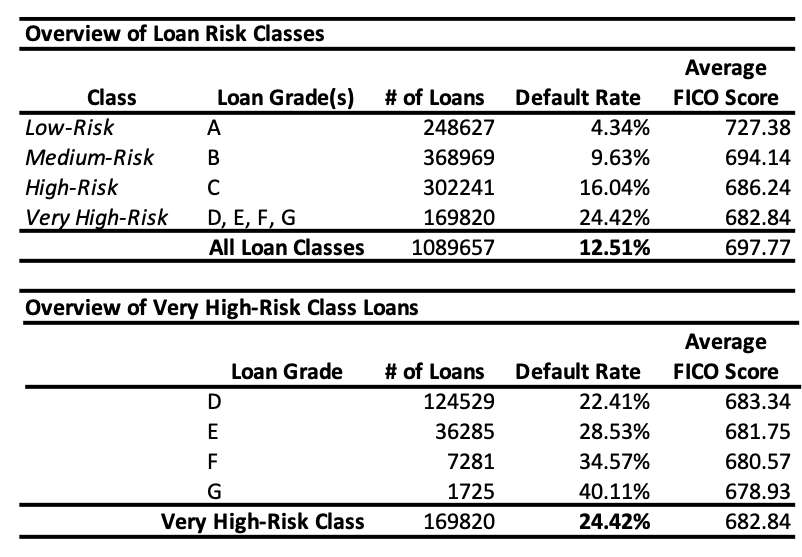

In [5]:
Image(filename='./data/lc_loans.png')